In [1]:
import xml.etree.ElementTree
import os,glob,sys
import pandas as pd
from sklearn.decomposition import PCA
import pylab as plt
import seaborn as sns
import numpy as np

%load_ext autoreload
%autoreload 2

sys.path.append("..")
from mzmine import pick_peaks, align, match_aligned_to_original, load_aligned_peaks


In [2]:
MZMINE_COMMAND = '/Users/anamaria/Documents/git/MZmine-2.40.1/startMZmine_MacOSX.command'

In [3]:
MNET_PATH = '/Users/anamaria/Documents/git/molnet/code/'

## Peak detection using MZmine

At the moment, this part is performed directly in MZmine.

In [ ]:
#for patients
# Directory holding mzml files of interest
input_dir = '/Volumes/Transcend/Metabolomics_datasets/Zika/Positive/Control'
# grab the list -- in this case all the T10 mzML files
file_list = glob.glob(os.path.join(input_dir,'**.mzXML'))

# # Directory to store all output
output_dir = '/Volumes/Transcend/Metabolomics_datasets/Zika/mzmine'

In [ ]:
from mzmine import pick_peaks
pick_peaks(file_list,output_dir=output_dir, xml_template = '/Users/anamaria/Desktop/mzmine/peak_picking_to_mztab_csv.xml', mzmine_command=MZMINE_COMMAND)

## Alignment

In [4]:
allfiles = '/Users/anamaria/Desktop/mzmine/221119/zik'
xml_template ='/Users/anamaria/Documents/git/pymzmine/batch_files/align_from_mztab.xml'

align(allfiles, xml_template = xml_template, mzmine_command = MZMINE_COMMAND, rt_window = 0.5)


['/Users/anamaria/Desktop/mzmine/221119/zik/ZIK10_pp.mzTab', '/Users/anamaria/Desktop/mzmine/221119/zik/ZIK7_pp.mzTab', '/Users/anamaria/Desktop/mzmine/221119/zik/ZIK6_pp.mzTab', '/Users/anamaria/Desktop/mzmine/221119/zik/C1_pp.mzTab', '/Users/anamaria/Desktop/mzmine/221119/zik/ZIK1_pp.mzTab', '/Users/anamaria/Desktop/mzmine/221119/zik/C7_pp.mzTab', '/Users/anamaria/Desktop/mzmine/221119/zik/C6_r_pp.mzTab', '/Users/anamaria/Desktop/mzmine/221119/zik/C2_pp.mzTab', '/Users/anamaria/Desktop/mzmine/221119/zik/C3_pp.mzTab', '/Users/anamaria/Desktop/mzmine/221119/zik/C9_pp.mzTab', '/Users/anamaria/Desktop/mzmine/221119/zik/ZIK4_pp.mzTab', '/Users/anamaria/Desktop/mzmine/221119/zik/ZIK5_pp.mzTab', '/Users/anamaria/Desktop/mzmine/221119/zik/C5_pp.mzTab', '/Users/anamaria/Desktop/mzmine/221119/zik/C4_pp.mzTab', '/Users/anamaria/Desktop/mzmine/221119/zik/ZIK9_pp.mzTab', '/Users/anamaria/Desktop/mzmine/221119/zik/ZIK8_pp.mzTab', '/Users/anamaria/Desktop/mzmine/221119/zik/ZIK3_pp.mzTab', '/Users/a

If files already aligned.

In [5]:
all_df = pd.read_csv('/Users/anamaria/Desktop/mzmine/221119/zik/pp_aligned.csv', index_col=0)
feature_description = all_df.iloc[:,:2]
all_samples = all_df.iloc[:,2:-1]
all_samples.columns = [x.split(" ")[0] for x in list(all_samples.columns)]

In [6]:
condition = []
dataset = []
for name in np.array(all_samples.columns):
    value = name.split('.')[0].split('_')[0][0]
    value2 = name.split('.')[0].split('_')[0][0]
    
    if (value == 'C' and len(name.split('.')[0].split('_')) == 2 and name.split('.')[0].split('_')[1] == '2'):
        condition.append('control')
        dataset.append('VL')
    elif  (value == 'C'):   
        condition.append('control')
        dataset.append('Zika')
    elif (value == 'Z'):
        condition.append('infected')
        dataset.append('Zika')
    elif (value[0] == 'V'):
        condition.append('infected')
        dataset.append('VL')
        
    elif (value == 'K' and int(name.split('.')[0].split('_')[1])%3 == 1 ):
        condition.append('control')
        dataset.append('Malaria')
    else:
        condition.append('infected')
        dataset.append('Malaria')
        

In [7]:
sample_description = pd.DataFrame(data=[list(all_samples.columns),condition,dataset] )
sample_description = sample_description.transpose()
sample_description.columns = ['Sample Name', 'Condition', 'Dataset']
sample_description["ConditionDataset"] = sample_description["Condition"]+sample_description["Dataset"]

In [8]:
all_samples_log = np.log2(all_samples+1)

In [9]:
len(all_samples_log)

12393

In [10]:
#DENSITY PLOTS
def plot_density(all_samples):
    # List of five airlines to plot
    datasets = ['Zika', 'Malaria', 'VL']
    colors = ['r','b','g']
    # Iterate through the five airlines
    for dataset, color in zip(datasets, colors):
        # Subset to the airline

        subset = all_samples.transpose()[np.array(sample_description['Dataset'] == dataset)].transpose()
        colordataset= color
        # Draw the density plot
        for col in list(subset.columns):
            sns.distplot(subset[col] ,hist = False, kde = True, color = colordataset,
                     kde_kws = {'linewidth': 3, "alpha":0.2})
   
    # Plot formatting
    plt.xlabel('Intensity')
    plt.legend(all_samples.columns)
    

In [11]:
sample_description["ConditionDataset"] 

0     infectedZika
1     infectedZika
2      controlZika
3     infectedZika
4      controlZika
5     infectedZika
6      controlZika
7      controlZika
8     infectedZika
9      controlZika
10     controlZika
11    infectedZika
12     controlZika
13    infectedZika
14    infectedZika
15     controlZika
16    infectedZika
17    infectedZika
18     controlZika
Name: ConditionDataset, dtype: object

In [12]:
all_samples_condition = all_samples_log
all_samples_condition.columns = list(sample_description["ConditionDataset"])

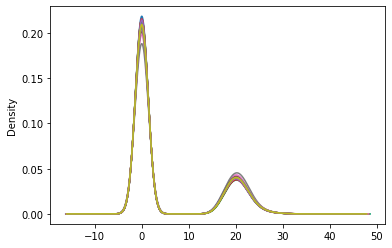

In [13]:
all_samples_log.plot.density(legend = False)

In [15]:
# rearranging the dataframe
Zik = all_samples_log.transpose()[np.array(sample_description['Dataset'] == 'Zika')].transpose()
zik_con = Zik.transpose()[np.array(sample_description[sample_description["Dataset"] == "Zika"]['Condition'] =="control")].transpose()
zik_inf = Zik.transpose()[np.array(sample_description[sample_description["Dataset"] == "Zika"]['Condition'] =="infected")].transpose()


In [16]:
pdList = [zik_inf,zik_con]  
all_samples_log_rearanged = pd.concat(pdList, axis = 1)

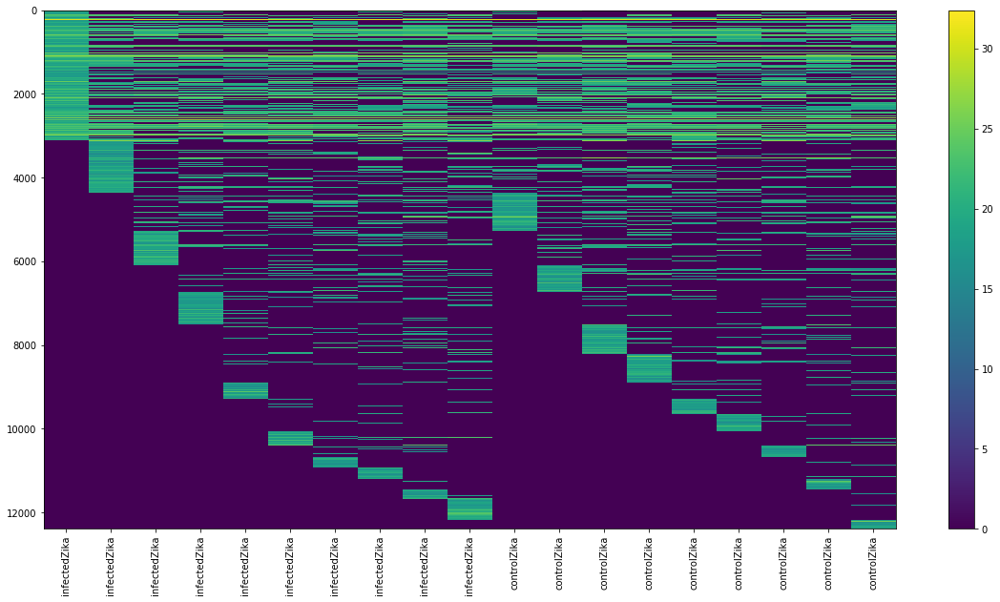

In [17]:
plt.figure(figsize=(20,10))
plt.imshow(all_samples_log_rearanged,aspect='auto')
plt.xticks(list(range(0,len(all_samples_log_rearanged.columns))), all_samples_log_rearanged.columns, rotation = 90)
plt.colorbar()
plt.show()


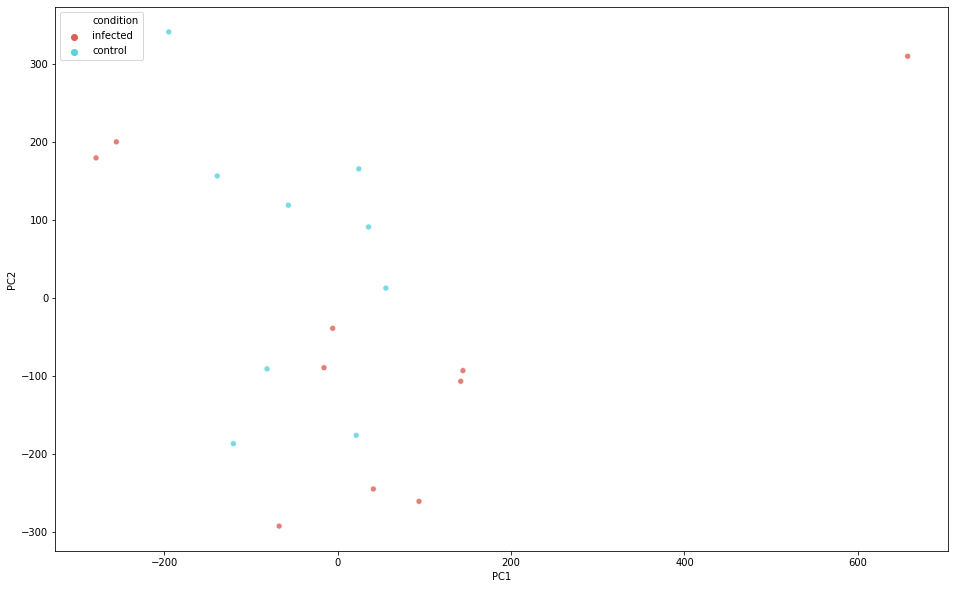

In [18]:
pca_samples = PCA(n_components=3)

principalComponents = pca_samples.fit_transform(all_samples_log.transpose())
principalComponents_df = pd.DataFrame(data = principalComponents, columns= ['PC1','PC2', 'PC3'])
principalComponents_df['condition'] = list(sample_description['Condition'])
principalComponents_df['dataset'] = list(sample_description['Dataset'])

plt.figure(figsize=(16,10))
sns.scatterplot(x="PC1", y="PC2",hue="condition",
    palette=sns.color_palette("hls", 2),
    data=principalComponents_df,
    legend="full",
    alpha=0.8
)

Filter data, so that 50% of the peaks are not 0s.

In [19]:
def get_ids_for_50_percent(dataframe):
    idlist = []
    for rowid,row in dataframe.iterrows():
        total_zero = 0
        for i in range(len(row)):
            if row[i] == 0.0:
                total_zero += 1
        percentage = total_zero*100/len(row)
        if percentage <= 50:
            idlist.append(rowid)
    return np.array(idlist)

In [20]:
idzik = get_ids_for_50_percent(all_samples_log_rearanged[Zik.columns])

inters = set(idzik)


In [21]:
len(inters)
all_samples_log_filtered_50 = all_samples_log.loc[inters]

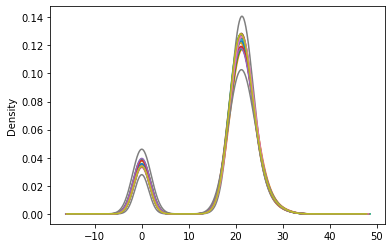

In [22]:
all_samples_log_filtered_50.plot.density(legend=False)

In [22]:
all_samples_log_filtered_na = all_samples_log_filtered_50
all_samples_log_filtered_na.replace(0, np.nan, inplace = True)

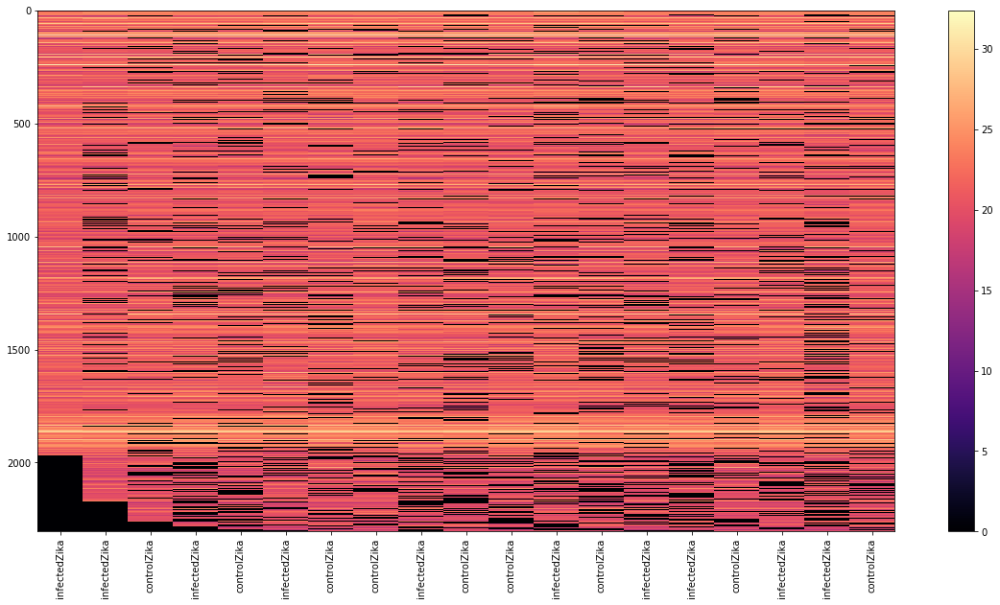

In [23]:
plt.figure(figsize=(20,10))
plt.imshow(all_samples_log_filtered_50,aspect='auto',cmap='magma')
plt.xticks(list(range(0,len(all_samples_log_filtered_50.columns))), all_samples_log_filtered_50.columns, rotation = 90)
plt.colorbar()
plt.show()


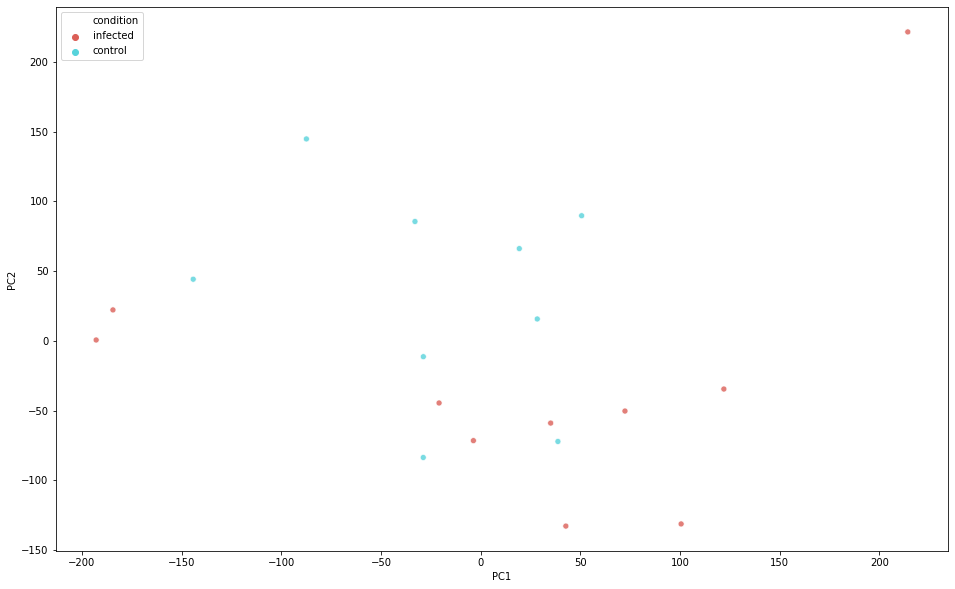

In [24]:
pca_samples = PCA(n_components=3)

principalComponents = pca_samples.fit_transform(all_samples_log_filtered_50.transpose())
principalComponents_df = pd.DataFrame(data = principalComponents, columns= ['PC1','PC2', 'PC3'])
principalComponents_df['condition'] = list(sample_description['Condition'])
principalComponents_df['dataset'] = list(sample_description['Dataset'])

plt.figure(figsize=(16,10))
sns.scatterplot(x="PC1", y="PC2",hue="condition",
    palette=sns.color_palette("hls", 2),
    data=principalComponents_df,
    legend="full",
    alpha=0.8
)

In [25]:
from fancyimpute import KNN
def impute_knn(zik_con):
    zik_con_filt = all_samples_log_filtered_50[zik_con.columns]
    zik_con_filt.replace(0, np.nan, inplace = True)
    zik_con_filled_knn = KNN(k=3).fit_transform(zik_con_filt)
    df = pd.DataFrame(zik_con_filled_knn, columns=zik_con_filt.columns, index = zik_con_filt.index)
    return df


Using TensorFlow backend.


In [27]:
zik_con_filled = impute_knn(zik_con)
zik_inf_filled = impute_knn(zik_inf)


/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/pandas/core/frame.py:4042: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  method=method)


Imputing row 1/2305 with 0 missing, elapsed time: 5.792
Imputing row 101/2305 with 18 missing, elapsed time: 5.826
Imputing row 201/2305 with 0 missing, elapsed time: 5.859
Imputing row 301/2305 with 0 missing, elapsed time: 5.893
Imputing row 401/2305 with 36 missing, elapsed time: 5.932
Imputing row 501/2305 with 0 missing, elapsed time: 5.972
Imputing row 601/2305 with 0 missing, elapsed time: 6.006
Imputing row 701/2305 with 36 missing, elapsed time: 6.054
Imputing row 801/2305 with 36 missing, elapsed time: 6.122
Imputing row 901/2305 with 0 missing, elapsed time: 6.168
Imputing row 1001/2305 with 0 missing, elapsed time: 6.207
Imputing row 1101/2305 with 9 missing, elapsed time: 6.262
Imputing row 1201/2305 with 0 missing, elapsed time: 6.406
Imputing row 1301/2305 with 36 missing, elapsed time: 6.462
Imputing row 1401/2305 with 0 missing, elapsed time: 6.553
Imputing row 1501/2305 with 9 missing, elapsed time: 6.652
Imputing row 1601/2305 with 45 missing, elapsed time: 6.720
Imp

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/pandas/core/frame.py:4042: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  method=method)


Imputing row 1/2305 with 0 missing, elapsed time: 6.654
Imputing row 101/2305 with 0 missing, elapsed time: 6.687
Imputing row 201/2305 with 0 missing, elapsed time: 6.744
Imputing row 301/2305 with 0 missing, elapsed time: 6.778
Imputing row 401/2305 with 40 missing, elapsed time: 6.827
Imputing row 501/2305 with 0 missing, elapsed time: 6.884
Imputing row 601/2305 with 0 missing, elapsed time: 6.948
Imputing row 701/2305 with 50 missing, elapsed time: 7.033
Imputing row 801/2305 with 50 missing, elapsed time: 7.099
Imputing row 901/2305 with 0 missing, elapsed time: 7.188
Imputing row 1001/2305 with 20 missing, elapsed time: 7.247
Imputing row 1101/2305 with 30 missing, elapsed time: 7.315
Imputing row 1201/2305 with 0 missing, elapsed time: 7.397
Imputing row 1301/2305 with 30 missing, elapsed time: 7.475
Imputing row 1401/2305 with 0 missing, elapsed time: 7.558
Imputing row 1501/2305 with 50 missing, elapsed time: 7.773
Imputing row 1601/2305 with 30 missing, elapsed time: 7.887
I

In [28]:
pdList = [zik_inf_filled,zik_con_filled]  
all_samples_log_filled = pd.concat(pdList, axis = 1)

In [34]:
all_samples_log_filled = all_samples_log_filled[all_samples_log_filtered_50.columns]

## Limma analysis in R

In [30]:
#all_samples_log_filtered.to_csv(r'/Users/anamaria/Desktop/mzmine/221119/mal/all_samples_log2.csv', header=True, index=True, sep=',', mode='w')
all_samples_log_filtered_50.to_csv(r'/Users/anamaria/Desktop/mzmine/221119/zik/all_samples_log2_50.csv', header=True, index=True, sep=',', mode='w')
all_samples_log_filled.to_csv(r'/Users/anamaria/Desktop/mzmine/221119/zik/all_samples_log2_50_filled.csv', header=True, index=True, sep=',', mode='w')
sample_description.to_csv(r'/Users/anamaria/Desktop/mzmine/221119/zik/sample_description.csv', header=True, index=None, sep=',', mode='w')

In [31]:
#limma with 50% non-zero
all_samples_log_filtered_50.to_csv(r'/Users/anamaria/Desktop/mzmine/221119/zik/all_samples_log2_50.csv', header=True, index=True, sep=',', mode='w')
all_samples_log_filled.to_csv(r'/Users/anamaria/Desktop/mzmine/221119/zik/all_samples_log2_50_filled.csv', header=True, index=True, sep=',', mode='w')

In [33]:
all_samples_log_filled

,infectedZika,infectedZika,infectedZika,infectedZika,infectedZika,infectedZika,infectedZika,infectedZika,infectedZika,infectedZika,...,controlZika,controlZika,controlZika,controlZika,controlZika,controlZika,controlZika,controlZika,controlZika,controlZika
row ID,,,,,,,,,,,,,,,,,,,,,
1,24.770584,24.976324,24.554527,24.862017,24.729367,24.394185,25.172528,24.554508,24.873509,24.811572,...,24.852681,24.313839,24.845143,25.014102,24.876117,25.383753,25.012000,25.375658,25.073068,24.852681
2,21.139783,20.126250,20.080888,21.289647,20.326508,21.878096,21.443260,20.204151,21.815959,18.591535,...,20.972182,21.221154,20.670391,21.636218,21.178668,20.608589,19.701957,21.319419,20.289246,20.972182
3,18.721152,18.052387,19.483036,19.507913,17.372358,19.530715,18.596191,17.843306,20.006686,18.459997,...,19.694221,19.201274,18.395444,20.184440,20.210023,18.990355,20.119485,20.083202,18.598730,19.694221
4,19.555428,19.952683,19.838900,19.925378,20.200790,20.054221,20.219339,19.484216,19.788951,19.397063,...,19.920609,19.839647,19.292700,20.350317,20.079079,20.409693,19.580707,19.915108,19.173337,19.920609
5,20.532139,20.583330,20.232179,20.400909,20.460573,20.904141,20.194080,20.614994,20.089034,19.902046,...,18.803943,18.974279,19.889731,20.607101,19.562088,20.043645,19.656864,20.246883,20.958211,18.803943
6,24.585562,25.154208,24.663895,25.267851,24.631673,25.394092,24.816587,24.760264,25.186434,24.376564,...,25.137707,24.866218,24.687940,25.133232,25.171395,24.484842,24.575593,25.157297,25.071907,25.137707
9,19.307789,20.388158,19.831240,20.529739,19.942722,20.682845,20.113088,20.233057,20.728155,19.591158,...,20.606755,20.198539,19.752636,20.488646,20.573882,19.347748,19.709644,20.473639,20.306279,20.606755
10,22.050147,21.923903,21.332265,21.662718,21.305727,22.859436,21.685163,21.943230,22.519694,22.339715,...,22.478577,21.643181,21.881336,22.971713,22.196434,22.672667,22.529647,22.395409,22.787014,22.478577
14,25.677780,25.685526,25.650537,25.599500,25.701417,25.661000,25.478600,25.582711,25.593106,25.845599,...,25.722780,25.609523,25.717865,25.577810,25.609238,25.601273,25.813362,25.585794,25.691124,25.722780


In [36]:
toptable = pd.read_csv("/Users/anamaria/Desktop/mzmine/221119/zik/limma_independent_toptable.csv", sep=',')


In [37]:
np.set_printoptions(threshold=sys.maxsize)
#print(np.array(toptable.index))
print(np.array(toptable.index))

[ 2976   200  2659   323  4183  4131  1827  3726  2161  2393  1749  3730
  1526  3744  1833  3441  3724  3302  1363  1697  8001  8097  5227  3112
  7856  5938  2992  3681  3291   522  1997  4087  4187  7464  8122  4152
  2032  4151  3478  3720  7257  1350  3001  4186  3015  4221  1325  1090
  1080  8171  7844   987  4149  4185  7911  1011  4157  4108  1012  8504
  4091  4133  1647   725  3333  2177  7926   390  7835  6413  3338  6707
  4107  4942  4150  1748  3467  3176  4132  6860  4156  4090  3052  2482
  4128  4129  1385  4218  1428  4055  4109  7030  3384  1579  5108  2119
  1475  2090  4159  8496  1445  2504  1412  6599  4220  4110   304  6369
  6414   668  3309   626  8000  3325 13155  4216  8036  8495  1413  3149
  4106  3196  3817  4163  3766  6123  3979  3022  8200  7226  4094  4088
  4588  6646  4126  2243   474  4112  4105  2396  7944  4013  4115  4226
  4196  5534  4217  3865  1095  3385  4010  3348  2406  4811  3157  8508
  3828  3408   779  8503  1348  4073  1728  3826  3

In [38]:
#limma_topfeatures = all_samples_log.loc[toptable.index]
limma_topfeatures = all_samples_log_filled.loc[toptable.index]
limma_topfeatures = limma_topfeatures.transpose()
limma_topfeatures["Condition"] = np.array(sample_description["ConditionDataset"])

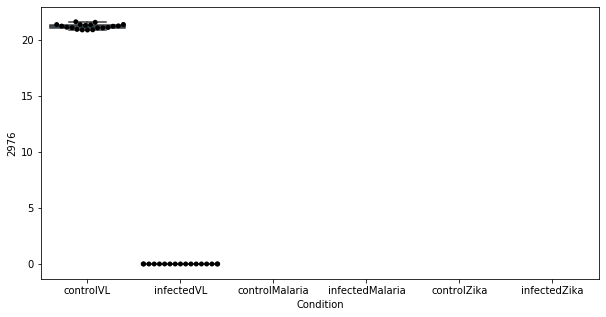

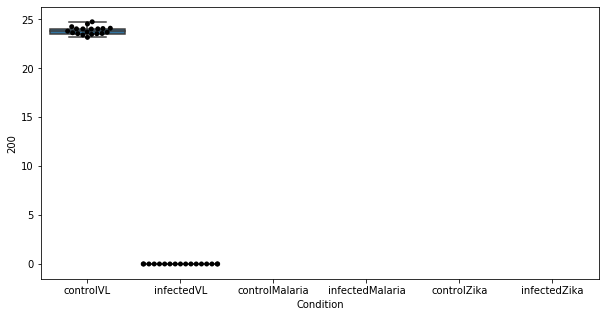

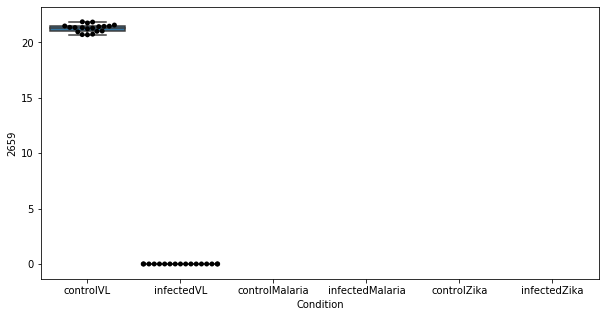

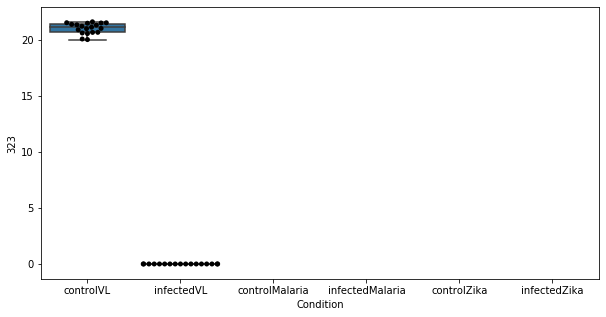

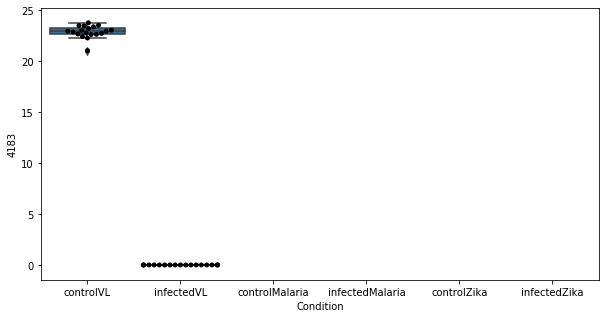

...

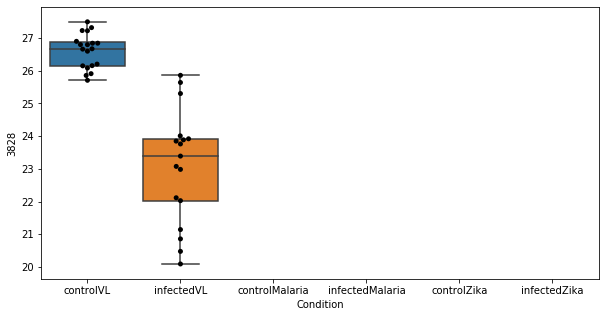

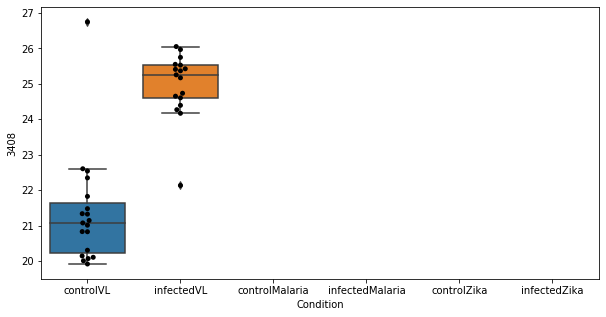

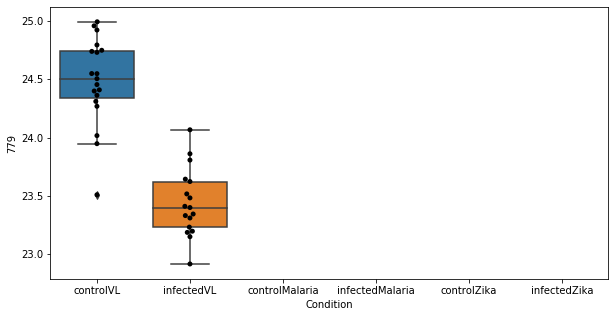

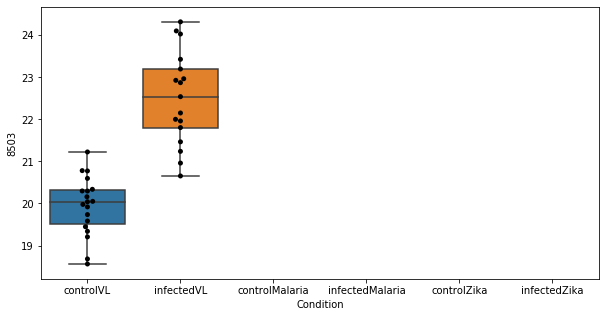

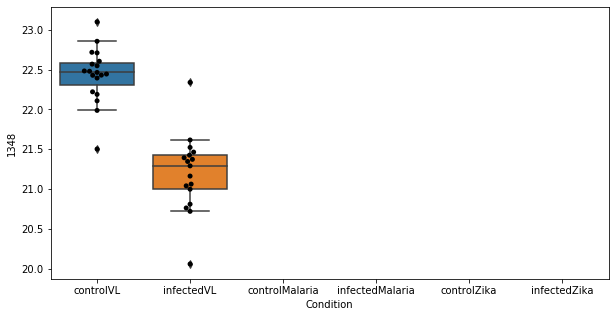

KeyboardInterrupt: 

<Figure size 720x360 with 0 Axes>

In [39]:
for i in range(len(list(limma_topfeatures.columns))):
    plt.figure(figsize=(10,5))
    ax = sns.boxplot(y=list(limma_topfeatures.columns)[i], x="Condition", data = limma_topfeatures, order = ['controlVL','infectedVL','controlMalaria', 'infectedMalaria', 'controlZika','infectedZika'] )
    ax = sns.swarmplot(y=list(limma_topfeatures.columns)[i], x="Condition", data = limma_topfeatures, order = ['controlVL','infectedVL','controlMalaria', 'infectedMalaria', 'controlZika','infectedZika'], color="black")
    plt.show()

In [ ]:
#for 10% non-zero values 
for i in range(len(list(limma_topfeatures.columns))):
    plt.figure(figsize=(10,5))
    ax = sns.boxplot(y=list(limma_topfeatures.columns)[i], x="Condition", data = limma_topfeatures, order = ['controlVL','infectedVL','controlMalaria', 'infectedMalaria', 'controlZika','infectedZika'] )
    ax = sns.swarmplot(y=list(limma_topfeatures.columns)[i], x="Condition", data = limma_topfeatures, order = ['controlVL','infectedVL','controlMalaria', 'infectedMalaria', 'controlZika','infectedZika'], color="black")
    plt.show()

In [ ]:
limma_topfeatures

In [40]:
def plot_boxplots(limma_topfeatures, metab_id, ylim, y = False ):
    plt.figure(figsize=(10,5))
   
    ax = sns.boxplot(y=limma_topfeatures[metab_id], x="Condition", data = limma_topfeatures, order = ['controlVL','infectedVL','controlMalaria', 'infectedMalaria', 'controlZika','infectedZika'] )
    ax = sns.swarmplot(y=limma_topfeatures[metab_id], x="Condition", data = limma_topfeatures, order = ['controlVL','infectedVL','controlMalaria', 'infectedMalaria', 'controlZika','infectedZika'], color="black")
    if y:
        plt.ylim(ylim)
    plt.show()

## Preparing file for mummichog

In [41]:
import scipy
data = feature_description.loc[toptable.index]
#data['row retention time'] = np.zeros(len(data))
data['p-val'] = toptable['P.Value']
#data['t-val'] = toptable['t']
data['adj.P.Val'] = toptable['adj.P.Val']
data['custom_id'] = list(data.index)
data_without_rt = data.drop(['row retention time'], axis = 1)

In [42]:
data.to_csv(r'/Users/anamaria/Desktop/mzmine/221119/vl/topfeatures50_filled.txt', header=True, index=None, sep='\t', mode='w')


In [43]:
os.system('mummichog -f'+'/Users/anamaria/Desktop/mzmine/221119/vl/topfeatures50_filled.txt'+' -m positive -u 3 -o mm')

0

In [55]:
compounds = pd.read_csv('1575907936.71.mm/tables/ListOfEmpiricalCompounds.tsv', sep='\t')
featureoutput = pd.read_csv('1575907936.71.mm/tables/userInputData.txt', sep='\t')

In [56]:
matching_ids = {}
for _,row in featureoutput.iterrows():
    key = row['massfeature_rows']
    value = row['CompoundID_from_user']
    matching_ids[key] = value

In [57]:
compounds_dict = {}
for _,row in compounds.iterrows():
    ids = row['massfeature_rows']
    ions = row['str_row_ion']
    compoundlist = row['compound_names']
    
    ids_list = ids.split(';')
    ions_list = ions.split(';')
    for i in range(len(ids_list)):
        compounds_dict[matching_ids[ids_list[i]]] = []
        compounds_dict[matching_ids[ids_list[i]]].append(ions_list[i].split('_')[1])
        compounds_dict[matching_ids[ids_list[i]]].append(compoundlist)
        

In [58]:
for row_id,row in data.iterrows():
    if row_id in list(compounds_dict.keys()):
        
        data.at[row_id,'compound_names'] = compounds_dict[row_id][-1]
    else:
         data.at[row_id,'compound_names'] = 'NaN'
    

In [61]:
#pd.set_option('display.max_rows', 1000)
pdata = data[data['p-val'] <= 1]

In [189]:
data.loc[1521]

row m/z                                                         209.092
row retention time                                              9.32332
p-val                                                         0.0228436
adj.P.Val                                                      0.610573
custom_id                                                          1521
compound_names        L-Kynurenine; 3-Anthraniloyl-L-alanine$Formyl-...
Name: 1521, dtype: object

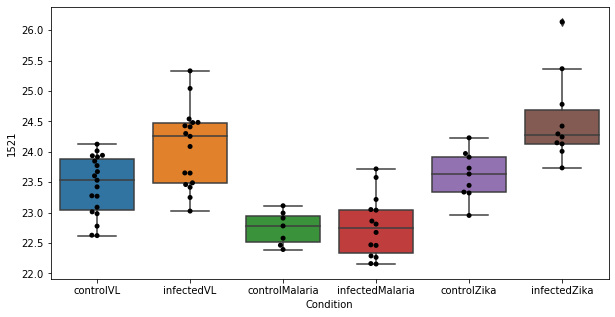

In [183]:
plot_boxplots(limma_topfeatures,1521, (15,30), False)

In [191]:
data.loc[1543]

row m/z                                                         210.096
row retention time                                              9.33432
p-val                                                        0.00406191
adj.P.Val                                                      0.327955
custom_id                                                          1543
compound_names        L-Kynurenine; 3-Anthraniloyl-L-alanine$Formyl-...
Name: 1543, dtype: object

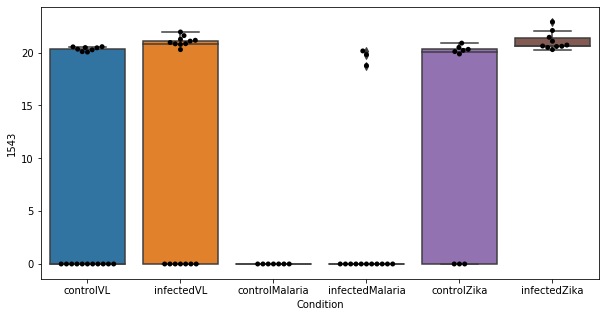

In [43]:
plot_boxplots(limma_topfeatures,1543, (15,30), False)

In [195]:
data.loc[575]

row m/z                                                         141.066
row retention time                                              8.53791
p-val                                                         0.0407753
adj.P.Val                                                      0.743377
custom_id                                                           575
compound_names        Methylimidazoleacetic acid; Tele-methylimidazo...
Name: 575, dtype: object

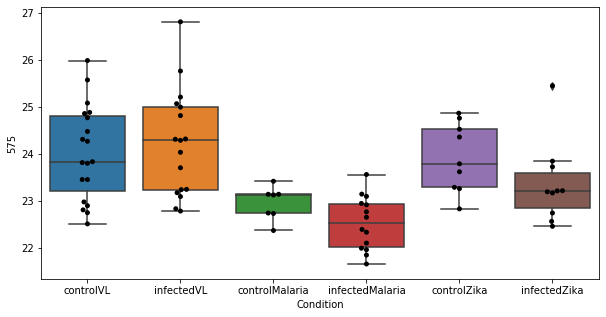

In [196]:
plot_boxplots(limma_topfeatures,575, (15,30), False)

In [198]:
data.loc[1661]

row m/z                           218.139
row retention time                8.41637
p-val                           0.0552375
adj.P.Val                        0.806068
custom_id                            1661
compound_names        propionyl-carnitine
Name: 1661, dtype: object

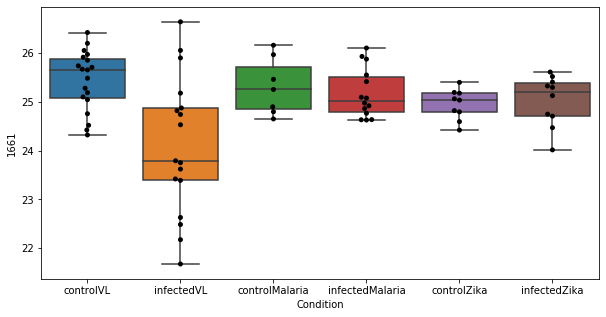

In [199]:
plot_boxplots(limma_topfeatures,1661, (15,30), False)

In [200]:
data.loc[239]

row m/z                                                          115.05
row retention time                                              10.3323
p-val                                                         0.0621256
adj.P.Val                                                      0.860949
custom_id                                                           239
compound_names        5,6-Dihydrouracil; 2,4(1H,3H)-Pyrimidinedione,...
Name: 239, dtype: object

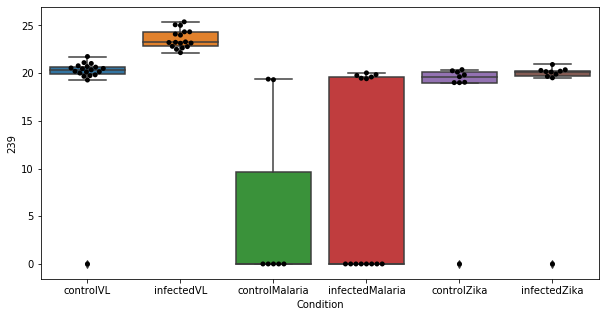

In [201]:
plot_boxplots(limma_topfeatures,239, (15,30), False)

In [59]:
data.loc[902]

row m/z                  160.116
row retention time       10.4075
p-val                 2.8358e-05
adj.P.Val             0.00877682
custom_id                    902
compound_names               NaN
Name: 902, dtype: object

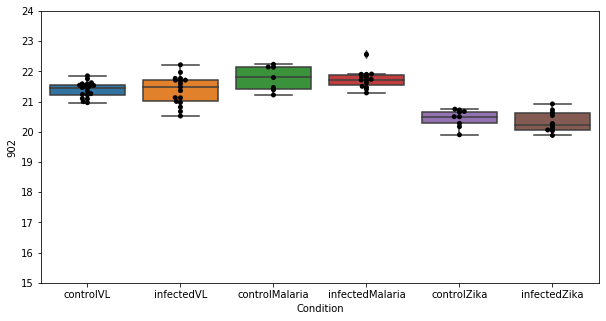

In [60]:
plot_boxplots(limma_topfeatures,902, (15,24), True)

In [108]:
data.loc[457]

row m/z                                                         132.066
row retention time                                              11.5752
p-val                                                          0.536622
adj.P.Val                                                      0.999947
custom_id                                                           457
compound_names        5-Aminolevulinate; 5-Amino-4-oxopentanoate; 5-...
Name: 457, dtype: object

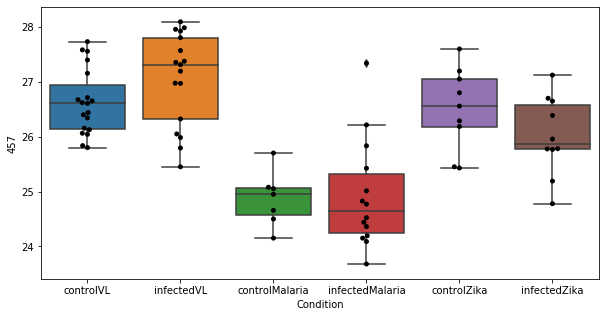

In [109]:
plot_boxplots(limma_topfeatures,457, (15,30), False)

In [135]:
for i in list(toptable_50.index):
    mz = data.loc[i]['row m/z']
    if mz > 100.0 and mz <230.0:
        print(mz)

142.0863576776841
115.0695485064858
130.15906863742404
116.0706210569902
102.06623077392578
116.07047700881958
106.049880680285
123.05527623494464
129.10223881648136
115.07537656511579
115.05025736490887
130.08630989693307
114.09845822477993
114.09138870239258
124.08698785716088
102.0661973953247
129.09101119695922
105.11036726485851
101.0763931274414
113.10729163033622
143.0816130802549
100.07568105061847
127.0866355895996
136.0757680620466
136.06183242797852
114.0550639629364
111.0553207397461
115.0502700805664
106.97155380249023
129.1022192913553
132.1421009751617
141.06590837047946
122.1041380564372
125.09614275322586
101.07160232543946
111.11685180664062
118.05242580837673
133.07975006103516
130.06519063313806
118.08624432538006
123.11681801932198
113.10733677790716
130.08640683081842
126.0219806871916
104.10698776245115
142.12273035551368
130.96070353190106
115.0866195678711
115.12298631668092
122.101953125
131.16241200764978
115.09473750465794
104.10696566944391
116.037513287862

In [260]:
data.loc[1521]

row m/z                                                         209.092
row retention time                                              9.32332
p-val                                                           0.93632
adj.P.Val                                                      0.999793
custom_id                                                          1521
compound_names        L-Kynurenine; 3-Anthraniloyl-L-alanine$Formyl-...
Name: 1521, dtype: object

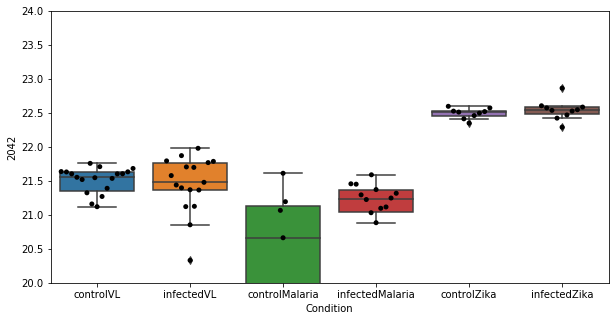

In [251]:
plot_boxplots(limma_topfeatures,2042, (20,24), True)

0 row m/z                   228.032
row retention time        7.95626
p-val                  2.7908e-33
adj.P.Val             5.43926e-30
custom_id                    3749
compound_names                NaN
Name: 3749, dtype: object


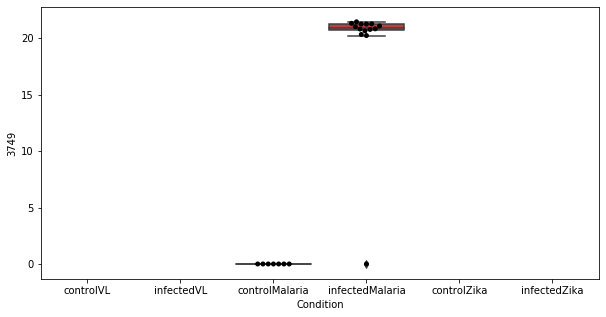

1 row m/z                                                   268.104
row retention time                                        8.25438
p-val                                                 9.08261e-11
adj.P.Val                                               8.851e-08
custom_id                                                    2029
compound_names        Adenosine$Deoxyguanosine; 2'-Deoxyguanosine
Name: 2029, dtype: object


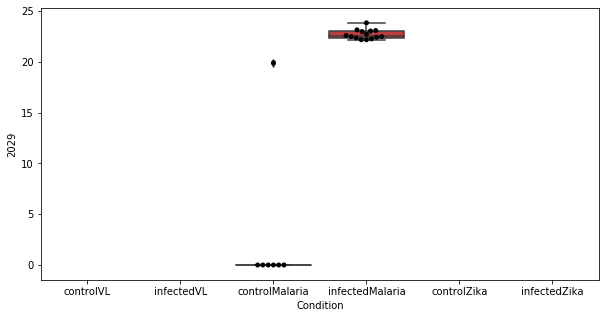

2 row m/z                    258.11
row retention time        11.6816
p-val                 5.38375e-08
adj.P.Val             3.49764e-05
custom_id                    1971
compound_names                NaN
Name: 1971, dtype: object


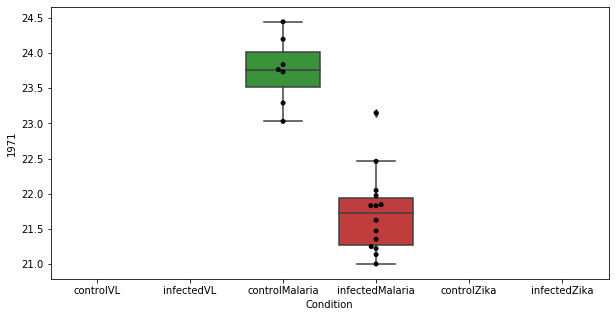

3 row m/z                   276.158
row retention time        17.4298
p-val                 3.28783e-07
adj.P.Val             0.000149445
custom_id                    2108
compound_names                NaN
Name: 2108, dtype: object


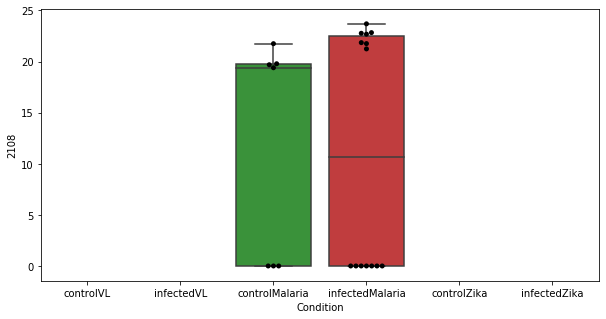

4 row m/z                   166.032
row retention time        5.60225
p-val                 3.83389e-07
adj.P.Val             0.000149445
custom_id                     997
compound_names                NaN
Name: 997, dtype: object


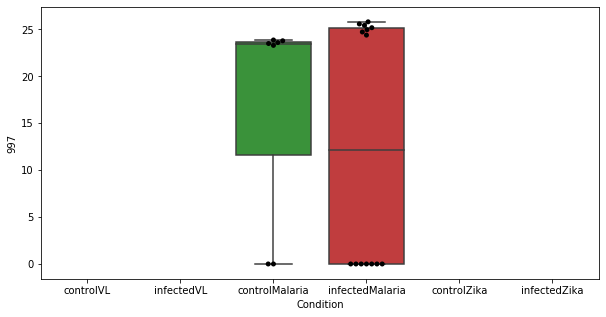

5 row m/z                    1019.7
row retention time         4.0836
p-val                 5.52239e-07
adj.P.Val             0.000179386
custom_id                    5299
compound_names                NaN
Name: 5299, dtype: object


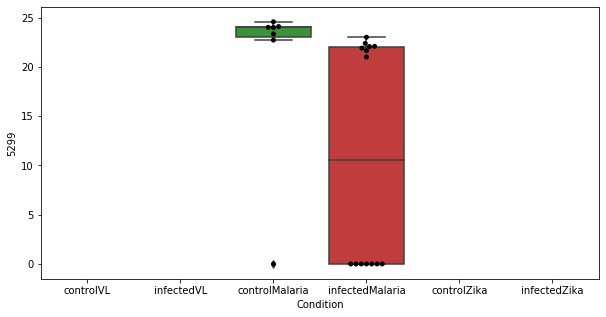

6 row m/z                   992.674
row retention time        4.12404
p-val                 1.81754e-06
adj.P.Val             0.000506055
custom_id                    2984
compound_names                NaN
Name: 2984, dtype: object


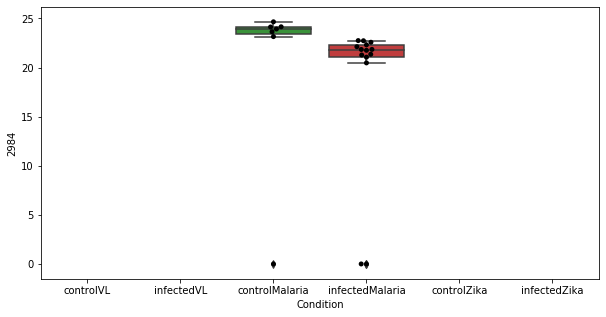

7 row m/z                    1020.7
row retention time        4.07943
p-val                 2.69765e-06
adj.P.Val             0.000657215
custom_id                    5300
compound_names                NaN
Name: 5300, dtype: object


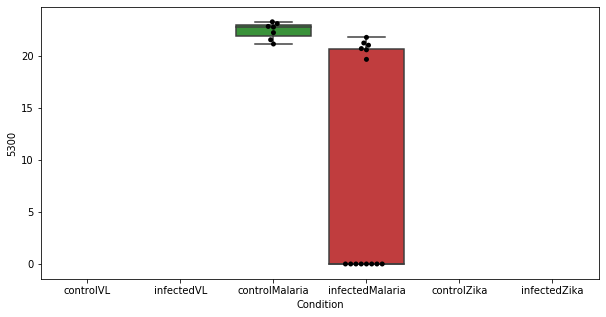

8 row m/z                   340.041
row retention time        7.56596
p-val                 4.96351e-06
adj.P.Val              0.00107488
custom_id                    2396
compound_names                NaN
Name: 2396, dtype: object


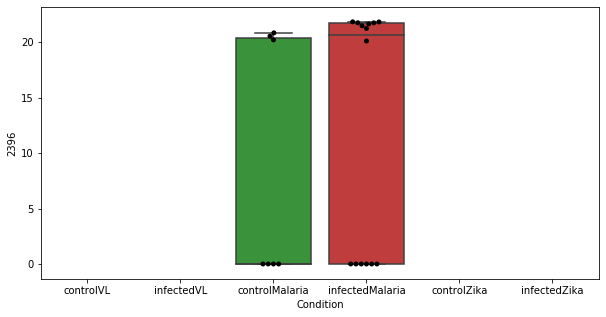

9 row m/z                  268.893
row retention time       13.8029
p-val                 2.1934e-05
adj.P.Val             0.00427493
custom_id                   2048
compound_names               NaN
Name: 2048, dtype: object


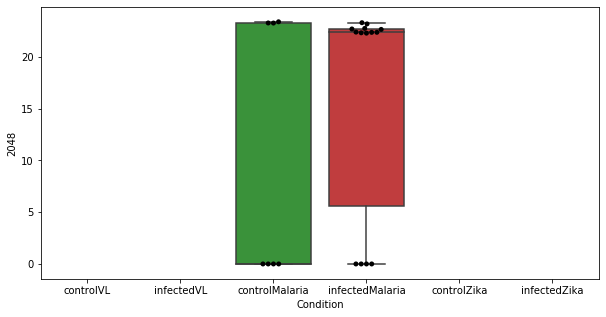

10 row m/z                                                         241.031
row retention time                                              12.9424
p-val                                                       2.50628e-05
adj.P.Val                                                    0.00444067
custom_id                                                          1836
compound_names        L-Cystine; L-Dicysteine; L-alpha-Diamino-beta-...
Name: 1836, dtype: object


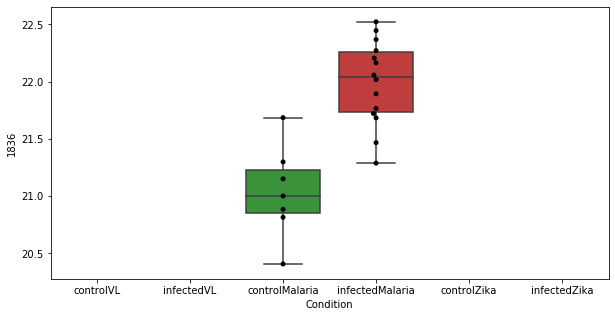

11 row m/z                   287.204
row retention time        4.59137
p-val                 3.30939e-05
adj.P.Val              0.00537499
custom_id                    2185
compound_names                NaN
Name: 2185, dtype: object


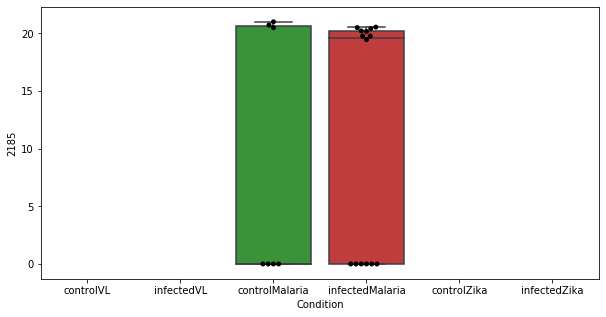

12 row m/z                    228.91
row retention time        15.0038
p-val                 7.13891e-05
adj.P.Val               0.0107029
custom_id                    1706
compound_names                NaN
Name: 1706, dtype: object


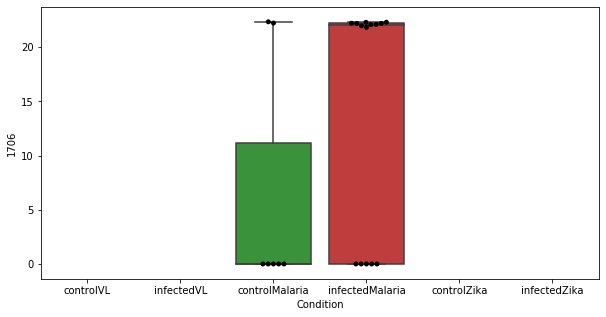

13 row m/z                  234.912
row retention time        23.774
p-val                 7.7142e-05
adj.P.Val              0.0107393
custom_id                   1761
compound_names               NaN
Name: 1761, dtype: object


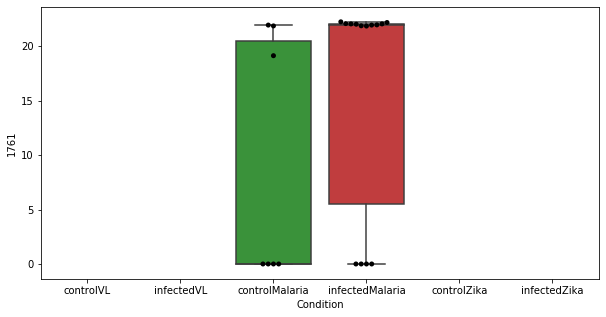

14 row m/z                                                         524.371
row retention time                                              4.01952
p-val                                                       0.000124052
adj.P.Val                                                     0.0161184
custom_id                                                          2650
compound_names        tetracosapentaenoyl carnitine$tetracosapentaen...
Name: 2650, dtype: object


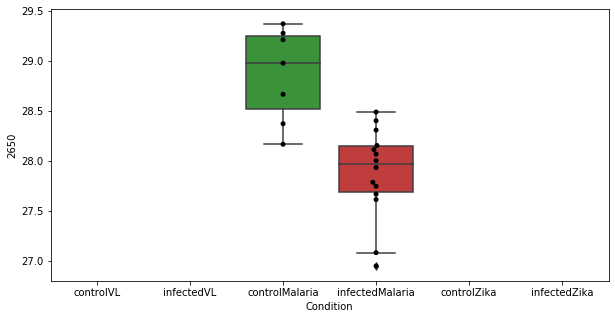

15 row m/z                   525.375
row retention time        4.01159
p-val                 0.000143717
adj.P.Val               0.0175065
custom_id                    2651
compound_names                NaN
Name: 2651, dtype: object


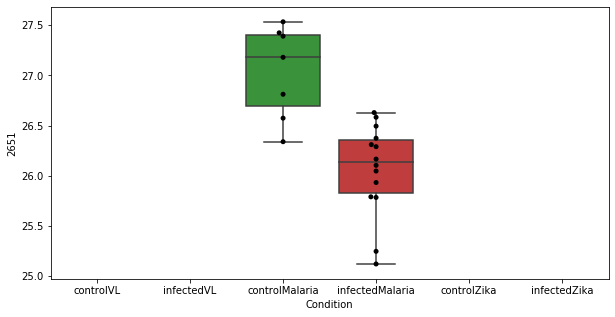

16 row m/z                   586.273
row retention time        7.00261
p-val                 0.000161389
adj.P.Val               0.0175445
custom_id                    6229
compound_names          Bilirubin
Name: 6229, dtype: object


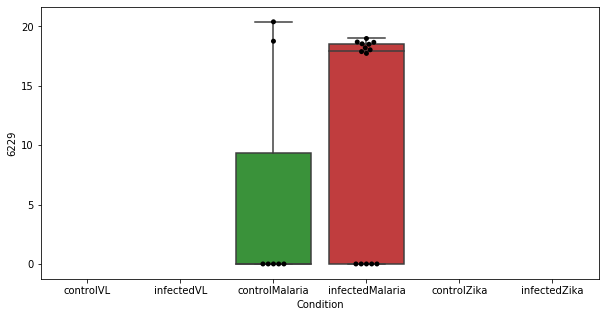

17 row m/z                   498.346
row retention time        4.11398
p-val                 0.000174516
adj.P.Val               0.0175445
custom_id                    2627
compound_names                NaN
Name: 2627, dtype: object


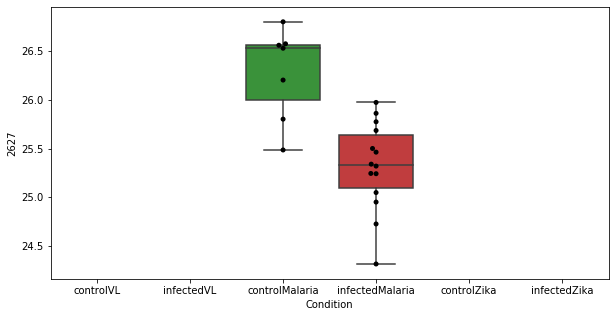

18 row m/z                   497.343
row retention time        4.11987
p-val                 0.000179109
adj.P.Val               0.0175445
custom_id                    2626
compound_names                NaN
Name: 2626, dtype: object


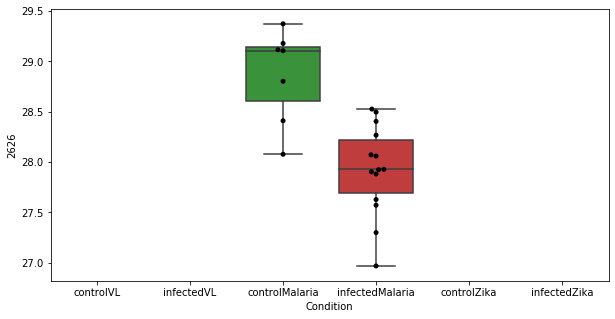

19 row m/z                   163.033
row retention time        4.86827
p-val                 0.000180036
adj.P.Val               0.0175445
custom_id                     962
compound_names                NaN
Name: 962, dtype: object


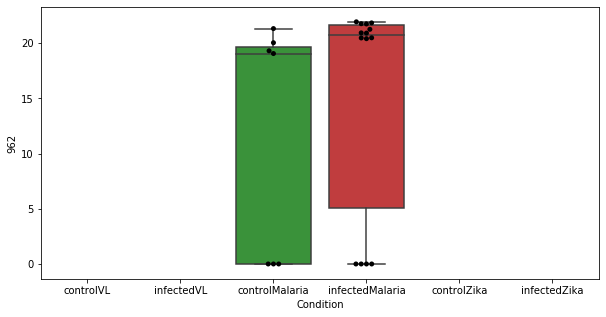

20 row m/z                   499.348
row retention time        4.09872
p-val                 0.000205041
adj.P.Val               0.0190298
custom_id                    2628
compound_names                NaN
Name: 2628, dtype: object


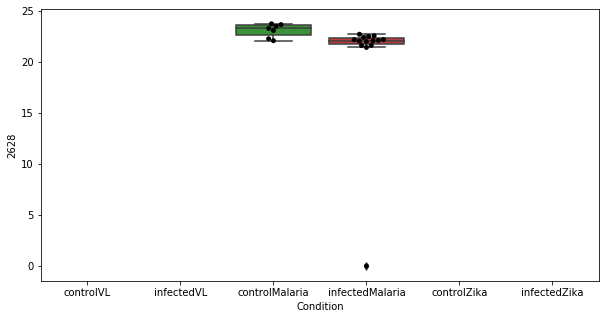

21 row m/z                                                          496.34
row retention time                                              4.11399
p-val                                                       0.000221992
adj.P.Val                                                     0.0196664
custom_id                                                          2624
compound_names        docosa-4,7,10,13,16-pentaenoyl carnitine$clupa...
Name: 2624, dtype: object


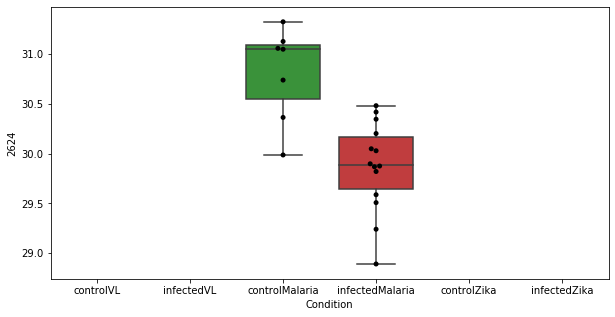

22 row m/z                                                         508.376
row retention time                                              4.07224
p-val                                                       0.000239961
adj.P.Val                                                     0.0197725
custom_id                                                          2634
compound_names        1-Acyl-sn-glycero-3-phosphocholine; 1-Acyl-sn-...
Name: 2634, dtype: object


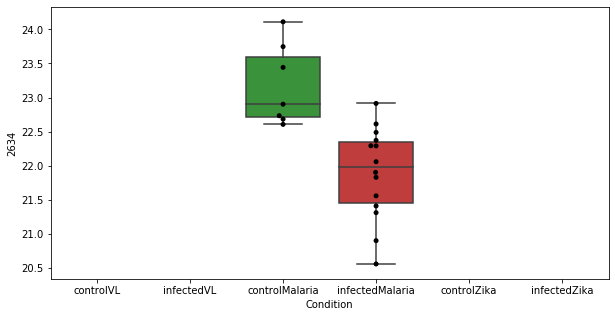

23 row m/z                   526.377
row retention time        4.01158
p-val                 0.000243479
adj.P.Val               0.0197725
custom_id                    2655
compound_names                NaN
Name: 2655, dtype: object


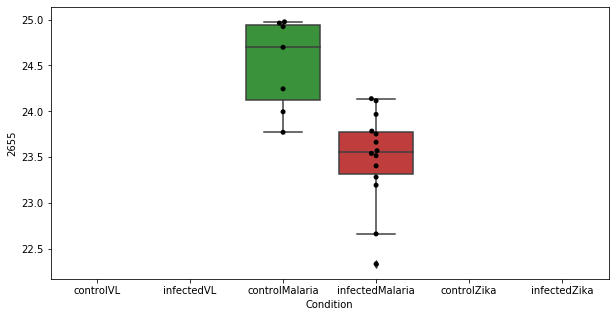

24 row m/z                   155.107
row retention time        3.88597
p-val                 0.000294515
adj.P.Val               0.0229604
custom_id                     857
compound_names                NaN
Name: 857, dtype: object


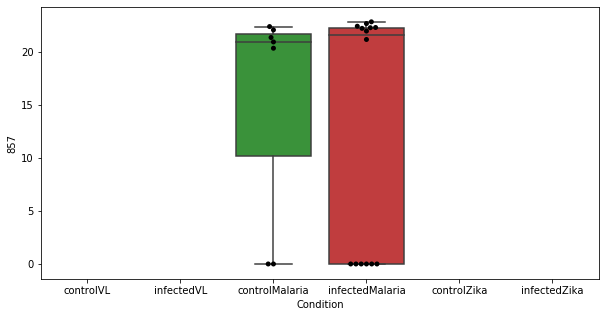

25 row m/z                   145.097
row retention time        9.83486
p-val                 0.000355808
adj.P.Val               0.0266719
custom_id                    3349
compound_names                NaN
Name: 3349, dtype: object


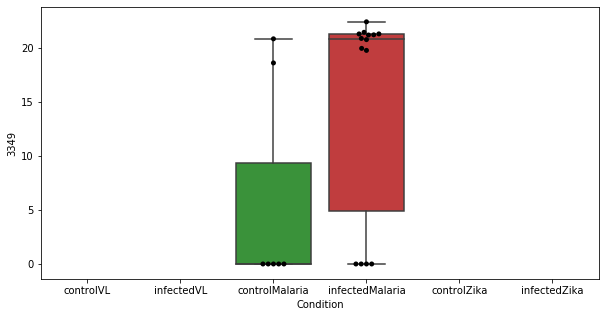

26 row m/z                   161.999
row retention time        4.89379
p-val                 0.000470522
adj.P.Val               0.0332345
custom_id                     946
compound_names                NaN
Name: 946, dtype: object


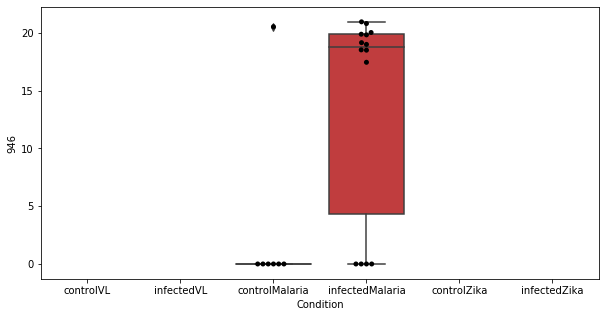

27 row m/z                   104.107
row retention time        23.7804
p-val                 0.000492196
adj.P.Val               0.0332345
custom_id                    4414
compound_names                NaN
Name: 4414, dtype: object


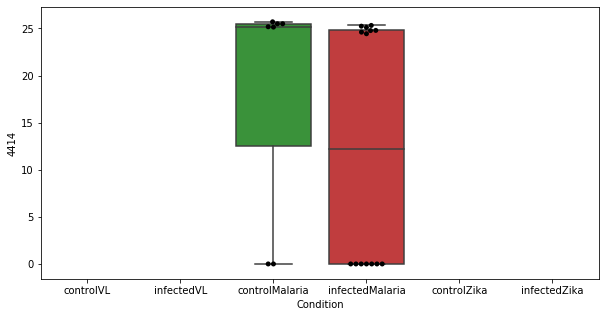

28 row m/z                   1017.68
row retention time        4.10913
p-val                 0.000502513
adj.P.Val               0.0332345
custom_id                    6292
compound_names                NaN
Name: 6292, dtype: object


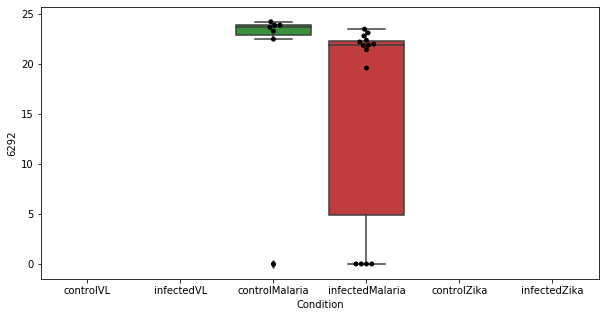

29 row m/z                    482.36
row retention time        4.15926
p-val                 0.000530938
adj.P.Val               0.0332345
custom_id                    2609
compound_names                NaN
Name: 2609, dtype: object


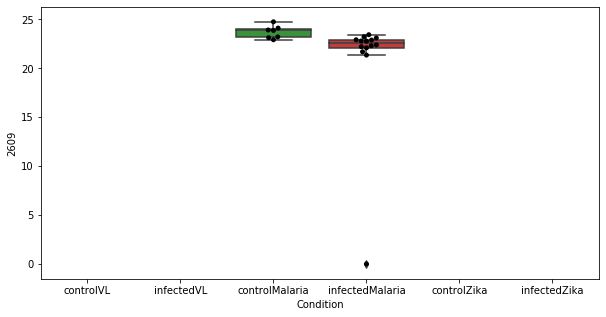

30 row m/z                   183.975
row retention time        13.8607
p-val                 0.000536697
adj.P.Val               0.0332345
custom_id                    1228
compound_names                NaN
Name: 1228, dtype: object


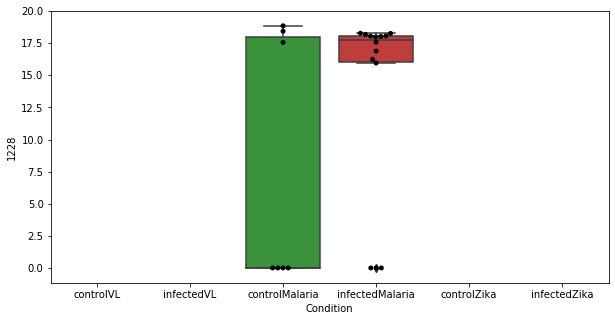

31 row m/z                   991.671
row retention time        4.13583
p-val                 0.000545667
adj.P.Val               0.0332345
custom_id                    2983
compound_names                NaN
Name: 2983, dtype: object


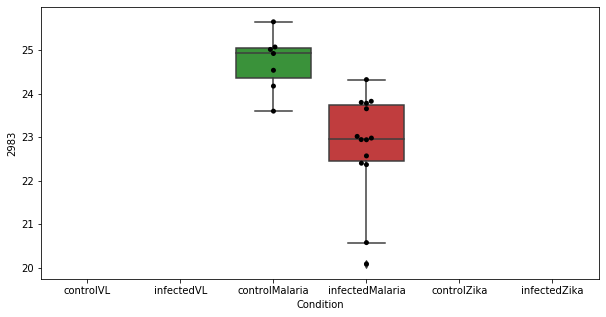

32 row m/z                     380.9
row retention time        23.6934
p-val                 0.000570826
adj.P.Val               0.0337134
custom_id                    2480
compound_names                NaN
Name: 2480, dtype: object


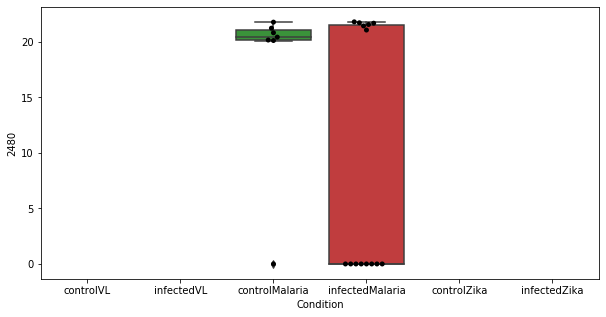

33 row m/z                   276.158
row retention time        16.5048
p-val                 0.000631847
adj.P.Val               0.0352747
custom_id                    2106
compound_names                NaN
Name: 2106, dtype: object


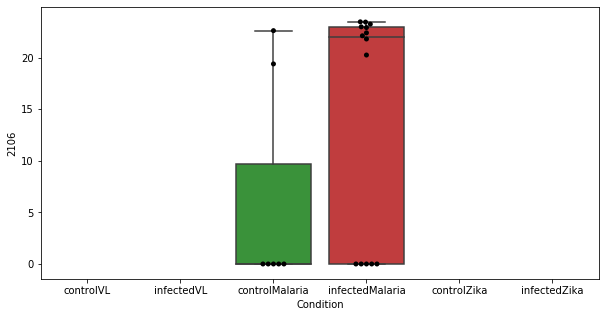

34 row m/z                  1016.67
row retention time       4.10827
p-val                 0.00063346
adj.P.Val              0.0352747
custom_id                   6291
compound_names               NaN
Name: 6291, dtype: object


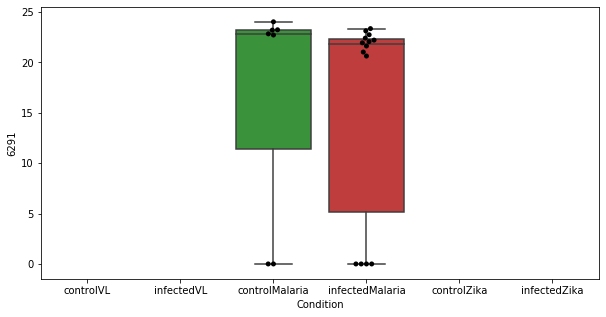

35 row m/z                   330.264
row retention time         4.4645
p-val                 0.000725907
adj.P.Val               0.0391045
custom_id                    4093
compound_names                NaN
Name: 4093, dtype: object


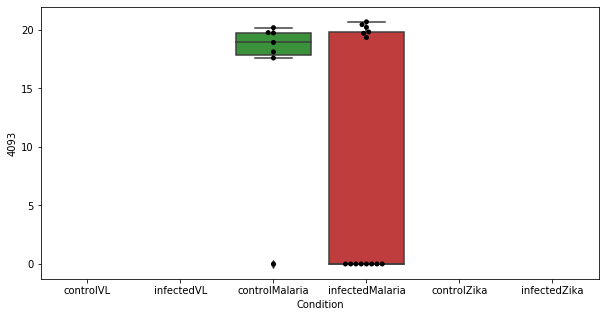

36 row m/z                   117.091
row retention time        23.4777
p-val                 0.000742364
adj.P.Val               0.0391045
custom_id                     336
compound_names                NaN
Name: 336, dtype: object


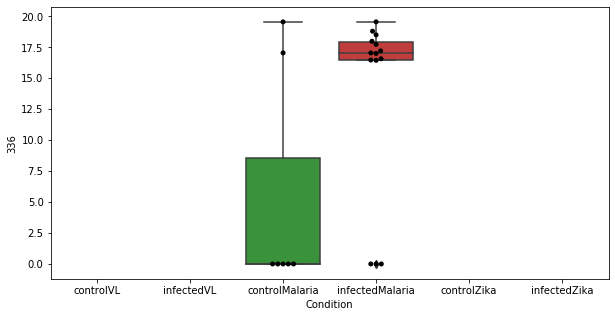

37 row m/z                                                      123.079
row retention time                                           4.42364
p-val                                                    0.000764924
adj.P.Val                                                  0.0392325
custom_id                                                       3207
compound_names        4-Methylpentanal; Isocaproaldehyde; Isohexanal
Name: 3207, dtype: object


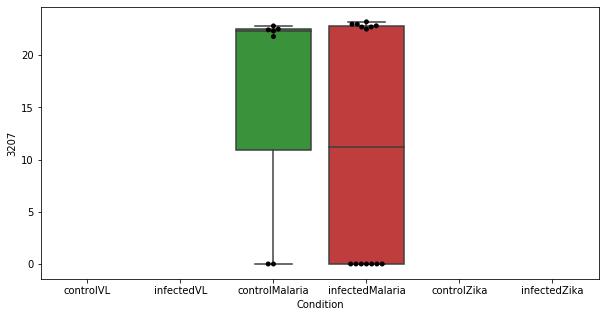

38 row m/z                   276.107
row retention time        9.79604
p-val                 0.000897586
adj.P.Val               0.0448563
custom_id                    2096
compound_names                NaN
Name: 2096, dtype: object


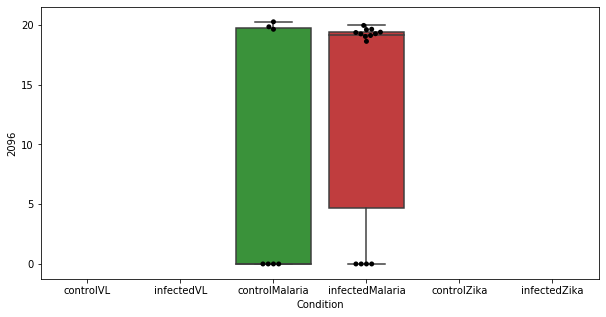

39 row m/z                  162.051
row retention time       10.8221
p-val                 0.00106735
adj.P.Val              0.0520066
custom_id                    948
compound_names               NaN
Name: 948, dtype: object


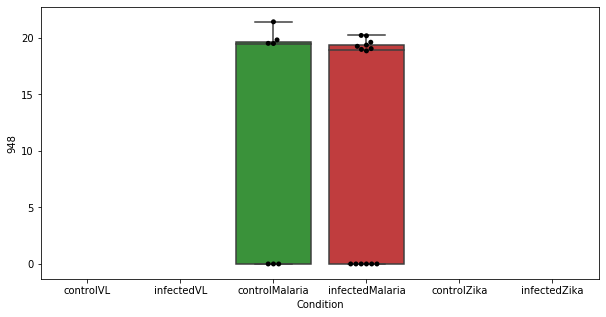

40 row m/z                  495.327
row retention time       4.14176
p-val                 0.00115444
adj.P.Val              0.0541076
custom_id                   2623
compound_names               NaN
Name: 2623, dtype: object


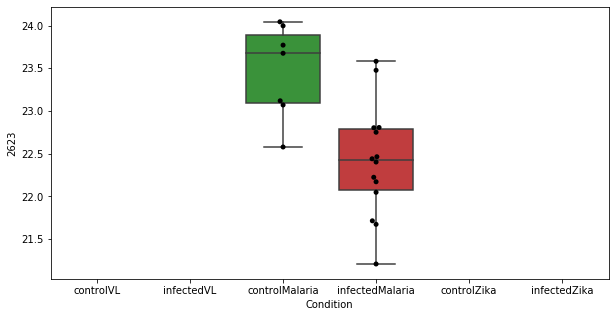

41 row m/z                  104.107
row retention time       16.8065
p-val                 0.00116599
adj.P.Val              0.0541076
custom_id                    167
compound_names               NaN
Name: 167, dtype: object


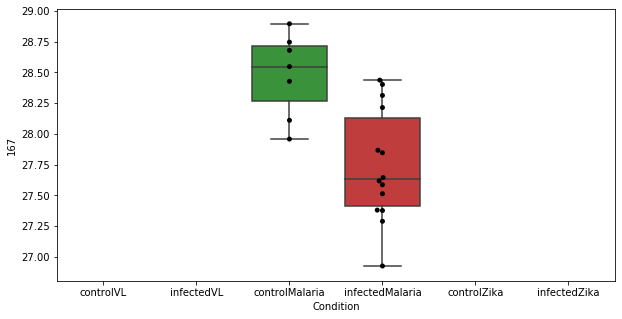

42 row m/z                          494.324
row retention time                4.1675
p-val                         0.00119971
adj.P.Val                      0.0543369
custom_id                           2621
compound_names        cervonyl carnitine
Name: 2621, dtype: object


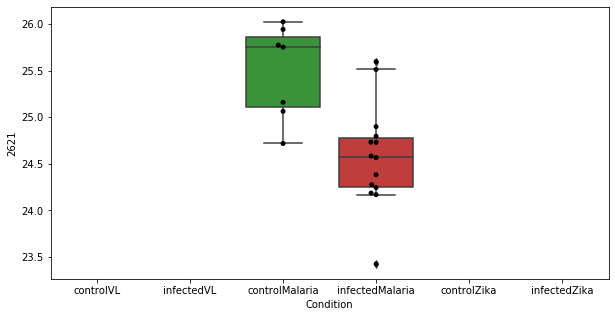

43 row m/z                  299.139
row retention time       4.22818
p-val                 0.00122669
adj.P.Val              0.0543369
custom_id                   5122
compound_names               NaN
Name: 5122, dtype: object


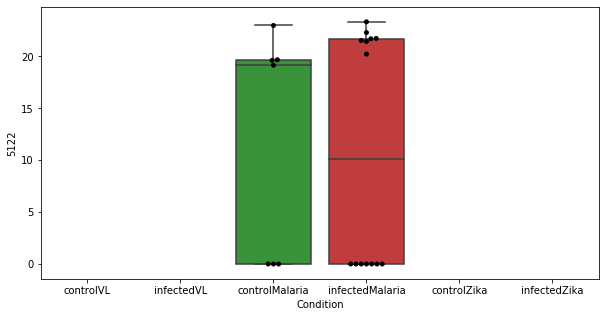

44 row m/z                  352.165
row retention time       4.32125
p-val                 0.00136309
adj.P.Val               0.058983
custom_id                   4121
compound_names               NaN
Name: 4121, dtype: object


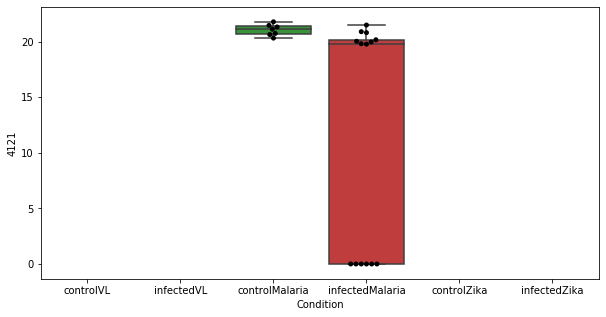

45 row m/z                  510.356
row retention time        4.0593
p-val                 0.00141553
adj.P.Val               0.058983
custom_id                   2635
compound_names               NaN
Name: 2635, dtype: object


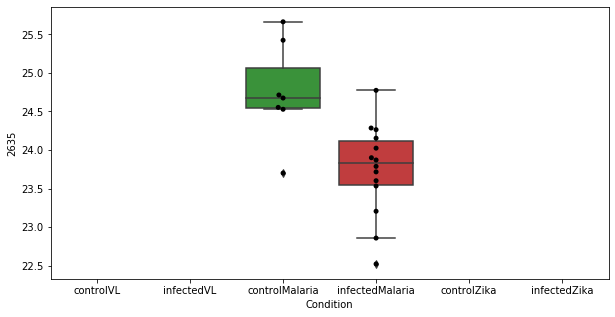

46 row m/z                  165.091
row retention time       4.11303
p-val                 0.00142776
adj.P.Val               0.058983
custom_id                    988
compound_names               NaN
Name: 988, dtype: object


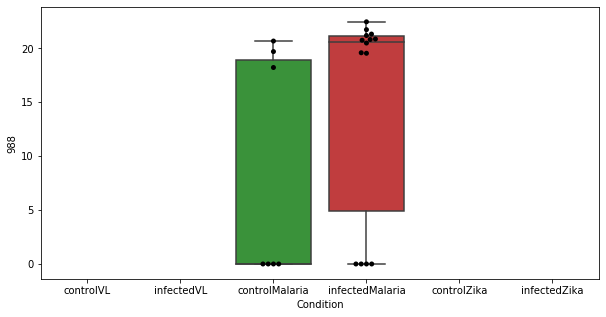

47 row m/z                   105.11
row retention time       16.7959
p-val                 0.00145263
adj.P.Val               0.058983
custom_id                    191
compound_names               NaN
Name: 191, dtype: object


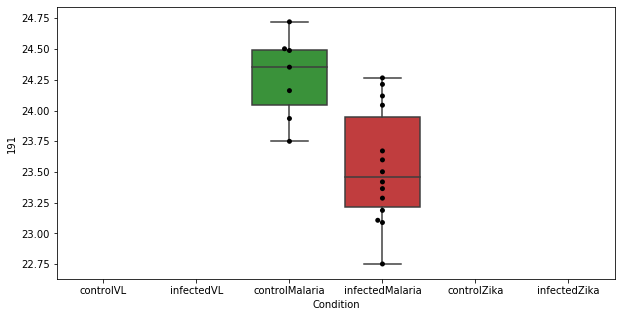

48 row m/z                  480.345
row retention time       4.05724
p-val                 0.00166308
adj.P.Val              0.0661499
custom_id                   2606
compound_names               NaN
Name: 2606, dtype: object


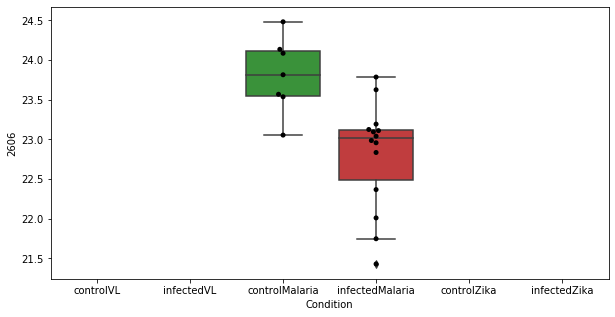

49 row m/z                                                         185.081
row retention time                                              6.99631
p-val                                                        0.00178491
adj.P.Val                                                     0.0695758
custom_id                                                          1243
compound_names        Choline phosphate; Phosphorylcholine; Phosphoc...
Name: 1243, dtype: object


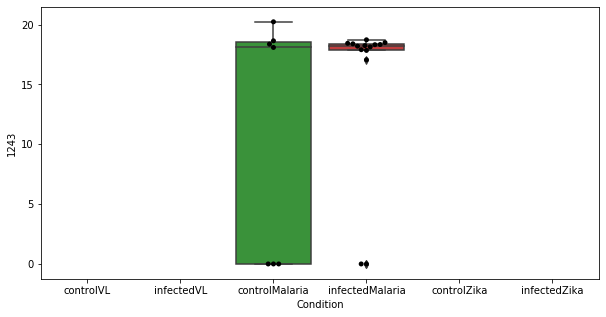

50 row m/z                  202.922
row retention time       2.62018
p-val                 0.00182265
adj.P.Val              0.0696537
custom_id                   1460
compound_names               NaN
Name: 1460, dtype: object


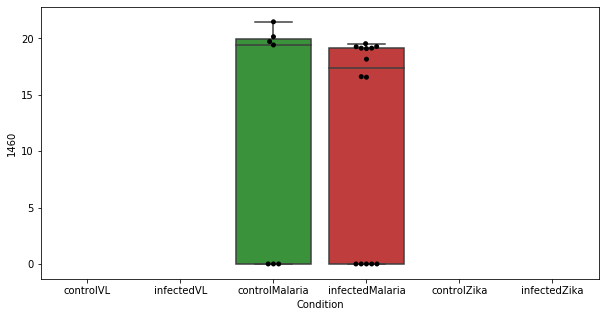

51 row m/z                                                          130.05
row retention time                                              9.57863
p-val                                                        0.00201318
adj.P.Val                                                     0.0754556
custom_id                                                           513
compound_names        L-4-Hydroxyglutamate semialdehyde$D-Glutamate;...
Name: 513, dtype: object


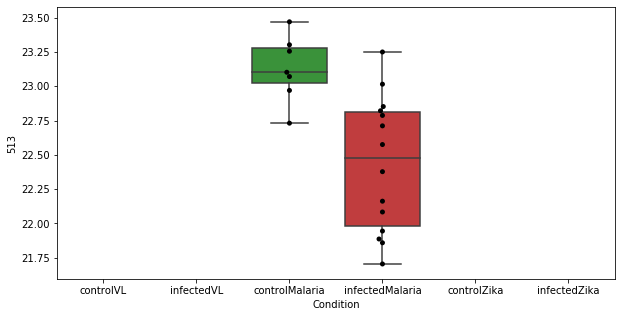

52 row m/z                  240.102
row retention time       7.83229
p-val                 0.00230186
adj.P.Val              0.0846475
custom_id                   3802
compound_names               NaN
Name: 3802, dtype: object


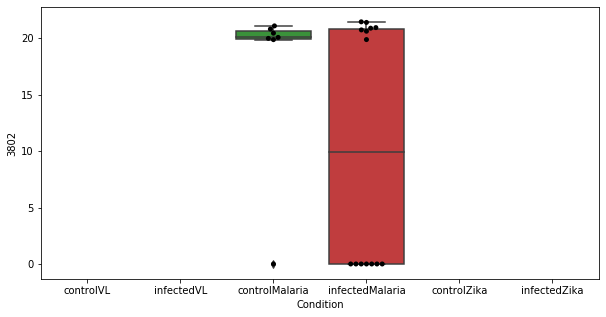

53 row m/z                  569.384
row retention time       3.27837
p-val                 0.00275523
adj.P.Val              0.0969476
custom_id                   2718
compound_names               NaN
Name: 2718, dtype: object


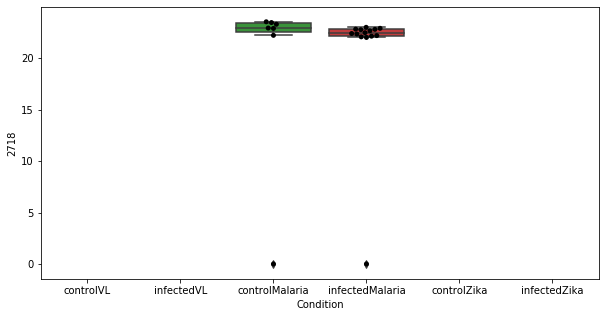

54 row m/z                  105.07
row retention time      3.78793
p-val                 0.0027621
adj.P.Val             0.0969476
custom_id                   176
compound_names              NaN
Name: 176, dtype: object


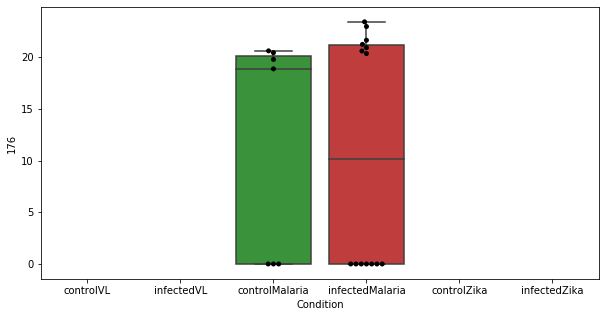

55 row m/z                  96.0556
row retention time       4.37339
p-val                 0.00278556
adj.P.Val              0.0969476
custom_id                    101
compound_names               NaN
Name: 101, dtype: object


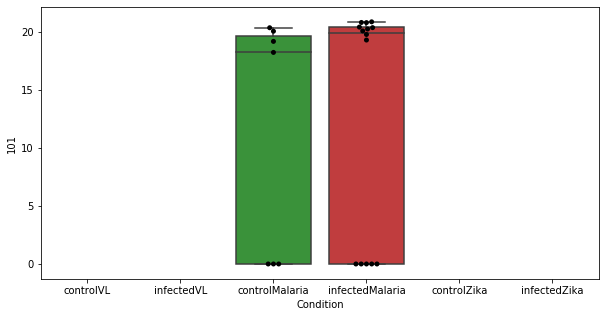

56 row m/z                            128.082
row retention time                 8.16728
p-val                           0.00292806
adj.P.Val                         0.100119
custom_id                              469
compound_names        4-Guanidinobutanoate
Name: 469, dtype: object


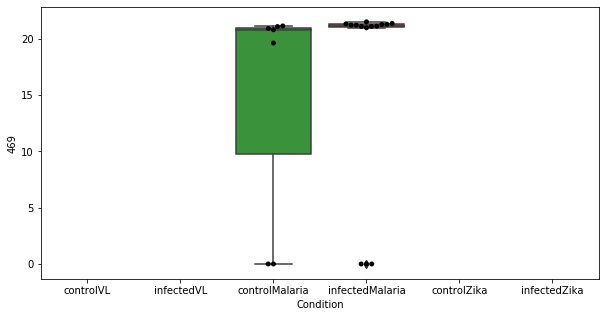

57 row m/z                                                  127.112
row retention time                                       3.75743
p-val                                                 0.00325954
adj.P.Val                                               0.106974
custom_id                                                    458
compound_names        Octanoic acid; Caprylic acid; Octylic acid
Name: 458, dtype: object


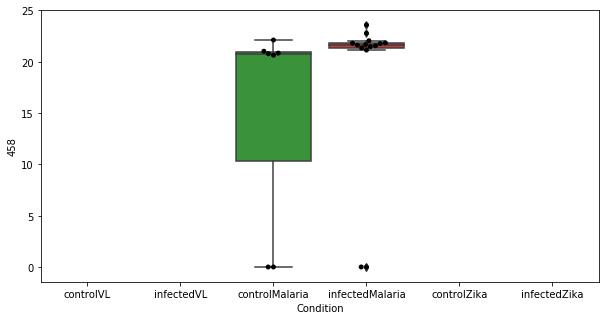

58 row m/z                  231.134
row retention time       8.45553
p-val                 0.00329239
adj.P.Val               0.106974
custom_id                   1730
compound_names               NaN
Name: 1730, dtype: object


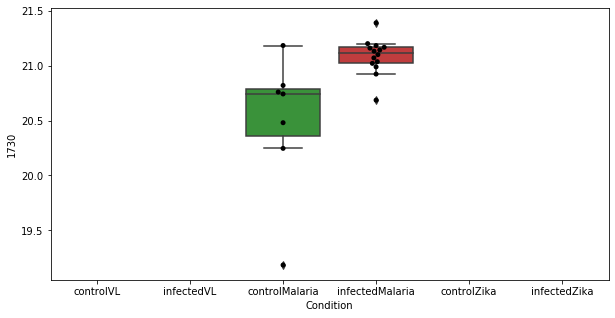

59 row m/z                  511.359
row retention time       4.05651
p-val                 0.00330948
adj.P.Val               0.106974
custom_id                   2637
compound_names               NaN
Name: 2637, dtype: object


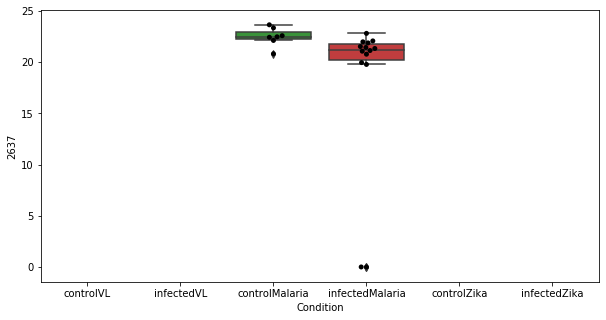

60 row m/z                  282.138
row retention time       4.46464
p-val                 0.00334807
adj.P.Val               0.106974
custom_id                   5091
compound_names               NaN
Name: 5091, dtype: object


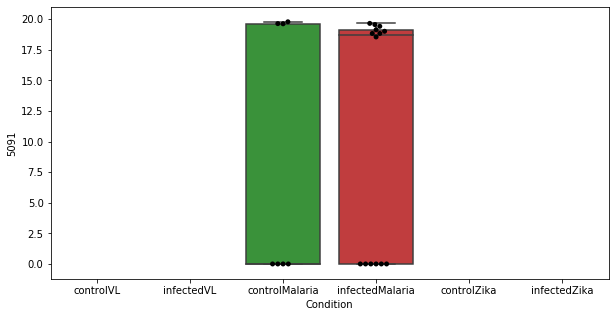

61 row m/z                  659.834
row retention time        10.684
p-val                 0.00350559
adj.P.Val                 0.1102
custom_id                   2795
compound_names               NaN
Name: 2795, dtype: object


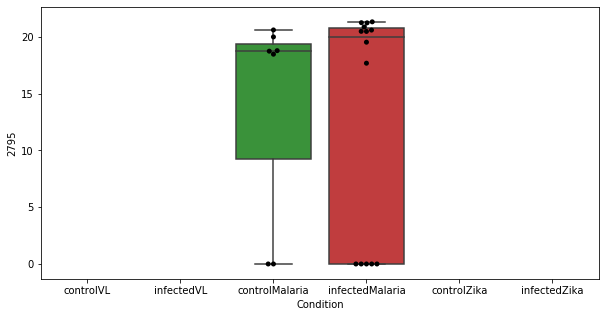

62 row m/z                  482.324
row retention time       4.17473
p-val                 0.00373325
adj.P.Val                0.11388
custom_id                   2608
compound_names               NaN
Name: 2608, dtype: object


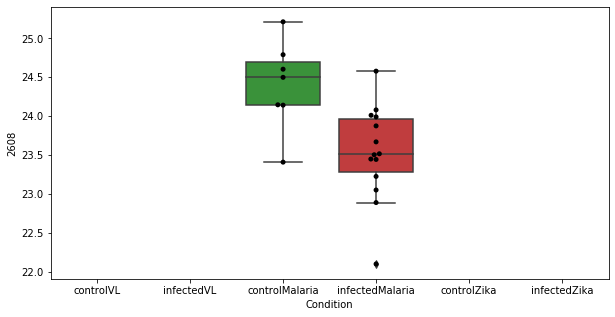

63 row m/z                  472.202
row retention time       14.0914
p-val                 0.00373952
adj.P.Val                0.11388
custom_id                   6210
compound_names               NaN
Name: 6210, dtype: object


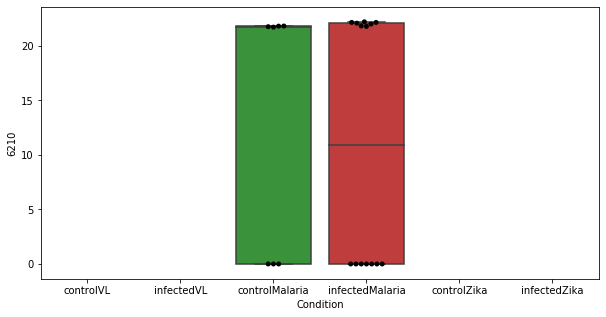

64 row m/z                            468.308
row retention time                  4.2516
p-val                           0.00387314
adj.P.Val                         0.114024
custom_id                             2595
compound_names        Timnodonyl carnitine
Name: 2595, dtype: object


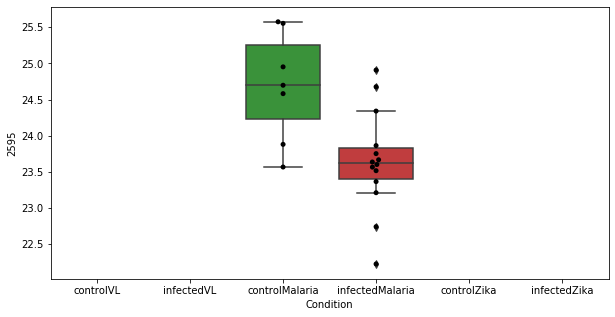

65 row m/z                  548.865
row retention time       11.9762
p-val                 0.00389914
adj.P.Val               0.114024
custom_id                   2695
compound_names               NaN
Name: 2695, dtype: object


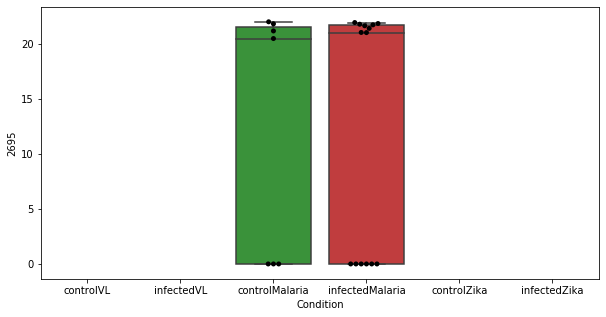

66 row m/z                    380.9
row retention time       2.85585
p-val                 0.00391975
adj.P.Val               0.114024
custom_id                   4163
compound_names               NaN
Name: 4163, dtype: object


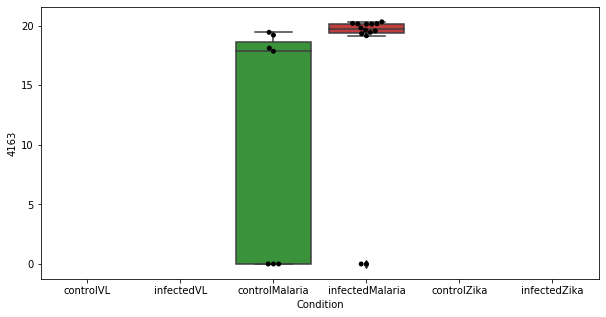

67 row m/z                  159.157
row retention time       3.89348
p-val                 0.00428072
adj.P.Val               0.122461
custom_id                   4702
compound_names               NaN
Name: 4702, dtype: object


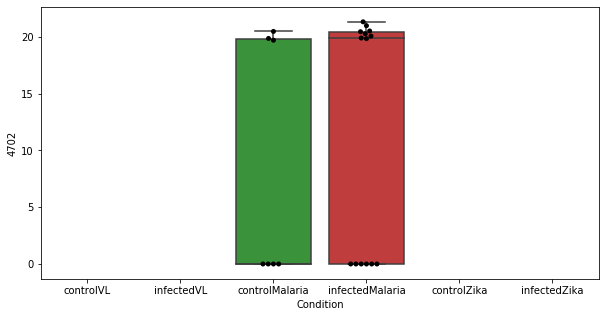

68 row m/z                   276.66
row retention time       17.4458
p-val                 0.00433547
adj.P.Val               0.122461
custom_id                   2121
compound_names               NaN
Name: 2121, dtype: object


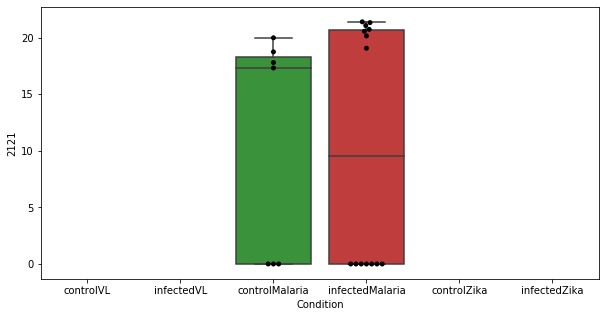

69 row m/z                  199.133
row retention time       3.87461
p-val                 0.00447339
adj.P.Val               0.123232
custom_id                   1421
compound_names               NaN
Name: 1421, dtype: object


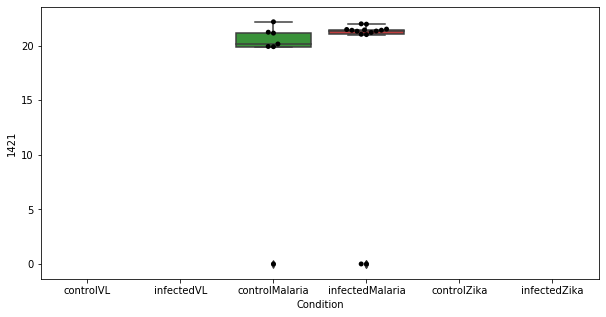

70 row m/z                                                          130.05
row retention time                                              4.54552
p-val                                                         0.0044892
adj.P.Val                                                      0.123232
custom_id                                                           515
compound_names        1-Pyrroline-4-hydroxy-2-carboxylate$L-1-Pyrrol...
Name: 515, dtype: object


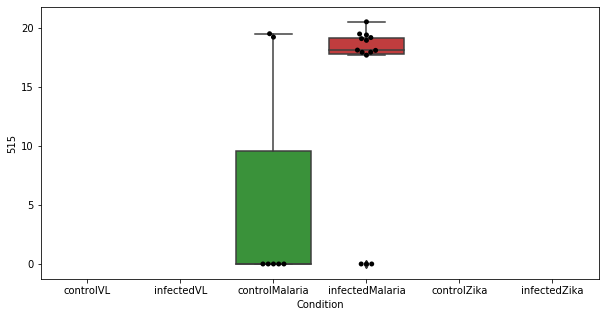

71 row m/z                  141.114
row retention time        5.0499
p-val                 0.00465489
adj.P.Val               0.126005
custom_id                    661
compound_names               NaN
Name: 661, dtype: object


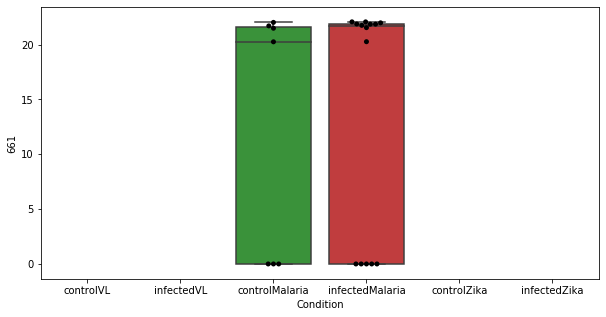

72 row m/z                                                         128.071
row retention time                                              10.1615
p-val                                                        0.00476257
adj.P.Val                                                      0.127154
custom_id                                                           465
compound_names        6-Amino-2-oxohexanoate; 2-Oxo-6-aminocaproate$...
Name: 465, dtype: object


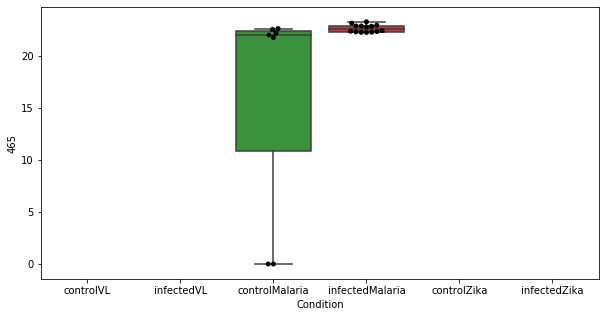

73 row m/z                  323.851
row retention time       23.7398
p-val                 0.00533906
adj.P.Val               0.138632
custom_id                   2347
compound_names               NaN
Name: 2347, dtype: object


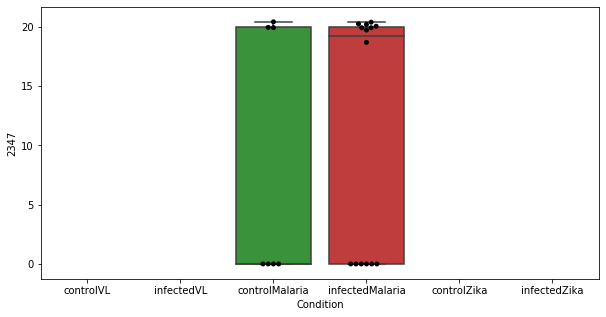

74 row m/z                                                          496.34
row retention time                                              6.92577
p-val                                                         0.0053677
adj.P.Val                                                      0.138632
custom_id                                                          2625
compound_names        docosa-4,7,10,13,16-pentaenoyl carnitine$clupa...
Name: 2625, dtype: object


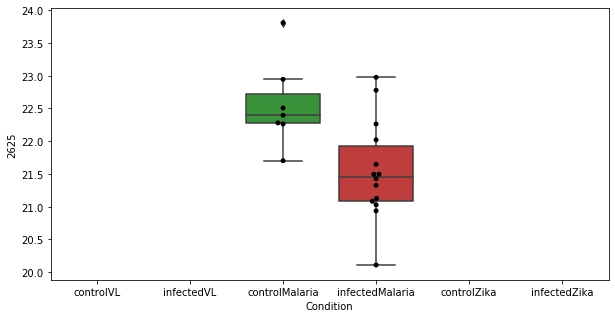

75 row m/z                            128.107
row retention time                 4.48309
p-val                           0.00540587
adj.P.Val                         0.138632
custom_id                              479
compound_names        3-Dehydroxycarnitine
Name: 479, dtype: object


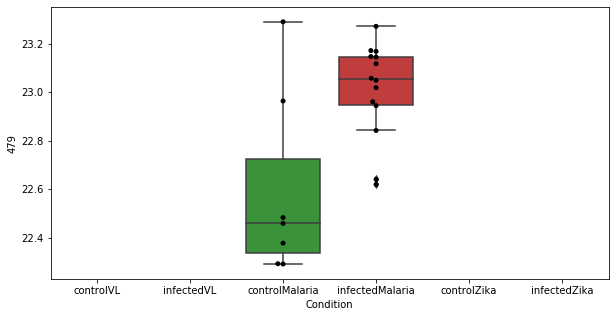

76 row m/z                  469.312
row retention time       4.26137
p-val                 0.00547977
adj.P.Val               0.138702
custom_id                   2597
compound_names               NaN
Name: 2597, dtype: object


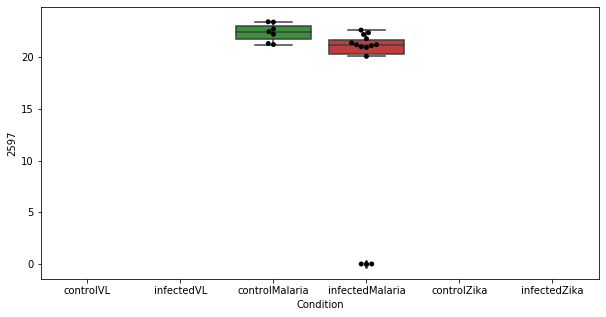

77 row m/z                  352.165
row retention time       6.92361
p-val                 0.00560512
adj.P.Val               0.140056
custom_id                   4122
compound_names               NaN
Name: 4122, dtype: object


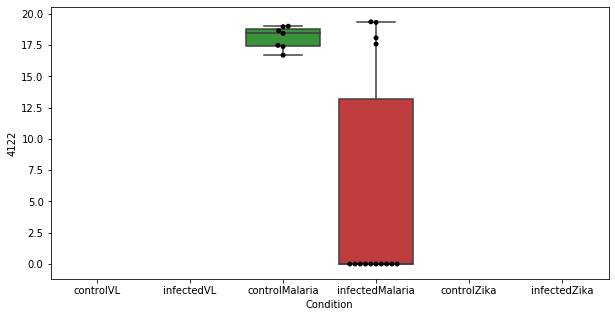

78 row m/z                 286.179
row retention time      10.7314
p-val                 0.0058234
adj.P.Val              0.143669
custom_id                  2174
compound_names              NaN
Name: 2174, dtype: object


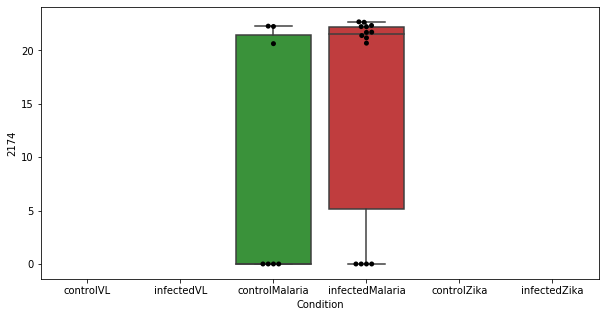

79 row m/z                                                         112.076
row retention time                                              4.60679
p-val                                                        0.00627036
adj.P.Val                                                      0.152762
custom_id                                                           249
compound_names        L-Normetanephrine$L-Adrenaline; (R)-(-)-Adrena...
Name: 249, dtype: object


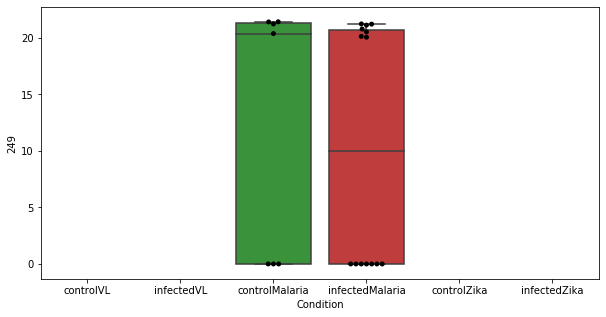

80 row m/z                   164.93
row retention time       12.8514
p-val                 0.00643957
adj.P.Val               0.153574
custom_id                    983
compound_names               NaN
Name: 983, dtype: object


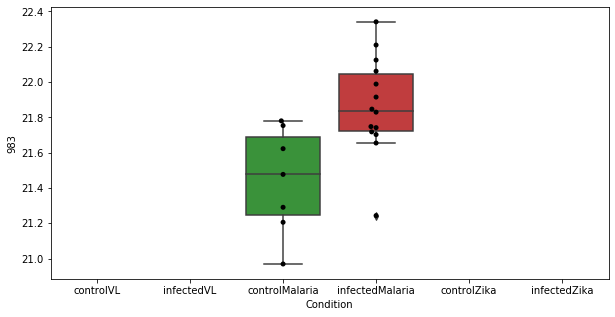

81 row m/z                                                         101.071
row retention time                                              9.54273
p-val                                                        0.00650921
adj.P.Val                                                      0.153574
custom_id                                                          4400
compound_names        5,6-Dihydrothymine; Dihydrothymine; 5,6-Dihydr...
Name: 4400, dtype: object


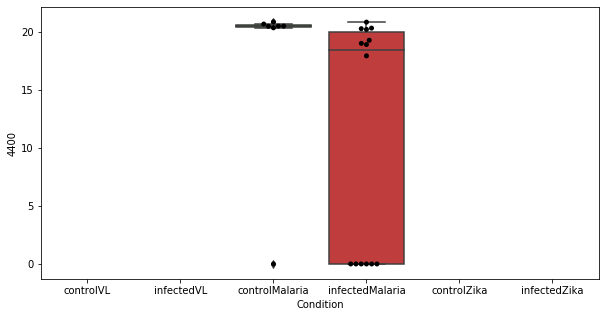

82 row m/z                                                         184.097
row retention time                                              4.58509
p-val                                                        0.00654008
adj.P.Val                                                      0.153574
custom_id                                                          4804
compound_names        L-Normetanephrine$L-Adrenaline; (R)-(-)-Adrena...
Name: 4804, dtype: object


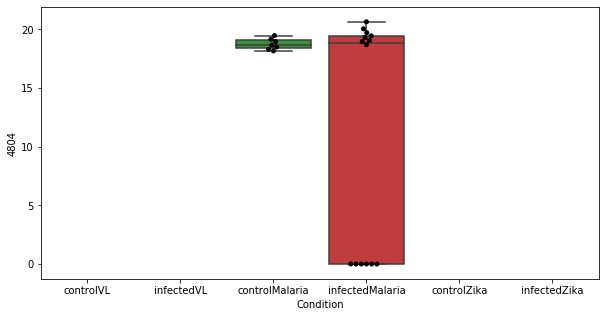

83 row m/z                 216.069
row retention time      4.50982
p-val                 0.0068342
adj.P.Val               0.15857
custom_id                  1600
compound_names              NaN
Name: 1600, dtype: object


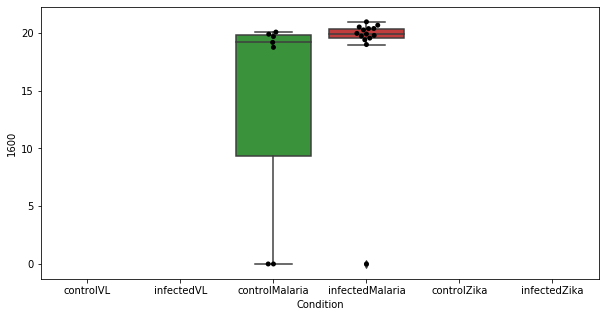

84 row m/z                                                         149.064
row retention time                                              12.1614
p-val                                                        0.00729815
adj.P.Val                                                      0.167342
custom_id                                                          4663
compound_names        L-4-Hydroxyglutamate semialdehyde$D-Glutamate;...
Name: 4663, dtype: object


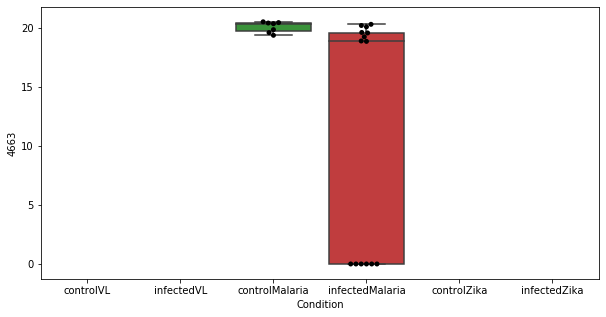

85 row m/z                   77.079
row retention time       9.68399
p-val                 0.00754586
adj.P.Val               0.169504
custom_id                     20
compound_names               NaN
Name: 20, dtype: object


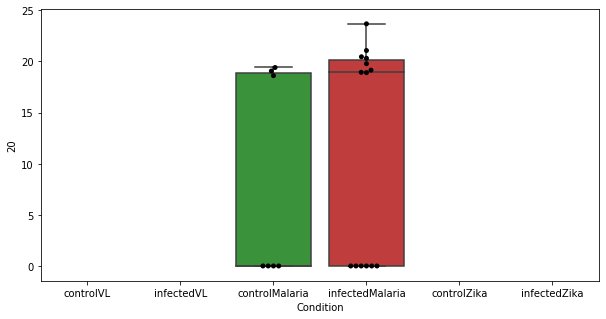

86 row m/z                   184.92
row retention time       15.0732
p-val                 0.00756636
adj.P.Val               0.169504
custom_id                   3554
compound_names               NaN
Name: 3554, dtype: object


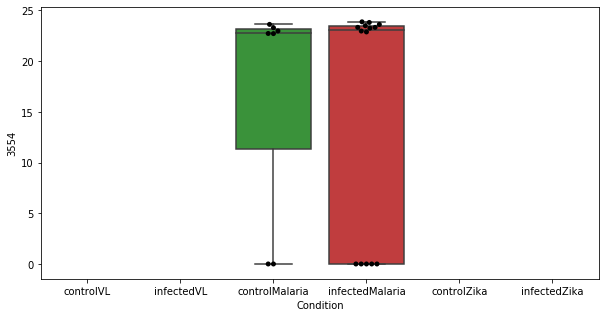

87 row m/z                  184.073
row retention time       11.8461
p-val                 0.00771099
adj.P.Val               0.170781
custom_id                   1231
compound_names               NaN
Name: 1231, dtype: object


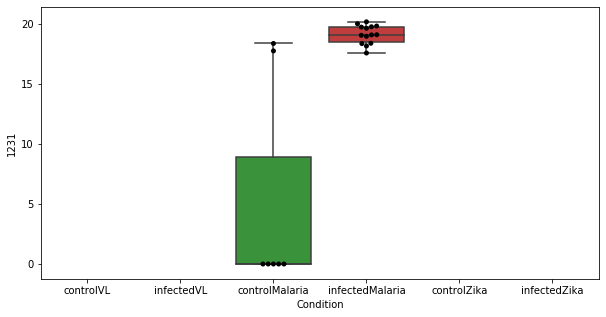

88 row m/z                   376.19
row retention time       3.64989
p-val                 0.00783554
adj.P.Val               0.171589
custom_id                   2464
compound_names               NaN
Name: 2464, dtype: object


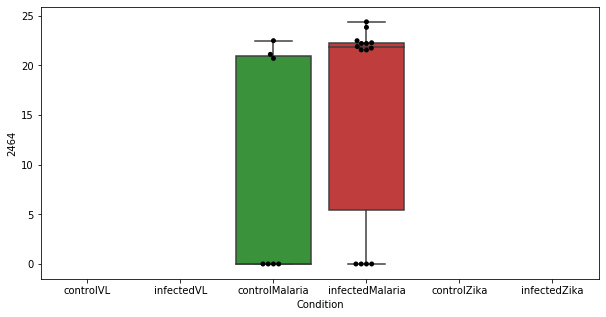

89 row m/z                  344.136
row retention time       3.71259
p-val                 0.00831545
adj.P.Val               0.180076
custom_id                   2410
compound_names               NaN
Name: 2410, dtype: object


KeyboardInterrupt: 

In [62]:
#limma_topfeatures = all_samples_log.loc[toptable.index]
limma_topfeatures = all_samples_log.loc[pdata.index]
limma_topfeatures = limma_topfeatures.transpose()
limma_topfeatures["Condition"] = np.array(sample_description["ConditionDataset"])
for i in range(len(list(limma_topfeatures.columns))):
    print(i,data.loc[list(limma_topfeatures.columns)[i]])
    plt.figure(figsize=(10,5))
    ax = sns.boxplot(y=list(limma_topfeatures.columns)[i], x="Condition", data = limma_topfeatures, order = ['controlVL','infectedVL','controlMalaria', 'infectedMalaria', 'controlZika','infectedZika'] )
    ax = sns.swarmplot(y=list(limma_topfeatures.columns)[i], x="Condition", data = limma_topfeatures, order = ['controlVL','infectedVL','controlMalaria', 'infectedMalaria', 'controlZika','infectedZika'], color="black")
    plt.show()

0 row m/z                   228.032
row retention time        7.95626
p-val                  2.7908e-33
adj.P.Val             5.43926e-30
custom_id                    3749
compound_names                NaN
Name: 3749, dtype: object


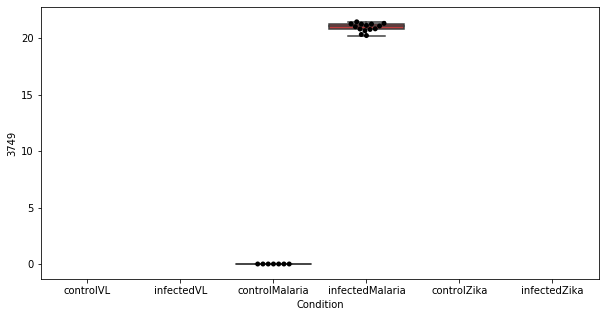

1 row m/z                                                   268.104
row retention time                                        8.25438
p-val                                                 9.08261e-11
adj.P.Val                                               8.851e-08
custom_id                                                    2029
compound_names        Adenosine$Deoxyguanosine; 2'-Deoxyguanosine
Name: 2029, dtype: object


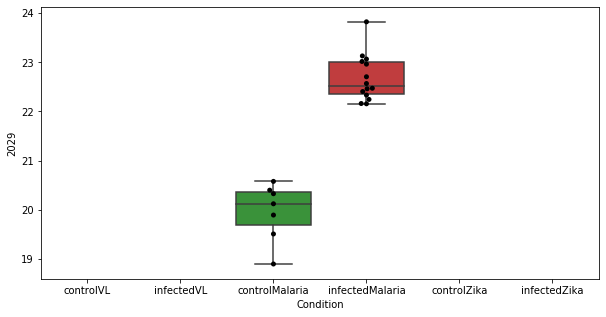

2 row m/z                    258.11
row retention time        11.6816
p-val                 5.38375e-08
adj.P.Val             3.49764e-05
custom_id                    1971
compound_names                NaN
Name: 1971, dtype: object


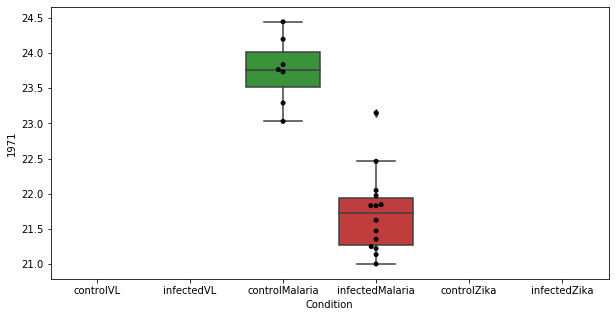

3 row m/z                   276.158
row retention time        17.4298
p-val                 3.28783e-07
adj.P.Val             0.000149445
custom_id                    2108
compound_names                NaN
Name: 2108, dtype: object


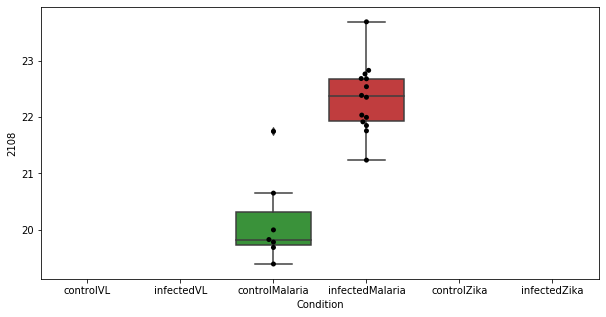

4 row m/z                   166.032
row retention time        5.60225
p-val                 3.83389e-07
adj.P.Val             0.000149445
custom_id                     997
compound_names                NaN
Name: 997, dtype: object


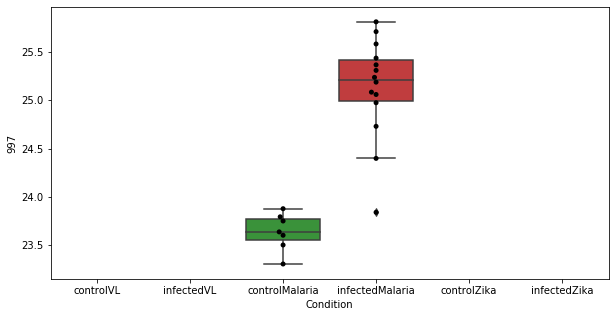

5 row m/z                    1019.7
row retention time         4.0836
p-val                 5.52239e-07
adj.P.Val             0.000179386
custom_id                    5299
compound_names                NaN
Name: 5299, dtype: object


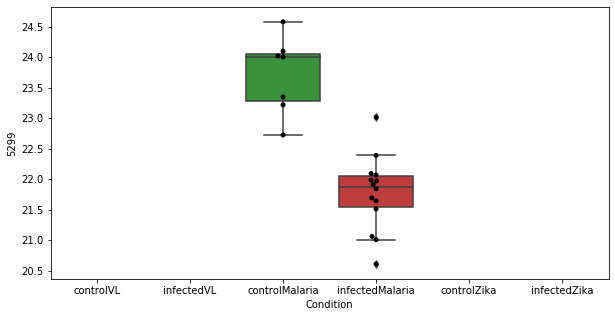

6 row m/z                   992.674
row retention time        4.12404
p-val                 1.81754e-06
adj.P.Val             0.000506055
custom_id                    2984
compound_names                NaN
Name: 2984, dtype: object


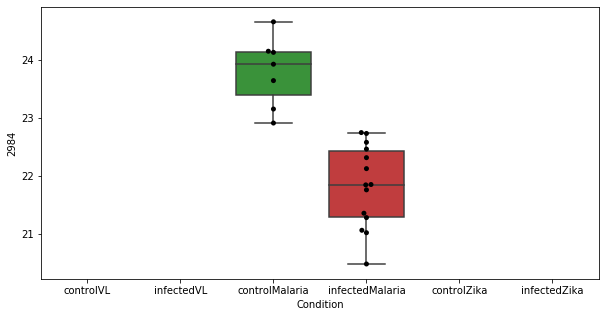

7 row m/z                    1020.7
row retention time        4.07943
p-val                 2.69765e-06
adj.P.Val             0.000657215
custom_id                    5300
compound_names                NaN
Name: 5300, dtype: object


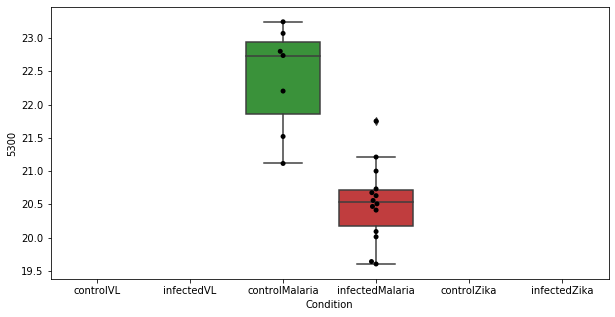

8 row m/z                   340.041
row retention time        7.56596
p-val                 4.96351e-06
adj.P.Val              0.00107488
custom_id                    2396
compound_names                NaN
Name: 2396, dtype: object


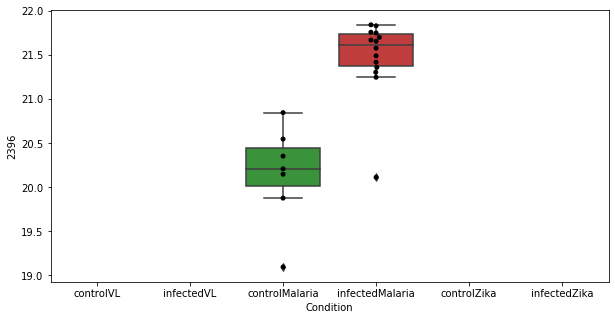

9 row m/z                  268.893
row retention time       13.8029
p-val                 2.1934e-05
adj.P.Val             0.00427493
custom_id                   2048
compound_names               NaN
Name: 2048, dtype: object


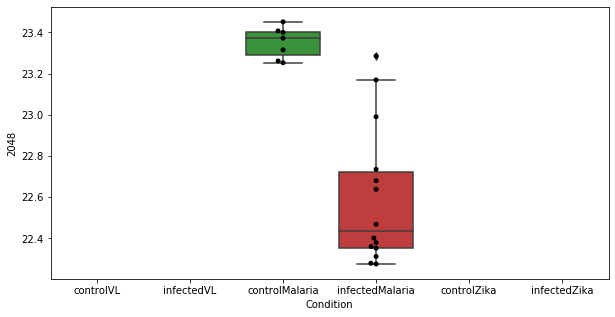

10 row m/z                                                         241.031
row retention time                                              12.9424
p-val                                                       2.50628e-05
adj.P.Val                                                    0.00444067
custom_id                                                          1836
compound_names        L-Cystine; L-Dicysteine; L-alpha-Diamino-beta-...
Name: 1836, dtype: object


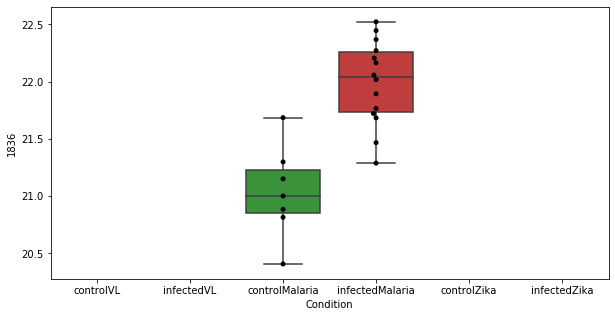

11 row m/z                   287.204
row retention time        4.59137
p-val                 3.30939e-05
adj.P.Val              0.00537499
custom_id                    2185
compound_names                NaN
Name: 2185, dtype: object


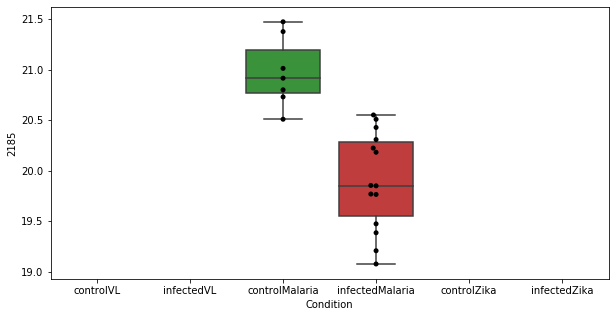

12 row m/z                    228.91
row retention time        15.0038
p-val                 7.13891e-05
adj.P.Val               0.0107029
custom_id                    1706
compound_names                NaN
Name: 1706, dtype: object


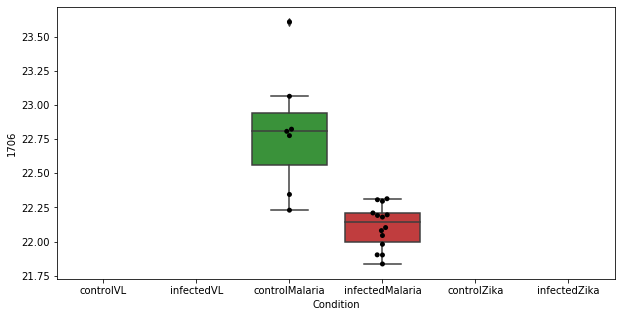

13 row m/z                  234.912
row retention time        23.774
p-val                 7.7142e-05
adj.P.Val              0.0107393
custom_id                   1761
compound_names               NaN
Name: 1761, dtype: object


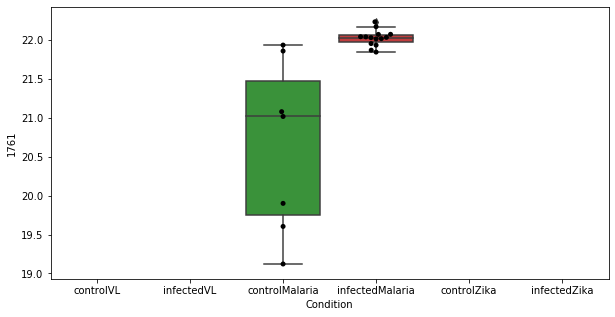

14 row m/z                                                         524.371
row retention time                                              4.01952
p-val                                                       0.000124052
adj.P.Val                                                     0.0161184
custom_id                                                          2650
compound_names        tetracosapentaenoyl carnitine$tetracosapentaen...
Name: 2650, dtype: object


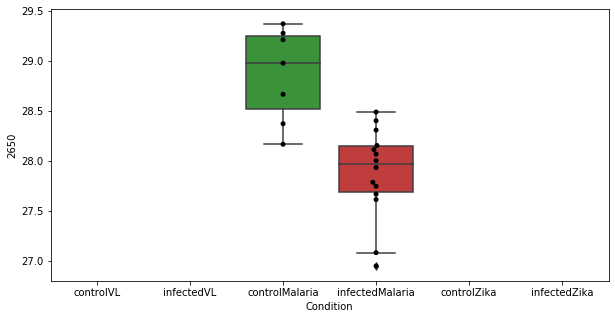

15 row m/z                   525.375
row retention time        4.01159
p-val                 0.000143717
adj.P.Val               0.0175065
custom_id                    2651
compound_names                NaN
Name: 2651, dtype: object


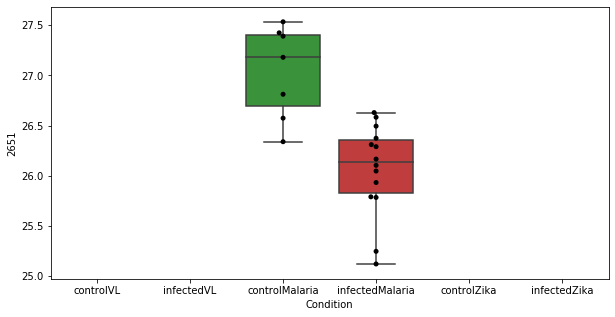

16 row m/z                   586.273
row retention time        7.00261
p-val                 0.000161389
adj.P.Val               0.0175445
custom_id                    6229
compound_names          Bilirubin
Name: 6229, dtype: object


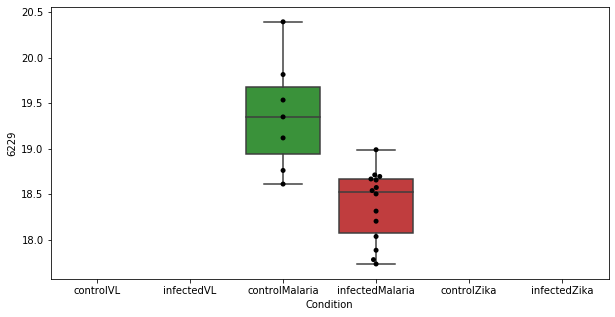

17 row m/z                   498.346
row retention time        4.11398
p-val                 0.000174516
adj.P.Val               0.0175445
custom_id                    2627
compound_names                NaN
Name: 2627, dtype: object


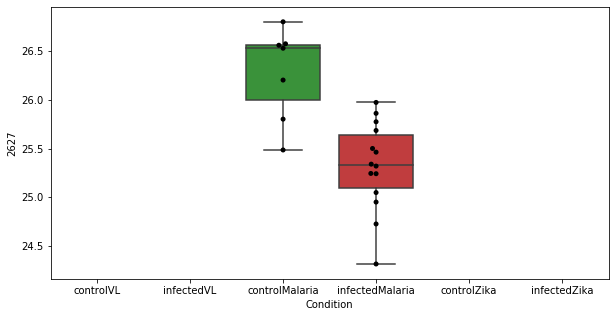

18 row m/z                   497.343
row retention time        4.11987
p-val                 0.000179109
adj.P.Val               0.0175445
custom_id                    2626
compound_names                NaN
Name: 2626, dtype: object


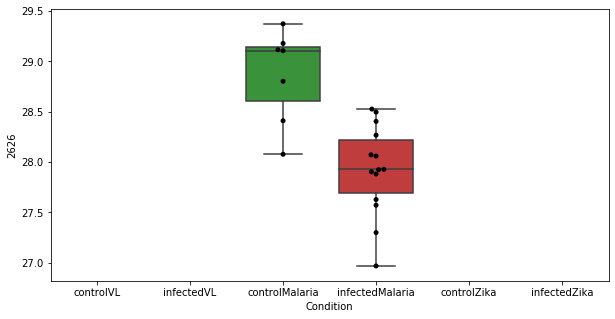

19 row m/z                   163.033
row retention time        4.86827
p-val                 0.000180036
adj.P.Val               0.0175445
custom_id                     962
compound_names                NaN
Name: 962, dtype: object


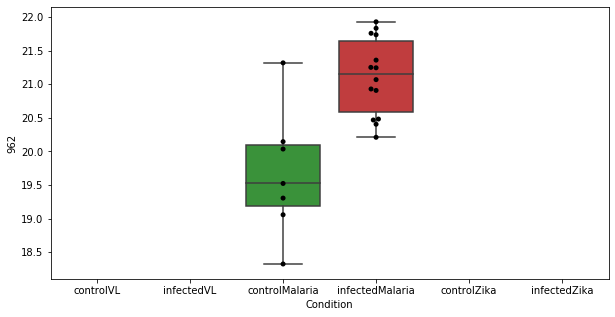

20 row m/z                   499.348
row retention time        4.09872
p-val                 0.000205041
adj.P.Val               0.0190298
custom_id                    2628
compound_names                NaN
Name: 2628, dtype: object


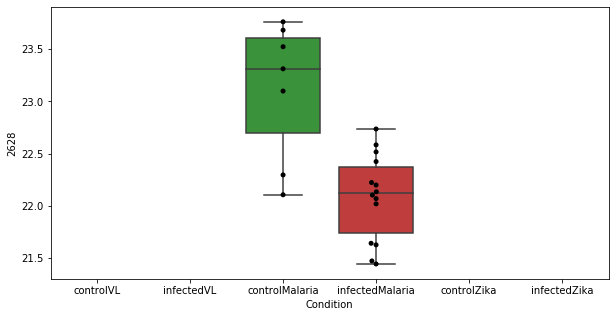

21 row m/z                                                          496.34
row retention time                                              4.11399
p-val                                                       0.000221992
adj.P.Val                                                     0.0196664
custom_id                                                          2624
compound_names        docosa-4,7,10,13,16-pentaenoyl carnitine$clupa...
Name: 2624, dtype: object


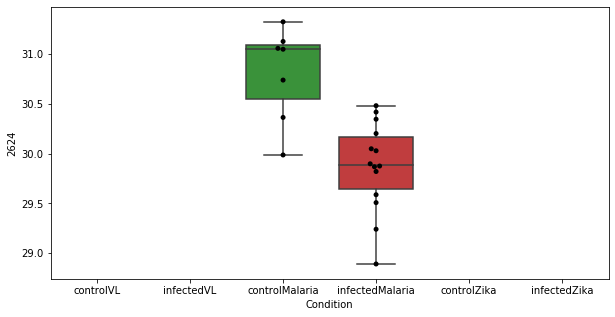

22 row m/z                                                         508.376
row retention time                                              4.07224
p-val                                                       0.000239961
adj.P.Val                                                     0.0197725
custom_id                                                          2634
compound_names        1-Acyl-sn-glycero-3-phosphocholine; 1-Acyl-sn-...
Name: 2634, dtype: object


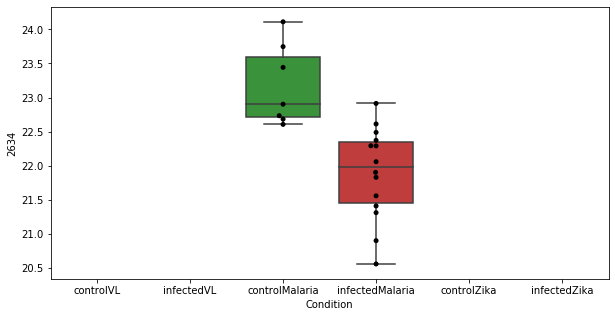

23 row m/z                   526.377
row retention time        4.01158
p-val                 0.000243479
adj.P.Val               0.0197725
custom_id                    2655
compound_names                NaN
Name: 2655, dtype: object


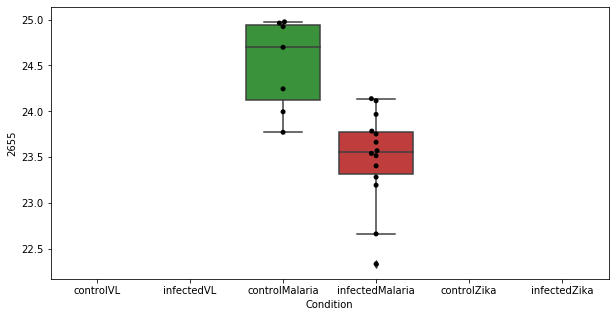

24 row m/z                   155.107
row retention time        3.88597
p-val                 0.000294515
adj.P.Val               0.0229604
custom_id                     857
compound_names                NaN
Name: 857, dtype: object


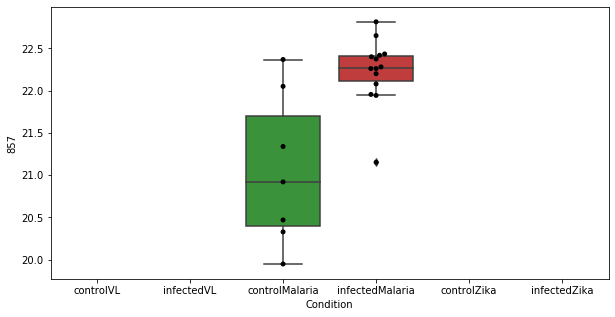

25 row m/z                   145.097
row retention time        9.83486
p-val                 0.000355808
adj.P.Val               0.0266719
custom_id                    3349
compound_names                NaN
Name: 3349, dtype: object


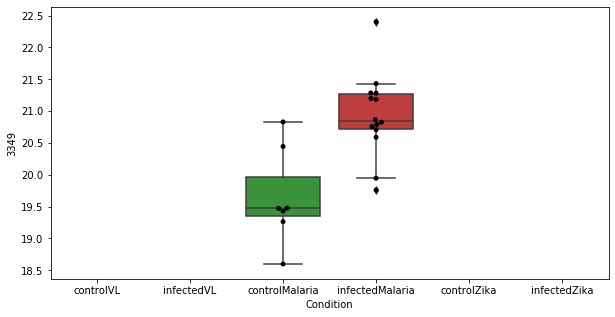

26 row m/z                   161.999
row retention time        4.89379
p-val                 0.000470522
adj.P.Val               0.0332345
custom_id                     946
compound_names                NaN
Name: 946, dtype: object


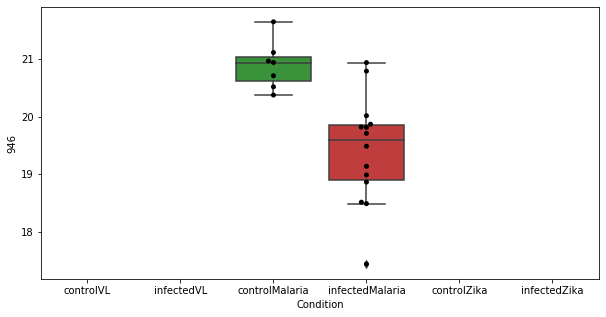

27 row m/z                   104.107
row retention time        23.7804
p-val                 0.000492196
adj.P.Val               0.0332345
custom_id                    4414
compound_names                NaN
Name: 4414, dtype: object


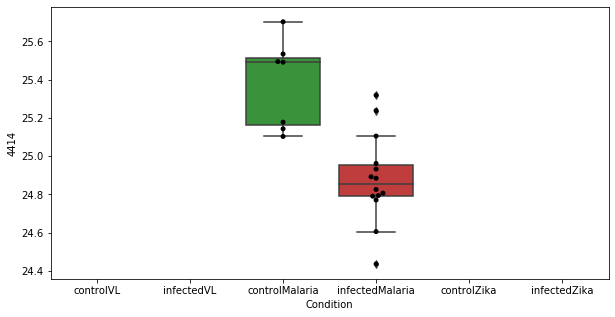

28 row m/z                   1017.68
row retention time        4.10913
p-val                 0.000502513
adj.P.Val               0.0332345
custom_id                    6292
compound_names                NaN
Name: 6292, dtype: object


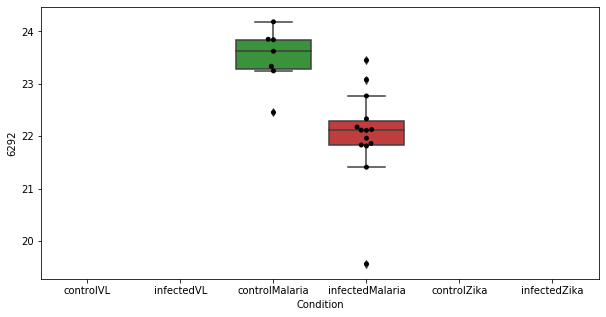

29 row m/z                    482.36
row retention time        4.15926
p-val                 0.000530938
adj.P.Val               0.0332345
custom_id                    2609
compound_names                NaN
Name: 2609, dtype: object


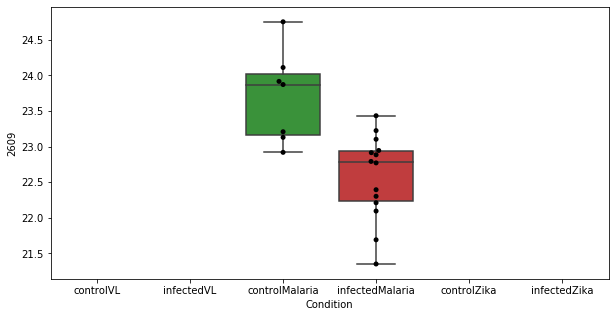

30 row m/z                   183.975
row retention time        13.8607
p-val                 0.000536697
adj.P.Val               0.0332345
custom_id                    1228
compound_names                NaN
Name: 1228, dtype: object


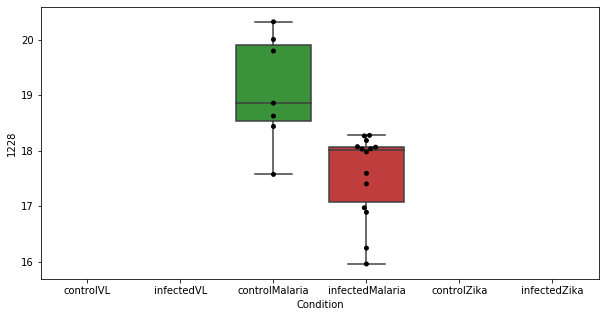

31 row m/z                   991.671
row retention time        4.13583
p-val                 0.000545667
adj.P.Val               0.0332345
custom_id                    2983
compound_names                NaN
Name: 2983, dtype: object


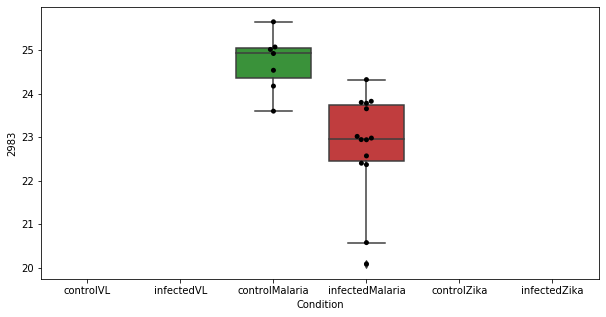

32 row m/z                     380.9
row retention time        23.6934
p-val                 0.000570826
adj.P.Val               0.0337134
custom_id                    2480
compound_names                NaN
Name: 2480, dtype: object


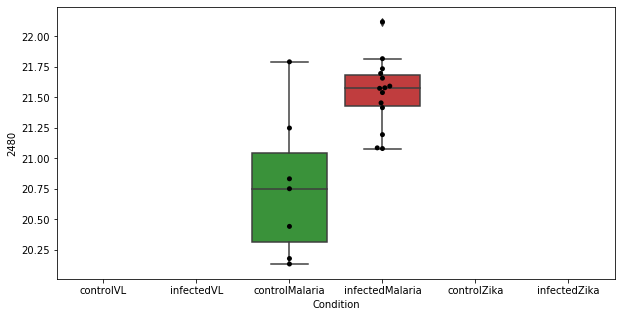

33 row m/z                   276.158
row retention time        16.5048
p-val                 0.000631847
adj.P.Val               0.0352747
custom_id                    2106
compound_names                NaN
Name: 2106, dtype: object


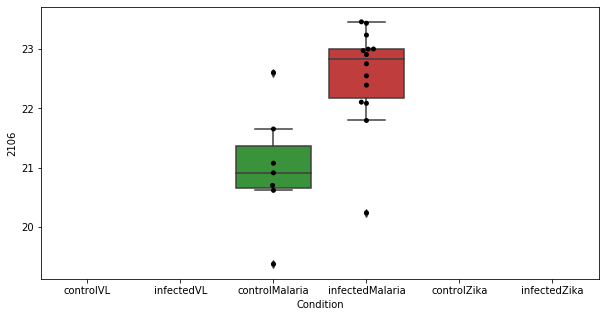

34 row m/z                  1016.67
row retention time       4.10827
p-val                 0.00063346
adj.P.Val              0.0352747
custom_id                   6291
compound_names               NaN
Name: 6291, dtype: object


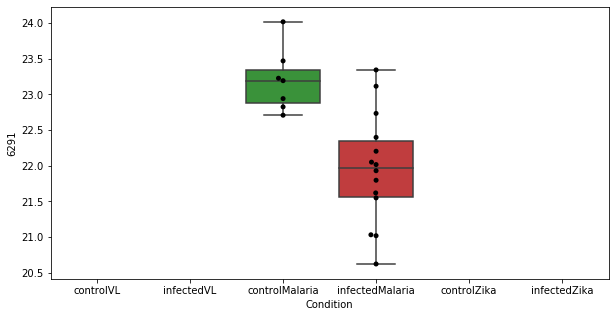

35 row m/z                   330.264
row retention time         4.4645
p-val                 0.000725907
adj.P.Val               0.0391045
custom_id                    4093
compound_names                NaN
Name: 4093, dtype: object


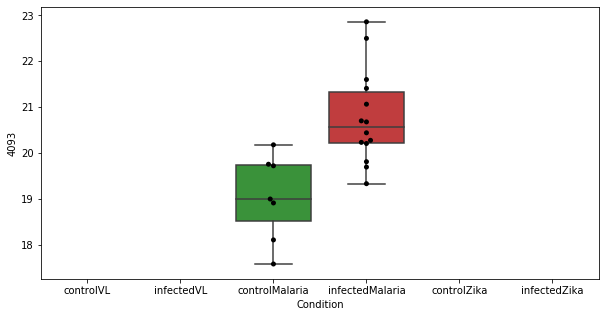

36 row m/z                   117.091
row retention time        23.4777
p-val                 0.000742364
adj.P.Val               0.0391045
custom_id                     336
compound_names                NaN
Name: 336, dtype: object


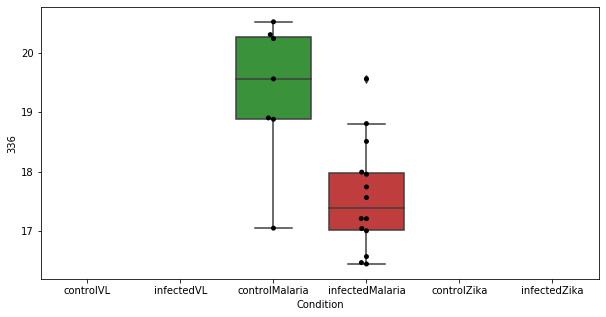

37 row m/z                                                      123.079
row retention time                                           4.42364
p-val                                                    0.000764924
adj.P.Val                                                  0.0392325
custom_id                                                       3207
compound_names        4-Methylpentanal; Isocaproaldehyde; Isohexanal
Name: 3207, dtype: object


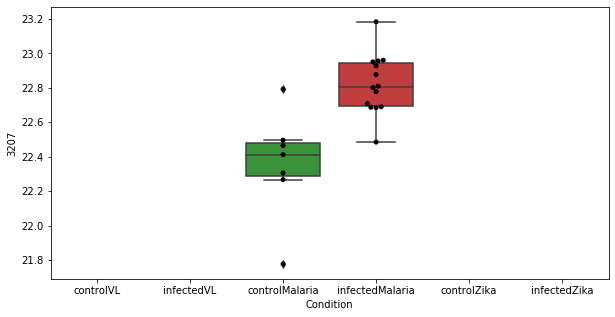

38 row m/z                   276.107
row retention time        9.79604
p-val                 0.000897586
adj.P.Val               0.0448563
custom_id                    2096
compound_names                NaN
Name: 2096, dtype: object


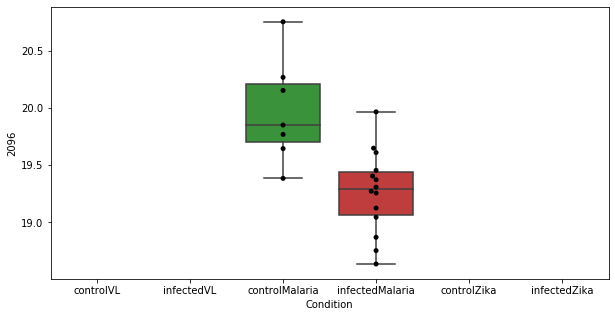

39 row m/z                  162.051
row retention time       10.8221
p-val                 0.00106735
adj.P.Val              0.0520066
custom_id                    948
compound_names               NaN
Name: 948, dtype: object


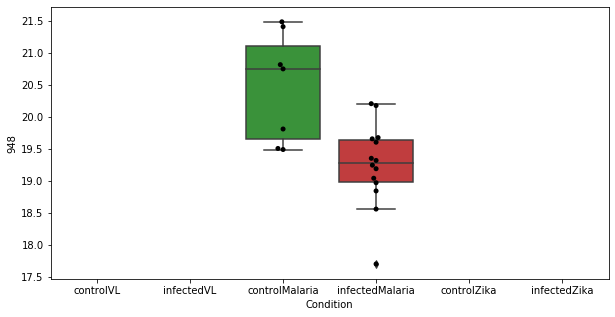

40 row m/z                  495.327
row retention time       4.14176
p-val                 0.00115444
adj.P.Val              0.0541076
custom_id                   2623
compound_names               NaN
Name: 2623, dtype: object


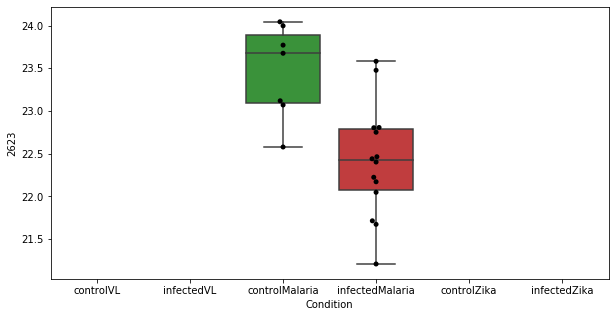

41 row m/z                  104.107
row retention time       16.8065
p-val                 0.00116599
adj.P.Val              0.0541076
custom_id                    167
compound_names               NaN
Name: 167, dtype: object


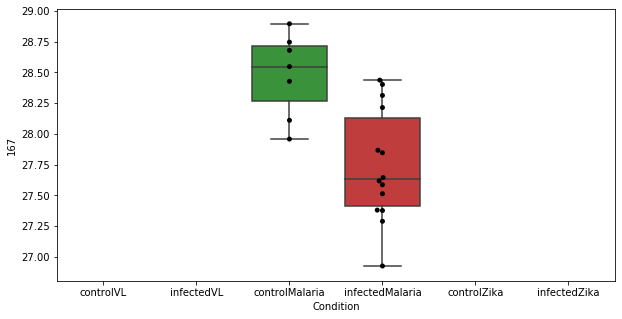

42 row m/z                          494.324
row retention time                4.1675
p-val                         0.00119971
adj.P.Val                      0.0543369
custom_id                           2621
compound_names        cervonyl carnitine
Name: 2621, dtype: object


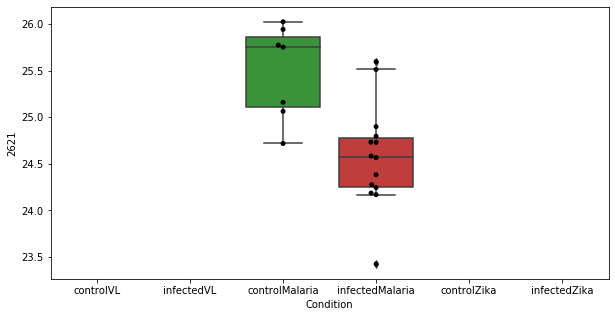

43 row m/z                  299.139
row retention time       4.22818
p-val                 0.00122669
adj.P.Val              0.0543369
custom_id                   5122
compound_names               NaN
Name: 5122, dtype: object


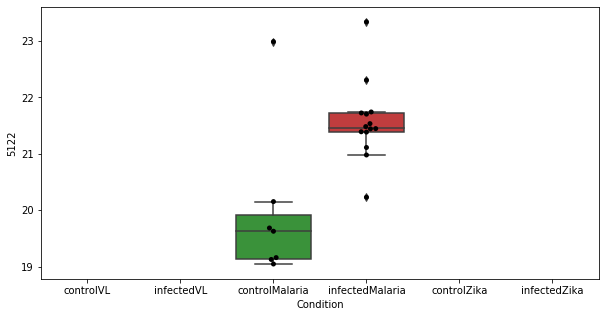

44 row m/z                  352.165
row retention time       4.32125
p-val                 0.00136309
adj.P.Val               0.058983
custom_id                   4121
compound_names               NaN
Name: 4121, dtype: object


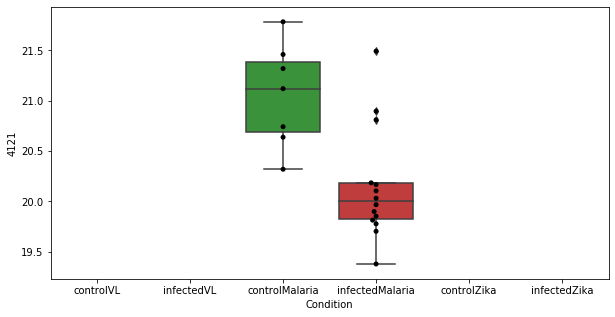

45 row m/z                  510.356
row retention time        4.0593
p-val                 0.00141553
adj.P.Val               0.058983
custom_id                   2635
compound_names               NaN
Name: 2635, dtype: object


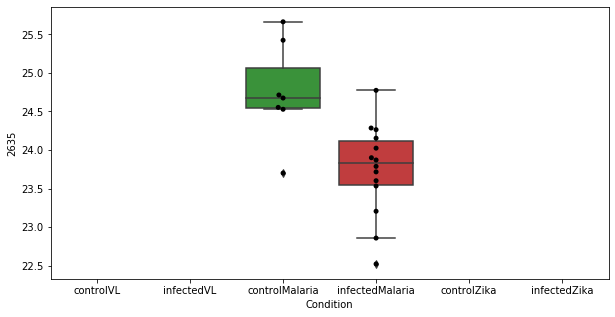

46 row m/z                  165.091
row retention time       4.11303
p-val                 0.00142776
adj.P.Val               0.058983
custom_id                    988
compound_names               NaN
Name: 988, dtype: object


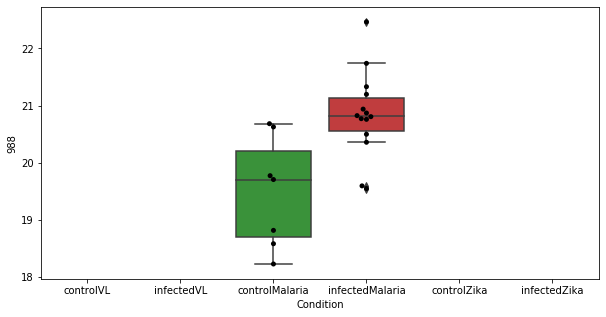

47 row m/z                   105.11
row retention time       16.7959
p-val                 0.00145263
adj.P.Val               0.058983
custom_id                    191
compound_names               NaN
Name: 191, dtype: object


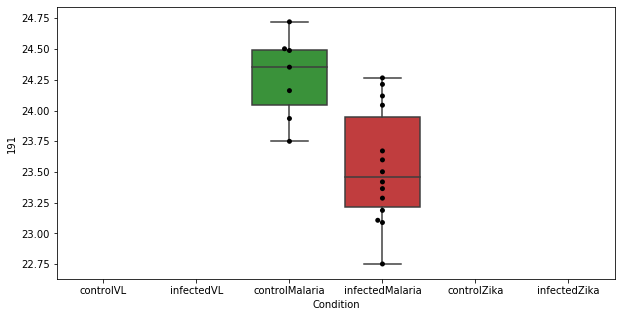

48 row m/z                  480.345
row retention time       4.05724
p-val                 0.00166308
adj.P.Val              0.0661499
custom_id                   2606
compound_names               NaN
Name: 2606, dtype: object


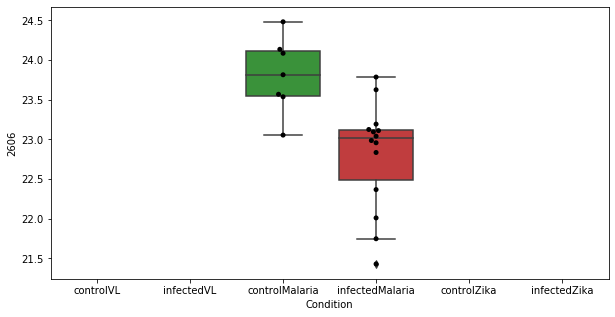

49 row m/z                                                         185.081
row retention time                                              6.99631
p-val                                                        0.00178491
adj.P.Val                                                     0.0695758
custom_id                                                          1243
compound_names        Choline phosphate; Phosphorylcholine; Phosphoc...
Name: 1243, dtype: object


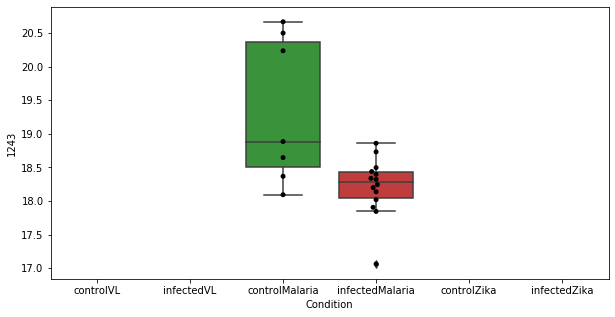

50 row m/z                  202.922
row retention time       2.62018
p-val                 0.00182265
adj.P.Val              0.0696537
custom_id                   1460
compound_names               NaN
Name: 1460, dtype: object


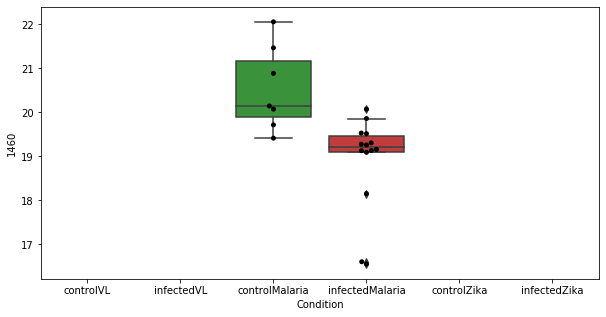

51 row m/z                                                          130.05
row retention time                                              9.57863
p-val                                                        0.00201318
adj.P.Val                                                     0.0754556
custom_id                                                           513
compound_names        L-4-Hydroxyglutamate semialdehyde$D-Glutamate;...
Name: 513, dtype: object


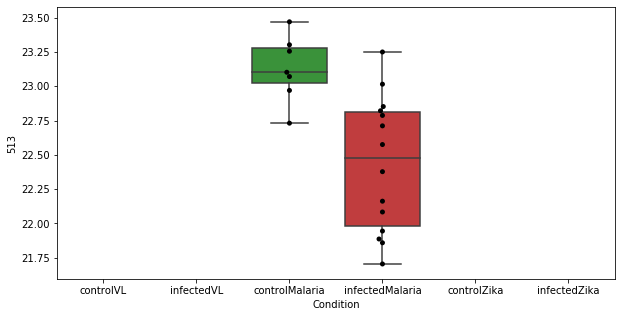

52 row m/z                  240.102
row retention time       7.83229
p-val                 0.00230186
adj.P.Val              0.0846475
custom_id                   3802
compound_names               NaN
Name: 3802, dtype: object


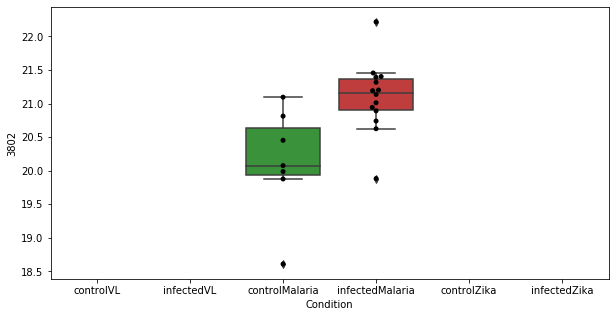

53 row m/z                  569.384
row retention time       3.27837
p-val                 0.00275523
adj.P.Val              0.0969476
custom_id                   2718
compound_names               NaN
Name: 2718, dtype: object


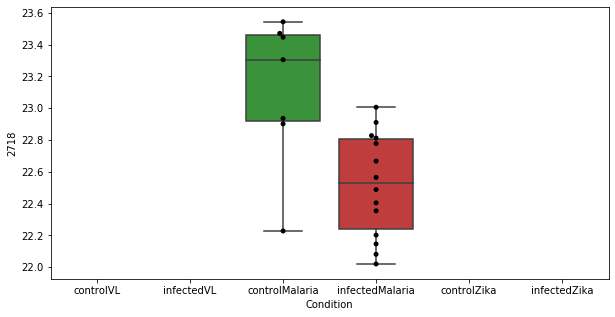

54 row m/z                  105.07
row retention time      3.78793
p-val                 0.0027621
adj.P.Val             0.0969476
custom_id                   176
compound_names              NaN
Name: 176, dtype: object


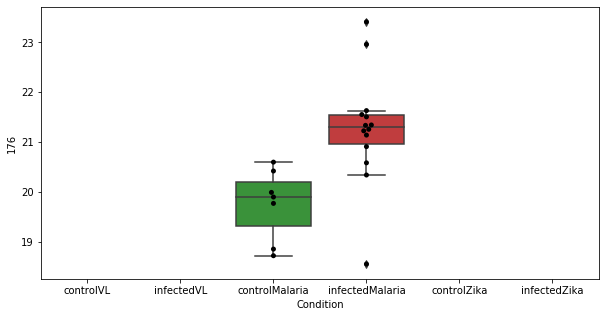

55 row m/z                  96.0556
row retention time       4.37339
p-val                 0.00278556
adj.P.Val              0.0969476
custom_id                    101
compound_names               NaN
Name: 101, dtype: object


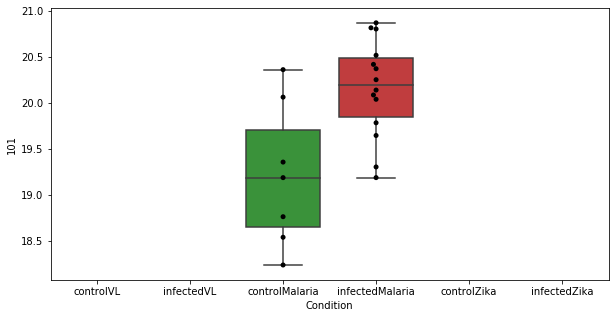

56 row m/z                            128.082
row retention time                 8.16728
p-val                           0.00292806
adj.P.Val                         0.100119
custom_id                              469
compound_names        4-Guanidinobutanoate
Name: 469, dtype: object


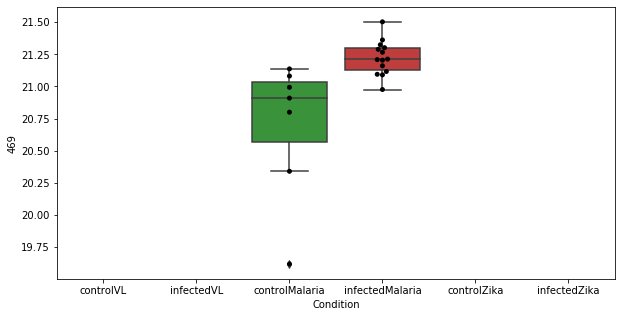

57 row m/z                                                  127.112
row retention time                                       3.75743
p-val                                                 0.00325954
adj.P.Val                                               0.106974
custom_id                                                    458
compound_names        Octanoic acid; Caprylic acid; Octylic acid
Name: 458, dtype: object


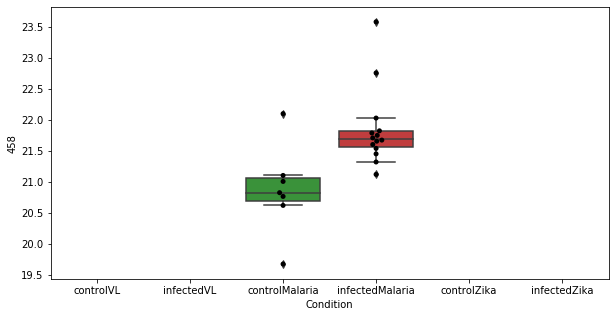

58 row m/z                  231.134
row retention time       8.45553
p-val                 0.00329239
adj.P.Val               0.106974
custom_id                   1730
compound_names               NaN
Name: 1730, dtype: object


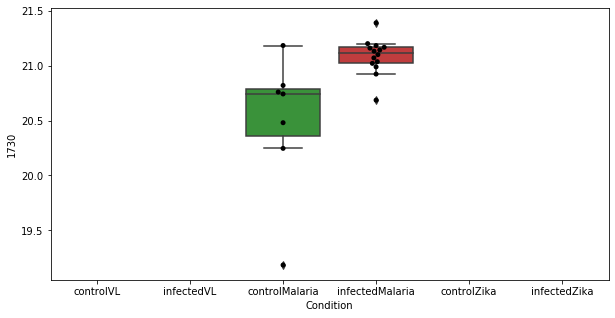

59 row m/z                  511.359
row retention time       4.05651
p-val                 0.00330948
adj.P.Val               0.106974
custom_id                   2637
compound_names               NaN
Name: 2637, dtype: object


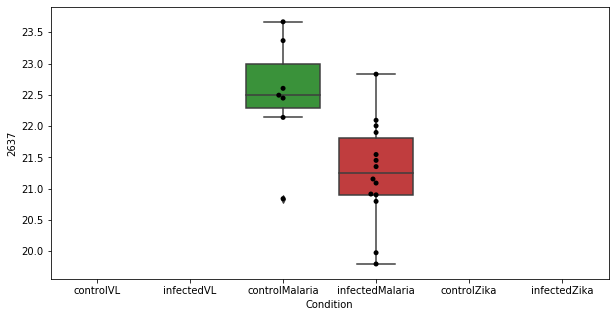

60 row m/z                  282.138
row retention time       4.46464
p-val                 0.00334807
adj.P.Val               0.106974
custom_id                   5091
compound_names               NaN
Name: 5091, dtype: object


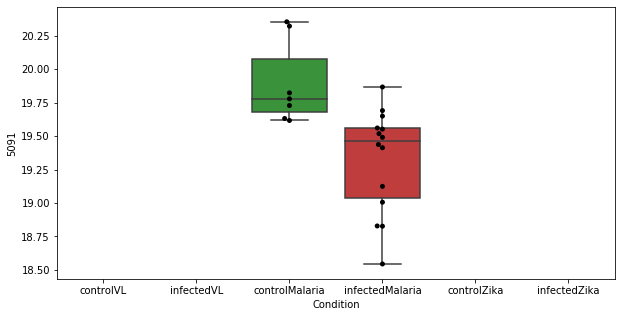

61 row m/z                  659.834
row retention time        10.684
p-val                 0.00350559
adj.P.Val                 0.1102
custom_id                   2795
compound_names               NaN
Name: 2795, dtype: object


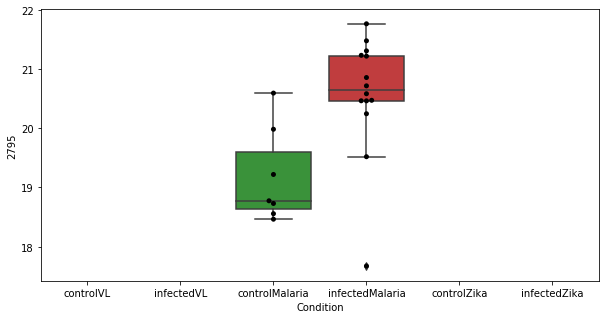

62 row m/z                  482.324
row retention time       4.17473
p-val                 0.00373325
adj.P.Val                0.11388
custom_id                   2608
compound_names               NaN
Name: 2608, dtype: object


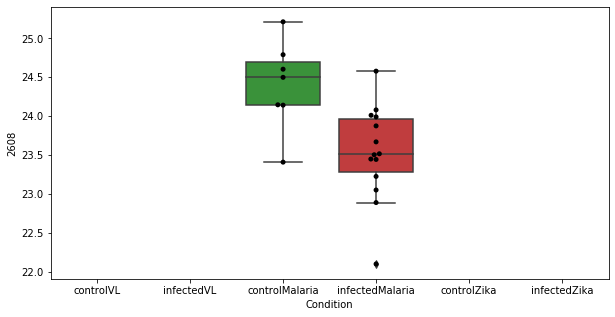

63 row m/z                  472.202
row retention time       14.0914
p-val                 0.00373952
adj.P.Val                0.11388
custom_id                   6210
compound_names               NaN
Name: 6210, dtype: object


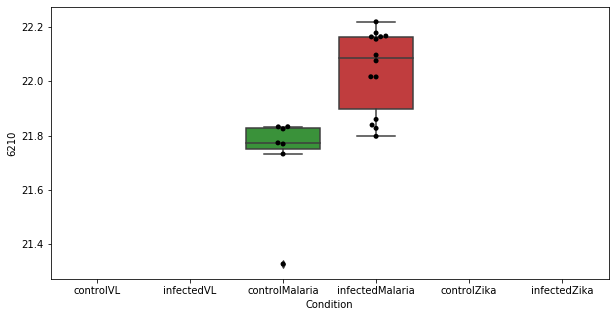

64 row m/z                            468.308
row retention time                  4.2516
p-val                           0.00387314
adj.P.Val                         0.114024
custom_id                             2595
compound_names        Timnodonyl carnitine
Name: 2595, dtype: object


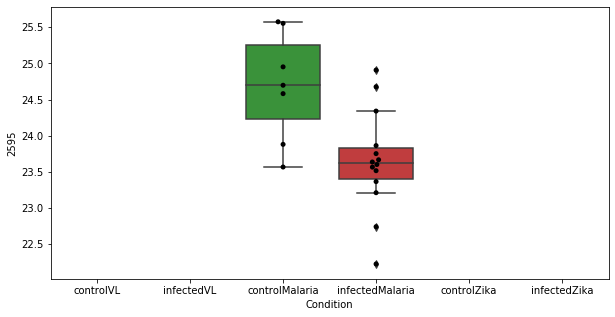

65 row m/z                  548.865
row retention time       11.9762
p-val                 0.00389914
adj.P.Val               0.114024
custom_id                   2695
compound_names               NaN
Name: 2695, dtype: object


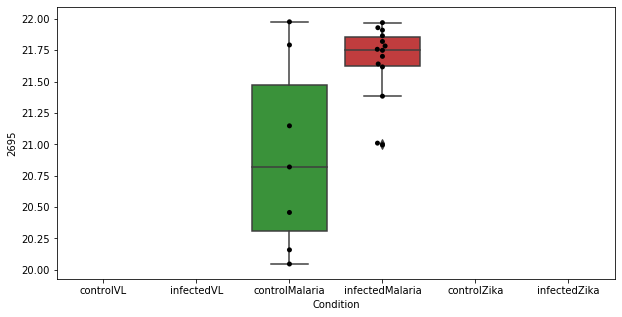

66 row m/z                    380.9
row retention time       2.85585
p-val                 0.00391975
adj.P.Val               0.114024
custom_id                   4163
compound_names               NaN
Name: 4163, dtype: object


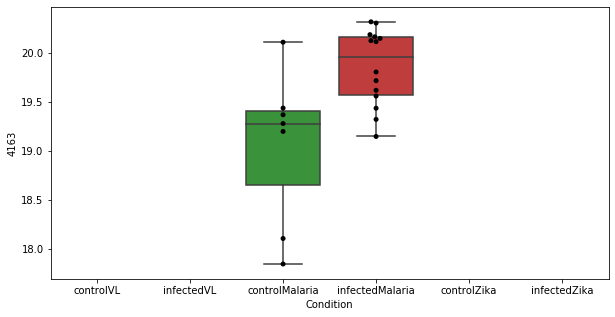

67 row m/z                  159.157
row retention time       3.89348
p-val                 0.00428072
adj.P.Val               0.122461
custom_id                   4702
compound_names               NaN
Name: 4702, dtype: object


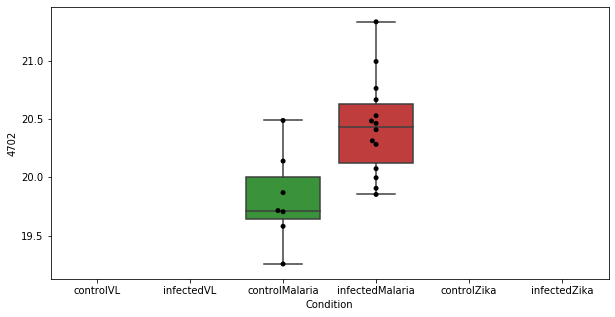

68 row m/z                   276.66
row retention time       17.4458
p-val                 0.00433547
adj.P.Val               0.122461
custom_id                   2121
compound_names               NaN
Name: 2121, dtype: object


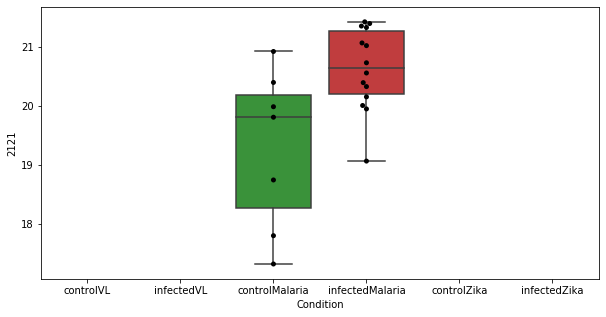

69 row m/z                  199.133
row retention time       3.87461
p-val                 0.00447339
adj.P.Val               0.123232
custom_id                   1421
compound_names               NaN
Name: 1421, dtype: object


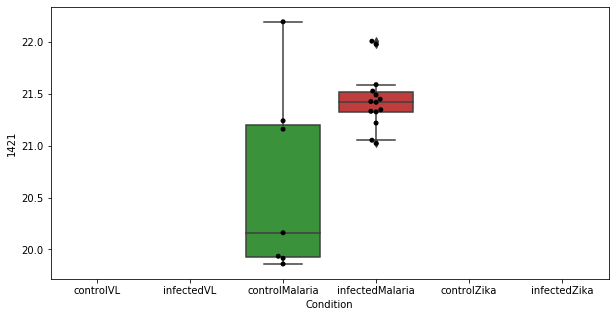

70 row m/z                                                          130.05
row retention time                                              4.54552
p-val                                                         0.0044892
adj.P.Val                                                      0.123232
custom_id                                                           515
compound_names        1-Pyrroline-4-hydroxy-2-carboxylate$L-1-Pyrrol...
Name: 515, dtype: object


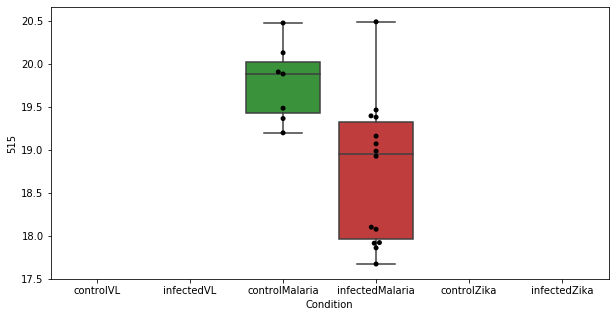

71 row m/z                  141.114
row retention time        5.0499
p-val                 0.00465489
adj.P.Val               0.126005
custom_id                    661
compound_names               NaN
Name: 661, dtype: object


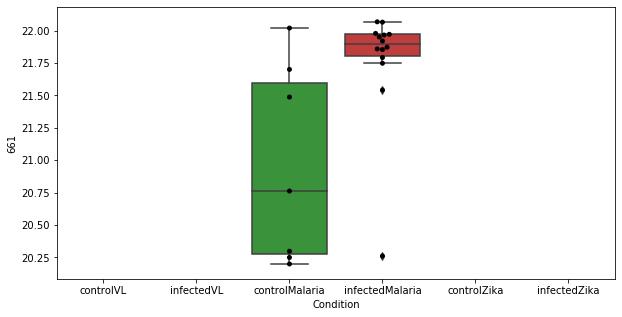

72 row m/z                                                         128.071
row retention time                                              10.1615
p-val                                                        0.00476257
adj.P.Val                                                      0.127154
custom_id                                                           465
compound_names        6-Amino-2-oxohexanoate; 2-Oxo-6-aminocaproate$...
Name: 465, dtype: object


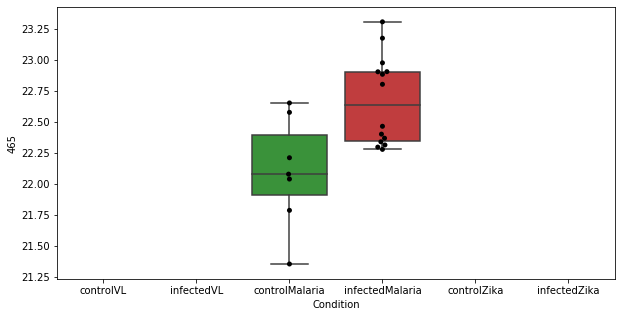

73 row m/z                  323.851
row retention time       23.7398
p-val                 0.00533906
adj.P.Val               0.138632
custom_id                   2347
compound_names               NaN
Name: 2347, dtype: object


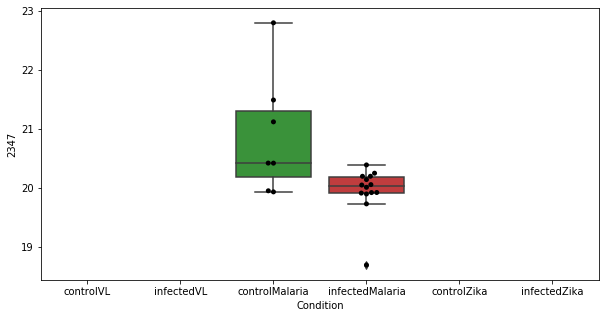

74 row m/z                                                          496.34
row retention time                                              6.92577
p-val                                                         0.0053677
adj.P.Val                                                      0.138632
custom_id                                                          2625
compound_names        docosa-4,7,10,13,16-pentaenoyl carnitine$clupa...
Name: 2625, dtype: object


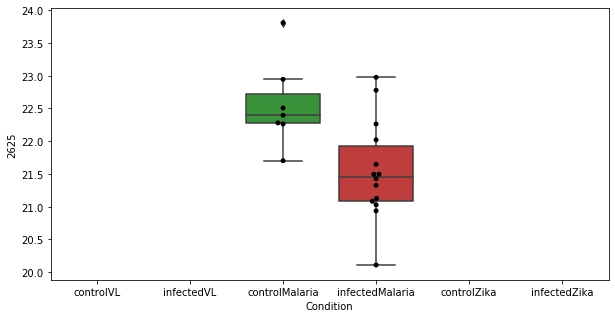

75 row m/z                            128.107
row retention time                 4.48309
p-val                           0.00540587
adj.P.Val                         0.138632
custom_id                              479
compound_names        3-Dehydroxycarnitine
Name: 479, dtype: object


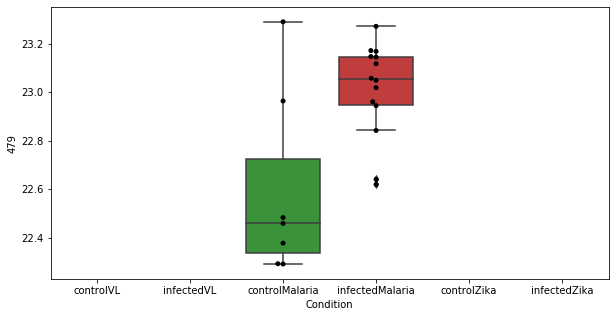

76 row m/z                  469.312
row retention time       4.26137
p-val                 0.00547977
adj.P.Val               0.138702
custom_id                   2597
compound_names               NaN
Name: 2597, dtype: object


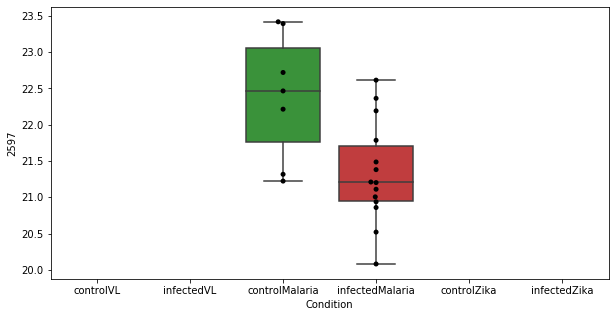

77 row m/z                  352.165
row retention time       6.92361
p-val                 0.00560512
adj.P.Val               0.140056
custom_id                   4122
compound_names               NaN
Name: 4122, dtype: object


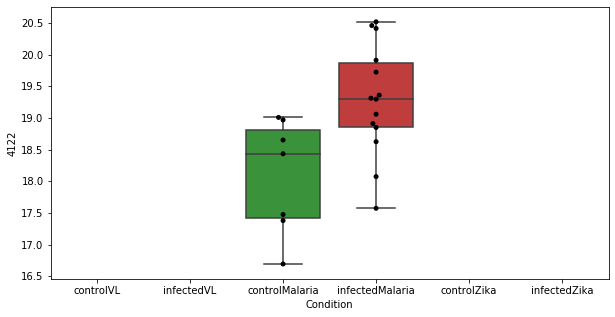

78 row m/z                 286.179
row retention time      10.7314
p-val                 0.0058234
adj.P.Val              0.143669
custom_id                  2174
compound_names              NaN
Name: 2174, dtype: object


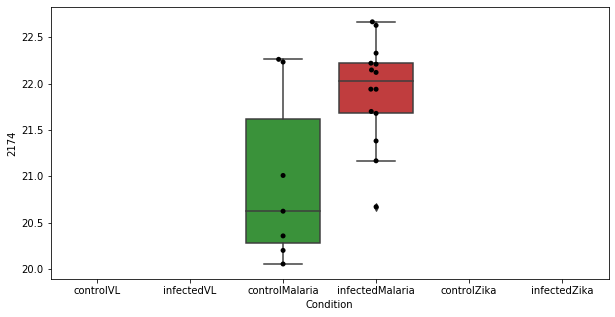

79 row m/z                                                         112.076
row retention time                                              4.60679
p-val                                                        0.00627036
adj.P.Val                                                      0.152762
custom_id                                                           249
compound_names        L-Normetanephrine$L-Adrenaline; (R)-(-)-Adrena...
Name: 249, dtype: object


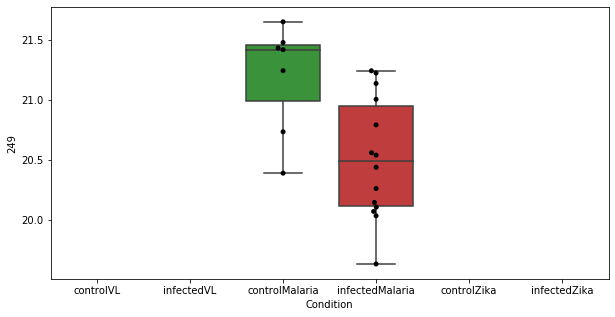

80 row m/z                   164.93
row retention time       12.8514
p-val                 0.00643957
adj.P.Val               0.153574
custom_id                    983
compound_names               NaN
Name: 983, dtype: object


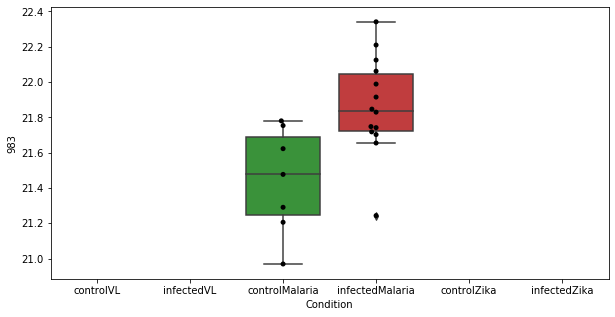

81 row m/z                                                         101.071
row retention time                                              9.54273
p-val                                                        0.00650921
adj.P.Val                                                      0.153574
custom_id                                                          4400
compound_names        5,6-Dihydrothymine; Dihydrothymine; 5,6-Dihydr...
Name: 4400, dtype: object


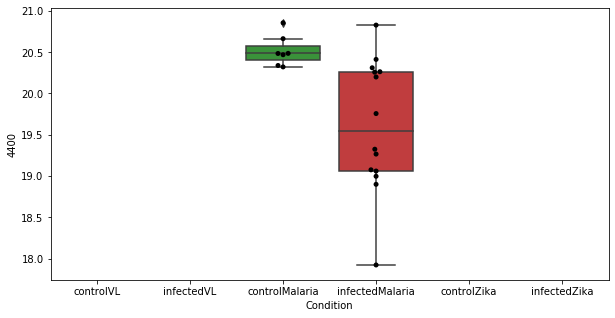

82 row m/z                                                         184.097
row retention time                                              4.58509
p-val                                                        0.00654008
adj.P.Val                                                      0.153574
custom_id                                                          4804
compound_names        L-Normetanephrine$L-Adrenaline; (R)-(-)-Adrena...
Name: 4804, dtype: object


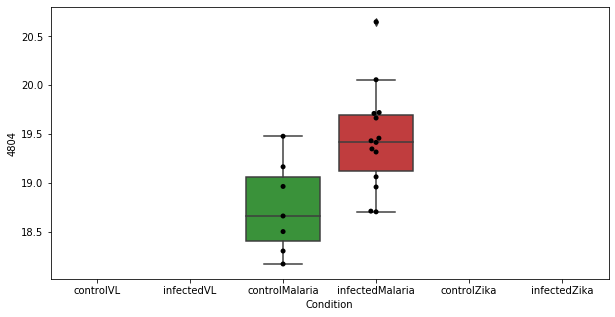

83 row m/z                 216.069
row retention time      4.50982
p-val                 0.0068342
adj.P.Val               0.15857
custom_id                  1600
compound_names              NaN
Name: 1600, dtype: object


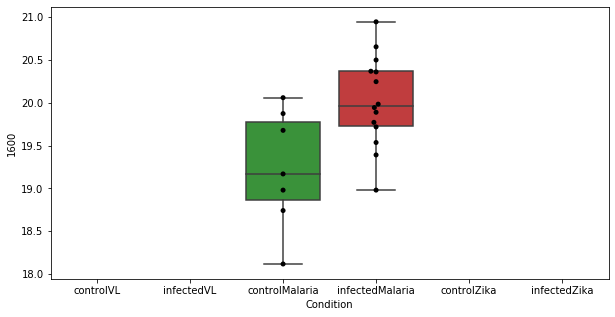

84 row m/z                                                         149.064
row retention time                                              12.1614
p-val                                                        0.00729815
adj.P.Val                                                      0.167342
custom_id                                                          4663
compound_names        L-4-Hydroxyglutamate semialdehyde$D-Glutamate;...
Name: 4663, dtype: object


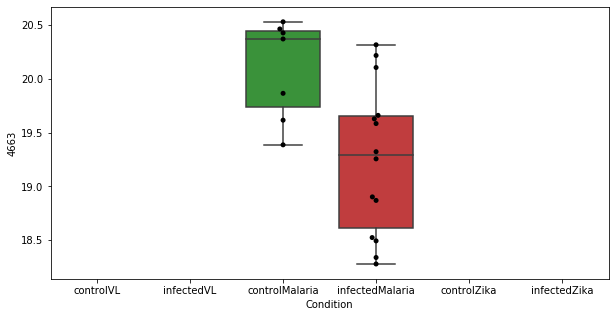

85 row m/z                   77.079
row retention time       9.68399
p-val                 0.00754586
adj.P.Val               0.169504
custom_id                     20
compound_names               NaN
Name: 20, dtype: object


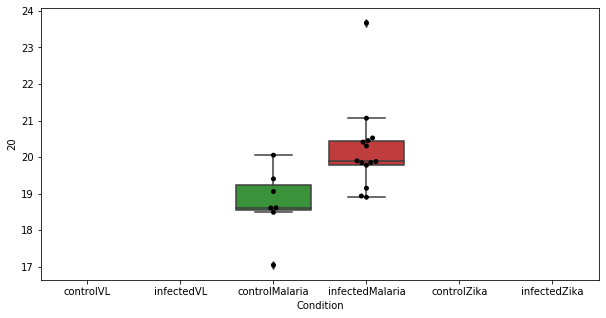

86 row m/z                   184.92
row retention time       15.0732
p-val                 0.00756636
adj.P.Val               0.169504
custom_id                   3554
compound_names               NaN
Name: 3554, dtype: object


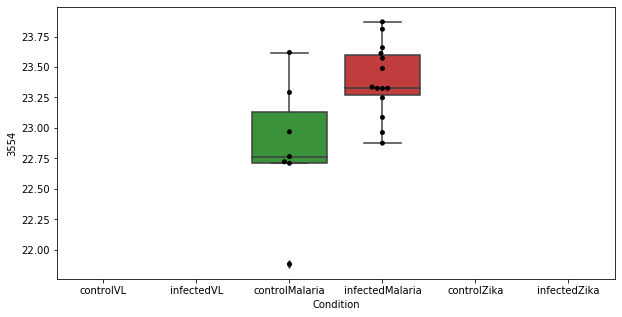

87 row m/z                  184.073
row retention time       11.8461
p-val                 0.00771099
adj.P.Val               0.170781
custom_id                   1231
compound_names               NaN
Name: 1231, dtype: object


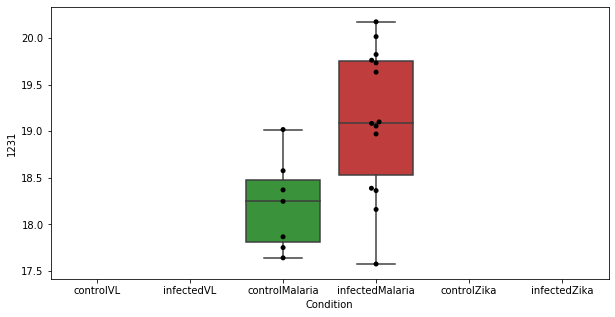

88 row m/z                   376.19
row retention time       3.64989
p-val                 0.00783554
adj.P.Val               0.171589
custom_id                   2464
compound_names               NaN
Name: 2464, dtype: object


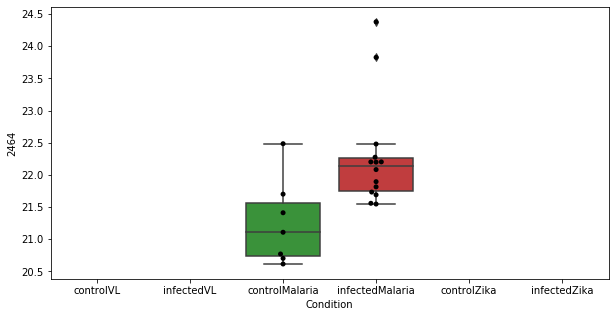

89 row m/z                  344.136
row retention time       3.71259
p-val                 0.00831545
adj.P.Val               0.180076
custom_id                   2410
compound_names               NaN
Name: 2410, dtype: object


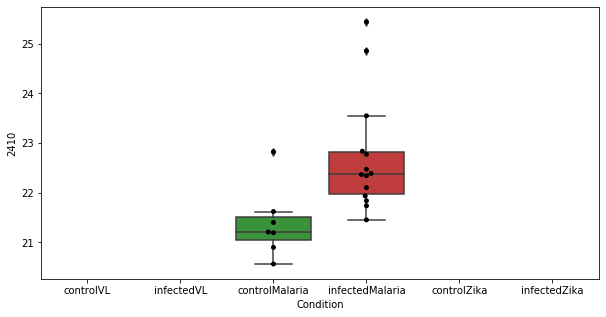

90 row m/z                                                         162.112
row retention time                                              6.22073
p-val                                                        0.00877777
adj.P.Val                                                      0.186592
custom_id                                                           955
compound_names        L-Carnitine; L-gamma-Trimethyl-beta-hydroxybut...
Name: 955, dtype: object


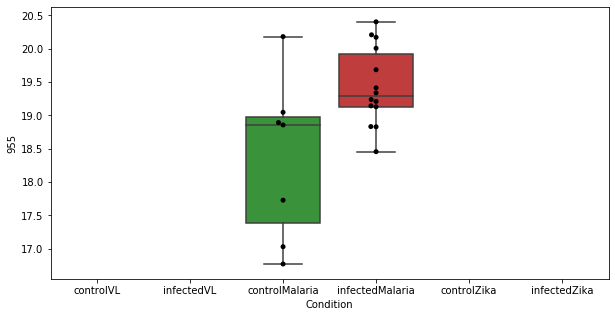

91 row m/z                  227.128
row retention time       4.33698
p-val                 0.00880782
adj.P.Val               0.186592
custom_id                   3745
compound_names               NaN
Name: 3745, dtype: object


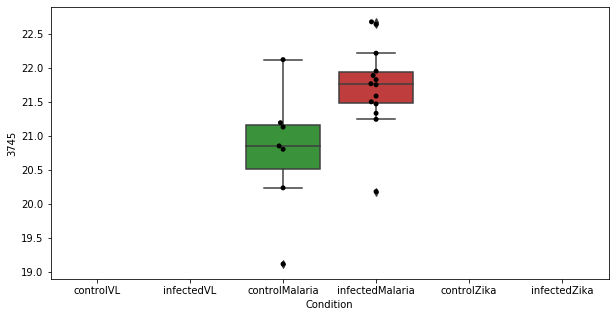

92 row m/z                  191.128
row retention time       4.16516
p-val                 0.00909084
adj.P.Val                 0.1894
custom_id                   1329
compound_names               NaN
Name: 1329, dtype: object


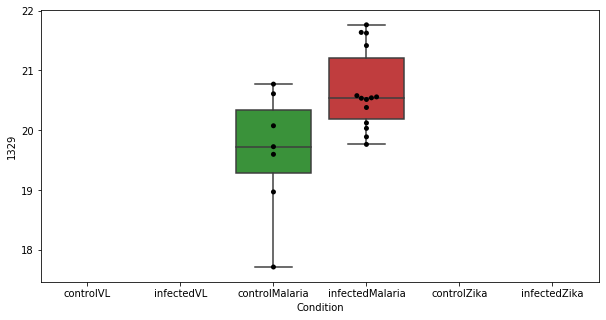

93 row m/z                  171.076
row retention time       9.57345
p-val                 0.00913472
adj.P.Val                 0.1894
custom_id                   1076
compound_names               NaN
Name: 1076, dtype: object


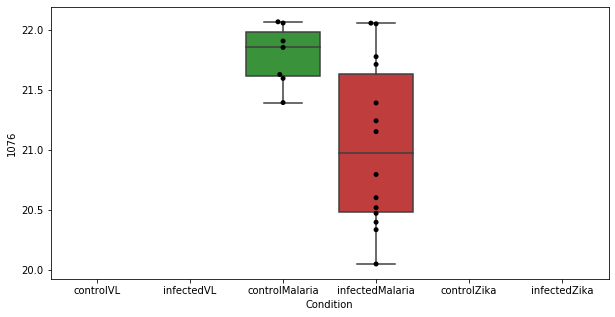

94 row m/z                     167.107
row retention time          4.57042
p-val                    0.00951999
adj.P.Val                  0.193344
custom_id                      1013
compound_names        Perillic acid
Name: 1013, dtype: object


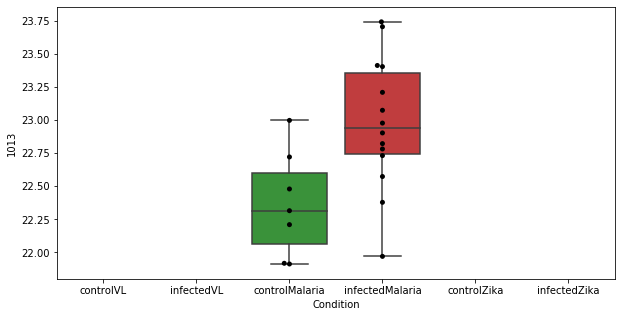

95 row m/z                  214.098
row retention time       12.4884
p-val                 0.00962934
adj.P.Val               0.193344
custom_id                   3683
compound_names               NaN
Name: 3683, dtype: object


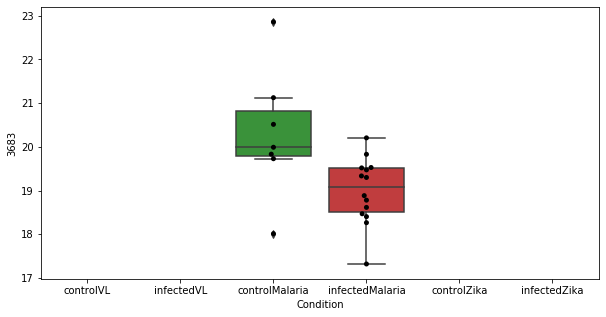

96 row m/z                  312.182
row retention time       3.80233
p-val                 0.00967301
adj.P.Val               0.193344
custom_id                   2296
compound_names               NaN
Name: 2296, dtype: object


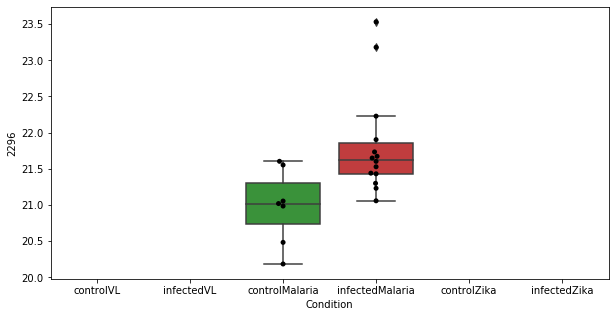

97 row m/z                   184.92
row retention time        7.7212
p-val                 0.00972177
adj.P.Val               0.193344
custom_id                   3557
compound_names               NaN
Name: 3557, dtype: object


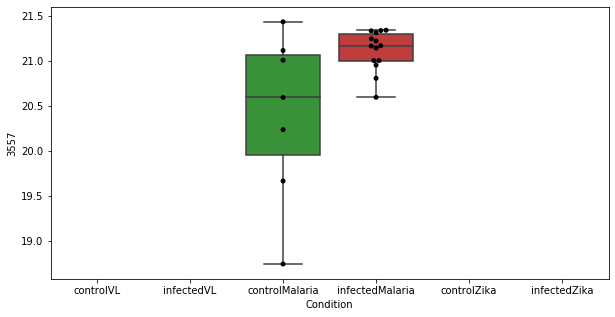

98 row m/z                  183.975
row retention time       12.8392
p-val                 0.00992384
adj.P.Val               0.195369
custom_id                   1226
compound_names               NaN
Name: 1226, dtype: object


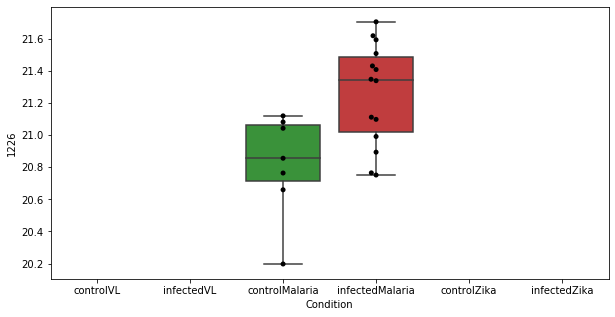

99 row m/z                                                         138.091
row retention time                                              4.58742
p-val                                                          0.010776
adj.P.Val                                                      0.210024
custom_id                                                           623
compound_names        L-Normetanephrine$L-Adrenaline; (R)-(-)-Adrena...
Name: 623, dtype: object


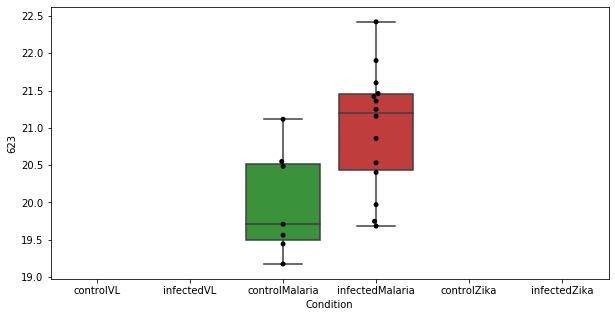

100 row m/z                 345.185
row retention time      3.70549
p-val                 0.0109228
adj.P.Val              0.210777
custom_id                  2419
compound_names              NaN
Name: 2419, dtype: object


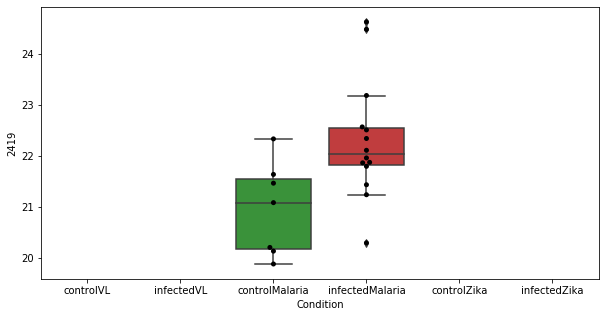

101 row m/z                 660.837
row retention time      8.79232
p-val                 0.0115916
adj.P.Val              0.218228
custom_id                  2797
compound_names              NaN
Name: 2797, dtype: object


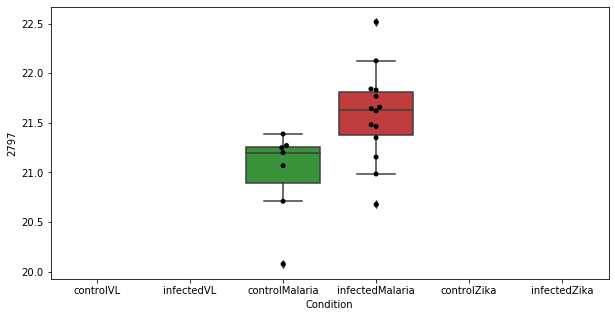

102 row m/z                 122.945
row retention time      2.85704
p-val                 0.0116305
adj.P.Val              0.218228
custom_id                  4503
compound_names              NaN
Name: 4503, dtype: object


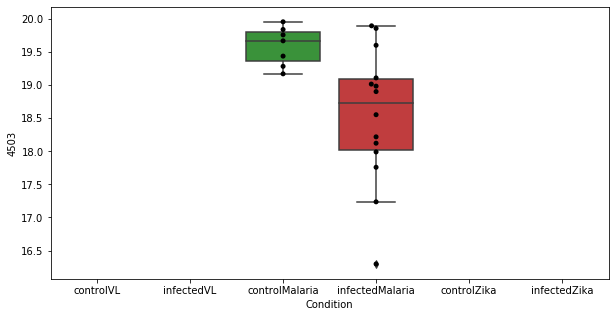

103 row m/z                 411.172
row retention time      3.56589
p-val                 0.0116448
adj.P.Val              0.218228
custom_id                  2538
compound_names              NaN
Name: 2538, dtype: object


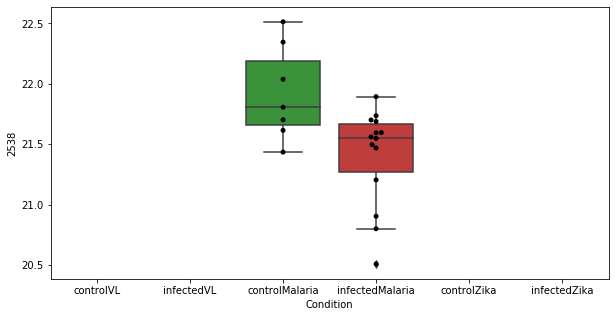

104 row m/z                                                          148.06
row retention time                                              12.1467
p-val                                                         0.0125549
adj.P.Val                                                      0.232457
custom_id                                                           776
compound_names        L-4-Hydroxyglutamate semialdehyde$D-Glutamate;...
Name: 776, dtype: object


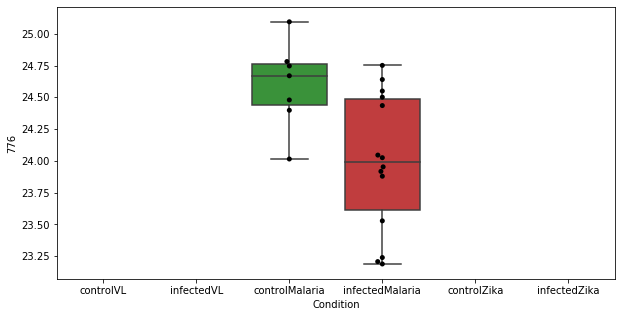

105 row m/z                 615.459
row retention time      3.19172
p-val                 0.0127045
adj.P.Val              0.232457
custom_id                  2758
compound_names              NaN
Name: 2758, dtype: object


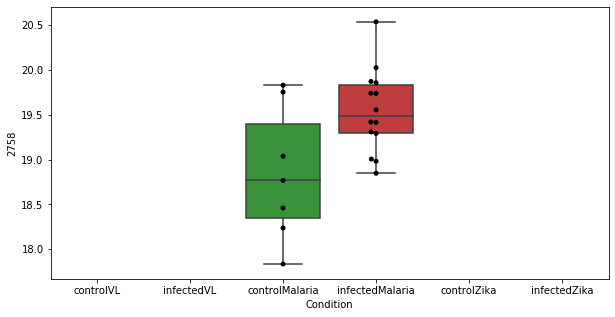

106 row m/z                 593.497
row retention time      3.24507
p-val                 0.0127619
adj.P.Val              0.232457
custom_id                  4239
compound_names              NaN
Name: 4239, dtype: object


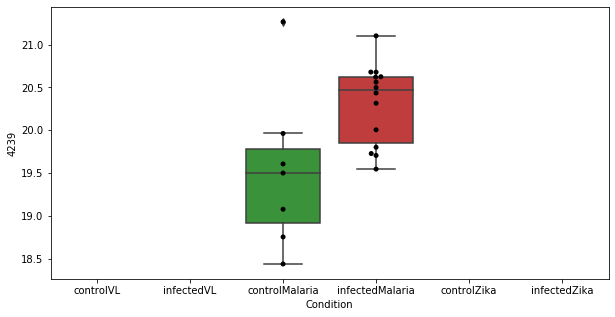

107 row m/z                 129.957
row retention time      23.2214
p-val                 0.0130533
adj.P.Val              0.233839
custom_id                  3244
compound_names              NaN
Name: 3244, dtype: object


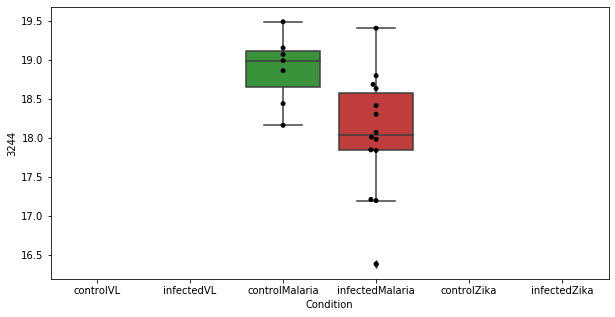

108 row m/z                                                  133.086
row retention time                                       4.11115
p-val                                                  0.0131037
adj.P.Val                                               0.233839
custom_id                                                    574
compound_names        6-Hydroxyhexanoic acid; 6-Hydroxyhexanoate
Name: 574, dtype: object


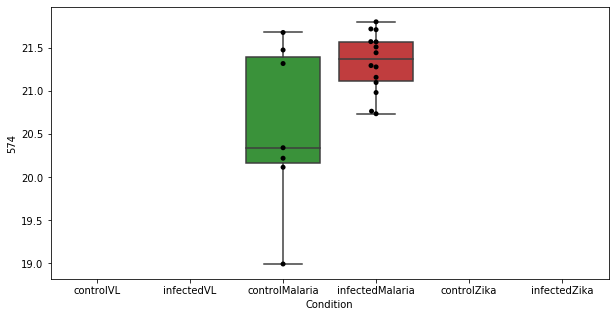

109 row m/z                 78.9557
row retention time      8.31539
p-val                 0.0132085
adj.P.Val              0.233839
custom_id                  3003
compound_names              NaN
Name: 3003, dtype: object


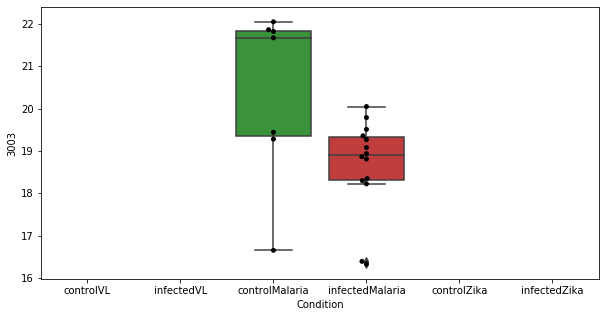

110 row m/z                                                         147.076
row retention time                                              7.28352
p-val                                                         0.0133749
adj.P.Val                                                      0.233839
custom_id                                                           758
compound_names        D-Glutamine; D-2-Aminoglutaramic acid$L-Glutam...
Name: 758, dtype: object


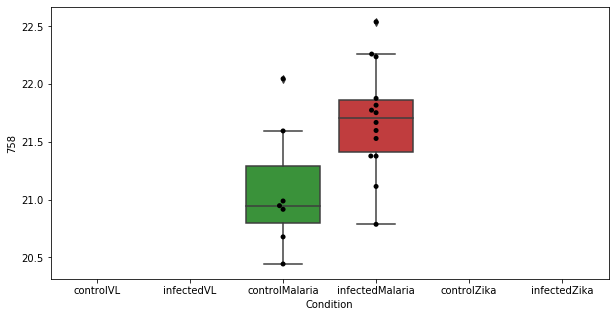

111 row m/z                 207.117
row retention time      3.81729
p-val                 0.0135343
adj.P.Val              0.233839
custom_id                  1489
compound_names              NaN
Name: 1489, dtype: object


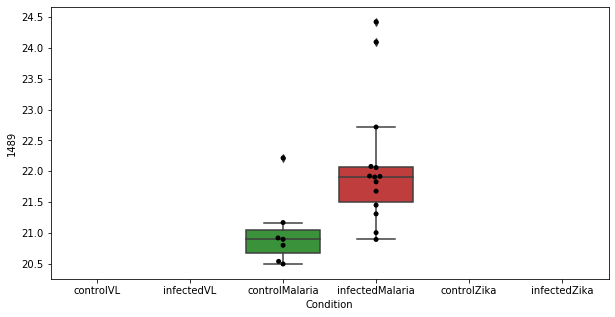

112 row m/z                 232.154
row retention time      4.27561
p-val                 0.0135576
adj.P.Val              0.233839
custom_id                  1740
compound_names              NaN
Name: 1740, dtype: object


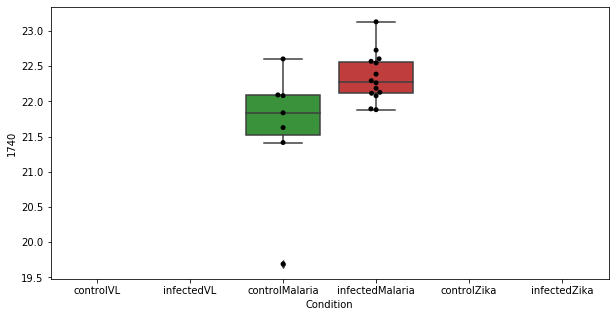

113 row m/z                 155.118
row retention time      23.7404
p-val                 0.0138569
adj.P.Val              0.236904
custom_id                   860
compound_names              NaN
Name: 860, dtype: object


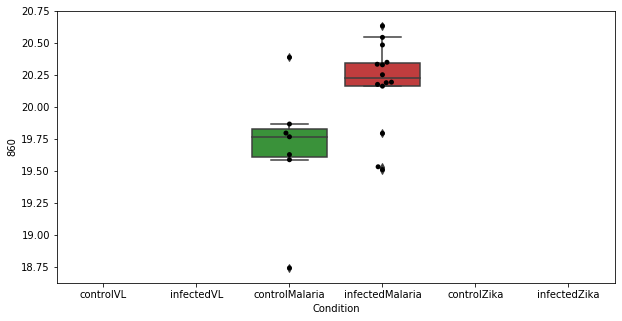

114 row m/z                 316.248
row retention time      3.68017
p-val                 0.0143062
adj.P.Val              0.239196
custom_id                  4067
compound_names              NaN
Name: 4067, dtype: object


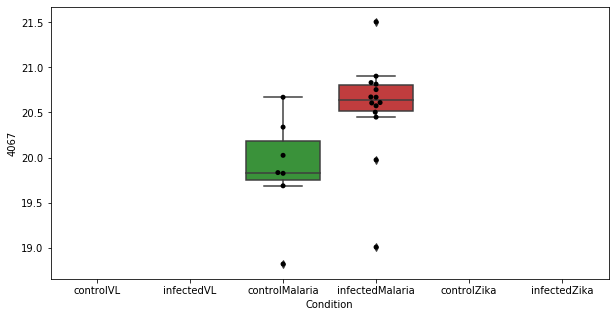

115 row m/z                                                         152.071
row retention time                                              10.3631
p-val                                                         0.0143473
adj.P.Val                                                      0.239196
custom_id                                                           835
compound_names        L-Noradrenaline; Noradrenaline; Norepinephrine...
Name: 835, dtype: object


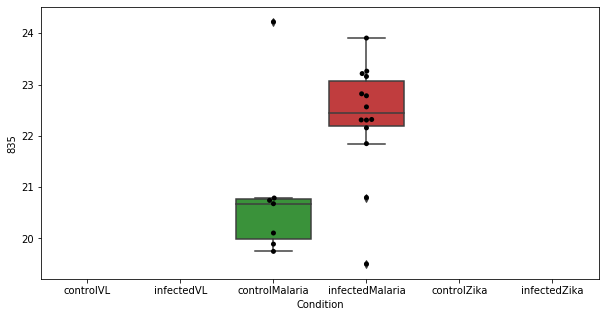

116 row m/z                 302.215
row retention time      6.99335
p-val                 0.0143591
adj.P.Val              0.239196
custom_id                  4036
compound_names              NaN
Name: 4036, dtype: object


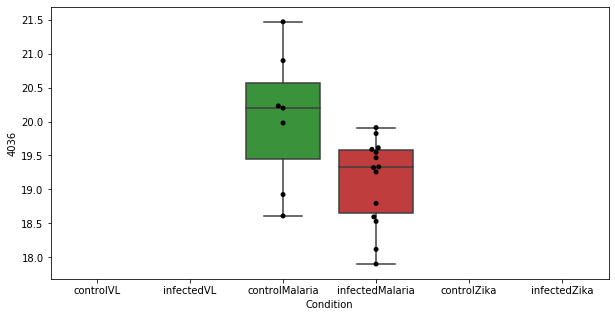

117 row m/z                 202.086
row retention time      4.48051
p-val                 0.0147415
adj.P.Val              0.243485
custom_id                  4878
compound_names              NaN
Name: 4878, dtype: object


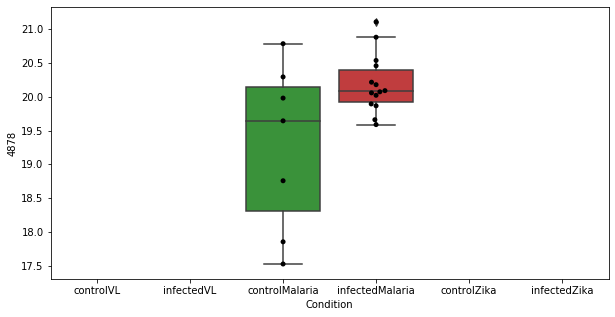

118 row m/z                   244.1
row retention time      3.95789
p-val                 0.0149466
adj.P.Val              0.244798
custom_id                  1860
compound_names              NaN
Name: 1860, dtype: object


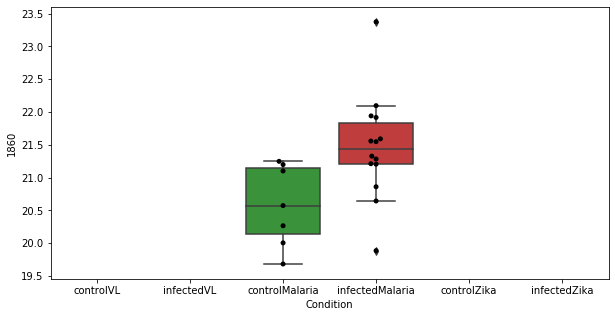

119 row m/z                            253.155
row retention time                 4.36584
p-val                            0.0156155
adj.P.Val                         0.252128
custom_id                             3863
compound_names        histidyl-prolinamide
Name: 3863, dtype: object


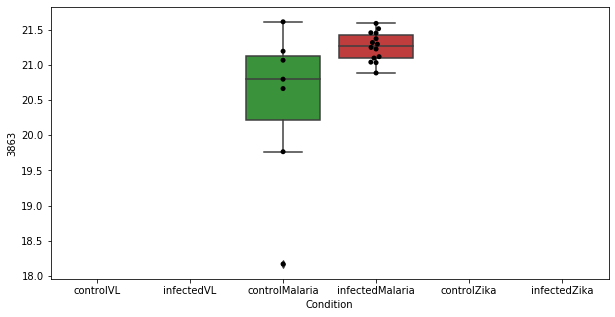

120 row m/z                                                          131.09
row retention time                                              17.7878
p-val                                                         0.0156529
adj.P.Val                                                      0.252128
custom_id                                                           534
compound_names        N4-Acetylaminobutanal$L-Pipecolate; Pipecolini...
Name: 534, dtype: object


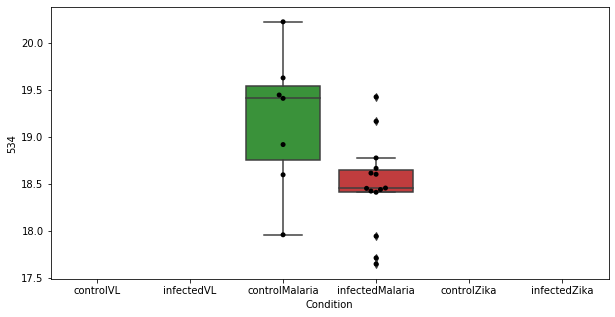

121 row m/z                 158.912
row retention time      14.3957
p-val                 0.0159653
adj.P.Val              0.255052
custom_id                   910
compound_names              NaN
Name: 910, dtype: object


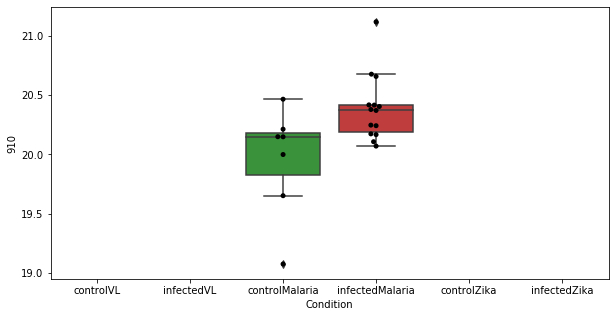

122 row m/z                 193.975
row retention time      12.0515
p-val                 0.0167403
adj.P.Val              0.265259
custom_id                  1362
compound_names              NaN
Name: 1362, dtype: object


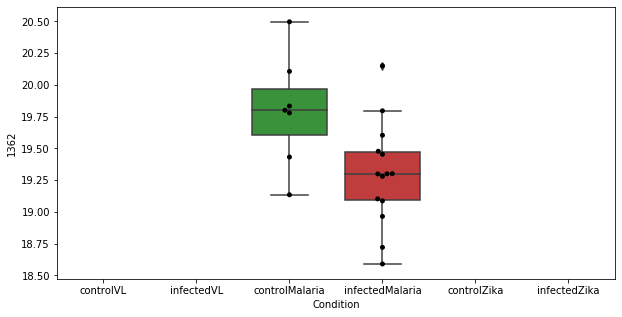

123 row m/z                 216.067
row retention time      10.5885
p-val                 0.0169713
adj.P.Val              0.265947
custom_id                  3701
compound_names              NaN
Name: 3701, dtype: object


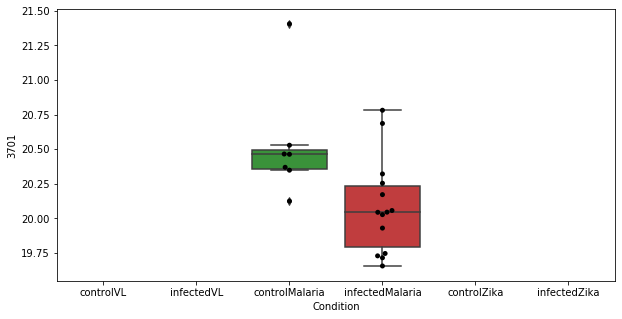

124 row m/z                                                         102.055
row retention time                                               10.152
p-val                                                         0.0170566
adj.P.Val                                                      0.265947
custom_id                                                           145
compound_names        L-Allothreonine; L-allo-Threonine$L-Threonine;...
Name: 145, dtype: object


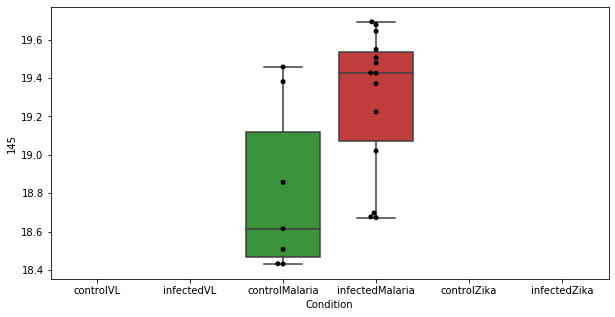

125 row m/z                 246.134
row retention time       4.5081
p-val                 0.0174236
adj.P.Val              0.266657
custom_id                  1874
compound_names              NaN
Name: 1874, dtype: object


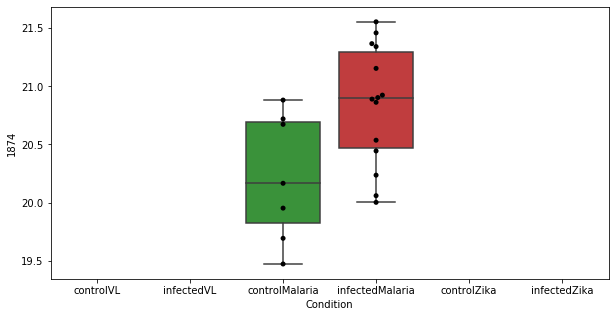

126 row m/z                 86.0964
row retention time      3.13777
p-val                 0.0174316
adj.P.Val              0.266657
custom_id                    69
compound_names              NaN
Name: 69, dtype: object


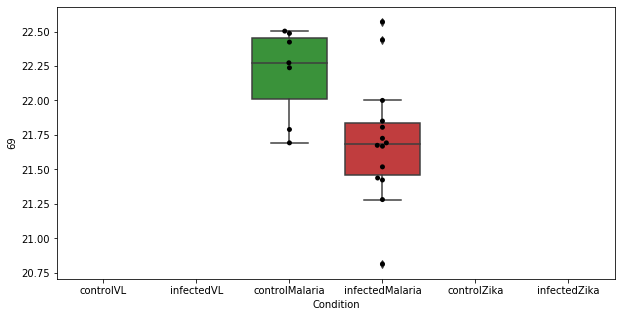

127 row m/z                 236.073
row retention time      23.0333
p-val                 0.0176462
adj.P.Val              0.266657
custom_id                  3785
compound_names              NaN
Name: 3785, dtype: object


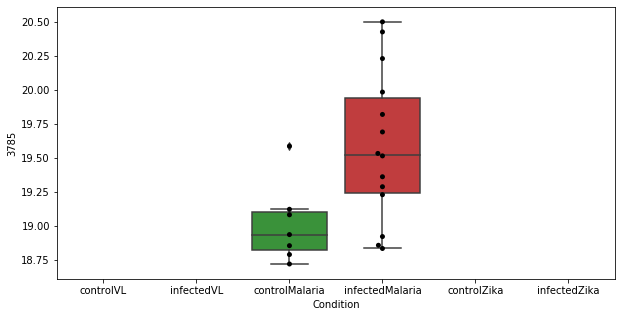

128 row m/z                 250.051
row retention time      23.2993
p-val                 0.0176495
adj.P.Val              0.266657
custom_id                  1901
compound_names              NaN
Name: 1901, dtype: object


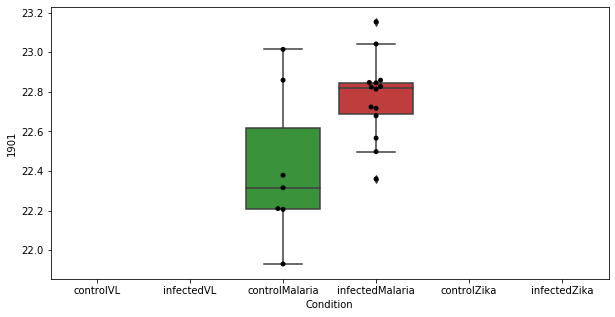

129 row m/z                                 190.107
row retention time                      9.64522
p-val                                 0.0179556
adj.P.Val                              0.269196
custom_id                                  1313
compound_names        N-(omega)-Hydroxyarginine
Name: 1313, dtype: object


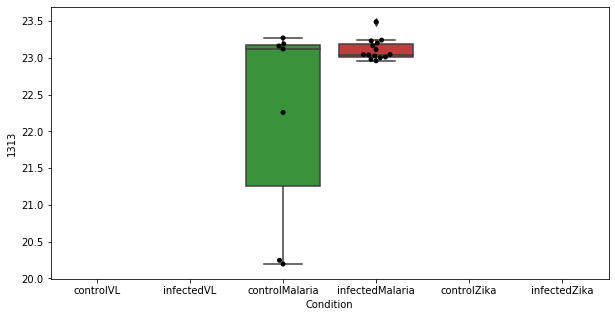

130 row m/z                 193.975
row retention time      6.81599
p-val                 0.0190506
adj.P.Val              0.279896
custom_id                  1360
compound_names              NaN
Name: 1360, dtype: object


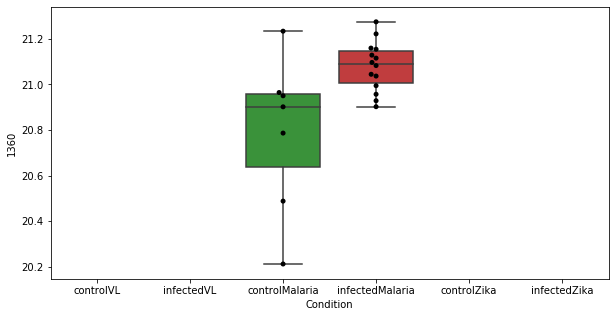

131 row m/z                 261.121
row retention time       10.191
p-val                 0.0190579
adj.P.Val              0.279896
custom_id                  1983
compound_names              NaN
Name: 1983, dtype: object


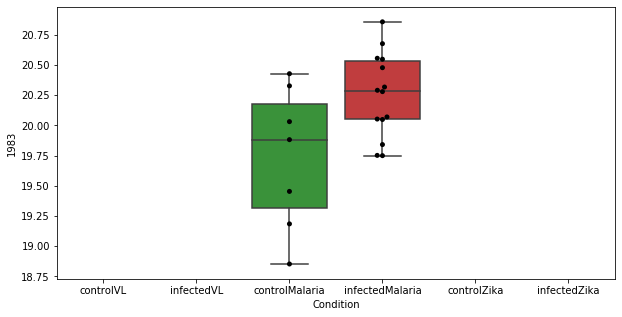

132 row m/z                                                158.081
row retention time                                     23.5557
p-val                                                 0.019283
adj.P.Val                                             0.279896
custom_id                                                  898
compound_names        N-Acetylornithine; N2-Acetyl-L-ornithine
Name: 898, dtype: object


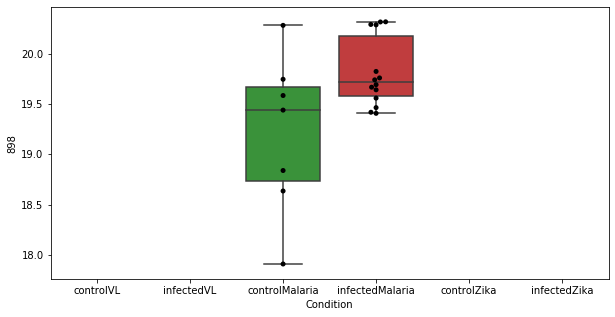

133 row m/z                 259.025
row retention time      13.1272
p-val                 0.0193081
adj.P.Val              0.279896
custom_id                  3887
compound_names              NaN
Name: 3887, dtype: object


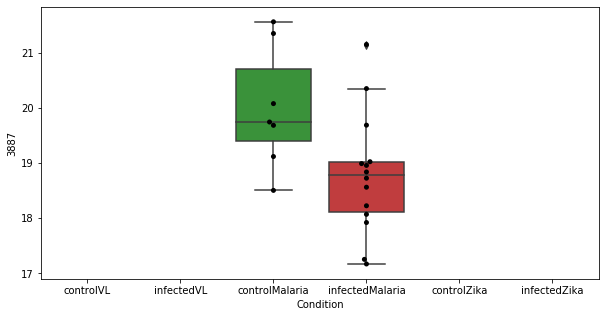

134 row m/z                 148.043
row retention time       7.0004
p-val                 0.0195251
adj.P.Val              0.279896
custom_id                   775
compound_names              NaN
Name: 775, dtype: object


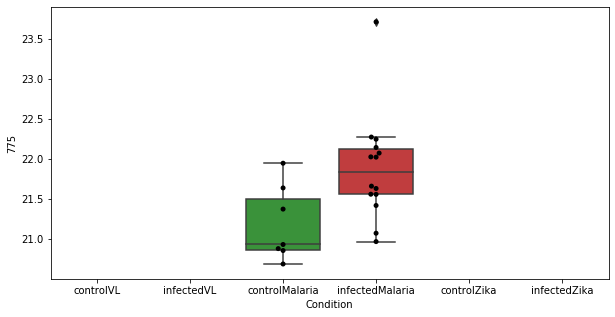

135 row m/z                 252.928
row retention time      2.67773
p-val                 0.0195309
adj.P.Val              0.279896
custom_id                  5034
compound_names              NaN
Name: 5034, dtype: object


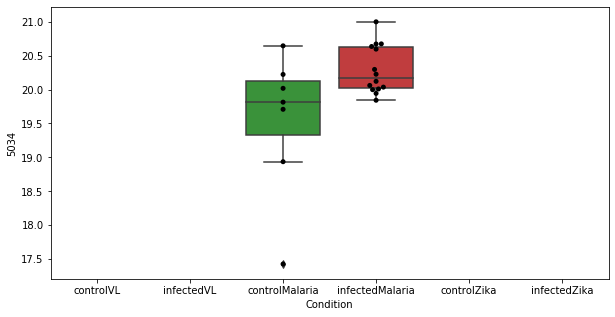

136 row m/z                                                         180.102
row retention time                                              7.73241
p-val                                                         0.0205932
adj.P.Val                                                      0.292965
custom_id                                                          1188
compound_names        (-)-Salsolinol; 6,7-Isoquinolinediol, 1,2,3,4-...
Name: 1188, dtype: object


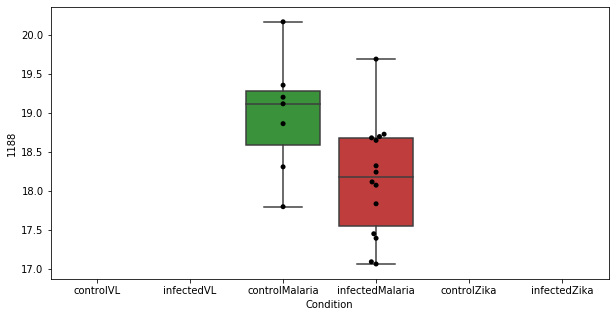

137 row m/z                332.243
row retention time      4.5829
p-val                 0.020817
adj.P.Val             0.294003
custom_id                 4095
compound_names             NaN
Name: 4095, dtype: object


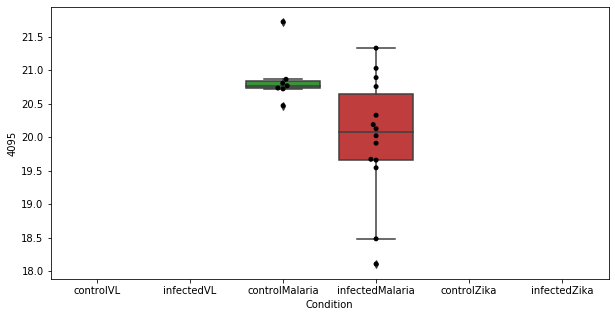

138 row m/z                   318.9
row retention time      2.76685
p-val                 0.0211383
adj.P.Val              0.295596
custom_id                  2336
compound_names              NaN
Name: 2336, dtype: object


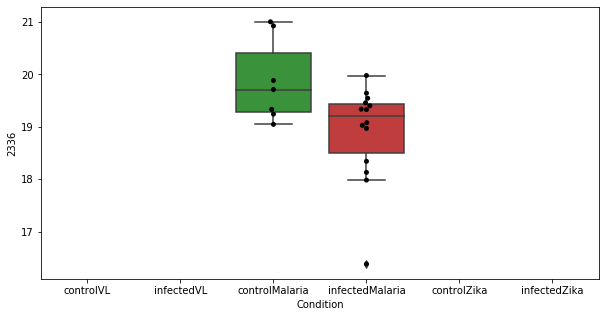

139 row m/z                   306.3
row retention time      23.1211
p-val                 0.0212546
adj.P.Val              0.295596
custom_id                  2277
compound_names              NaN
Name: 2277, dtype: object


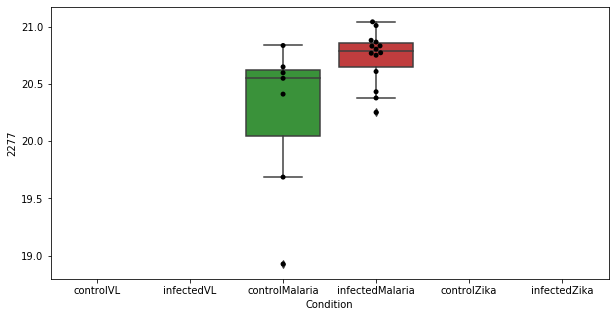

140 row m/z                 129.957
row retention time      11.8922
p-val                 0.0213848
adj.P.Val              0.295596
custom_id                   509
compound_names              NaN
Name: 509, dtype: object


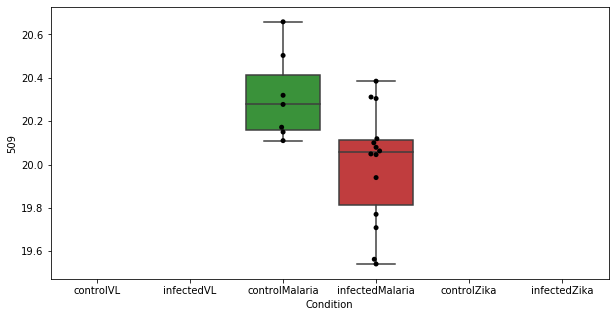

141 row m/z                 618.478
row retention time      3.19015
p-val                 0.0221441
adj.P.Val              0.302521
custom_id                  2763
compound_names              NaN
Name: 2763, dtype: object


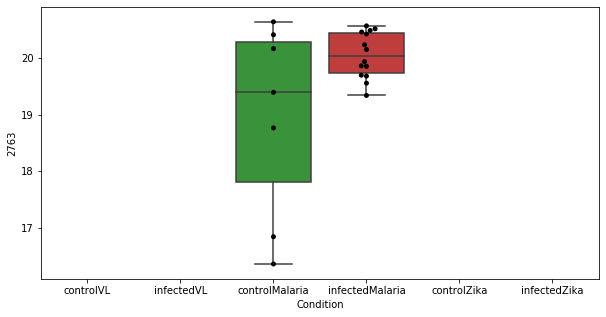

142 row m/z                 231.134
row retention time       9.5387
p-val                 0.0223415
adj.P.Val              0.302521
custom_id                  1729
compound_names              NaN
Name: 1729, dtype: object


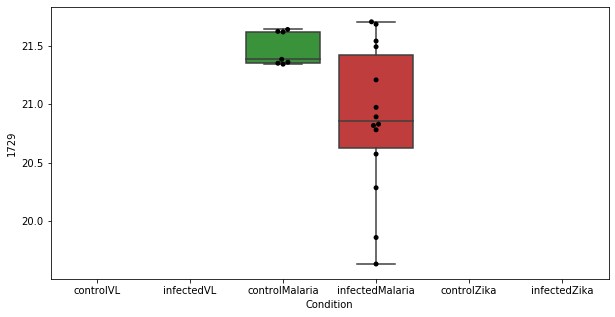

143 row m/z                 252.179
row retention time      3.93058
p-val                 0.0223515
adj.P.Val              0.302521
custom_id                  1930
compound_names              NaN
Name: 1930, dtype: object


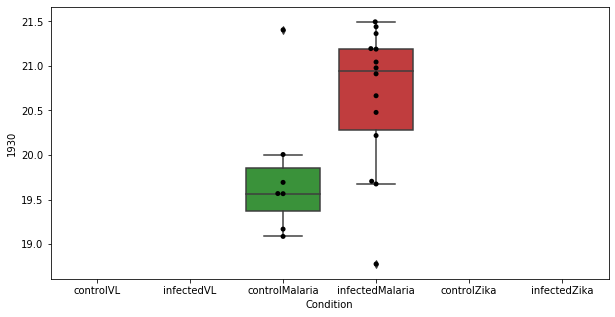

144 row m/z                 181.04
row retention time     10.1135
p-val                 0.022778
adj.P.Val             0.306168
custom_id                 1197
compound_names             NaN
Name: 1197, dtype: object


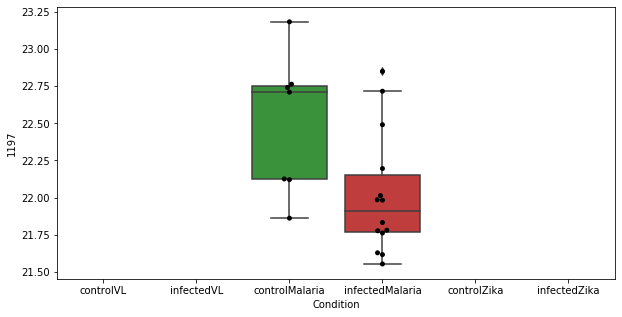

145 row m/z                 563.398
row retention time      3.45962
p-val                 0.0236287
adj.P.Val              0.315427
custom_id                  5262
compound_names              NaN
Name: 5262, dtype: object


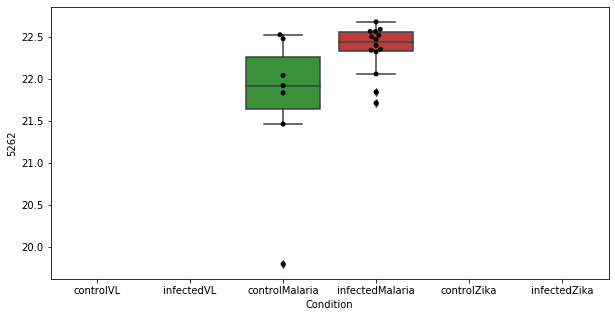

146 row m/z                 184.073
row retention time      4.07724
p-val                 0.0241019
adj.P.Val              0.319555
custom_id                  1230
compound_names              NaN
Name: 1230, dtype: object


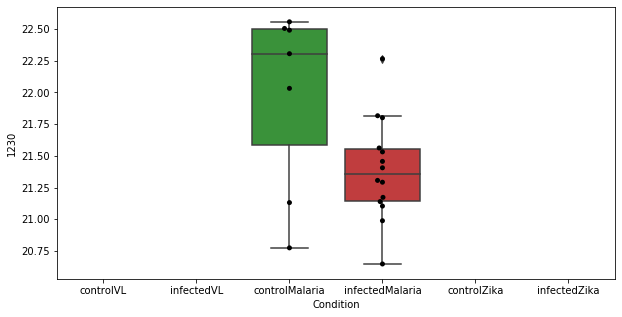

147 row m/z                 252.048
row retention time      10.6094
p-val                 0.0244025
adj.P.Val               0.31973
custom_id                  1924
compound_names              NaN
Name: 1924, dtype: object


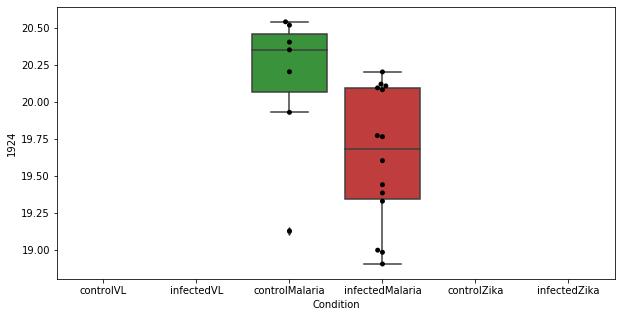

148 row m/z                 483.327
row retention time      4.18151
p-val                 0.0244432
adj.P.Val               0.31973
custom_id                  2610
compound_names              NaN
Name: 2610, dtype: object


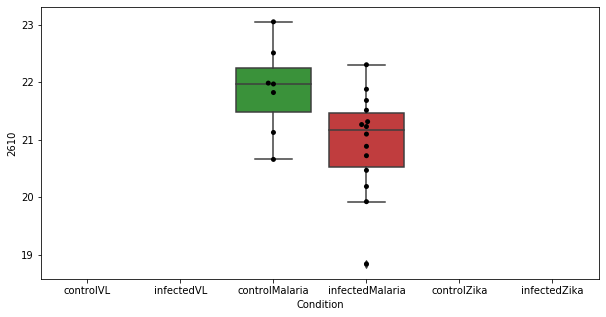

149 row m/z                 802.686
row retention time      6.70006
p-val                 0.0255447
adj.P.Val               0.32961
custom_id                  4295
compound_names              NaN
Name: 4295, dtype: object


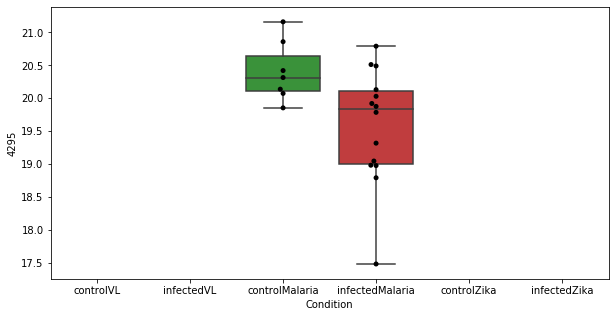

150 row m/z                 134.106
row retention time      9.94777
p-val                 0.0255963
adj.P.Val               0.32961
custom_id                  6488
compound_names              NaN
Name: 6488, dtype: object


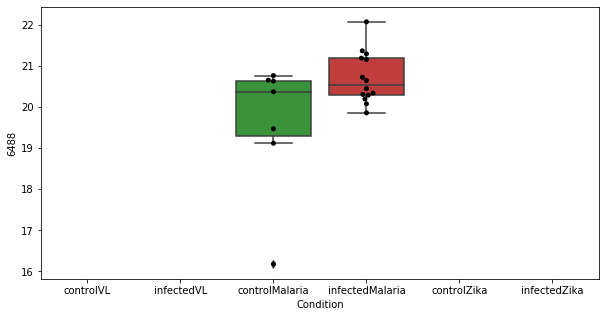

151 row m/z                 787.666
row retention time      3.64839
p-val                 0.0257917
adj.P.Val               0.32961
custom_id                  2916
compound_names              NaN
Name: 2916, dtype: object


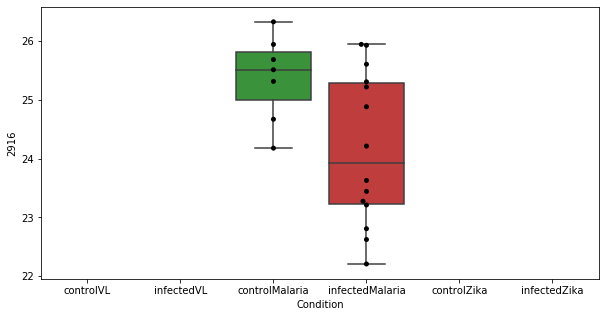

152 row m/z                 454.293
row retention time      4.10812
p-val                 0.0258749
adj.P.Val               0.32961
custom_id                  2586
compound_names              NaN
Name: 2586, dtype: object


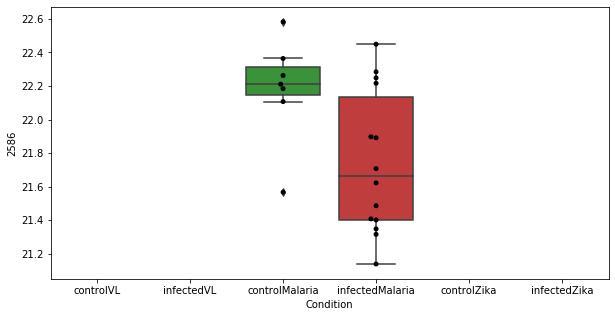

153 row m/z                             160.097
row retention time                  9.51138
p-val                             0.0266955
adj.P.Val                          0.333725
custom_id                              3435
compound_names        5-Acetamidopentanoate
Name: 3435, dtype: object


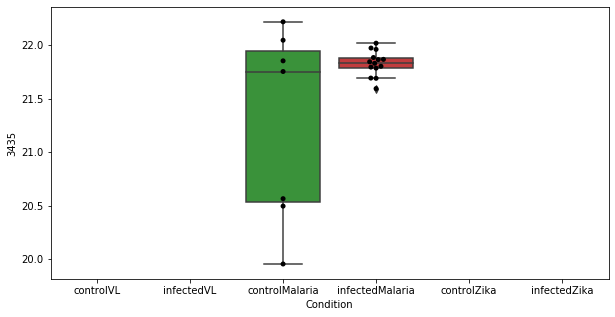

154 row m/z                 559.475
row retention time      3.28058
p-val                 0.0267323
adj.P.Val              0.333725
custom_id                  2705
compound_names              NaN
Name: 2705, dtype: object


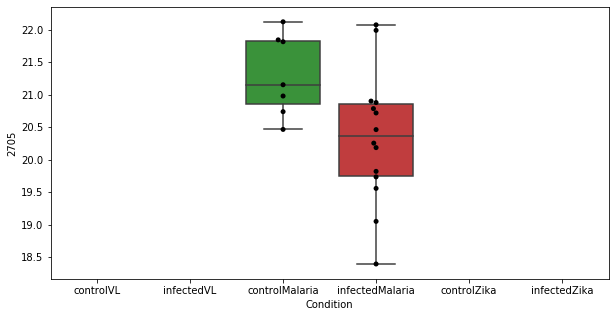

155 row m/z                 79.9897
row retention time       10.785
p-val                 0.0268167
adj.P.Val              0.333725
custom_id                    32
compound_names              NaN
Name: 32, dtype: object


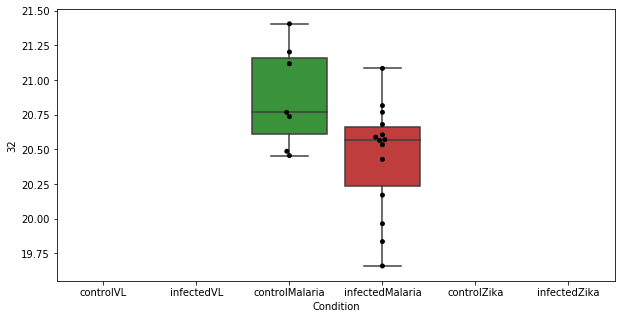

156 row m/z                 226.936
row retention time      11.6011
p-val                 0.0270336
adj.P.Val              0.333725
custom_id                  4965
compound_names              NaN
Name: 4965, dtype: object


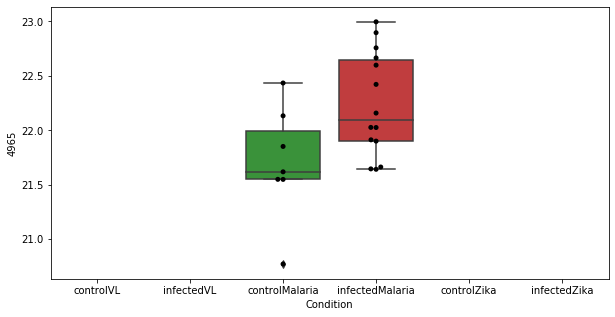

157 row m/z                 563.428
row retention time      3.21721
p-val                 0.0272228
adj.P.Val              0.333725
custom_id                  2707
compound_names              NaN
Name: 2707, dtype: object


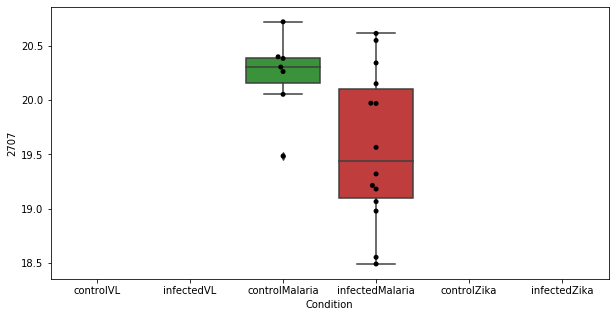

158 row m/z                                                         111.044
row retention time                                              4.70132
p-val                                                         0.0272545
adj.P.Val                                                      0.333725
custom_id                                                           227
compound_names        p-Benzenediol; Hydroquinone; 1,4-Benzenediol; ...
Name: 227, dtype: object


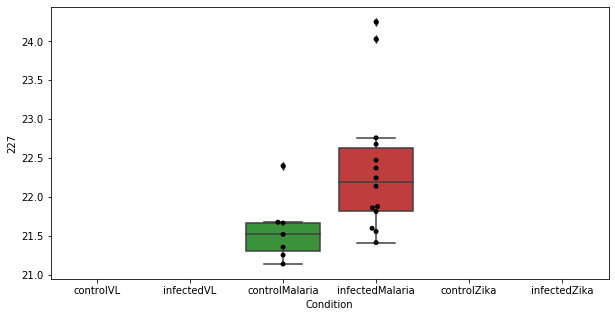

159 row m/z                 170.154
row retention time      8.38786
p-val                 0.0273994
adj.P.Val              0.333725
custom_id                  1068
compound_names              NaN
Name: 1068, dtype: object


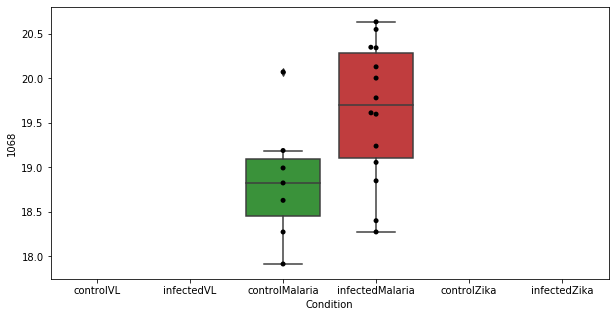

160 row m/z                 343.169
row retention time      3.68534
p-val                 0.0276343
adj.P.Val              0.333725
custom_id                  2406
compound_names              NaN
Name: 2406, dtype: object


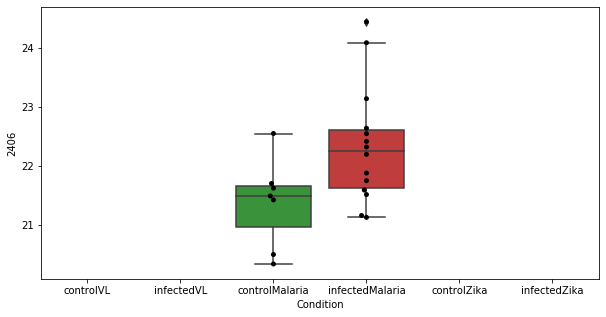

161 row m/z                 89.0709
row retention time      6.24533
p-val                 0.0277391
adj.P.Val              0.333725
custom_id                    84
compound_names              NaN
Name: 84, dtype: object


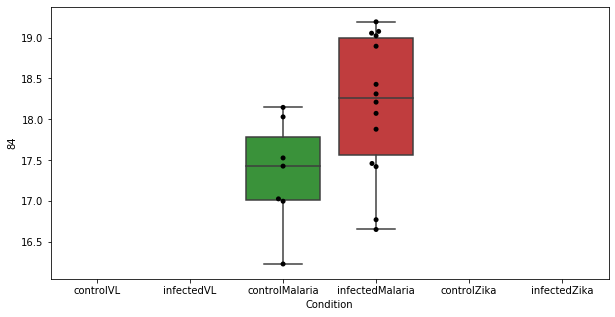

162 row m/z                   380.9
row retention time      8.29395
p-val                 0.0283197
adj.P.Val               0.33862
custom_id                  4160
compound_names              NaN
Name: 4160, dtype: object


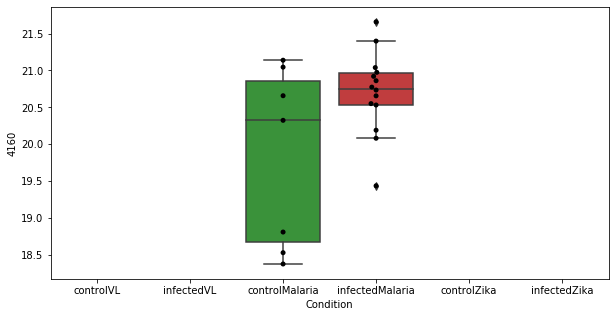

163 row m/z                 292.908
row retention time      10.6137
p-val                 0.0293062
adj.P.Val              0.348279
custom_id                  2224
compound_names              NaN
Name: 2224, dtype: object


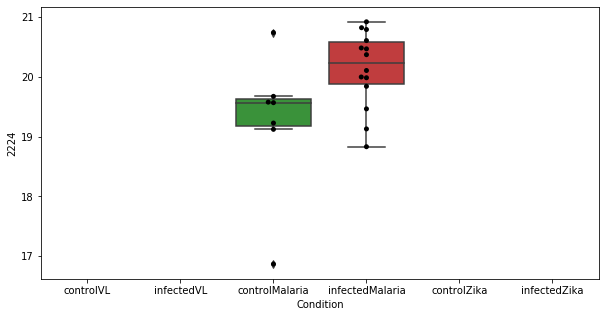

164 row m/z                 330.157
row retention time      3.67155
p-val                 0.0302079
adj.P.Val              0.356819
custom_id                  2382
compound_names              NaN
Name: 2382, dtype: object


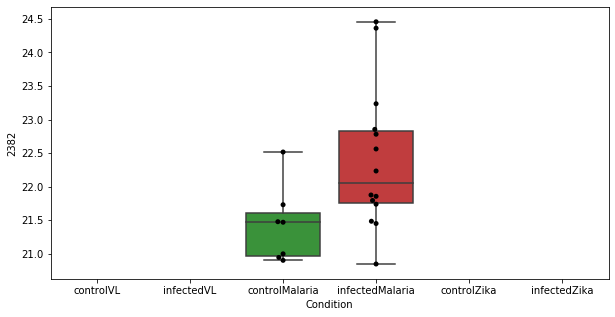

165 row m/z                                                       129.102
row retention time                                            23.7643
p-val                                                       0.0306357
adj.P.Val                                                     0.35836
custom_id                                                        3235
compound_names        L-Lysine; Lysine acid; 2,6-Diaminohexanoic acid
Name: 3235, dtype: object


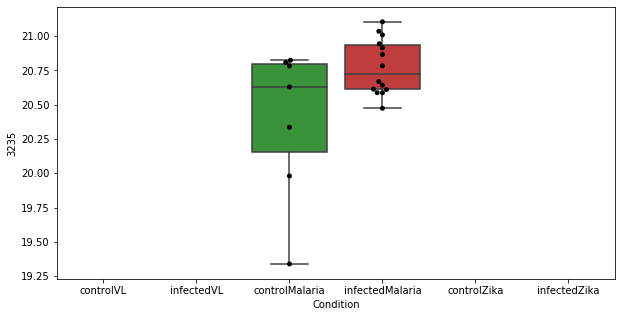

166 row m/z                  880.59
row retention time      3.28468
p-val                 0.0307303
adj.P.Val               0.35836
custom_id                  2975
compound_names              NaN
Name: 2975, dtype: object


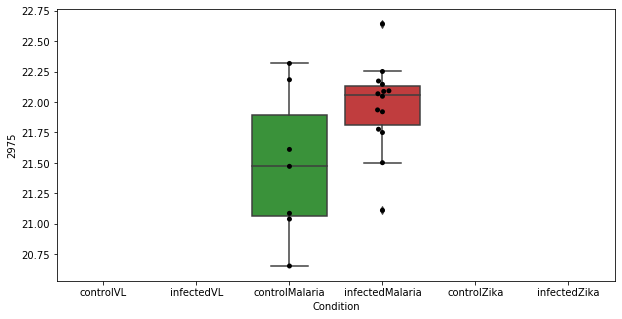

167 row m/z                 219.134
row retention time      8.48724
p-val                 0.0308899
adj.P.Val               0.35836
custom_id                  5897
compound_names              NaN
Name: 5897, dtype: object


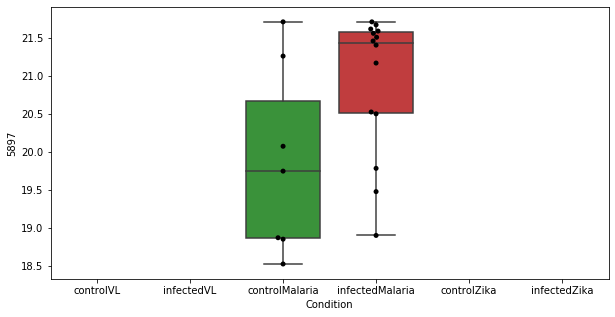

168 row m/z                 82.0518
row retention time      3.66066
p-val                 0.0317768
adj.P.Val              0.366467
custom_id                    46
compound_names              NaN
Name: 46, dtype: object


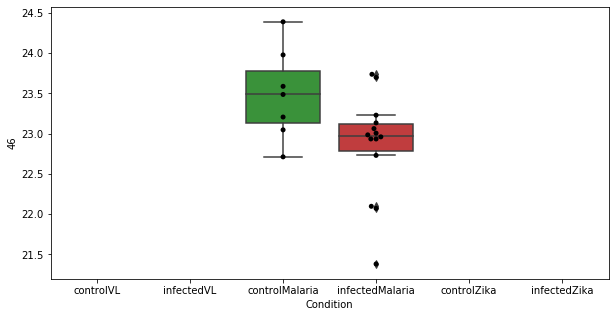

169 row m/z                  717.84
row retention time      8.81726
p-val                 0.0326632
adj.P.Val              0.374474
custom_id                  2833
compound_names              NaN
Name: 2833, dtype: object


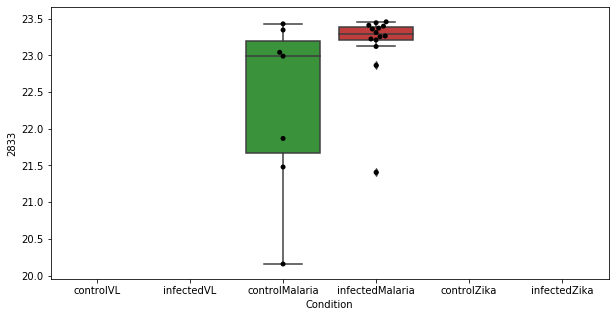

170 row m/z                 180.006
row retention time      10.1067
p-val                 0.0331302
adj.P.Val              0.374925
custom_id                  1170
compound_names              NaN
Name: 1170, dtype: object


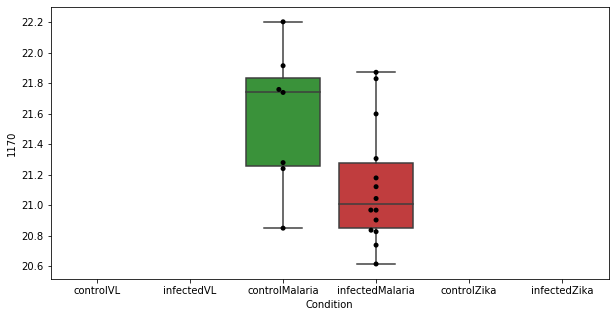

171 row m/z                 302.232
row retention time      7.00285
p-val                 0.0334602
adj.P.Val              0.374925
custom_id                  4037
compound_names              NaN
Name: 4037, dtype: object


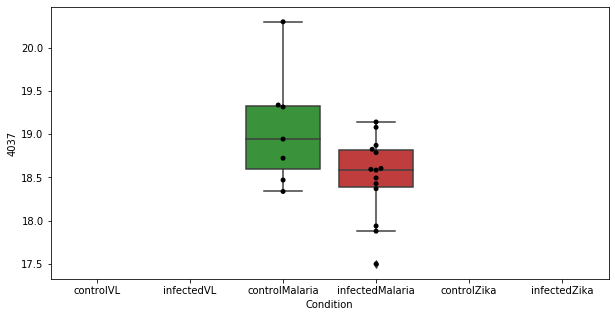

172 row m/z                 359.164
row retention time      3.61612
p-val                 0.0334707
adj.P.Val              0.374925
custom_id                  2439
compound_names              NaN
Name: 2439, dtype: object


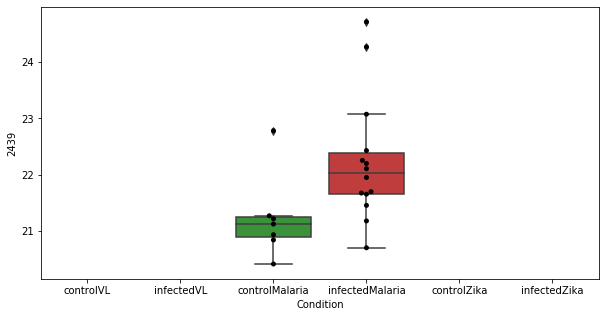

173 row m/z                 215.086
row retention time       8.2787
p-val                 0.0334803
adj.P.Val              0.374925
custom_id                  1586
compound_names              NaN
Name: 1586, dtype: object


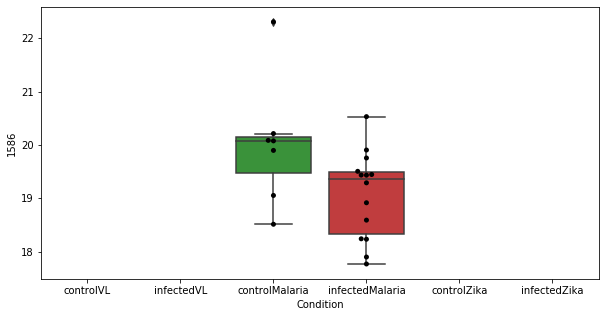

174 row m/z                 133.099
row retention time      9.60623
p-val                 0.0337716
adj.P.Val              0.374925
custom_id                   581
compound_names              NaN
Name: 581, dtype: object


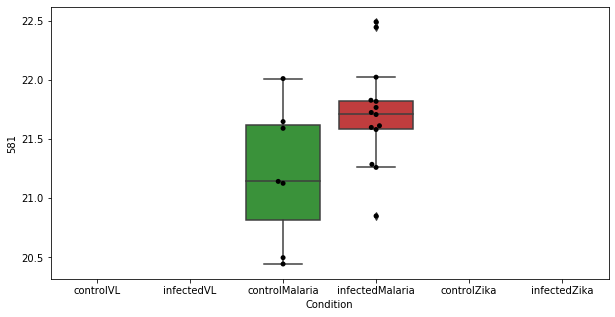

175 row m/z                      170.118
row retention time           4.53128
p-val                      0.0338567
adj.P.Val                   0.374925
custom_id                       1063
compound_names        L-Metanephrine
Name: 1063, dtype: object


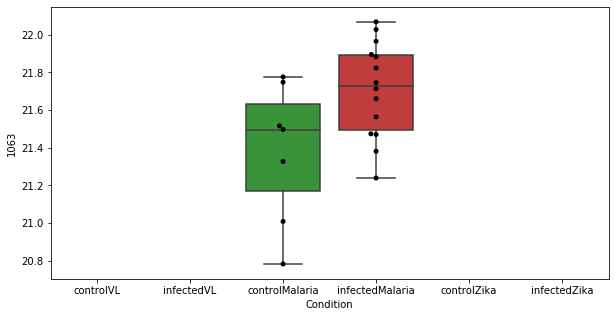

176 row m/z                 265.166
row retention time      6.98126
p-val                 0.0342836
adj.P.Val               0.37657
custom_id                  2004
compound_names              NaN
Name: 2004, dtype: object


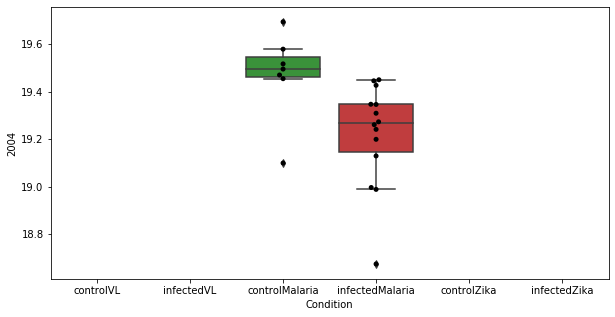

177 row m/z                                 139.05
row retention time                     23.5957
p-val                                0.0343917
adj.P.Val                              0.37657
custom_id                                  629
compound_names        Urocanate; Urocanic acid
Name: 629, dtype: object


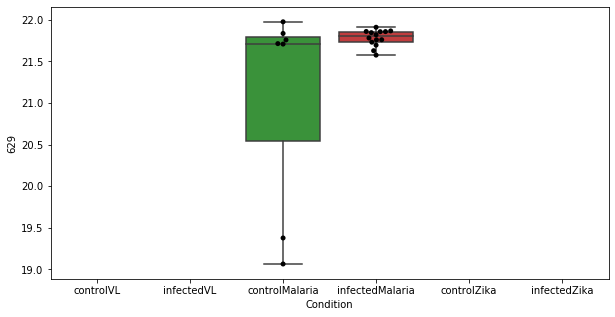

178 row m/z                 190.107
row retention time      23.7072
p-val                 0.0348047
adj.P.Val              0.378963
custom_id                  1318
compound_names              NaN
Name: 1318, dtype: object


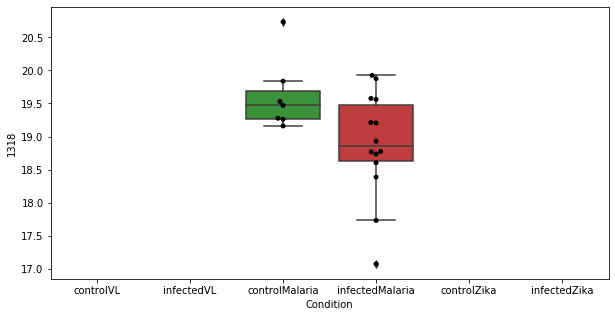

179 row m/z                 125.096
row retention time        3.911
p-val                 0.0351482
adj.P.Val              0.380577
custom_id                   443
compound_names              NaN
Name: 443, dtype: object


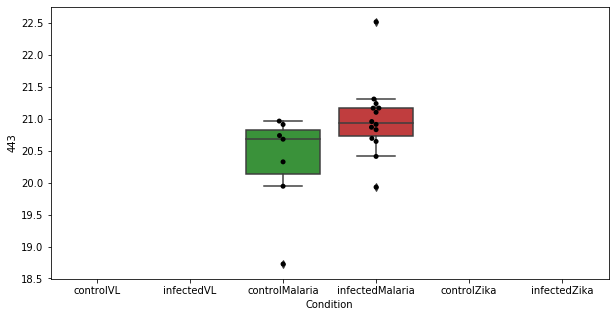

180 row m/z                  290.16
row retention time      10.3192
p-val                 0.0360934
adj.P.Val              0.388652
custom_id                  4003
compound_names              NaN
Name: 4003, dtype: object


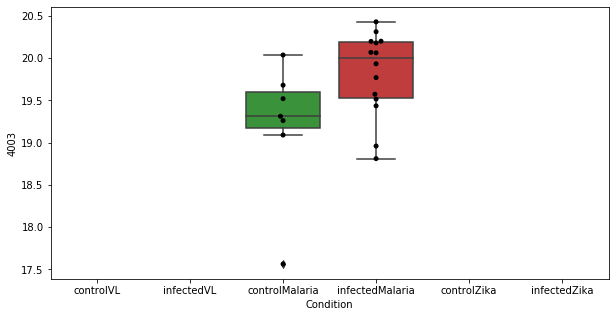

181 row m/z                 288.144
row retention time       6.9691
p-val                 0.0365295
adj.P.Val              0.391187
custom_id                  2191
compound_names              NaN
Name: 2191, dtype: object


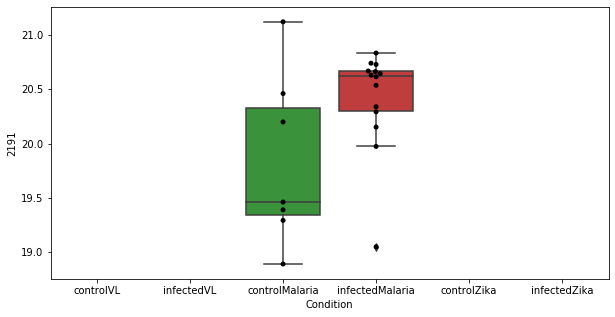

182 row m/z                 220.887
row retention time      14.4161
p-val                 0.0370217
adj.P.Val              0.394291
custom_id                  1641
compound_names              NaN
Name: 1641, dtype: object


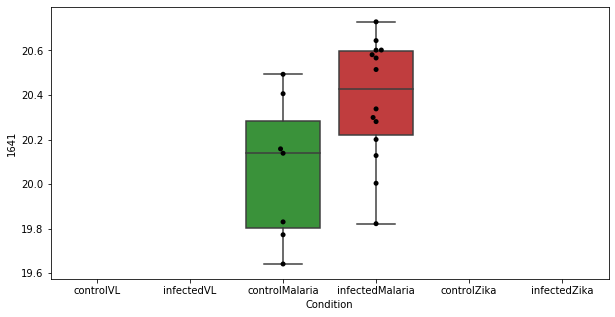

183 row m/z                 778.828
row retention time       11.884
p-val                 0.0380567
adj.P.Val              0.400891
custom_id                  2888
compound_names              NaN
Name: 2888, dtype: object


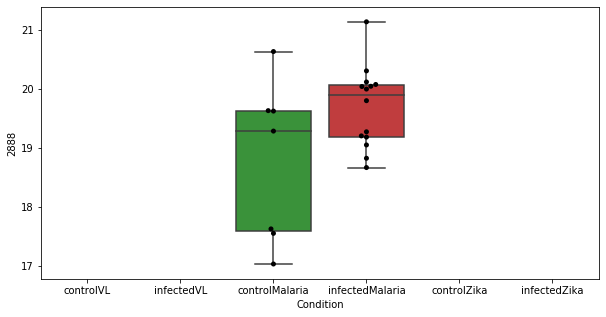

184 row m/z                 82.0476
row retention time      23.8543
p-val                 0.0380931
adj.P.Val              0.400891
custom_id                  4342
compound_names              NaN
Name: 4342, dtype: object


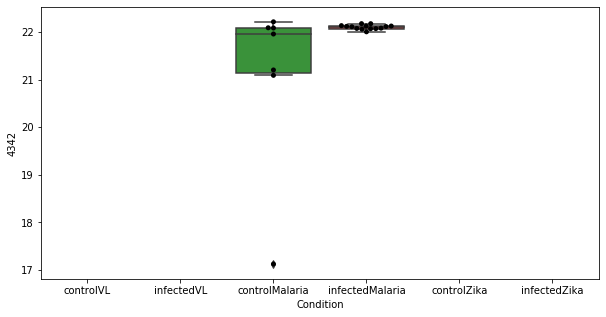

185 row m/z                 104.008
row retention time      23.9069
p-val                 0.0382585
adj.P.Val              0.400891
custom_id                  3096
compound_names              NaN
Name: 3096, dtype: object


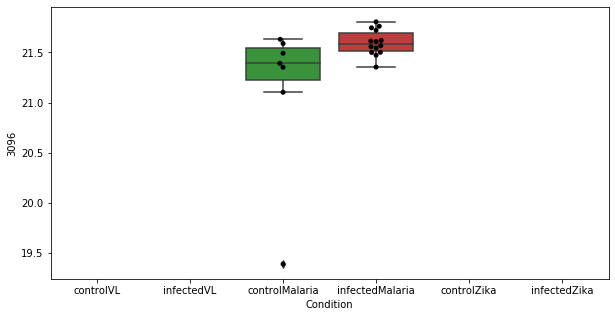

186 row m/z                 86.9391
row retention time      5.63294
p-val                 0.0385962
adj.P.Val              0.402268
custom_id                    72
compound_names              NaN
Name: 72, dtype: object


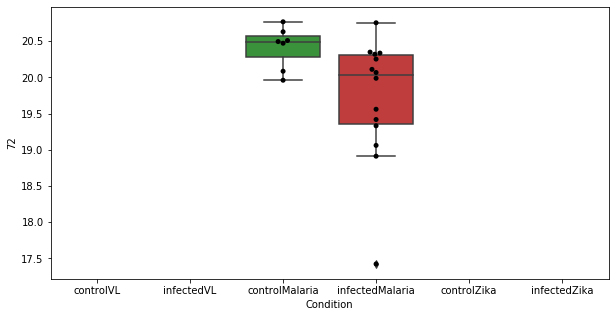

187 row m/z                 209.973
row retention time      23.4344
p-val                 0.0389153
adj.P.Val              0.403435
custom_id                  1517
compound_names              NaN
Name: 1517, dtype: object


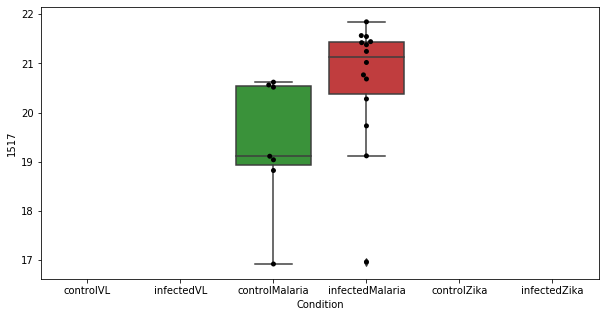

188 row m/z                 188.128
row retention time      3.93523
p-val                 0.0401926
adj.P.Val              0.414473
custom_id                  1280
compound_names              NaN
Name: 1280, dtype: object


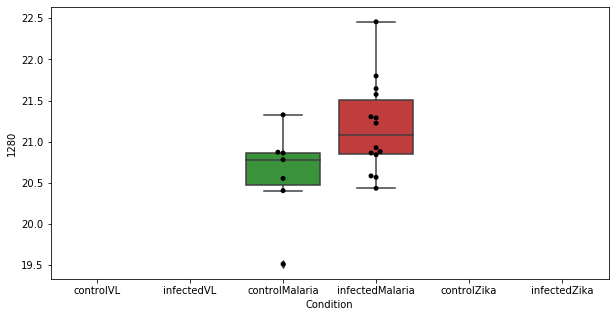

189 row m/z                                                         169.086
row retention time                                               6.9921
p-val                                                         0.0407376
adj.P.Val                                                      0.417882
custom_id                                                          3477
compound_names        N-Trimethyl-2-aminoethylphosphonate; 2-Trimeth...
Name: 3477, dtype: object


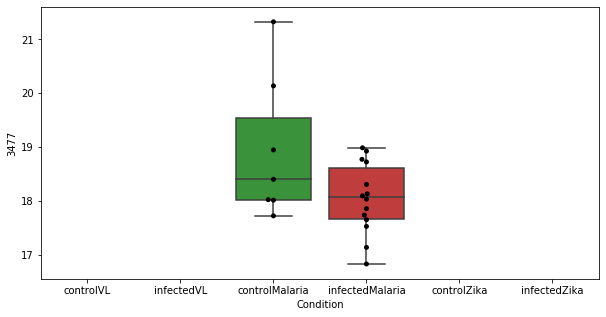

190 row m/z                 523.359
row retention time      4.02841
p-val                 0.0412343
adj.P.Val              0.420763
custom_id                  2649
compound_names              NaN
Name: 2649, dtype: object


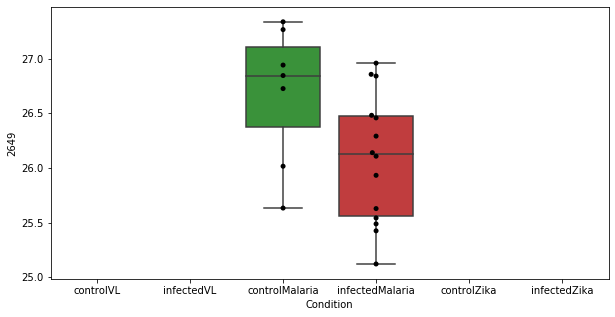

191 row m/z                 249.185
row retention time      3.64012
p-val                 0.0419363
adj.P.Val              0.423881
custom_id                  1894
compound_names              NaN
Name: 1894, dtype: object


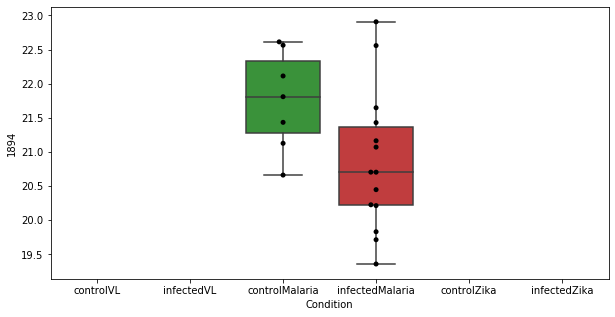

192 row m/z                 445.165
row retention time      8.40312
p-val                 0.0420356
adj.P.Val              0.423881
custom_id                  2579
compound_names              NaN
Name: 2579, dtype: object


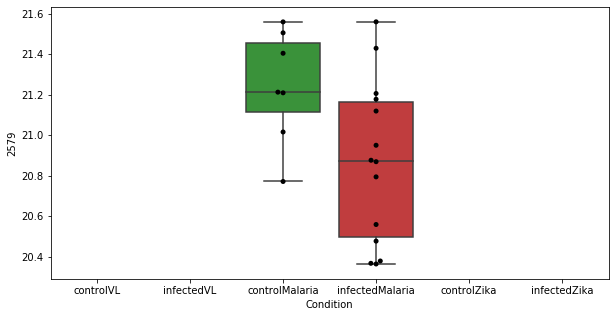

193 row m/z                 140.011
row retention time      3.66801
p-val                 0.0421923
adj.P.Val              0.423881
custom_id                   642
compound_names              NaN
Name: 642, dtype: object


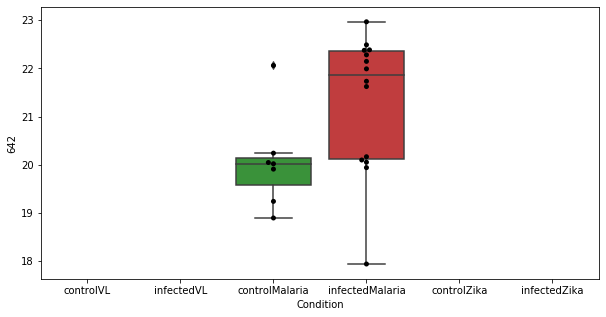

194 row m/z                 522.356
row retention time      4.03346
p-val                 0.0431249
adj.P.Val              0.431027
custom_id                  2647
compound_names              NaN
Name: 2647, dtype: object


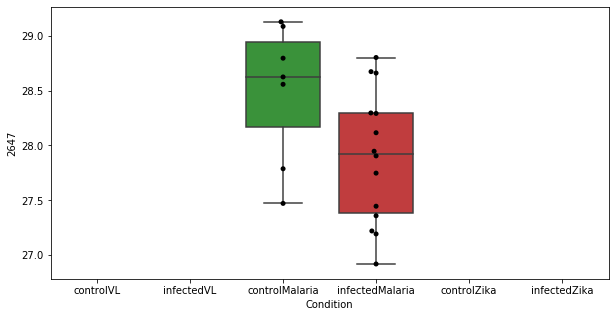

195 row m/z                 246.134
row retention time      3.82371
p-val                 0.0434046
adj.P.Val               0.43161
custom_id                  1877
compound_names              NaN
Name: 1877, dtype: object


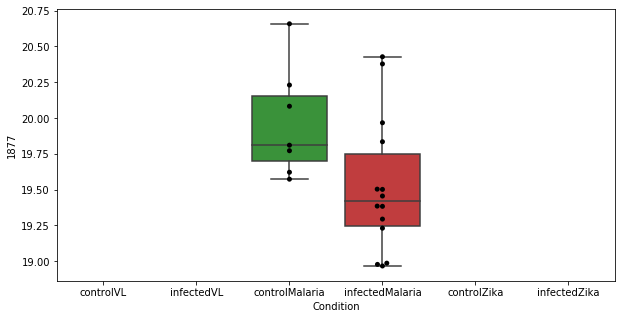

196 row m/z                  257.15
row retention time      23.1029
p-val                 0.0436806
adj.P.Val              0.431817
custom_id                  1962
compound_names              NaN
Name: 1962, dtype: object


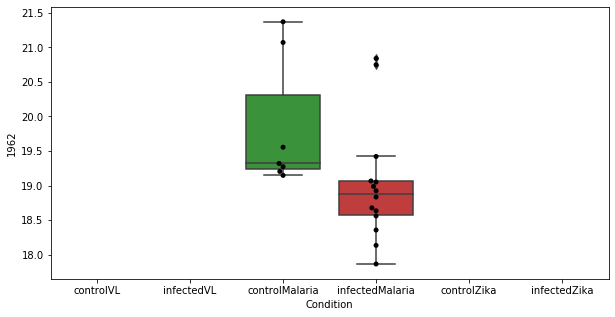

197 row m/z                 218.102
row retention time      3.97834
p-val                 0.0438686
adj.P.Val              0.431817
custom_id                  1625
compound_names              NaN
Name: 1625, dtype: object


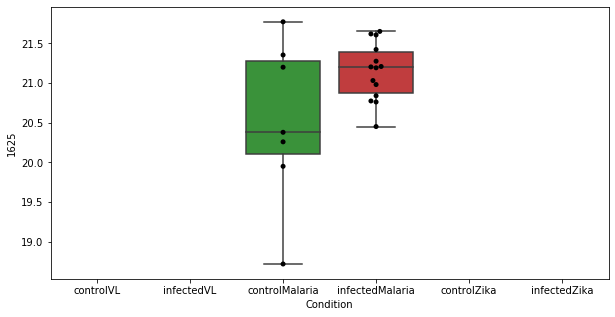

198 row m/z                 133.099
row retention time       9.9555
p-val                 0.0447799
adj.P.Val              0.438573
custom_id                  6487
compound_names              NaN
Name: 6487, dtype: object


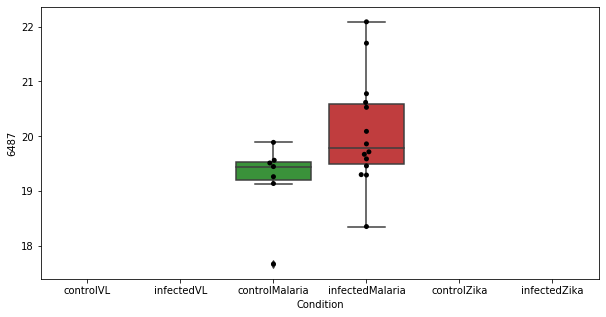

199 row m/z                     227.164
row retention time          3.86315
p-val                     0.0450614
adj.P.Val                  0.439124
custom_id                      3748
compound_names        lysyl-proline
Name: 3748, dtype: object


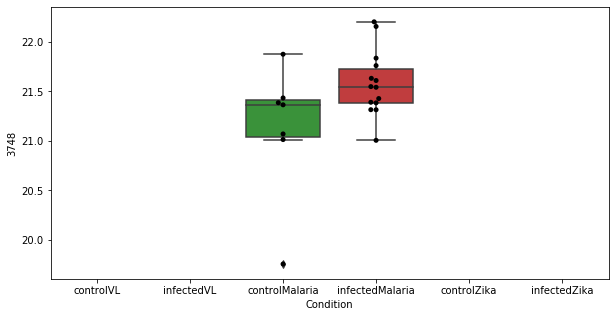

200 row m/z                 234.077
row retention time      13.5682
p-val                 0.0453771
adj.P.Val              0.439999
custom_id                  1748
compound_names              NaN
Name: 1748, dtype: object


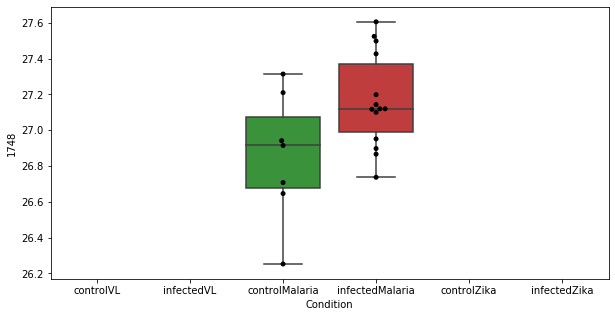

201 row m/z                 219.93
row retention time     15.1443
p-val                 0.047403
adj.P.Val             0.457369
custom_id                 1638
compound_names             NaN
Name: 1638, dtype: object


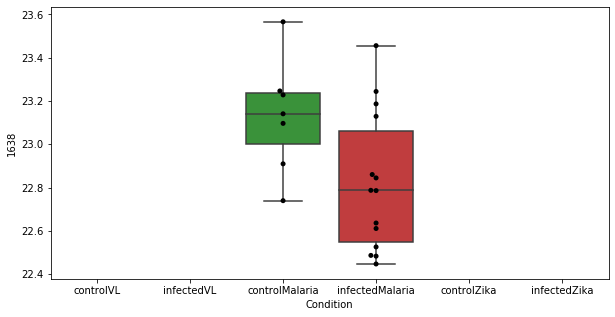

202 row m/z                 268.893
row retention time      23.3841
p-val                 0.0478313
adj.P.Val              0.459227
custom_id                  3920
compound_names              NaN
Name: 3920, dtype: object


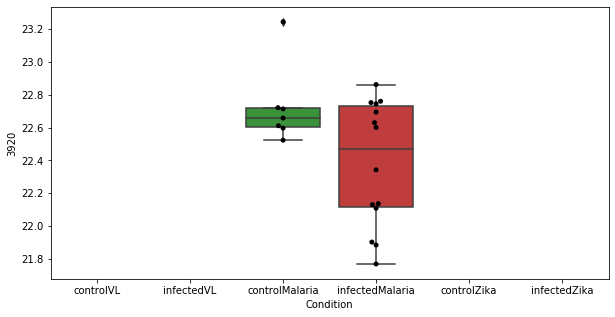

203 row m/z                 218.211
row retention time      23.7928
p-val                 0.0482868
adj.P.Val              0.459824
custom_id                  1632
compound_names              NaN
Name: 1632, dtype: object


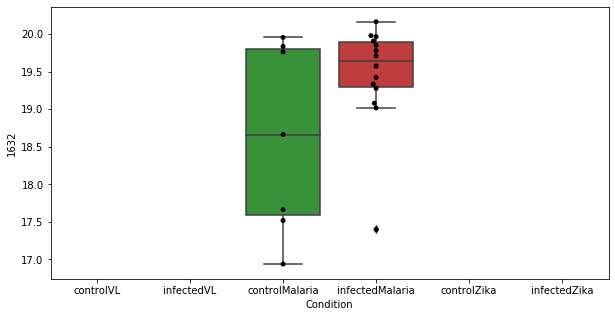

204 row m/z                                      314.269
row retention time                           3.62943
p-val                                        0.04847
adj.P.Val                                   0.459824
custom_id                                       2314
compound_names        4,8 dimethylnonanoyl carnitine
Name: 2314, dtype: object


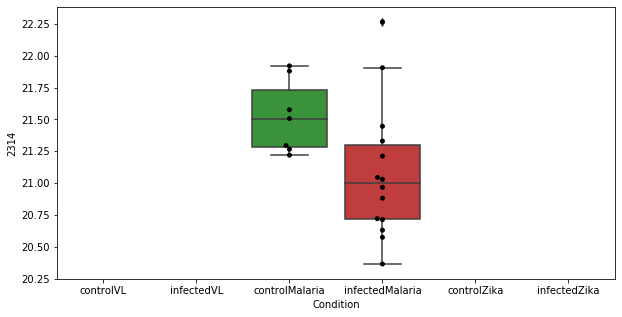

205 row m/z                 105.074
row retention time      4.86613
p-val                 0.0486012
adj.P.Val              0.459824
custom_id                   181
compound_names              NaN
Name: 181, dtype: object


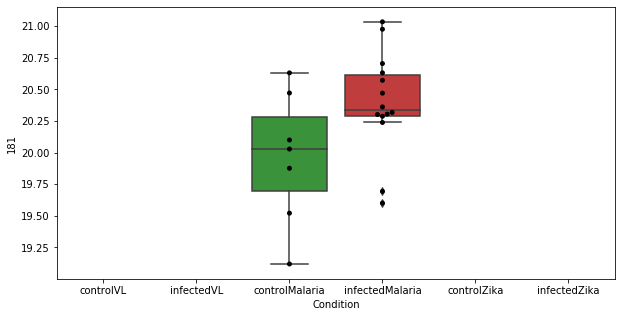

206 row m/z                 245.149
row retention time      10.7278
p-val                 0.0488919
adj.P.Val              0.460339
custom_id                  3822
compound_names              NaN
Name: 3822, dtype: object


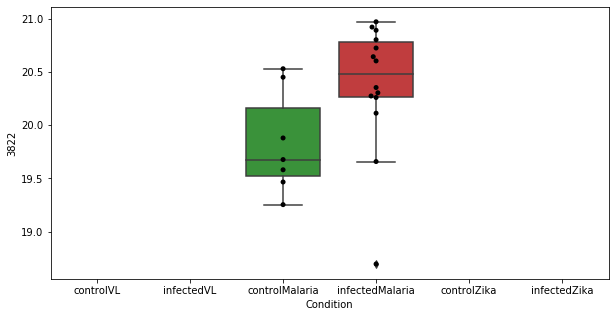

207 row m/z                 132.062
row retention time      9.59345
p-val                 0.0495258
adj.P.Val              0.464066
custom_id                   545
compound_names              NaN
Name: 545, dtype: object


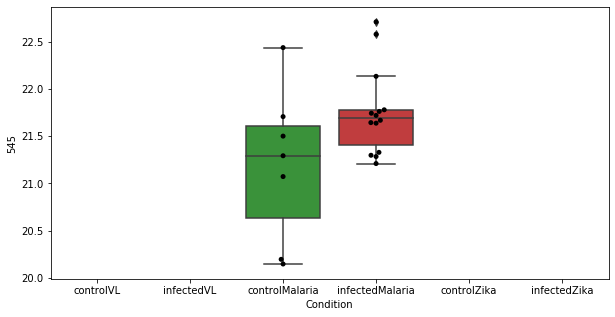

208 row m/z                 315.236
row retention time      4.56003
p-val                 0.0504006
adj.P.Val              0.470003
custom_id                  2320
compound_names              NaN
Name: 2320, dtype: object


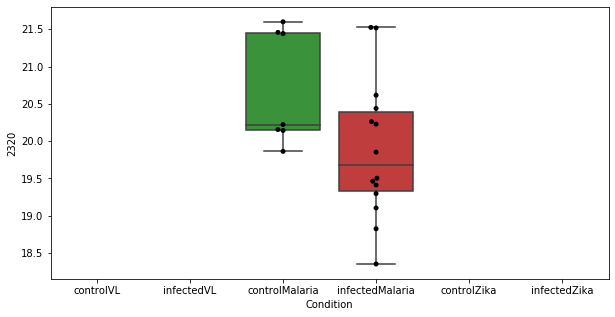

209 row m/z                  318.9
row retention time     1.32323
p-val                  0.05077
adj.P.Val             0.471194
custom_id                 2337
compound_names             NaN
Name: 2337, dtype: object


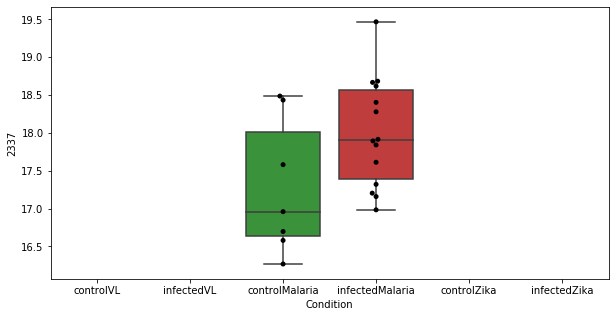

210 row m/z                 214.253
row retention time      1.00831
p-val                 0.0518777
adj.P.Val              0.479192
custom_id                  3686
compound_names              NaN
Name: 3686, dtype: object


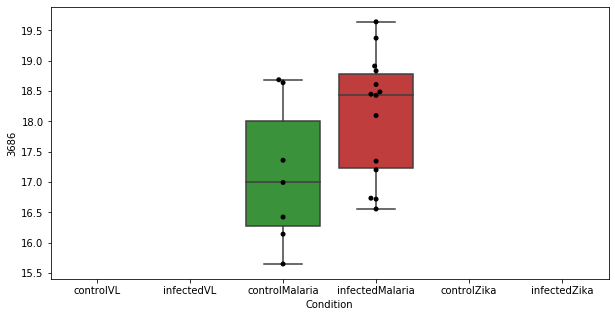

211 row m/z                                                           74.06
row retention time                                              10.7592
p-val                                                         0.0529941
adj.P.Val                                                      0.487196
custom_id                                                          2993
compound_names        6-Amino-2-oxohexanoate; 2-Oxo-6-aminocaproate$...
Name: 2993, dtype: object


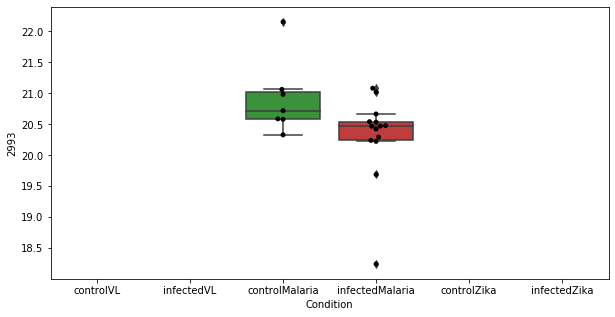

212 row m/z                 469.389
row retention time      3.43509
p-val                 0.0539774
adj.P.Val              0.493905
custom_id                  2598
compound_names              NaN
Name: 2598, dtype: object


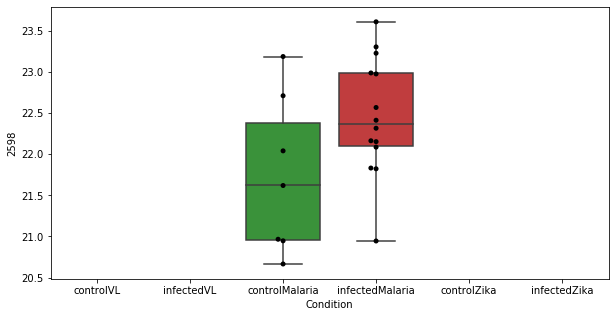

213 row m/z                 292.908
row retention time       11.544
p-val                 0.0566531
adj.P.Val               0.51128
custom_id                  2222
compound_names              NaN
Name: 2222, dtype: object


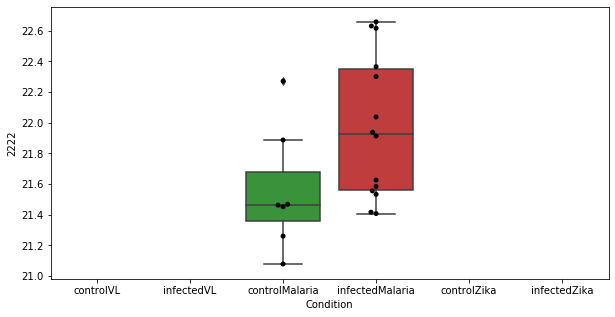

214 row m/z                  143.04
row retention time     0.229321
p-val                 0.0568945
adj.P.Val               0.51128
custom_id                  3330
compound_names              NaN
Name: 3330, dtype: object


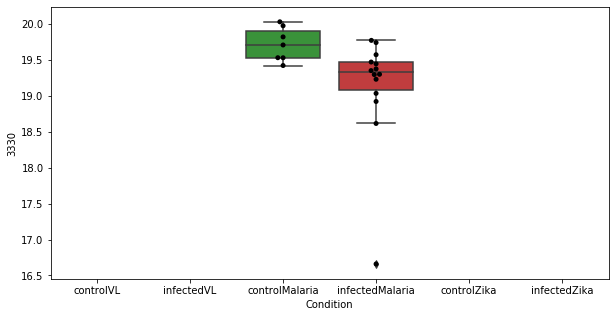

215 row m/z                 275.103
row retention time      13.5497
p-val                 0.0569977
adj.P.Val               0.51128
custom_id                  2083
compound_names              NaN
Name: 2083, dtype: object


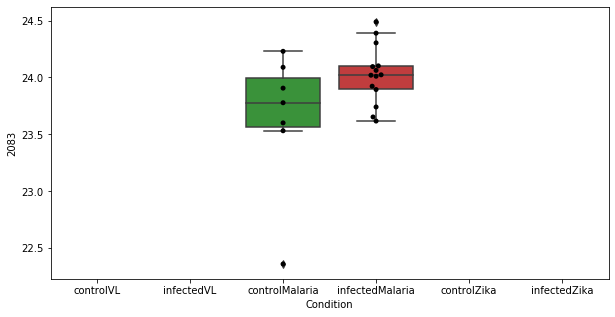

216 row m/z                659.834
row retention time     8.85288
p-val                 0.057012
adj.P.Val              0.51128
custom_id                 2796
compound_names             NaN
Name: 2796, dtype: object


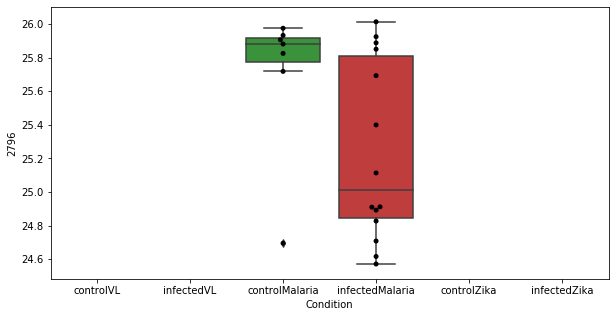

217 row m/z                 445.165
row retention time      4.86509
p-val                 0.0574442
adj.P.Val               0.51128
custom_id                  2577
compound_names              NaN
Name: 2577, dtype: object


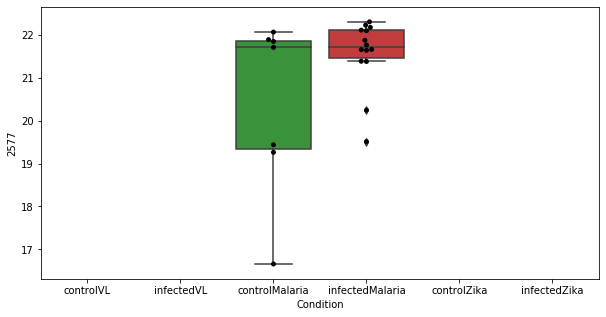

218 row m/z                                                         185.081
row retention time                                              4.57202
p-val                                                         0.0574501
adj.P.Val                                                       0.51128
custom_id                                                          1242
compound_names        Choline phosphate; Phosphorylcholine; Phosphoc...
Name: 1242, dtype: object


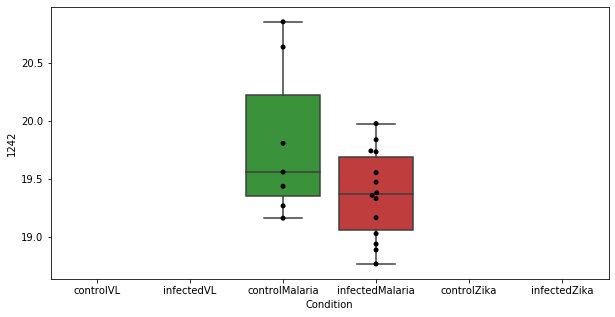

219 row m/z                 148.993
row retention time      6.60509
p-val                 0.0581575
adj.P.Val              0.512976
custom_id                   795
compound_names              NaN
Name: 795, dtype: object


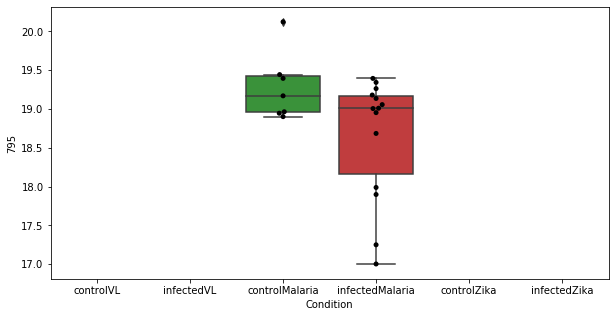

220 row m/z                                                         114.055
row retention time                                              9.94368
p-val                                                         0.0588414
adj.P.Val                                                      0.512976
custom_id                                                           277
compound_names        1-Pyrroline-2-carboxylate; 1-Pyrroline-2-carbo...
Name: 277, dtype: object


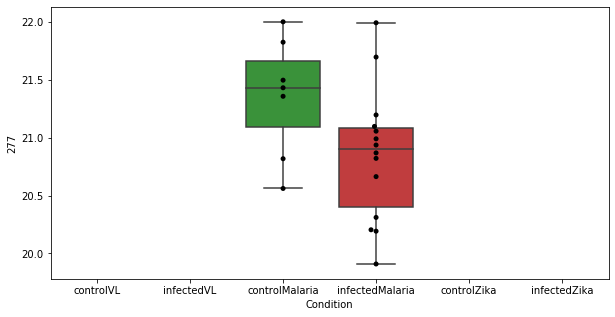

221 row m/z                 84.0574
row retention time      23.8296
p-val                 0.0592394
adj.P.Val              0.512976
custom_id                    52
compound_names              NaN
Name: 52, dtype: object


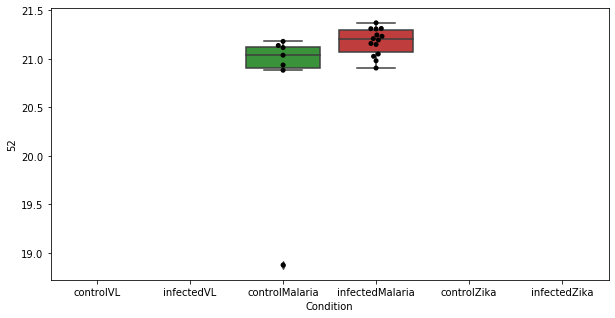

222 row m/z                                                  133.086
row retention time                                       6.99846
p-val                                                  0.0594787
adj.P.Val                                               0.512976
custom_id                                                    577
compound_names        6-Hydroxyhexanoic acid; 6-Hydroxyhexanoate
Name: 577, dtype: object


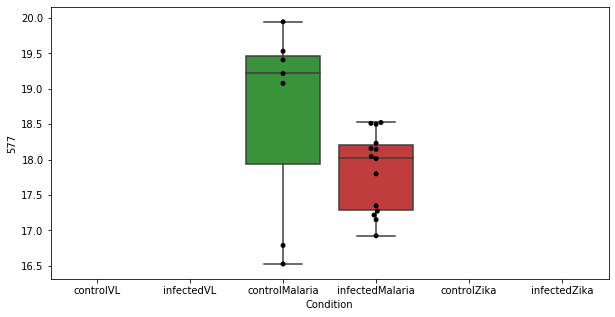

223 row m/z                129.957
row retention time     23.7312
p-val                 0.059797
adj.P.Val             0.512976
custom_id                  506
compound_names             NaN
Name: 506, dtype: object


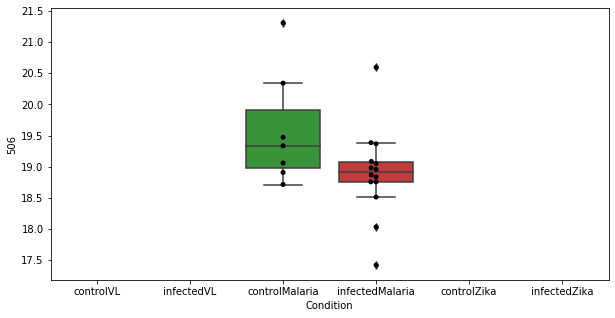

224 row m/z                 236.073
row retention time      13.6265
p-val                 0.0599458
adj.P.Val              0.512976
custom_id                  4987
compound_names              NaN
Name: 4987, dtype: object


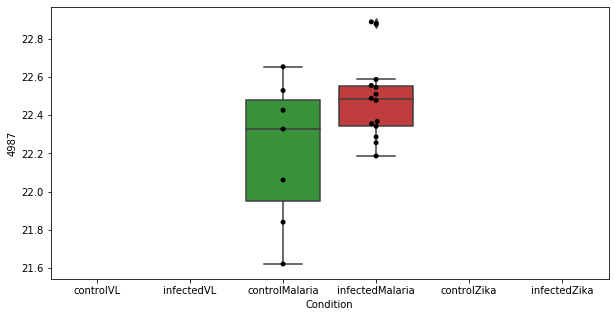

225 row m/z                                                         111.055
row retention time                                              6.99614
p-val                                                         0.0599473
adj.P.Val                                                      0.512976
custom_id                                                           230
compound_names        5,6-Dihydrothymine; Dihydrothymine; 5,6-Dihydr...
Name: 230, dtype: object


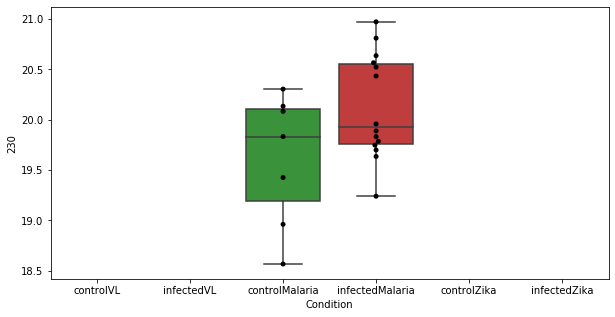

226 row m/z                 343.133
row retention time      3.73404
p-val                 0.0599871
adj.P.Val              0.512976
custom_id                  2405
compound_names              NaN
Name: 2405, dtype: object


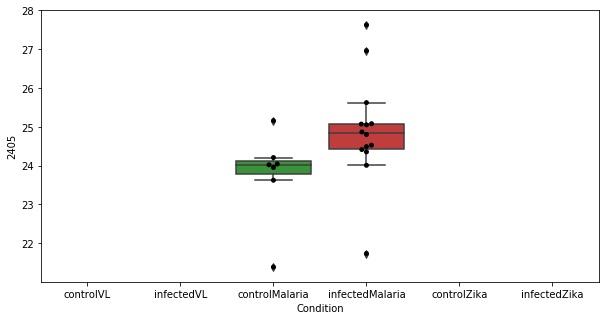

227 row m/z                 380.173
row retention time      7.00179
p-val                 0.0600095
adj.P.Val              0.512976
custom_id                  2472
compound_names              NaN
Name: 2472, dtype: object


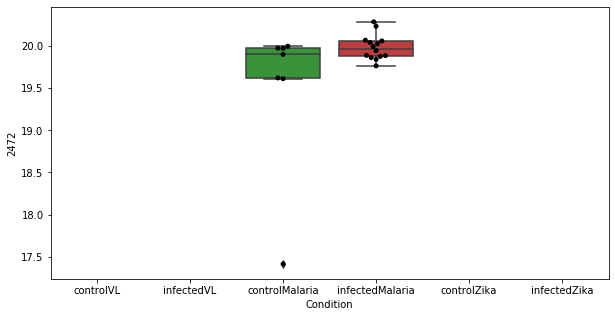

228 row m/z                                                         180.102
row retention time                                              4.51944
p-val                                                         0.0604074
adj.P.Val                                                      0.513577
custom_id                                                          1184
compound_names        (-)-Salsolinol; 6,7-Isoquinolinediol, 1,2,3,4-...
Name: 1184, dtype: object


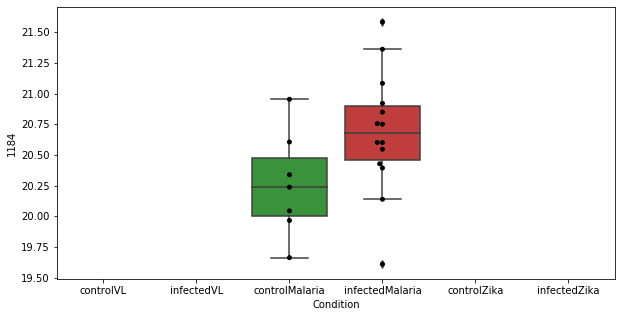

229 row m/z                 297.085
row retention time      23.8921
p-val                 0.0606068
adj.P.Val              0.513577
custom_id                  2239
compound_names              NaN
Name: 2239, dtype: object


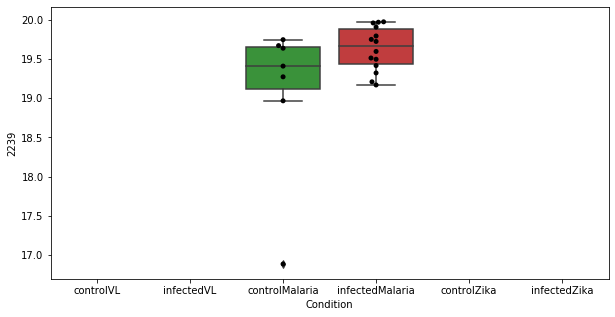

230 row m/z                                        122.096
row retention time                             4.39364
p-val                                        0.0625849
adj.P.Val                                     0.524883
custom_id                                          397
compound_names        (-)-Salsoline$N-methylsalsolinol
Name: 397, dtype: object


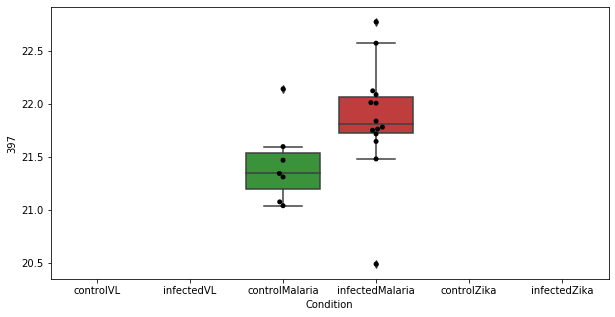

231 row m/z                                                         159.092
row retention time                                              10.3483
p-val                                                         0.0626528
adj.P.Val                                                      0.524883
custom_id                                                           913
compound_names        3-(2-Aminoethyl)-1H-indol-5-ol; Serotonin; 5-H...
Name: 913, dtype: object


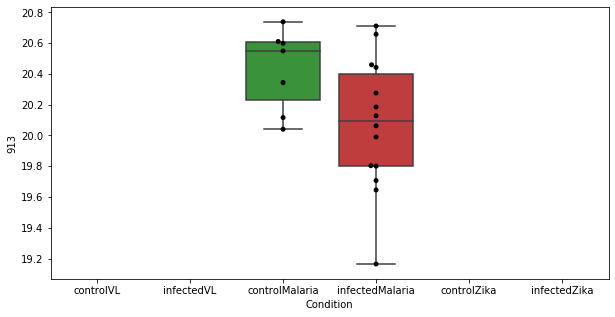

232 row m/z                 544.34
row retention time     4.01734
p-val                 0.062749
adj.P.Val             0.524883
custom_id                 2684
compound_names             NaN
Name: 2684, dtype: object


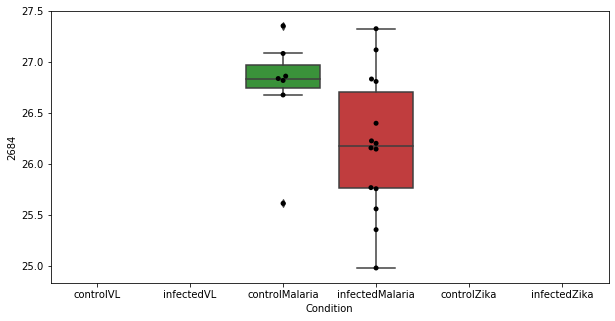

233 row m/z                 191.164
row retention time      23.2524
p-val                 0.0635741
adj.P.Val              0.527704
custom_id                  1332
compound_names              NaN
Name: 1332, dtype: object


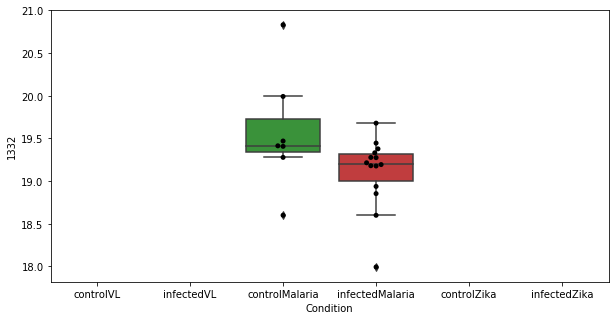

234 row m/z                 236.073
row retention time      4.82189
p-val                 0.0639971
adj.P.Val              0.527704
custom_id                  1779
compound_names              NaN
Name: 1779, dtype: object


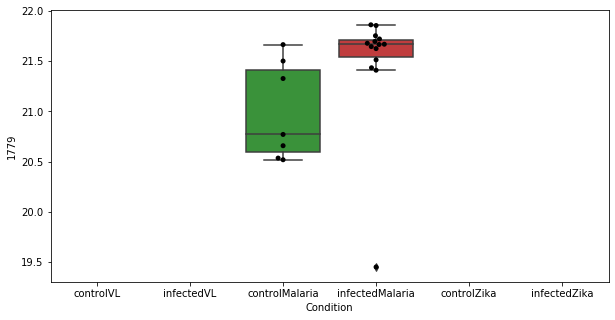

235 row m/z                 127.073
row retention time       2.1895
p-val                 0.0644237
adj.P.Val              0.527704
custom_id                   453
compound_names              NaN
Name: 453, dtype: object


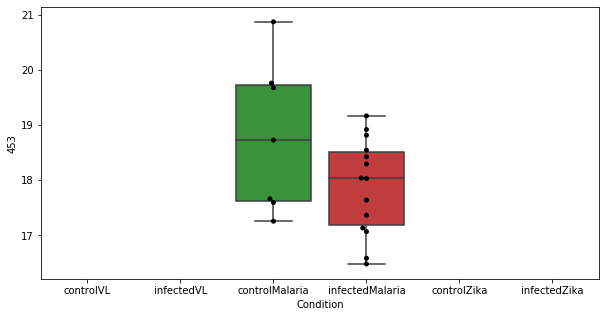

236 row m/z                340.041
row retention time     10.5911
p-val                 0.064432
adj.P.Val             0.527704
custom_id                 2399
compound_names             NaN
Name: 2399, dtype: object


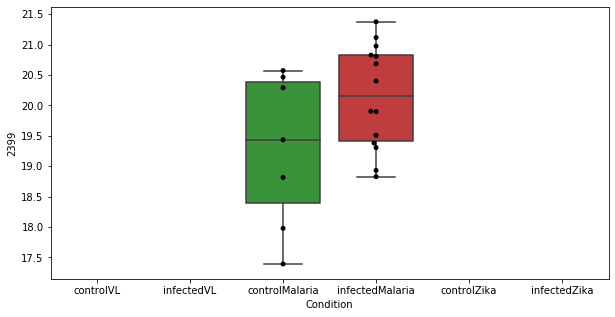

237 row m/z                132.965
row retention time     4.04193
p-val                  0.06444
adj.P.Val             0.527704
custom_id                 3269
compound_names             NaN
Name: 3269, dtype: object


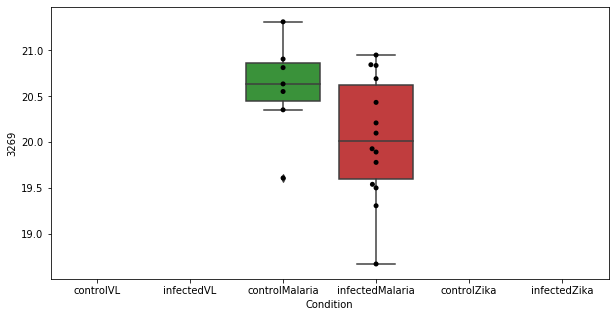

238 row m/z                 202.144
row retention time      3.89789
p-val                 0.0648608
adj.P.Val              0.528928
custom_id                  1453
compound_names              NaN
Name: 1453, dtype: object


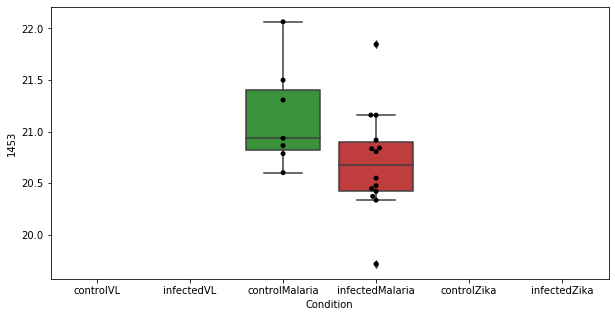

239 row m/z                 105.074
row retention time      5.37564
p-val                 0.0652389
adj.P.Val              0.529794
custom_id                  3108
compound_names              NaN
Name: 3108, dtype: object


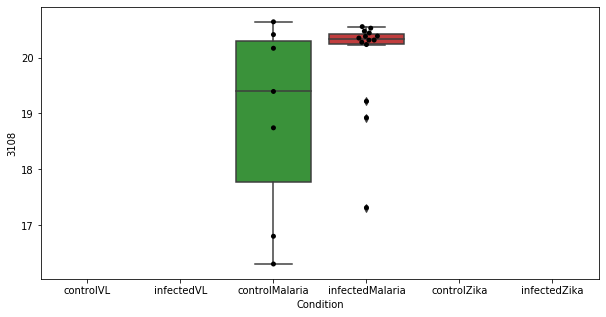

240 row m/z                 690.562
row retention time      3.78738
p-val                 0.0662165
adj.P.Val              0.535502
custom_id                  2817
compound_names              NaN
Name: 2817, dtype: object


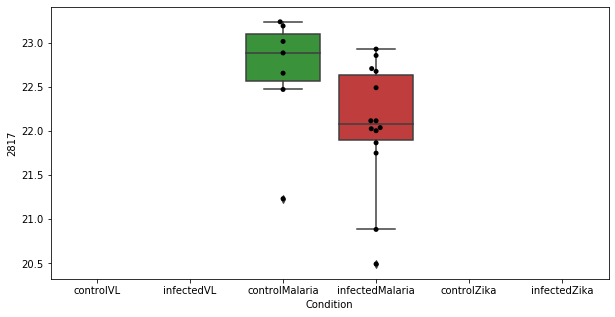

241 row m/z                 585.271
row retention time       3.4846
p-val                 0.0668687
adj.P.Val              0.538542
custom_id                  4232
compound_names        Bilirubin
Name: 4232, dtype: object


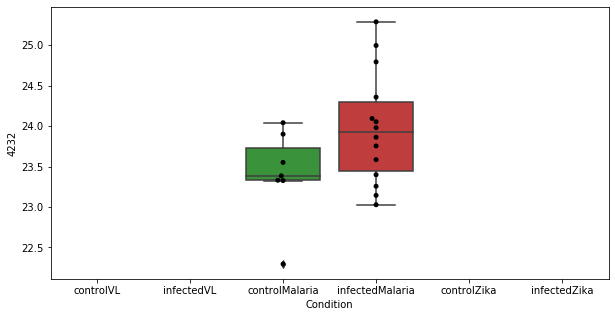

242 row m/z                               190.086
row retention time                    7.00328
p-val                                0.067634
adj.P.Val                            0.538904
custom_id                                1311
compound_names        methyl indole-3-acetate
Name: 1311, dtype: object


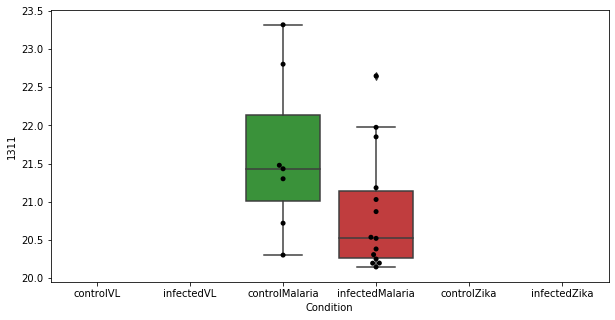

243 row m/z                 230.139
row retention time      4.38548
p-val                 0.0677194
adj.P.Val              0.538904
custom_id                  4975
compound_names              NaN
Name: 4975, dtype: object


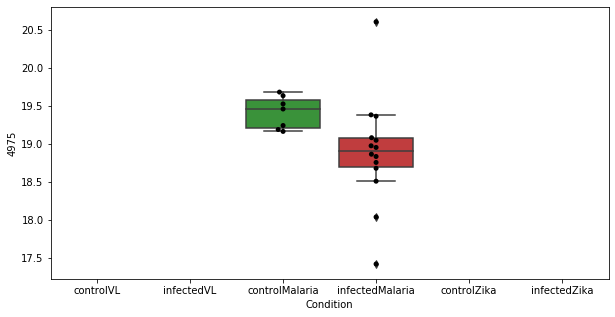

244 row m/z                 229.141
row retention time      6.71568
p-val                 0.0683499
adj.P.Val              0.538904
custom_id                  1715
compound_names              NaN
Name: 1715, dtype: object


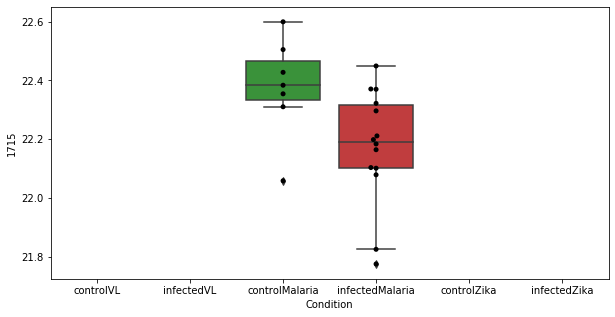

245 row m/z                380.173
row retention time     4.61548
p-val                 0.068567
adj.P.Val             0.538904
custom_id                 2473
compound_names             NaN
Name: 2473, dtype: object


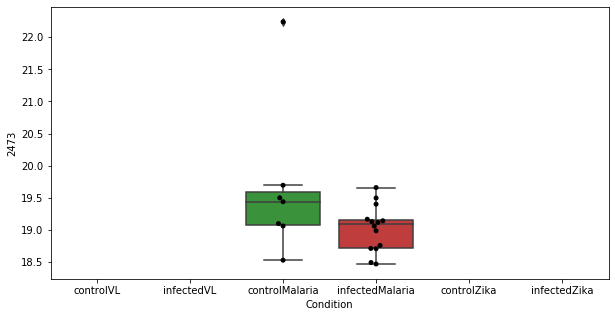

246 row m/z                303.024
row retention time     10.7895
p-val                 0.068629
adj.P.Val             0.538904
custom_id                 4038
compound_names             NaN
Name: 4038, dtype: object


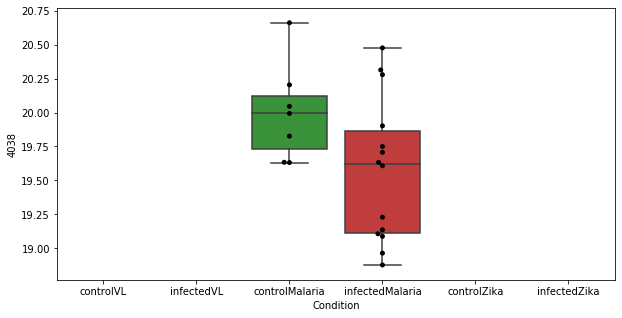

247 row m/z                 257.153
row retention time       10.692
p-val                 0.0687696
adj.P.Val              0.538904
custom_id                  1965
compound_names              NaN
Name: 1965, dtype: object


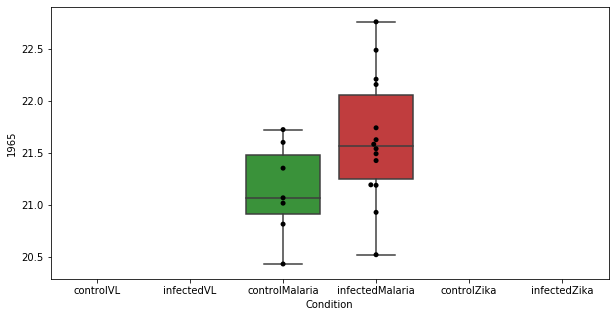

248 row m/z                 518.322
row retention time      4.14768
p-val                 0.0688493
adj.P.Val              0.538904
custom_id                  2641
compound_names              NaN
Name: 2641, dtype: object


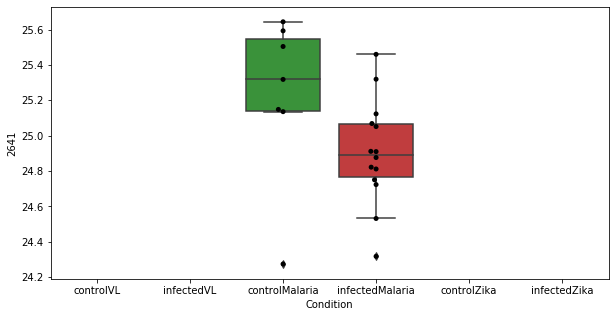

249 row m/z                 147.998
row retention time      23.8201
p-val                 0.0693589
adj.P.Val              0.540445
custom_id                   772
compound_names              NaN
Name: 772, dtype: object


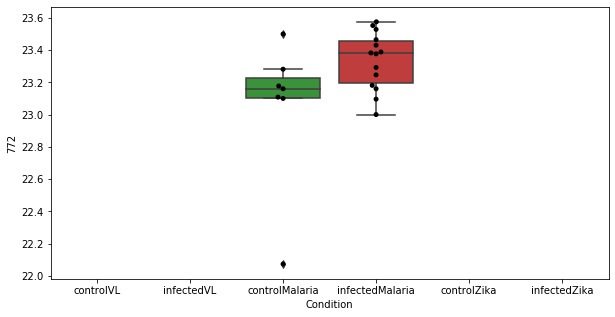

250 row m/z                 497.343
row retention time      6.96503
p-val                 0.0696006
adj.P.Val              0.540445
custom_id                  4195
compound_names              NaN
Name: 4195, dtype: object


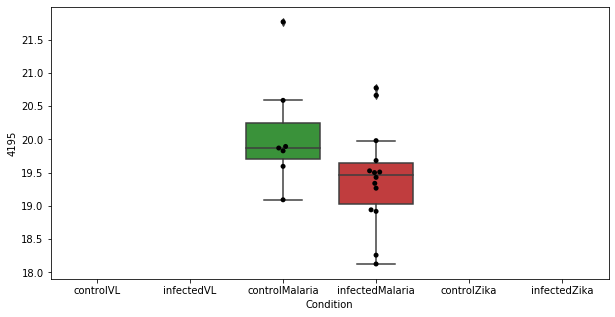

251 row m/z                 244.191
row retention time      23.3865
p-val                 0.0698983
adj.P.Val              0.540602
custom_id                  1865
compound_names              NaN
Name: 1865, dtype: object


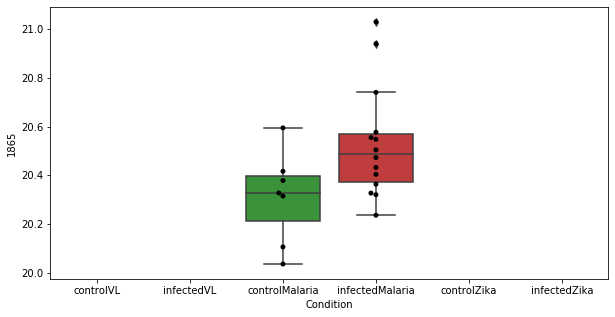

252 row m/z                  804.55
row retention time      4.48546
p-val                 0.0705343
adj.P.Val              0.543173
custom_id                  2936
compound_names              NaN
Name: 2936, dtype: object


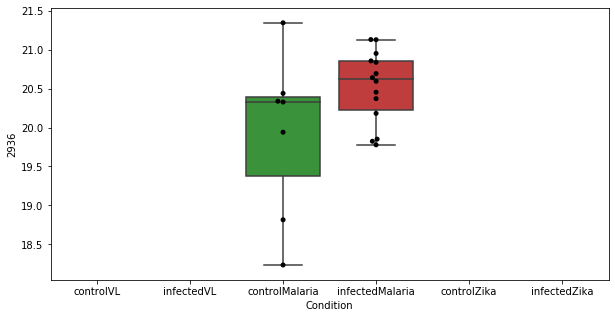

253 row m/z                 327.174
row retention time      3.72546
p-val                 0.0708221
adj.P.Val              0.543173
custom_id                  2366
compound_names              NaN
Name: 2366, dtype: object


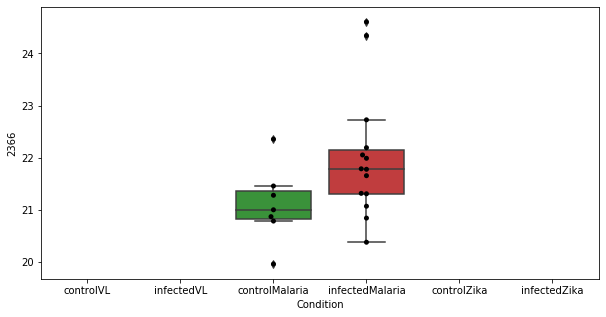

254 row m/z                 297.057
row retention time      14.0923
p-val                 0.0715023
adj.P.Val              0.543173
custom_id                  4020
compound_names              NaN
Name: 4020, dtype: object


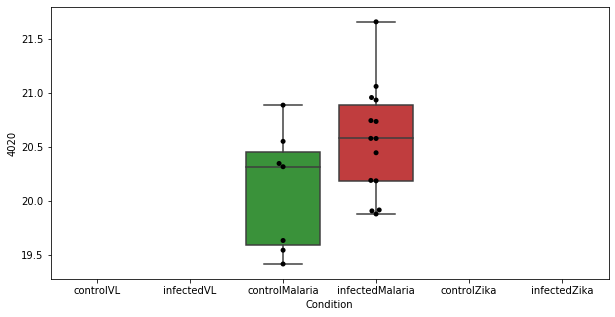

255 row m/z                 159.113
row retention time      7.06868
p-val                 0.0720663
adj.P.Val              0.543173
custom_id                   918
compound_names              NaN
Name: 918, dtype: object


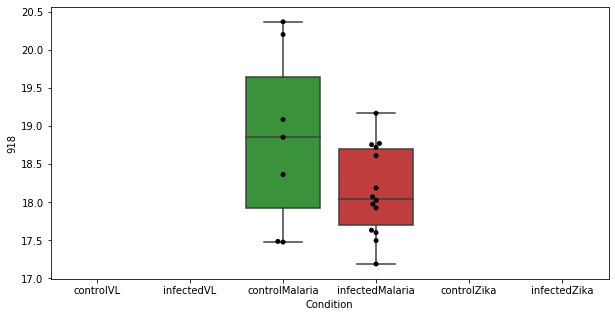

256 row m/z                 120.972
row retention time      10.5188
p-val                 0.0720813
adj.P.Val              0.543173
custom_id                   386
compound_names              NaN
Name: 386, dtype: object


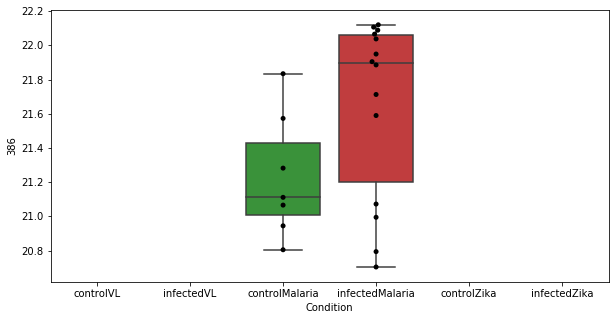

257 row m/z                 292.908
row retention time      13.7713
p-val                 0.0722867
adj.P.Val              0.543173
custom_id                  2223
compound_names              NaN
Name: 2223, dtype: object


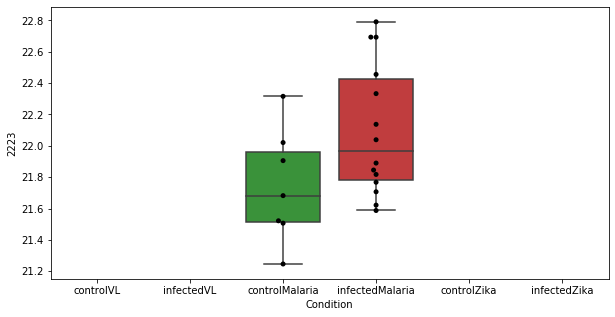

258 row m/z                 652.733
row retention time      9.26684
p-val                 0.0724113
adj.P.Val              0.543173
custom_id                  2788
compound_names              NaN
Name: 2788, dtype: object


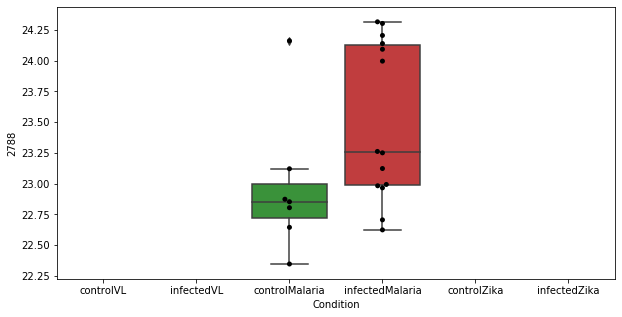

259 row m/z                 394.189
row retention time      4.60829
p-val                 0.0724602
adj.P.Val              0.543173
custom_id                  2510
compound_names              NaN
Name: 2510, dtype: object


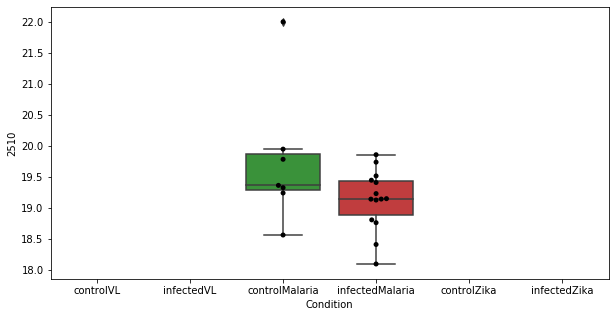

260 row m/z                249.185
row retention time     23.0879
p-val                 0.073375
adj.P.Val               0.5462
custom_id                 5025
compound_names             NaN
Name: 5025, dtype: object


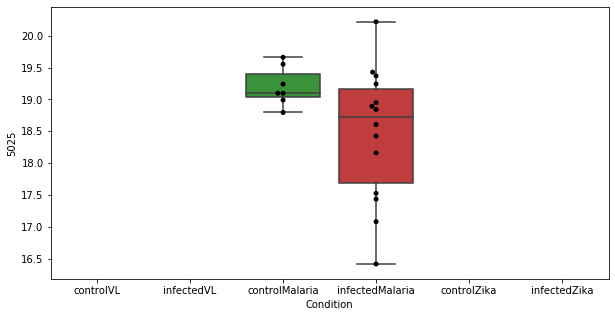

261 row m/z                 706.537
row retention time      3.57655
p-val                 0.0736604
adj.P.Val                0.5462
custom_id                  2829
compound_names              NaN
Name: 2829, dtype: object


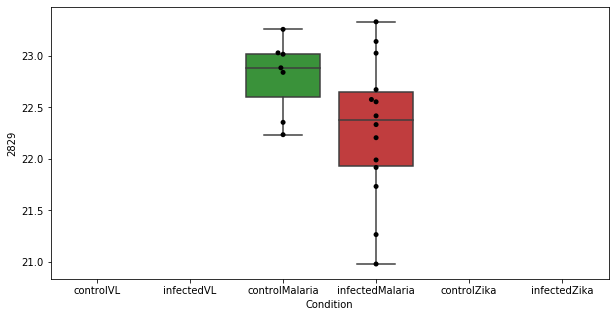

262 row m/z                 234.015
row retention time      10.1494
p-val                 0.0740924
adj.P.Val                0.5462
custom_id                  3770
compound_names              NaN
Name: 3770, dtype: object


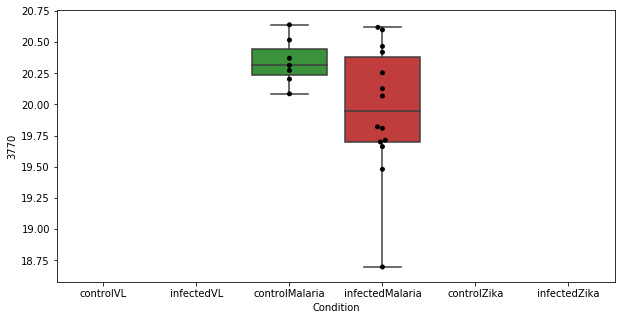

263 row m/z                 96.0556
row retention time      23.1814
p-val                 0.0741196
adj.P.Val                0.5462
custom_id                  6338
compound_names              NaN
Name: 6338, dtype: object


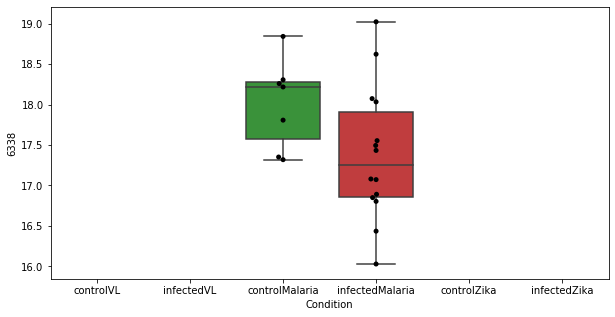

264 row m/z                 132.725
row retention time      3.43023
p-val                 0.0750269
adj.P.Val                0.5462
custom_id                   561
compound_names              NaN
Name: 561, dtype: object


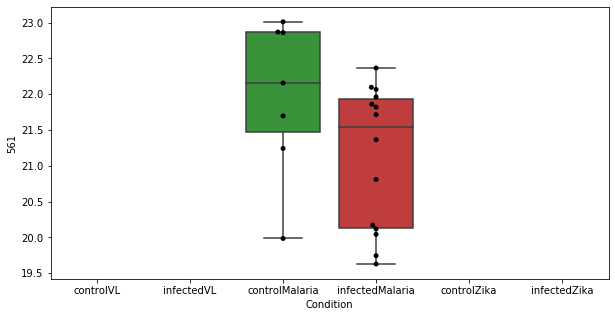

265 row m/z                                                         115.087
row retention time                                              5.88036
p-val                                                         0.0751825
adj.P.Val                                                        0.5462
custom_id                                                           309
compound_names        L-Ornithine; (S)-2,5-Diaminovaleric acid; (S)-...
Name: 309, dtype: object


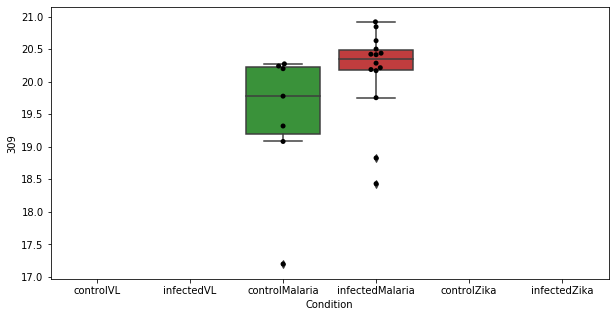

266 row m/z                                                           86.06
row retention time                                              8.60872
p-val                                                         0.0753077
adj.P.Val                                                        0.5462
custom_id                                                          3037
compound_names        5-Aminolevulinate; 5-Amino-4-oxopentanoate; 5-...
Name: 3037, dtype: object


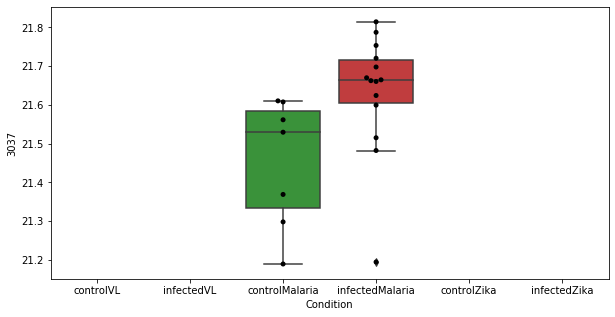

267 row m/z                 694.847
row retention time       13.078
p-val                 0.0757974
adj.P.Val                0.5462
custom_id                  2818
compound_names              NaN
Name: 2818, dtype: object


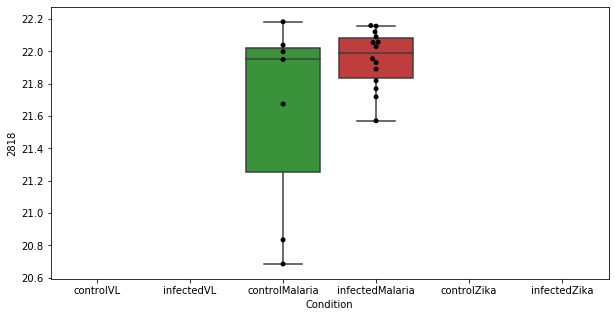

268 row m/z                 153.958
row retention time      15.1846
p-val                 0.0759965
adj.P.Val                0.5462
custom_id                   850
compound_names              NaN
Name: 850, dtype: object


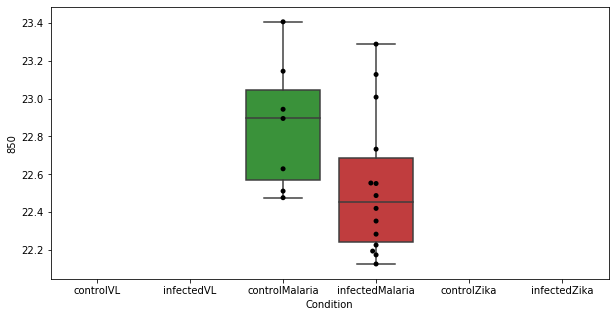

269 row m/z                                                         391.284
row retention time                                              9.49312
p-val                                                         0.0764107
adj.P.Val                                                        0.5462
custom_id                                                          2500
compound_names        3alpha,7alpha,12alpha-Trihydroxy-5beta-cholana...
Name: 2500, dtype: object


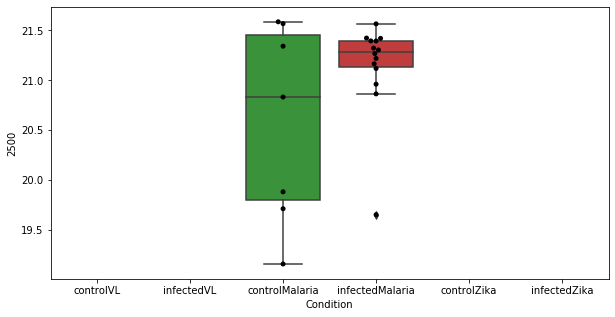

270 row m/z                 854.574
row retention time      3.28435
p-val                 0.0766093
adj.P.Val                0.5462
custom_id                  2972
compound_names              NaN
Name: 2972, dtype: object


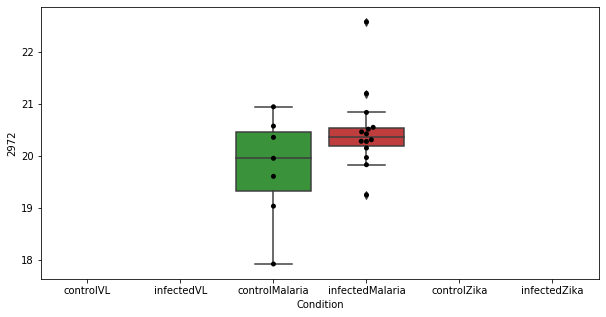

271 row m/z                                                          139.05
row retention time                                              8.51576
p-val                                                         0.0768573
adj.P.Val                                                        0.5462
custom_id                                                           630
compound_names        L-Histidine; (S)-alpha-Amino-1H-imidazole-4-pr...
Name: 630, dtype: object


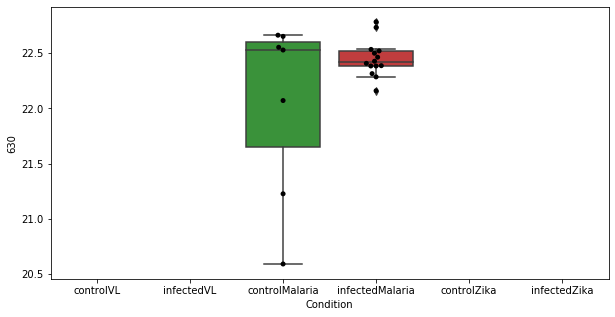

272 row m/z                 1015.67
row retention time      4.10498
p-val                 0.0770073
adj.P.Val                0.5462
custom_id                  2986
compound_names              NaN
Name: 2986, dtype: object


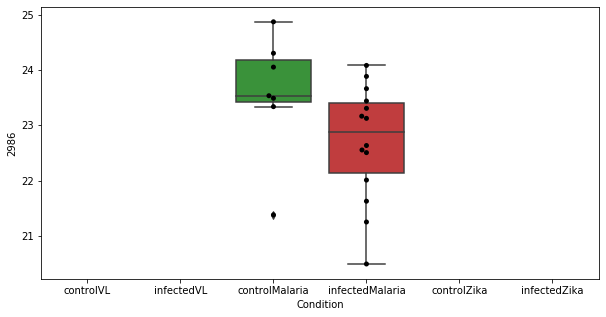

273 row m/z                                                        174.113
row retention time                                             4.57766
p-val                                                        0.0772853
adj.P.Val                                                       0.5462
custom_id                                                         1120
compound_names        Pantothenate; Pantothenic acid; (R)-Pantothenate
Name: 1120, dtype: object


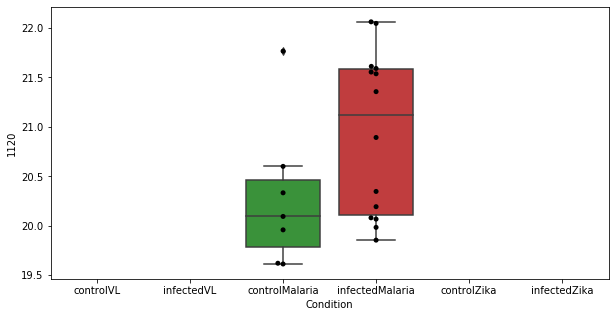

274 row m/z                 405.199
row retention time      12.4299
p-val                 0.0774306
adj.P.Val                0.5462
custom_id                  4180
compound_names              NaN
Name: 4180, dtype: object


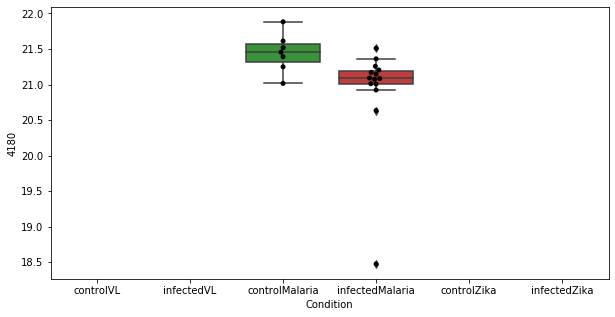

275 row m/z                 106.972
row retention time       23.745
p-val                 0.0774628
adj.P.Val                0.5462
custom_id                   209
compound_names              NaN
Name: 209, dtype: object


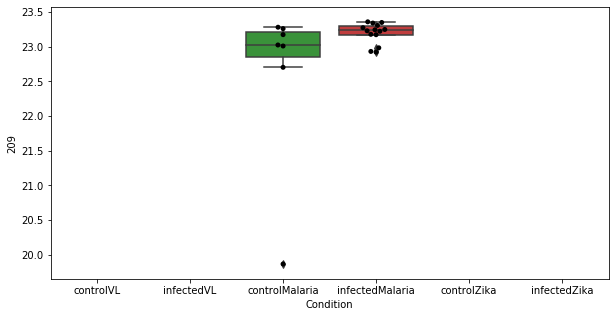

276 row m/z                 143.154
row retention time      2.95146
p-val                 0.0776827
adj.P.Val                0.5462
custom_id                   687
compound_names              NaN
Name: 687, dtype: object


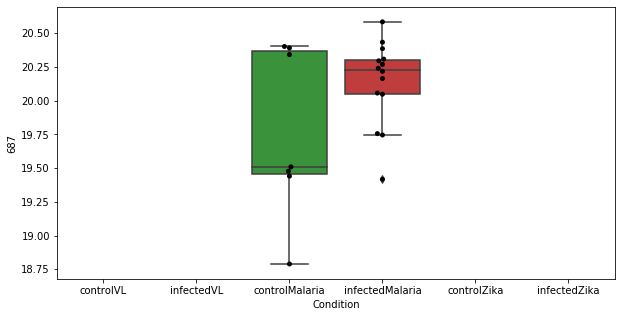

277 row m/z                  276.66
row retention time      23.2202
p-val                 0.0779085
adj.P.Val                0.5462
custom_id                  7528
compound_names              NaN
Name: 7528, dtype: object


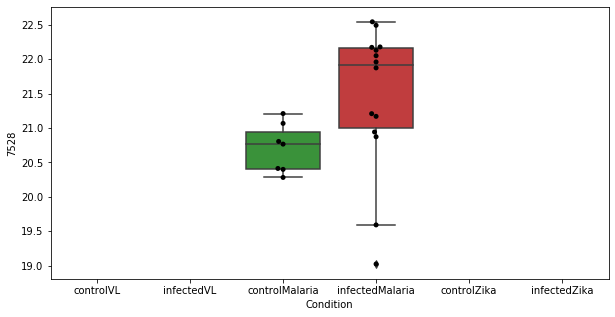

278 row m/z                80.0494
row retention time     3.88847
p-val                 0.078849
adj.P.Val             0.550812
custom_id                   39
compound_names             NaN
Name: 39, dtype: object


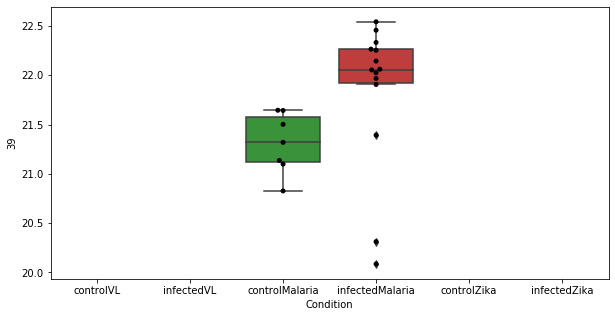

279 row m/z                 162.058
row retention time      8.24123
p-val                 0.0797517
adj.P.Val              0.555129
custom_id                  5675
compound_names              NaN
Name: 5675, dtype: object


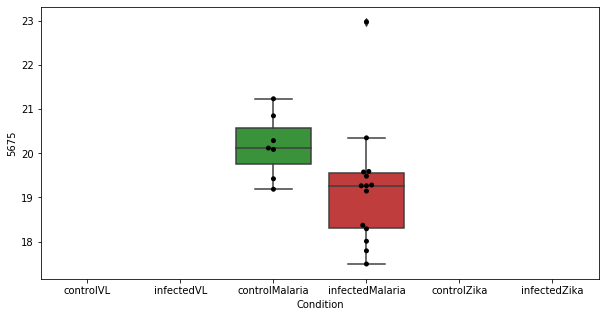

280 row m/z                                                         141.066
row retention time                                              8.79215
p-val                                                         0.0812911
adj.P.Val                                                      0.560942
custom_id                                                           653
compound_names        Methylimidazoleacetic acid; Tele-methylimidazo...
Name: 653, dtype: object


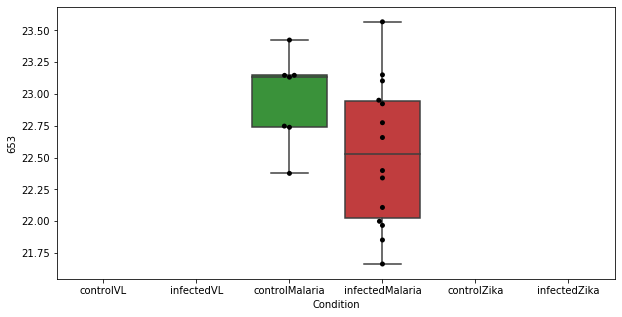

281 row m/z                 785.651
row retention time      6.60397
p-val                 0.0815735
adj.P.Val              0.560942
custom_id                  2910
compound_names              NaN
Name: 2910, dtype: object


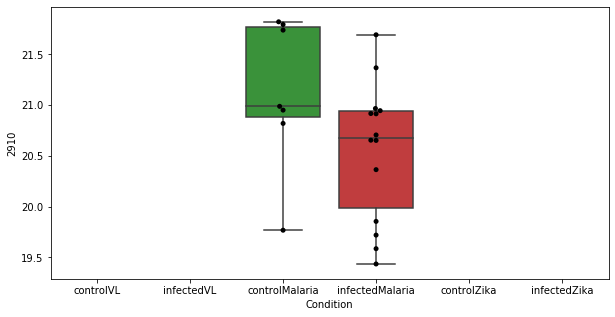

282 row m/z                 176.074
row retention time      4.45874
p-val                 0.0819153
adj.P.Val              0.560942
custom_id                  1142
compound_names              NaN
Name: 1142, dtype: object


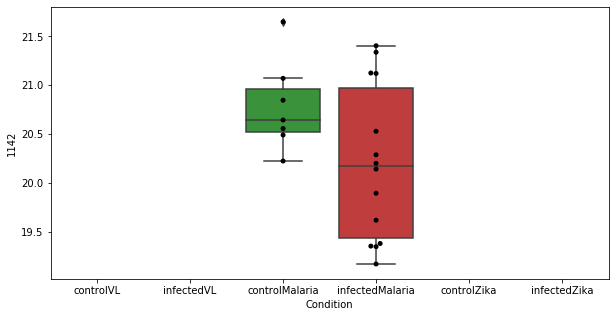

283 row m/z                 257.149
row retention time      23.6497
p-val                 0.0821172
adj.P.Val              0.560942
custom_id                  3874
compound_names              NaN
Name: 3874, dtype: object


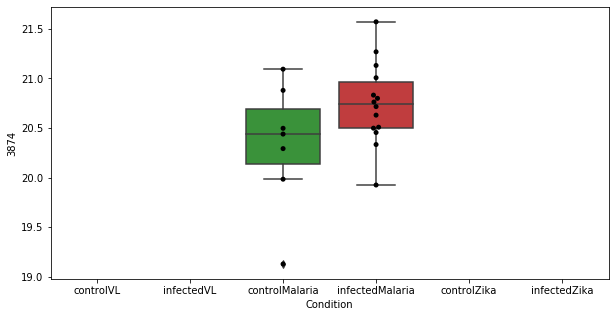

284 row m/z                          131.118
row retention time               7.02739
p-val                          0.0823626
adj.P.Val                       0.560942
custom_id                            537
compound_names        N-Acetylputrescine
Name: 537, dtype: object


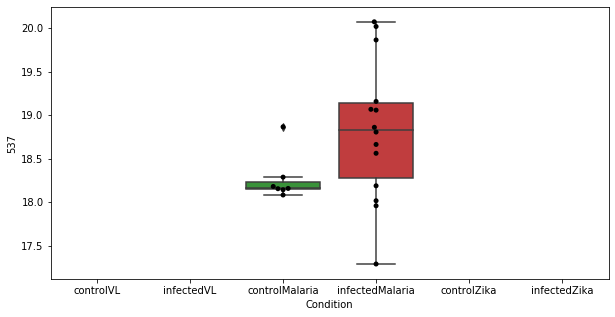

285 row m/z                 157.122
row retention time      3.89789
p-val                 0.0824614
adj.P.Val              0.560942
custom_id                   889
compound_names                $
Name: 889, dtype: object


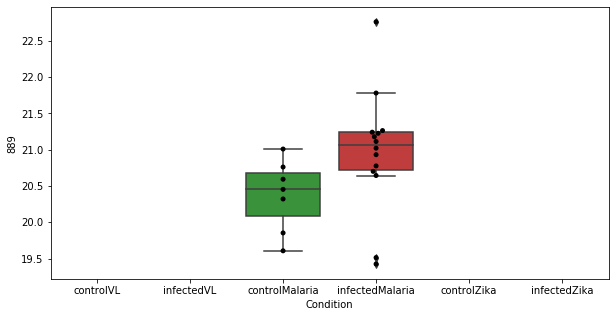

286 row m/z                 659.834
row retention time      9.22746
p-val                 0.0826015
adj.P.Val              0.560942
custom_id                  2794
compound_names              NaN
Name: 2794, dtype: object


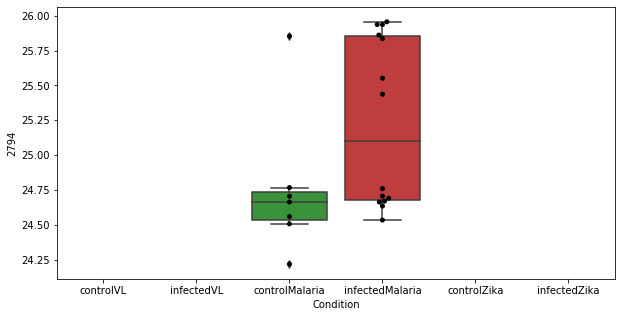

287 row m/z                 244.154
row retention time      7.52161
p-val                 0.0829233
adj.P.Val              0.561172
custom_id                  1862
compound_names              NaN
Name: 1862, dtype: object


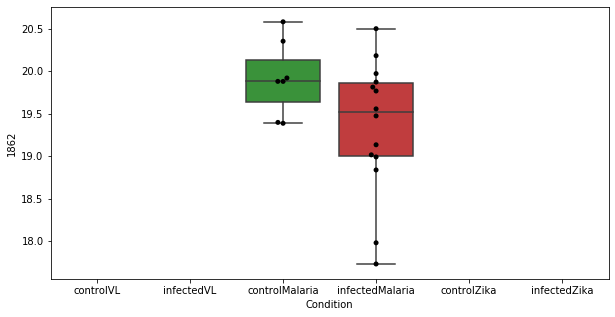

288 row m/z                 802.687
row retention time      4.35013
p-val                 0.0836035
adj.P.Val              0.563818
custom_id                  4296
compound_names              NaN
Name: 4296, dtype: object


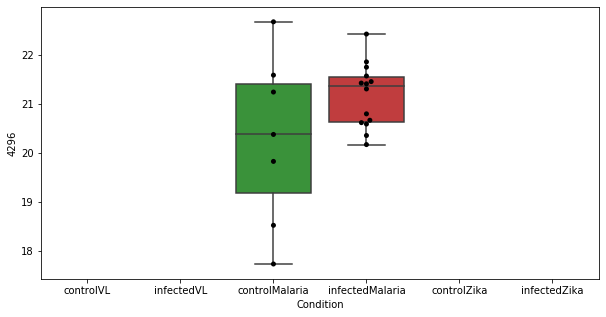

289 row m/z                                                         114.055
row retention time                                                4.497
p-val                                                         0.0846506
adj.P.Val                                                      0.567687
custom_id                                                           278
compound_names        1-Pyrroline-2-carboxylate; 1-Pyrroline-2-carbo...
Name: 278, dtype: object


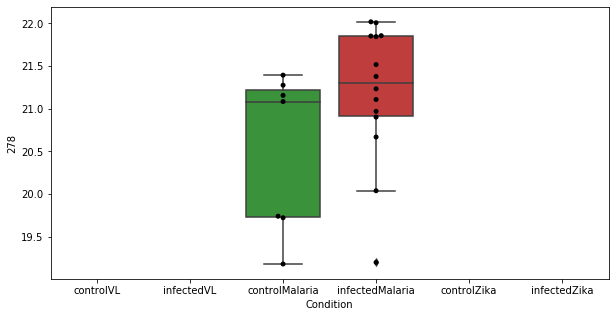

290 row m/z                 178.903
row retention time        15.17
p-val                 0.0847599
adj.P.Val              0.567687
custom_id                  1157
compound_names              NaN
Name: 1157, dtype: object


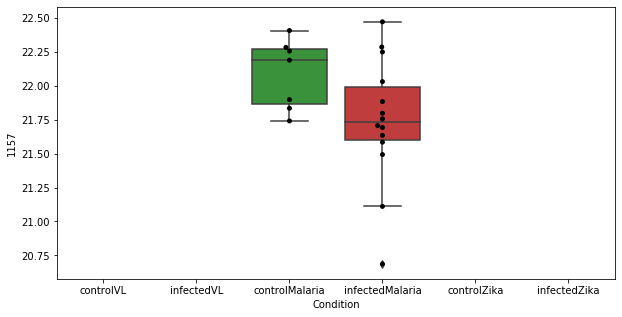

291 row m/z                 227.139
row retention time      4.59114
p-val                 0.0855724
adj.P.Val              0.571166
custom_id                  1686
compound_names              NaN
Name: 1686, dtype: object


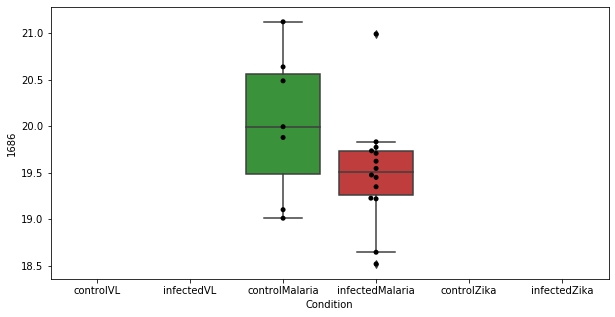

292 row m/z                 577.469
row retention time       3.3663
p-val                 0.0871187
adj.P.Val              0.579503
custom_id                  2726
compound_names              NaN
Name: 2726, dtype: object


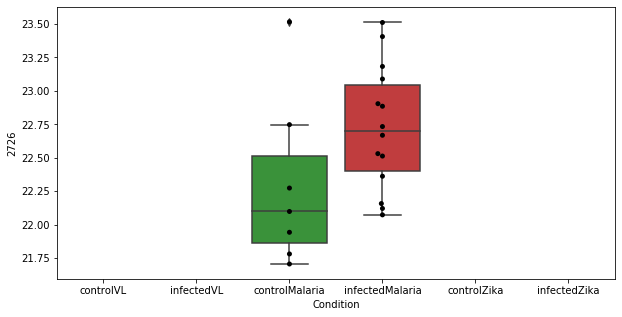

293 row m/z                                                   150.091
row retention time                                        4.23196
p-val                                                   0.0881269
adj.P.Val                                                0.584215
custom_id                                                     815
compound_names        3-Methoxytyramine$Epinine; Deoxyepinephrine
Name: 815, dtype: object


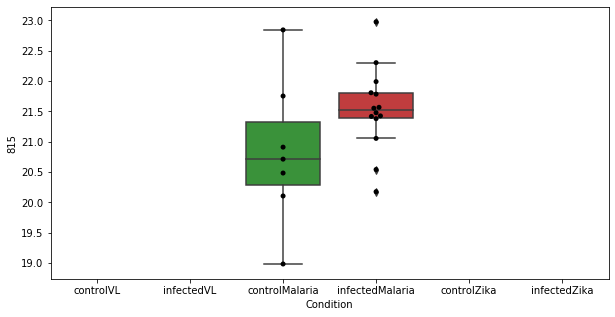

294 row m/z                255.101
row retention time     3.94373
p-val                 0.088615
adj.P.Val             0.584248
custom_id                 1947
compound_names             NaN
Name: 1947, dtype: object


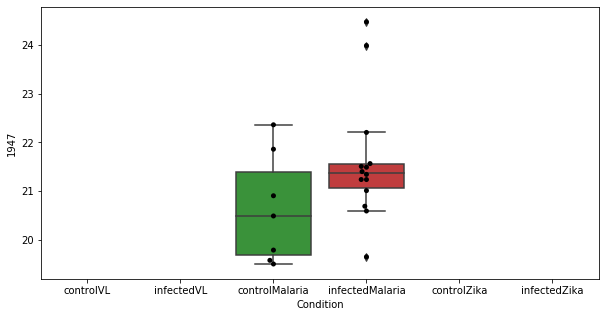

295 row m/z                 132.142
row retention time       9.6204
p-val                 0.0887313
adj.P.Val              0.584248
custom_id                   560
compound_names              NaN
Name: 560, dtype: object


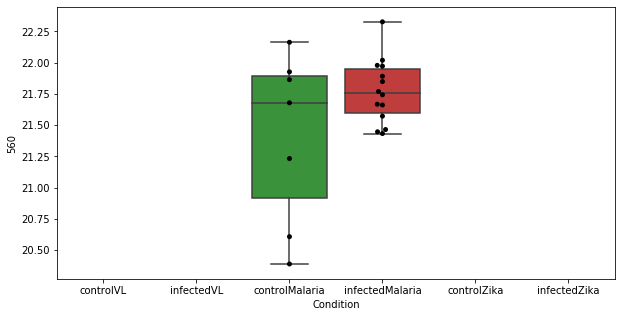

296 row m/z                  568.34
row retention time      3.96801
p-val                 0.0900253
adj.P.Val              0.590772
custom_id                  2714
compound_names              NaN
Name: 2714, dtype: object


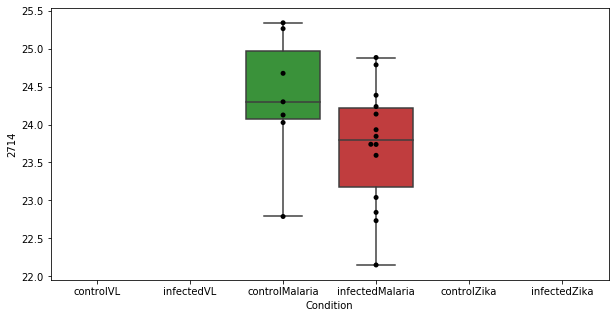

297 row m/z                332.895
row retention time     12.5154
p-val                 0.090364
adj.P.Val             0.591005
custom_id                 2389
compound_names             NaN
Name: 2389, dtype: object


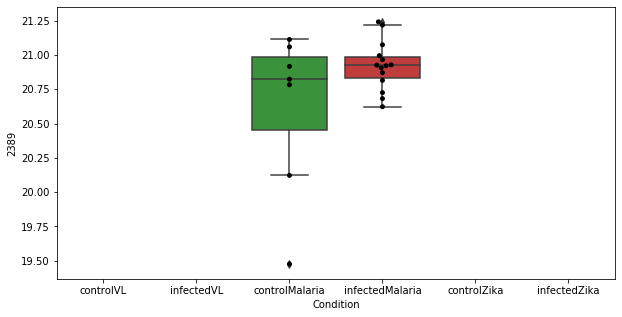

298 row m/z                215.094
row retention time     9.67292
p-val                 0.091352
adj.P.Val             0.595468
custom_id                 1587
compound_names             NaN
Name: 1587, dtype: object


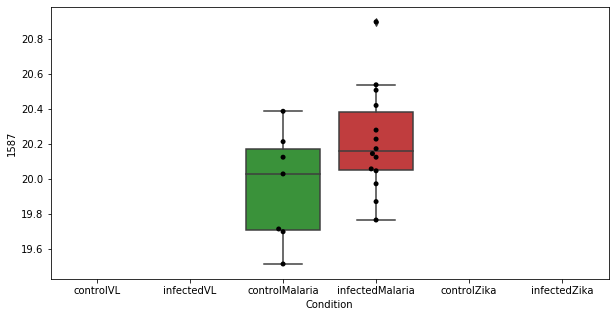

299 row m/z                 84.0637
row retention time      23.8813
p-val                 0.0924386
adj.P.Val              0.600543
custom_id                    57
compound_names              NaN
Name: 57, dtype: object


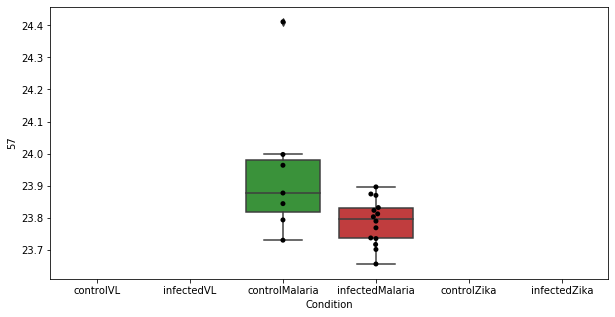

300 row m/z                 145.028
row retention time      23.1378
p-val                 0.0928688
adj.P.Val              0.601333
custom_id                   713
compound_names              NaN
Name: 713, dtype: object


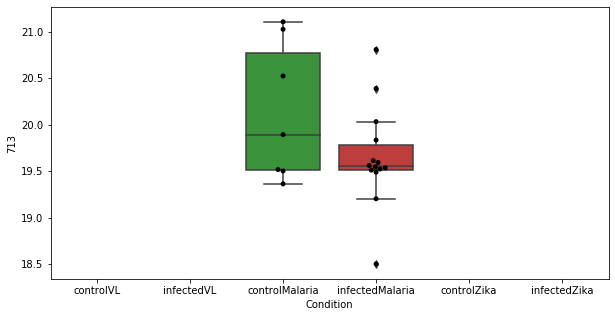

301 row m/z                                                         88.0757
row retention time                                              6.76219
p-val                                                         0.0942069
adj.P.Val                                                      0.606507
custom_id                                                            75
compound_names        4-Aminobutanal; 4-Aminobutyraldehyde; Butyrald...
Name: 75, dtype: object


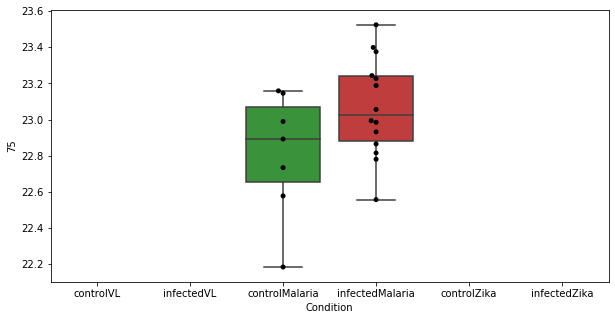

302 row m/z                 239.107
row retention time      3.88191
p-val                 0.0942901
adj.P.Val              0.606507
custom_id                  1814
compound_names              NaN
Name: 1814, dtype: object


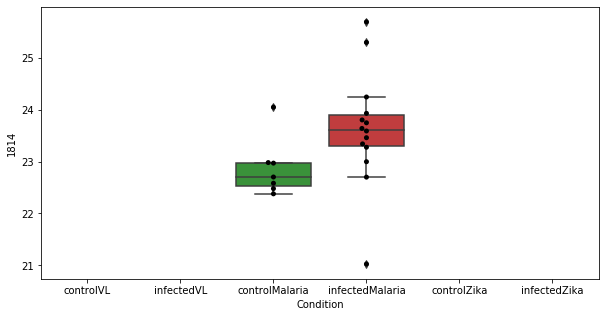

303 row m/z                 205.119
row retention time      9.48004
p-val                 0.0947875
adj.P.Val                0.6077
custom_id                  1479
compound_names              NaN
Name: 1479, dtype: object


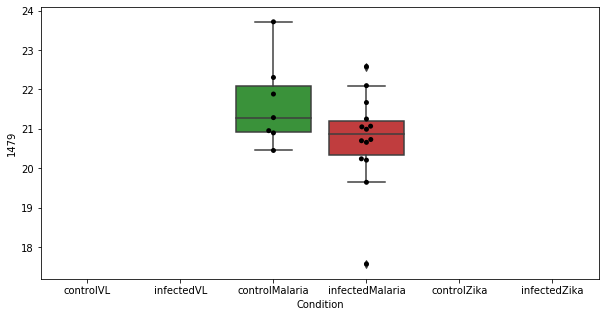

304 row m/z                 118.052
row retention time      9.93607
p-val                 0.0955362
adj.P.Val              0.610342
custom_id                   343
compound_names              NaN
Name: 343, dtype: object


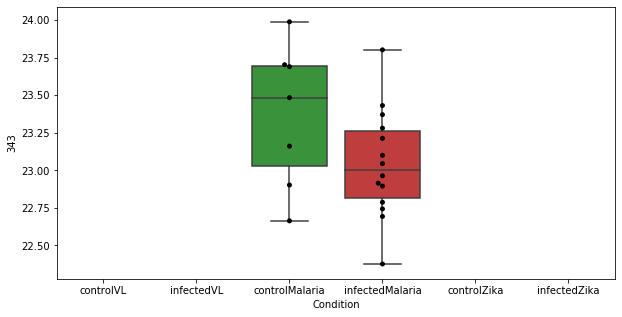

305 row m/z                 257.149
row retention time      4.48783
p-val                 0.0958259
adj.P.Val              0.610342
custom_id                  1960
compound_names              NaN
Name: 1960, dtype: object


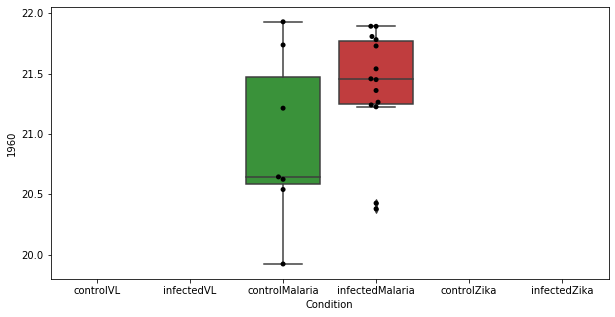

306 row m/z                 214.099
row retention time      4.81557
p-val                 0.0968243
adj.P.Val              0.611767
custom_id                  1579
compound_names              NaN
Name: 1579, dtype: object


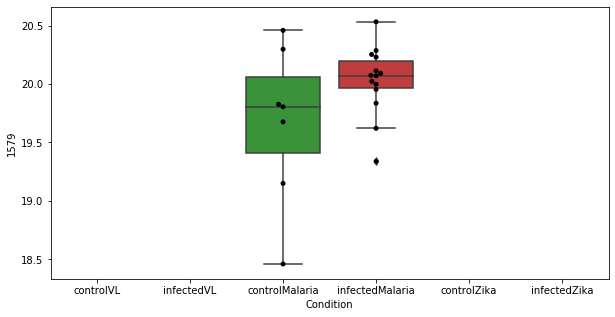

307 row m/z                                       288.253
row retention time                            22.9913
p-val                                       0.0968829
adj.P.Val                                    0.611767
custom_id                                        2202
compound_names        2,6 dimethylheptanoyl carnitine
Name: 2202, dtype: object


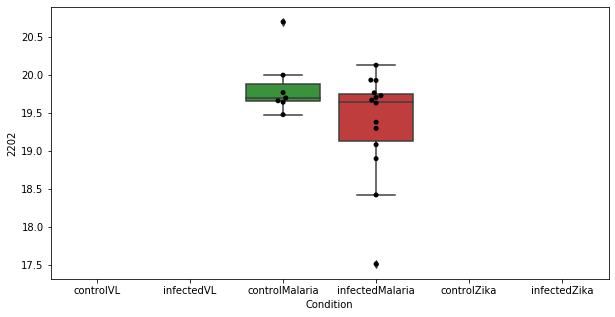

308 row m/z                 212.936
row retention time         23.7
p-val                 0.0972319
adj.P.Val              0.611767
custom_id                  1553
compound_names              NaN
Name: 1553, dtype: object


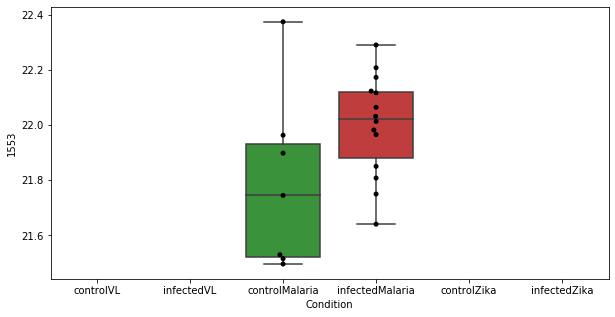

309 row m/z                 142.948
row retention time       12.861
p-val                 0.0973052
adj.P.Val              0.611767
custom_id                   678
compound_names              NaN
Name: 678, dtype: object


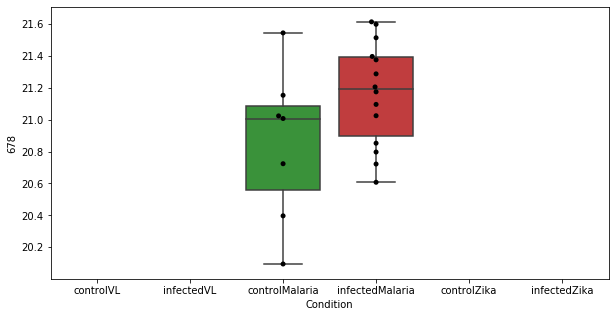

310 row m/z                  274.91
row retention time      23.2533
p-val                 0.0977643
adj.P.Val              0.612677
custom_id                  3935
compound_names              NaN
Name: 3935, dtype: object


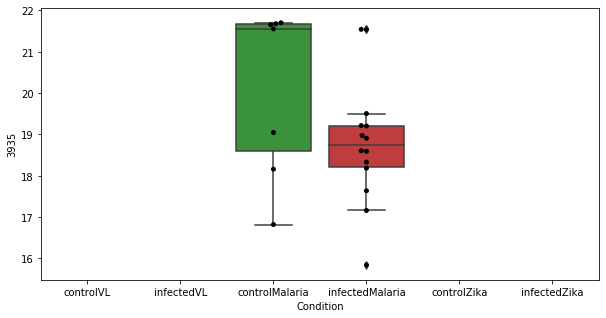

311 row m/z                  274.91
row retention time      2.81172
p-val                 0.0986104
adj.P.Val              0.615999
custom_id                  2076
compound_names              NaN
Name: 2076, dtype: object


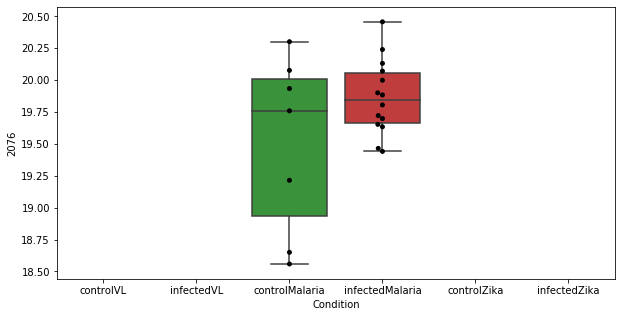

312 row m/z                 229.141
row retention time     0.368736
p-val                 0.0991389
adj.P.Val              0.617322
custom_id                  3757
compound_names              NaN
Name: 3757, dtype: object


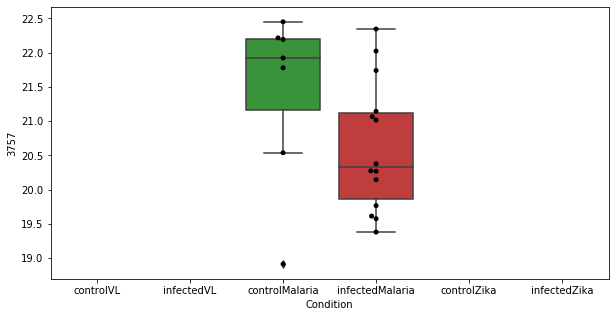

313 row m/z                                        194.118
row retention time                             9.51304
p-val                                        0.0994646
adj.P.Val                                     0.617378
custom_id                                         3601
compound_names        (-)-Salsoline$N-methylsalsolinol
Name: 3601, dtype: object


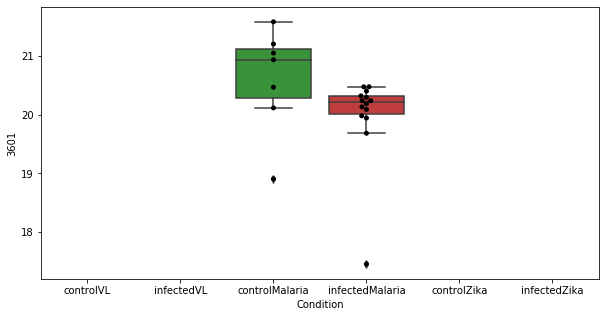

314 row m/z                                                          235.08
row retention time                                              10.5901
p-val                                                          0.100763
adj.P.Val                                                      0.621507
custom_id                                                          3778
compound_names        Nebularine; Purine riboside; N-D-Ribosylpurine...
Name: 3778, dtype: object


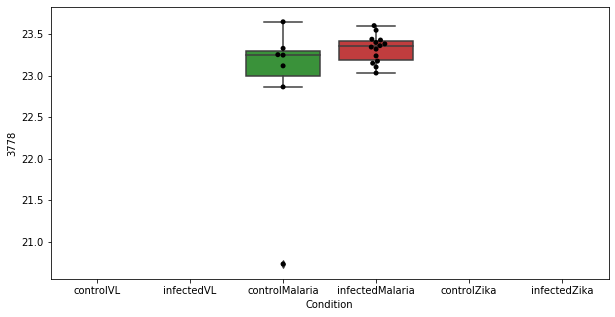

315 row m/z                168.067
row retention time     4.44365
p-val                 0.100768
adj.P.Val             0.621507
custom_id                 4735
compound_names             NaN
Name: 4735, dtype: object


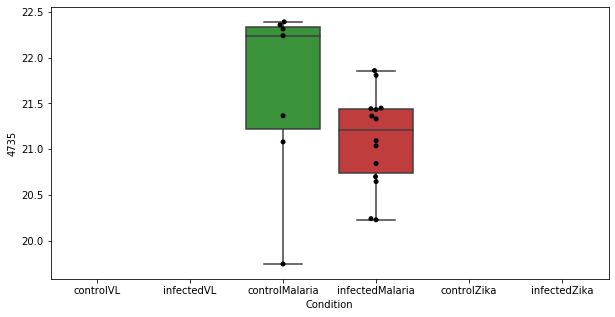

316 row m/z                291.163
row retention time     23.1558
p-val                 0.102126
adj.P.Val             0.627899
custom_id                 2215
compound_names             NaN
Name: 2215, dtype: object


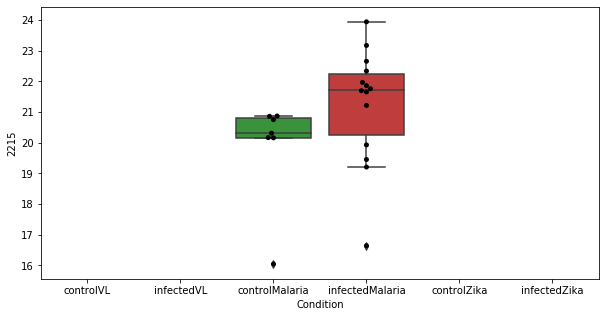

317 row m/z                239.923
row retention time     14.3701
p-val                 0.103242
adj.P.Val              0.63276
custom_id                 1826
compound_names             NaN
Name: 1826, dtype: object


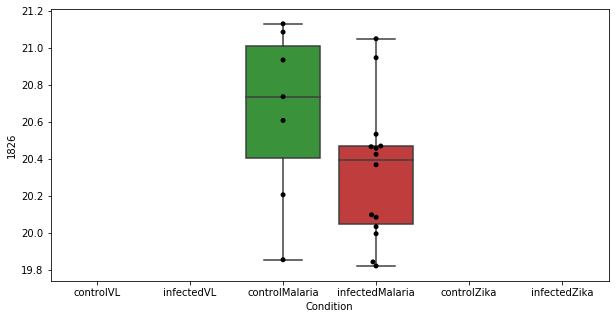

318 row m/z                136.048
row retention time     8.70352
p-val                 0.103717
adj.P.Val             0.633679
custom_id                 3283
compound_names             NaN
Name: 3283, dtype: object


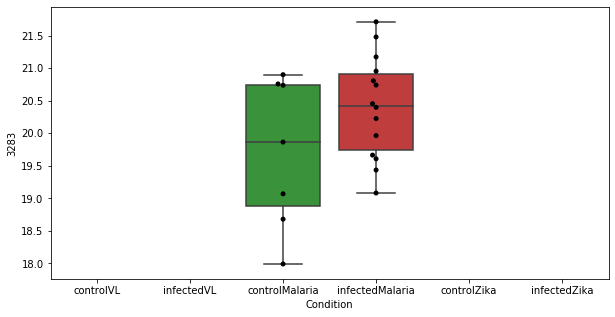

319 row m/z                545.343
row retention time     4.00963
p-val                 0.104124
adj.P.Val             0.634182
custom_id                 2686
compound_names             NaN
Name: 2686, dtype: object


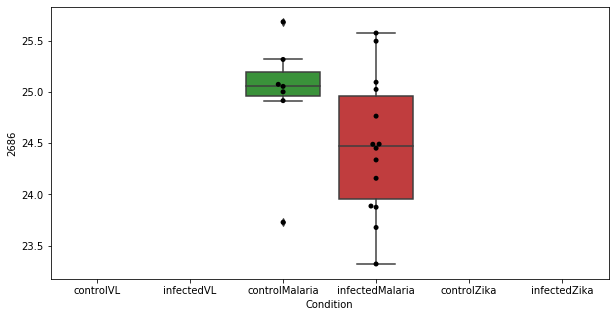

320 row m/z                                157.074
row retention time                      12.323
p-val                                 0.104897
adj.P.Val                             0.635162
custom_id                                 3407
compound_names        3-methylcrotonoylglycine
Name: 3407, dtype: object


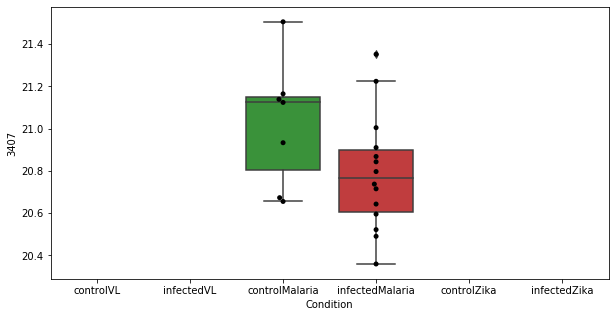

321 row m/z                                                         120.066
row retention time                                              5.32736
p-val                                                           0.10502
adj.P.Val                                                      0.635162
custom_id                                                          3187
compound_names        L-Allothreonine; L-allo-Threonine$L-Threonine;...
Name: 3187, dtype: object


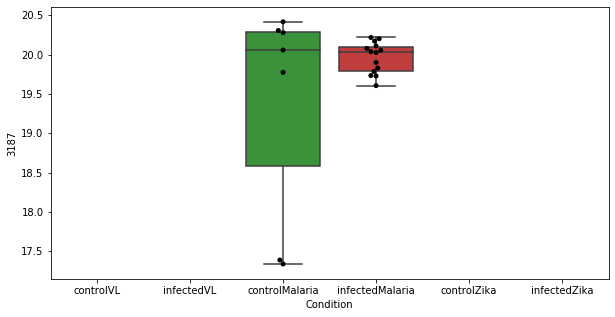

322 row m/z                100.087
row retention time     23.7714
p-val                 0.105263
adj.P.Val             0.635162
custom_id                  119
compound_names             NaN
Name: 119, dtype: object


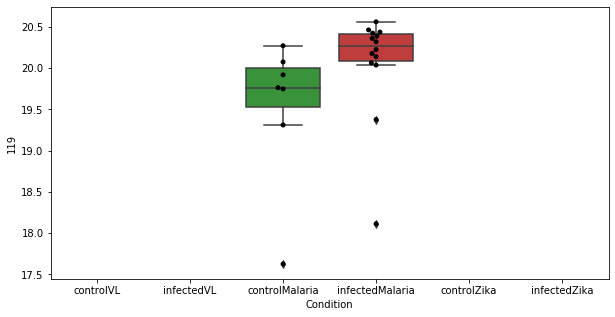

323 row m/z                327.008
row retention time     10.6641
p-val                 0.106101
adj.P.Val              0.63823
custom_id                 2362
compound_names             NaN
Name: 2362, dtype: object


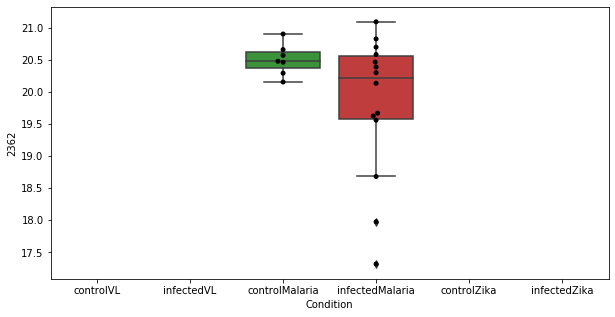

324 row m/z                745.592
row retention time     3.54763
p-val                 0.106587
adj.P.Val              0.63823
custom_id                 2855
compound_names             NaN
Name: 2855, dtype: object


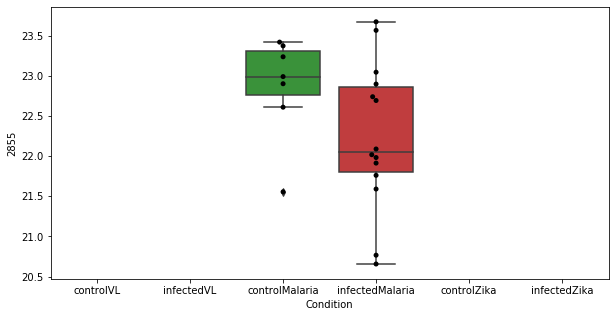

325 row m/z                519.326
row retention time     4.16057
p-val                 0.106754
adj.P.Val              0.63823
custom_id                 2642
compound_names             NaN
Name: 2642, dtype: object


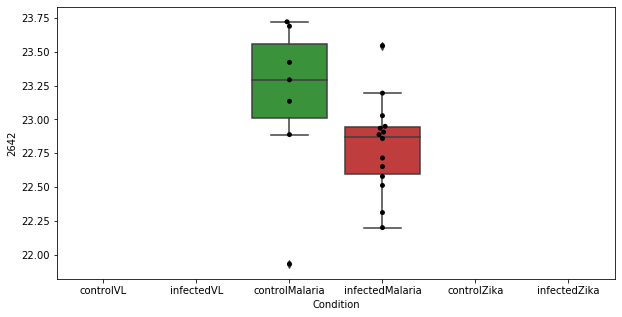

326 row m/z                403.232
row retention time     6.60124
p-val                 0.108561
adj.P.Val             0.647047
custom_id                 2528
compound_names             NaN
Name: 2528, dtype: object


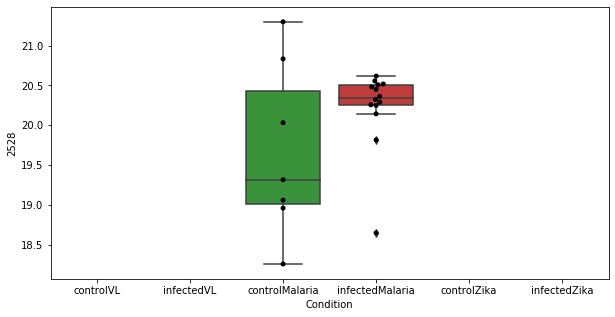

327 row m/z                120.972
row retention time     4.85275
p-val                 0.109553
adj.P.Val             0.647437
custom_id                  385
compound_names             NaN
Name: 385, dtype: object


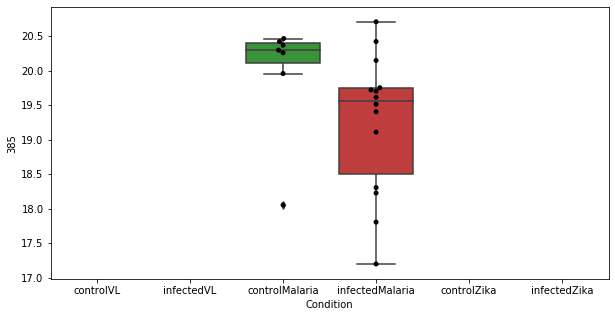

328 row m/z                    70.065
row retention time        19.1044
p-val                    0.109915
adj.P.Val                0.647437
custom_id                       2
compound_names        1-pyrroline
Name: 2, dtype: object


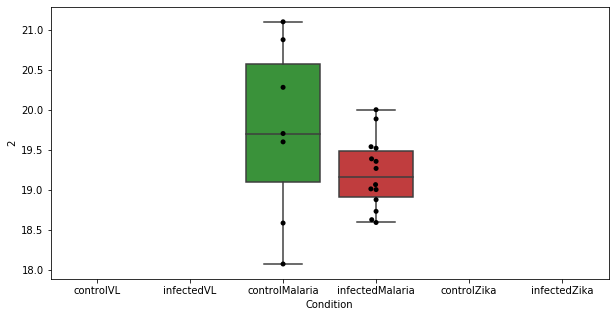

329 row m/z                169.195
row retention time     3.63357
p-val                 0.109934
adj.P.Val             0.647437
custom_id                 1049
compound_names             NaN
Name: 1049, dtype: object


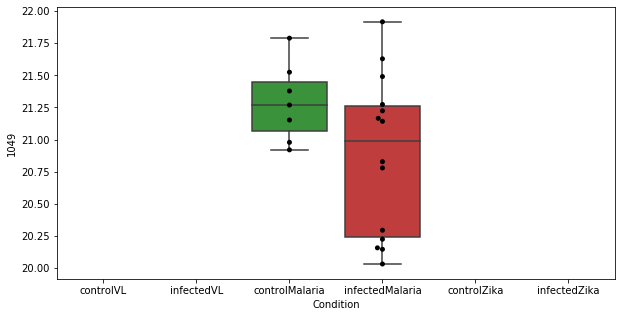

330 row m/z                145.028
row retention time     23.5718
p-val                  0.10997
adj.P.Val             0.647437
custom_id                  712
compound_names             NaN
Name: 712, dtype: object


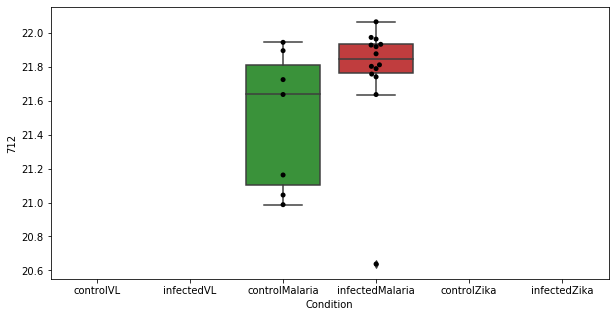

331 row m/z                196.126
row retention time     4.58819
p-val                 0.110287
adj.P.Val             0.647437
custom_id                 1396
compound_names             NaN
Name: 1396, dtype: object


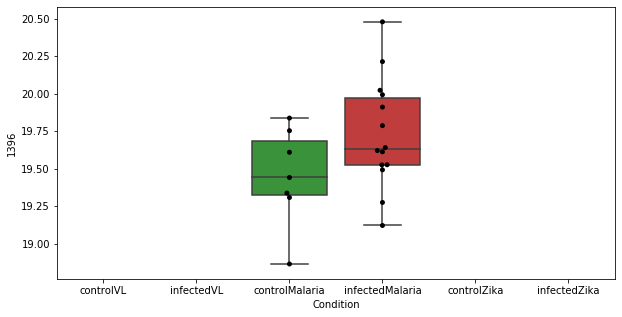

332 row m/z                403.232
row retention time      23.114
p-val                 0.110962
adj.P.Val             0.649443
custom_id                 2527
compound_names             NaN
Name: 2527, dtype: object


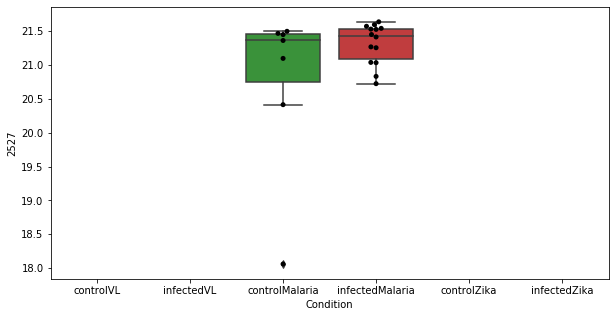

333 row m/z                164.067
row retention time     4.76286
p-val                 0.112399
adj.P.Val             0.655886
custom_id                  976
compound_names             NaN
Name: 976, dtype: object


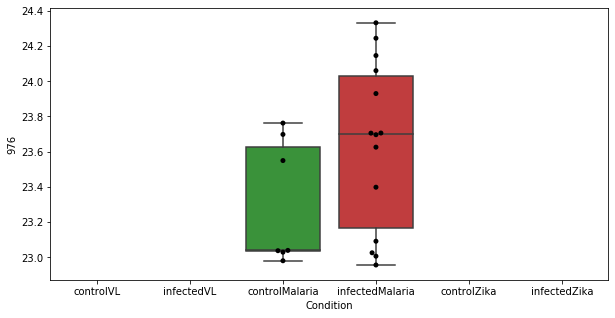

334 row m/z                832.584
row retention time     3.49343
p-val                 0.112916
adj.P.Val             0.656924
custom_id                 2964
compound_names             NaN
Name: 2964, dtype: object


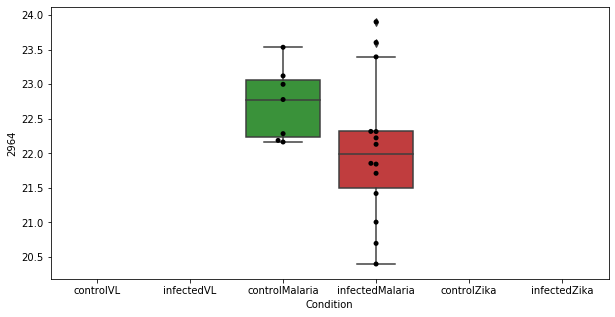

335 row m/z                174.113
row retention time     10.0589
p-val                 0.113566
adj.P.Val             0.656924
custom_id                 1121
compound_names             NaN
Name: 1121, dtype: object


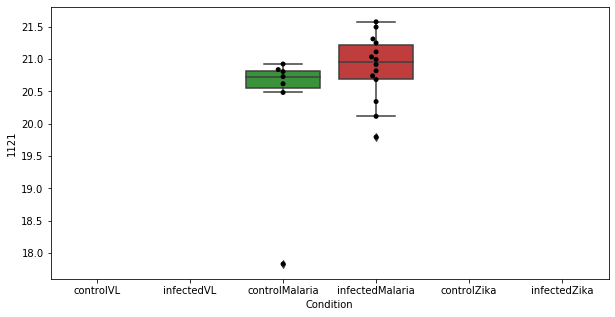

336 row m/z                           310.201
row retention time                6.98727
p-val                            0.113893
adj.P.Val                        0.656924
custom_id                            2290
compound_names        L-Octanoylcarnitine
Name: 2290, dtype: object


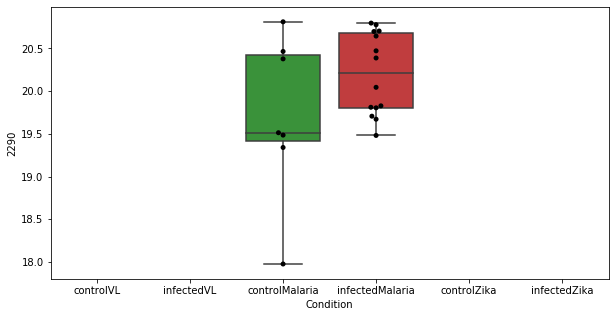

337 row m/z                                                         266.121
row retention time                                              5.39869
p-val                                                          0.113925
adj.P.Val                                                      0.656924
custom_id                                                          3902
compound_names        Formyl-N-acetyl-5-methoxykynurenamine$alpha-N-...
Name: 3902, dtype: object


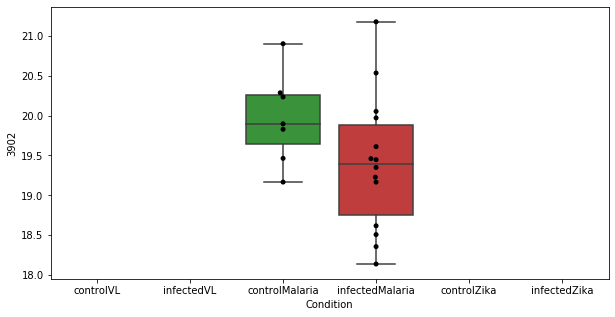

338 row m/z                362.217
row retention time     3.69585
p-val                 0.114859
adj.P.Val             0.660353
custom_id                 4136
compound_names             NaN
Name: 4136, dtype: object


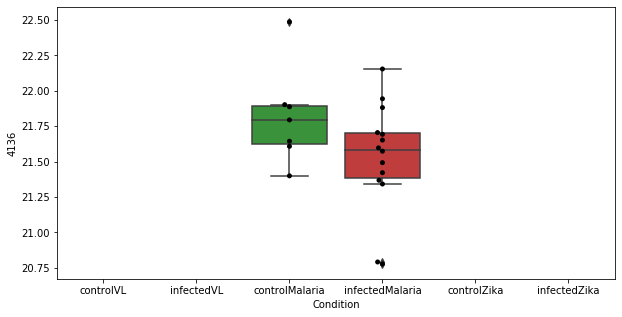

339 row m/z                346.222
row retention time     3.72728
p-val                 0.115742
adj.P.Val             0.660844
custom_id                 2424
compound_names             NaN
Name: 2424, dtype: object


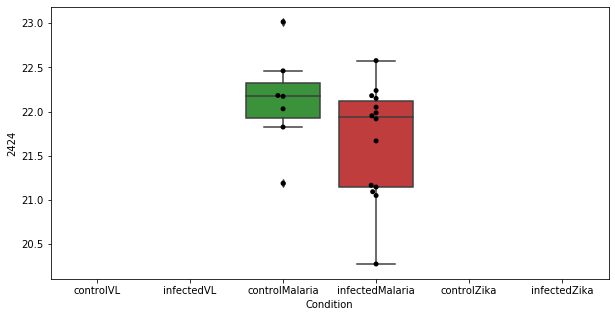

340 row m/z                203.139
row retention time     10.6508
p-val                  0.11594
adj.P.Val             0.660844
custom_id                 1462
compound_names             NaN
Name: 1462, dtype: object


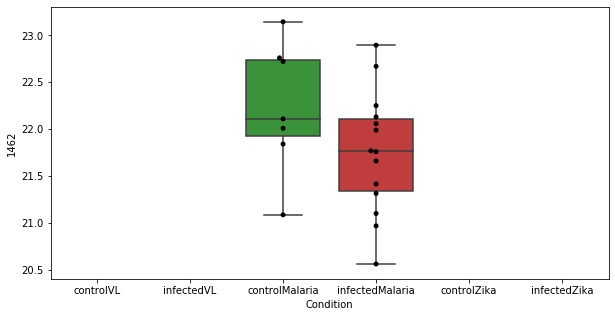

341 row m/z                225.091
row retention time     3.72633
p-val                 0.115961
adj.P.Val             0.660844
custom_id                 1664
compound_names             NaN
Name: 1664, dtype: object


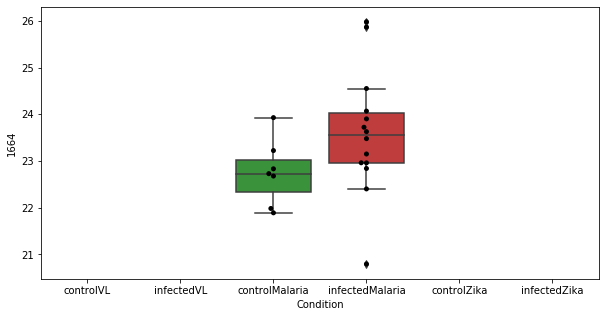

342 row m/z                                                           287.1
row retention time                                              7.00405
p-val                                                          0.116481
adj.P.Val                                                      0.661867
custom_id                                                          2182
compound_names        Formyl-N-acetyl-5-methoxykynurenamine$alpha-N-...
Name: 2182, dtype: object


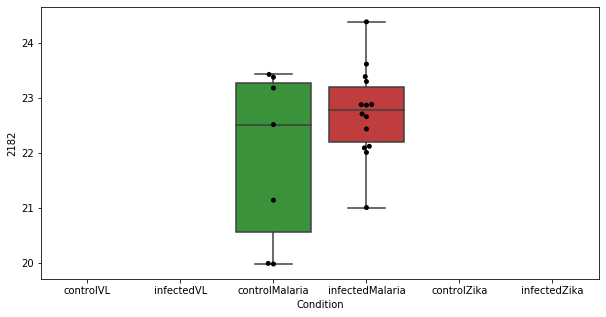

343 row m/z                731.855
row retention time     10.7939
p-val                 0.117693
adj.P.Val             0.665483
custom_id                 2843
compound_names             NaN
Name: 2843, dtype: object


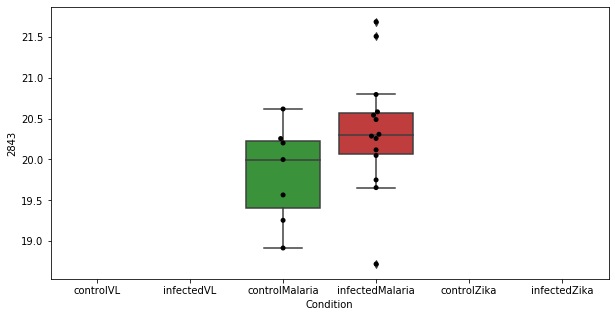

344 row m/z                326.378
row retention time     1.14814
p-val                   0.1178
adj.P.Val             0.665483
custom_id                 2359
compound_names             NaN
Name: 2359, dtype: object


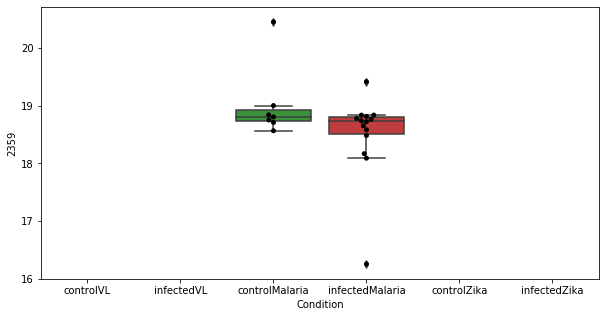

345 row m/z                122.081
row retention time     12.8138
p-val                 0.118549
adj.P.Val             0.666614
custom_id                  395
compound_names             NaN
Name: 395, dtype: object


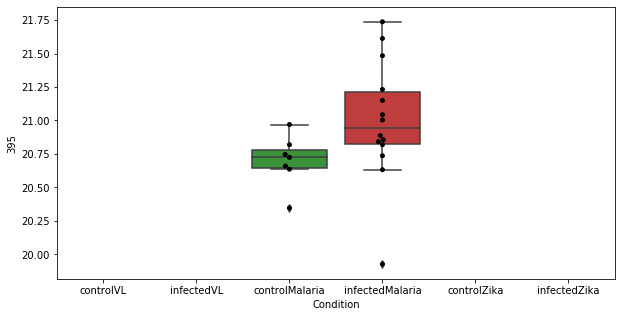

346 row m/z                610.865
row retention time     11.9782
p-val                 0.118813
adj.P.Val             0.666614
custom_id                 2750
compound_names             NaN
Name: 2750, dtype: object


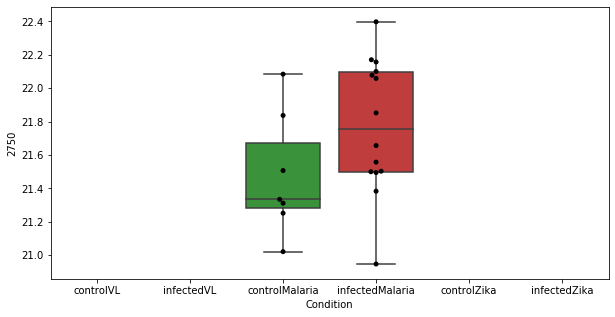

347 row m/z                                                          139.05
row retention time                                               7.3929
p-val                                                          0.119748
adj.P.Val                                                      0.666614
custom_id                                                           628
compound_names        4-Imidazolone-5-propanoate; 4-Imidazolone-5-pr...
Name: 628, dtype: object


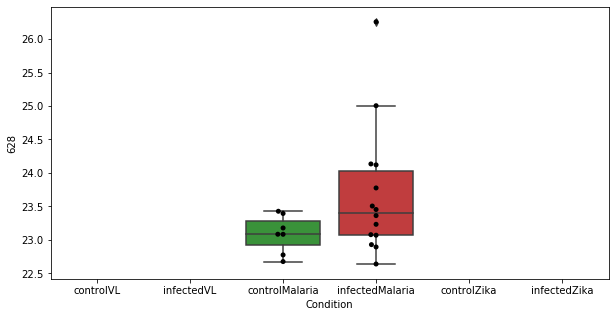

348 row m/z                              136.062
row retention time                   9.49365
p-val                               0.119957
adj.P.Val                           0.666614
custom_id                                599
compound_names        Adenine; 6-Aminopurine
Name: 599, dtype: object


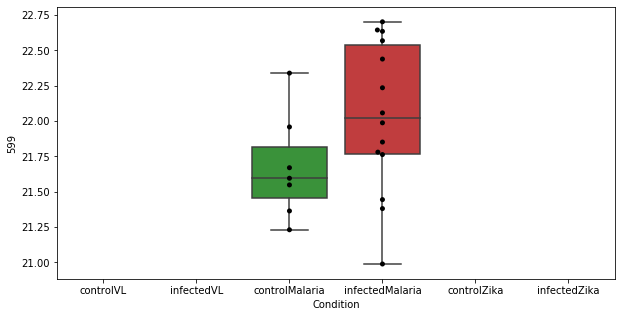

349 row m/z                338.341
row retention time      23.015
p-val                 0.119996
adj.P.Val             0.666614
custom_id                 2395
compound_names             NaN
Name: 2395, dtype: object


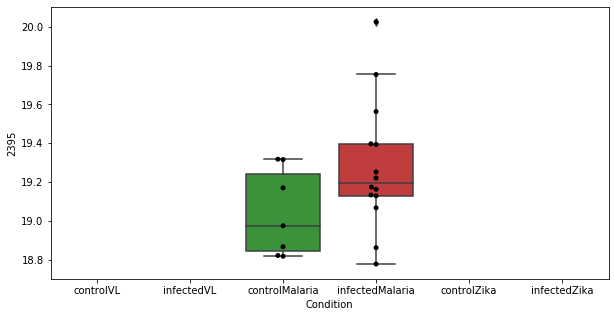

350 row m/z                196.118
row retention time     17.7328
p-val                 0.120381
adj.P.Val             0.666614
custom_id                 1394
compound_names             NaN
Name: 1394, dtype: object


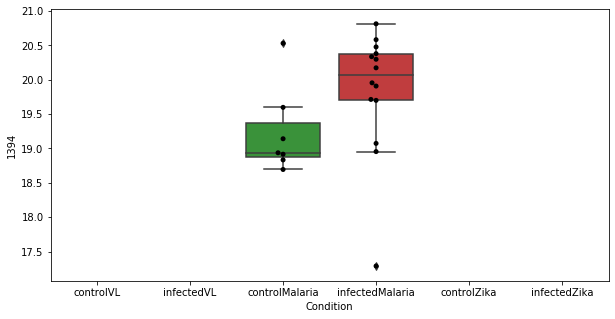

351 row m/z                232.118
row retention time     6.99352
p-val                 0.120589
adj.P.Val             0.666614
custom_id                 1735
compound_names             NaN
Name: 1735, dtype: object


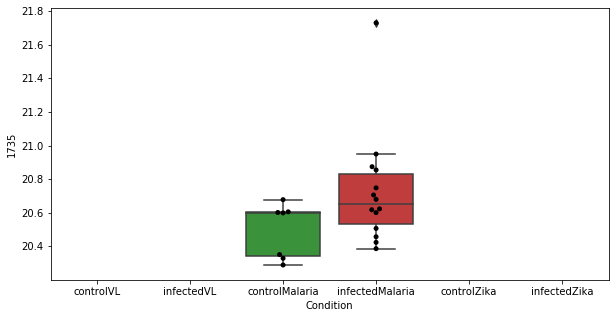

352 row m/z                246.134
row retention time     8.44026
p-val                 0.121078
adj.P.Val             0.666614
custom_id                 5020
compound_names             NaN
Name: 5020, dtype: object


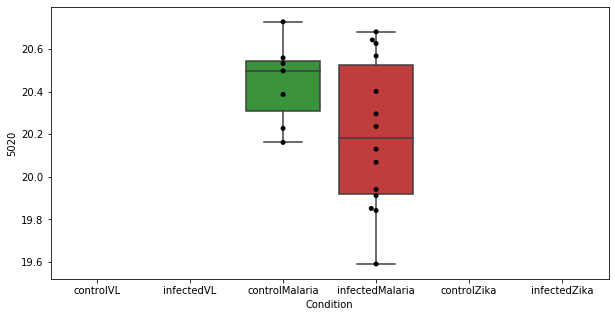

353 row m/z                242.139
row retention time     7.01141
p-val                 0.121078
adj.P.Val             0.666614
custom_id                 1844
compound_names             NaN
Name: 1844, dtype: object


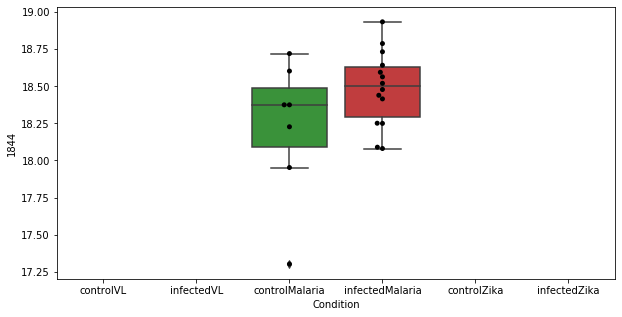

354 row m/z                140.011
row retention time     23.5442
p-val                 0.122655
adj.P.Val             0.669968
custom_id                  640
compound_names             NaN
Name: 640, dtype: object


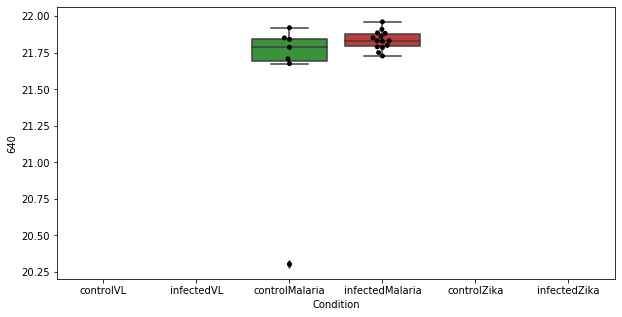

355 row m/z                                                         146.081
row retention time                                              7.88409
p-val                                                          0.123088
adj.P.Val                                                      0.669968
custom_id                                                           739
compound_names        6-Amino-2-oxohexanoate; 2-Oxo-6-aminocaproate$...
Name: 739, dtype: object


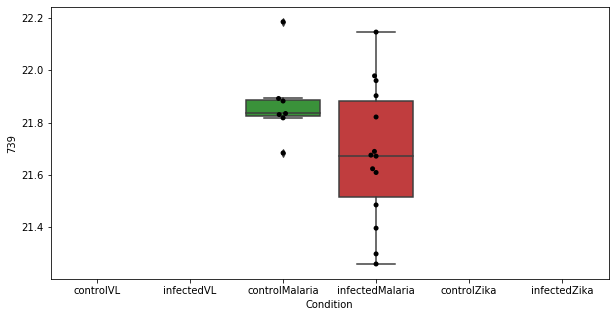

356 row m/z                                                          235.08
row retention time                                              23.8225
p-val                                                          0.123353
adj.P.Val                                                      0.669968
custom_id                                                          1775
compound_names        Nebularine; Purine riboside; N-D-Ribosylpurine...
Name: 1775, dtype: object


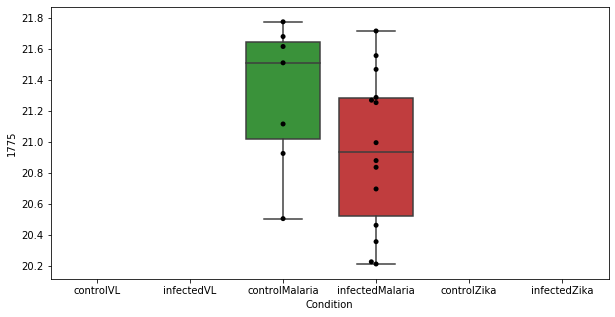

357 row m/z                181.163
row retention time     4.07111
p-val                 0.123883
adj.P.Val             0.669968
custom_id                 1204
compound_names             NaN
Name: 1204, dtype: object


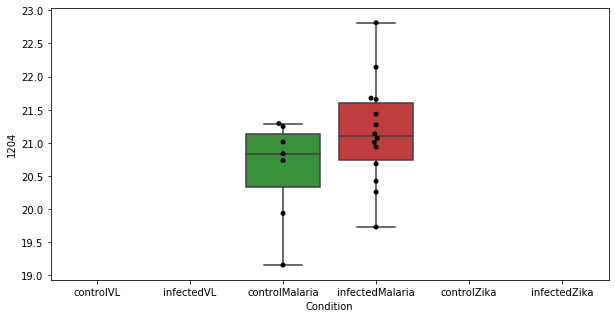

358 row m/z                735.572
row retention time     3.54543
p-val                 0.124065
adj.P.Val             0.669968
custom_id                 2848
compound_names             NaN
Name: 2848, dtype: object


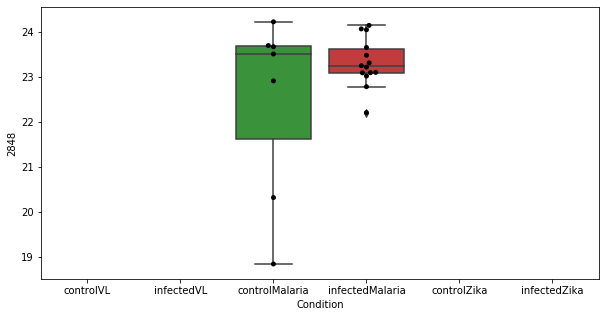

359 row m/z                                                         256.165
row retention time                                              4.46244
p-val                                                          0.124212
adj.P.Val                                                      0.669968
custom_id                                                          1953
compound_names        3-oxo-6(S)-hydroxy-tetradec-8Z-enoate$3-oxo-6(...
Name: 1953, dtype: object


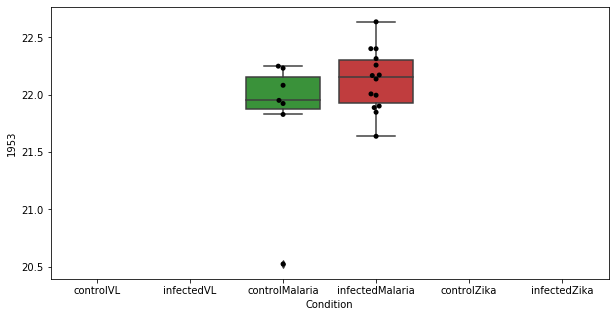

360 row m/z                302.196
row retention time     3.75205
p-val                 0.124417
adj.P.Val             0.669968
custom_id                 2256
compound_names             NaN
Name: 2256, dtype: object


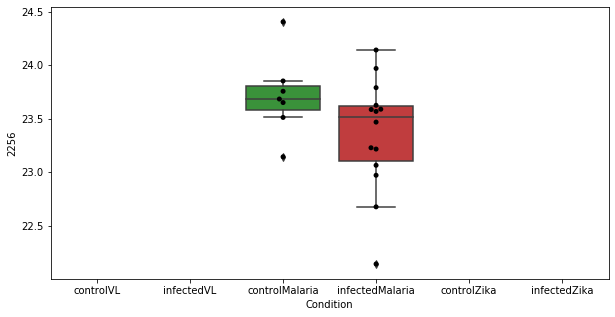

361 row m/z                         213.098
row retention time              4.73929
p-val                           0.12455
adj.P.Val                      0.669968
custom_id                          3675
compound_names        N-Methylserotonin
Name: 3675, dtype: object


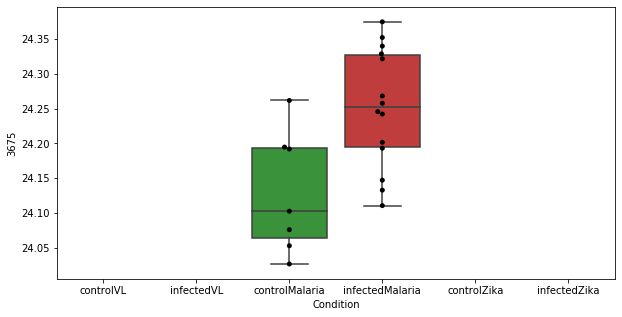

362 row m/z                186.132
row retention time     4.59373
p-val                 0.124781
adj.P.Val             0.669968
custom_id                 1260
compound_names             NaN
Name: 1260, dtype: object


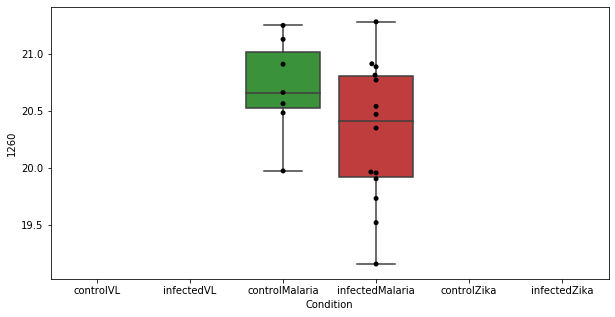

363 row m/z                225.189
row retention time     9.45949
p-val                 0.125125
adj.P.Val             0.669968
custom_id                 3739
compound_names             NaN
Name: 3739, dtype: object


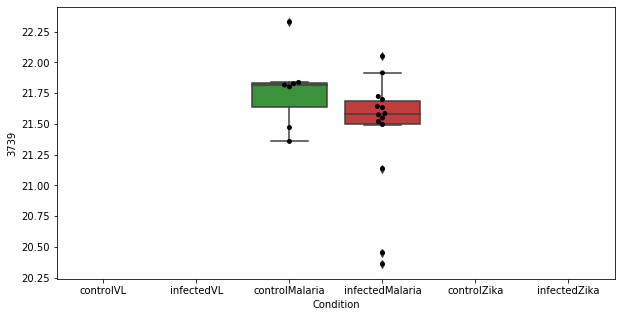

364 row m/z                256.059
row retention time     23.8901
p-val                 0.125749
adj.P.Val             0.671465
custom_id                 5041
compound_names             NaN
Name: 5041, dtype: object


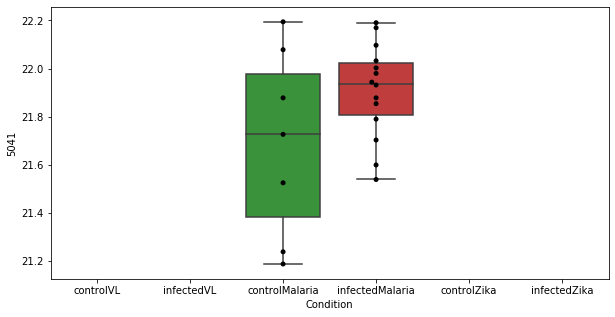

365 row m/z                                                         150.058
row retention time                                              6.21006
p-val                                                          0.126185
adj.P.Val                                                      0.671951
custom_id                                                          3379
compound_names        L-Methionine; Methionine; L-2-Amino-4methylthi...
Name: 3379, dtype: object


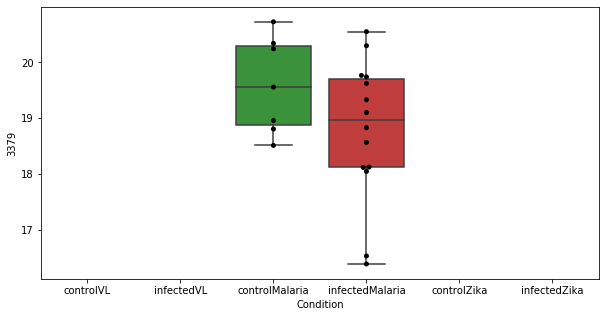

366 row m/z                610.184
row retention time     3.36692
p-val                   0.1272
adj.P.Val             0.673636
custom_id                 2747
compound_names             NaN
Name: 2747, dtype: object


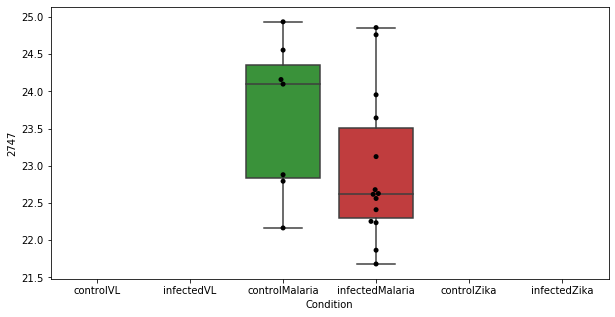

367 row m/z                221.035
row retention time     9.93716
p-val                 0.127323
adj.P.Val             0.673636
custom_id                 3721
compound_names             NaN
Name: 3721, dtype: object


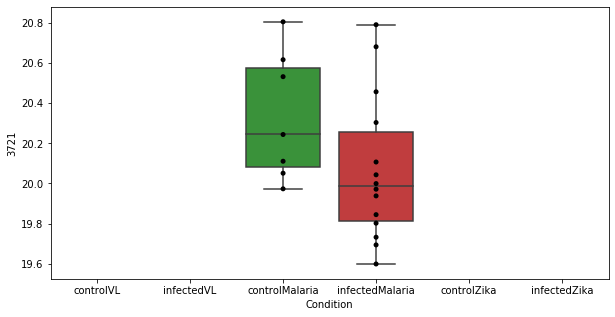

368 row m/z                 586.273
row retention time      3.49705
p-val                  0.127615
adj.P.Val              0.673636
custom_id                  6228
compound_names        Bilirubin
Name: 6228, dtype: object


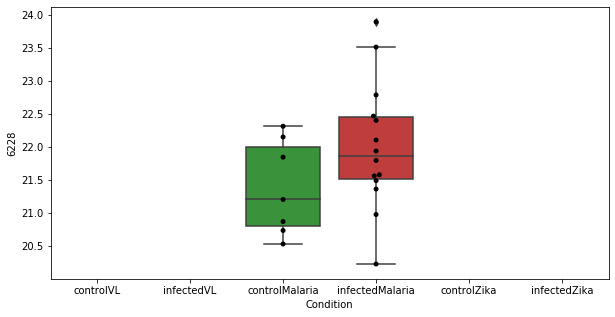

369 row m/z                120.091
row retention time     9.93145
p-val                 0.128405
adj.P.Val             0.673636
custom_id                  380
compound_names             NaN
Name: 380, dtype: object


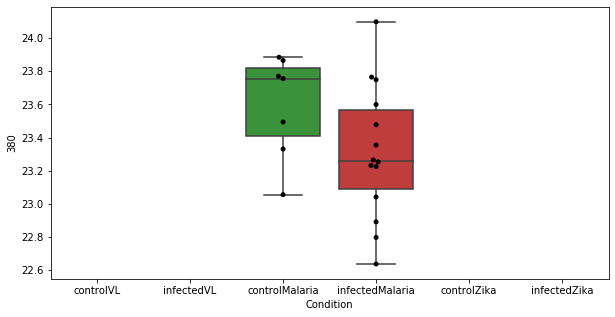

370 row m/z                                                         156.102
row retention time                                              4.56906
p-val                                                           0.12844
adj.P.Val                                                      0.673636
custom_id                                                           867
compound_names        L-Normetanephrine$L-Adrenaline; (R)-(-)-Adrena...
Name: 867, dtype: object


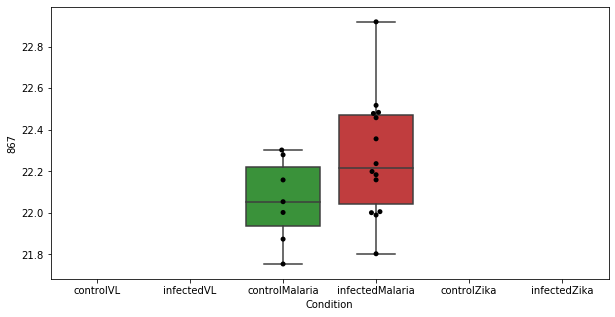

371 row m/z                383.217
row retention time     4.38149
p-val                 0.129031
adj.P.Val             0.673636
custom_id                 2487
compound_names             NaN
Name: 2487, dtype: object


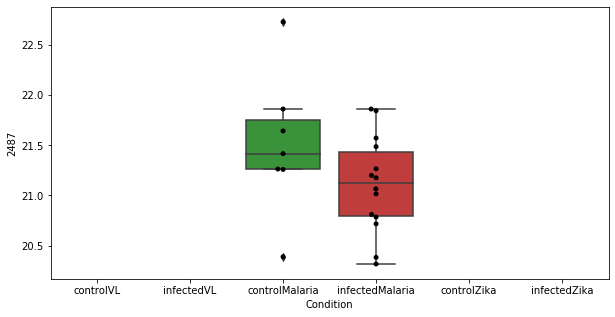

372 row m/z                156.138
row retention time     23.7303
p-val                 0.129256
adj.P.Val             0.673636
custom_id                  870
compound_names             NaN
Name: 870, dtype: object


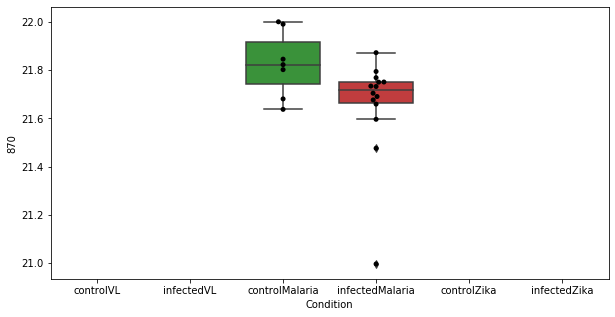

373 row m/z                258.206
row retention time      3.7354
p-val                 0.129266
adj.P.Val             0.673636
custom_id                 3880
compound_names             NaN
Name: 3880, dtype: object


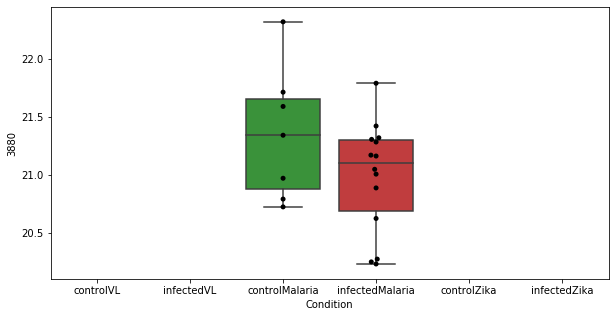

374 row m/z                176.116
row retention time     19.1471
p-val                 0.130666
adj.P.Val              0.67556
custom_id                 1145
compound_names             NaN
Name: 1145, dtype: object


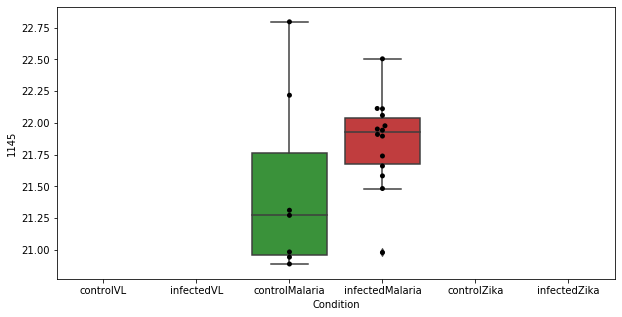

375 row m/z                          131.118
row retention time              0.854636
p-val                           0.130726
adj.P.Val                        0.67556
custom_id                           3261
compound_names        N-Acetylputrescine
Name: 3261, dtype: object


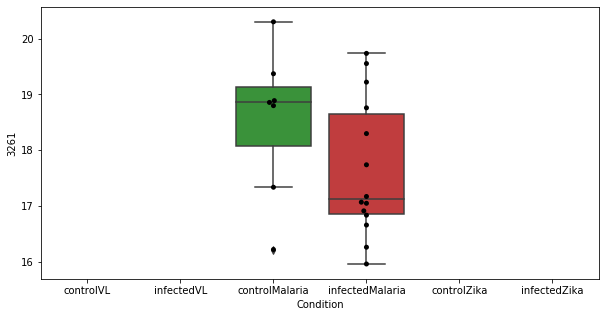

376 row m/z               106.045
row retention time    23.7443
p-val                 0.13079
adj.P.Val             0.67556
custom_id                 203
compound_names            NaN
Name: 203, dtype: object


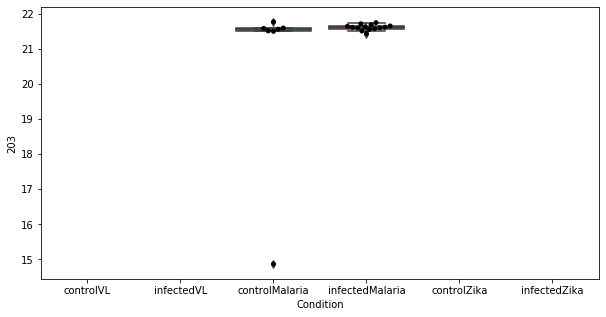

377 row m/z                153.091
row retention time      3.9381
p-val                 0.131583
adj.P.Val              0.67556
custom_id                  848
compound_names             NaN
Name: 848, dtype: object


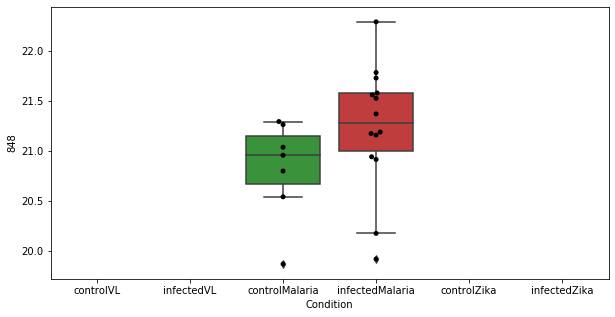

378 row m/z                87.0789
row retention time     12.1327
p-val                 0.131589
adj.P.Val              0.67556
custom_id                   74
compound_names             NaN
Name: 74, dtype: object


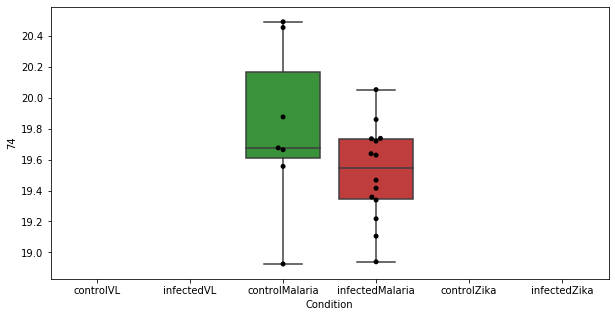

379 row m/z                329.005
row retention time      9.4673
p-val                 0.131715
adj.P.Val              0.67556
custom_id                 4090
compound_names             NaN
Name: 4090, dtype: object


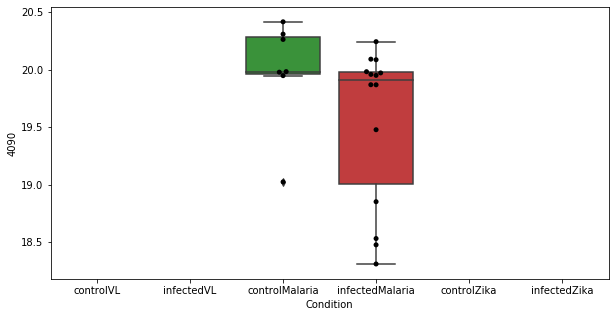

380 row m/z                 411.78
row retention time     23.7428
p-val                 0.132396
adj.P.Val              0.67559
custom_id                 2541
compound_names             NaN
Name: 2541, dtype: object


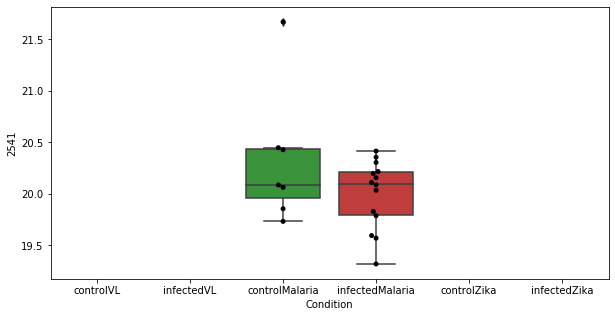

381 row m/z                                                         188.071
row retention time                                              10.3545
p-val                                                          0.132671
adj.P.Val                                                       0.67559
custom_id                                                          1275
compound_names        L-Tryptophan; Tryptophan; (S)-alpha-Amino-beta...
Name: 1275, dtype: object


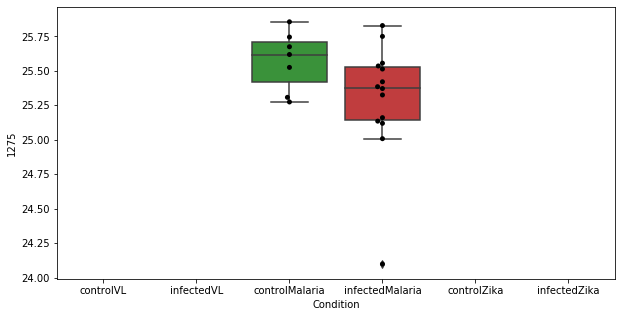

382 row m/z                168.946
row retention time     23.7078
p-val                 0.132761
adj.P.Val              0.67559
custom_id                 1039
compound_names             NaN
Name: 1039, dtype: object


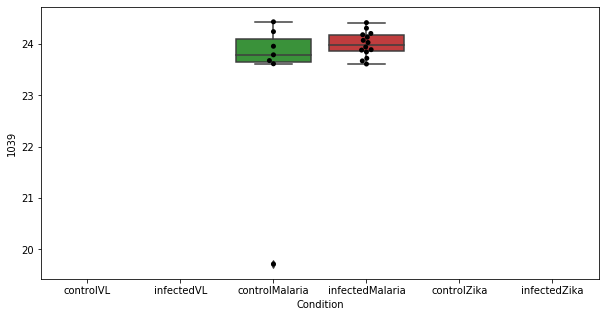

383 row m/z                                                         123.055
row retention time                                              7.00477
p-val                                                          0.133951
adj.P.Val                                                      0.679871
custom_id                                                           422
compound_names        Methylimidazoleacetic acid; Tele-methylimidazo...
Name: 422, dtype: object


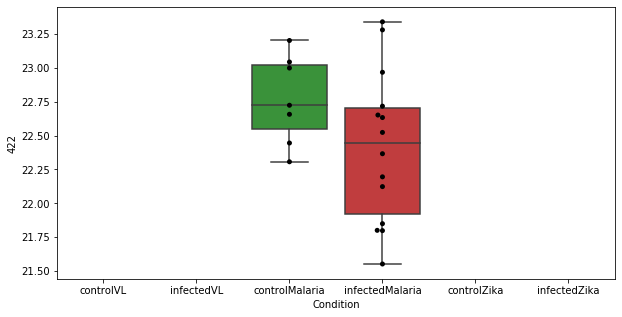

384 row m/z                285.206
row retention time     3.66051
p-val                 0.134731
adj.P.Val             0.680898
custom_id                 2169
compound_names             NaN
Name: 2169, dtype: object


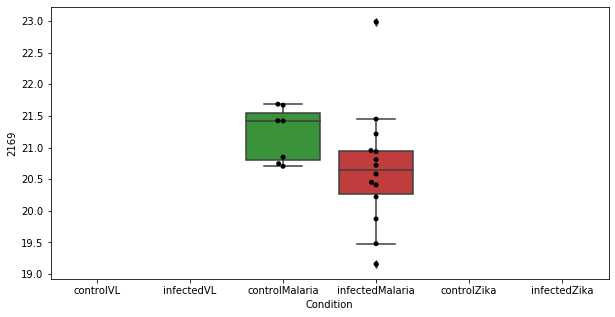

385 row m/z                230.248
row retention time     4.23662
p-val                 0.135179
adj.P.Val             0.680898
custom_id                 1725
compound_names             NaN
Name: 1725, dtype: object


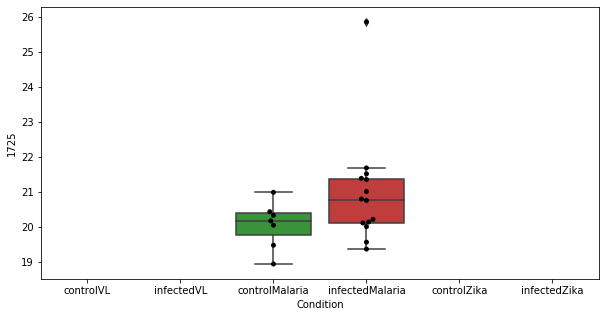

386 row m/z                96.0551
row retention time     23.8787
p-val                 0.135391
adj.P.Val             0.680898
custom_id                   99
compound_names             NaN
Name: 99, dtype: object


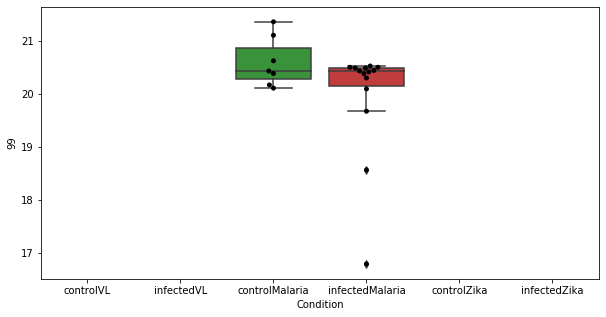

387 row m/z                746.874
row retention time     9.57895
p-val                 0.135551
adj.P.Val             0.680898
custom_id                 6255
compound_names             NaN
Name: 6255, dtype: object


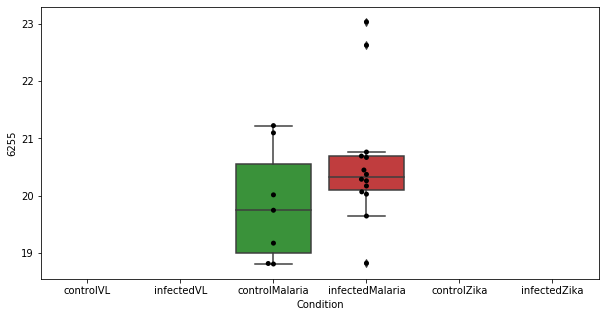

388 row m/z                221.096
row retention time     3.68534
p-val                 0.135926
adj.P.Val             0.681028
custom_id                 1643
compound_names             NaN
Name: 1643, dtype: object


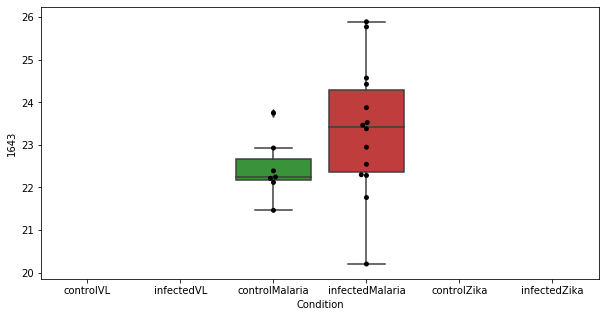

389 row m/z                              188.071
row retention time                   8.00115
p-val                                0.13755
adj.P.Val                           0.683899
custom_id                               5797
compound_names        5-Methoxyindoleacetate
Name: 5797, dtype: object


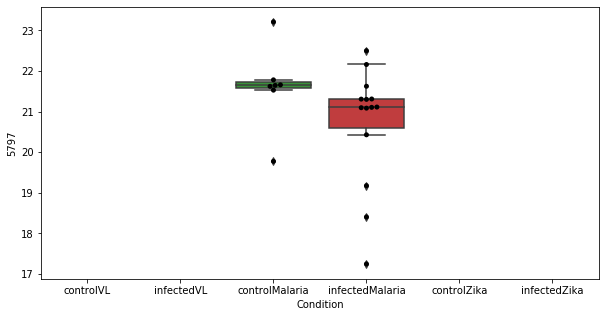

390 row m/z                536.166
row retention time     3.37694
p-val                 0.137553
adj.P.Val             0.683899
custom_id                 2673
compound_names             NaN
Name: 2673, dtype: object


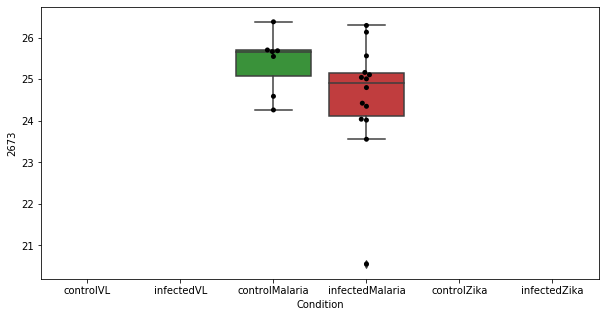

391 row m/z                246.124
row retention time     10.3578
p-val                 0.137893
adj.P.Val             0.683899
custom_id                 1873
compound_names             NaN
Name: 1873, dtype: object


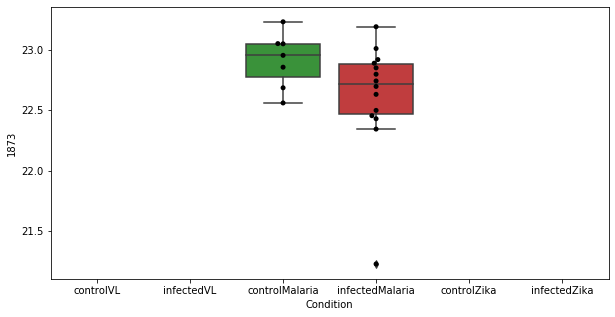

392 row m/z                 212.212
row retention time    0.0315917
p-val                  0.137903
adj.P.Val              0.683899
custom_id                  1552
compound_names              NaN
Name: 1552, dtype: object


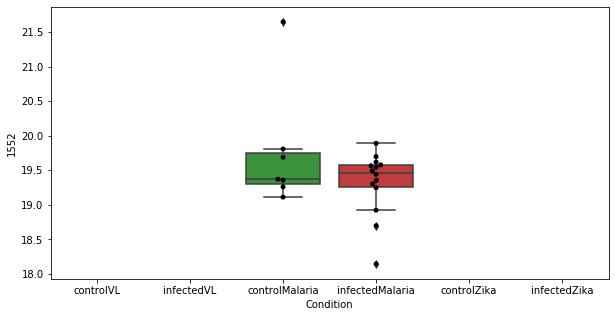

393 row m/z                                                         105.074
row retention time                                               8.4569
p-val                                                          0.138707
adj.P.Val                                                      0.686141
custom_id                                                          3107
compound_names        N,N-Dimethylglycine; Dimethylglycine$(R)-3-Ami...
Name: 3107, dtype: object


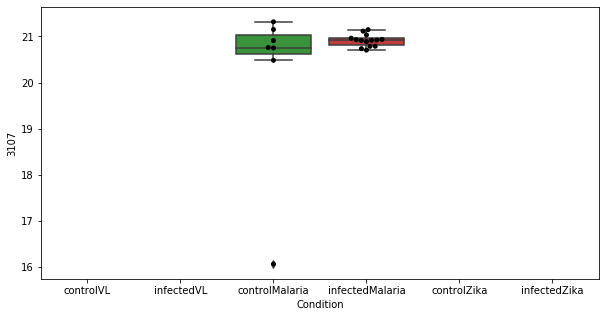

394 row m/z                                                         105.033
row retention time                                              3.73997
p-val                                                          0.139523
adj.P.Val                                                      0.688432
custom_id                                                           172
compound_names        Benzoate; Benzoic acid; Benzenecarboxylic acid...
Name: 172, dtype: object


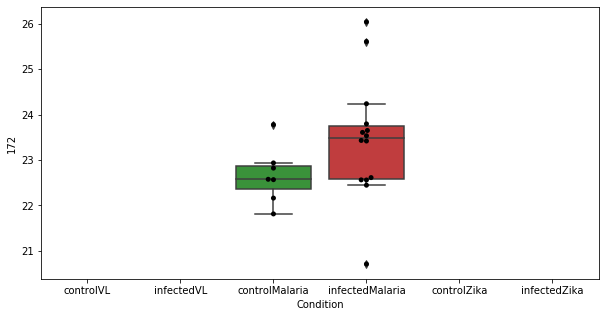

395 row m/z                                                         180.087
row retention time                                              12.5122
p-val                                                          0.141297
adj.P.Val                                                      0.691555
custom_id                                                          1175
compound_names        D-Glucosamine; Chitosamine; 2-Amino-2-deoxy-D-...
Name: 1175, dtype: object


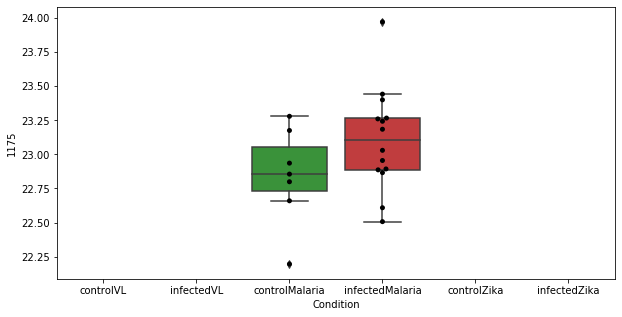

396 row m/z                142.123
row retention time     23.6783
p-val                 0.141567
adj.P.Val             0.691555
custom_id                 5554
compound_names             NaN
Name: 5554, dtype: object


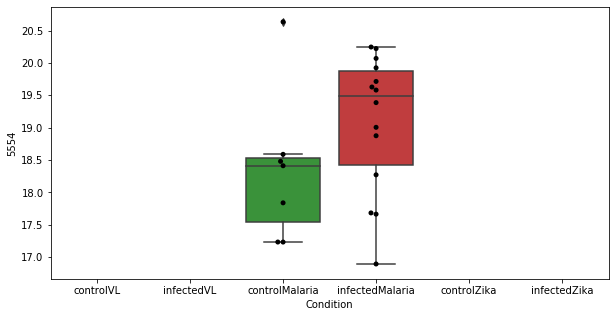

397 row m/z                           214.082
row retention time                8.28481
p-val                            0.141932
adj.P.Val                        0.691555
custom_id                            1575
compound_names        5-methoxytryptophol
Name: 1575, dtype: object


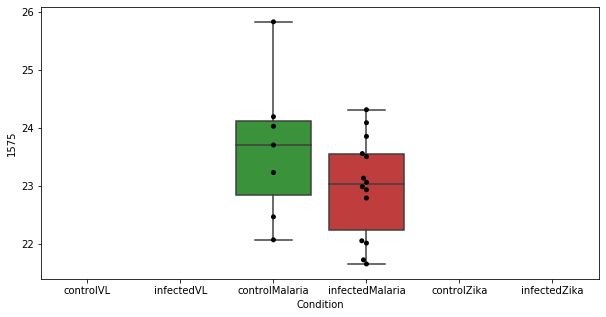

398 row m/z                           288.217
row retention time                3.73805
p-val                            0.142212
adj.P.Val                        0.691555
custom_id                            2193
compound_names        L-Octanoylcarnitine
Name: 2193, dtype: object


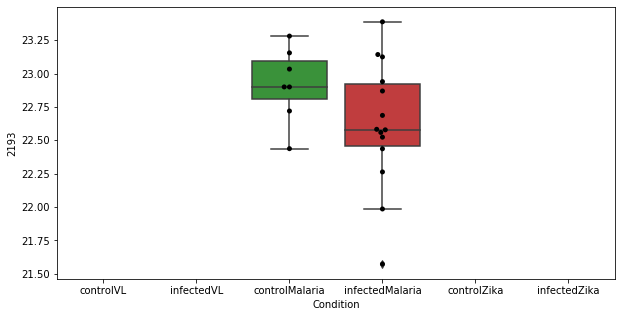

399 row m/z                 216.16
row retention time      3.8489
p-val                 0.142545
adj.P.Val             0.691555
custom_id                 1603
compound_names             NaN
Name: 1603, dtype: object


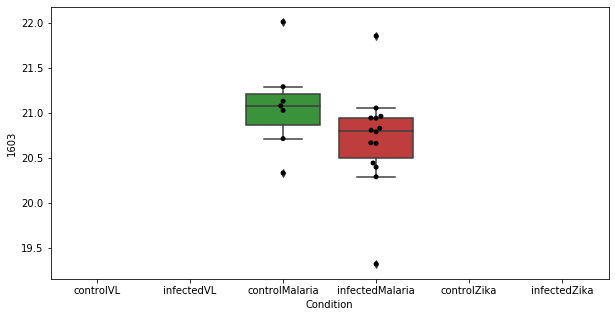

400 row m/z                193.144
row retention time     23.6157
p-val                 0.142933
adj.P.Val             0.691555
custom_id                 1352
compound_names             NaN
Name: 1352, dtype: object


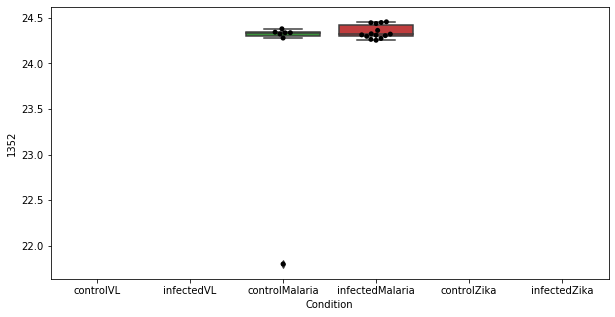

401 row m/z                330.228
row retention time     3.73217
p-val                 0.143143
adj.P.Val             0.691555
custom_id                 2383
compound_names             NaN
Name: 2383, dtype: object


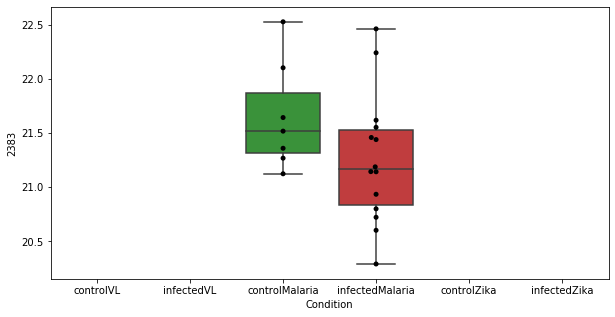

402 row m/z                811.666
row retention time     6.67167
p-val                 0.144014
adj.P.Val             0.691555
custom_id                 2946
compound_names             NaN
Name: 2946, dtype: object


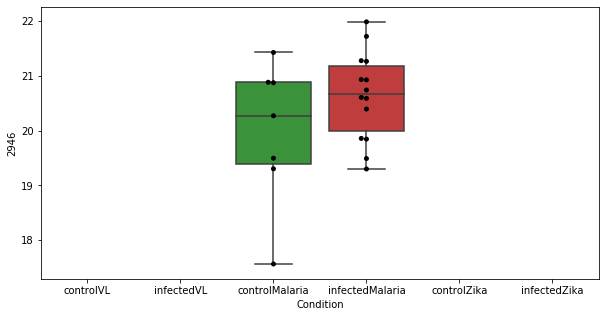

403 row m/z                                                          119.09
row retention time                                              9.93677
p-val                                                          0.144412
adj.P.Val                                                      0.691555
custom_id                                                           361
compound_names        5-Aminopentanoate; 5-Aminopentanoic acid; 5-Am...
Name: 361, dtype: object


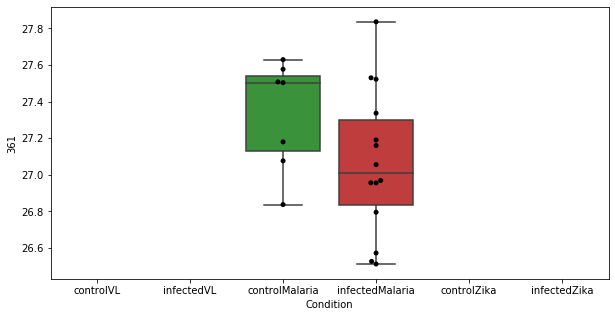

404 row m/z                                                         118.086
row retention time                                               9.9356
p-val                                                          0.144933
adj.P.Val                                                      0.691555
custom_id                                                           349
compound_names        5-Aminopentanoate; 5-Aminopentanoic acid; 5-Am...
Name: 349, dtype: object


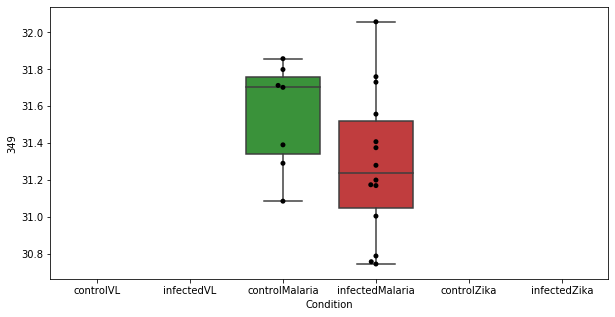

405 row m/z                246.868
row retention time     12.4693
p-val                 0.145251
adj.P.Val             0.691555
custom_id                 1886
compound_names             NaN
Name: 1886, dtype: object


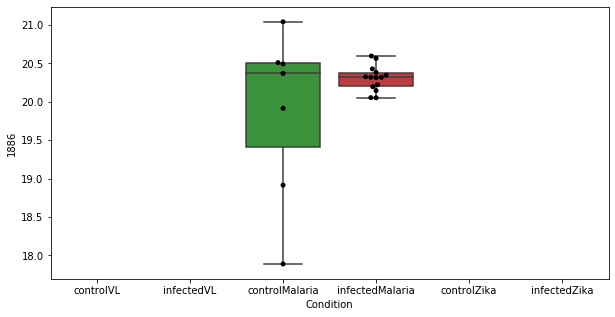

406 row m/z                                                157.097
row retention time                                     7.02317
p-val                                                  0.14527
adj.P.Val                                             0.691555
custom_id                                                  881
compound_names        N-Acetylornithine; N2-Acetyl-L-ornithine
Name: 881, dtype: object


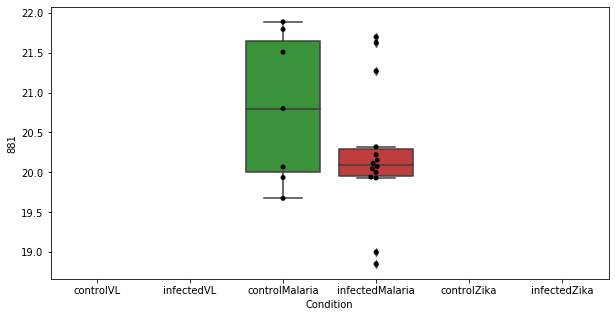

407 row m/z                146.106
row retention time      9.4975
p-val                 0.145898
adj.P.Val             0.691555
custom_id                  741
compound_names             NaN
Name: 741, dtype: object


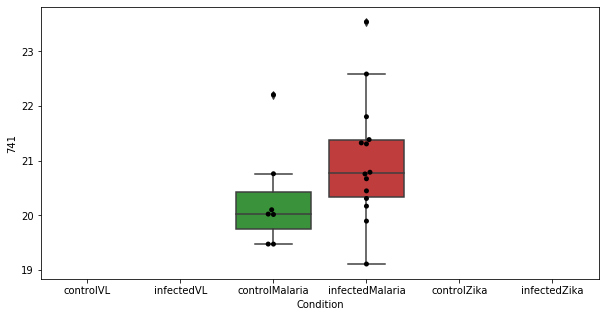

408 row m/z                                                         370.233
row retention time                                              23.3156
p-val                                                          0.146103
adj.P.Val                                                      0.691555
custom_id                                                          2456
compound_names        prostaglandin G1$$10,11-dihydro-20-dihydroxy-LTB4
Name: 2456, dtype: object


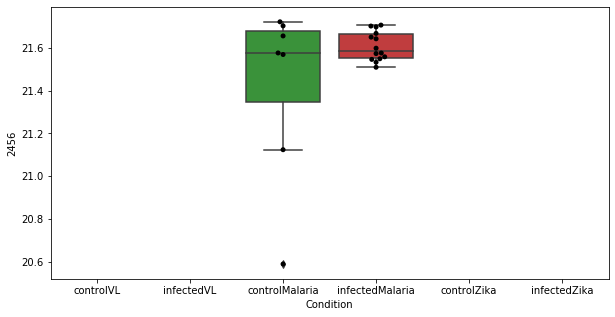

409 row m/z                                                  115.075
row retention time                                       3.87383
p-val                                                   0.146119
adj.P.Val                                               0.691555
custom_id                                                    304
compound_names        6-Hydroxyhexanoic acid; 6-Hydroxyhexanoate
Name: 304, dtype: object


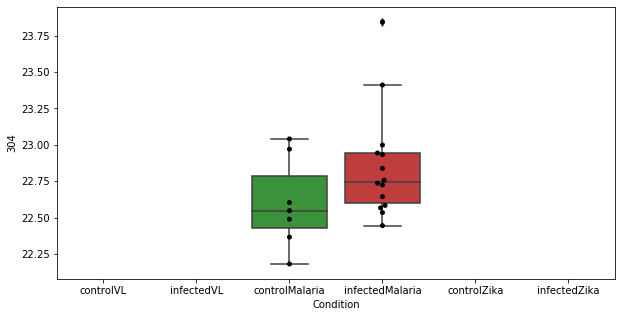

410 row m/z                                                          235.08
row retention time                                              13.5353
p-val                                                          0.146138
adj.P.Val                                                      0.691555
custom_id                                                          1772
compound_names        Nebularine; Purine riboside; N-D-Ribosylpurine...
Name: 1772, dtype: object


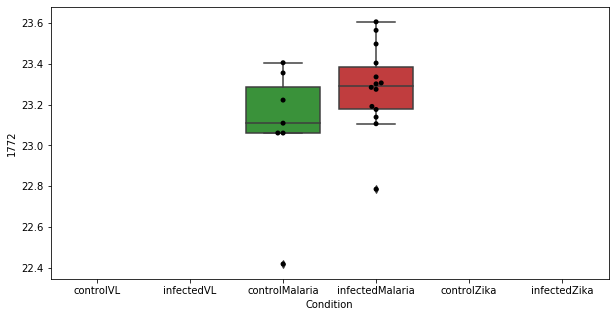

411 row m/z                145.134
row retention time     4.21419
p-val                 0.146194
adj.P.Val             0.691555
custom_id                  723
compound_names             NaN
Name: 723, dtype: object


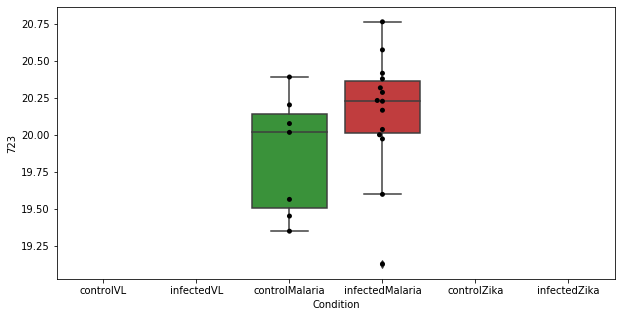

412 row m/z                314.232
row retention time     3.69897
p-val                 0.146659
adj.P.Val             0.691555
custom_id                 4065
compound_names             NaN
Name: 4065, dtype: object


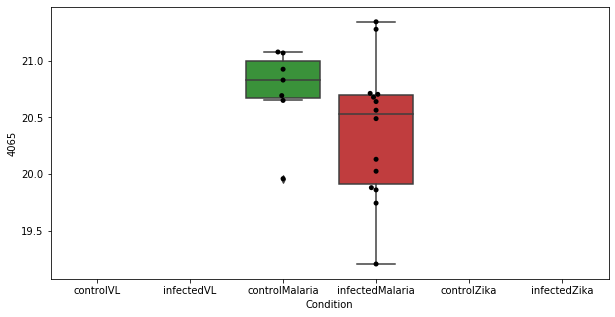

413 row m/z                268.139
row retention time     3.76641
p-val                 0.147341
adj.P.Val             0.691555
custom_id                 5059
compound_names             NaN
Name: 5059, dtype: object


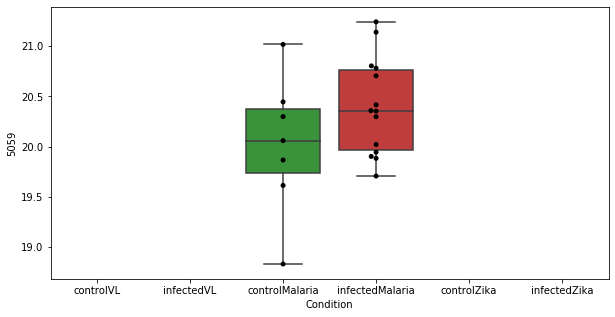

414 row m/z                                                         111.044
row retention time                                              5.46842
p-val                                                          0.147386
adj.P.Val                                                      0.691555
custom_id                                                          5384
compound_names        p-Benzenediol; Hydroquinone; 1,4-Benzenediol; ...
Name: 5384, dtype: object


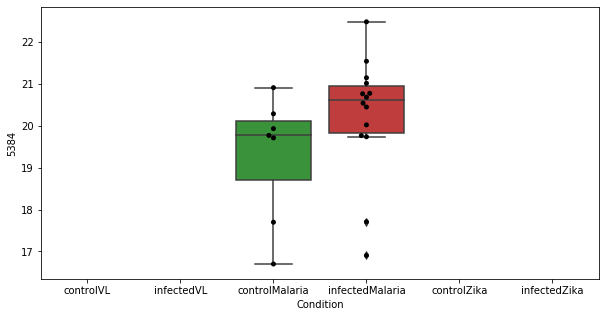

415 row m/z                 585.271
row retention time      6.99962
p-val                  0.147607
adj.P.Val              0.691555
custom_id                  4233
compound_names        Bilirubin
Name: 4233, dtype: object


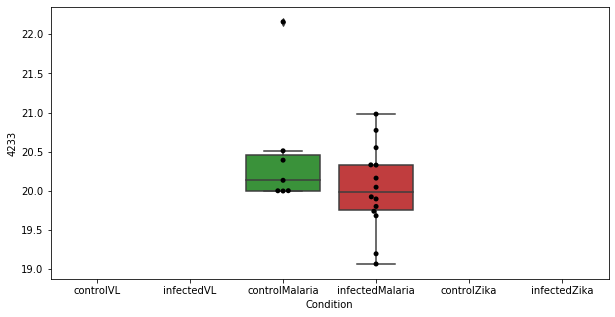

416 row m/z                360.159
row retention time     3.68314
p-val                 0.148942
adj.P.Val             0.696135
custom_id                 2440
compound_names             NaN
Name: 2440, dtype: object


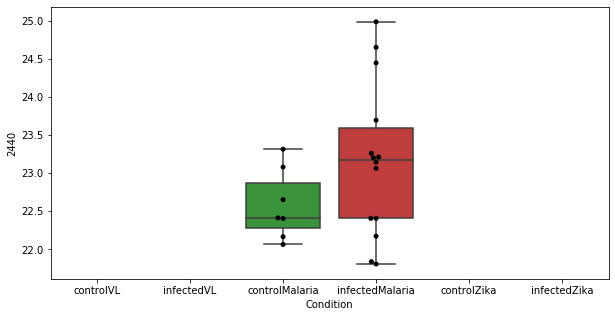

417 row m/z                547.359
row retention time     3.99056
p-val                 0.149689
adj.P.Val             0.697954
custom_id                 4212
compound_names             NaN
Name: 4212, dtype: object


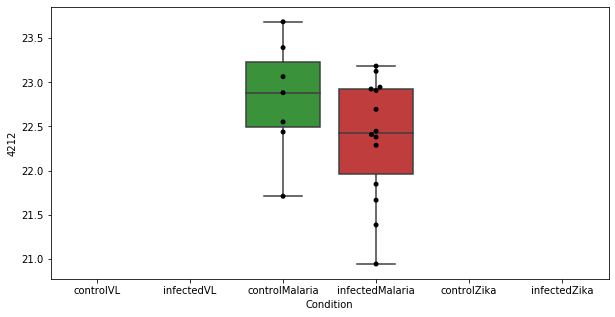

418 row m/z                180.044
row retention time      4.8067
p-val                 0.150243
adj.P.Val             0.698864
custom_id                 1171
compound_names             NaN
Name: 1171, dtype: object


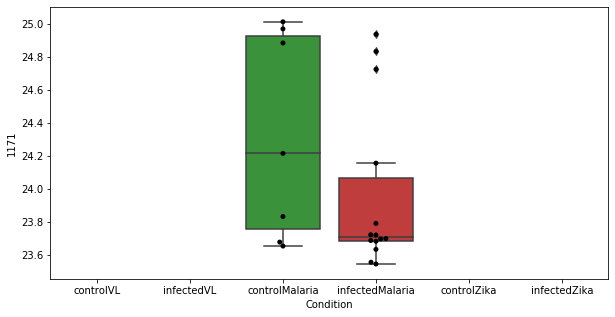

419 row m/z                327.138
row retention time     3.73581
p-val                 0.152084
adj.P.Val             0.703191
custom_id                 2364
compound_names             NaN
Name: 2364, dtype: object


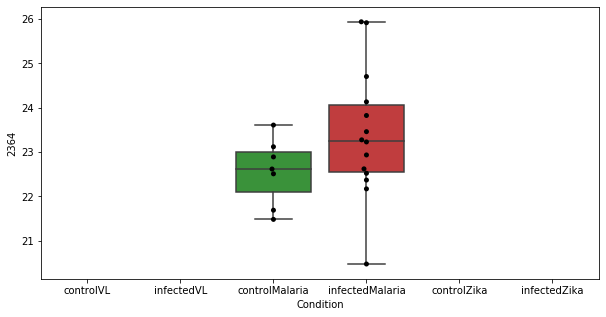

420 row m/z                                                         156.077
row retention time                                              12.3368
p-val                                                          0.152389
adj.P.Val                                                      0.703191
custom_id                                                           863
compound_names        L-Histidine; (S)-alpha-Amino-1H-imidazole-4-pr...
Name: 863, dtype: object


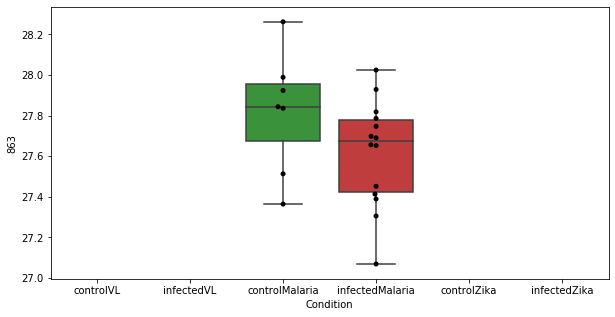

421 row m/z                      216.123
row retention time           6.99595
p-val                       0.152531
adj.P.Val                   0.703191
custom_id                       1602
compound_names        L-Metanephrine
Name: 1602, dtype: object


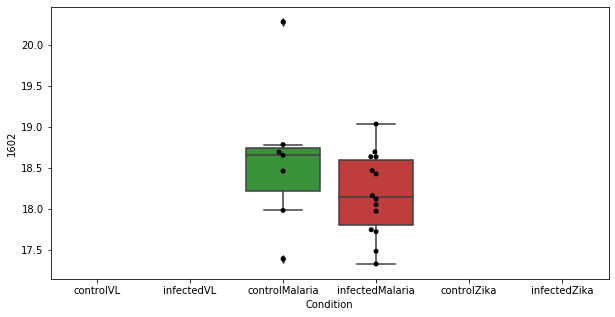

422 row m/z                171.102
row retention time     4.45398
p-val                 0.152617
adj.P.Val             0.703191
custom_id                 1080
compound_names             NaN
Name: 1080, dtype: object


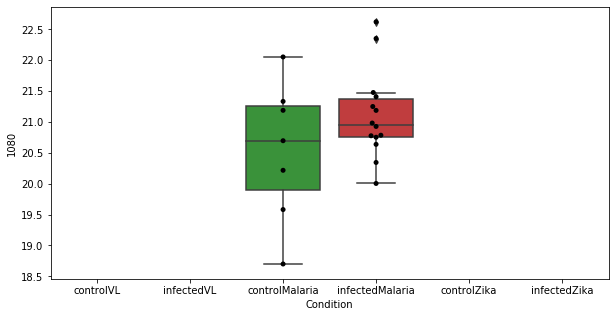

423 row m/z                                                         537.166
row retention time                                               3.3832
p-val                                                          0.153132
adj.P.Val                                                        0.7039
custom_id                                                          2675
compound_names        Cellulose; (1,4-beta-D-Glucosyl)n; (1,4-beta-D...
Name: 2675, dtype: object


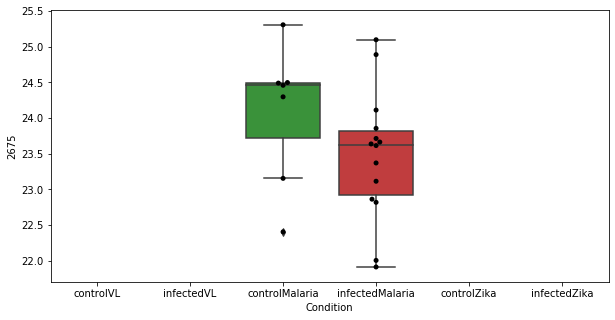

424 row m/z                                                          235.08
row retention time                                              5.04359
p-val                                                          0.153693
adj.P.Val                                                      0.704153
custom_id                                                          1774
compound_names        Nebularine; Purine riboside; N-D-Ribosylpurine...
Name: 1774, dtype: object


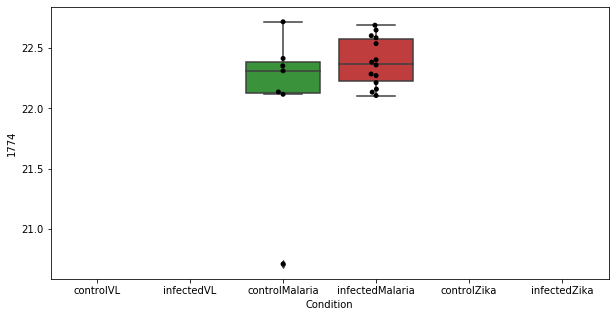

425 row m/z                185.129
row retention time     4.59472
p-val                 0.153909
adj.P.Val             0.704153
custom_id                 1246
compound_names             NaN
Name: 1246, dtype: object


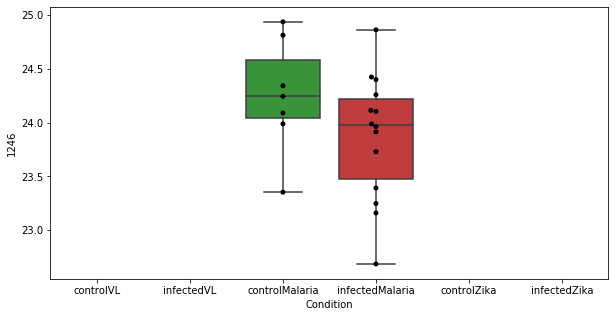

426 row m/z                 105.11
row retention time     23.8348
p-val                 0.154529
adj.P.Val              0.70532
custom_id                  193
compound_names             NaN
Name: 193, dtype: object


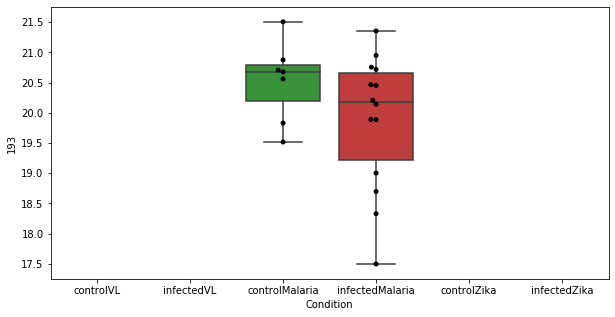

427 row m/z                268.175
row retention time     4.41499
p-val                 0.155622
adj.P.Val              0.70532
custom_id                 2039
compound_names             NaN
Name: 2039, dtype: object


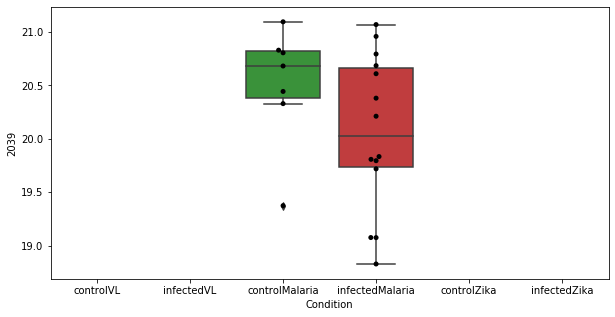

428 row m/z                149.014
row retention time     23.6543
p-val                 0.155929
adj.P.Val              0.70532
custom_id                 5607
compound_names             NaN
Name: 5607, dtype: object


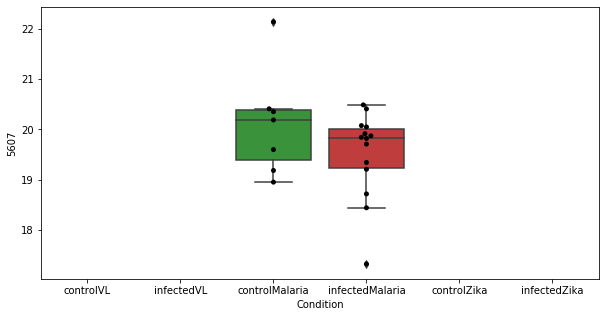

429 row m/z                                                         380.256
row retention time                                              6.99843
p-val                                                          0.155944
adj.P.Val                                                       0.70532
custom_id                                                          2475
compound_names        Sphingosine 1-phosphate; Sphing-4-enine 1-phos...
Name: 2475, dtype: object


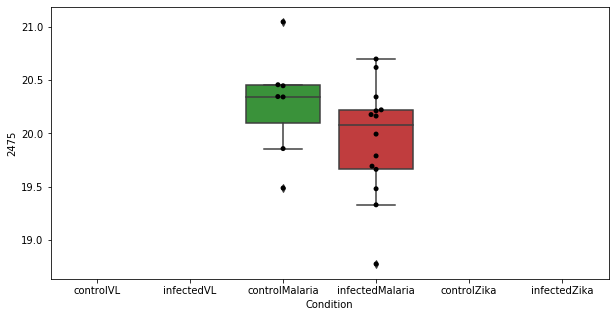

430 row m/z                100.087
row retention time     9.41537
p-val                 0.155974
adj.P.Val              0.70532
custom_id                  121
compound_names             NaN
Name: 121, dtype: object


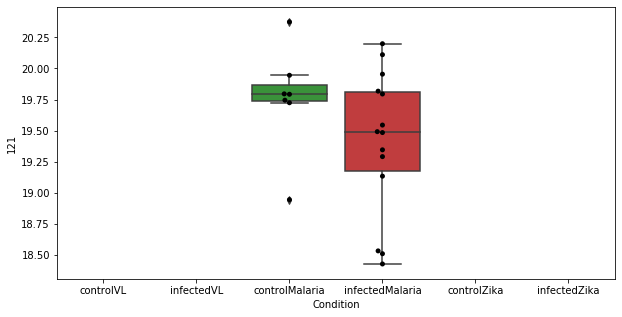

431 row m/z                128.143
row retention time       12.19
p-val                 0.156772
adj.P.Val             0.707289
custom_id                 3226
compound_names             NaN
Name: 3226, dtype: object


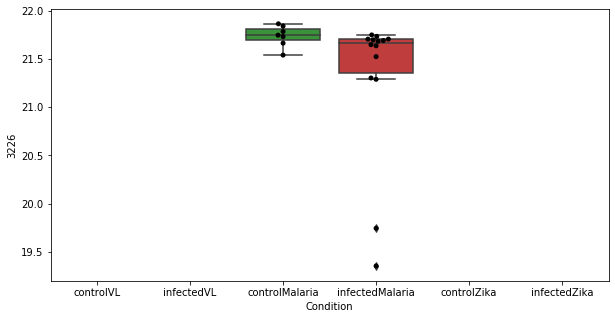

432 row m/z                                                         138.055
row retention time                                              7.01197
p-val                                                          0.157338
adj.P.Val                                                      0.708203
custom_id                                                           621
compound_names        Anthranilate; Anthranilic acid; o-Aminobenzoic...
Name: 621, dtype: object


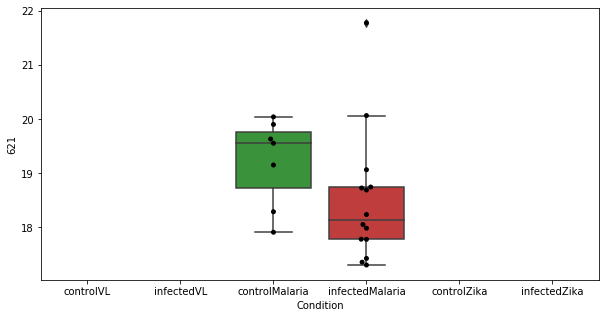

433 row m/z                                                         86.0964
row retention time                                              4.35611
p-val                                                          0.158048
adj.P.Val                                                      0.709612
custom_id                                                          4360
compound_names        N4-Acetylaminobutanal$L-Pipecolate; Pipecolini...
Name: 4360, dtype: object


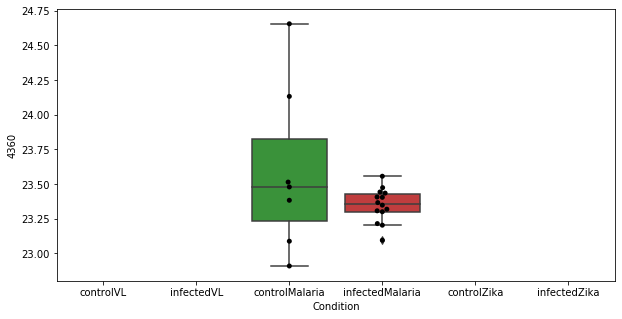

434 row m/z                276.107
row retention time     10.5636
p-val                 0.158596
adj.P.Val             0.709612
custom_id                 2091
compound_names             NaN
Name: 2091, dtype: object


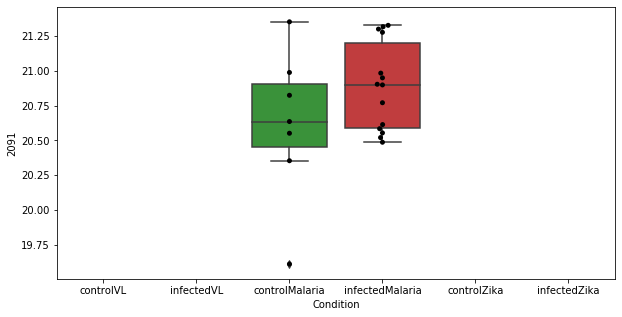

435 row m/z                 310.83
row retention time     7.10284
p-val                 0.158743
adj.P.Val             0.709612
custom_id                 2291
compound_names             NaN
Name: 2291, dtype: object


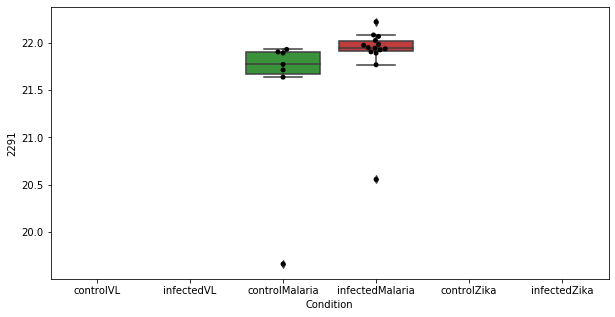

436 row m/z                173.129
row retention time     6.96894
p-val                 0.159998
adj.P.Val             0.713162
custom_id                 1110
compound_names             NaN
Name: 1110, dtype: object


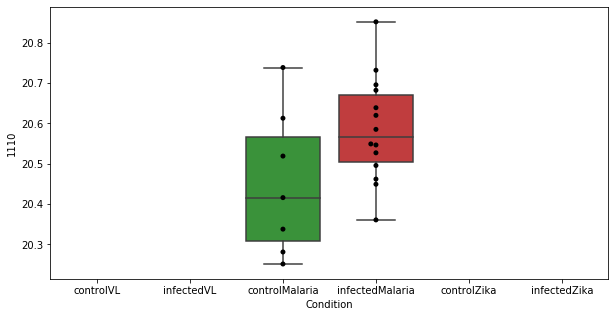

437 row m/z                 288.18
row retention time     3.74516
p-val                 0.160269
adj.P.Val             0.713162
custom_id                 2192
compound_names             NaN
Name: 2192, dtype: object


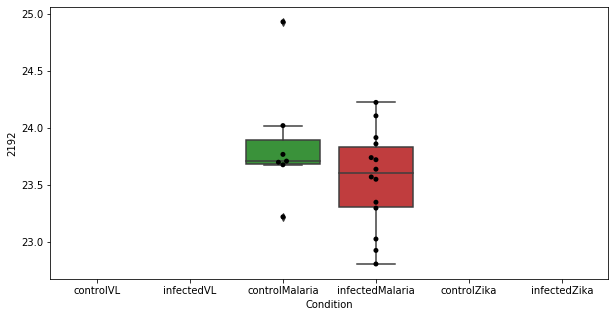

438 row m/z                318.191
row retention time     3.76608
p-val                 0.160929
adj.P.Val             0.713228
custom_id                 2329
compound_names             NaN
Name: 2329, dtype: object


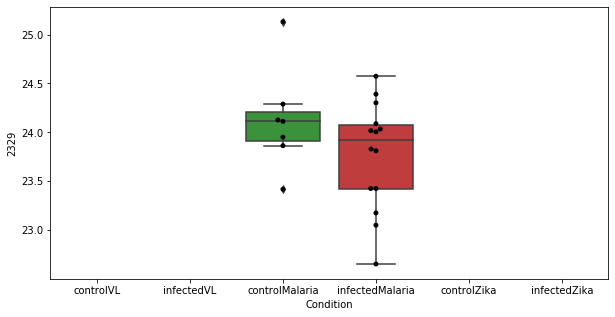

439 row m/z                283.818
row retention time     23.4747
p-val                 0.161144
adj.P.Val             0.713228
custom_id                 2158
compound_names             NaN
Name: 2158, dtype: object


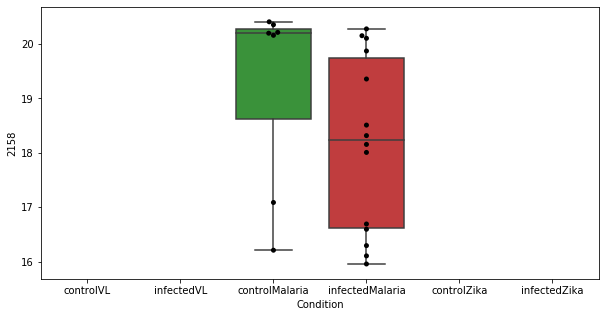

440 row m/z                 246.17
row retention time     3.91092
p-val                 0.161382
adj.P.Val             0.713228
custom_id                 1880
compound_names             NaN
Name: 1880, dtype: object


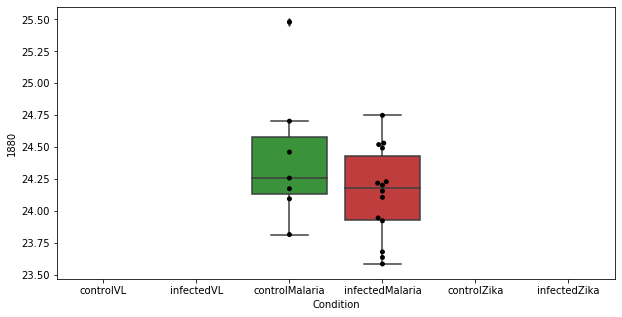

441 row m/z                 717.84
row retention time     9.25486
p-val                  0.16189
adj.P.Val             0.713856
custom_id                 2832
compound_names             NaN
Name: 2832, dtype: object


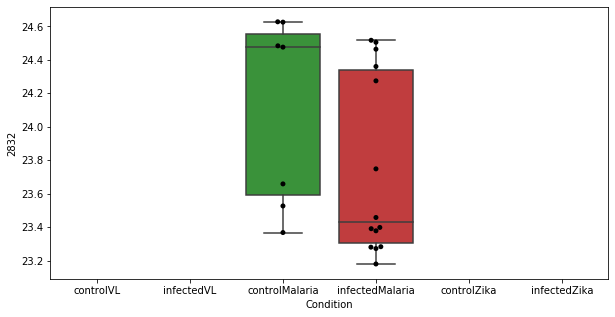

442 row m/z                512.335
row retention time     7.00536
p-val                 0.163093
adj.P.Val             0.716252
custom_id                 2639
compound_names             NaN
Name: 2639, dtype: object


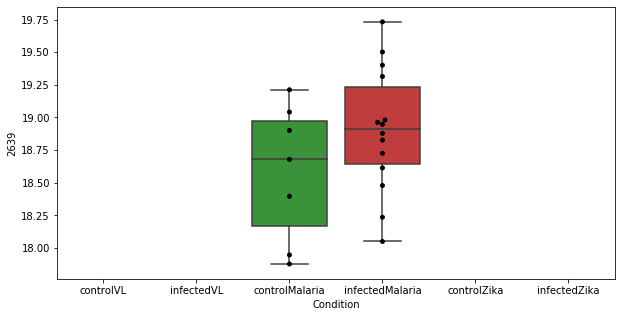

443 row m/z                238.914
row retention time     3.00756
p-val                 0.163169
adj.P.Val             0.716252
custom_id                 1810
compound_names             NaN
Name: 1810, dtype: object


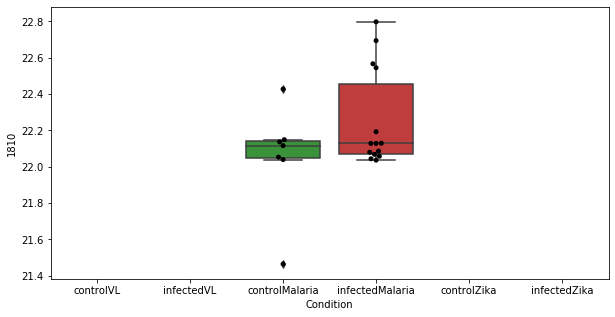

444 row m/z                 123.04
row retention time     4.78834
p-val                 0.163601
adj.P.Val             0.716535
custom_id                  418
compound_names             NaN
Name: 418, dtype: object


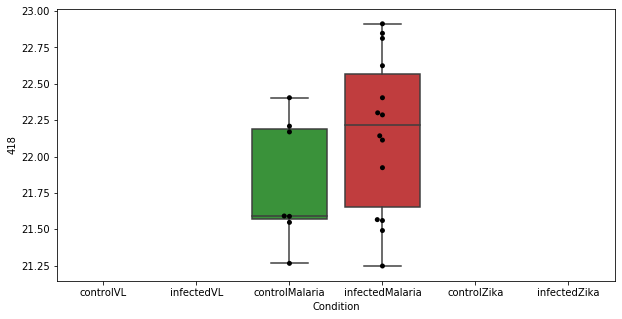

445 row m/z                120.093
row retention time     9.93887
p-val                 0.164111
adj.P.Val             0.717157
custom_id                  382
compound_names             NaN
Name: 382, dtype: object


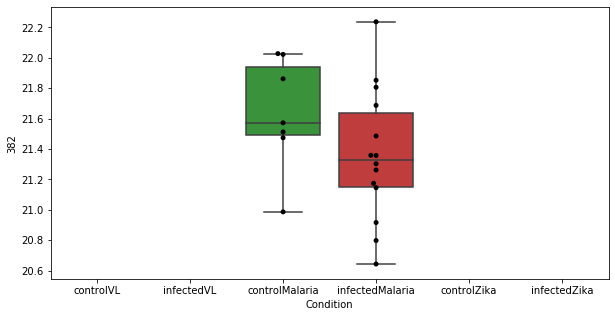

446 row m/z                127.087
row retention time     6.99844
p-val                 0.164517
adj.P.Val             0.717324
custom_id                  454
compound_names             NaN
Name: 454, dtype: object


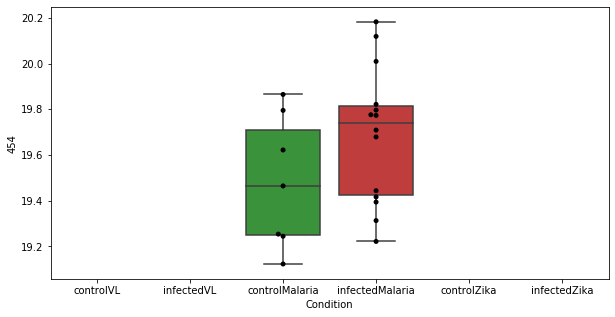

447 row m/z                253.143
row retention time     3.82162
p-val                 0.165224
adj.P.Val             0.718798
custom_id                 1938
compound_names             NaN
Name: 1938, dtype: object


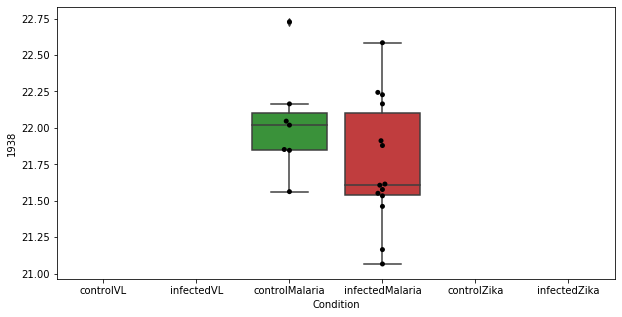

448 row m/z                228.123
row retention time     9.37357
p-val                  0.16786
adj.P.Val             0.727023
custom_id                 1698
compound_names             NaN
Name: 1698, dtype: object


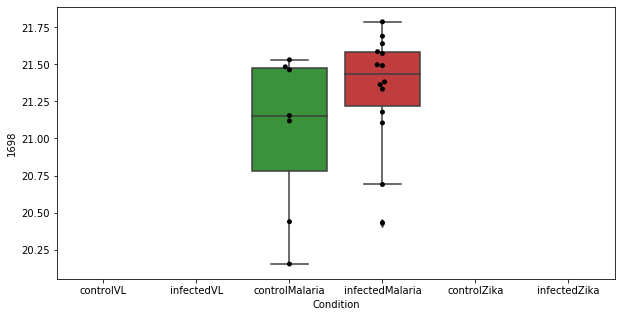

449 row m/z                                                         115.087
row retention time                                              16.7528
p-val                                                          0.167861
adj.P.Val                                                      0.727023
custom_id                                                           307
compound_names        L-Ornithine; (S)-2,5-Diaminovaleric acid; (S)-...
Name: 307, dtype: object


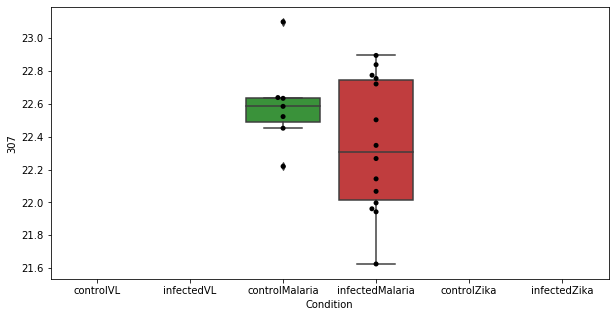

450 row m/z                                                         96.0444
row retention time                                              7.03006
p-val                                                          0.168468
adj.P.Val                                                      0.727739
custom_id                                                            97
compound_names        1-Pyrroline-2-carboxylate; 1-Pyrroline-2-carbo...
Name: 97, dtype: object


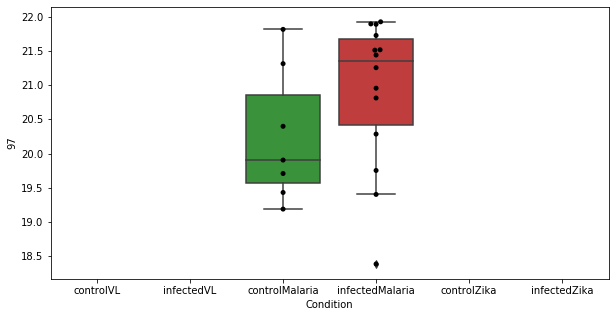

451 row m/z                                                         369.351
row retention time                                               3.7877
p-val                                                          0.168773
adj.P.Val                                                      0.727739
custom_id                                                          2453
compound_names        5alpha-Cholest-7-en-3beta-ol; Lathosterol$5alp...
Name: 2453, dtype: object


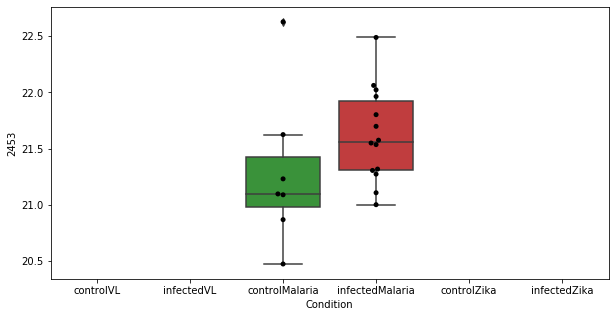

452 row m/z                                                         150.076
row retention time                                              7.02536
p-val                                                          0.170196
adj.P.Val                                                      0.732231
custom_id                                                           814
compound_names        2-Amino-4-oxopentanoic acid; 2-Amino-4-oxopent...
Name: 814, dtype: object


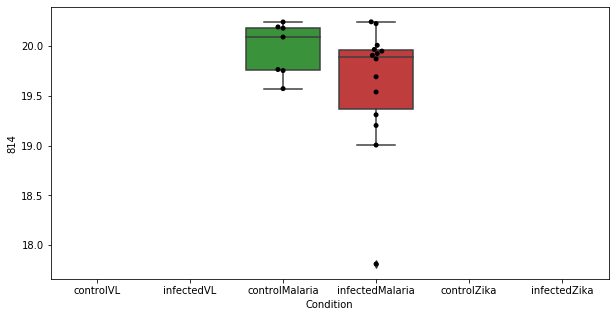

453 row m/z                233.124
row retention time     11.0699
p-val                 0.170645
adj.P.Val             0.732231
custom_id                 1745
compound_names             NaN
Name: 1745, dtype: object


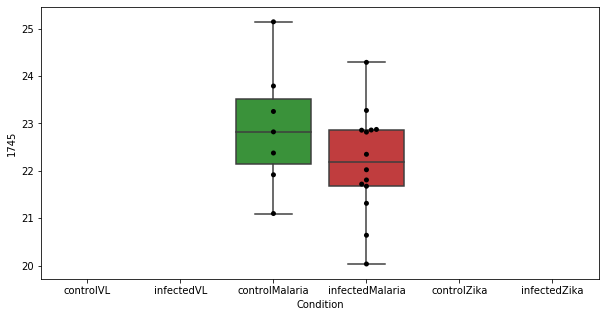

454 row m/z                176.092
row retention time     4.56964
p-val                 0.171045
adj.P.Val             0.732231
custom_id                 1143
compound_names             NaN
Name: 1143, dtype: object


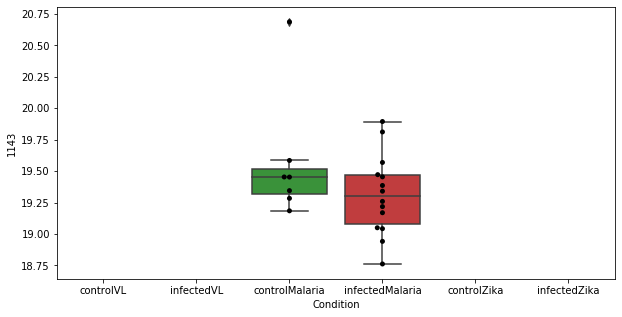

455 row m/z                149.013
row retention time     6.90181
p-val                 0.171317
adj.P.Val             0.732231
custom_id                 3374
compound_names             NaN
Name: 3374, dtype: object


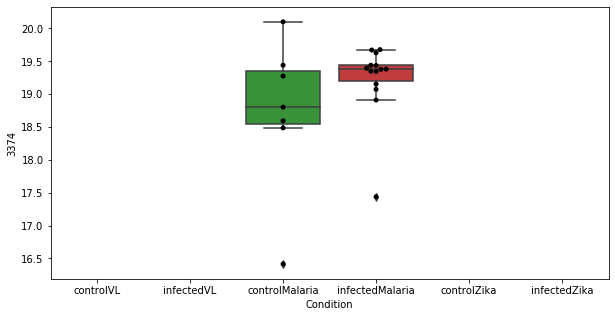

456 row m/z                214.099
row retention time     10.6351
p-val                 0.172075
adj.P.Val             0.732466
custom_id                 4929
compound_names             NaN
Name: 4929, dtype: object


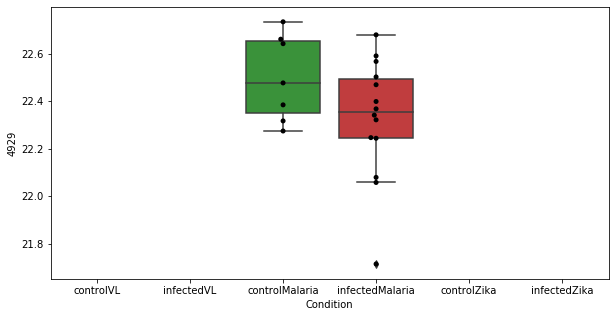

457 row m/z                 164.92
row retention time     14.3451
p-val                 0.172124
adj.P.Val             0.732466
custom_id                  982
compound_names             NaN
Name: 982, dtype: object


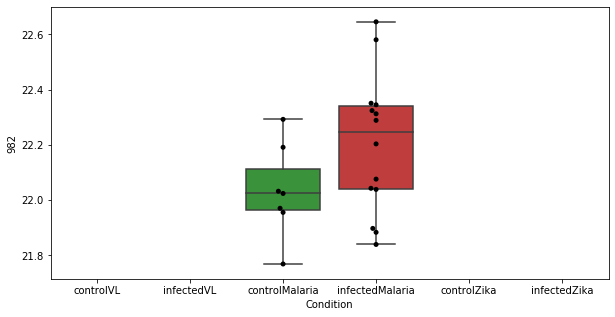

458 row m/z                130.159
row retention time     14.1567
p-val                 0.172751
adj.P.Val             0.733225
custom_id                  525
compound_names             NaN
Name: 525, dtype: object


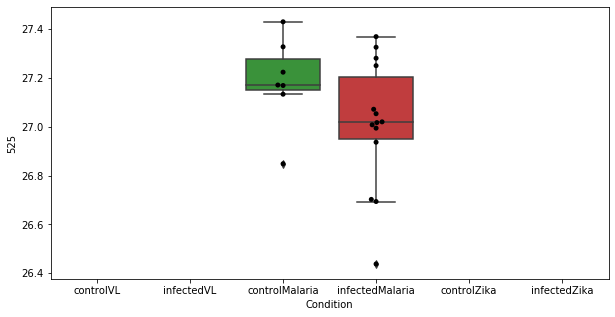

459 row m/z                158.118
row retention time      8.0328
p-val                 0.173638
adj.P.Val             0.733225
custom_id                  902
compound_names             NaN
Name: 902, dtype: object


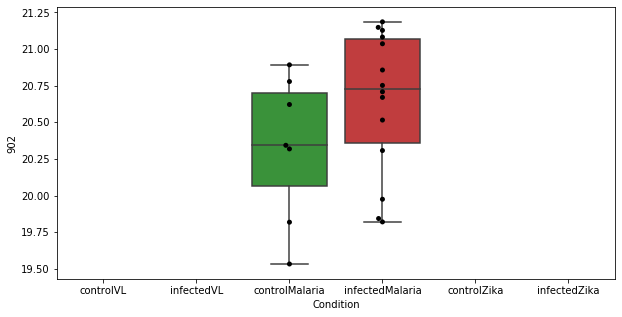

460 row m/z                 103.07
row retention time     10.0956
p-val                 0.173659
adj.P.Val             0.733225
custom_id                  155
compound_names             NaN
Name: 155, dtype: object


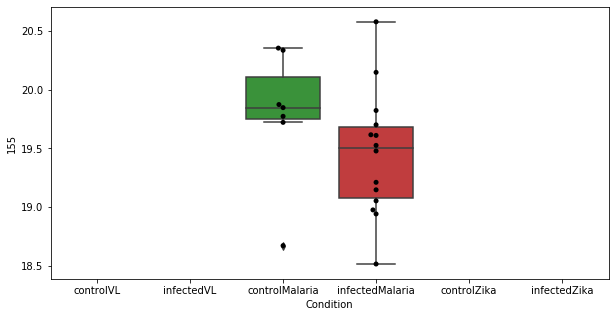

461 row m/z                216.058
row retention time     9.61937
p-val                 0.174317
adj.P.Val             0.733225
custom_id                 1599
compound_names             NaN
Name: 1599, dtype: object


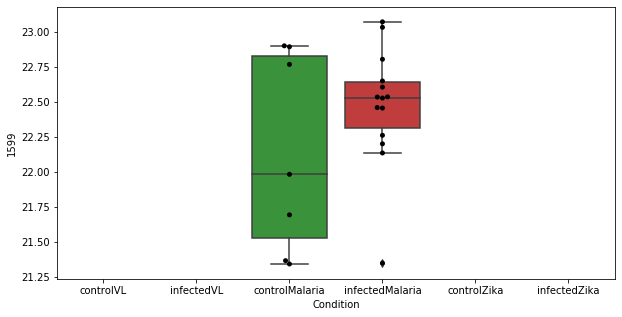

462 row m/z                                                         86.0964
row retention time                                              6.90088
p-val                                                          0.174637
adj.P.Val                                                      0.733225
custom_id                                                          4359
compound_names        L-Isoleucine; 2-Amino-3-methylvaleric acid$L-L...
Name: 4359, dtype: object


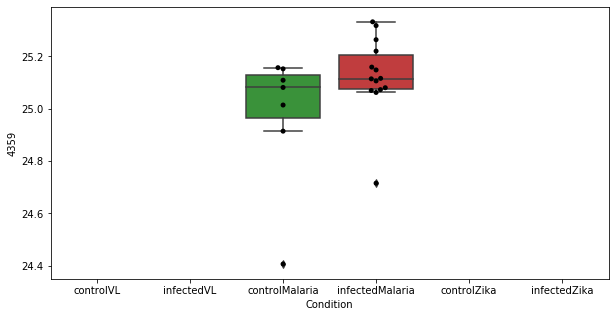

463 row m/z                239.139
row retention time       4.573
p-val                 0.174833
adj.P.Val             0.733225
custom_id                 1818
compound_names             NaN
Name: 1818, dtype: object


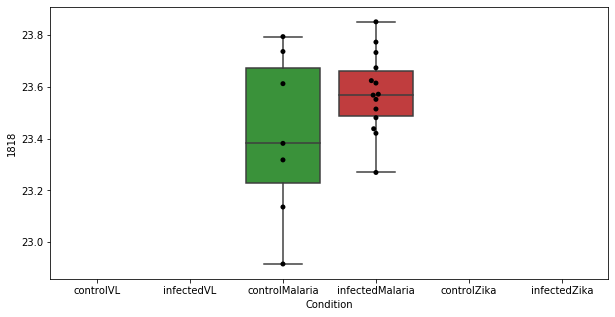

464 row m/z                131.162
row retention time     14.1667
p-val                 0.174936
adj.P.Val             0.733225
custom_id                  539
compound_names             NaN
Name: 539, dtype: object


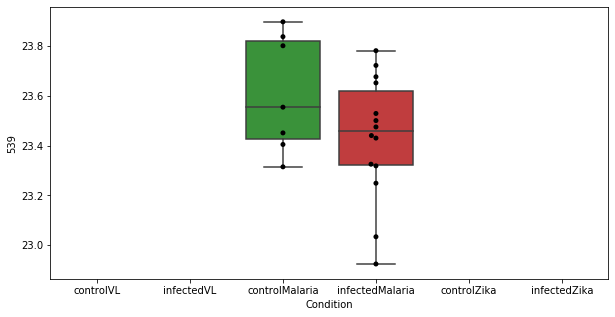

465 row m/z                171.076
row retention time     8.63434
p-val                 0.175682
adj.P.Val             0.733451
custom_id                 1074
compound_names             NaN
Name: 1074, dtype: object


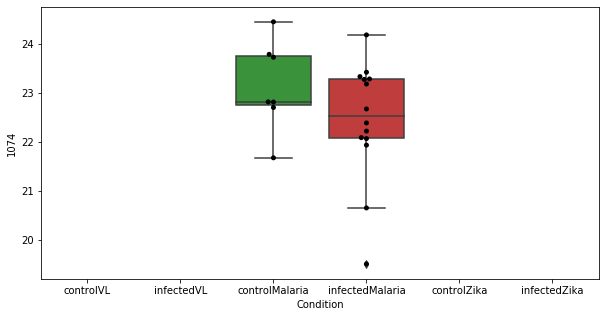

466 row m/z                313.176
row retention time      23.618
p-val                 0.175742
adj.P.Val             0.733451
custom_id                 2308
compound_names             NaN
Name: 2308, dtype: object


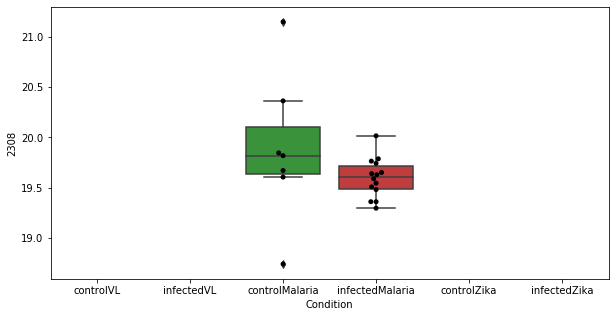

467 row m/z                245.977
row retention time     10.0852
p-val                 0.176835
adj.P.Val             0.735943
custom_id                 1871
compound_names             NaN
Name: 1871, dtype: object


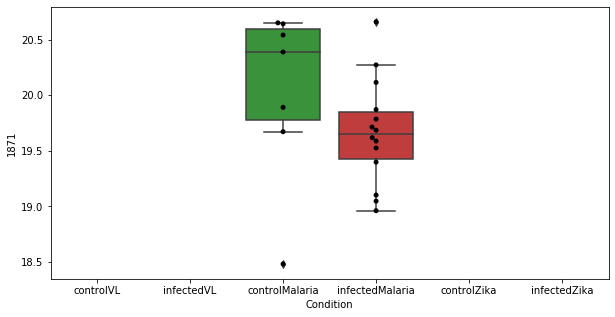

468 row m/z                168.113
row retention time     4.89378
p-val                 0.177443
adj.P.Val             0.735943
custom_id                 4737
compound_names             NaN
Name: 4737, dtype: object


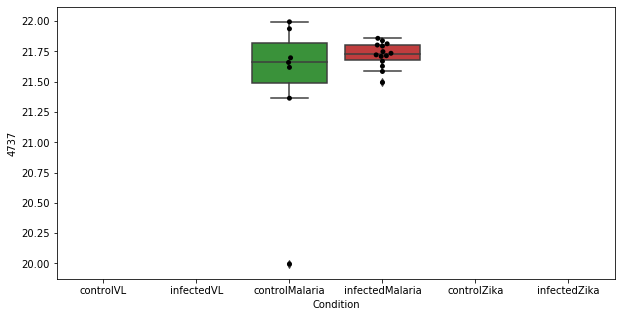

469 row m/z                 226.18
row retention time     4.06642
p-val                 0.178097
adj.P.Val             0.735943
custom_id                 1676
compound_names             NaN
Name: 1676, dtype: object


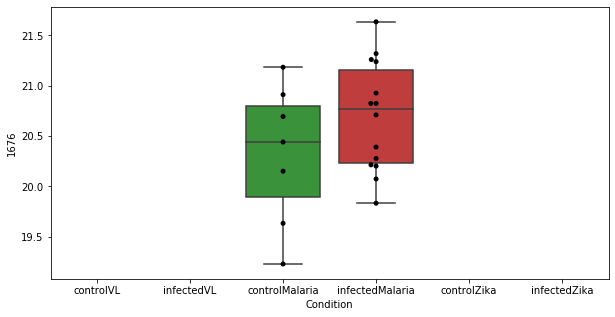

470 row m/z                194.084
row retention time     4.66443
p-val                 0.178329
adj.P.Val             0.735943
custom_id                 5814
compound_names             NaN
Name: 5814, dtype: object


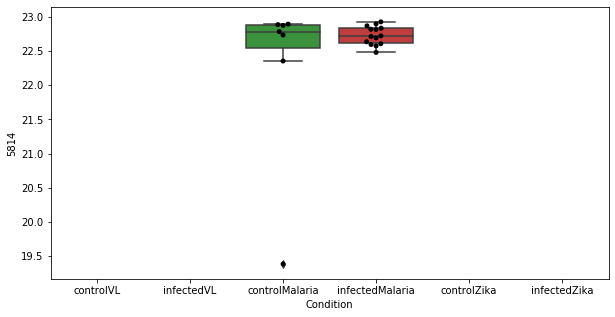

471 row m/z                187.088
row retention time     3.99596
p-val                 0.178485
adj.P.Val             0.735943
custom_id                 1267
compound_names             NaN
Name: 1267, dtype: object


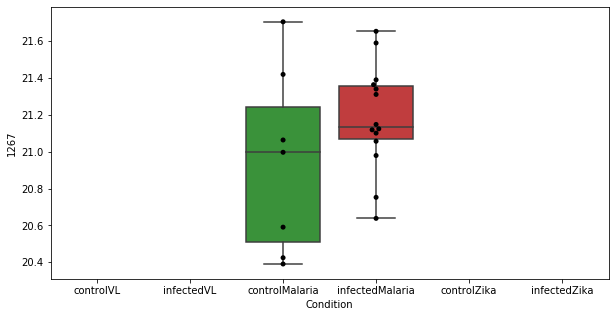

472 row m/z                240.134
row retention time     4.58597
p-val                 0.178605
adj.P.Val             0.735943
custom_id                 1827
compound_names             NaN
Name: 1827, dtype: object


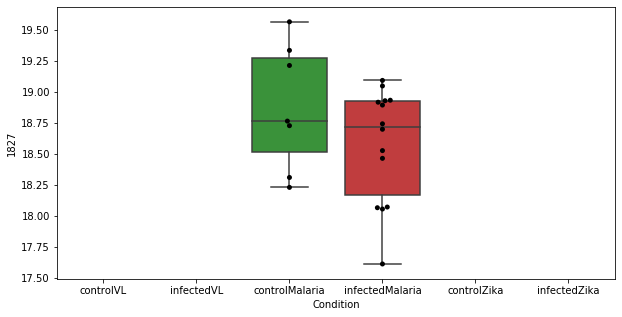

473 row m/z                208.155
row retention time     4.17023
p-val                 0.180526
adj.P.Val             0.741349
custom_id                 1494
compound_names             NaN
Name: 1494, dtype: object


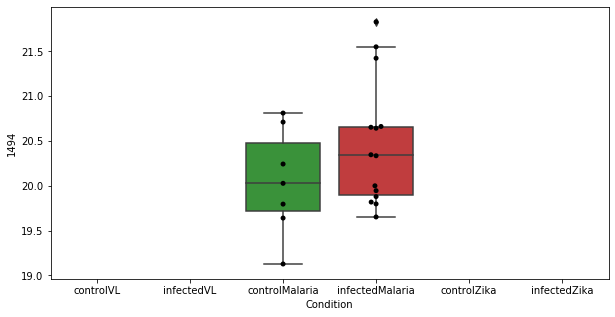

474 row m/z                 553.39
row retention time     4.63047
p-val                 0.180678
adj.P.Val             0.741349
custom_id                 2699
compound_names             NaN
Name: 2699, dtype: object


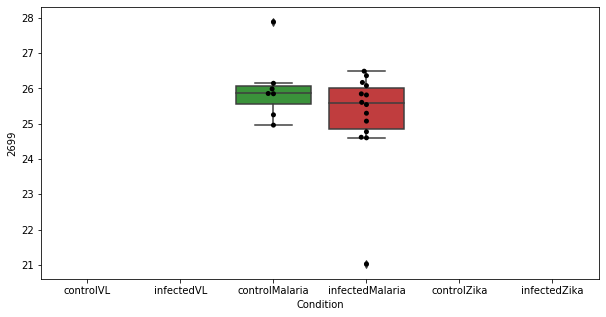

475 row m/z                129.127
row retention time     8.43647
p-val                 0.181967
adj.P.Val             0.741496
custom_id                  502
compound_names             NaN
Name: 502, dtype: object


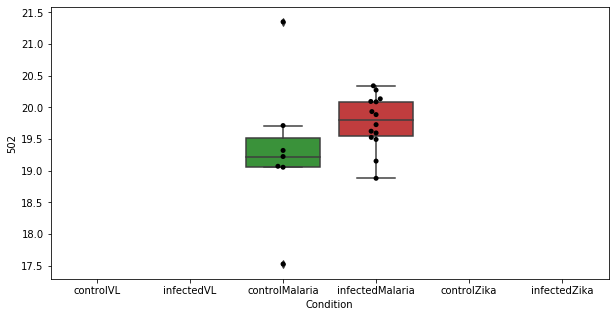

476 row m/z                                                         188.092
row retention time                                              6.99745
p-val                                                          0.182023
adj.P.Val                                                      0.741496
custom_id                                                          1276
compound_names        L-Noradrenaline; Noradrenaline; Norepinephrine...
Name: 1276, dtype: object


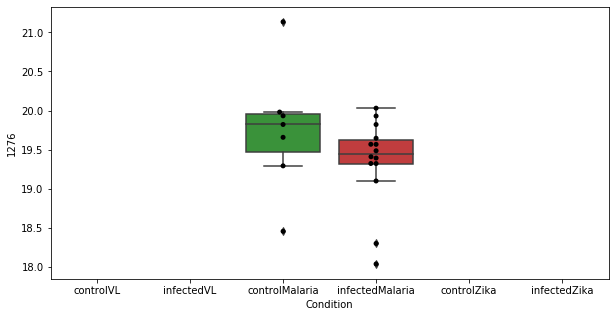

477 row m/z                276.107
row retention time     13.6478
p-val                 0.182068
adj.P.Val             0.741496
custom_id                 2092
compound_names             NaN
Name: 2092, dtype: object


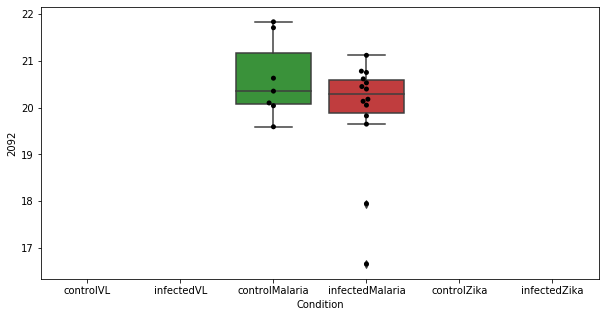

478 row m/z                246.243
row retention time      2.9139
p-val                 0.182235
adj.P.Val             0.741496
custom_id                 3834
compound_names             NaN
Name: 3834, dtype: object


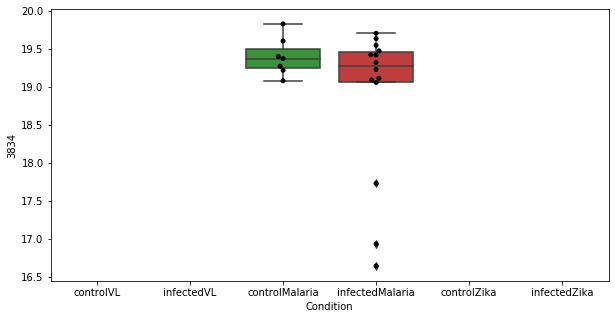

479 row m/z                            110.071
row retention time                 12.3439
p-val                              0.18301
adj.P.Val                         0.743095
custom_id                              225
compound_names        4-Guanidinobutanoate
Name: 225, dtype: object


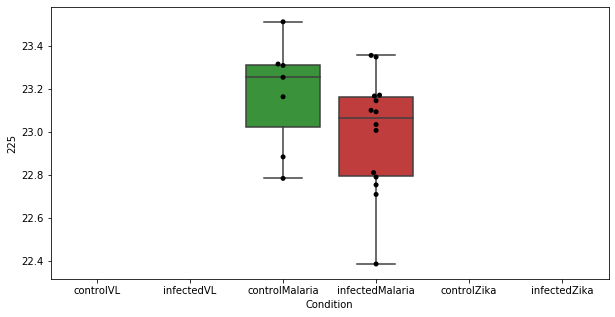

480 row m/z                                                           134.1
row retention time                                              16.7548
p-val                                                          0.184117
adj.P.Val                                                      0.745264
custom_id                                                           593
compound_names        L-Ornithine; (S)-2,5-Diaminovaleric acid; (S)-...
Name: 593, dtype: object


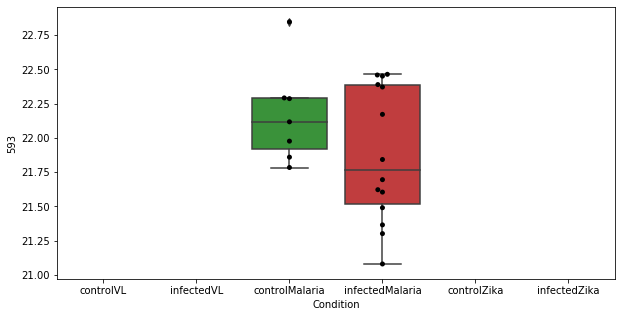

481 row m/z                262.888
row retention time     14.3615
p-val                 0.184309
adj.P.Val             0.745264
custom_id                 1995
compound_names             NaN
Name: 1995, dtype: object


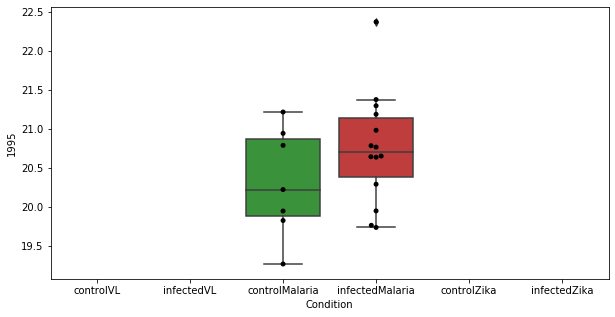

482 row m/z                123.081
row retention time     3.82706
p-val                 0.185207
adj.P.Val             0.747346
custom_id                  428
compound_names             NaN
Name: 428, dtype: object


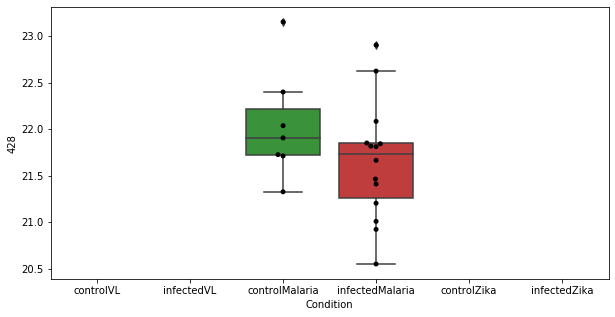

483 row m/z                195.123
row retention time     6.93524
p-val                 0.186149
adj.P.Val             0.749595
custom_id                 3611
compound_names             NaN
Name: 3611, dtype: object


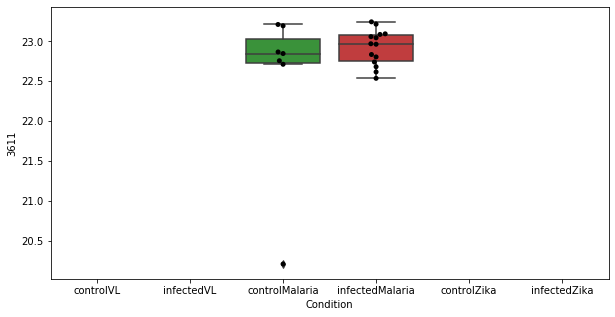

484 row m/z                300.181
row retention time     3.77827
p-val                  0.18673
adj.P.Val             0.749904
custom_id                 2248
compound_names             NaN
Name: 2248, dtype: object


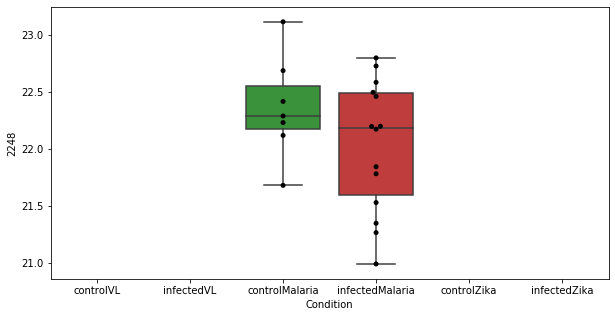

485 row m/z                229.126
row retention time     6.98819
p-val                 0.187131
adj.P.Val             0.749904
custom_id                 1712
compound_names             NaN
Name: 1712, dtype: object


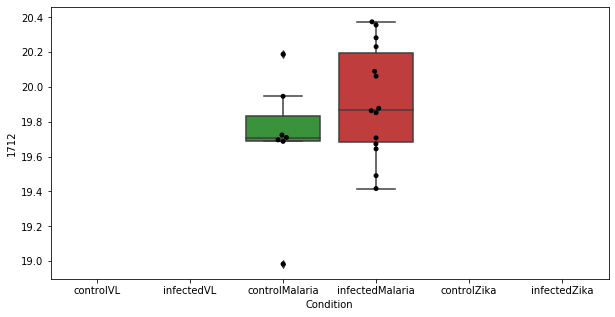

486 row m/z                664.457
row retention time     3.36989
p-val                 0.187445
adj.P.Val             0.749904
custom_id                 2799
compound_names             NaN
Name: 2799, dtype: object


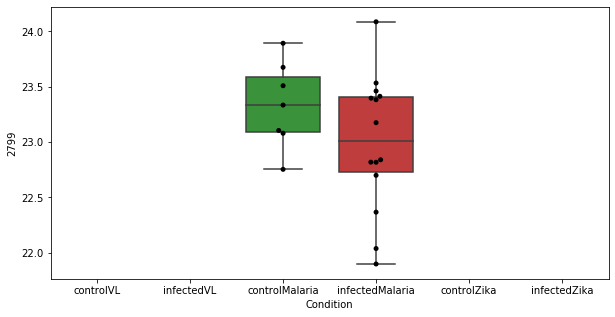

487 row m/z                                                         133.097
row retention time                                              16.7577
p-val                                                          0.187802
adj.P.Val                                                      0.749904
custom_id                                                           580
compound_names        L-Ornithine; (S)-2,5-Diaminovaleric acid; (S)-...
Name: 580, dtype: object


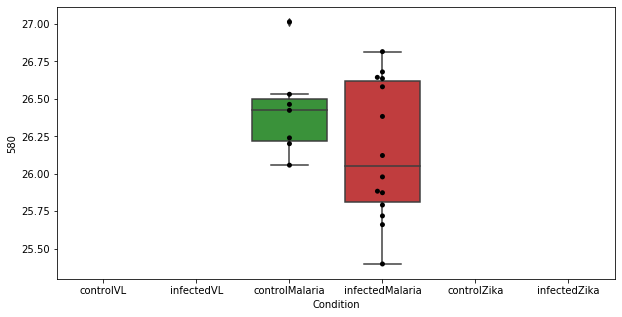

488 row m/z                 246.17
row retention time     5.06089
p-val                 0.188149
adj.P.Val             0.749904
custom_id                 1882
compound_names             NaN
Name: 1882, dtype: object


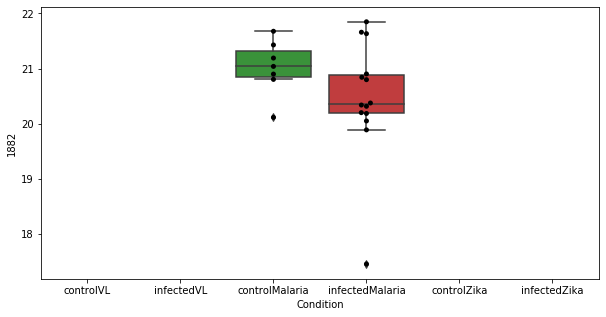

489 row m/z                                                         172.133
row retention time                                              4.41164
p-val                                                          0.188552
adj.P.Val                                                      0.749975
custom_id                                                          1103
compound_names        Ecgonine methyl ester; Methyl ecgonine$ecgonin...
Name: 1103, dtype: object


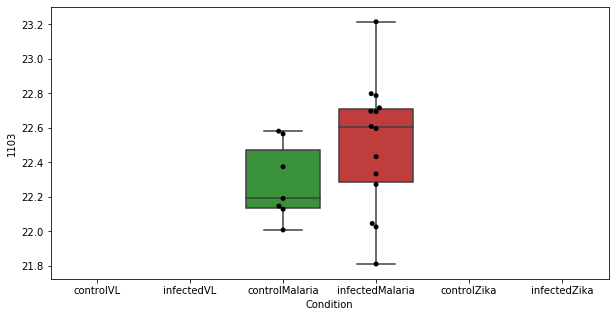

490 row m/z                215.128
row retention time     4.21507
p-val                 0.189517
adj.P.Val             0.752279
custom_id                 1595
compound_names             NaN
Name: 1595, dtype: object


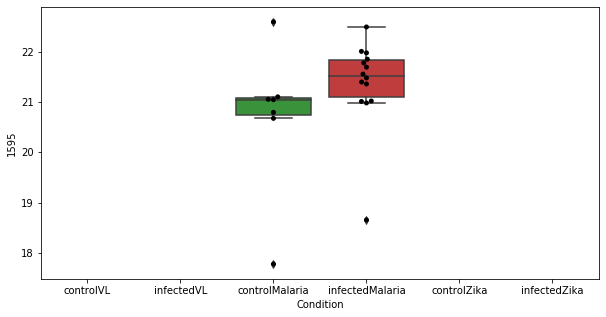

491 row m/z                                                         188.092
row retention time                                              4.57382
p-val                                                          0.190167
adj.P.Val                                                      0.753324
custom_id                                                          1277
compound_names        6-Acetamido-2-oxohexanoate; 2-Oxo-6-acetamidoc...
Name: 1277, dtype: object


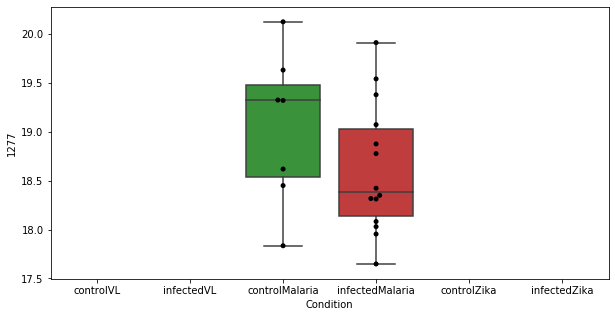

492 row m/z                                                          139.05
row retention time                                              10.0247
p-val                                                          0.190988
adj.P.Val                                                      0.754596
custom_id                                                           627
compound_names        4-Imidazolone-5-propanoate; 4-Imidazolone-5-pr...
Name: 627, dtype: object


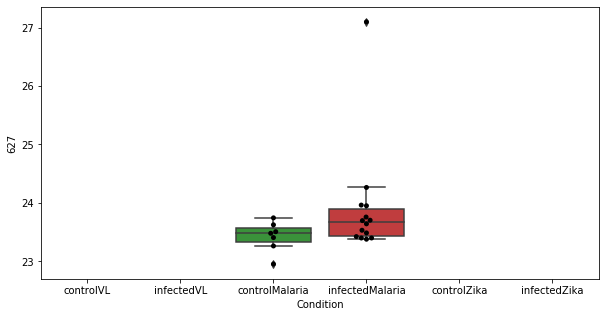

493 row m/z                259.025
row retention time     12.3993
p-val                 0.191441
adj.P.Val             0.754596
custom_id                 1974
compound_names             NaN
Name: 1974, dtype: object


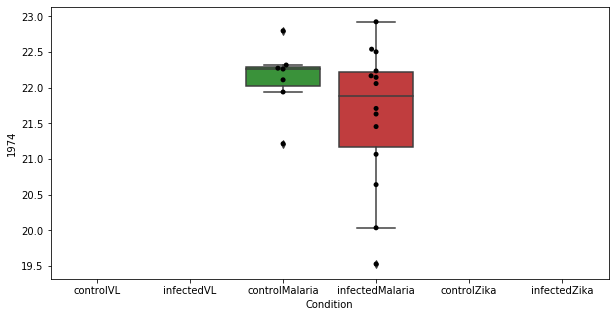

494 row m/z                                                         205.097
row retention time                                              10.3559
p-val                                                           0.19165
adj.P.Val                                                      0.754596
custom_id                                                          1477
compound_names        L-Tryptophan; Tryptophan; (S)-alpha-Amino-beta...
Name: 1477, dtype: object


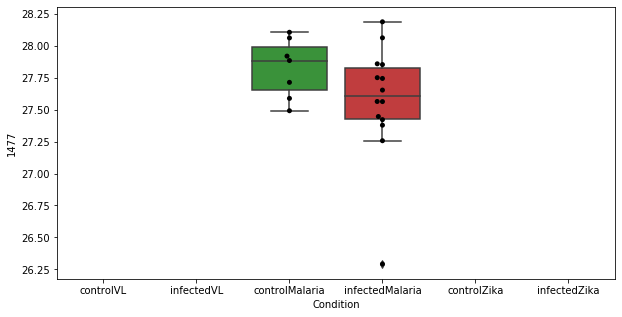

495 row m/z                548.865
row retention time     13.0645
p-val                 0.192669
adj.P.Val             0.755626
custom_id                 2694
compound_names             NaN
Name: 2694, dtype: object


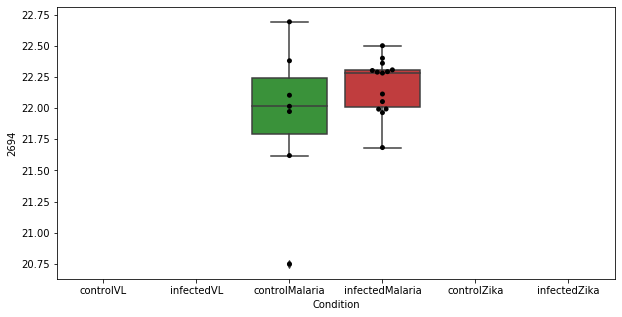

496 row m/z                 119.09
row retention time     8.15495
p-val                 0.192687
adj.P.Val             0.755626
custom_id                  363
compound_names             NaN
Name: 363, dtype: object


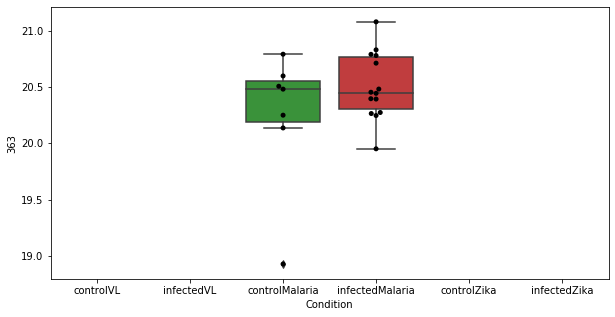

497 row m/z                636.758
row retention time      9.2378
p-val                  0.19439
adj.P.Val             0.758828
custom_id                 2775
compound_names             NaN
Name: 2775, dtype: object


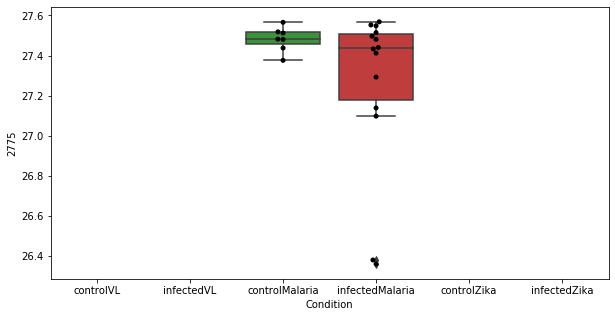

498 row m/z                                                         146.081
row retention time                                              8.63557
p-val                                                          0.194455
adj.P.Val                                                      0.758828
custom_id                                                           736
compound_names        6-Amino-2-oxohexanoate; 2-Oxo-6-aminocaproate$...
Name: 736, dtype: object


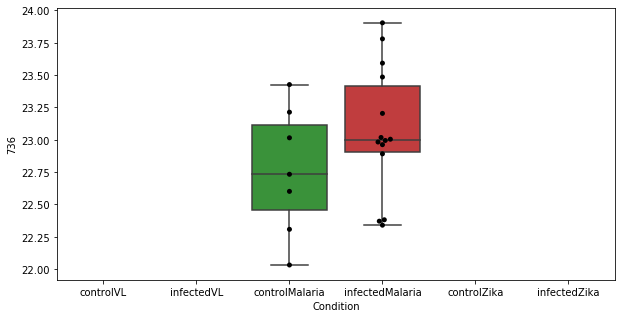

499 row m/z                223.112
row retention time     3.94681
p-val                 0.194748
adj.P.Val             0.758828
custom_id                 1659
compound_names             NaN
Name: 1659, dtype: object


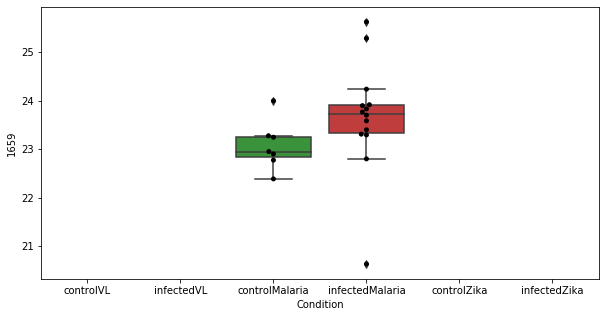

500 row m/z                308.832
row retention time     7.12307
p-val                 0.195702
adj.P.Val             0.758828
custom_id                 5140
compound_names             NaN
Name: 5140, dtype: object


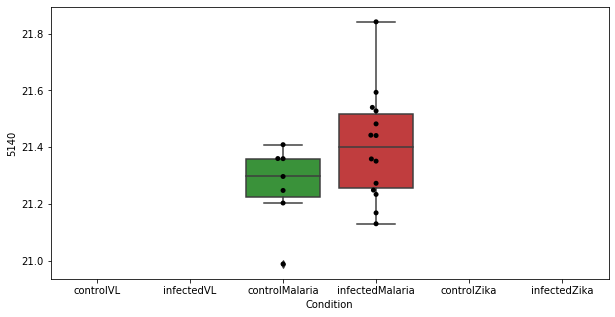

501 row m/z                290.269
row retention time     6.85365
p-val                 0.196319
adj.P.Val             0.758828
custom_id                 2210
compound_names             NaN
Name: 2210, dtype: object


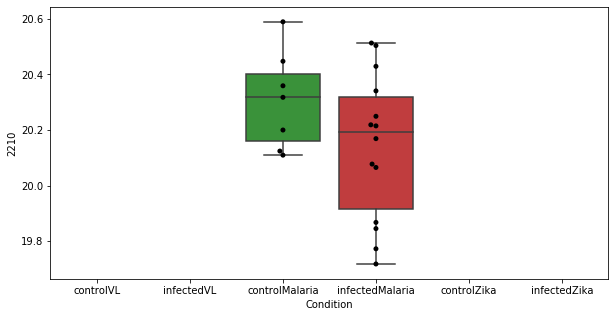

502 row m/z                246.133
row retention time      6.9943
p-val                 0.196959
adj.P.Val             0.758828
custom_id                 3831
compound_names             NaN
Name: 3831, dtype: object


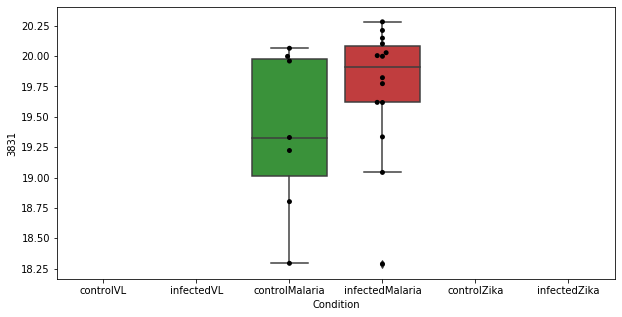

503 row m/z                272.185
row retention time     6.99225
p-val                 0.197264
adj.P.Val             0.758828
custom_id                 5070
compound_names             NaN
Name: 5070, dtype: object


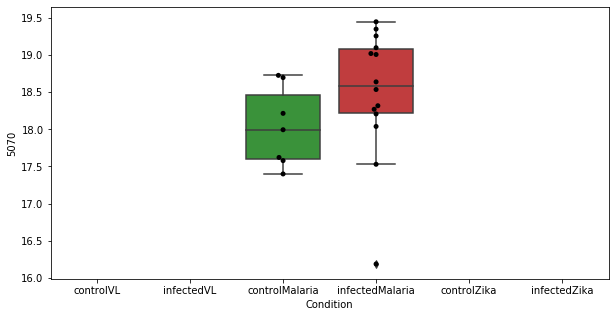

504 row m/z                195.113
row retention time     7.00013
p-val                 0.197552
adj.P.Val             0.758828
custom_id                 4858
compound_names             NaN
Name: 4858, dtype: object


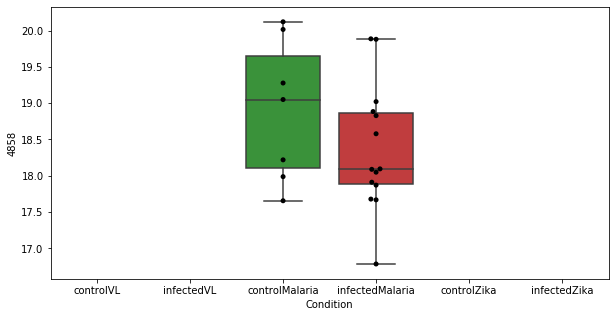

505 row m/z                304.168
row retention time     4.18916
p-val                 0.198136
adj.P.Val             0.758828
custom_id                 2260
compound_names             NaN
Name: 2260, dtype: object


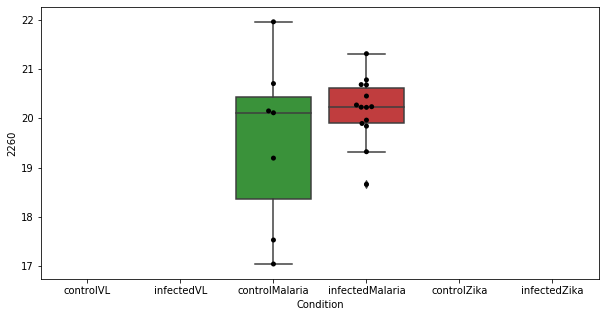

506 row m/z                 658.74
row retention time     8.70259
p-val                 0.198247
adj.P.Val             0.758828
custom_id                 2793
compound_names             NaN
Name: 2793, dtype: object


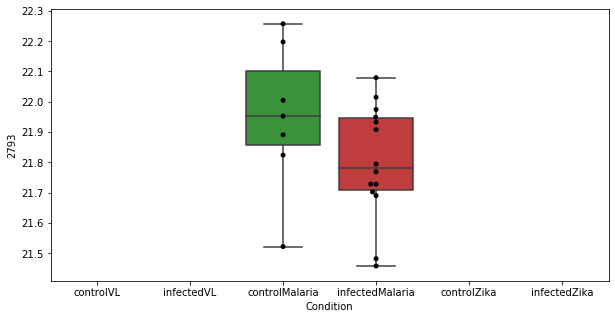

507 row m/z                202.917
row retention time     15.2544
p-val                 0.198451
adj.P.Val             0.758828
custom_id                 1458
compound_names             NaN
Name: 1458, dtype: object


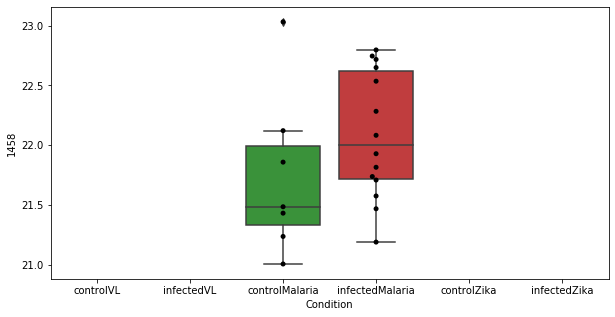

508 row m/z                 168.066
row retention time      6.99221
p-val                  0.199113
adj.P.Val              0.758828
custom_id                  1021
compound_names        Pyridoxal
Name: 1021, dtype: object


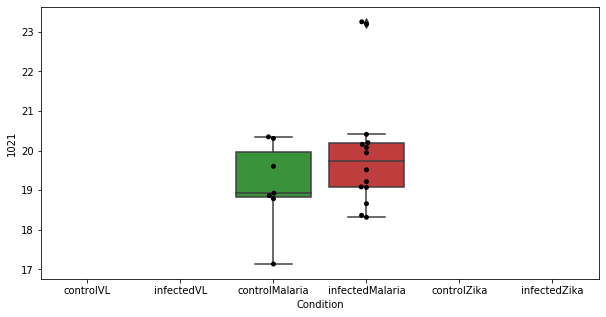

509 row m/z                197.117
row retention time     3.90512
p-val                 0.199662
adj.P.Val             0.758828
custom_id                 1407
compound_names             NaN
Name: 1407, dtype: object


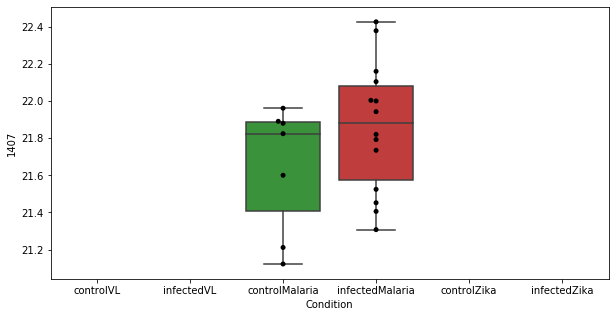

510 row m/z                 168.067
row retention time      23.8155
p-val                  0.199717
adj.P.Val              0.758828
custom_id                  1019
compound_names        Pyridoxal
Name: 1019, dtype: object


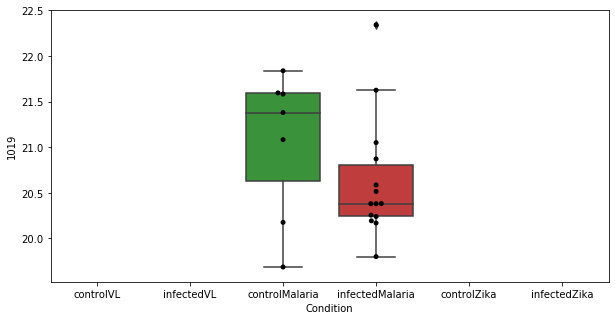

511 row m/z                123.972
row retention time     4.73774
p-val                 0.199934
adj.P.Val             0.758828
custom_id                  431
compound_names             NaN
Name: 431, dtype: object


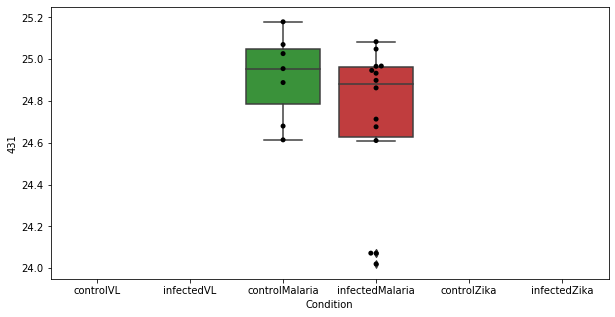

512 row m/z                637.762
row retention time     9.24742
p-val                 0.199965
adj.P.Val             0.758828
custom_id                 2779
compound_names             NaN
Name: 2779, dtype: object


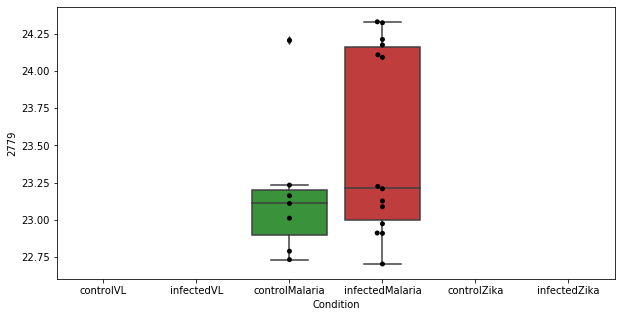

513 row m/z                           244.227
row retention time                3.75548
p-val                            0.200142
adj.P.Val                        0.758828
custom_id                            1868
compound_names        L-Octanoylcarnitine
Name: 1868, dtype: object


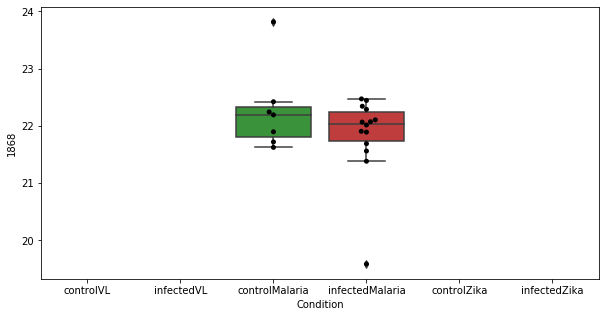

514 row m/z                                                         206.101
row retention time                                              10.3551
p-val                                                          0.200511
adj.P.Val                                                      0.758828
custom_id                                                          1485
compound_names        L-Tryptophan; Tryptophan; (S)-alpha-Amino-beta...
Name: 1485, dtype: object


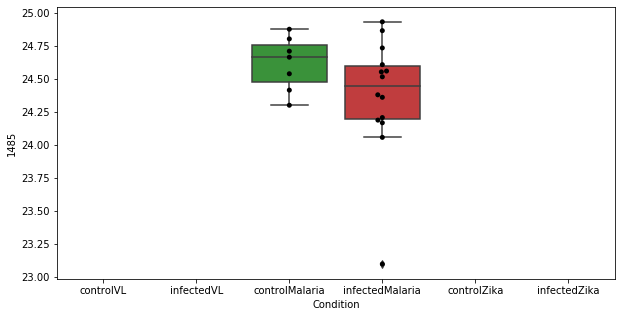

515 row m/z                161.092
row retention time     12.0711
p-val                 0.200914
adj.P.Val             0.758878
custom_id                  936
compound_names             NaN
Name: 936, dtype: object


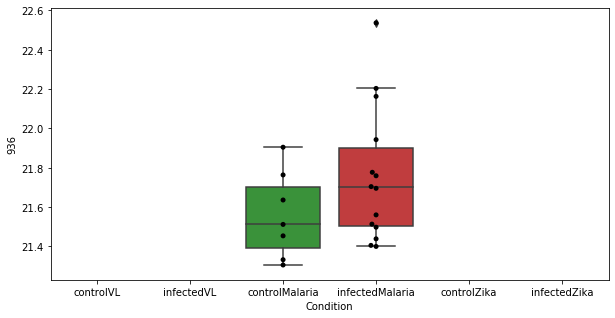

516 row m/z                86.9391
row retention time     4.73221
p-val                 0.201796
adj.P.Val             0.760735
custom_id                   71
compound_names             NaN
Name: 71, dtype: object


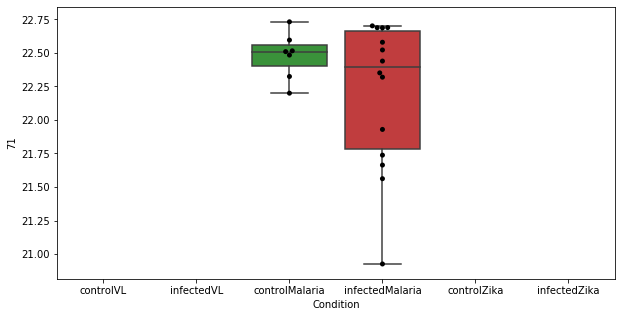

517 row m/z                139.112
row retention time     3.85416
p-val                 0.202941
adj.P.Val             0.761677
custom_id                  634
compound_names               $
Name: 634, dtype: object


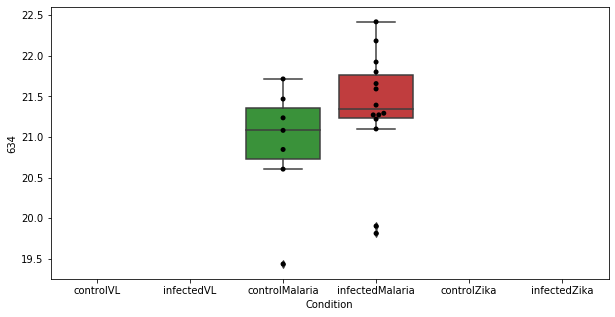

518 row m/z                788.669
row retention time     3.64906
p-val                 0.202998
adj.P.Val             0.761677
custom_id                 4286
compound_names             NaN
Name: 4286, dtype: object


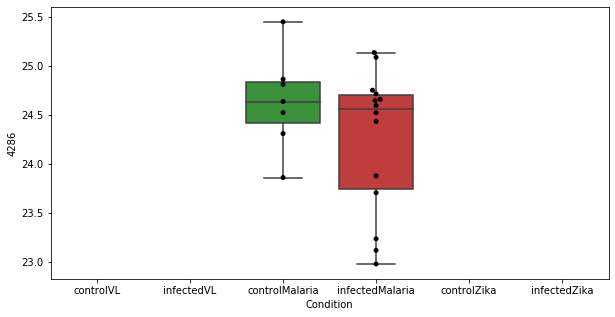

519 row m/z                                                         380.256
row retention time                                              4.42091
p-val                                                          0.203218
adj.P.Val                                                      0.761677
custom_id                                                          2474
compound_names        Sphingosine 1-phosphate; Sphing-4-enine 1-phos...
Name: 2474, dtype: object


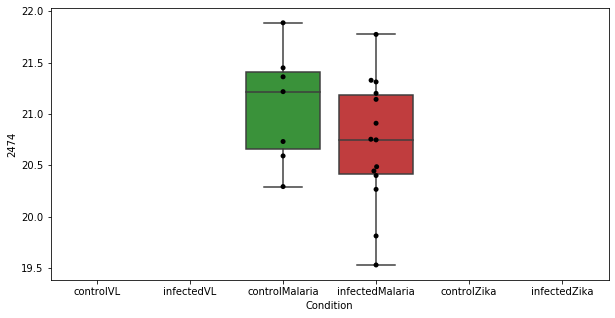

520 row m/z                                                         160.097
row retention time                                              7.01575
p-val                                                          0.203768
adj.P.Val                                                      0.762272
custom_id                                                           925
compound_names        6-Acetamido-2-oxohexanoate; 2-Oxo-6-acetamidoc...
Name: 925, dtype: object


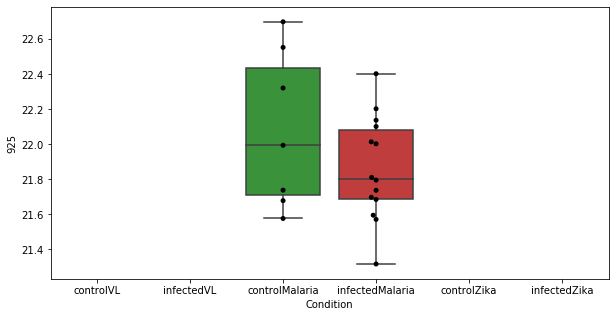

521 row m/z                                                  109.101
row retention time                                       3.82293
p-val                                                   0.206683
adj.P.Val                                               0.768175
custom_id                                                    217
compound_names        Octanoic acid; Caprylic acid; Octylic acid
Name: 217, dtype: object


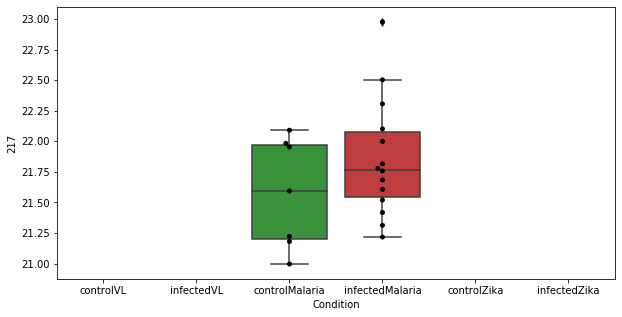

522 row m/z                142.939
row retention time     14.3735
p-val                 0.206751
adj.P.Val             0.768175
custom_id                  677
compound_names             NaN
Name: 677, dtype: object


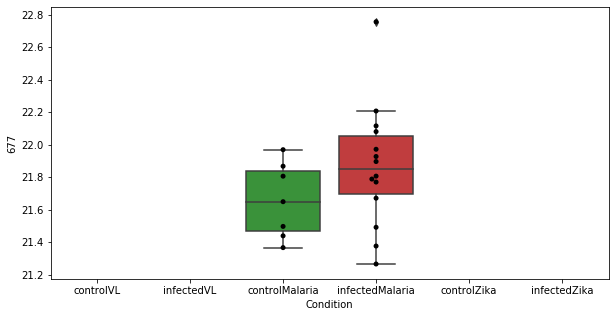

523 row m/z                                                           74.06
row retention time                                              12.0798
p-val                                                          0.207098
adj.P.Val                                                      0.768175
custom_id                                                          2992
compound_names        3-Aminopropanal$Aminoacetone; 1-Amino-2-propan...
Name: 2992, dtype: object


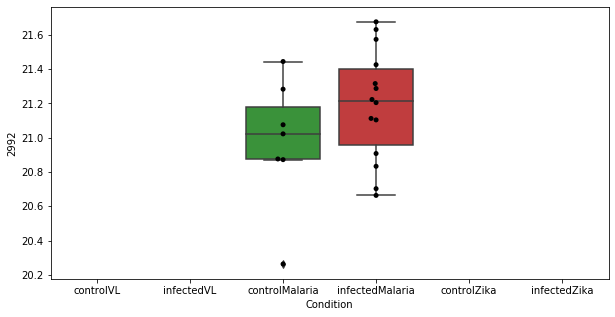

524 row m/z                                                         159.028
row retention time                                              9.39957
p-val                                                          0.207137
adj.P.Val                                                      0.768175
custom_id                                                           911
compound_names        D-glucurono-6,3-lactone$Ascorbate; Ascorbic ac...
Name: 911, dtype: object


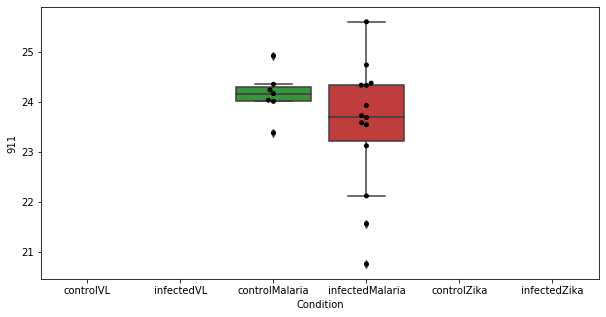

525 row m/z                 192.16
row retention time     4.65789
p-val                 0.208301
adj.P.Val             0.768175
custom_id                 3589
compound_names             NaN
Name: 3589, dtype: object


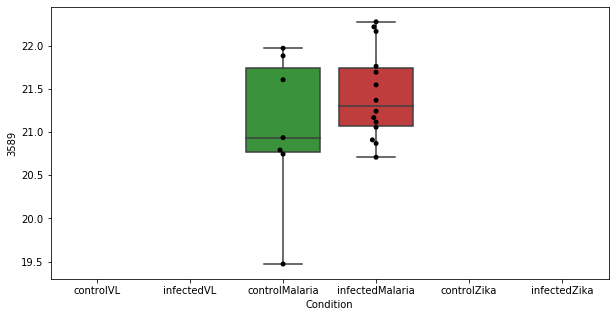

526 row m/z                 113.09
row retention time     10.5935
p-val                 0.208361
adj.P.Val             0.768175
custom_id                 4447
compound_names             NaN
Name: 4447, dtype: object


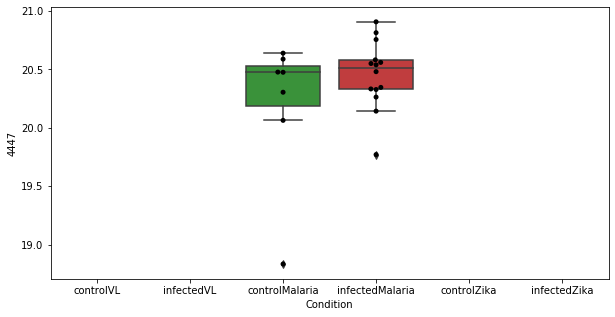

527 row m/z                                                         136.076
row retention time                                              4.41133
p-val                                                          0.208602
adj.P.Val                                                      0.768175
custom_id                                                           602
compound_names        Dopamine; 4-(2-Aminoethyl)-1,2-benzenediol; 4-...
Name: 602, dtype: object


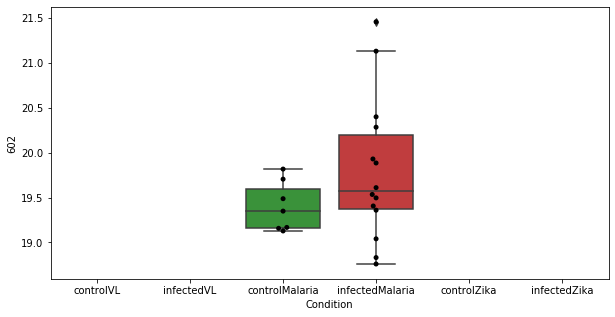

528 row m/z                583.817
row retention time     8.69552
p-val                 0.209859
adj.P.Val             0.768175
custom_id                 2734
compound_names             NaN
Name: 2734, dtype: object


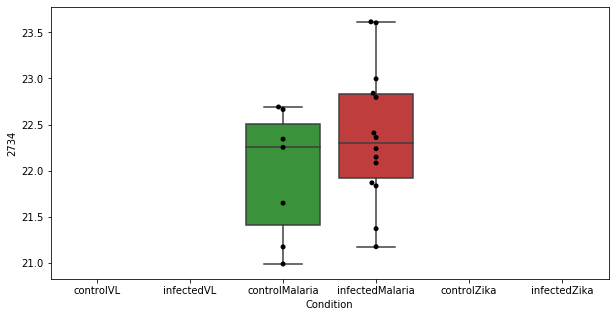

529 row m/z                286.201
row retention time     3.71817
p-val                  0.20988
adj.P.Val             0.768175
custom_id                 2179
compound_names             NaN
Name: 2179, dtype: object


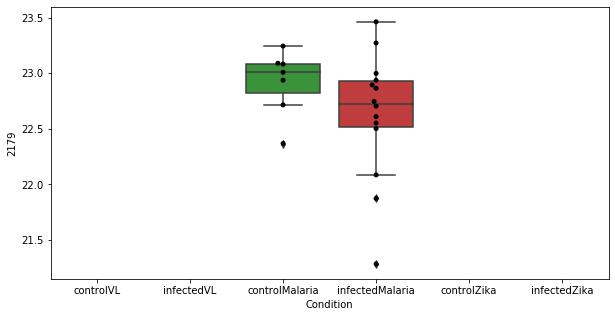

530 row m/z                445.164
row retention time    0.507239
p-val                 0.210103
adj.P.Val             0.768175
custom_id                 5237
compound_names             NaN
Name: 5237, dtype: object


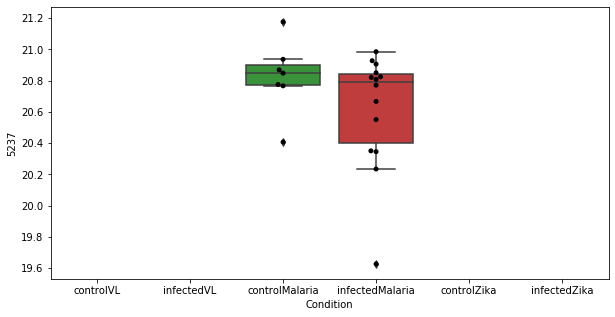

531 row m/z                660.837
row retention time     9.24226
p-val                 0.210676
adj.P.Val             0.768175
custom_id                 7009
compound_names             NaN
Name: 7009, dtype: object


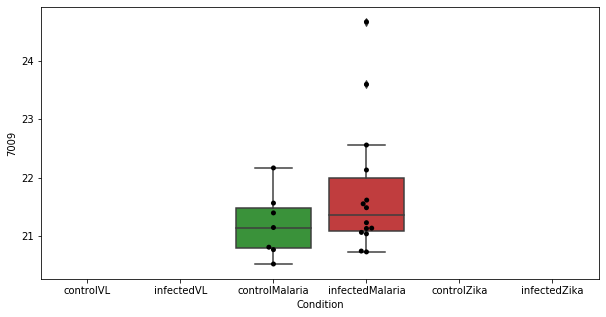

532 row m/z                         134.06
row retention time             8.04157
p-val                         0.210834
adj.P.Val                     0.768175
custom_id                          583
compound_names        leukoaminochrome
Name: 583, dtype: object


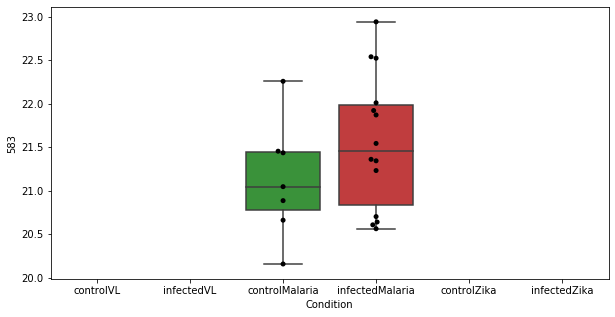

533 row m/z                94.9296
row retention time     15.2282
p-val                 0.211236
adj.P.Val             0.768175
custom_id                   93
compound_names             NaN
Name: 93, dtype: object


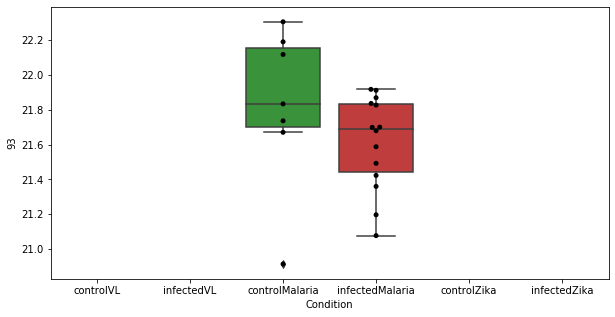

534 row m/z                                                         151.062
row retention time                                              10.1618
p-val                                                          0.211656
adj.P.Val                                                      0.768175
custom_id                                                           822
compound_names        L-Methionine; Methionine; L-2-Amino-4methylthi...
Name: 822, dtype: object


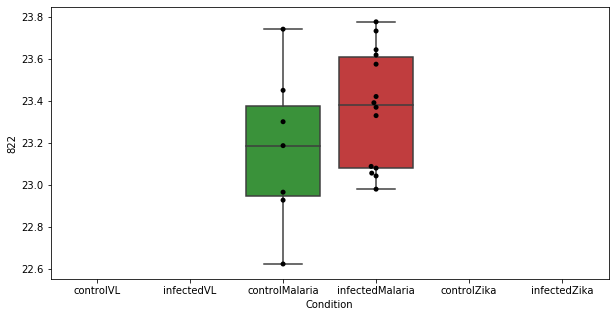

535 row m/z                119.083
row retention time     9.93461
p-val                 0.212412
adj.P.Val             0.768175
custom_id                  359
compound_names             NaN
Name: 359, dtype: object


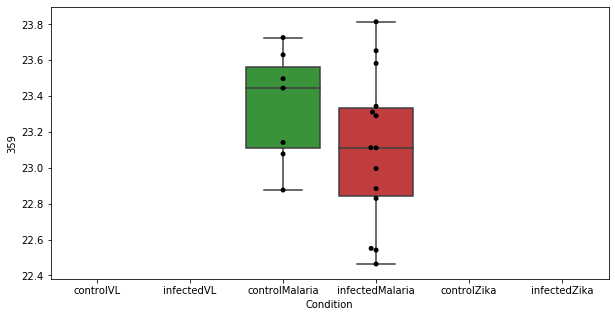

536 row m/z                225.185
row retention time     3.76799
p-val                 0.213276
adj.P.Val             0.768175
custom_id                 3736
compound_names             NaN
Name: 3736, dtype: object


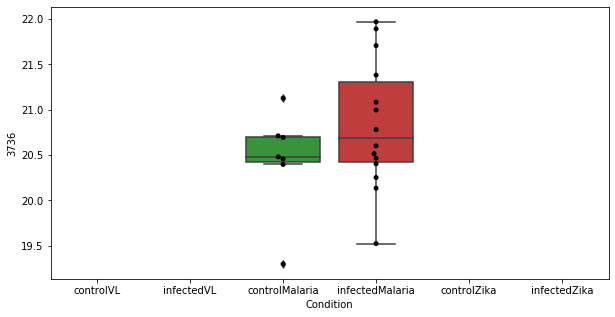

537 row m/z                677.785
row retention time     8.84377
p-val                 0.213719
adj.P.Val             0.768175
custom_id                 2805
compound_names             NaN
Name: 2805, dtype: object


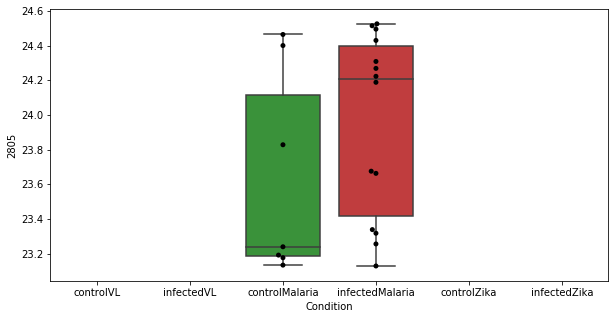

538 row m/z                210.113
row retention time      7.0036
p-val                 0.213967
adj.P.Val             0.768175
custom_id                 1523
compound_names             NaN
Name: 1523, dtype: object


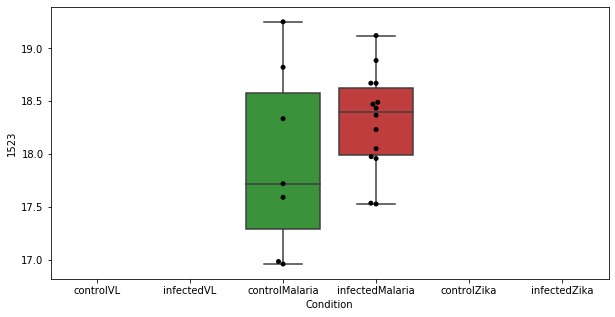

539 row m/z                                        194.118
row retention time                              4.7604
p-val                                         0.213971
adj.P.Val                                     0.768175
custom_id                                         1371
compound_names        (-)-Salsoline$N-methylsalsolinol
Name: 1371, dtype: object


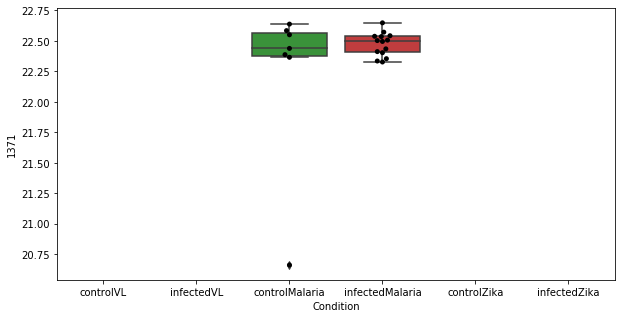

540 row m/z                      170.118
row retention time           6.99886
p-val                       0.214518
adj.P.Val                   0.768175
custom_id                       5736
compound_names        L-Metanephrine
Name: 5736, dtype: object


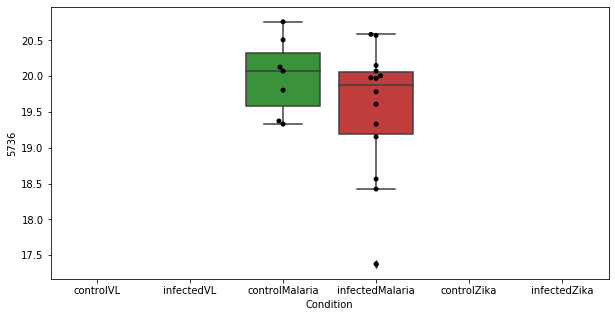

541 row m/z                209.973
row retention time     11.9217
p-val                 0.214564
adj.P.Val             0.768175
custom_id                 4901
compound_names             NaN
Name: 4901, dtype: object


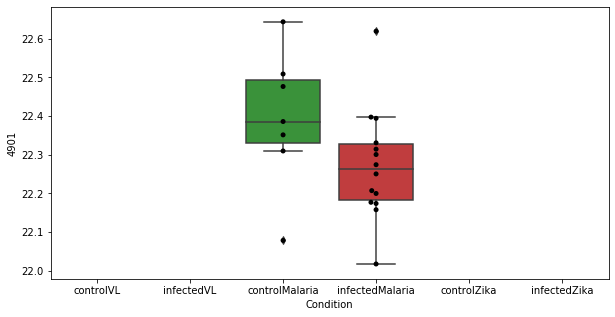

542 row m/z                                                         80.0495
row retention time                                              8.91735
p-val                                                          0.214922
adj.P.Val                                                      0.768175
custom_id                                                            35
compound_names        D-Proline$L-Proline; 2-Pyrrolidinecarboxylic a...
Name: 35, dtype: object


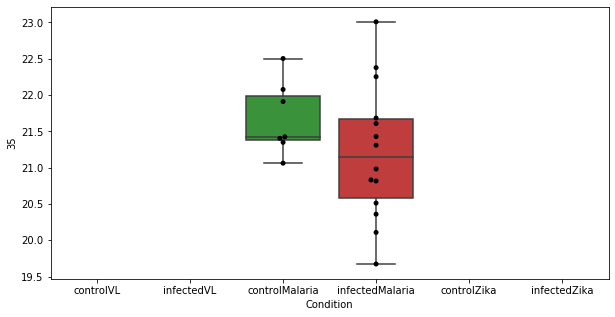

543 row m/z                139.018
row retention time     4.80507
p-val                 0.214937
adj.P.Val             0.768175
custom_id                  625
compound_names             NaN
Name: 625, dtype: object


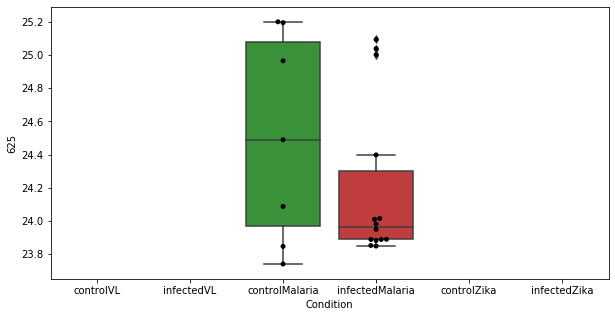

544 row m/z                 84.942
row retention time     4.71243
p-val                 0.215011
adj.P.Val             0.768175
custom_id                   59
compound_names             NaN
Name: 59, dtype: object


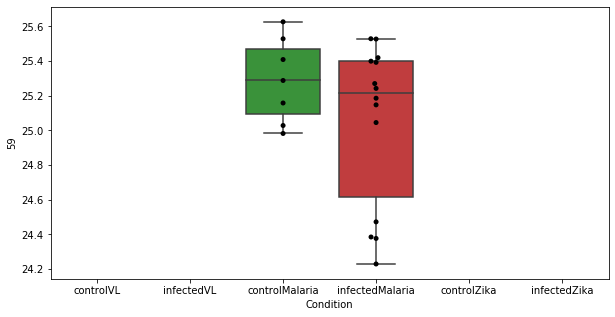

545 row m/z                423.183
row retention time      10.634
p-val                 0.215199
adj.P.Val             0.768175
custom_id                 2555
compound_names             NaN
Name: 2555, dtype: object


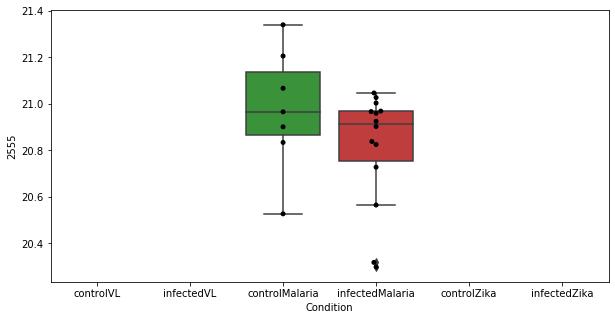

546 row m/z                252.928
row retention time     8.22404
p-val                 0.216311
adj.P.Val             0.770728
custom_id                 3858
compound_names             NaN
Name: 3858, dtype: object


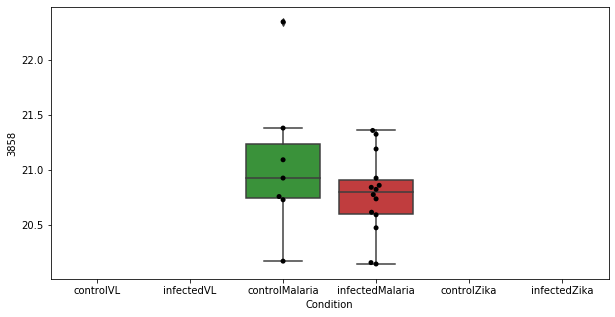

547 row m/z                189.074
row retention time     10.3599
p-val                 0.216705
adj.P.Val             0.770728
custom_id                 1294
compound_names             NaN
Name: 1294, dtype: object


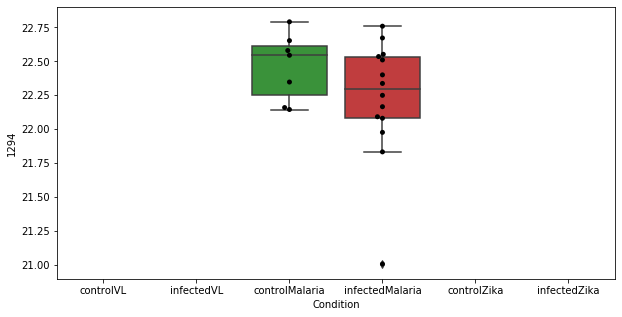

548 row m/z                248.912
row retention time     12.5792
p-val                 0.217349
adj.P.Val             0.770774
custom_id                 1891
compound_names             NaN
Name: 1891, dtype: object


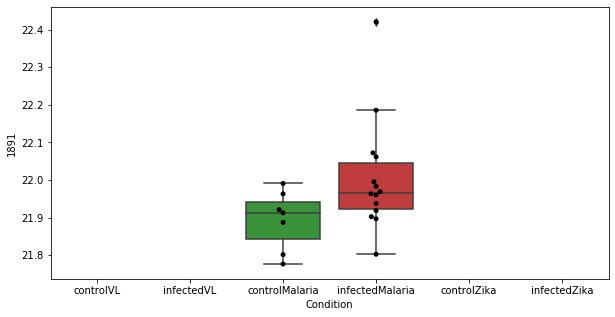

549 row m/z                217.107
row retention time     6.99548
p-val                  0.21767
adj.P.Val             0.770774
custom_id                 1611
compound_names             NaN
Name: 1611, dtype: object


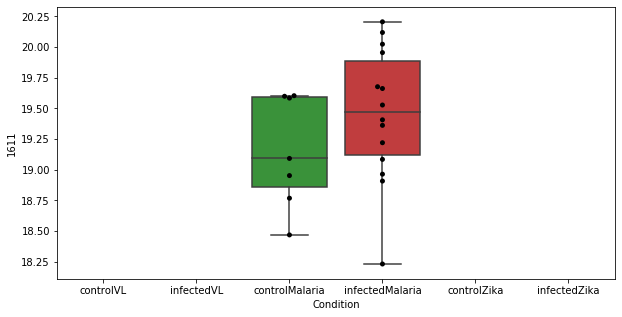

550 row m/z                                                   268.104
row retention time                                        23.6519
p-val                                                    0.218336
adj.P.Val                                                0.770774
custom_id                                                    2030
compound_names        Adenosine$Deoxyguanosine; 2'-Deoxyguanosine
Name: 2030, dtype: object


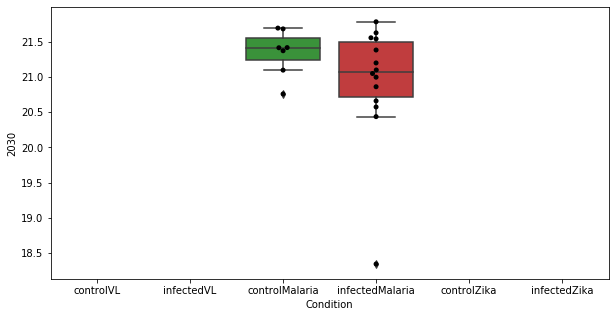

551 row m/z                214.091
row retention time     4.68546
p-val                 0.218384
adj.P.Val             0.770774
custom_id                 3681
compound_names             NaN
Name: 3681, dtype: object


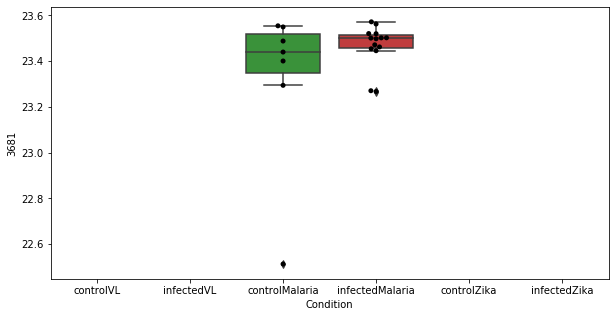

552 row m/z                592.493
row retention time     3.24218
p-val                 0.218696
adj.P.Val             0.770774
custom_id                 2743
compound_names             NaN
Name: 2743, dtype: object


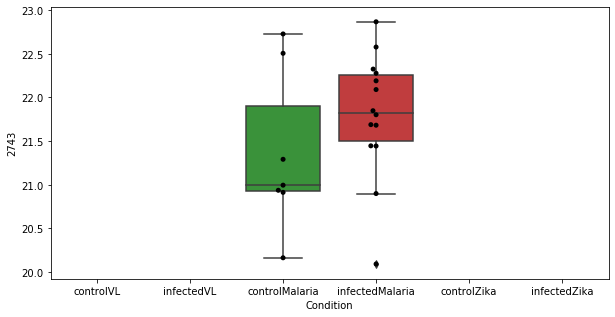

553 row m/z                180.894
row retention time     14.4227
p-val                 0.219424
adj.P.Val             0.771523
custom_id                 1195
compound_names             NaN
Name: 1195, dtype: object


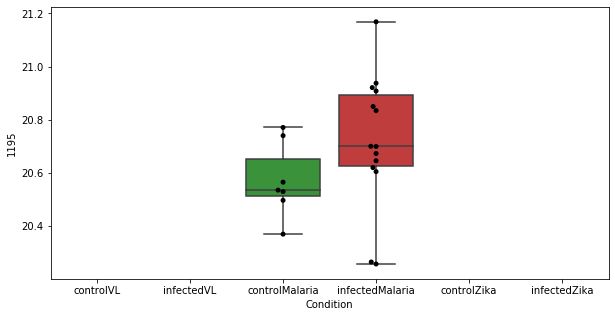

554 row m/z                256.154
row retention time     3.80786
p-val                   0.2197
adj.P.Val             0.771523
custom_id                 1951
compound_names             NaN
Name: 1951, dtype: object


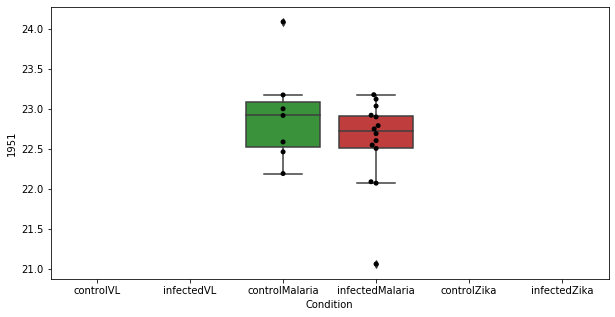

555 row m/z                275.103
row retention time     23.8258
p-val                 0.220275
adj.P.Val             0.771991
custom_id                 2086
compound_names             NaN
Name: 2086, dtype: object


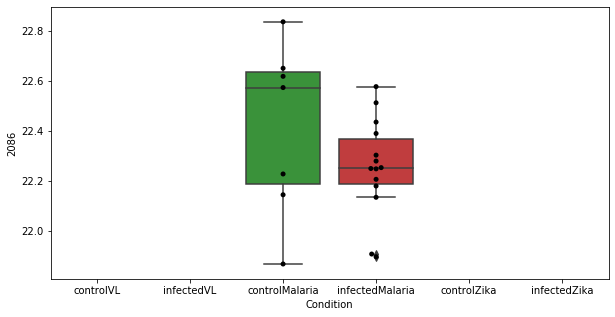

556 row m/z                                 137.046
row retention time                      9.40854
p-val                                  0.220625
adj.P.Val                              0.771991
custom_id                                   614
compound_names        Hypoxanthine; Purine-6-ol
Name: 614, dtype: object


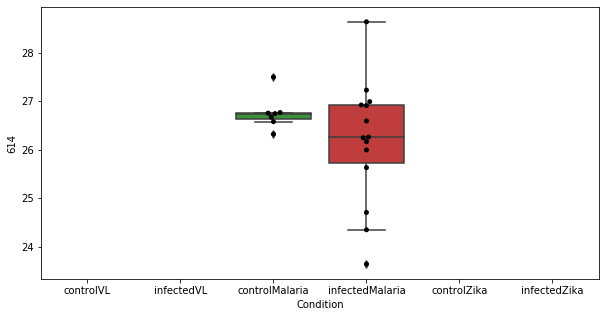

557 row m/z                 788.67
row retention time     4.24372
p-val                 0.221361
adj.P.Val             0.773175
custom_id                 5284
compound_names             NaN
Name: 5284, dtype: object


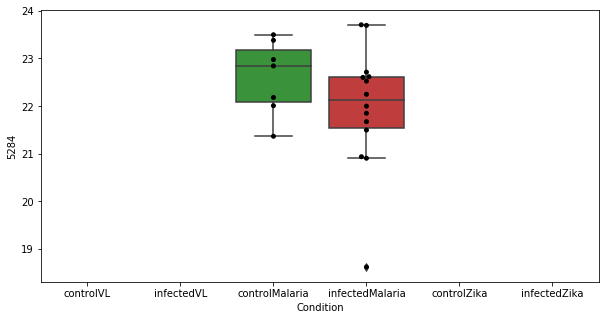

558 row m/z                554.393
row retention time     3.37552
p-val                 0.222303
adj.P.Val              0.77323
custom_id                 2701
compound_names             NaN
Name: 2701, dtype: object


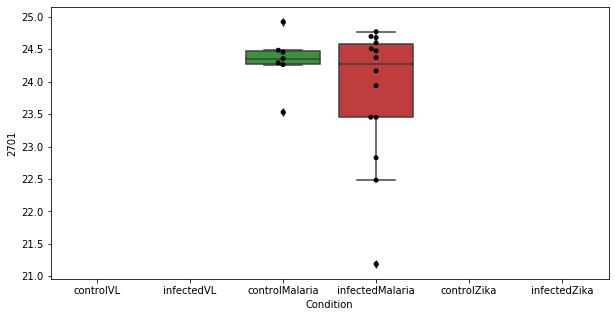

559 row m/z                                                         244.154
row retention time                                              3.83878
p-val                                                          0.222349
adj.P.Val                                                       0.77323
custom_id                                                          1861
compound_names        Peptide 2-[3-carboxy-3-(methylammonio)propyl]-...
Name: 1861, dtype: object


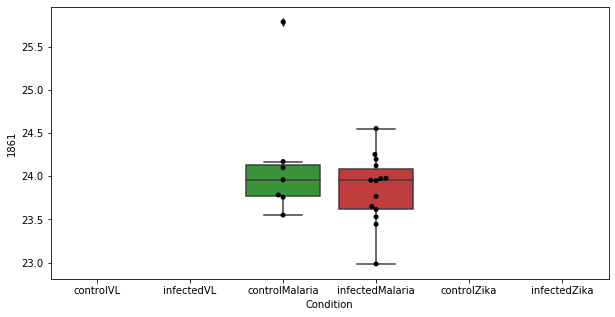

560 row m/z                344.105
row retention time     3.70025
p-val                 0.223184
adj.P.Val              0.77323
custom_id                 2409
compound_names             NaN
Name: 2409, dtype: object


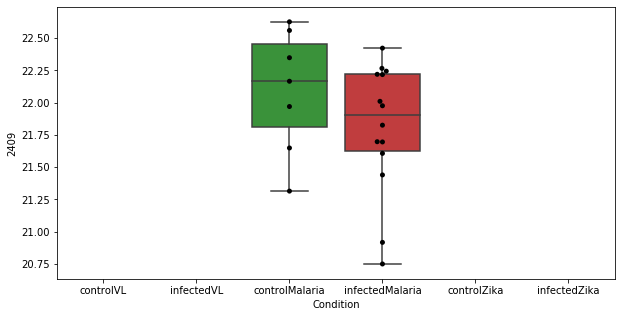

561 row m/z                                                         156.138
row retention time                                              4.58321
p-val                                                          0.224355
adj.P.Val                                                       0.77323
custom_id                                                           871
compound_names        Ecgonine methyl ester; Methyl ecgonine$ecgonin...
Name: 871, dtype: object


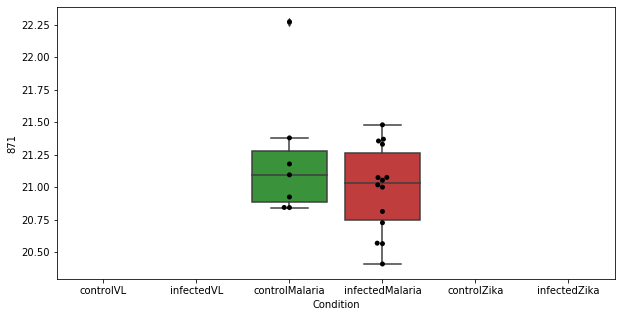

562 row m/z                 253.18
row retention time     3.72334
p-val                 0.224518
adj.P.Val              0.77323
custom_id                 1939
compound_names             NaN
Name: 1939, dtype: object


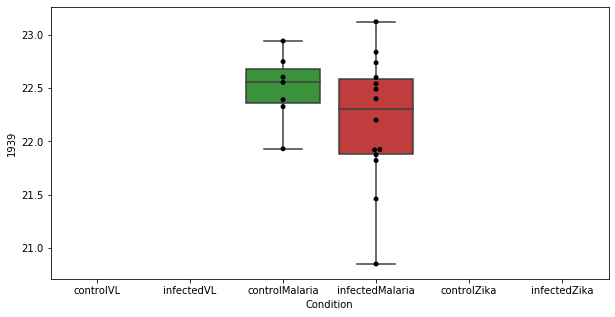

563 row m/z                 585.271
row retention time      4.05159
p-val                   0.22613
adj.P.Val               0.77323
custom_id                  4234
compound_names        Bilirubin
Name: 4234, dtype: object


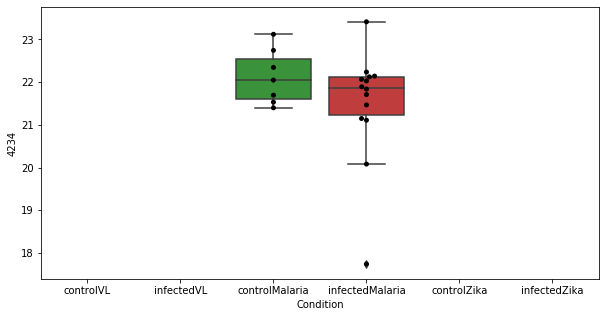

564 row m/z                728.839
row retention time      8.9134
p-val                 0.226802
adj.P.Val              0.77323
custom_id                 2838
compound_names             NaN
Name: 2838, dtype: object


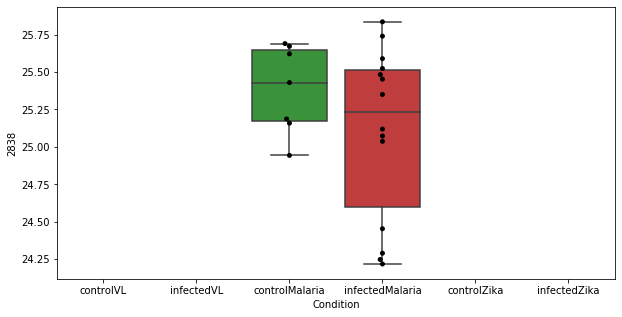

565 row m/z               268.212
row retention time    23.6797
p-val                 0.22692
adj.P.Val             0.77323
custom_id                2043
compound_names            NaN
Name: 2043, dtype: object


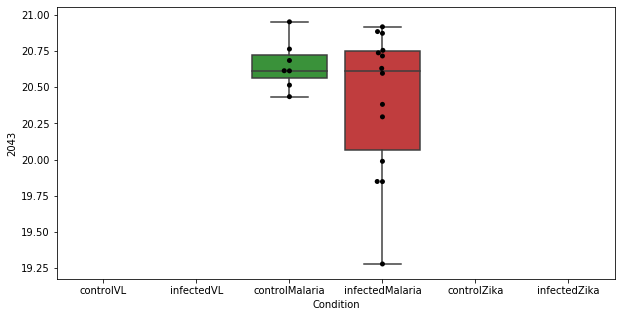

566 row m/z                                 213.094
row retention time                      4.78719
p-val                                  0.227289
adj.P.Val                               0.77323
custom_id                                  1557
compound_names        N-(omega)-Hydroxyarginine
Name: 1557, dtype: object


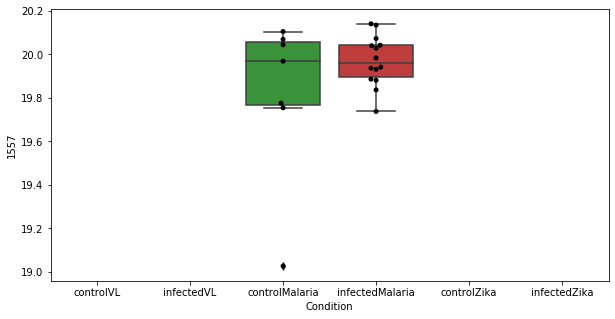

567 row m/z                360.238
row retention time     3.73178
p-val                 0.227527
adj.P.Val              0.77323
custom_id                 2441
compound_names             NaN
Name: 2441, dtype: object


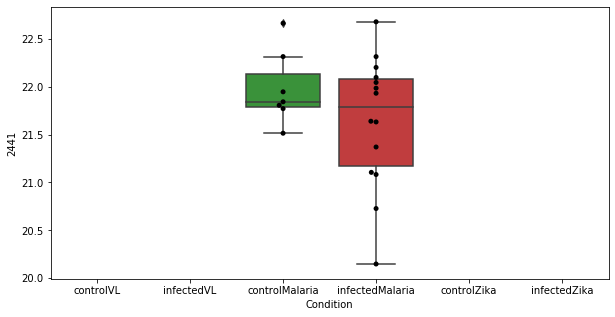

568 row m/z                168.118
row retention time     13.3946
p-val                 0.227899
adj.P.Val              0.77323
custom_id                 1038
compound_names             NaN
Name: 1038, dtype: object


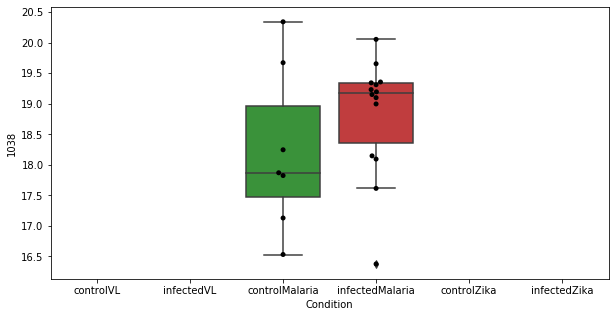

569 row m/z                158.081
row retention time     12.3132
p-val                 0.228075
adj.P.Val              0.77323
custom_id                 3414
compound_names             NaN
Name: 3414, dtype: object


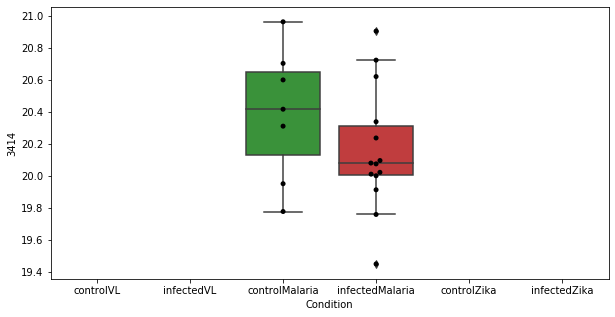

570 row m/z                189.025
row retention time     23.2499
p-val                 0.228371
adj.P.Val              0.77323
custom_id                 1292
compound_names             NaN
Name: 1292, dtype: object


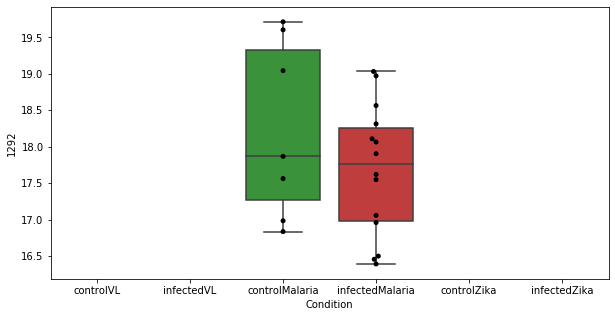

571 row m/z                231.134
row retention time     5.35801
p-val                 0.229073
adj.P.Val              0.77323
custom_id                 3764
compound_names             NaN
Name: 3764, dtype: object


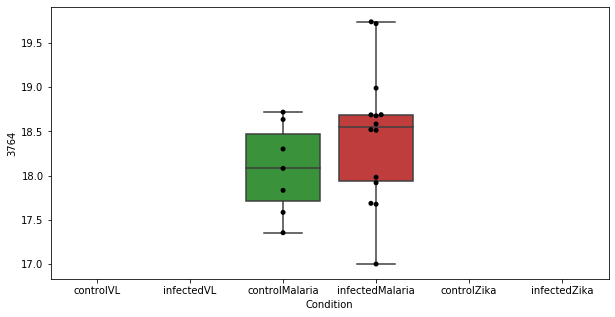

572 row m/z                234.918
row retention time     13.0079
p-val                 0.230463
adj.P.Val              0.77323
custom_id                 3776
compound_names             NaN
Name: 3776, dtype: object


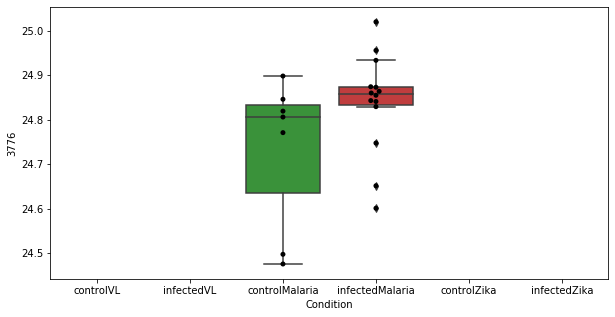

573 row m/z                161.092
row retention time     10.3434
p-val                 0.230733
adj.P.Val              0.77323
custom_id                 4704
compound_names             NaN
Name: 4704, dtype: object


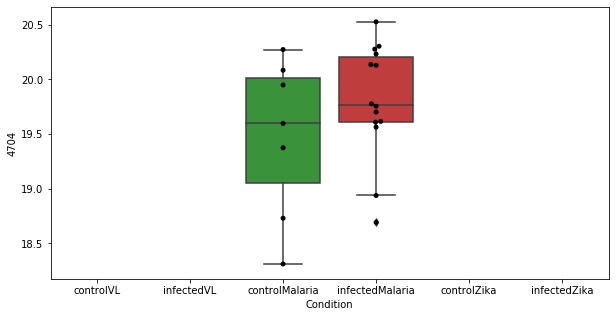

574 row m/z                139.075
row retention time     3.86838
p-val                 0.230985
adj.P.Val              0.77323
custom_id                 3307
compound_names             NaN
Name: 3307, dtype: object


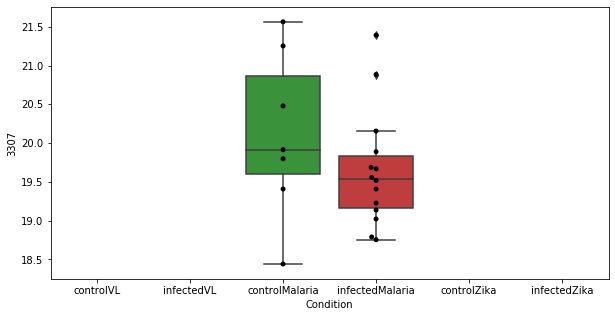

575 row m/z                                 138.049
row retention time                      9.40929
p-val                                  0.231055
adj.P.Val                               0.77323
custom_id                                   617
compound_names        Hypoxanthine; Purine-6-ol
Name: 617, dtype: object


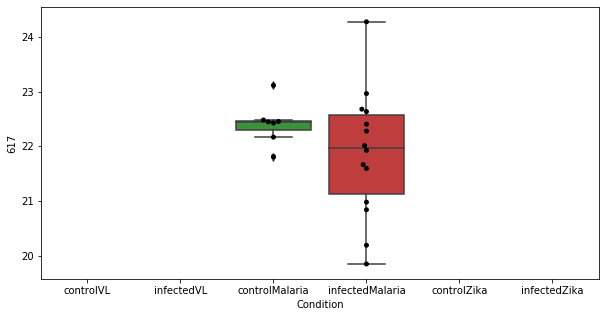

576 row m/z                275.103
row retention time       10.63
p-val                 0.231069
adj.P.Val              0.77323
custom_id                 6014
compound_names             NaN
Name: 6014, dtype: object


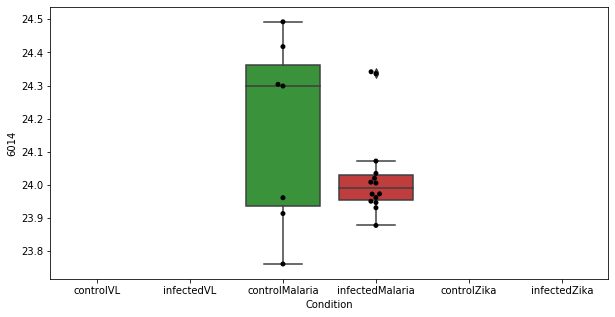

577 row m/z                284.331
row retention time     7.09397
p-val                 0.231109
adj.P.Val              0.77323
custom_id                 3983
compound_names             NaN
Name: 3983, dtype: object


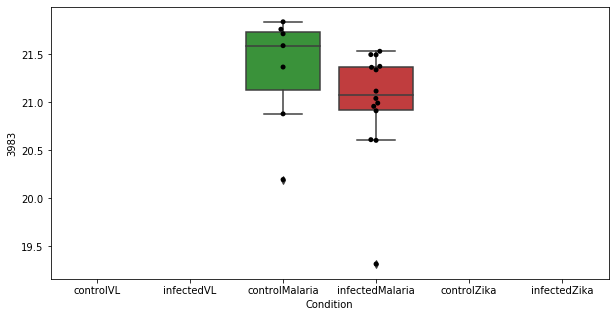

578 row m/z                342.337
row retention time      6.8372
p-val                 0.231331
adj.P.Val              0.77323
custom_id                 4111
compound_names             NaN
Name: 4111, dtype: object


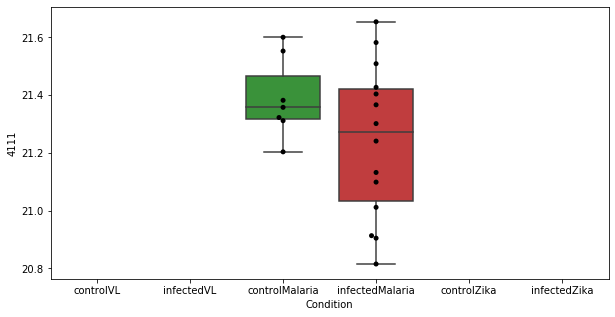

579 row m/z                294.206
row retention time     3.65873
p-val                 0.231815
adj.P.Val              0.77323
custom_id                 2226
compound_names             NaN
Name: 2226, dtype: object


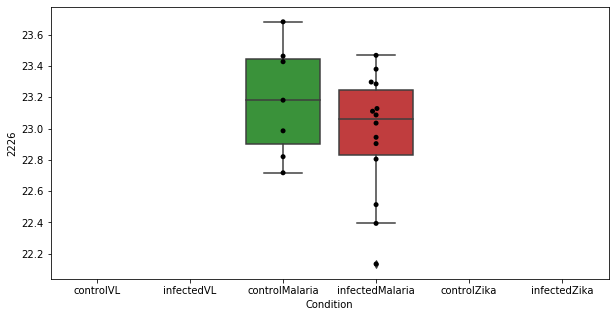

580 row m/z                117.102
row retention time       4.629
p-val                 0.232172
adj.P.Val              0.77323
custom_id                  339
compound_names             NaN
Name: 339, dtype: object


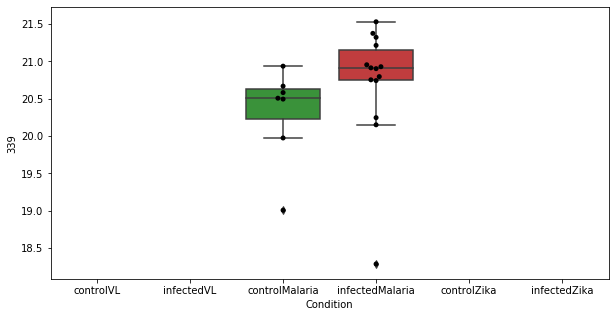

581 row m/z               581.427
row retention time    3.41845
p-val                 0.23218
adj.P.Val             0.77323
custom_id                2733
compound_names            NaN
Name: 2733, dtype: object


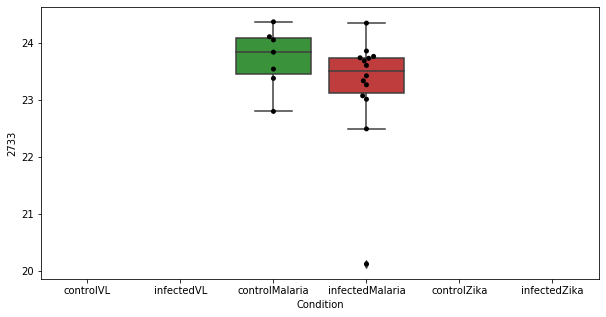

582 row m/z                610.504
row retention time     3.27154
p-val                 0.232296
adj.P.Val              0.77323
custom_id                 2748
compound_names             NaN
Name: 2748, dtype: object


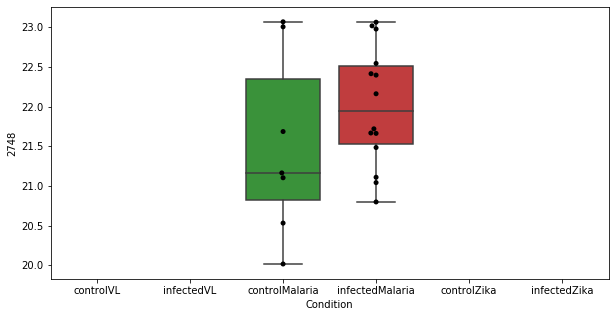

583 row m/z                                      184.061
row retention time                           4.45148
p-val                                       0.232847
adj.P.Val                                    0.77323
custom_id                                       1229
compound_names        4-Pyridoxate; 4-Pyridoxic acid
Name: 1229, dtype: object


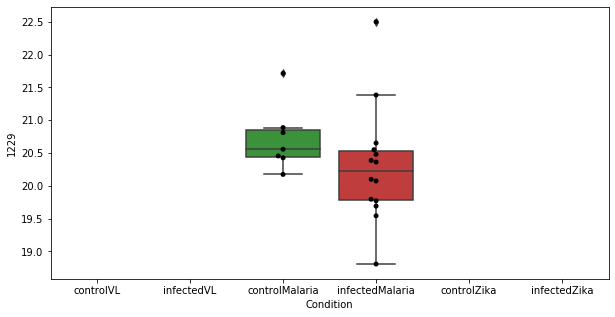

584 row m/z                  149.1
row retention time     10.5552
p-val                 0.233144
adj.P.Val              0.77323
custom_id                  803
compound_names             NaN
Name: 803, dtype: object


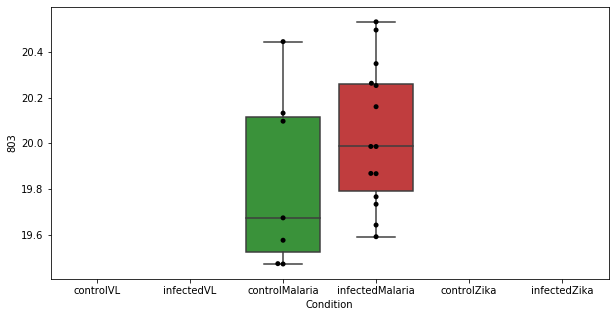

585 row m/z                 111.08
row retention time     3.89167
p-val                 0.233234
adj.P.Val              0.77323
custom_id                  233
compound_names             NaN
Name: 233, dtype: object


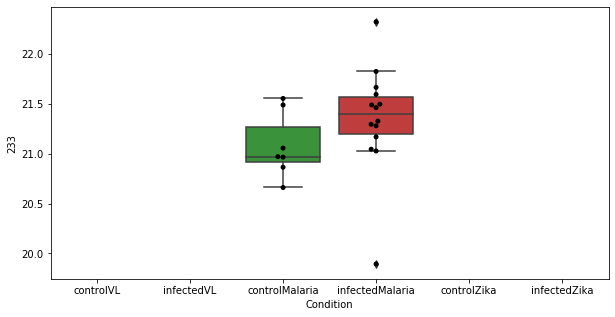

586 row m/z               193.975
row retention time    12.9727
p-val                 0.23324
adj.P.Val             0.77323
custom_id                1359
compound_names            NaN
Name: 1359, dtype: object


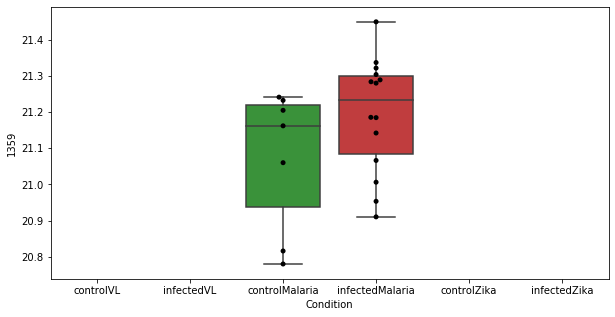

587 row m/z                176.038
row retention time      7.0004
p-val                 0.234087
adj.P.Val              0.77323
custom_id                 1138
compound_names             NaN
Name: 1138, dtype: object


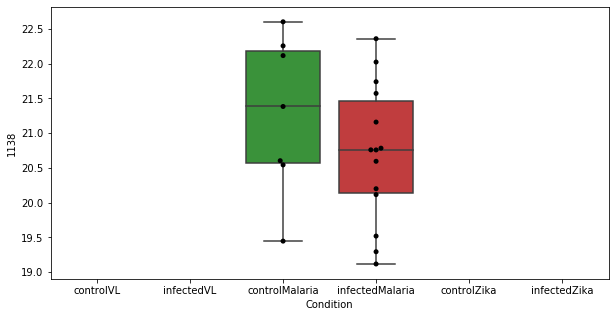

588 row m/z                 192.16
row retention time     23.1718
p-val                 0.234264
adj.P.Val              0.77323
custom_id                 4841
compound_names             NaN
Name: 4841, dtype: object


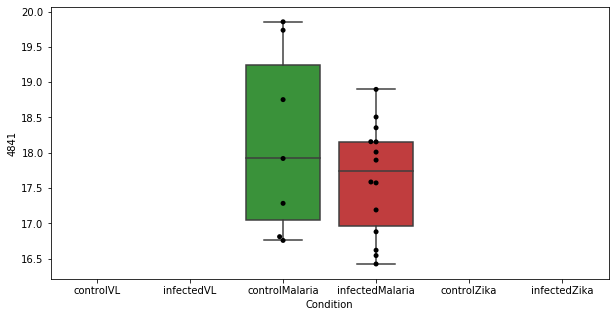

589 row m/z               343.295
row retention time    6.97823
p-val                 0.23458
adj.P.Val             0.77323
custom_id                6156
compound_names            NaN
Name: 6156, dtype: object


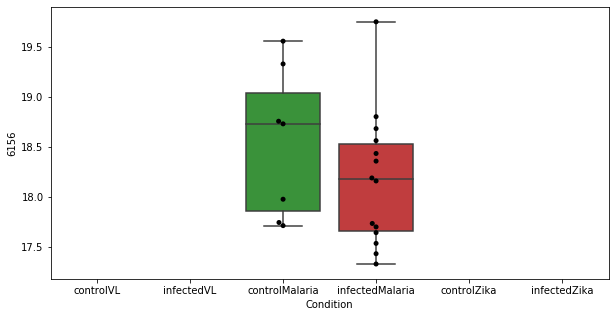

590 row m/z                274.274
row retention time     6.89354
p-val                 0.234583
adj.P.Val              0.77323
custom_id                 3930
compound_names             NaN
Name: 3930, dtype: object


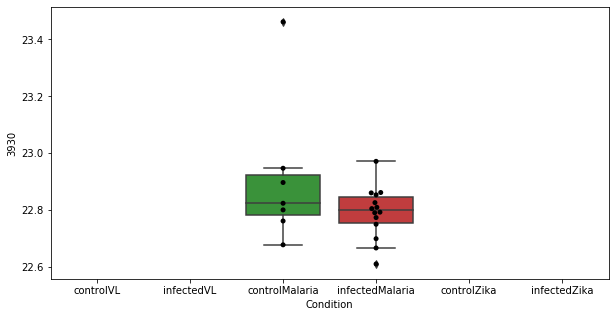

591 row m/z                  318.9
row retention time     6.02626
p-val                 0.234865
adj.P.Val              0.77323
custom_id                 2335
compound_names             NaN
Name: 2335, dtype: object


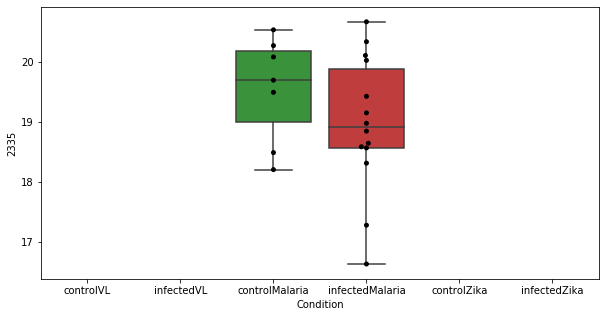

592 row m/z                238.165
row retention time     3.94287
p-val                 0.236147
adj.P.Val             0.775525
custom_id                 1804
compound_names             NaN
Name: 1804, dtype: object


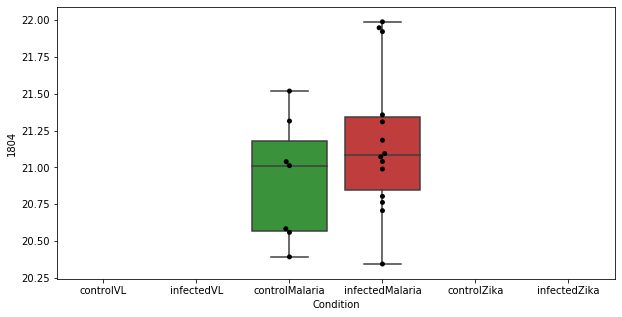

593 row m/z                240.142
row retention time     6.98958
p-val                 0.237033
adj.P.Val             0.775525
custom_id                 1829
compound_names             NaN
Name: 1829, dtype: object


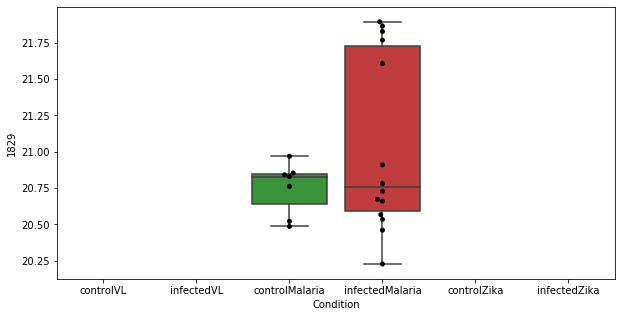

594 row m/z                134.081
row retention time     7.58394
p-val                 0.237129
adj.P.Val             0.775525
custom_id                  586
compound_names             NaN
Name: 586, dtype: object


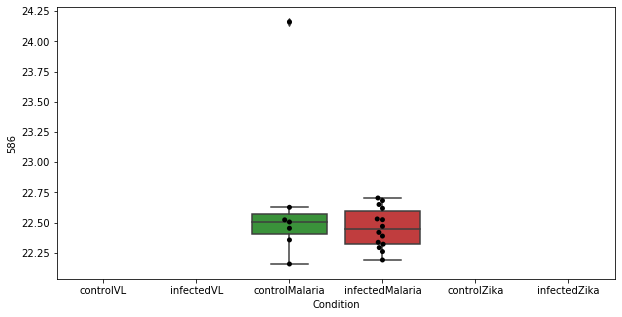

595 row m/z                207.159
row retention time      23.662
p-val                 0.237154
adj.P.Val             0.775525
custom_id                 1492
compound_names             NaN
Name: 1492, dtype: object


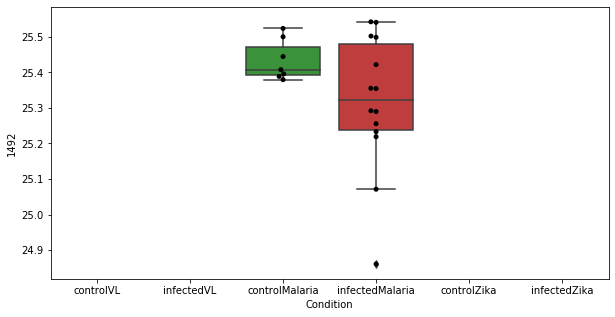

596 row m/z                78.9557
row retention time     2.79071
p-val                 0.238417
adj.P.Val             0.778348
custom_id                   22
compound_names             NaN
Name: 22, dtype: object


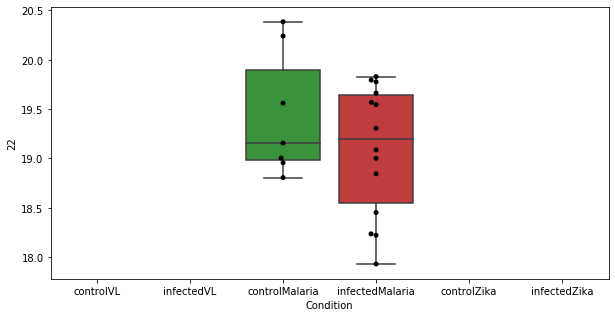

597 row m/z                211.111
row retention time     3.82711
p-val                  0.23917
adj.P.Val             0.779503
custom_id                 1539
compound_names             NaN
Name: 1539, dtype: object


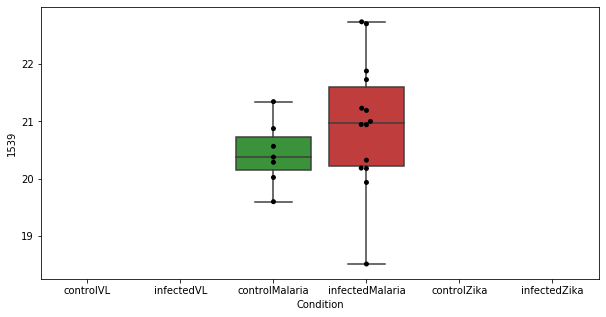

598 row m/z                313.176
row retention time     22.9649
p-val                 0.239752
adj.P.Val             0.780095
custom_id                 2311
compound_names             NaN
Name: 2311, dtype: object


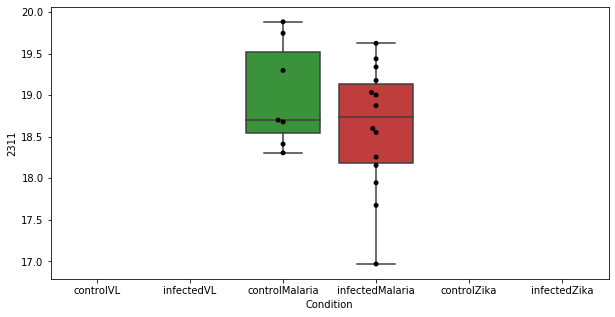

599 row m/z                                                           287.1
row retention time                                               5.4692
p-val                                                          0.240276
adj.P.Val                                                      0.780495
custom_id                                                          3992
compound_names        Formyl-N-acetyl-5-methoxykynurenamine$alpha-N-...
Name: 3992, dtype: object


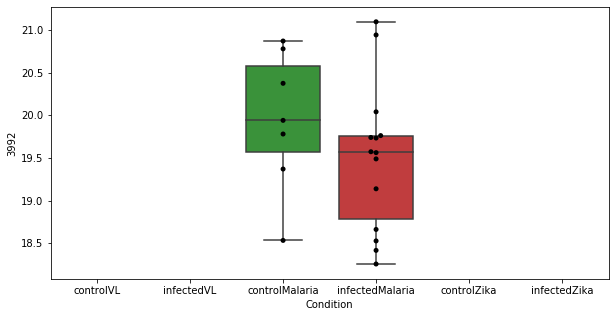

600 row m/z                 405.21
row retention time     3.75655
p-val                 0.241243
adj.P.Val             0.781458
custom_id                 2535
compound_names             NaN
Name: 2535, dtype: object


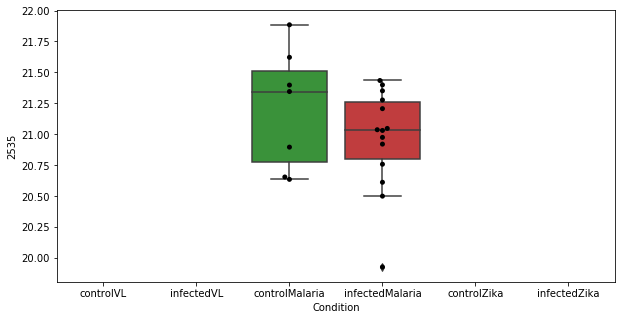

601 row m/z                                                          130.05
row retention time                                              6.99667
p-val                                                          0.241374
adj.P.Val                                                      0.781458
custom_id                                                           514
compound_names        1-Pyrroline-4-hydroxy-2-carboxylate$L-1-Pyrrol...
Name: 514, dtype: object


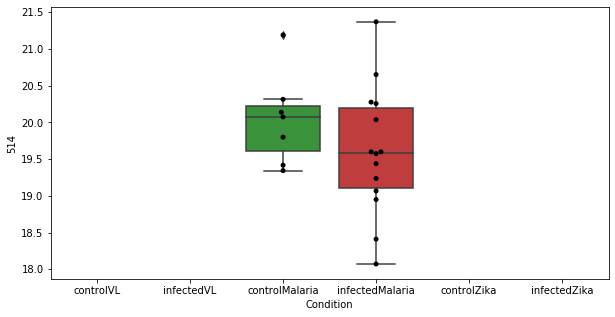

602 row m/z                233.915
row retention time     23.7696
p-val                 0.242501
adj.P.Val             0.783339
custom_id                 1746
compound_names             NaN
Name: 1746, dtype: object


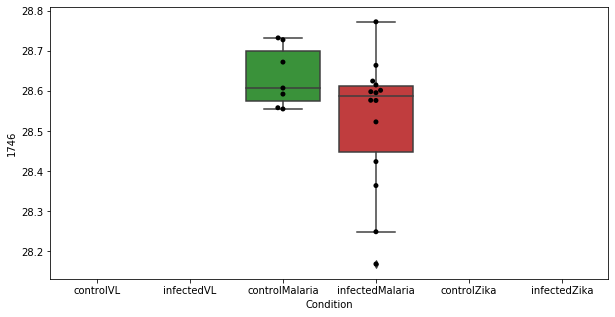

603 row m/z                                                         136.112
row retention time                                              6.82421
p-val                                                          0.242759
adj.P.Val                                                      0.783339
custom_id                                                           607
compound_names        (-)-Salsolinol; 6,7-Isoquinolinediol, 1,2,3,4-...
Name: 607, dtype: object


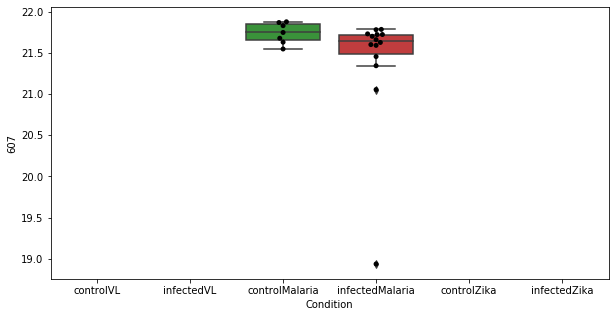

604 row m/z                239.164
row retention time     3.81304
p-val                 0.244024
adj.P.Val             0.784474
custom_id                 1825
compound_names             NaN
Name: 1825, dtype: object


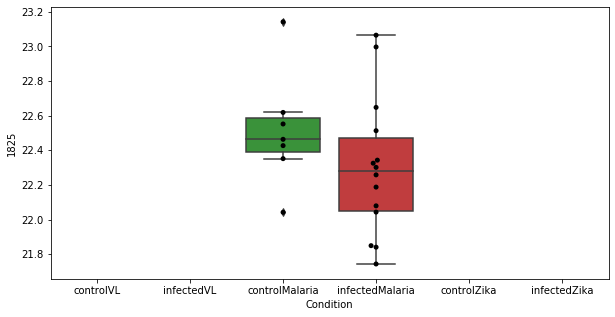

605 row m/z                97.9913
row retention time     4.85424
p-val                 0.244152
adj.P.Val             0.784474
custom_id                  109
compound_names             NaN
Name: 109, dtype: object


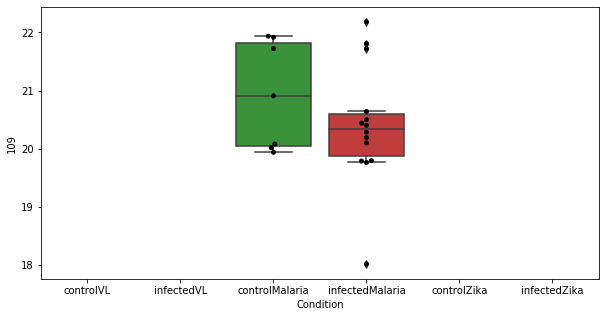

606 row m/z                646.822
row retention time     7.80918
p-val                  0.24436
adj.P.Val             0.784474
custom_id                 2784
compound_names             NaN
Name: 2784, dtype: object


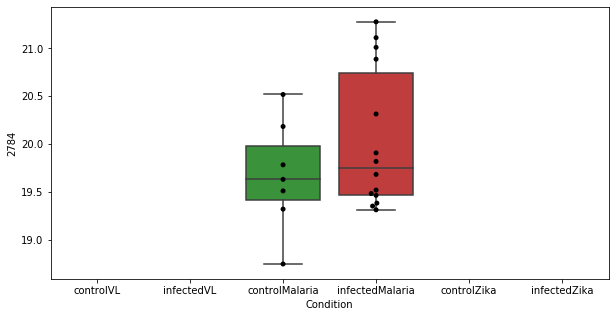

607 row m/z                274.936
row retention time     23.8269
p-val                 0.244721
adj.P.Val             0.784474
custom_id                 2079
compound_names             NaN
Name: 2079, dtype: object


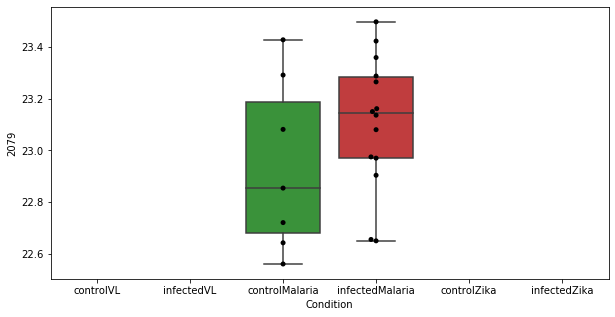

608 row m/z                189.025
row retention time     7.36927
p-val                 0.245363
adj.P.Val             0.785243
custom_id                 3578
compound_names             NaN
Name: 3578, dtype: object


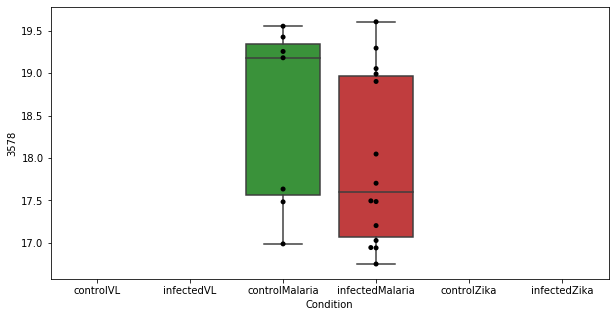

609 row m/z                142.123
row retention time     4.05638
p-val                 0.246666
adj.P.Val             0.787019
custom_id                  672
compound_names             NaN
Name: 672, dtype: object


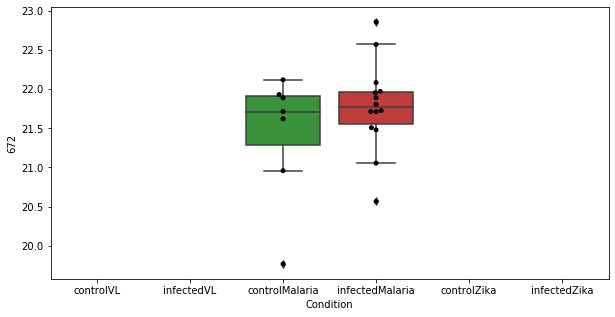

610 row m/z                338.341
row retention time     3.64555
p-val                 0.246726
adj.P.Val             0.787019
custom_id                 2394
compound_names             NaN
Name: 2394, dtype: object


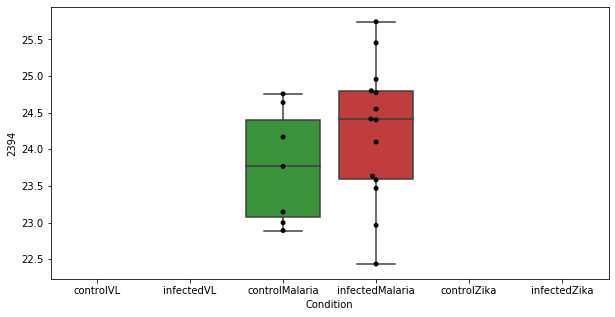

611 row m/z                178.072
row retention time     9.40349
p-val                 0.248078
adj.P.Val             0.789223
custom_id                 3520
compound_names             NaN
Name: 3520, dtype: object


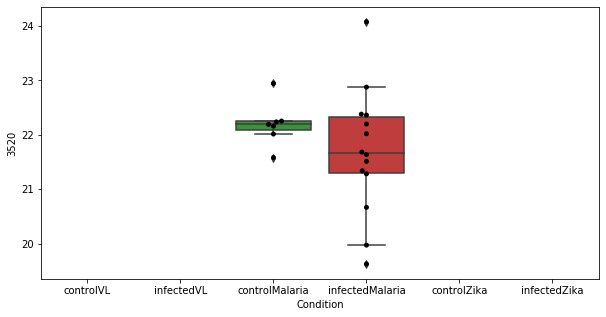

612 row m/z                120.093
row retention time     10.7944
p-val                 0.248227
adj.P.Val             0.789223
custom_id                  383
compound_names             NaN
Name: 383, dtype: object


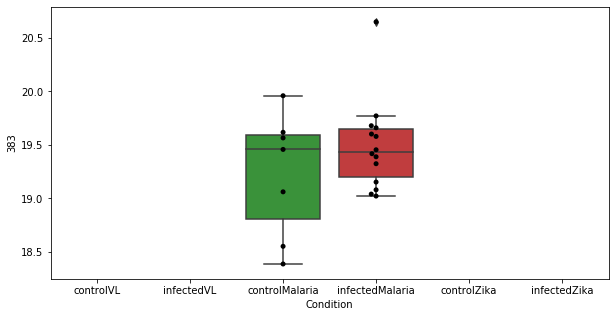

613 row m/z                229.155
row retention time     8.86006
p-val                 0.249835
adj.P.Val             0.793043
custom_id                 1717
compound_names             NaN
Name: 1717, dtype: object


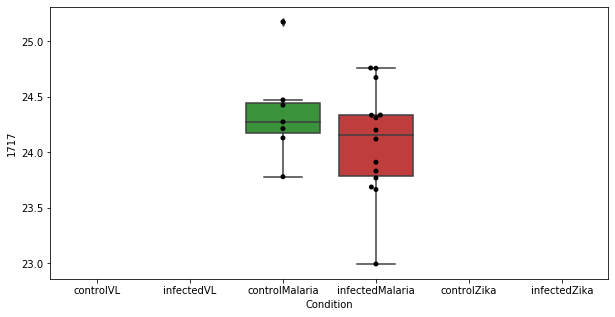

614 row m/z                134.109
row retention time     9.60786
p-val                   0.2524
adj.P.Val             0.797863
custom_id                 6489
compound_names             NaN
Name: 6489, dtype: object


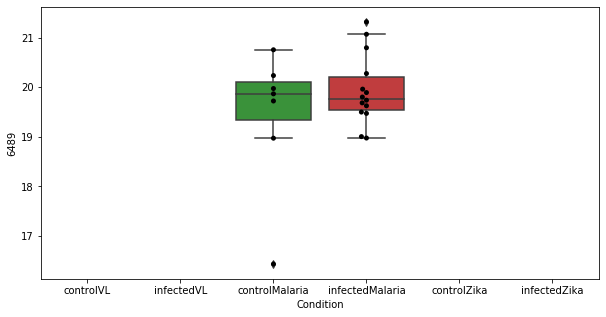

615 row m/z                215.094
row retention time     12.4844
p-val                 0.252734
adj.P.Val             0.797863
custom_id                 1589
compound_names             NaN
Name: 1589, dtype: object


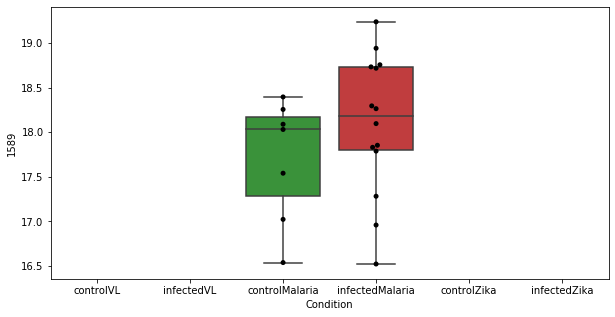

616 row m/z                                                         272.149
row retention time                                              3.92091
p-val                                                          0.252997
adj.P.Val                                                      0.797863
custom_id                                                          2061
compound_names        Peptide 2-[3-carboxy-3-(methylammonio)propyl]-...
Name: 2061, dtype: object


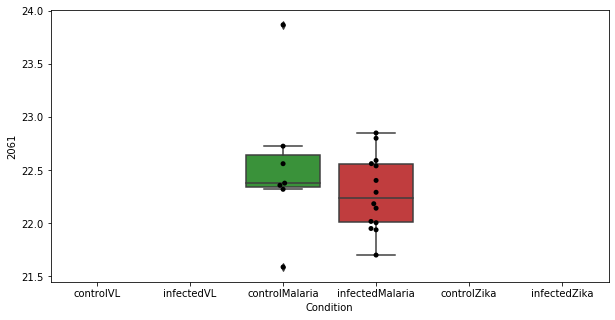

617 row m/z                                                          387.18
row retention time                                              3.74668
p-val                                                          0.253153
adj.P.Val                                                      0.797863
custom_id                                                          2493
compound_names        12-oxo-10,11-dihydro-20-COOH-LTB4$20-carboxy-l...
Name: 2493, dtype: object


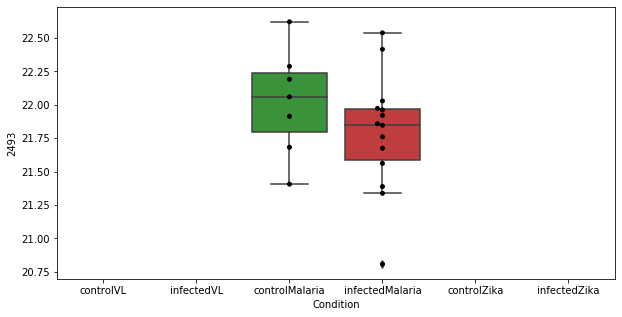

618 row m/z                                                         280.163
row retention time                                              3.61979
p-val                                                          0.253615
adj.P.Val                                                      0.797863
custom_id                                                          3964
compound_names        3(S),6(S)-dihydroxy-tetradec-8Z-enoate$3(S),6(...
Name: 3964, dtype: object


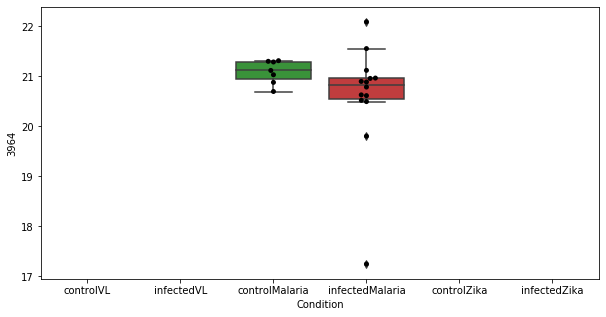

619 row m/z                                                         104.107
row retention time                                              4.37111
p-val                                                           0.25381
adj.P.Val                                                      0.797863
custom_id                                                          3101
compound_names        L-Isoleucine; 2-Amino-3-methylvaleric acid$L-L...
Name: 3101, dtype: object


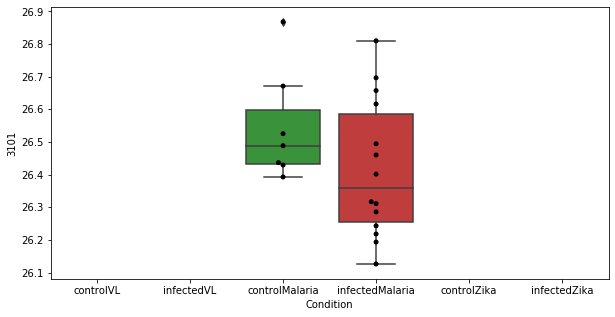

620 row m/z               210.105
row retention time    4.11097
p-val                 0.25454
adj.P.Val             0.79887
custom_id                1521
compound_names            NaN
Name: 1521, dtype: object


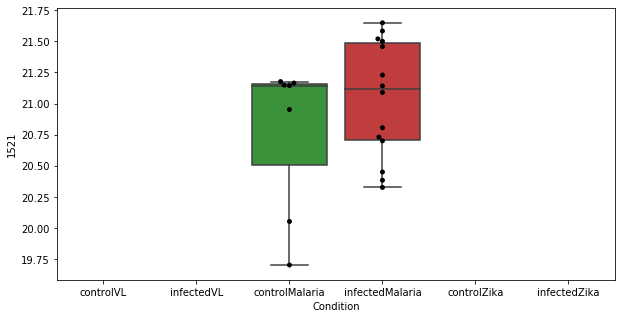

621 row m/z                           146.118
row retention time                6.85066
p-val                            0.255706
adj.P.Val                        0.800969
custom_id                             743
compound_names        propionyl-carnitine
Name: 743, dtype: object


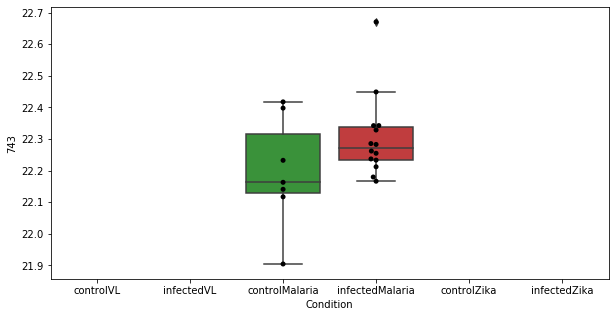

622 row m/z                276.107
row retention time     4.74527
p-val                 0.256479
adj.P.Val             0.800969
custom_id                 2094
compound_names             NaN
Name: 2094, dtype: object


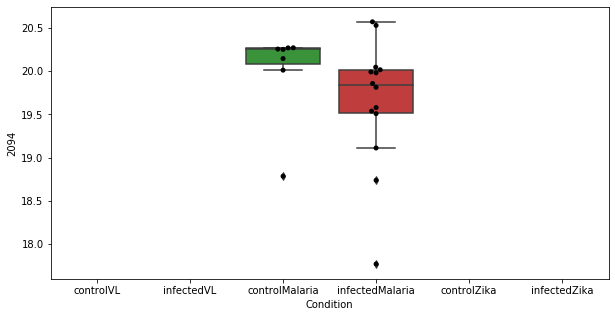

623 row m/z                191.085
row retention time     10.1661
p-val                 0.256636
adj.P.Val             0.800969
custom_id                 1325
compound_names             NaN
Name: 1325, dtype: object


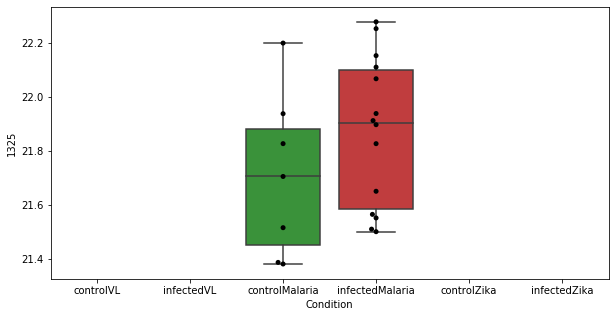

624 row m/z                205.947
row retention time     14.3563
p-val                 0.256853
adj.P.Val             0.800969
custom_id                 1483
compound_names             NaN
Name: 1483, dtype: object


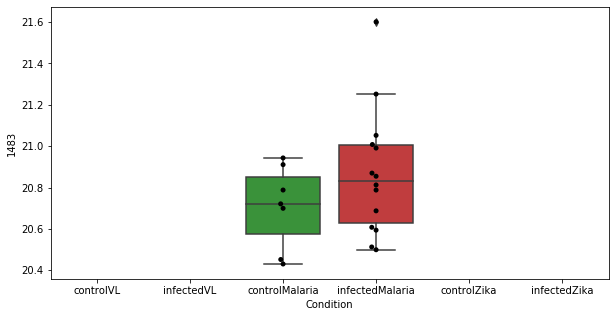

625 row m/z                127.966
row retention time     4.72215
p-val                 0.258452
adj.P.Val             0.804023
custom_id                 3224
compound_names             NaN
Name: 3224, dtype: object


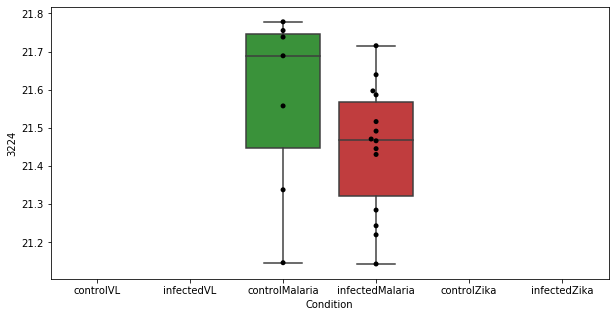

626 row m/z                131.162
row retention time     9.58635
p-val                 0.258978
adj.P.Val             0.804023
custom_id                 4552
compound_names             NaN
Name: 4552, dtype: object


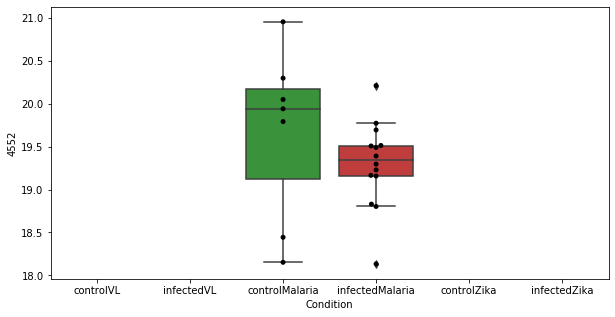

627 row m/z                152.972
row retention time     13.8406
p-val                 0.259069
adj.P.Val             0.804023
custom_id                  843
compound_names             NaN
Name: 843, dtype: object


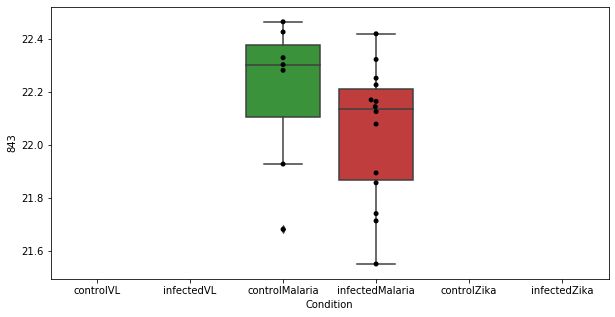

628 row m/z                            147.121
row retention time                 11.0711
p-val                             0.260086
adj.P.Val                         0.805895
custom_id                              763
compound_names        3-Dehydroxycarnitine
Name: 763, dtype: object


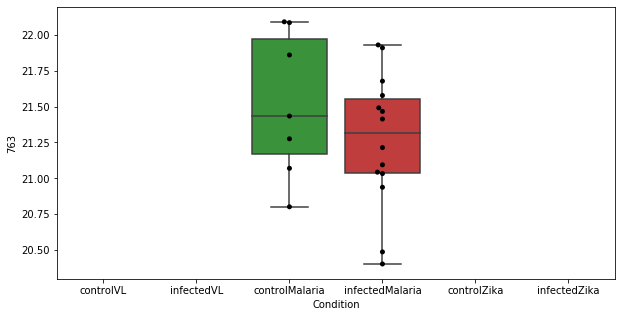

629 row m/z                569.363
row retention time      4.6754
p-val                 0.260893
adj.P.Val             0.807111
custom_id                 2715
compound_names             NaN
Name: 2715, dtype: object


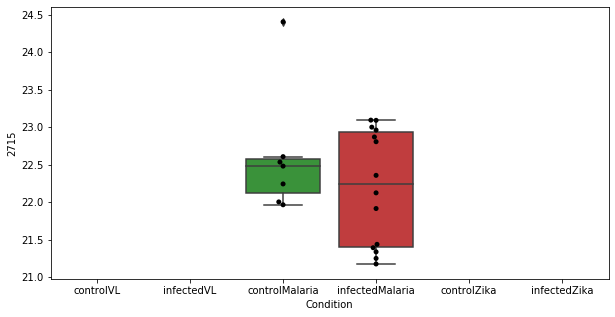

630 row m/z                183.965
row retention time     14.3539
p-val                 0.262682
adj.P.Val             0.811359
custom_id                 1225
compound_names             NaN
Name: 1225, dtype: object


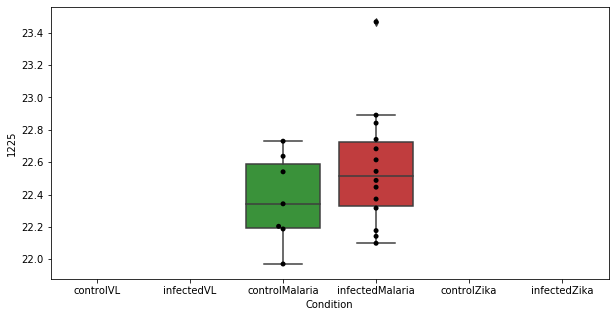

631 row m/z                                                          190.05
row retention time                                              6.99942
p-val                                                          0.263382
adj.P.Val                                                      0.811962
custom_id                                                          1303
compound_names        1-Nitronaphthalene-7,8-oxide$1-Nitronaphthalen...
Name: 1303, dtype: object


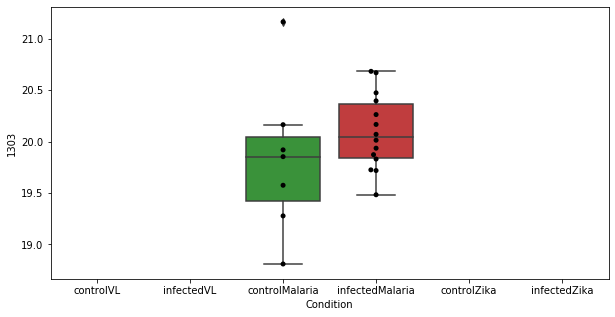

632 row m/z                302.233
row retention time     3.66751
p-val                 0.263711
adj.P.Val             0.811962
custom_id                 2257
compound_names             NaN
Name: 2257, dtype: object


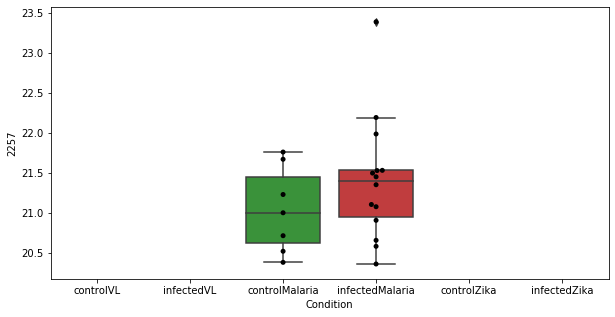

633 row m/z                302.233
row retention time     4.57399
p-val                 0.264371
adj.P.Val             0.812712
custom_id                 2258
compound_names             NaN
Name: 2258, dtype: object


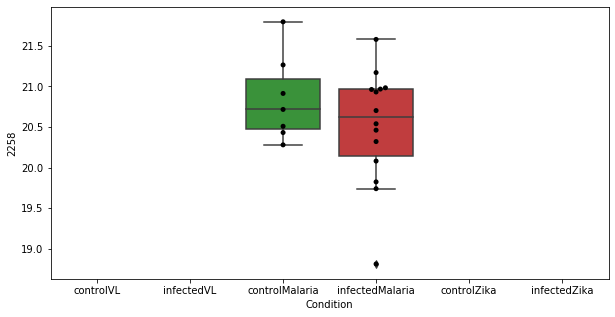

634 row m/z                148.097
row retention time      11.374
p-val                 0.265304
adj.P.Val             0.813732
custom_id                  791
compound_names             NaN
Name: 791, dtype: object


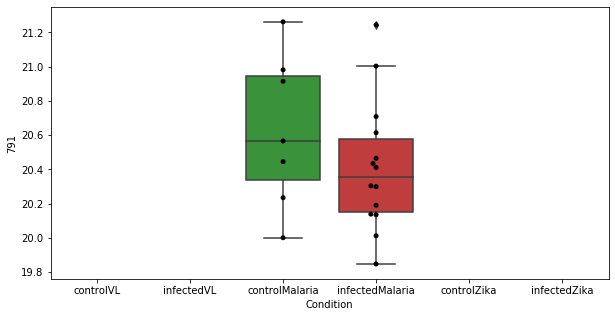

635 row m/z                155.107
row retention time     4.35963
p-val                 0.266046
adj.P.Val             0.813732
custom_id                  858
compound_names             NaN
Name: 858, dtype: object


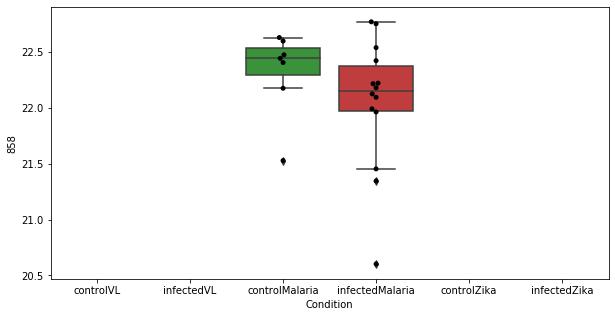

636 row m/z                252.048
row retention time      9.7219
p-val                 0.266502
adj.P.Val             0.813732
custom_id                 1922
compound_names             NaN
Name: 1922, dtype: object


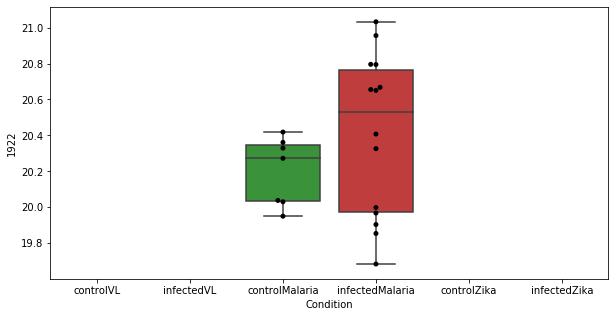

637 row m/z                200.054
row retention time     9.39281
p-val                 0.266707
adj.P.Val             0.813732
custom_id                 1432
compound_names             NaN
Name: 1432, dtype: object


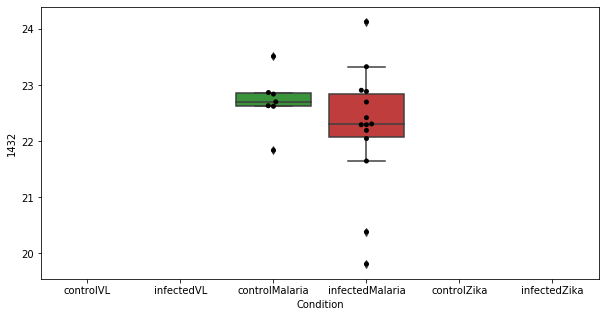

638 row m/z                     189.087
row retention time          4.47507
p-val                      0.266791
adj.P.Val                  0.813732
custom_id                      1296
compound_names        Perillic acid
Name: 1296, dtype: object


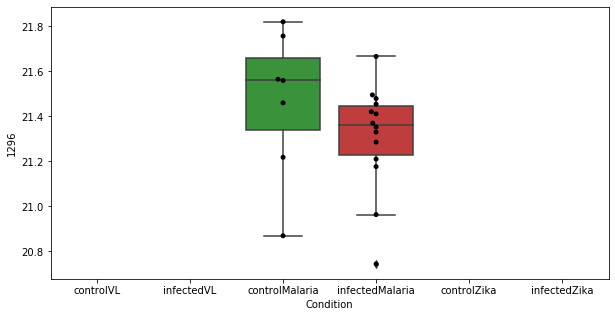

639 row m/z                204.913
row retention time     14.3361
p-val                  0.26737
adj.P.Val             0.813963
custom_id                 1473
compound_names             NaN
Name: 1473, dtype: object


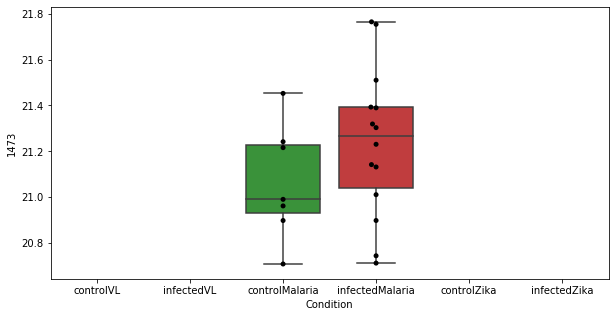

640 row m/z                252.928
row retention time     23.7494
p-val                 0.268053
adj.P.Val             0.813963
custom_id                 1934
compound_names             NaN
Name: 1934, dtype: object


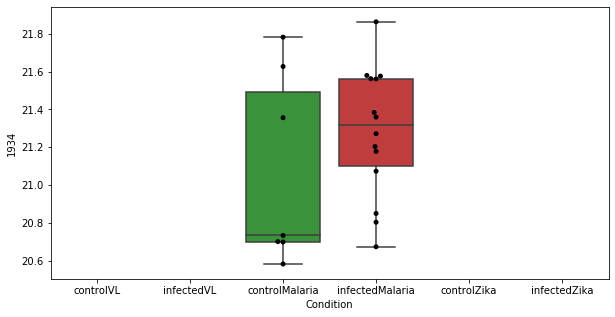

641 row m/z                311.179
row retention time     3.78793
p-val                 0.268119
adj.P.Val             0.813963
custom_id                 2294
compound_names             NaN
Name: 2294, dtype: object


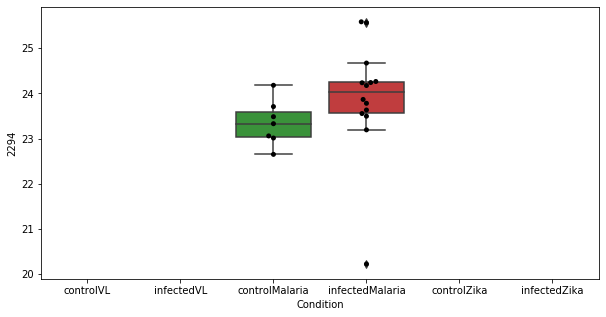

642 row m/z                                                237.052
row retention time                                     10.7947
p-val                                                 0.269289
adj.P.Val                                             0.815667
custom_id                                                 4993
compound_names        5-L-Glutamyl-taurine; 5-Glutamyl-taurine
Name: 4993, dtype: object


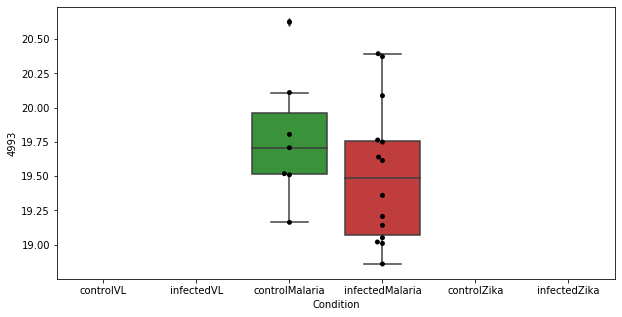

643 row m/z                308.886
row retention time     23.4261
p-val                 0.269517
adj.P.Val             0.815667
custom_id                 2284
compound_names             NaN
Name: 2284, dtype: object


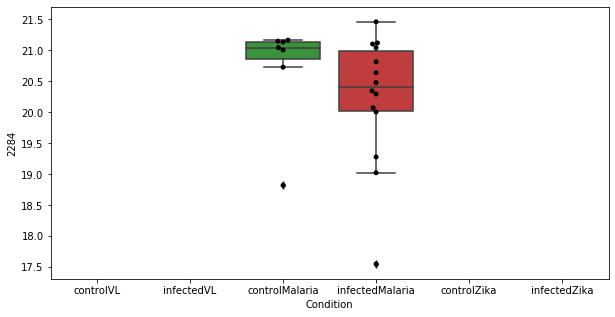

644 row m/z                143.107
row retention time     3.92593
p-val                 0.271662
adj.P.Val             0.820883
custom_id                  684
compound_names             NaN
Name: 684, dtype: object


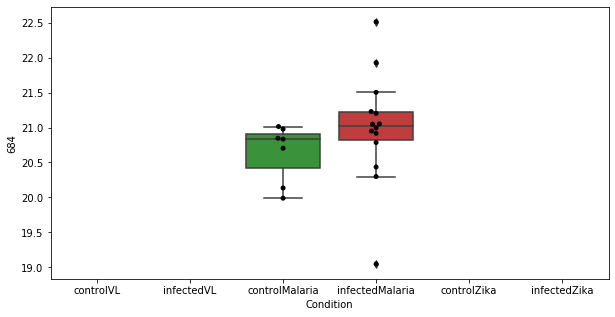

645 row m/z                493.327
row retention time      3.2432
p-val                 0.272685
adj.P.Val              0.82166
custom_id                 2620
compound_names             NaN
Name: 2620, dtype: object


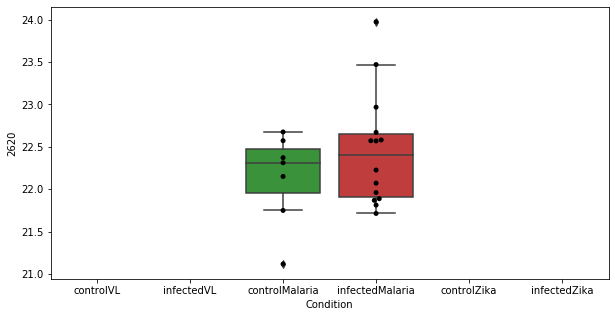

646 row m/z                151.058
row retention time     10.1632
p-val                 0.273552
adj.P.Val              0.82166
custom_id                 3383
compound_names             NaN
Name: 3383, dtype: object


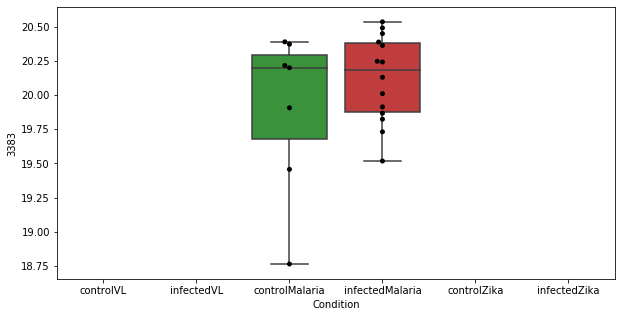

647 row m/z               157.122
row retention time    4.44139
p-val                 0.27376
adj.P.Val             0.82166
custom_id                 890
compound_names              $
Name: 890, dtype: object


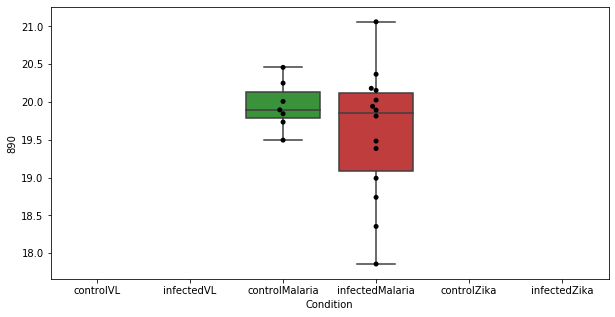

648 row m/z                            146.092
row retention time                 12.3864
p-val                             0.273764
adj.P.Val                          0.82166
custom_id                              740
compound_names        4-Guanidinobutanoate
Name: 740, dtype: object


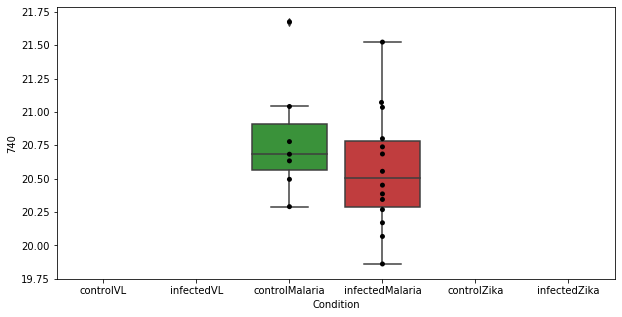

649 row m/z                 258.98
row retention time     14.0945
p-val                 0.274027
adj.P.Val              0.82166
custom_id                 3886
compound_names             NaN
Name: 3886, dtype: object


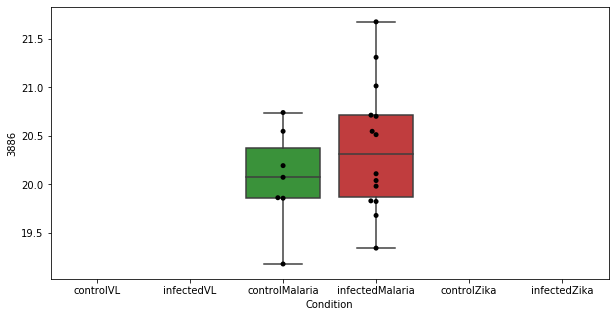

650 row m/z                                                         102.091
row retention time                                                4.391
p-val                                                          0.274778
adj.P.Val                                                       0.82261
custom_id                                                          4407
compound_names        N4-Acetylaminobutanal$L-Pipecolate; Pipecolini...
Name: 4407, dtype: object


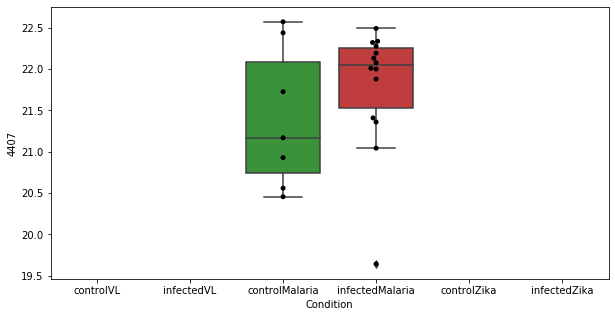

651 row m/z                262.165
row retention time     4.14784
p-val                 0.275188
adj.P.Val              0.82261
custom_id                 1994
compound_names             NaN
Name: 1994, dtype: object


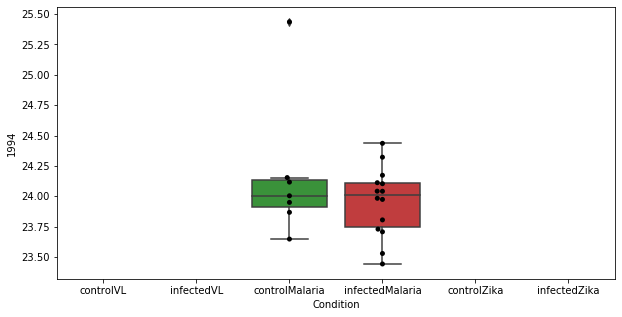

652 row m/z                114.098
row retention time     8.94075
p-val                 0.275938
adj.P.Val             0.823588
custom_id                  294
compound_names             NaN
Name: 294, dtype: object


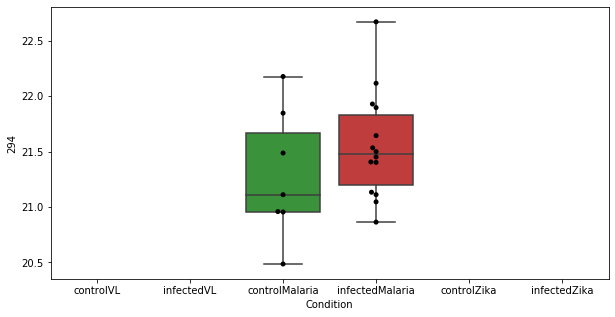

653 row m/z                                 175.002
row retention time                      9.42307
p-val                                  0.276426
adj.P.Val                              0.823784
custom_id                                  1130
compound_names        Hypoxanthine; Purine-6-ol
Name: 1130, dtype: object


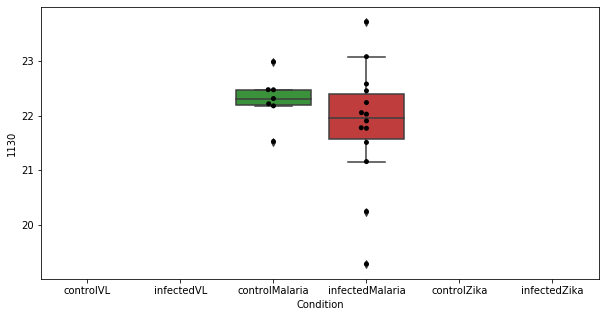

654 row m/z                261.023
row retention time     12.4758
p-val                 0.278181
adj.P.Val             0.827748
custom_id                 3890
compound_names             NaN
Name: 3890, dtype: object


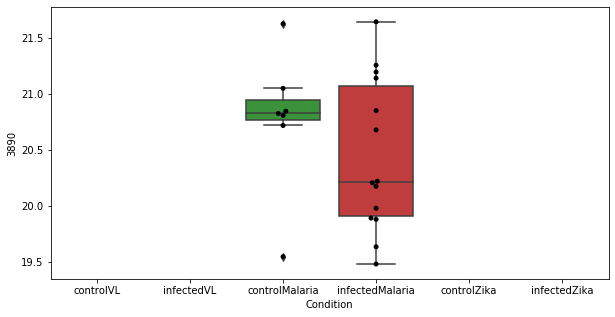

655 row m/z                256.059
row retention time     23.3094
p-val                 0.278663
adj.P.Val             0.827919
custom_id                 5043
compound_names             NaN
Name: 5043, dtype: object


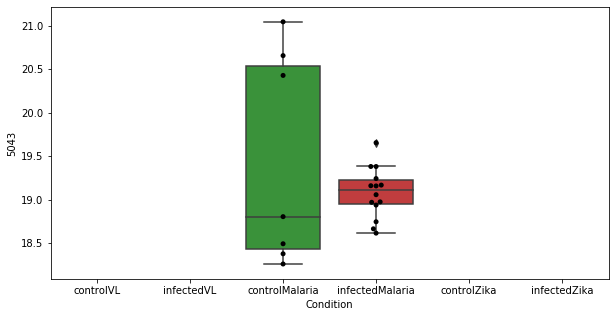

656 row m/z                                                         104.107
row retention time                                              6.85516
p-val                                                          0.280749
adj.P.Val                                                      0.832846
custom_id                                                           166
compound_names        L-Isoleucine; 2-Amino-3-methylvaleric acid$L-L...
Name: 166, dtype: object


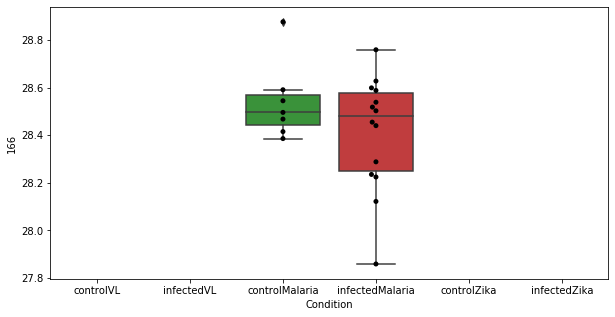

657 row m/z                                                   186.113
row retention time                                        7.00041
p-val                                                    0.281273
adj.P.Val                                                0.833132
custom_id                                                    1255
compound_names        3-Methoxytyramine$Epinine; Deoxyepinephrine
Name: 1255, dtype: object


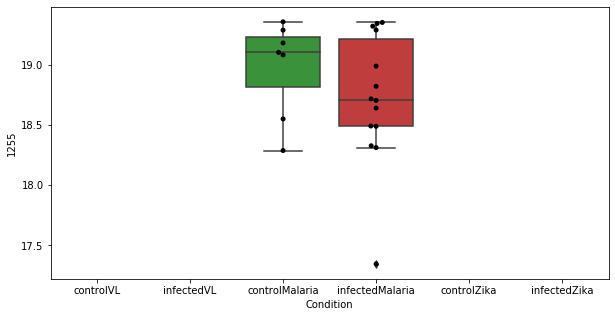

658 row m/z                211.133
row retention time     3.86309
p-val                  0.28197
adj.P.Val             0.833773
custom_id                 1540
compound_names             NaN
Name: 1540, dtype: object


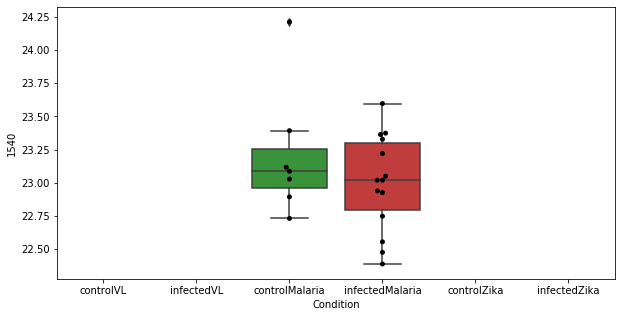

659 row m/z                876.559
row retention time     3.28106
p-val                 0.282727
adj.P.Val             0.833773
custom_id                 2973
compound_names             NaN
Name: 2973, dtype: object


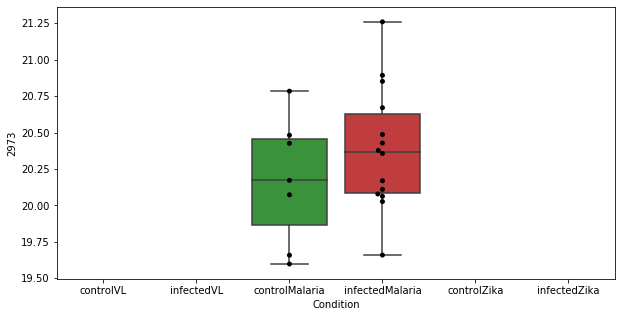

660 row m/z                                                         174.076
row retention time                                              6.99942
p-val                                                          0.282773
adj.P.Val                                                      0.833773
custom_id                                                          1116
compound_names        N-Acetyl-L-glutamate 5-semialdehyde; 2-Acetami...
Name: 1116, dtype: object


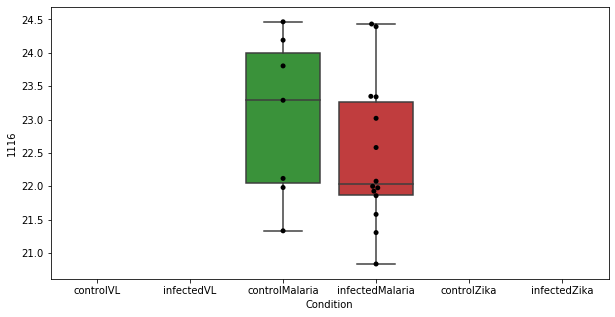

661 row m/z                                                         256.167
row retention time                                              8.74646
p-val                                                          0.284344
adj.P.Val                                                      0.834058
custom_id                                                          1955
compound_names        3-oxo-6(S)-hydroxy-tetradec-8Z-enoate$3-oxo-6(...
Name: 1955, dtype: object


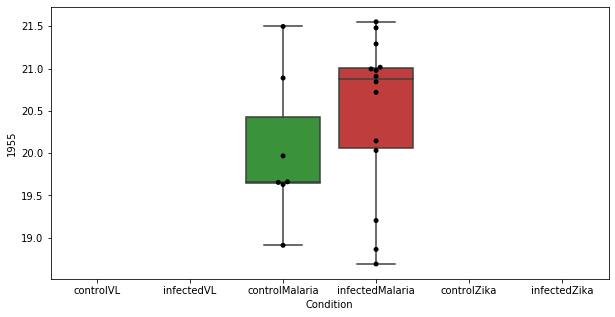

662 row m/z                144.928
row retention time     23.7737
p-val                 0.284663
adj.P.Val             0.834058
custom_id                  704
compound_names             NaN
Name: 704, dtype: object


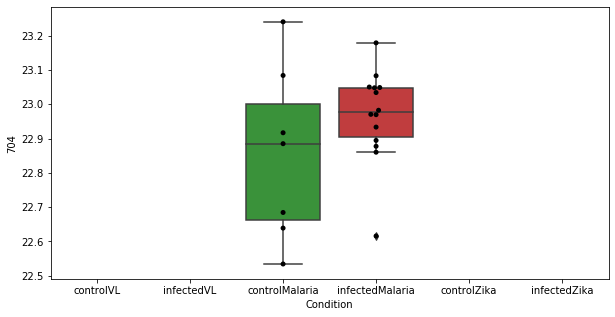

663 row m/z                                                         105.074
row retention time                                              10.5928
p-val                                                          0.284766
adj.P.Val                                                      0.834058
custom_id                                                           179
compound_names        N,N-Dimethylglycine; Dimethylglycine$(R)-3-Ami...
Name: 179, dtype: object


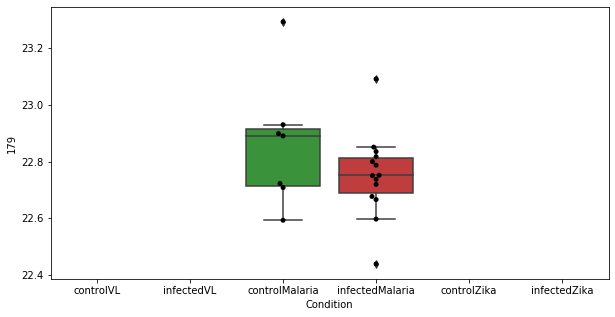

664 row m/z                145.097
row retention time     4.69171
p-val                 0.284952
adj.P.Val             0.834058
custom_id                 4633
compound_names             NaN
Name: 4633, dtype: object


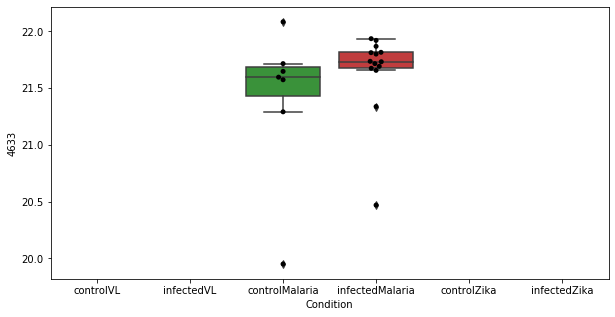

665 row m/z                                         151.112
row retention time                              4.10547
p-val                                          0.285009
adj.P.Val                                      0.834058
custom_id                                          4670
compound_names        Perillyl aldehyde; Perillaldehyde
Name: 4670, dtype: object


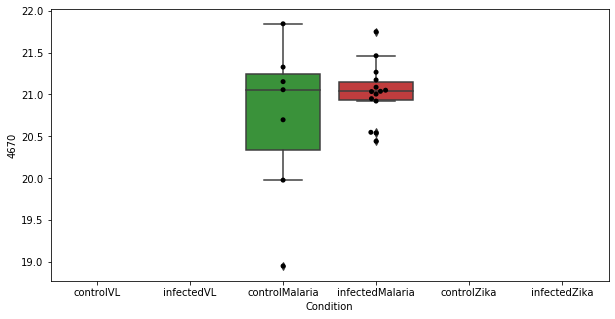

666 row m/z                244.118
row retention time      10.391
p-val                 0.285761
adj.P.Val             0.835004
custom_id                 3816
compound_names             NaN
Name: 3816, dtype: object


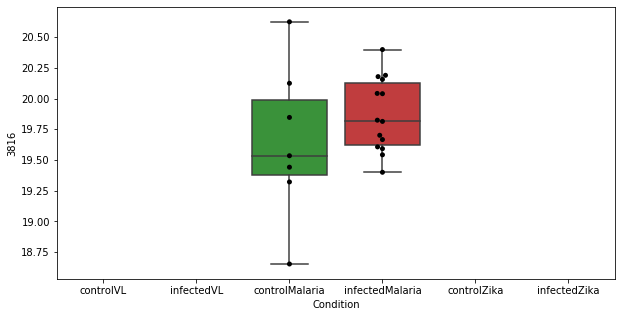

667 row m/z                 217.18
row retention time     8.33373
p-val                 0.287029
adj.P.Val             0.837455
custom_id                 1620
compound_names             NaN
Name: 1620, dtype: object


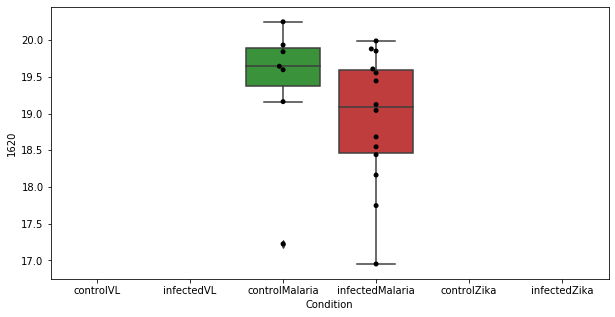

668 row m/z                                                         120.066
row retention time                                              9.88157
p-val                                                          0.287787
adj.P.Val                                                      0.837509
custom_id                                                           372
compound_names        L-Allothreonine; L-allo-Threonine$L-Threonine;...
Name: 372, dtype: object


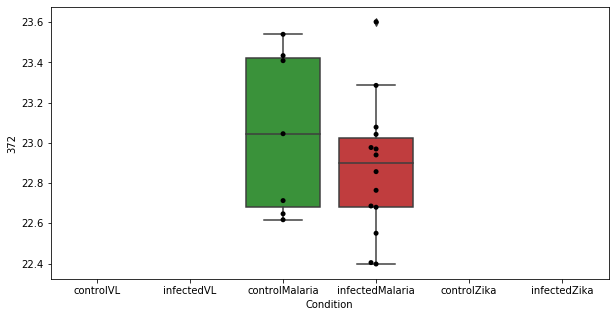

669 row m/z                                                         123.055
row retention time                                              9.57932
p-val                                                          0.288174
adj.P.Val                                                      0.837509
custom_id                                                           425
compound_names        Methylimidazoleacetic acid; Tele-methylimidazo...
Name: 425, dtype: object


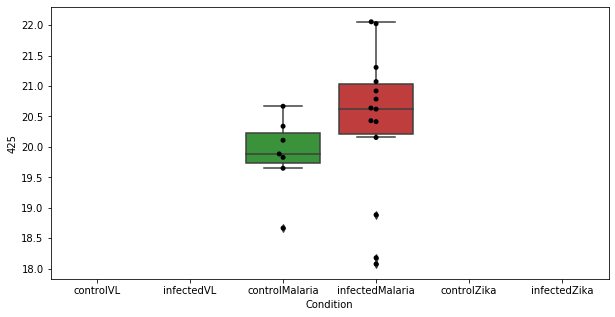

670 row m/z                284.185
row retention time      3.7769
p-val                 0.288734
adj.P.Val             0.837509
custom_id                 2160
compound_names             NaN
Name: 2160, dtype: object


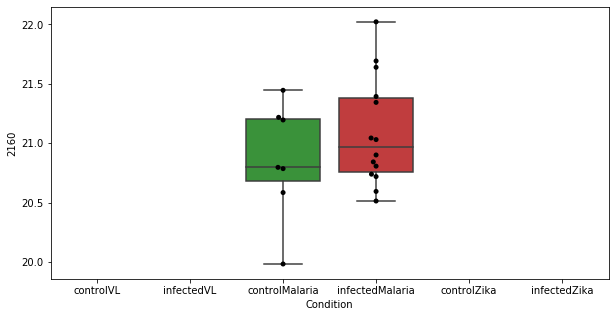

671 row m/z                158.081
row retention time     9.47122
p-val                 0.288875
adj.P.Val             0.837509
custom_id                  897
compound_names             NaN
Name: 897, dtype: object


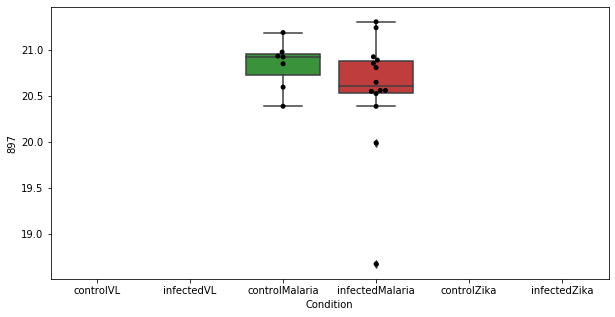

672 row m/z                 241.18
row retention time     3.76122
p-val                 0.289604
adj.P.Val             0.837509
custom_id                 1841
compound_names             NaN
Name: 1841, dtype: object


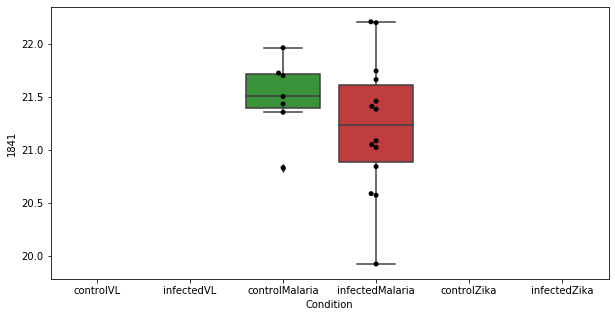

673 row m/z                194.085
row retention time      3.1886
p-val                 0.289626
adj.P.Val             0.837509
custom_id                 1366
compound_names             NaN
Name: 1366, dtype: object


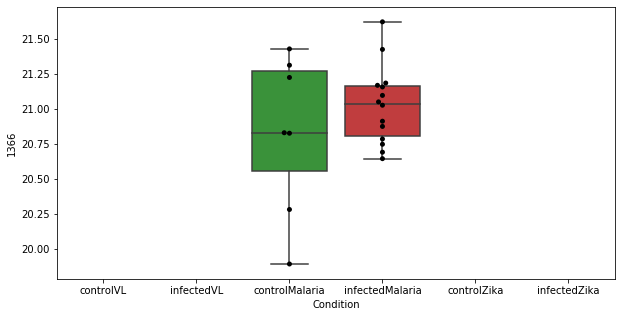

674 row m/z               329.154
row retention time    3.70225
p-val                 0.29028
adj.P.Val              0.8376
custom_id                2379
compound_names            NaN
Name: 2379, dtype: object


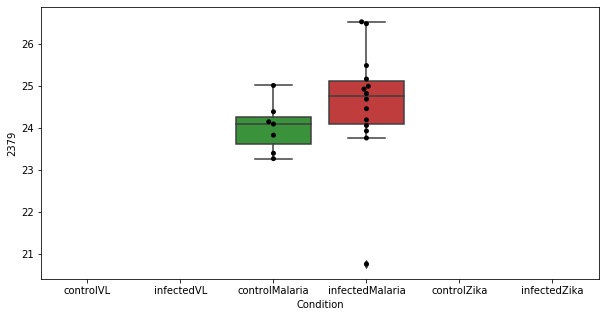

675 row m/z               122.006
row retention time     4.8899
p-val                 0.29107
adj.P.Val              0.8376
custom_id                 391
compound_names            NaN
Name: 391, dtype: object


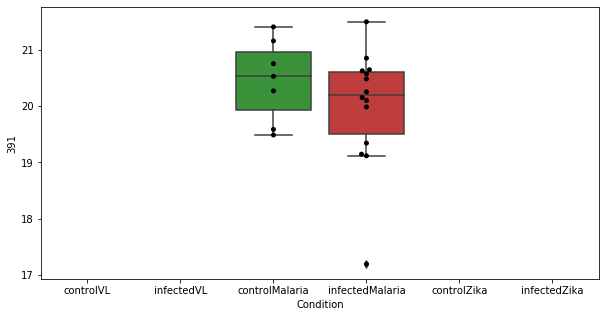

676 row m/z               267.159
row retention time    3.80683
p-val                 0.29138
adj.P.Val              0.8376
custom_id                2014
compound_names            NaN
Name: 2014, dtype: object


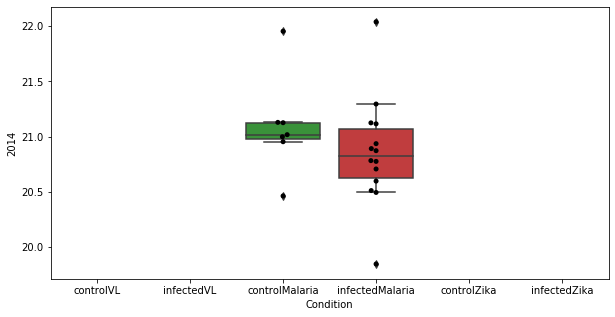

677 row m/z                257.153
row retention time     11.3625
p-val                 0.291679
adj.P.Val               0.8376
custom_id                 3876
compound_names             NaN
Name: 3876, dtype: object


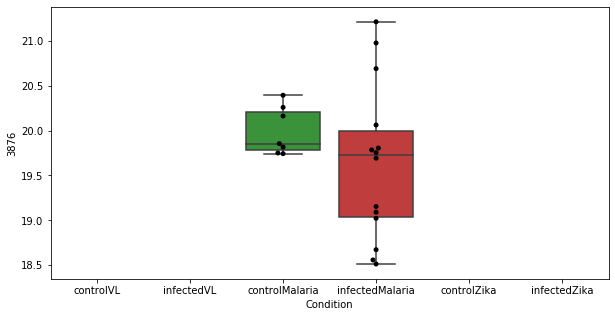

678 row m/z                  476.3
row retention time     3.24015
p-val                 0.291806
adj.P.Val               0.8376
custom_id                 4193
compound_names             NaN
Name: 4193, dtype: object


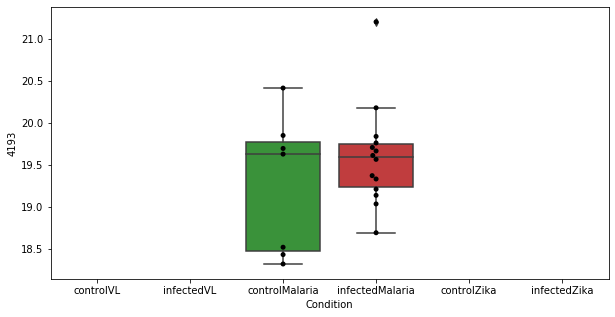

679 row m/z                 813.62
row retention time     3.49355
p-val                 0.293365
adj.P.Val             0.840836
custom_id                 2950
compound_names             NaN
Name: 2950, dtype: object


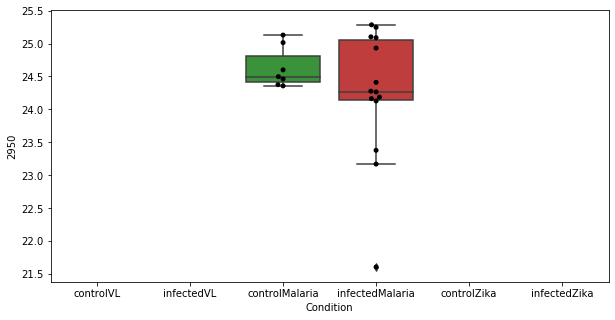

680 row m/z                532.411
row retention time     3.40035
p-val                 0.293955
adj.P.Val              0.84129
custom_id                 2665
compound_names             NaN
Name: 2665, dtype: object


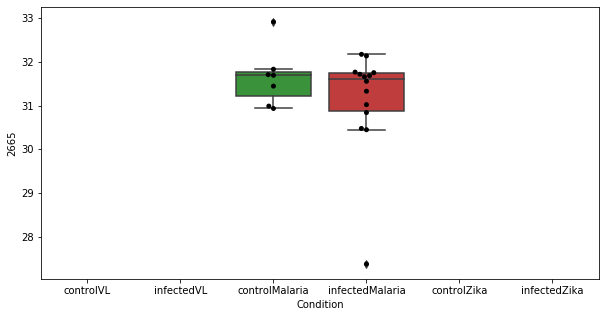

681 row m/z                188.128
row retention time     4.58422
p-val                  0.29529
adj.P.Val             0.842546
custom_id                 1285
compound_names             NaN
Name: 1285, dtype: object


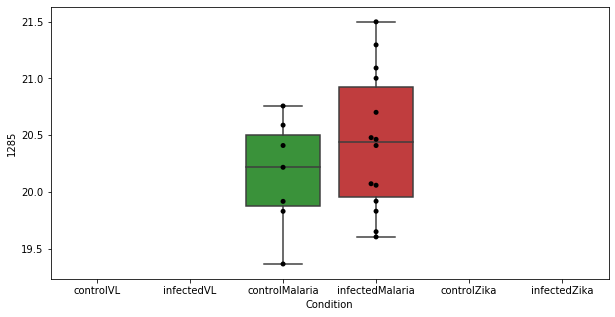

682 row m/z                                                         70.0651
row retention time                                              16.7591
p-val                                                          0.295515
adj.P.Val                                                      0.842546
custom_id                                                             3
compound_names        4-Aminobutanal; 4-Aminobutyraldehyde; Butyrald...
Name: 3, dtype: object


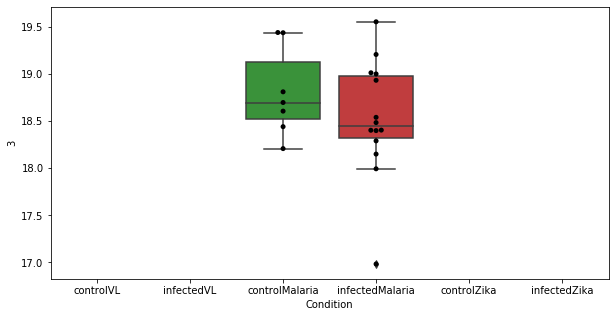

683 row m/z                232.118
row retention time     4.57825
p-val                 0.295691
adj.P.Val             0.842546
custom_id                 1736
compound_names             NaN
Name: 1736, dtype: object


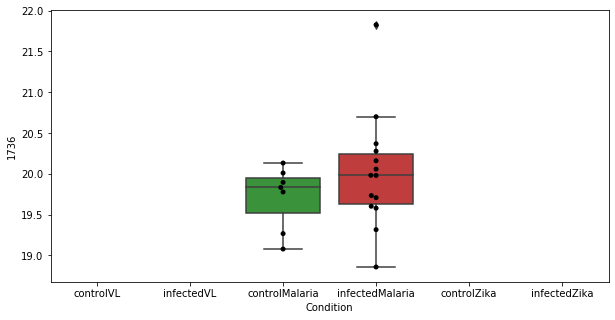

684 row m/z                205.082
row retention time     8.54478
p-val                 0.299251
adj.P.Val             0.851446
custom_id                 1476
compound_names             NaN
Name: 1476, dtype: object


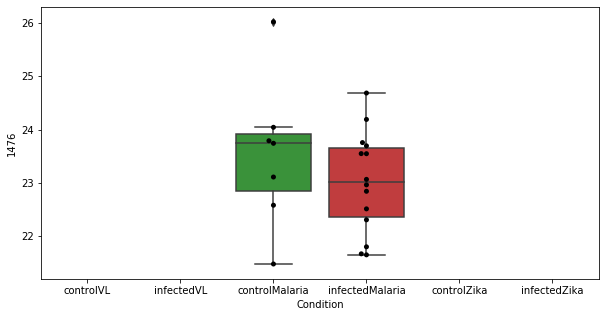

685 row m/z                236.916
row retention time     23.7664
p-val                 0.300395
adj.P.Val             0.853201
custom_id                 1787
compound_names             NaN
Name: 1787, dtype: object


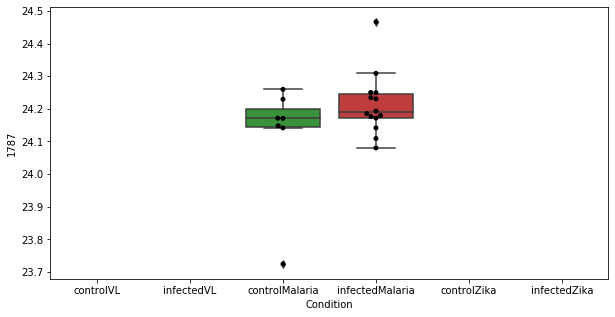

686 row m/z                202.043
row retention time     10.7987
p-val                 0.300743
adj.P.Val             0.853201
custom_id                 1446
compound_names             NaN
Name: 1446, dtype: object


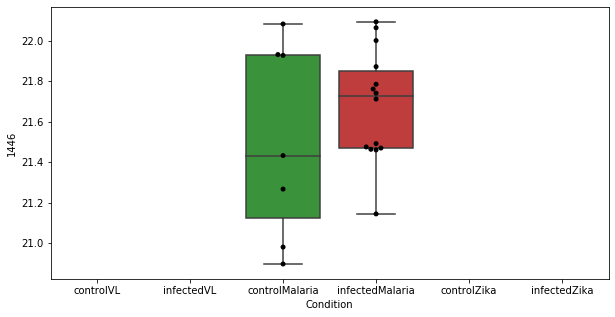

687 row m/z                272.222
row retention time     3.69048
p-val                 0.301756
adj.P.Val             0.854341
custom_id                 2063
compound_names             NaN
Name: 2063, dtype: object


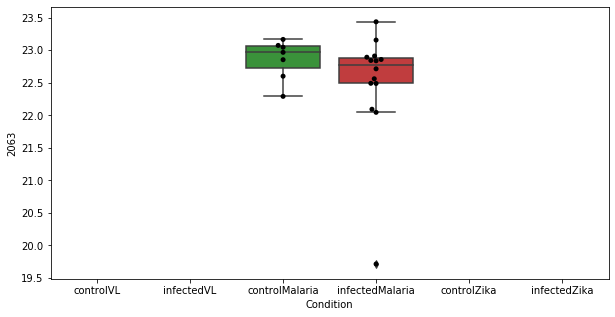

688 row m/z                240.134
row retention time     6.99503
p-val                 0.302022
adj.P.Val             0.854341
custom_id                 1828
compound_names             NaN
Name: 1828, dtype: object


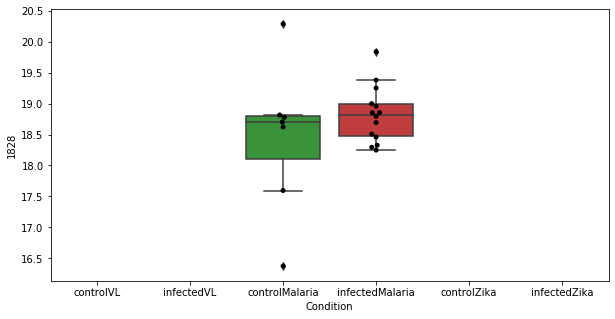

689 row m/z                304.175
row retention time     3.77494
p-val                  0.30334
adj.P.Val             0.856826
custom_id                 2259
compound_names             NaN
Name: 2259, dtype: object


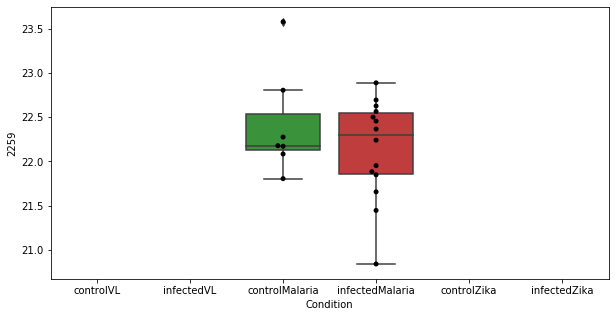

690 row m/z                246.134
row retention time     9.49364
p-val                 0.303887
adj.P.Val              0.85689
custom_id                 1876
compound_names             NaN
Name: 1876, dtype: object


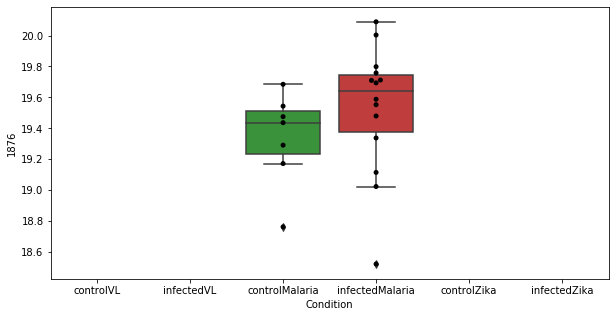

691 row m/z               106.086
row retention time    10.7119
p-val                 0.30433
adj.P.Val             0.85689
custom_id                5379
compound_names            NaN
Name: 5379, dtype: object


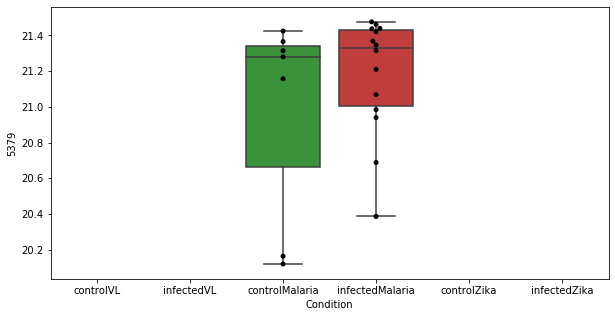

692 row m/z                416.185
row retention time     10.3935
p-val                 0.304825
adj.P.Val              0.85689
custom_id                 2553
compound_names             NaN
Name: 2553, dtype: object


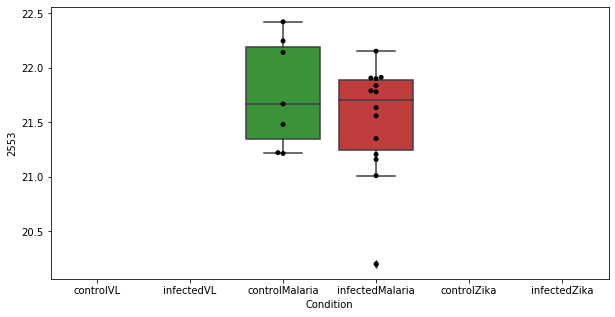

693 row m/z                727.835
row retention time     8.91342
p-val                 0.305122
adj.P.Val              0.85689
custom_id                 2837
compound_names             NaN
Name: 2837, dtype: object


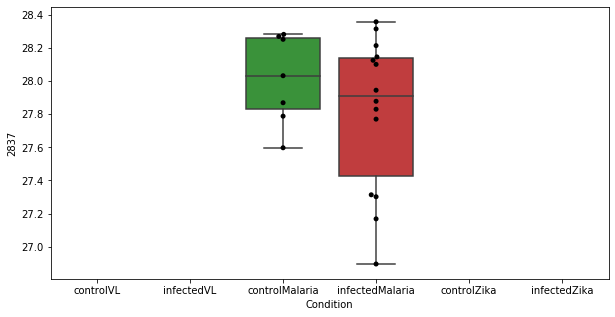

694 row m/z                 258.17
row retention time     3.79601
p-val                 0.306425
adj.P.Val             0.858105
custom_id                 1972
compound_names             NaN
Name: 1972, dtype: object


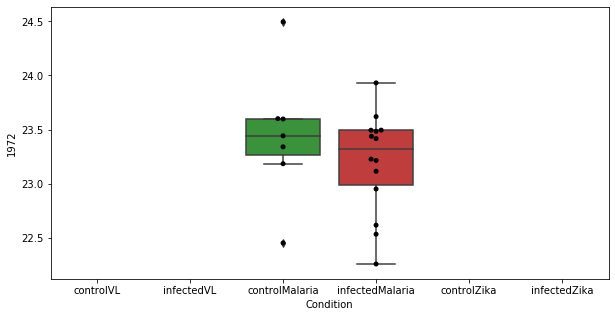

695 row m/z                                                         265.118
row retention time                                              6.99844
p-val                                                          0.307595
adj.P.Val                                                      0.858105
custom_id                                                          1999
compound_names        Formyl-N-acetyl-5-methoxykynurenamine$alpha-N-...
Name: 1999, dtype: object


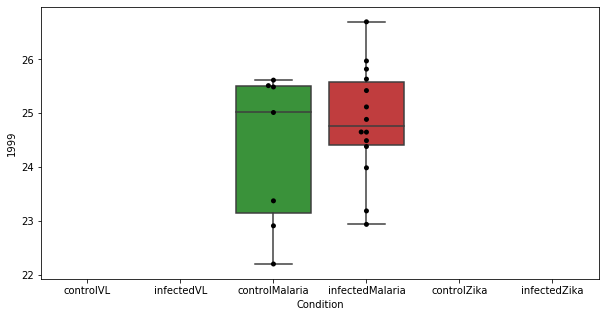

696 row m/z                274.165
row retention time     3.89185
p-val                 0.307637
adj.P.Val             0.858105
custom_id                 2069
compound_names             NaN
Name: 2069, dtype: object


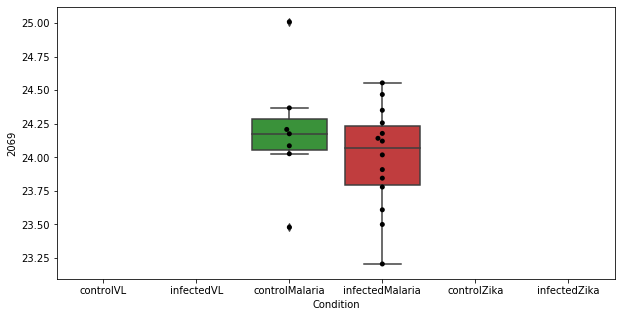

697 row m/z                260.001
row retention time     14.3797
p-val                 0.308084
adj.P.Val             0.858105
custom_id                 1976
compound_names             NaN
Name: 1976, dtype: object


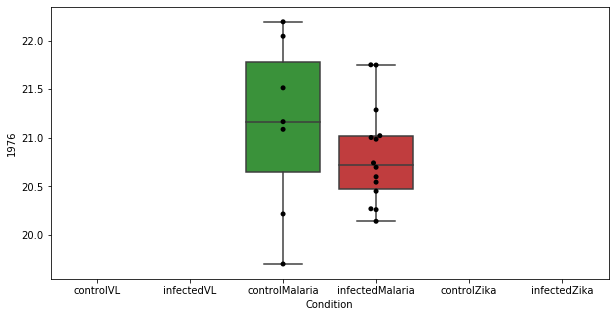

698 row m/z                150.113
row retention time     8.44538
p-val                 0.308619
adj.P.Val             0.858105
custom_id                  816
compound_names             NaN
Name: 816, dtype: object


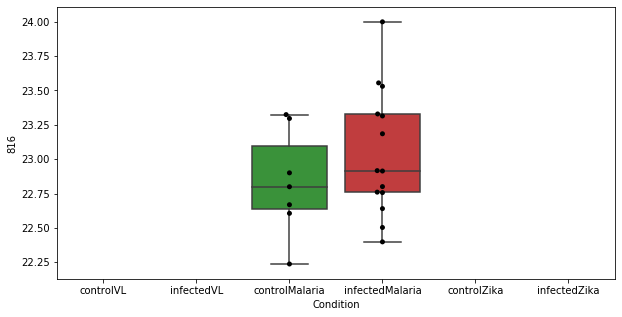

699 row m/z                                                         204.154
row retention time                                              16.0857
p-val                                                          0.310355
adj.P.Val                                                      0.858105
custom_id                                                          3639
compound_names        Nomega,Nomega'-Dimethyl-L-arginine; NG,NG-Dime...
Name: 3639, dtype: object


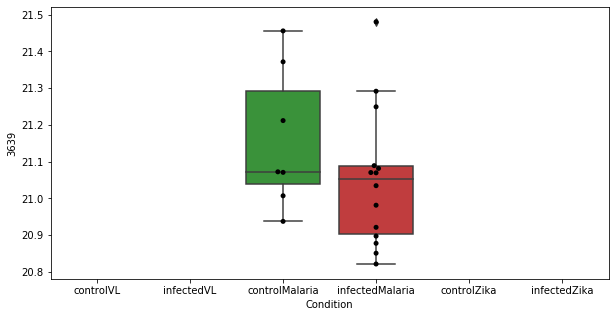

700 row m/z                279.159
row retention time      9.5594
p-val                  0.31049
adj.P.Val             0.858105
custom_id                 2133
compound_names             NaN
Name: 2133, dtype: object


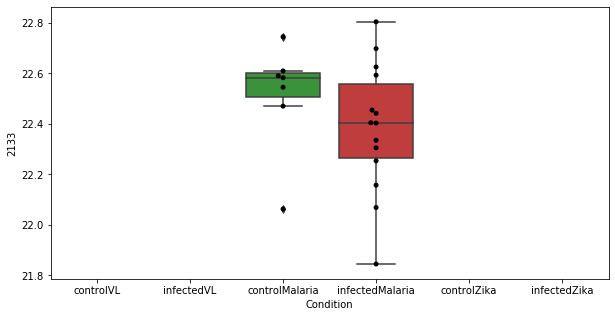

701 row m/z                                                         150.058
row retention time                                              10.1536
p-val                                                           0.31121
adj.P.Val                                                      0.858105
custom_id                                                           811
compound_names        L-Methionine; Methionine; L-2-Amino-4methylthi...
Name: 811, dtype: object


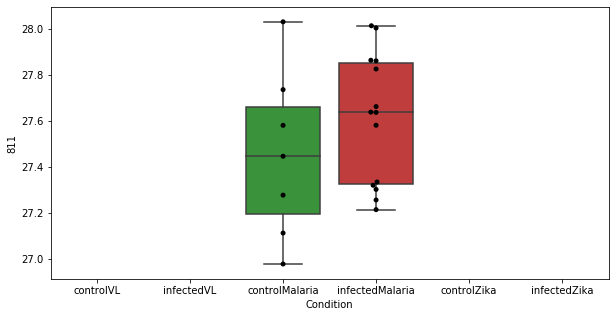

702 row m/z                185.129
row retention time     10.6083
p-val                 0.311224
adj.P.Val             0.858105
custom_id                 3560
compound_names             NaN
Name: 3560, dtype: object


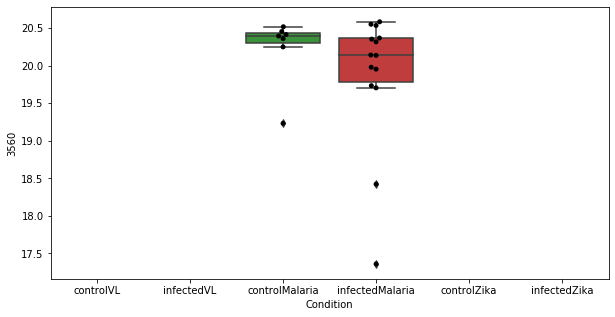

703 row m/z                                                         105.033
row retention time                                              7.00242
p-val                                                          0.311415
adj.P.Val                                                      0.858105
custom_id                                                           173
compound_names        Benzoate; Benzoic acid; Benzenecarboxylic acid...
Name: 173, dtype: object


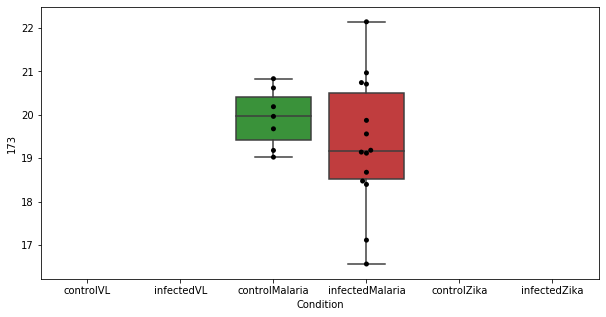

704 row m/z                                 328.162
row retention time                      10.9644
p-val                                  0.312716
adj.P.Val                              0.858105
custom_id                                  4085
compound_names        5'-carboxy-gama-chromanol
Name: 4085, dtype: object


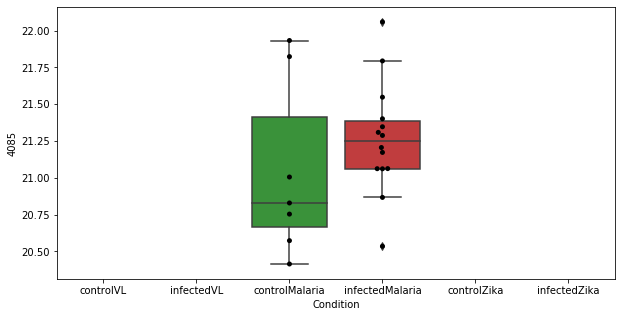

705 row m/z                290.269
row retention time     23.3369
p-val                 0.313041
adj.P.Val             0.858105
custom_id                 2209
compound_names             NaN
Name: 2209, dtype: object


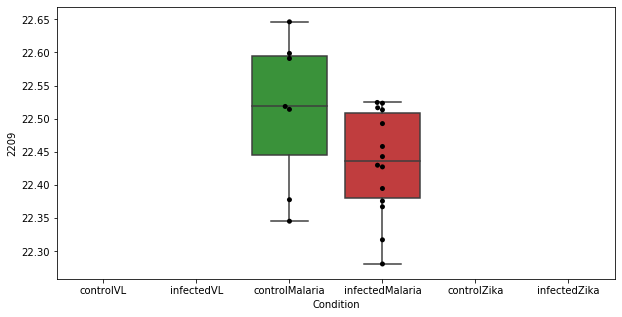

706 row m/z                                                         265.118
row retention time                                              4.58663
p-val                                                           0.31428
adj.P.Val                                                      0.858105
custom_id                                                          2000
compound_names        Formyl-N-acetyl-5-methoxykynurenamine$alpha-N-...
Name: 2000, dtype: object


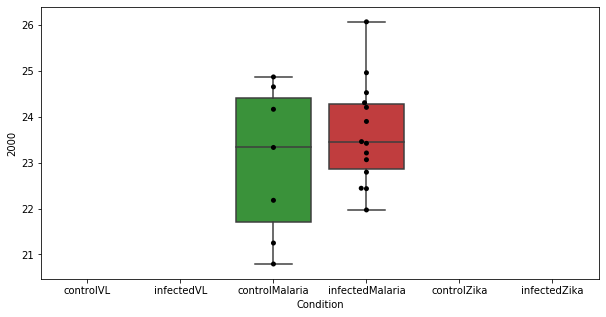

707 row m/z                227.132
row retention time     4.10302
p-val                 0.315273
adj.P.Val             0.858105
custom_id                 1685
compound_names             NaN
Name: 1685, dtype: object


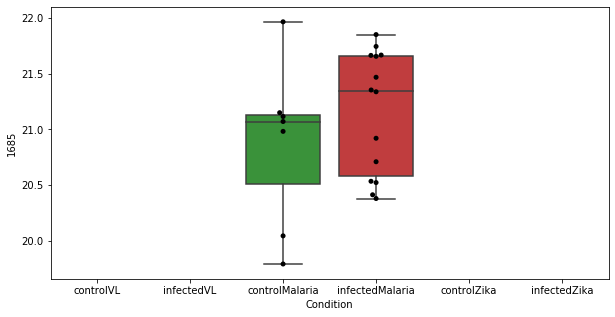

708 row m/z                 202.18
row retention time     23.8953
p-val                 0.315382
adj.P.Val             0.858105
custom_id                 4881
compound_names             NaN
Name: 4881, dtype: object


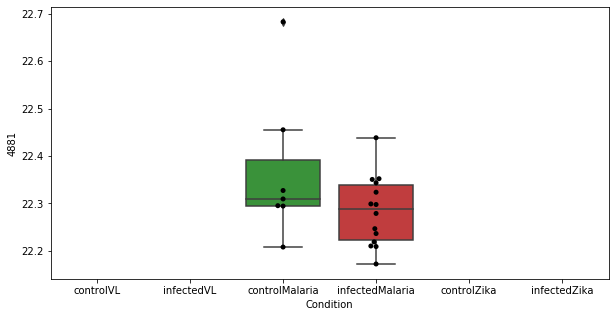

709 row m/z                512.335
row retention time     4.43621
p-val                 0.315404
adj.P.Val             0.858105
custom_id                 2638
compound_names             NaN
Name: 2638, dtype: object


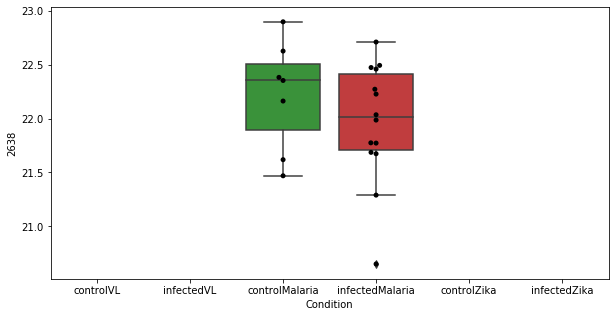

710 row m/z                115.123
row retention time     22.7193
p-val                 0.317778
adj.P.Val             0.858105
custom_id                  315
compound_names             NaN
Name: 315, dtype: object


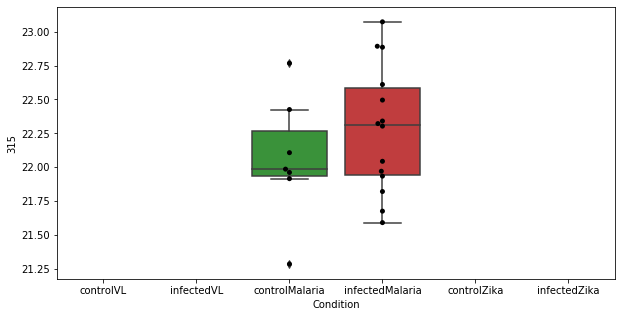

711 row m/z                165.062
row retention time     10.0993
p-val                 0.317808
adj.P.Val             0.858105
custom_id                  987
compound_names             NaN
Name: 987, dtype: object


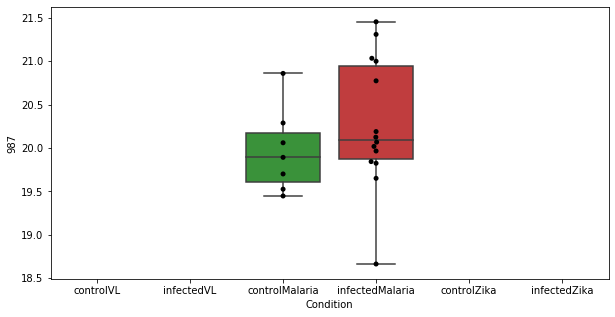

712 row m/z                73.0272
row retention time     3.38773
p-val                 0.318239
adj.P.Val             0.858105
custom_id                   11
compound_names             NaN
Name: 11, dtype: object


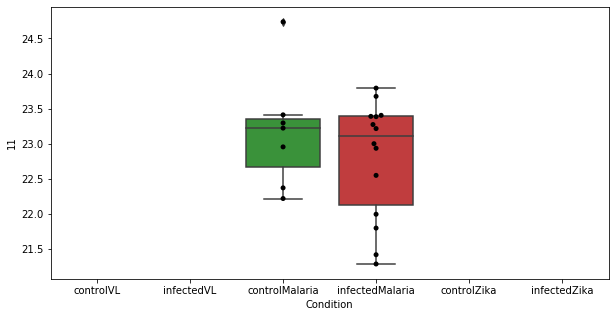

713 row m/z                155.093
row retention time     8.91042
p-val                 0.318629
adj.P.Val             0.858105
custom_id                  856
compound_names             NaN
Name: 856, dtype: object


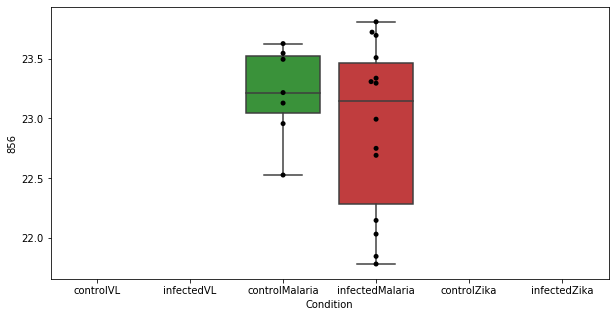

714 row m/z                122.945
row retention time     15.1271
p-val                 0.319278
adj.P.Val             0.858105
custom_id                  412
compound_names             NaN
Name: 412, dtype: object


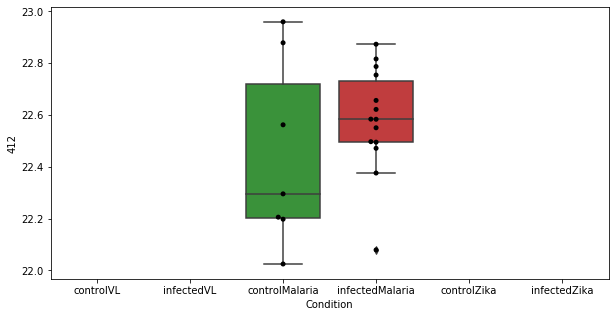

715 row m/z                676.546
row retention time     3.78688
p-val                 0.319608
adj.P.Val             0.858105
custom_id                 2802
compound_names             NaN
Name: 2802, dtype: object


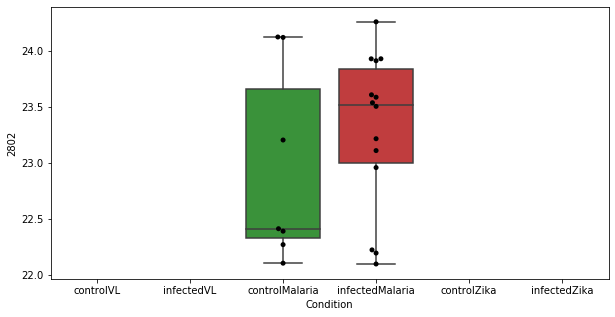

716 row m/z                                                         114.055
row retention time                                              8.69555
p-val                                                          0.319672
adj.P.Val                                                      0.858105
custom_id                                                           280
compound_names        5-Aminolevulinate; 5-Amino-4-oxopentanoate; 5-...
Name: 280, dtype: object


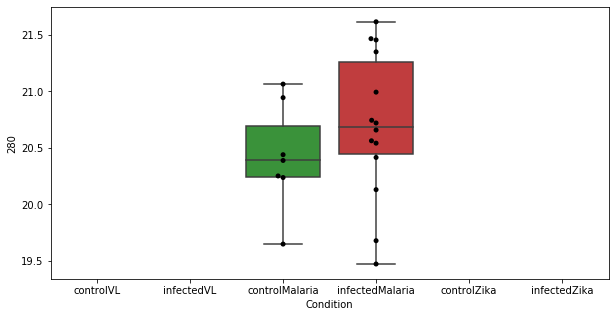

717 row m/z                                                          235.08
row retention time                                              11.3208
p-val                                                          0.319833
adj.P.Val                                                      0.858105
custom_id                                                          4985
compound_names        Nebularine; Purine riboside; N-D-Ribosylpurine...
Name: 4985, dtype: object


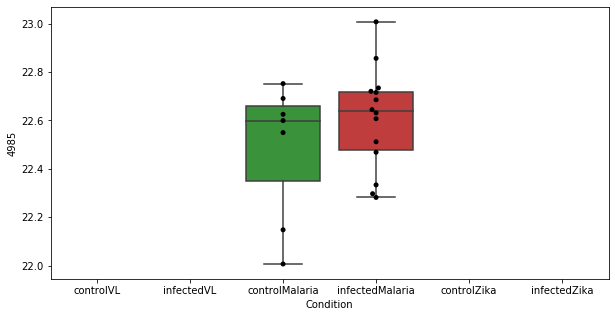

718 row m/z                                                          157.08
row retention time                                              12.3222
p-val                                                          0.320192
adj.P.Val                                                      0.858105
custom_id                                                           877
compound_names        L-Histidine; (S)-alpha-Amino-1H-imidazole-4-pr...
Name: 877, dtype: object


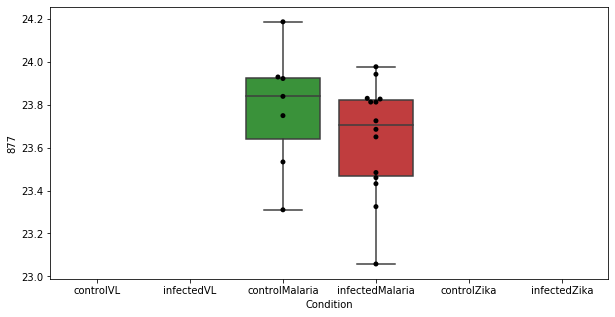

719 row m/z                792.588
row retention time     3.47341
p-val                 0.320487
adj.P.Val             0.858105
custom_id                 2921
compound_names             NaN
Name: 2921, dtype: object


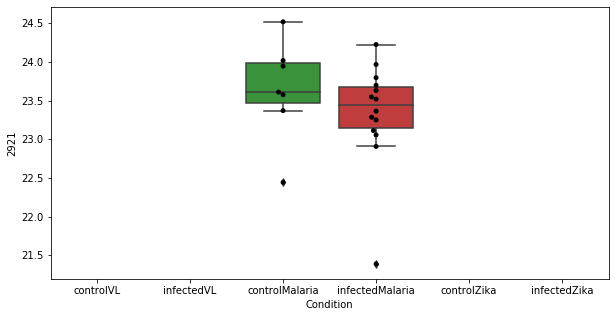

720 row m/z                234.133
row retention time      7.0005
p-val                 0.320554
adj.P.Val             0.858105
custom_id                 1755
compound_names             NaN
Name: 1755, dtype: object


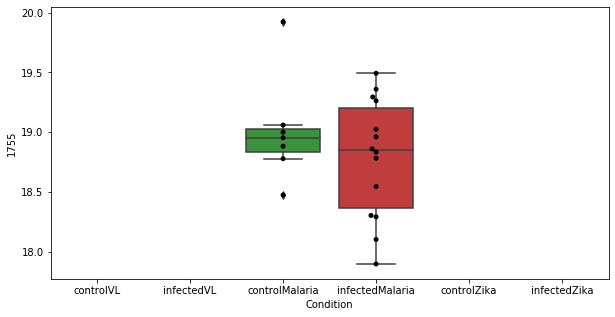

721 row m/z                115.094
row retention time     23.7651
p-val                 0.320688
adj.P.Val             0.858105
custom_id                 3167
compound_names             NaN
Name: 3167, dtype: object


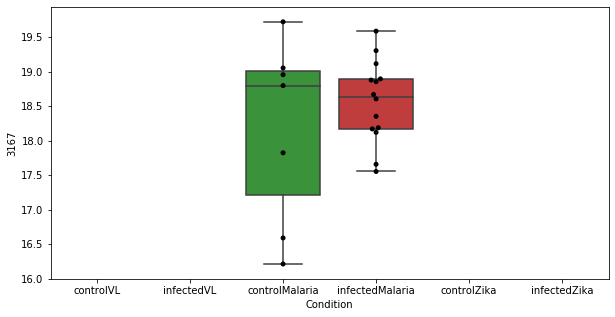

722 row m/z                312.217
row retention time     4.59155
p-val                 0.320757
adj.P.Val             0.858105
custom_id                 2297
compound_names             NaN
Name: 2297, dtype: object


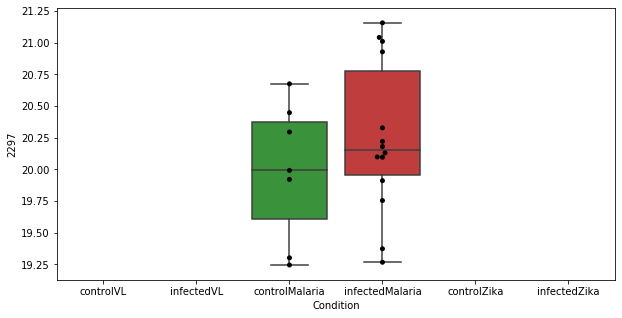

723 row m/z                533.403
row retention time     3.40523
p-val                 0.320836
adj.P.Val             0.858105
custom_id                 2667
compound_names             NaN
Name: 2667, dtype: object


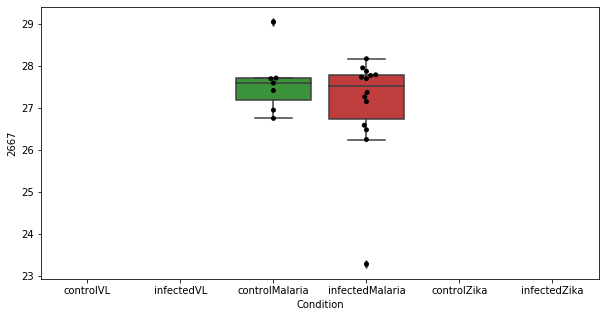

724 row m/z                368.425
row retention time     6.99864
p-val                 0.320842
adj.P.Val             0.858105
custom_id                 4141
compound_names             NaN
Name: 4141, dtype: object


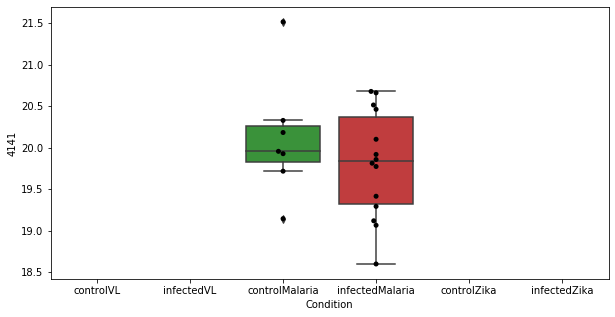

725 row m/z                190.053
row retention time     4.59742
p-val                 0.321504
adj.P.Val             0.858105
custom_id                 1310
compound_names             NaN
Name: 1310, dtype: object


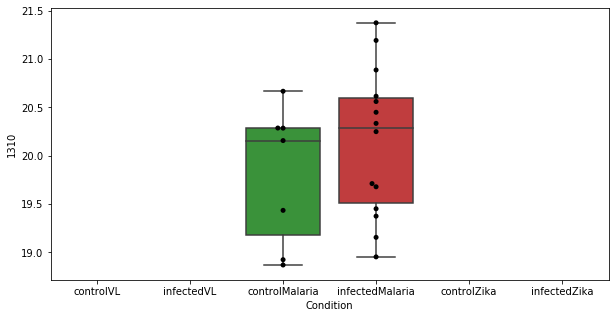

726 row m/z                                                   168.102
row retention time                                        7.00243
p-val                                                    0.321604
adj.P.Val                                                0.858105
custom_id                                                    1028
compound_names        3-Methoxytyramine$Epinine; Deoxyepinephrine
Name: 1028, dtype: object


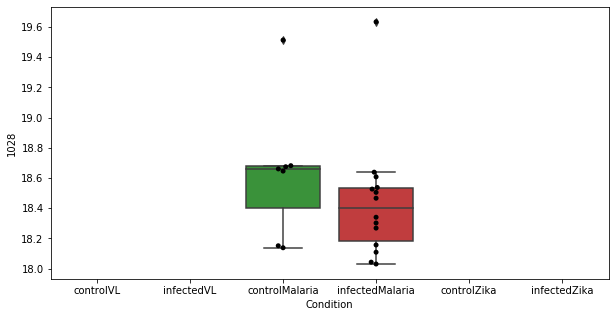

727 row m/z                                                         174.076
row retention time                                              4.83248
p-val                                                          0.321661
adj.P.Val                                                      0.858105
custom_id                                                          1117
compound_names        N-Acetyl-L-glutamate 5-semialdehyde; 2-Acetami...
Name: 1117, dtype: object


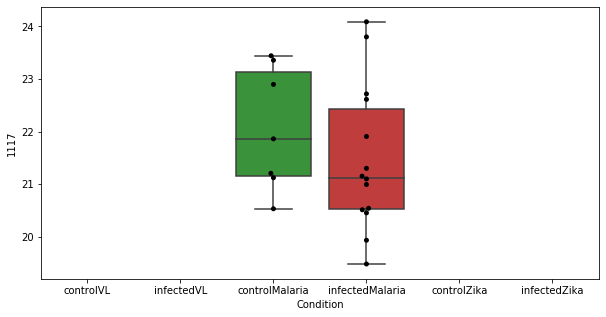

728 row m/z                188.007
row retention time     23.7801
p-val                 0.321811
adj.P.Val             0.858105
custom_id                 1272
compound_names             NaN
Name: 1272, dtype: object


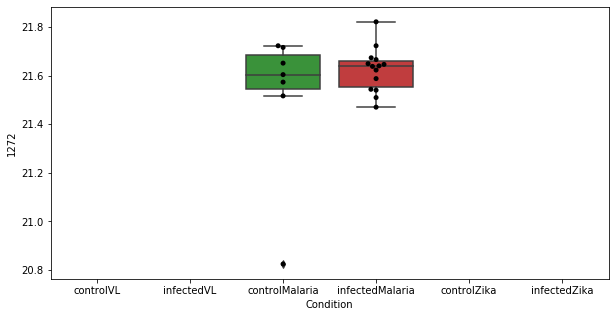

729 row m/z                 163.11
row retention time     11.1001
p-val                 0.322442
adj.P.Val             0.858105
custom_id                  969
compound_names             NaN
Name: 969, dtype: object


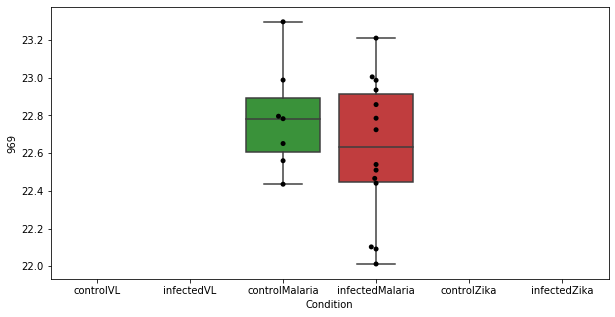

730 row m/z                274.936
row retention time     12.8893
p-val                 0.323109
adj.P.Val             0.858105
custom_id                 3937
compound_names             NaN
Name: 3937, dtype: object


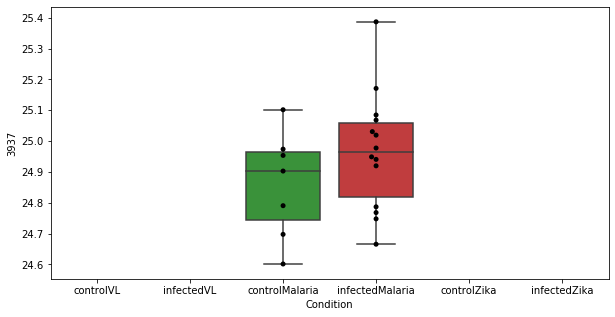

731 row m/z                236.998
row retention time     14.0856
p-val                 0.323149
adj.P.Val             0.858105
custom_id                 1789
compound_names             NaN
Name: 1789, dtype: object


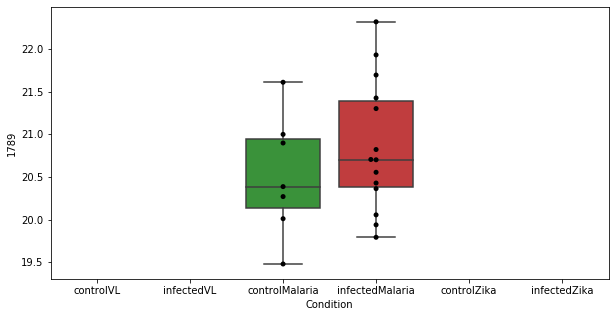

732 row m/z                                                         129.066
row retention time                                              11.3628
p-val                                                          0.323536
adj.P.Val                                                      0.858105
custom_id                                                           493
compound_names        D-Glutamine; D-2-Aminoglutaramic acid$L-Glutam...
Name: 493, dtype: object


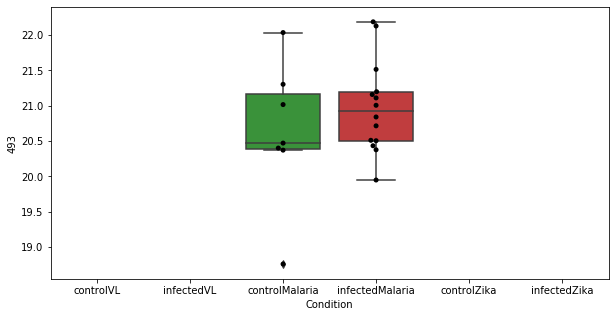

733 row m/z                815.697
row retention time     3.62894
p-val                 0.323846
adj.P.Val             0.858105
custom_id                 2958
compound_names             NaN
Name: 2958, dtype: object


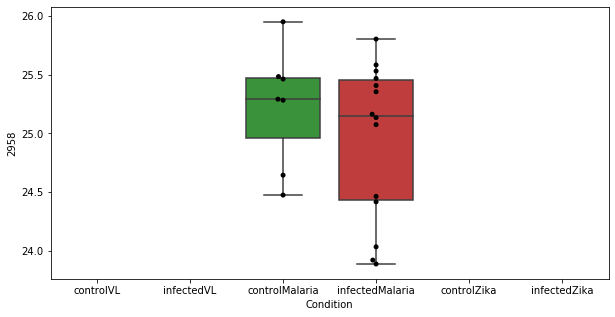

734 row m/z                145.097
row retention time     23.7167
p-val                 0.324794
adj.P.Val             0.858105
custom_id                  718
compound_names             NaN
Name: 718, dtype: object


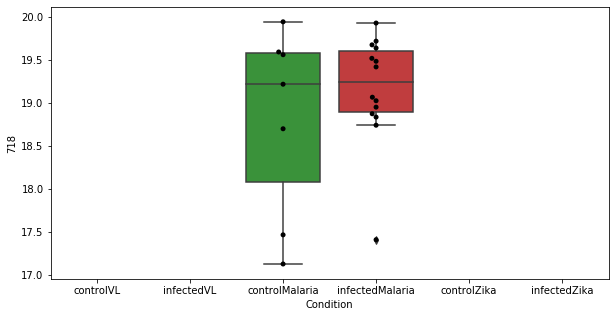

735 row m/z                                               168.102
row retention time                                    4.57777
p-val                                                0.325336
adj.P.Val                                            0.858105
custom_id                                                1027
compound_names        $2-Phenyl-1,3-propanediol monocarbamate
Name: 1027, dtype: object


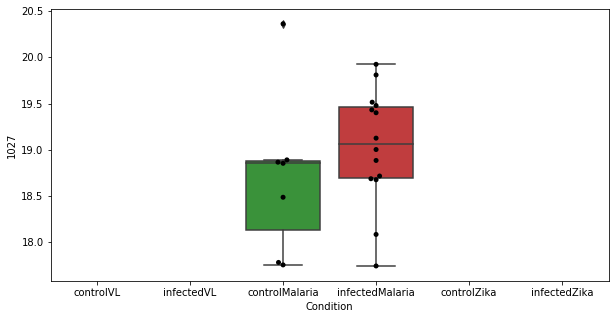

736 row m/z                104.998
row retention time     3.40325
p-val                 0.325499
adj.P.Val             0.858105
custom_id                  170
compound_names             NaN
Name: 170, dtype: object


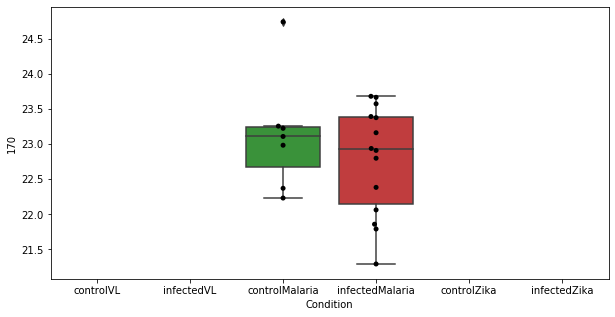

737 row m/z                344.243
row retention time     3.68116
p-val                 0.325512
adj.P.Val             0.858105
custom_id                 2416
compound_names             NaN
Name: 2416, dtype: object


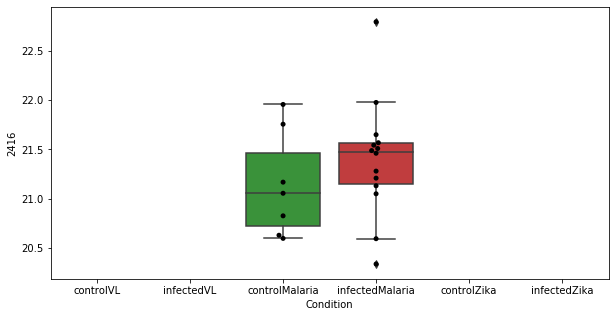

738 row m/z                340.041
row retention time     8.17854
p-val                 0.325547
adj.P.Val             0.858105
custom_id                 5177
compound_names             NaN
Name: 5177, dtype: object


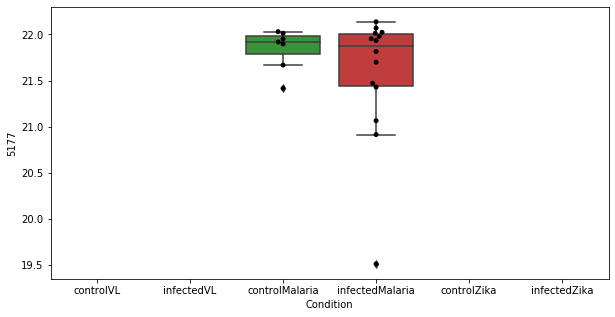

739 row m/z                363.256
row retention time     3.58602
p-val                 0.325888
adj.P.Val             0.858105
custom_id                 2447
compound_names             NaN
Name: 2447, dtype: object


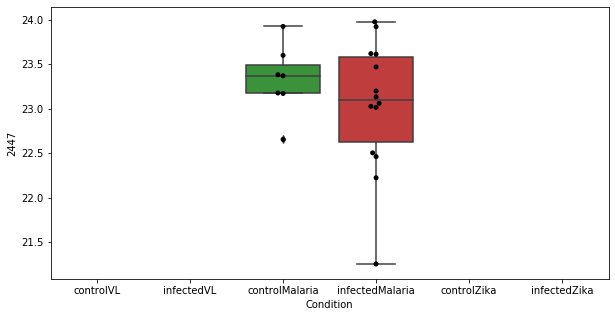

740 row m/z                161.999
row retention time      10.514
p-val                  0.32777
adj.P.Val             0.858105
custom_id                  944
compound_names             NaN
Name: 944, dtype: object


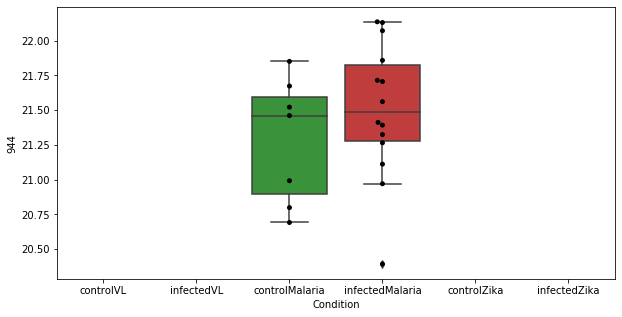

741 row m/z                                                          131.09
row retention time                                              10.6957
p-val                                                          0.328007
adj.P.Val                                                      0.858105
custom_id                                                           535
compound_names        N4-Acetylaminobutanal$L-Pipecolate; Pipecolini...
Name: 535, dtype: object


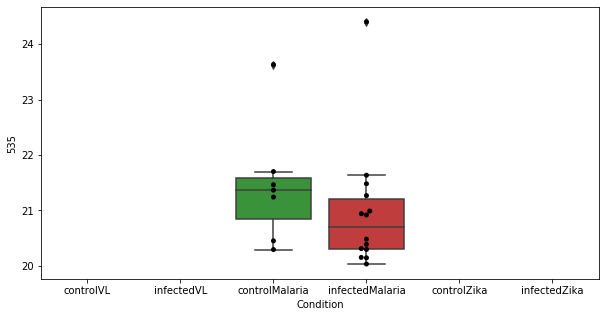

742 row m/z                746.604
row retention time      3.5248
p-val                 0.329047
adj.P.Val             0.858105
custom_id                 2859
compound_names             NaN
Name: 2859, dtype: object


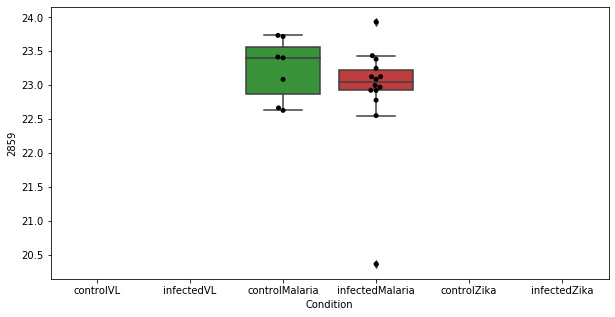

743 row m/z                227.128
row retention time     3.82661
p-val                 0.329362
adj.P.Val             0.858105
custom_id                 1684
compound_names             NaN
Name: 1684, dtype: object


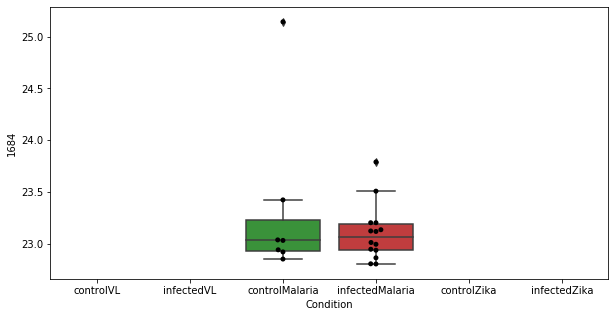

744 row m/z                144.928
row retention time     2.79561
p-val                 0.329689
adj.P.Val             0.858105
custom_id                  705
compound_names             NaN
Name: 705, dtype: object


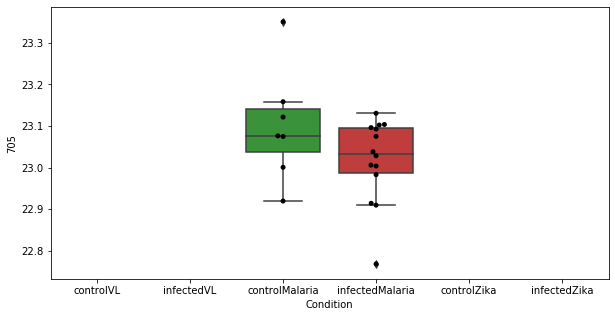

745 row m/z                 115.07
row retention time     8.90445
p-val                 0.329828
adj.P.Val             0.858105
custom_id                  303
compound_names             NaN
Name: 303, dtype: object


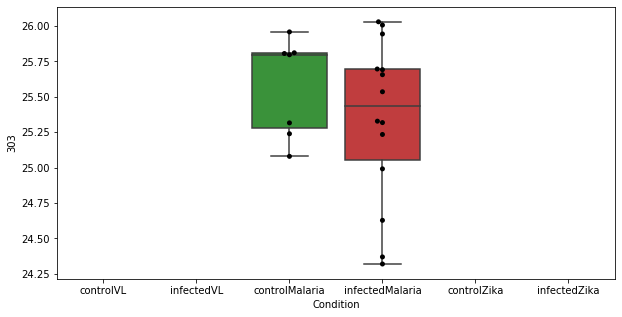

746 row m/z                                                         133.032
row retention time                                              10.1618
p-val                                                          0.329886
adj.P.Val                                                      0.858105
custom_id                                                           568
compound_names        L-Methionine; Methionine; L-2-Amino-4methylthi...
Name: 568, dtype: object


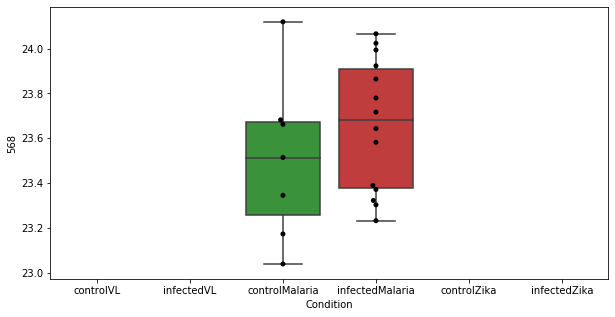

747 row m/z                377.236
row retention time      3.6191
p-val                 0.330046
adj.P.Val             0.858105
custom_id                 2466
compound_names             NaN
Name: 2466, dtype: object


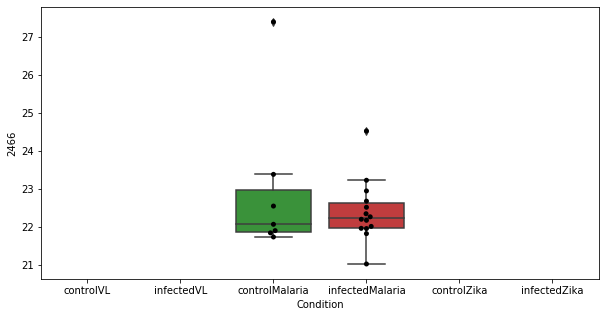

748 row m/z                645.818
row retention time     8.74928
p-val                 0.330136
adj.P.Val             0.858105
custom_id                 2783
compound_names             NaN
Name: 2783, dtype: object


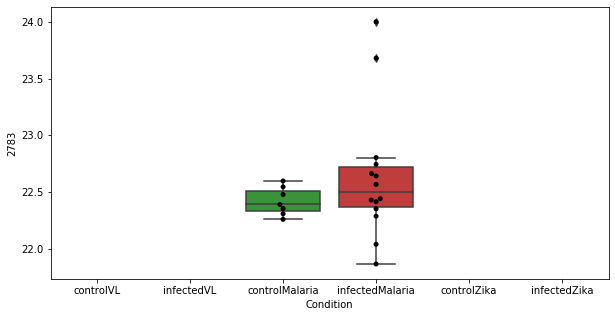

749 row m/z                759.635
row retention time     4.25223
p-val                 0.330406
adj.P.Val             0.858105
custom_id                 2869
compound_names             NaN
Name: 2869, dtype: object


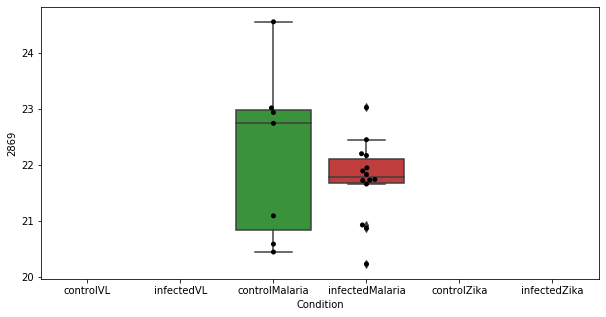

750 row m/z                413.778
row retention time     23.7134
p-val                 0.330753
adj.P.Val             0.858105
custom_id                 2545
compound_names             NaN
Name: 2545, dtype: object


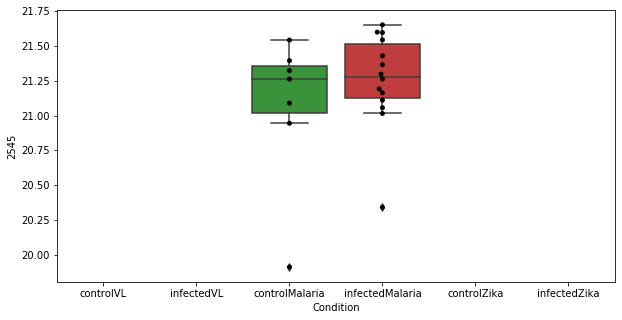

751 row m/z                 82.945
row retention time     4.64889
p-val                 0.332153
adj.P.Val             0.858105
custom_id                   47
compound_names             NaN
Name: 47, dtype: object


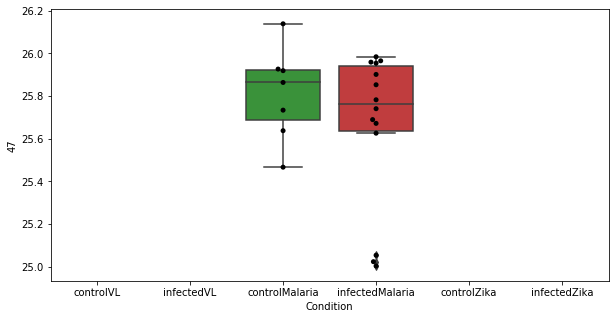

752 row m/z                241.143
row retention time     3.94953
p-val                 0.332838
adj.P.Val             0.858105
custom_id                 1837
compound_names             NaN
Name: 1837, dtype: object


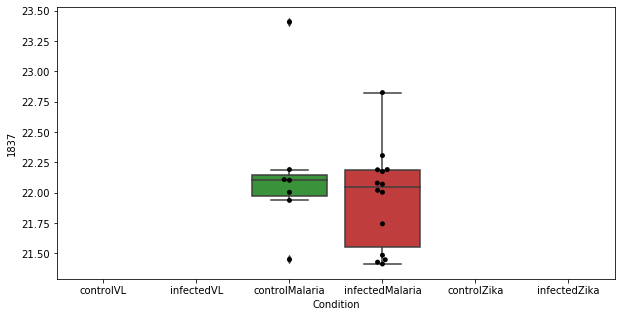

753 row m/z                 688.86
row retention time     8.72441
p-val                  0.33291
adj.P.Val             0.858105
custom_id                 2815
compound_names             NaN
Name: 2815, dtype: object


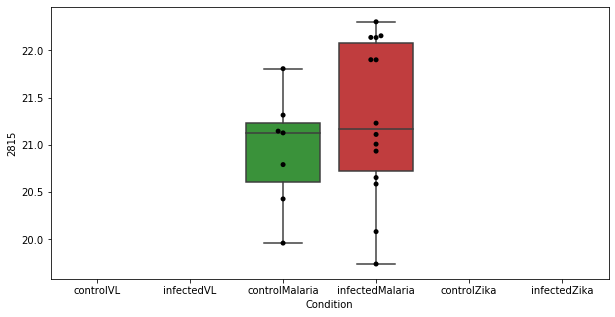

754 row m/z                405.199
row retention time      2.9167
p-val                 0.332939
adj.P.Val             0.858105
custom_id                 2534
compound_names             NaN
Name: 2534, dtype: object


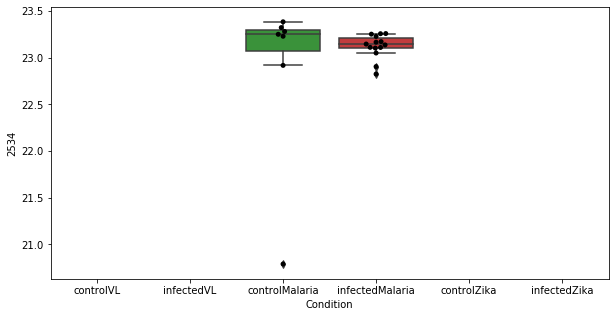

755 row m/z                296.051
row retention time     23.9004
p-val                   0.3331
adj.P.Val             0.858105
custom_id                 4013
compound_names             NaN
Name: 4013, dtype: object


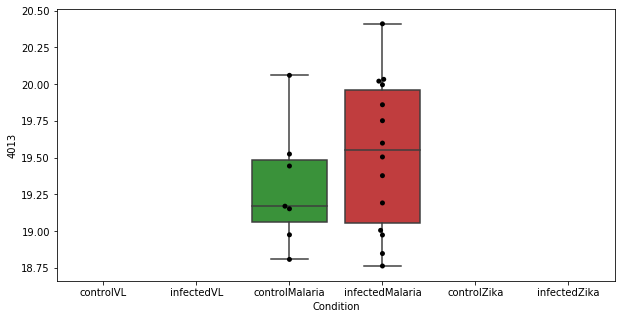

756 row m/z                376.233
row retention time     3.76592
p-val                 0.333292
adj.P.Val             0.858105
custom_id                 2465
compound_names             NaN
Name: 2465, dtype: object


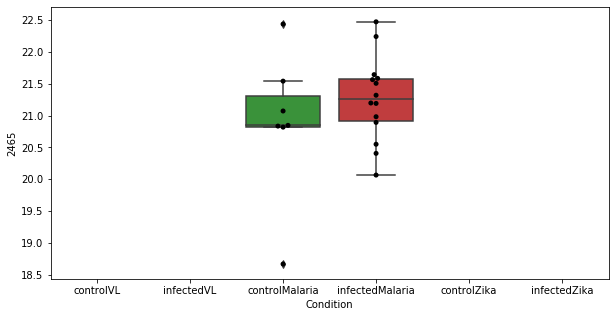

757 row m/z                261.121
row retention time     23.7205
p-val                 0.333843
adj.P.Val              0.85839
custom_id                 3892
compound_names             NaN
Name: 3892, dtype: object


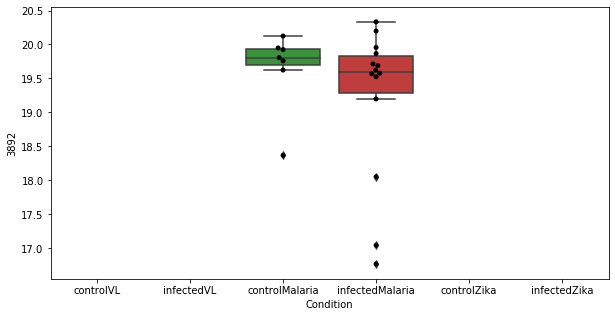

758 row m/z                229.155
row retention time     10.8919
p-val                 0.334671
adj.P.Val             0.859387
custom_id                 1718
compound_names             NaN
Name: 1718, dtype: object


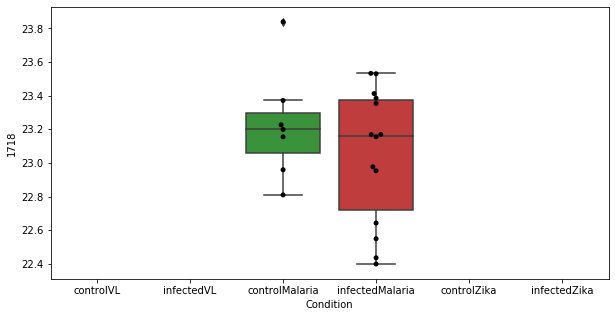

759 row m/z                170.154
row retention time      3.7763
p-val                  0.33562
adj.P.Val             0.859646
custom_id                 1067
compound_names             NaN
Name: 1067, dtype: object


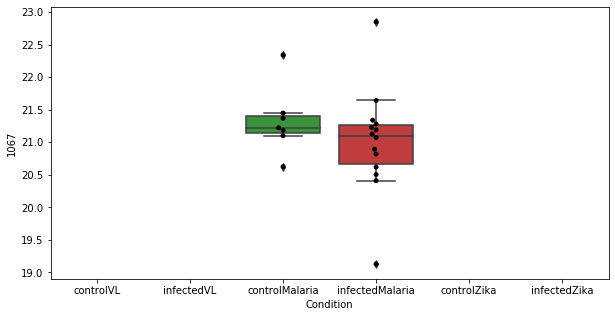

760 row m/z                517.392
row retention time     3.43871
p-val                 0.335654
adj.P.Val             0.859646
custom_id                 2640
compound_names             NaN
Name: 2640, dtype: object


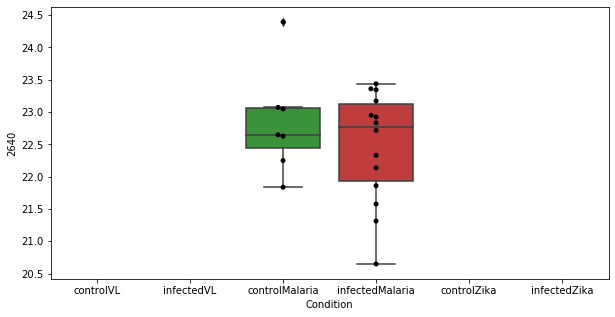

761 row m/z                             132.102
row retention time                   4.5551
p-val                              0.336394
adj.P.Val                          0.859683
custom_id                              3266
compound_names        5-Acetamidopentanoate
Name: 3266, dtype: object


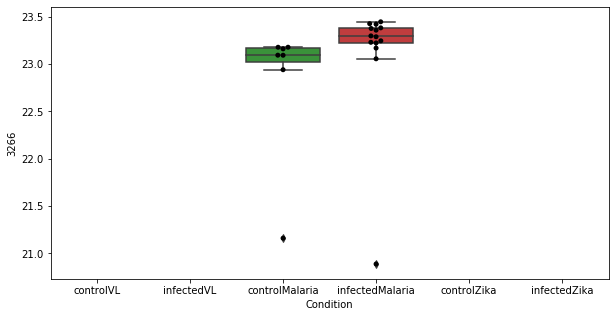

762 row m/z                                                         116.071
row retention time                                               16.764
p-val                                                          0.337162
adj.P.Val                                                      0.859683
custom_id                                                           321
compound_names        L-Ornithine; (S)-2,5-Diaminovaleric acid; (S)-...
Name: 321, dtype: object


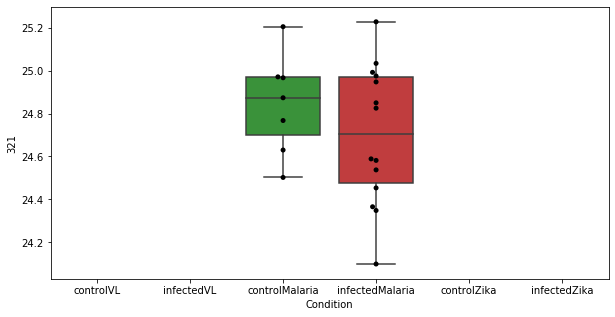

763 row m/z                531.407
row retention time     3.40033
p-val                  0.33721
adj.P.Val             0.859683
custom_id                 2663
compound_names             NaN
Name: 2663, dtype: object


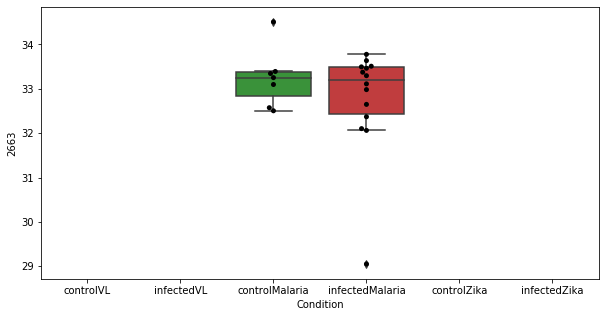

764 row m/z                144.102
row retention time     11.1899
p-val                 0.337976
adj.P.Val             0.859683
custom_id                  693
compound_names             NaN
Name: 693, dtype: object


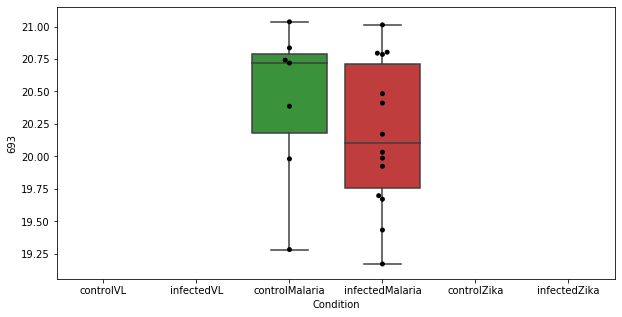

765 row m/z                                                         200.128
row retention time                                              3.94866
p-val                                                          0.338149
adj.P.Val                                                      0.859683
custom_id                                                          1433
compound_names        Peptide 2-[3-carboxy-3-(methylammonio)propyl]-...
Name: 1433, dtype: object


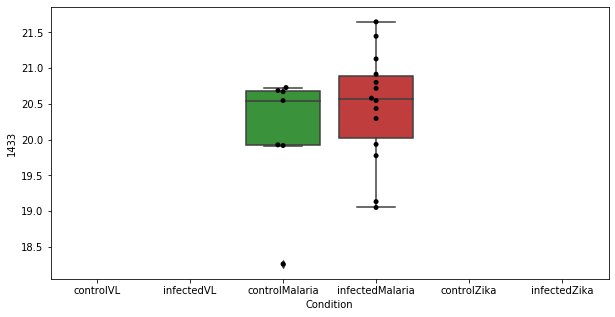

766 row m/z                                                         114.066
row retention time                                              8.90444
p-val                                                          0.338315
adj.P.Val                                                      0.859683
custom_id                                                           286
compound_names        Creatine; alpha-Methylguanidino acetic acid; M...
Name: 286, dtype: object


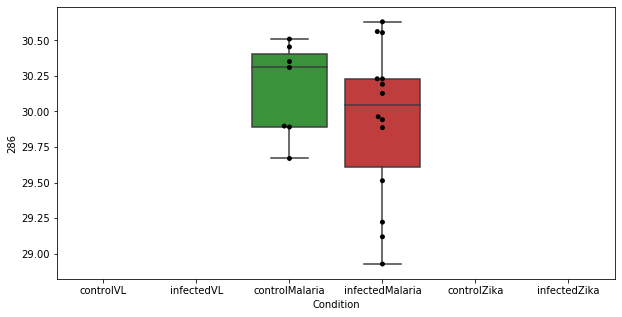

767 row m/z               533.414
row retention time     3.3974
p-val                 0.33939
adj.P.Val             0.86009
custom_id                2669
compound_names            NaN
Name: 2669, dtype: object


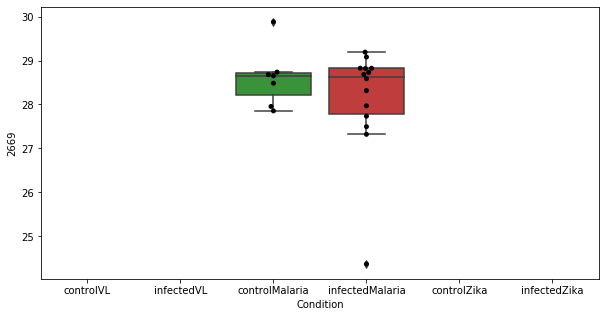

768 row m/z                                                          148.06
row retention time                                              9.91525
p-val                                                          0.339756
adj.P.Val                                                       0.86009
custom_id                                                           778
compound_names        L-4-Hydroxyglutamate semialdehyde$D-Glutamate;...
Name: 778, dtype: object


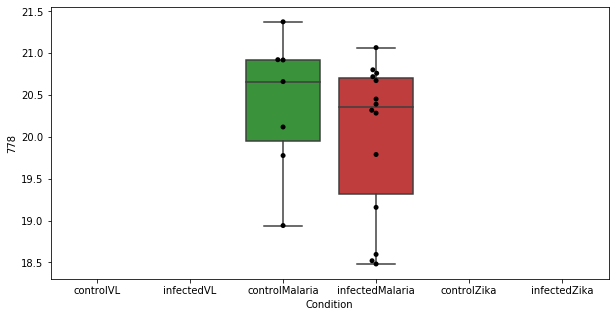

769 row m/z                234.077
row retention time     23.7306
p-val                 0.340799
adj.P.Val              0.86009
custom_id                 1751
compound_names             NaN
Name: 1751, dtype: object


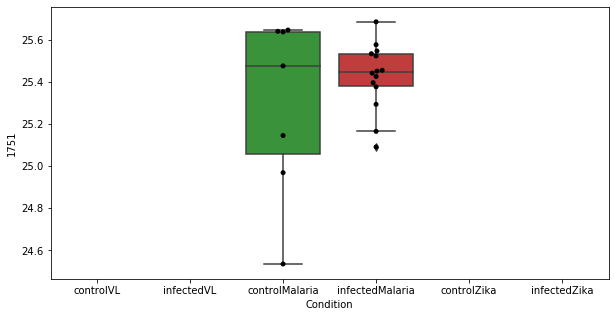

770 row m/z                759.636
row retention time     3.64776
p-val                 0.341159
adj.P.Val              0.86009
custom_id                 2868
compound_names             NaN
Name: 2868, dtype: object


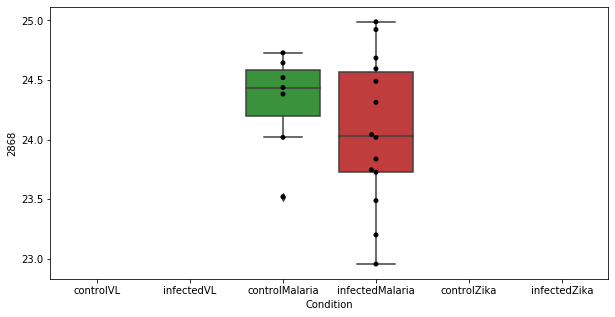

771 row m/z                790.621
row retention time     3.50671
p-val                 0.341192
adj.P.Val              0.86009
custom_id                 2920
compound_names             NaN
Name: 2920, dtype: object


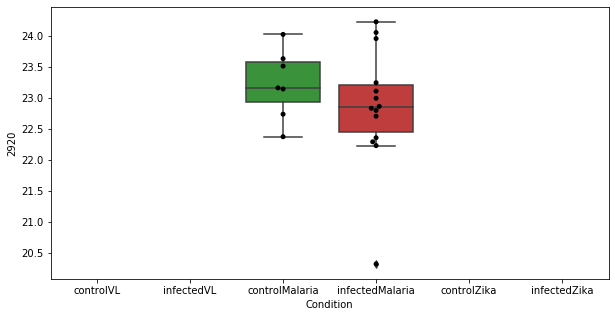

772 row m/z                290.196
row retention time     3.81064
p-val                 0.341554
adj.P.Val              0.86009
custom_id                 2208
compound_names             NaN
Name: 2208, dtype: object


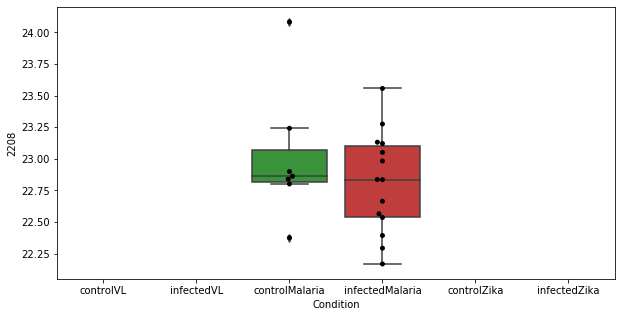

773 row m/z                286.179
row retention time     9.86401
p-val                 0.341565
adj.P.Val              0.86009
custom_id                 2173
compound_names             NaN
Name: 2173, dtype: object


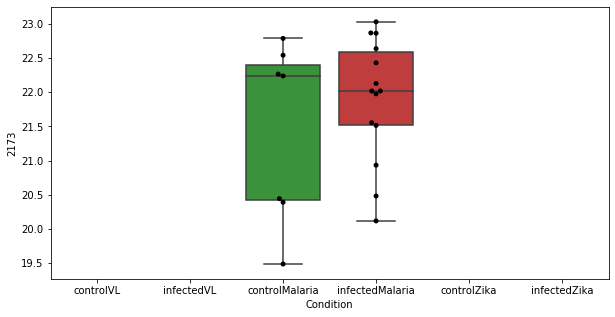

774 row m/z                549.437
row retention time      3.4069
p-val                 0.342239
adj.P.Val             0.860676
custom_id                 2697
compound_names             NaN
Name: 2697, dtype: object


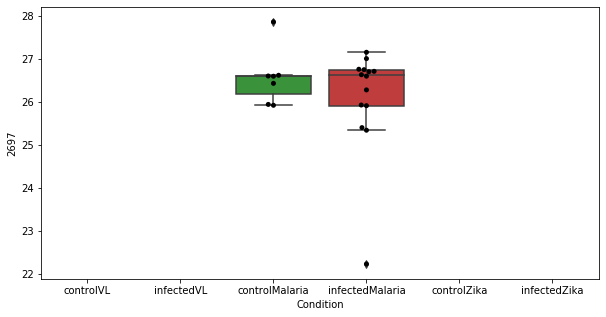

775 row m/z                631.803
row retention time     9.01306
p-val                 0.343268
adj.P.Val             0.860927
custom_id                 2766
compound_names             NaN
Name: 2766, dtype: object


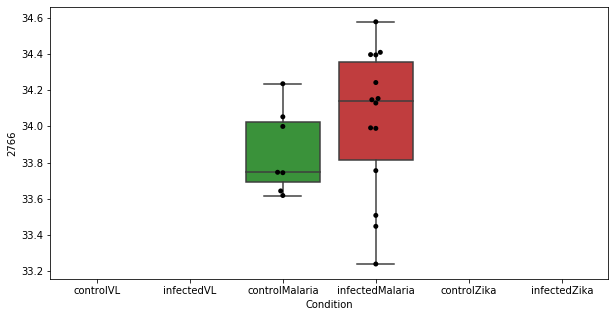

776 row m/z                257.113
row retention time     8.35124
p-val                 0.343799
adj.P.Val             0.860927
custom_id                 1959
compound_names             NaN
Name: 1959, dtype: object


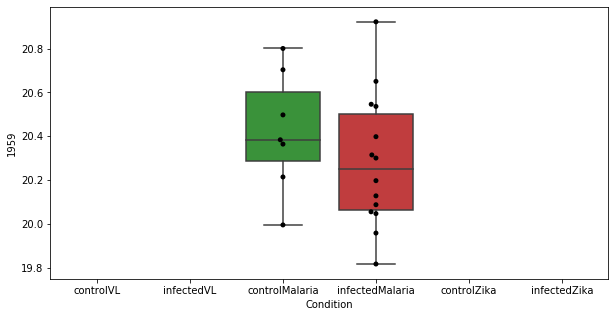

777 row m/z                327.847
row retention time     7.08461
p-val                  0.34475
adj.P.Val             0.860927
custom_id                 4081
compound_names             NaN
Name: 4081, dtype: object


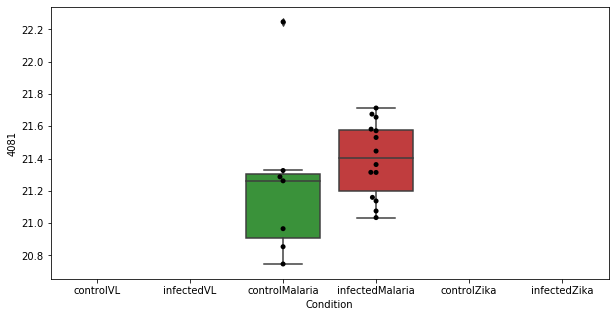

778 row m/z                595.513
row retention time     3.23443
p-val                 0.344912
adj.P.Val             0.860927
custom_id                 4240
compound_names             NaN
Name: 4240, dtype: object


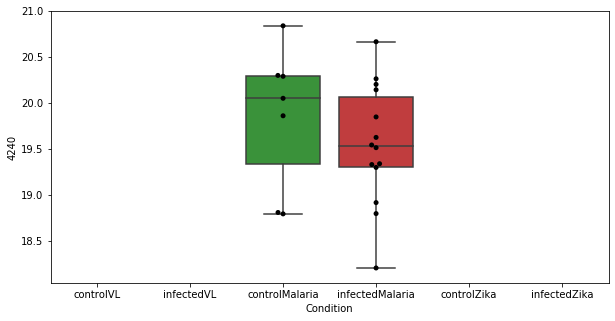

779 row m/z                 217.18
row retention time     3.24767
p-val                 0.345392
adj.P.Val             0.860927
custom_id                 3713
compound_names             NaN
Name: 3713, dtype: object


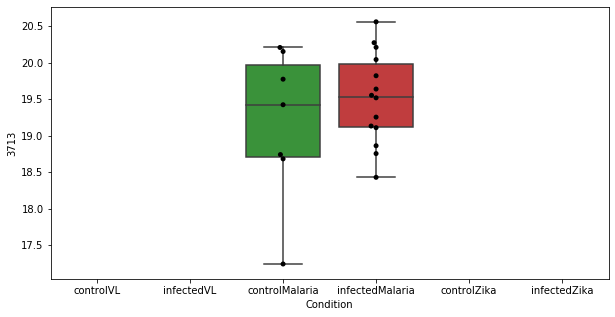

780 row m/z                                                         233.113
row retention time                                              3.84068
p-val                                                          0.345424
adj.P.Val                                                      0.860927
custom_id                                                          1744
compound_names        N2-Succinyl-L-ornithine; (2S)-5-Amino-2-(3-car...
Name: 1744, dtype: object


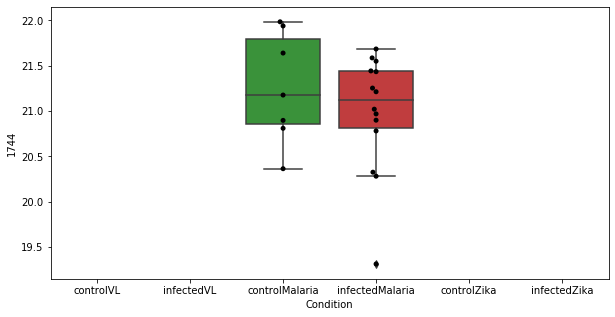

781 row m/z                627.535
row retention time     3.27582
p-val                 0.345431
adj.P.Val             0.860927
custom_id                 4246
compound_names             NaN
Name: 4246, dtype: object


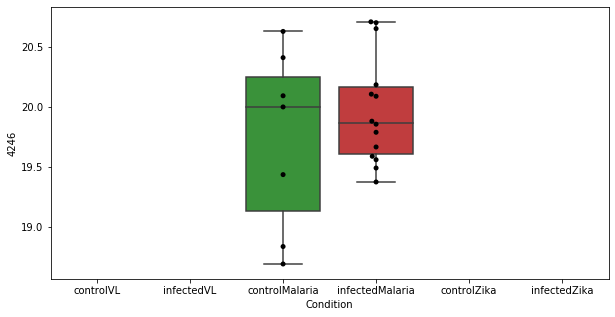

782 row m/z                548.434
row retention time     3.40524
p-val                 0.346916
adj.P.Val             0.863525
custom_id                 2693
compound_names             NaN
Name: 2693, dtype: object


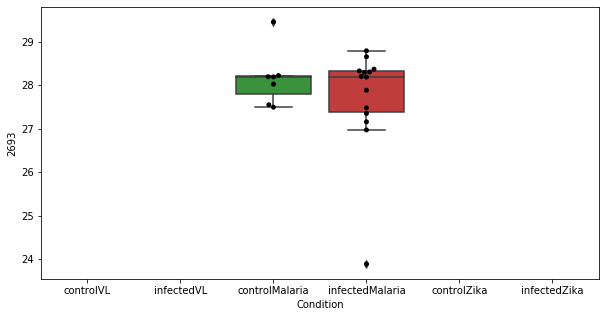

783 row m/z                                                157.097
row retention time                                     23.5891
p-val                                                 0.348385
adj.P.Val                                             0.866074
custom_id                                                  887
compound_names        N-Acetylornithine; N2-Acetyl-L-ornithine
Name: 887, dtype: object


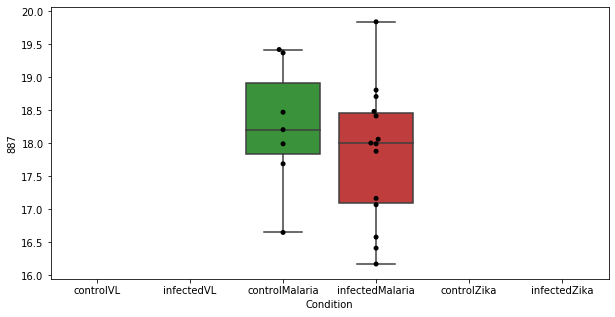

784 row m/z                                                         162.076
row retention time                                              9.70199
p-val                                                          0.349981
adj.P.Val                                                      0.868933
custom_id                                                           951
compound_names        L-2-Aminoadipate; L-alpha-Aminoadipate; L-alph...
Name: 951, dtype: object


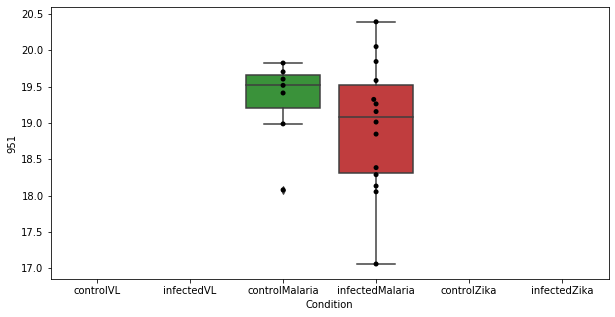

785 row m/z                                                         198.097
row retention time                                              12.3996
p-val                                                          0.350992
adj.P.Val                                                      0.869329
custom_id                                                          1416
compound_names        D-Glucosamine; Chitosamine; 2-Amino-2-deoxy-D-...
Name: 1416, dtype: object


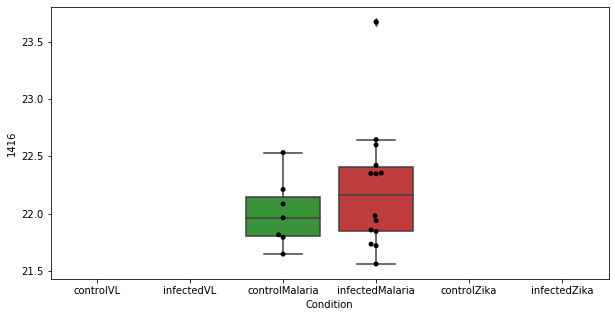

786 row m/z                487.871
row retention time     8.99701
p-val                 0.351649
adj.P.Val             0.869329
custom_id                 2615
compound_names             NaN
Name: 2615, dtype: object


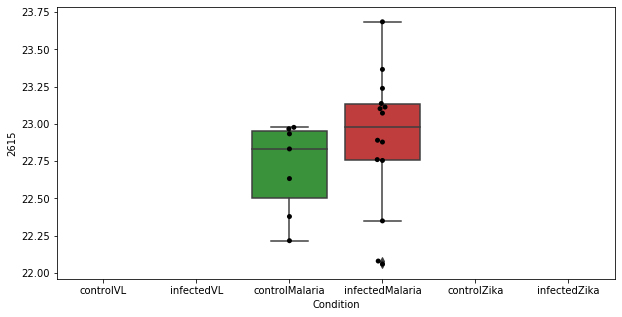

787 row m/z                                                175.108
row retention time                                     4.33795
p-val                                                 0.351711
adj.P.Val                                             0.869329
custom_id                                                 1133
compound_names        N-Acetylornithine; N2-Acetyl-L-ornithine
Name: 1133, dtype: object


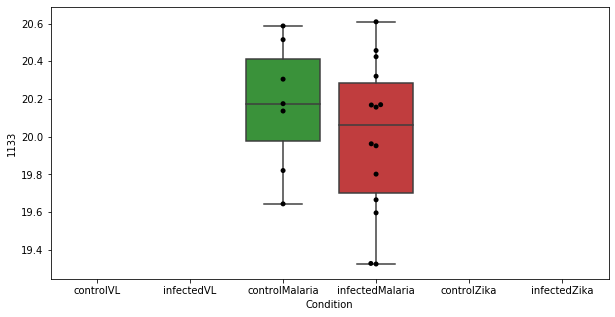

788 row m/z                786.656
row retention time     3.60029
p-val                 0.351924
adj.P.Val             0.869329
custom_id                 2912
compound_names             NaN
Name: 2912, dtype: object


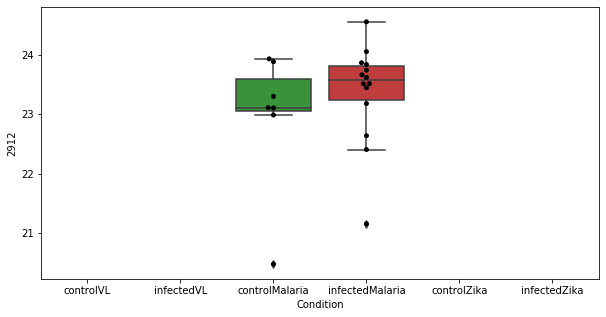

789 row m/z                 283.19
row retention time     3.66842
p-val                 0.354852
adj.P.Val             0.872432
custom_id                 2154
compound_names             NaN
Name: 2154, dtype: object


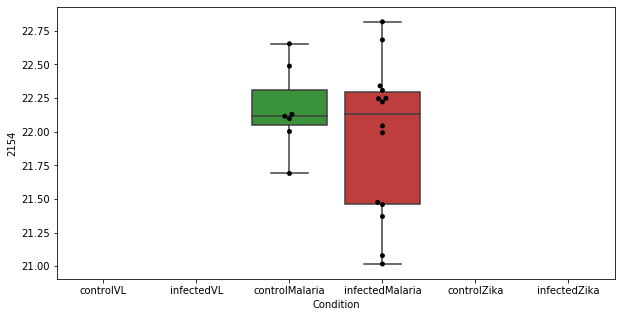

790 row m/z                118.123
row retention time     14.6962
p-val                 0.355685
adj.P.Val             0.872432
custom_id                  355
compound_names             NaN
Name: 355, dtype: object


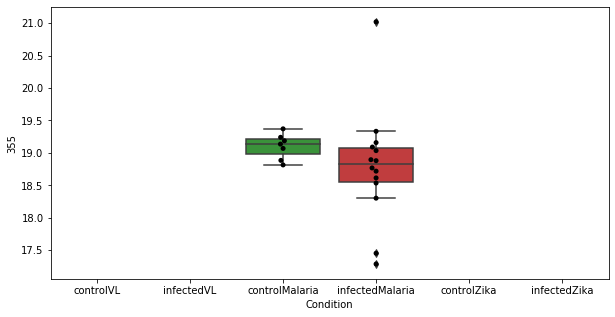

791 row m/z                                                         104.053
row retention time                                              10.1568
p-val                                                          0.355731
adj.P.Val                                                      0.872432
custom_id                                                           162
compound_names        L-Methionine; Methionine; L-2-Amino-4methylthi...
Name: 162, dtype: object


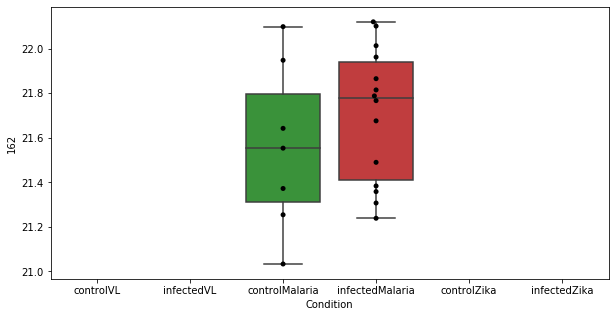

792 row m/z                 494.33
row retention time     3.24322
p-val                 0.355912
adj.P.Val             0.872432
custom_id                 2622
compound_names             NaN
Name: 2622, dtype: object


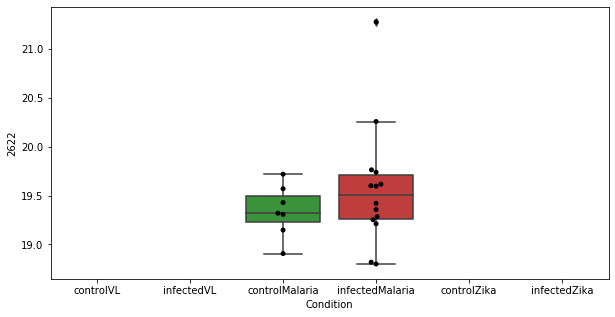

793 row m/z                569.343
row retention time      3.9737
p-val                 0.356077
adj.P.Val             0.872432
custom_id                 5267
compound_names             NaN
Name: 5267, dtype: object


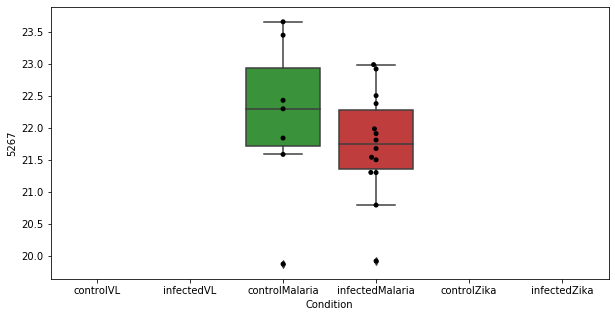

794 row m/z                                                         203.053
row retention time                                              12.3434
p-val                                                           0.35611
adj.P.Val                                                      0.872432
custom_id                                                          1461
compound_names        Galactose$D-Tagatose; lyxo-Hexulose$1,7-Dimeth...
Name: 1461, dtype: object


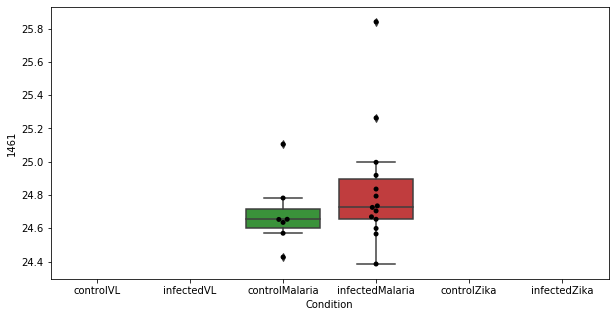

795 row m/z                           310.201
row retention time                4.59211
p-val                            0.356754
adj.P.Val                        0.872432
custom_id                            2289
compound_names        L-Octanoylcarnitine
Name: 2289, dtype: object


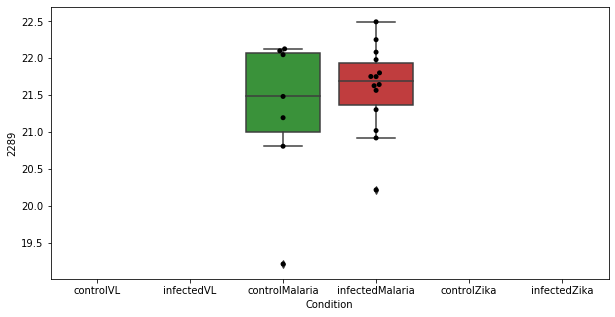

796 row m/z                162.929
row retention time     10.5988
p-val                 0.356761
adj.P.Val             0.872432
custom_id                  960
compound_names             NaN
Name: 960, dtype: object


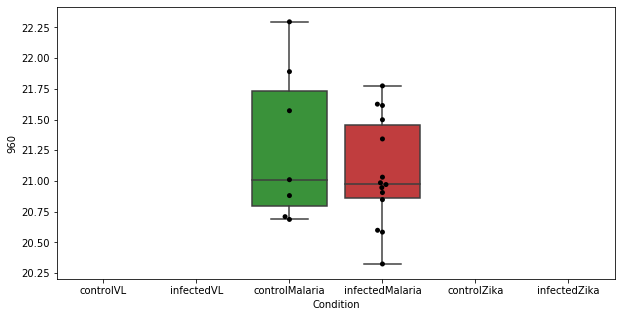

797 row m/z                153.091
row retention time     4.54745
p-val                 0.358628
adj.P.Val             0.874879
custom_id                  849
compound_names             NaN
Name: 849, dtype: object


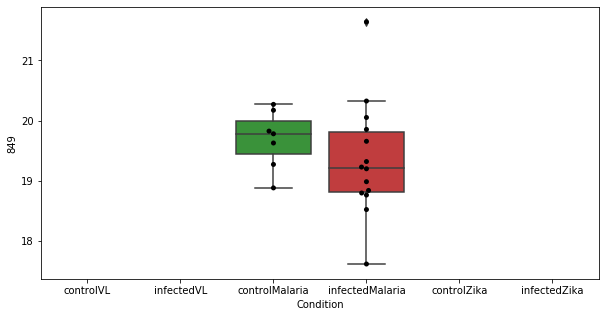

798 row m/z                                 139.05
row retention time                     9.43244
p-val                                 0.359024
adj.P.Val                             0.874879
custom_id                                  631
compound_names        Urocanate; Urocanic acid
Name: 631, dtype: object


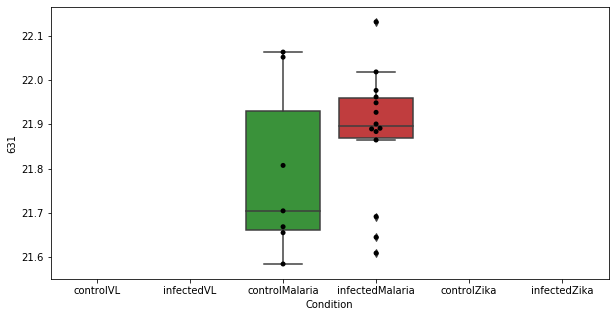

799 row m/z                260.149
row retention time     3.97293
p-val                 0.359409
adj.P.Val             0.874879
custom_id                 1977
compound_names             NaN
Name: 1977, dtype: object


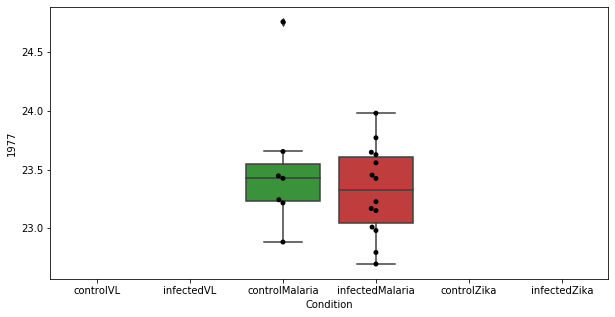

800 row m/z                239.128
row retention time     3.85163
p-val                  0.36047
adj.P.Val             0.874879
custom_id                 1815
compound_names             NaN
Name: 1815, dtype: object


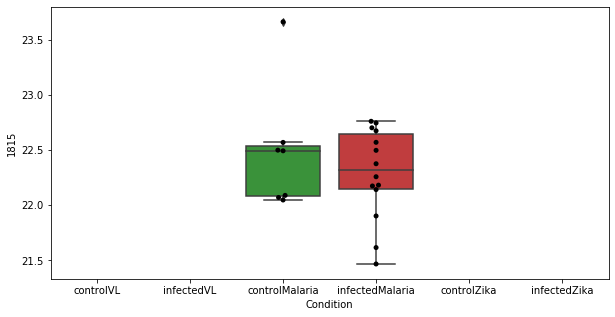

801 row m/z                594.509
row retention time     3.24839
p-val                 0.360479
adj.P.Val             0.874879
custom_id                 2744
compound_names             NaN
Name: 2744, dtype: object


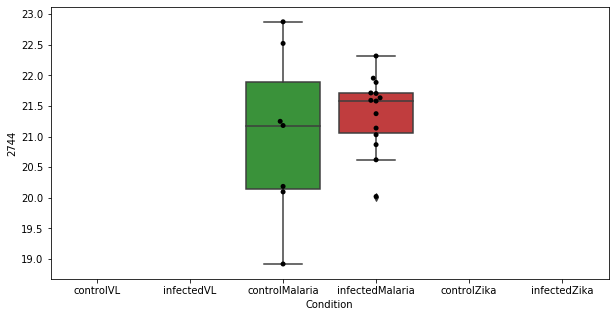

802 row m/z                202.144
row retention time     4.57807
p-val                 0.360851
adj.P.Val             0.874879
custom_id                 1450
compound_names             NaN
Name: 1450, dtype: object


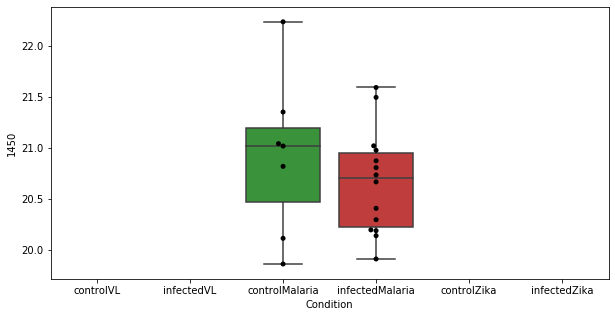

803 row m/z                                                         133.061
row retention time                                              10.7288
p-val                                                          0.361316
adj.P.Val                                                      0.874879
custom_id                                                           570
compound_names        3-Ureidopropionate; 3-Ureidopropanoate; beta-U...
Name: 570, dtype: object


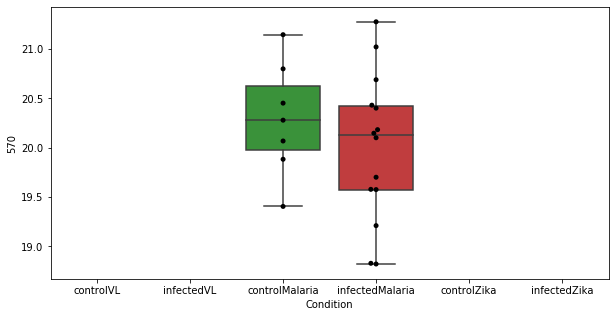

804 row m/z                350.326
row retention time     23.0237
p-val                 0.361353
adj.P.Val             0.874879
custom_id                 4118
compound_names             NaN
Name: 4118, dtype: object


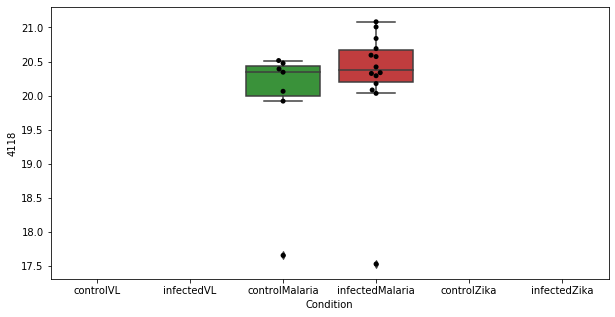

805 row m/z                492.324
row retention time     3.24314
p-val                 0.362369
adj.P.Val             0.875815
custom_id                 2618
compound_names             NaN
Name: 2618, dtype: object


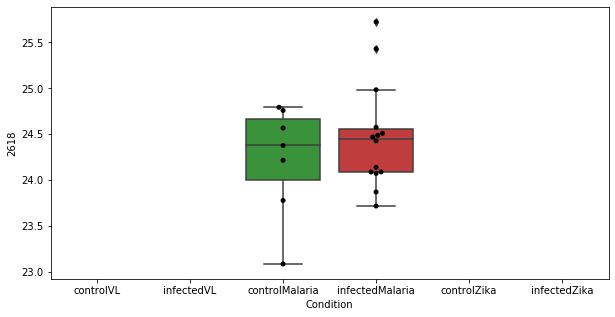

806 row m/z                232.118
row retention time     7.95412
p-val                 0.362683
adj.P.Val             0.875815
custom_id                 1737
compound_names             NaN
Name: 1737, dtype: object


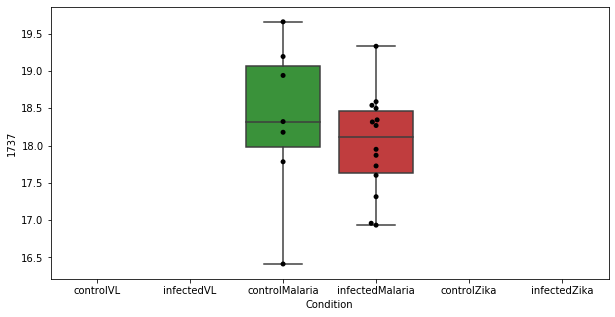

807 row m/z                177.107
row retention time     4.44417
p-val                 0.363731
adj.P.Val             0.875815
custom_id                 1150
compound_names             NaN
Name: 1150, dtype: object


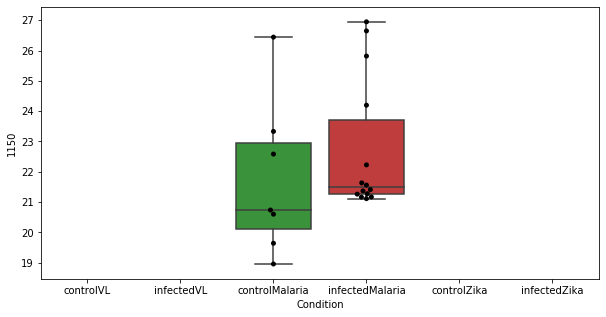

808 row m/z                531.407
row retention time     23.1275
p-val                  0.36375
adj.P.Val             0.875815
custom_id                 4200
compound_names             NaN
Name: 4200, dtype: object


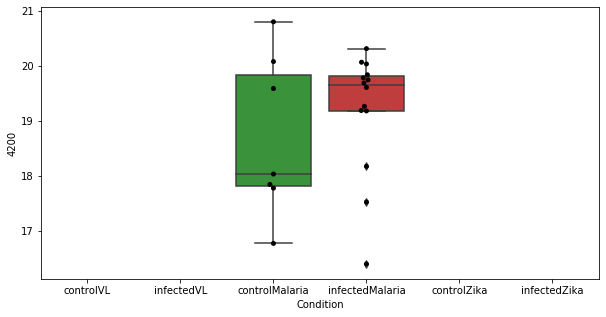

809 row m/z                205.118
row retention time     11.1313
p-val                 0.364139
adj.P.Val             0.875815
custom_id                 1478
compound_names             NaN
Name: 1478, dtype: object


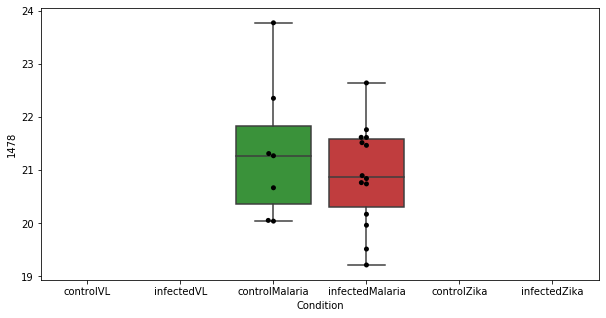

810 row m/z                731.605
row retention time     6.71416
p-val                 0.364436
adj.P.Val             0.875815
custom_id                 4262
compound_names             NaN
Name: 4262, dtype: object


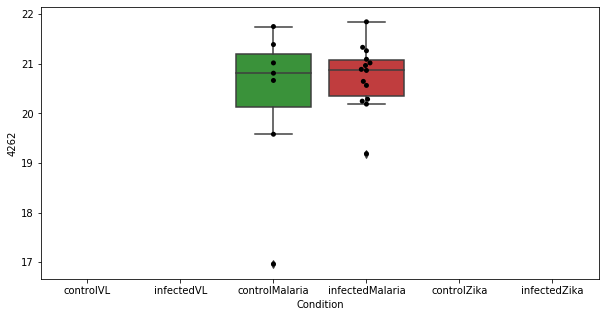

811 row m/z                                                          131.07
row retention time                                              12.1719
p-val                                                          0.365367
adj.P.Val                                                      0.876971
custom_id                                                          6472
compound_names        (R)-Mevalonate; Mevalonic acid; 3,5-Dihydroxy-...
Name: 6472, dtype: object


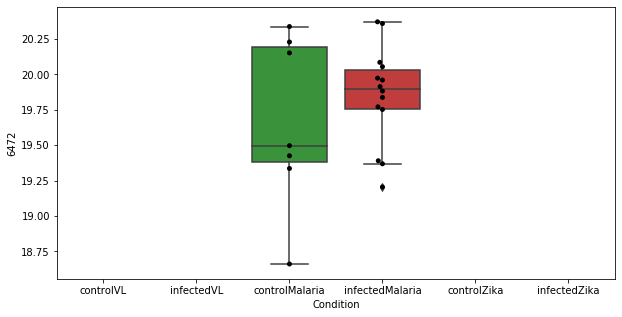

812 row m/z                                                         183.102
row retention time                                              4.00553
p-val                                                          0.366609
adj.P.Val                                                      0.877785
custom_id                                                          1218
compound_names        Ecgonine methyl ester; Methyl ecgonine$ecgonin...
Name: 1218, dtype: object


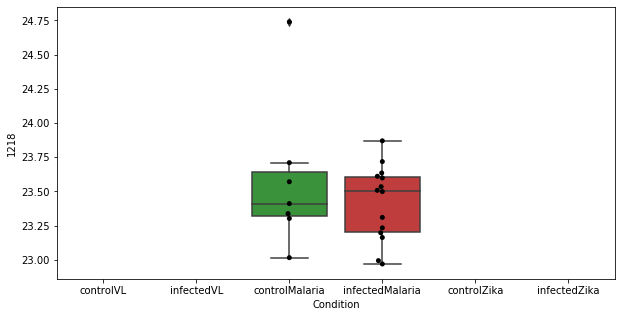

813 row m/z                                                         266.121
row retention time                                              6.99825
p-val                                                           0.36779
adj.P.Val                                                      0.877785
custom_id                                                          2007
compound_names        Formyl-N-acetyl-5-methoxykynurenamine$alpha-N-...
Name: 2007, dtype: object


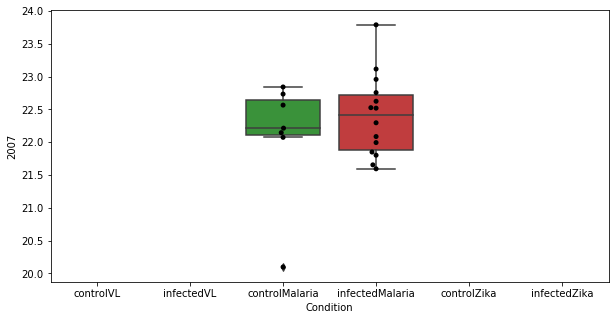

814 row m/z                358.222
row retention time     3.71922
p-val                 0.367859
adj.P.Val             0.877785
custom_id                 2434
compound_names             NaN
Name: 2434, dtype: object


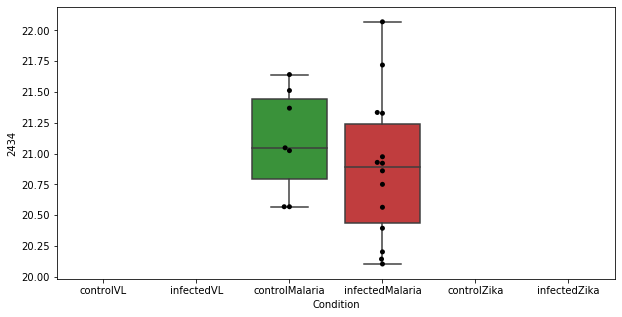

815 row m/z                111.092
row retention time     22.7834
p-val                 0.368131
adj.P.Val             0.877785
custom_id                  234
compound_names             NaN
Name: 234, dtype: object


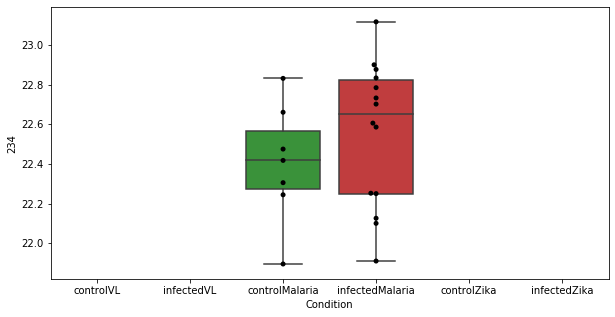

816 row m/z                                                         115.063
row retention time                                              8.90669
p-val                                                          0.368572
adj.P.Val                                                      0.877785
custom_id                                                           302
compound_names        D-Proline$L-Proline; 2-Pyrrolidinecarboxylic a...
Name: 302, dtype: object


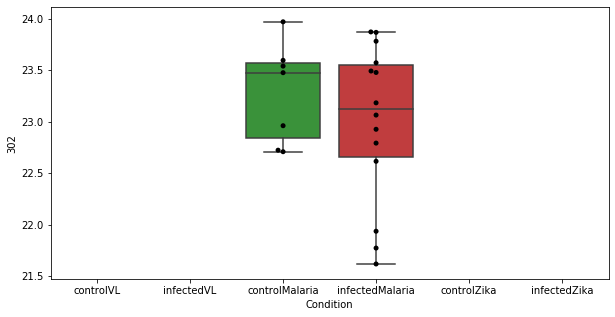

817 row m/z                242.284
row retention time     1.93656
p-val                 0.368653
adj.P.Val             0.877785
custom_id                 1847
compound_names             NaN
Name: 1847, dtype: object


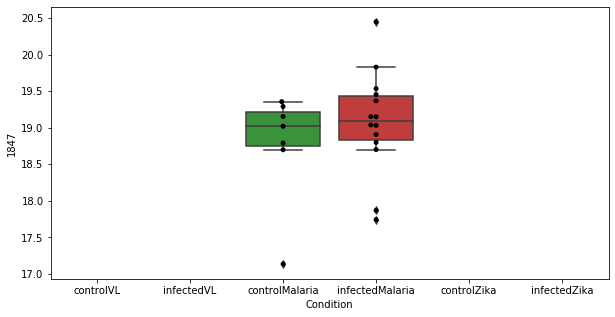

818 row m/z                                                         152.054
row retention time                                              10.1618
p-val                                                          0.368859
adj.P.Val                                                      0.877785
custom_id                                                           833
compound_names        L-Methionine; Methionine; L-2-Amino-4methylthi...
Name: 833, dtype: object


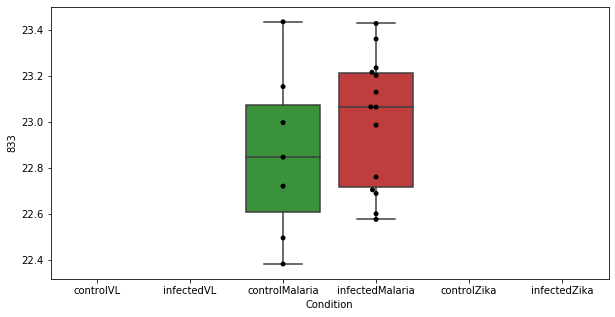

819 row m/z                269.175
row retention time     3.75215
p-val                 0.369935
adj.P.Val              0.87832
custom_id                 2049
compound_names             NaN
Name: 2049, dtype: object


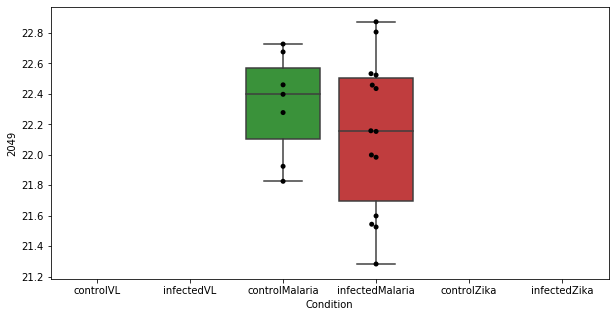

820 row m/z                306.191
row retention time     3.81285
p-val                 0.370343
adj.P.Val              0.87832
custom_id                 2272
compound_names             NaN
Name: 2272, dtype: object


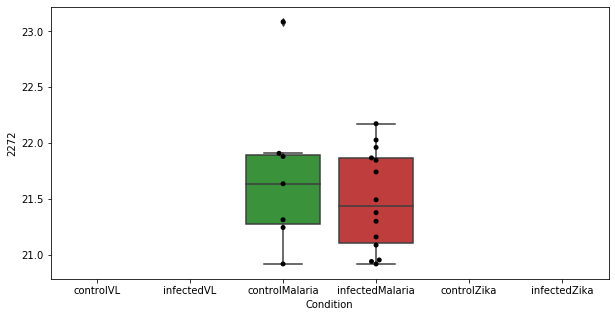

821 row m/z                745.871
row retention time     9.57348
p-val                 0.370436
adj.P.Val              0.87832
custom_id                 2856
compound_names             NaN
Name: 2856, dtype: object


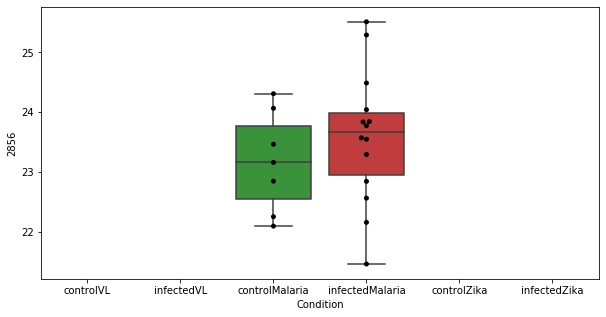

822 row m/z                309.203
row retention time    0.550829
p-val                 0.372529
adj.P.Val             0.880512
custom_id                 2286
compound_names             NaN
Name: 2286, dtype: object


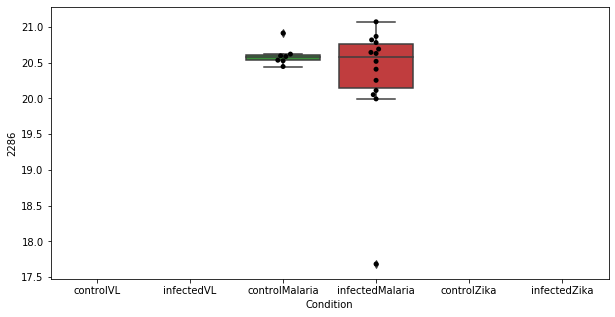

823 row m/z                                                         130.065
row retention time                                              7.02199
p-val                                                          0.372901
adj.P.Val                                                      0.880512
custom_id                                                          3247
compound_names        L-Phenylalanine; (S)-alpha-Amino-beta-phenylpr...
Name: 3247, dtype: object


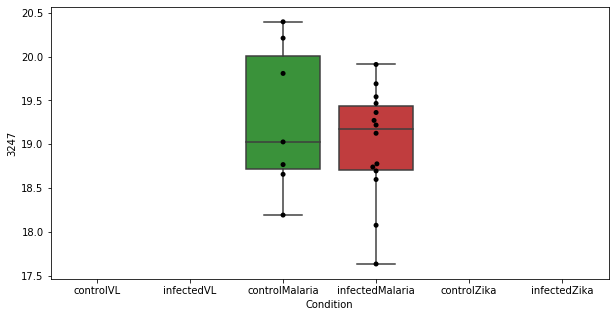

824 row m/z                 202.18
row retention time     7.27622
p-val                 0.373052
adj.P.Val             0.880512
custom_id                 1455
compound_names             NaN
Name: 1455, dtype: object


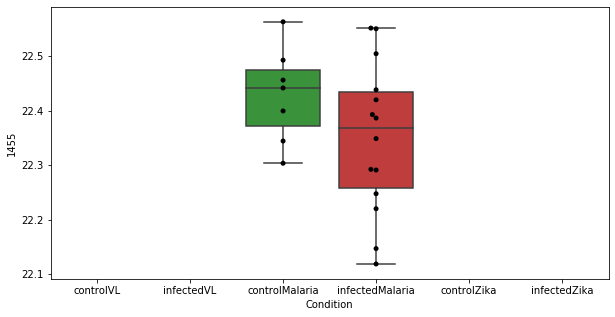

825 row m/z                576.465
row retention time     3.33311
p-val                 0.373167
adj.P.Val             0.880512
custom_id                 2725
compound_names             NaN
Name: 2725, dtype: object


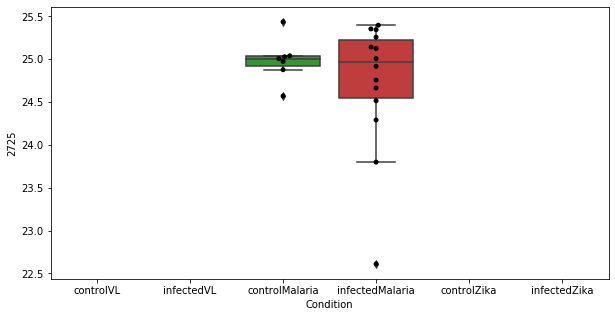

826 row m/z                361.146
row retention time     10.1545
p-val                 0.376579
adj.P.Val             0.887209
custom_id                 4135
compound_names             NaN
Name: 4135, dtype: object


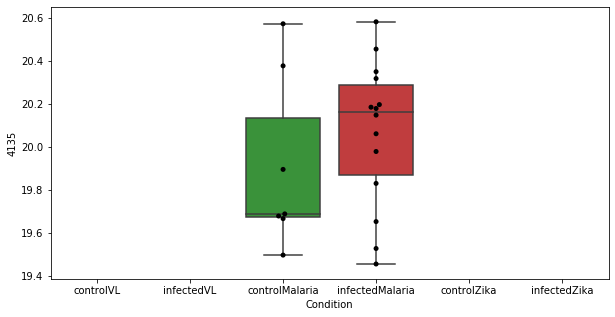

827 row m/z                544.823
row retention time     8.46732
p-val                 0.376916
adj.P.Val             0.887209
custom_id                 2685
compound_names             NaN
Name: 2685, dtype: object


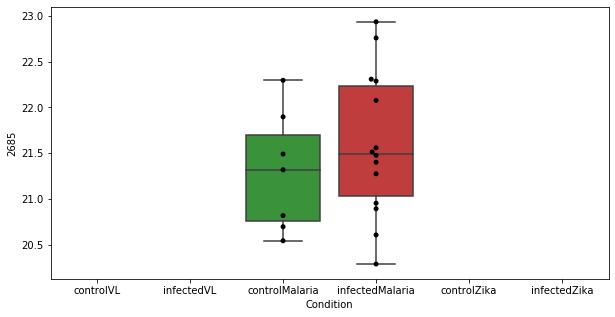

828 row m/z                247.092
row retention time     9.53648
p-val                 0.377778
adj.P.Val             0.887722
custom_id                 1887
compound_names             NaN
Name: 1887, dtype: object


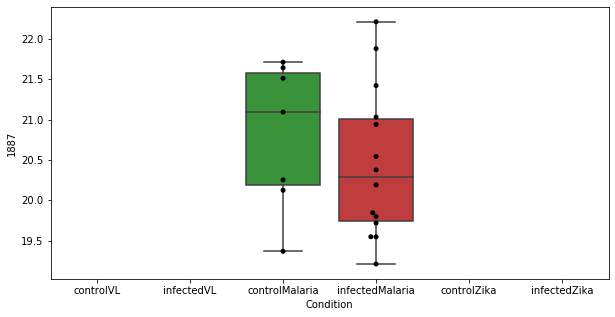

829 row m/z                174.132
row retention time     9.60967
p-val                 0.378191
adj.P.Val             0.887722
custom_id                 1129
compound_names             NaN
Name: 1129, dtype: object


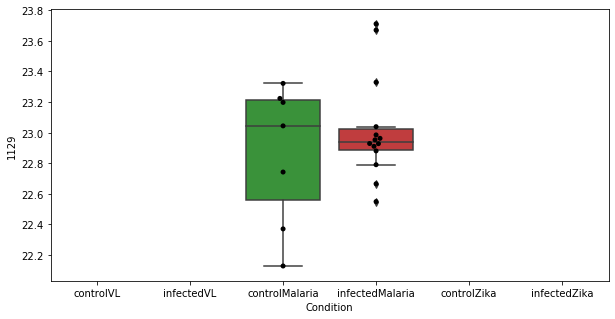

830 row m/z                811.604
row retention time     3.48089
p-val                 0.378854
adj.P.Val             0.887722
custom_id                 2944
compound_names             NaN
Name: 2944, dtype: object


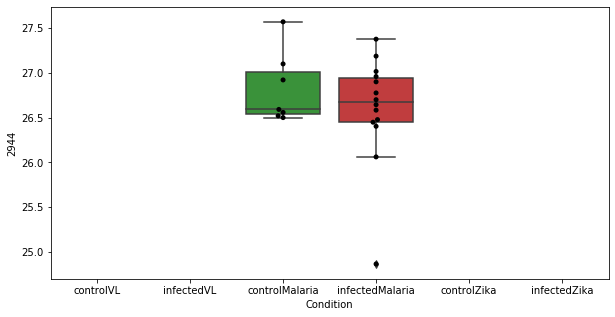

831 row m/z                164.029
row retention time     12.0677
p-val                 0.379748
adj.P.Val             0.887722
custom_id                 5687
compound_names             NaN
Name: 5687, dtype: object


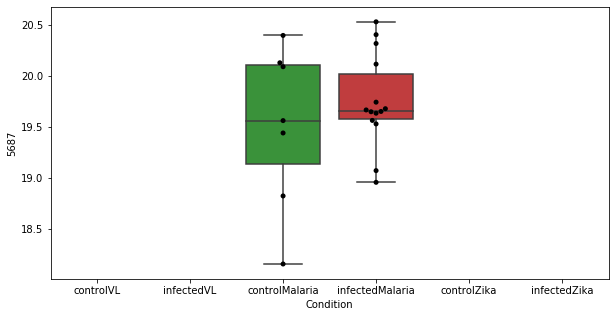

832 row m/z                 222.17
row retention time     3.75198
p-val                  0.37984
adj.P.Val             0.887722
custom_id                 1650
compound_names             NaN
Name: 1650, dtype: object


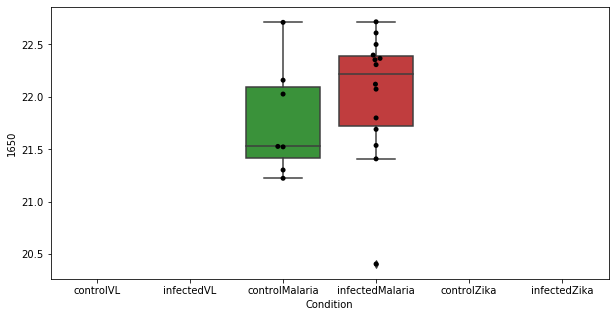

833 row m/z                208.163
row retention time     4.06623
p-val                 0.380281
adj.P.Val             0.887722
custom_id                 3647
compound_names             NaN
Name: 3647, dtype: object


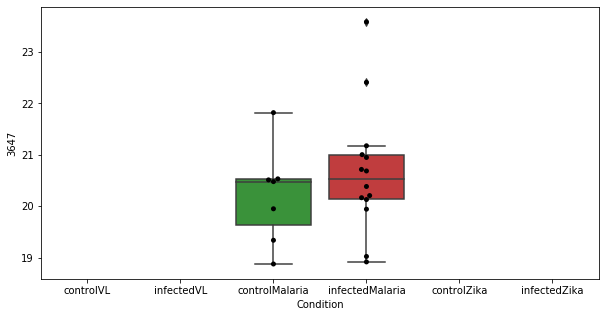

834 row m/z                141.139
row retention time     22.8292
p-val                 0.380322
adj.P.Val             0.887722
custom_id                 3323
compound_names             NaN
Name: 3323, dtype: object


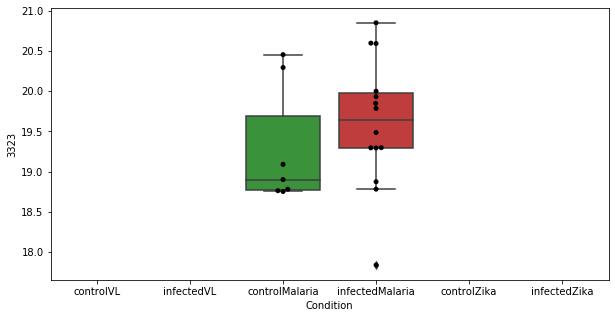

835 row m/z                                                         175.071
row retention time                                              10.3206
p-val                                                          0.381811
adj.P.Val                                                       0.88796
custom_id                                                          1131
compound_names        4-Imidazolone-5-propanoate; 4-Imidazolone-5-pr...
Name: 1131, dtype: object


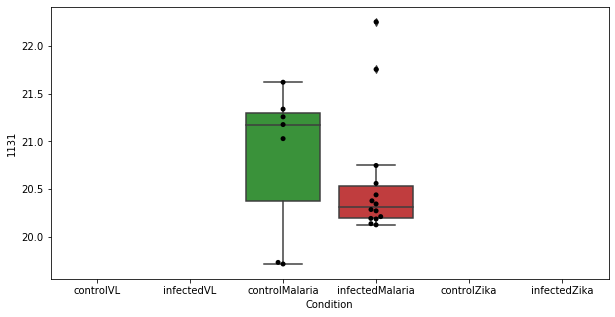

836 row m/z                235.119
row retention time     7.01122
p-val                 0.382012
adj.P.Val              0.88796
custom_id                 3781
compound_names             NaN
Name: 3781, dtype: object


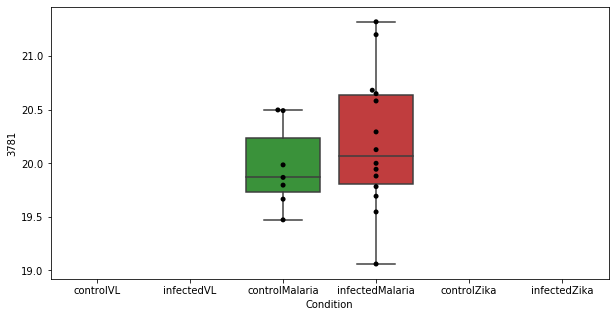

837 row m/z                 553.39
row retention time     3.34639
p-val                 0.382316
adj.P.Val              0.88796
custom_id                 2698
compound_names             NaN
Name: 2698, dtype: object


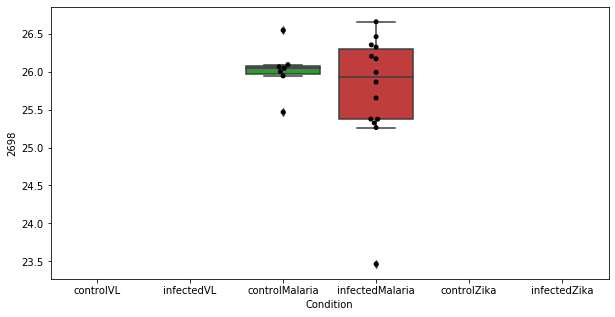

838 row m/z                383.217
row retention time     23.4362
p-val                 0.383375
adj.P.Val              0.88796
custom_id                 2486
compound_names             NaN
Name: 2486, dtype: object


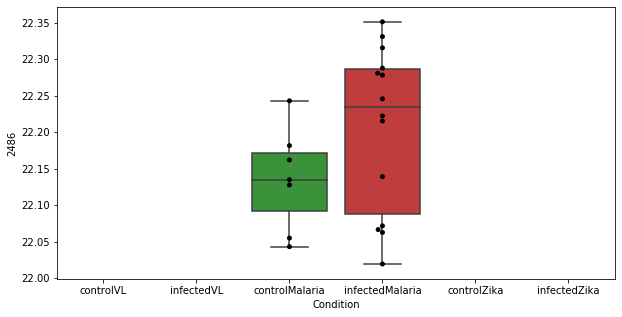

839 row m/z                                                         117.074
row retention time                                              16.7612
p-val                                                          0.383436
adj.P.Val                                                       0.88796
custom_id                                                           328
compound_names        D-Proline$L-Proline; 2-Pyrrolidinecarboxylic a...
Name: 328, dtype: object


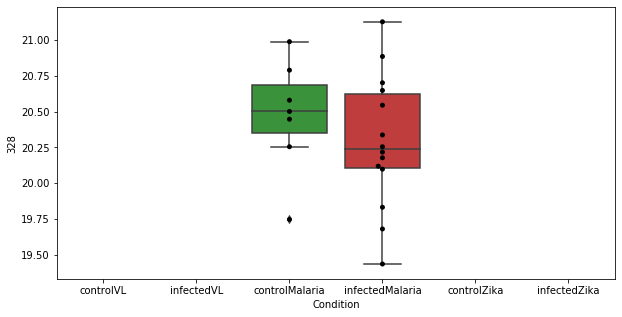

840 row m/z               327.078
row retention time    3.68613
p-val                 0.38344
adj.P.Val             0.88796
custom_id                2363
compound_names            NaN
Name: 2363, dtype: object


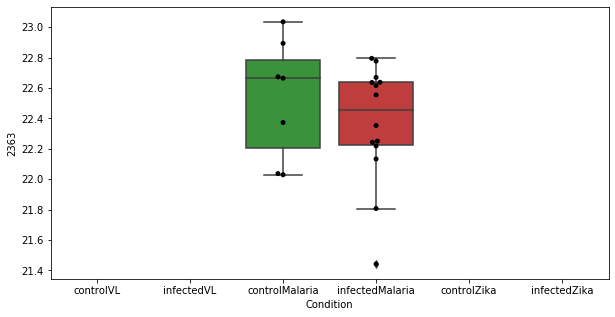

841 row m/z                                                         141.066
row retention time                                              9.64422
p-val                                                          0.383613
adj.P.Val                                                       0.88796
custom_id                                                           654
compound_names        Methylimidazoleacetic acid; Tele-methylimidazo...
Name: 654, dtype: object


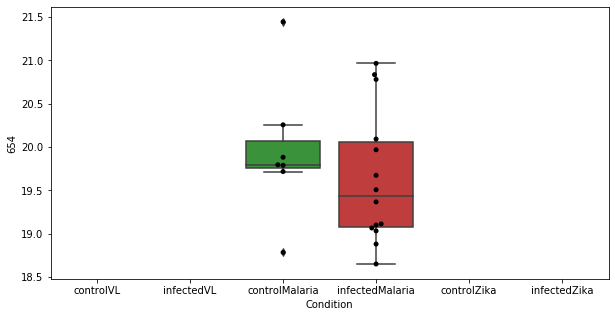

842 row m/z                239.132
row retention time     4.14388
p-val                  0.38562
adj.P.Val             0.891147
custom_id                 1816
compound_names             NaN
Name: 1816, dtype: object


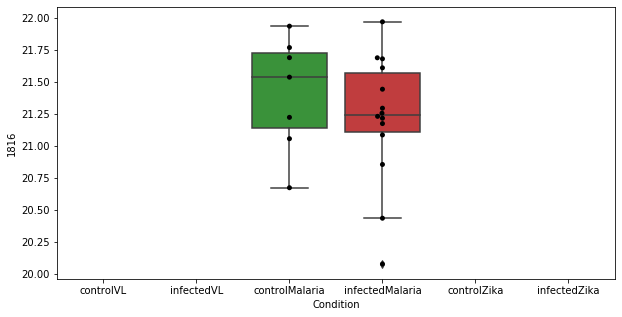

843 row m/z                772.584
row retention time     3.51436
p-val                 0.385958
adj.P.Val             0.891147
custom_id                 2883
compound_names             NaN
Name: 2883, dtype: object


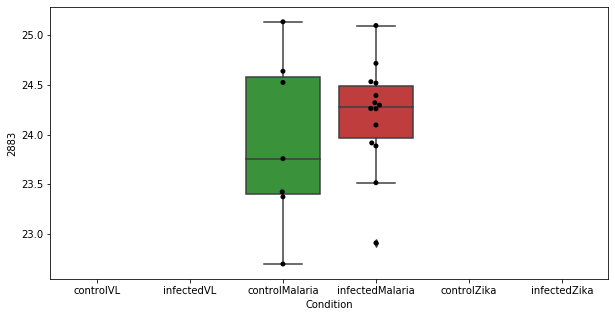

844 row m/z                 522.84
row retention time     8.45839
p-val                 0.386362
adj.P.Val             0.891147
custom_id                 2648
compound_names             NaN
Name: 2648, dtype: object


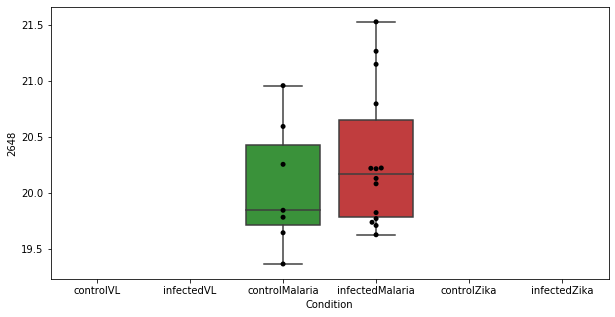

845 row m/z                244.191
row retention time     4.10416
p-val                 0.386831
adj.P.Val             0.891175
custom_id                 1864
compound_names             NaN
Name: 1864, dtype: object


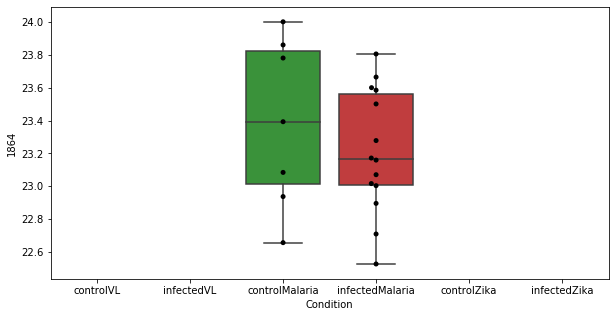

846 row m/z                261.121
row retention time     14.0385
p-val                 0.387822
adj.P.Val              0.89142
custom_id                 1984
compound_names             NaN
Name: 1984, dtype: object


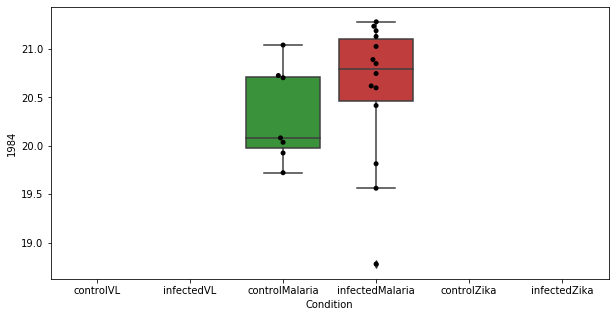

847 row m/z                835.603
row retention time     3.47305
p-val                 0.388009
adj.P.Val              0.89142
custom_id                 2966
compound_names             NaN
Name: 2966, dtype: object


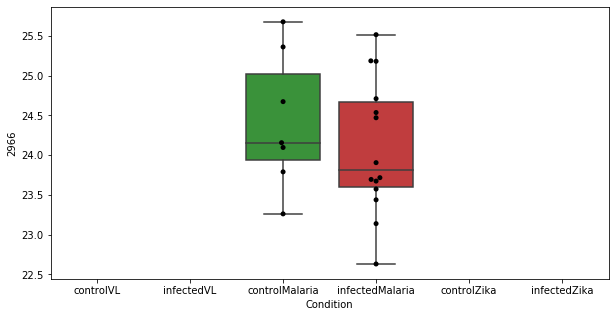

848 row m/z                225.189
row retention time     4.01273
p-val                 0.388309
adj.P.Val              0.89142
custom_id                 4962
compound_names             NaN
Name: 4962, dtype: object


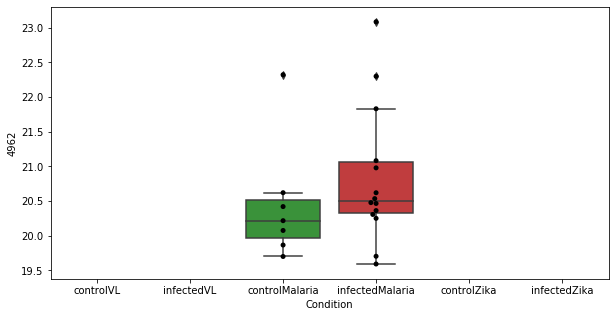

849 row m/z                                       228.098
row retention time                            6.99449
p-val                                        0.388845
adj.P.Val                                    0.891599
custom_id                                        1690
compound_names        Deoxycytidine; 2'-Deoxycytidine
Name: 1690, dtype: object


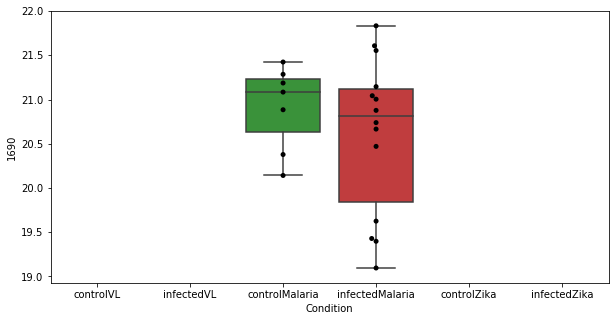

850 row m/z                356.279
row retention time     3.55865
p-val                 0.389911
adj.P.Val             0.892267
custom_id                 2431
compound_names             NaN
Name: 2431, dtype: object


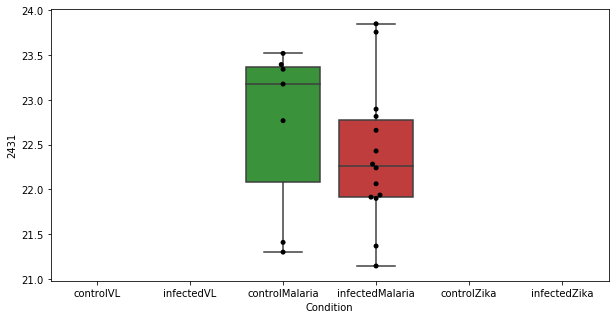

851 row m/z                                                         244.079
row retention time                                              12.2359
p-val                                                          0.390052
adj.P.Val                                                      0.892267
custom_id                                                          1859
compound_names        N-Acetyl-D-mannosamine; 2-Acetamido-2-deoxy-D-...
Name: 1859, dtype: object


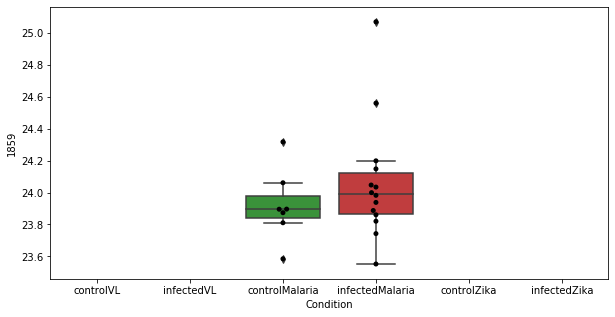

852 row m/z                534.408
row retention time     3.40205
p-val                 0.390978
adj.P.Val             0.892636
custom_id                 2671
compound_names             NaN
Name: 2671, dtype: object


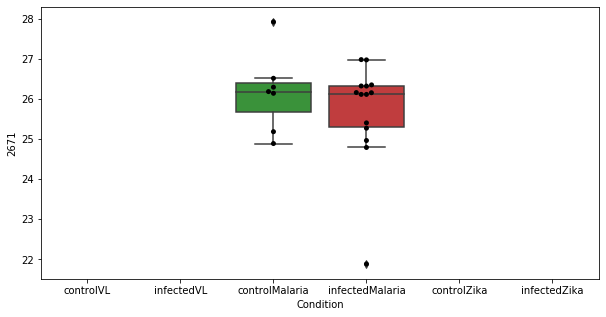

853 row m/z                199.181
row retention time     3.88441
p-val                 0.391129
adj.P.Val             0.892636
custom_id                 1424
compound_names             NaN
Name: 1424, dtype: object


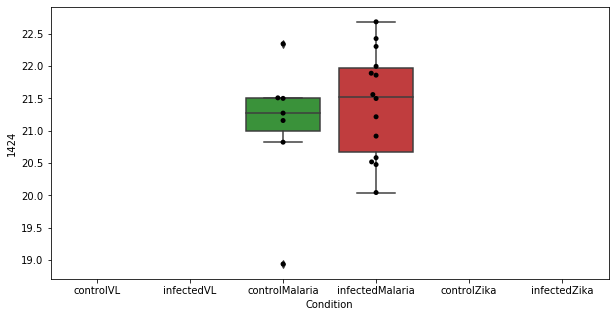

854 row m/z                            271.19
row retention time                 3.7968
p-val                            0.391622
adj.P.Val                        0.892715
custom_id                            2059
compound_names        L-Octanoylcarnitine
Name: 2059, dtype: object


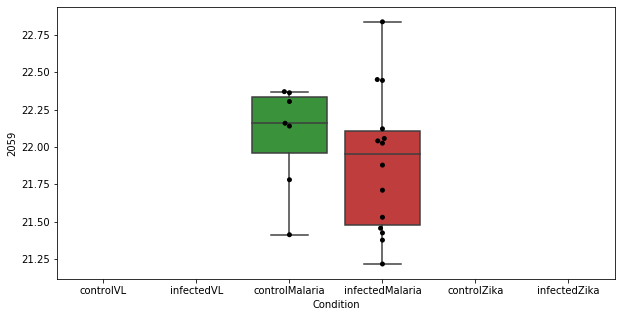

855 row m/z                81.9878
row retention time     15.1144
p-val                 0.392599
adj.P.Val             0.893896
custom_id                   42
compound_names             NaN
Name: 42, dtype: object


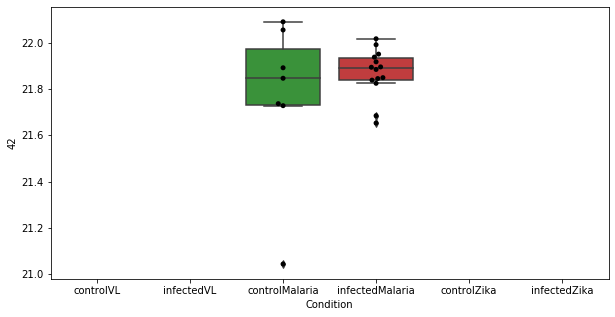

856 row m/z                        169.097
row retention time             7.00597
p-val                         0.393264
adj.P.Val                     0.894366
custom_id                         1044
compound_names        Pyridoxamine; PM
Name: 1044, dtype: object


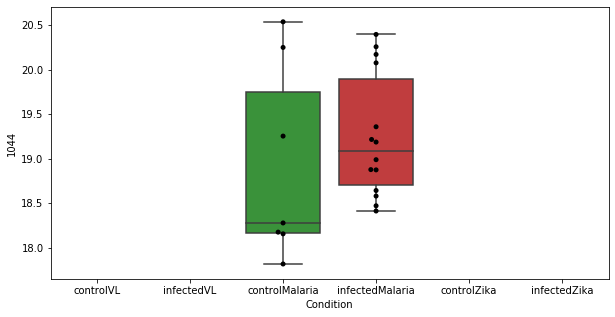

857 row m/z                565.432
row retention time     3.33934
p-val                 0.396453
adj.P.Val             0.898471
custom_id                 2711
compound_names             NaN
Name: 2711, dtype: object


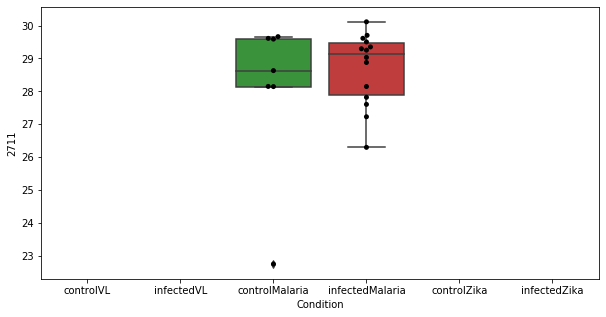

858 row m/z                 216.16
row retention time     4.49314
p-val                 0.396935
adj.P.Val             0.898471
custom_id                 1606
compound_names             NaN
Name: 1606, dtype: object


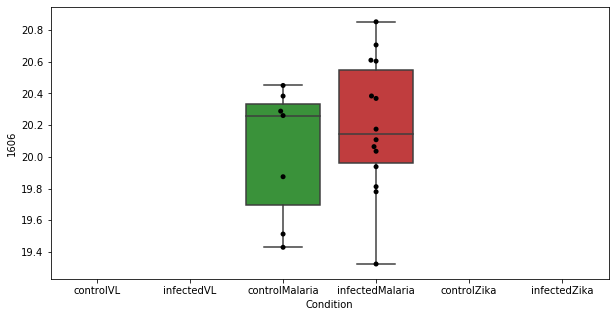

859 row m/z                578.408
row retention time      3.3968
p-val                 0.397107
adj.P.Val             0.898471
custom_id                 2727
compound_names             NaN
Name: 2727, dtype: object


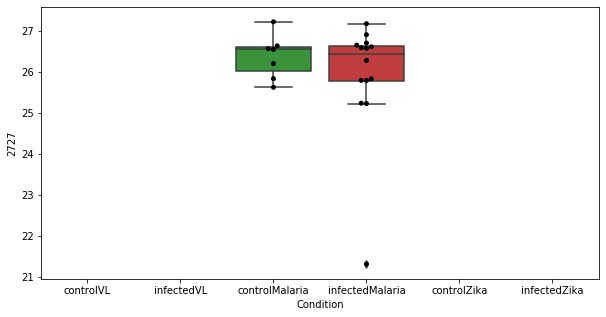

860 row m/z                478.293
row retention time     4.06808
p-val                 0.397139
adj.P.Val             0.898471
custom_id                 2603
compound_names             NaN
Name: 2603, dtype: object


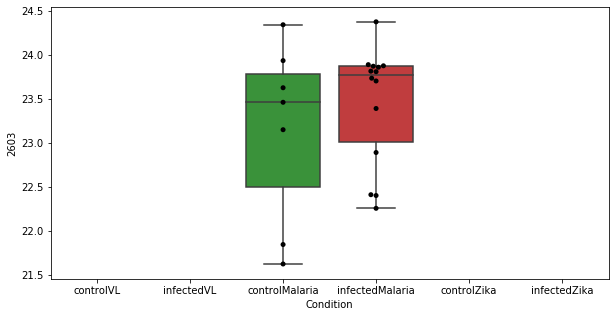

861 row m/z                164.074
row retention time     10.7965
p-val                 0.397374
adj.P.Val             0.898471
custom_id                  977
compound_names             NaN
Name: 977, dtype: object


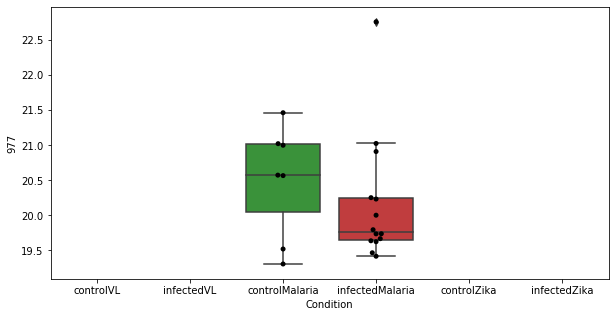

862 row m/z                97.9913
row retention time     5.23083
p-val                 0.398354
adj.P.Val             0.899644
custom_id                  108
compound_names             NaN
Name: 108, dtype: object


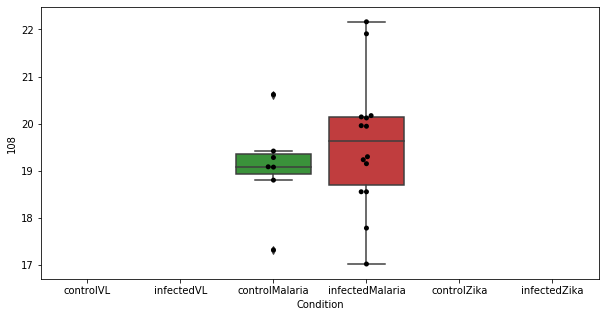

863 row m/z                645.819
row retention time     7.80262
p-val                  0.39927
adj.P.Val             0.900052
custom_id                 2781
compound_names             NaN
Name: 2781, dtype: object


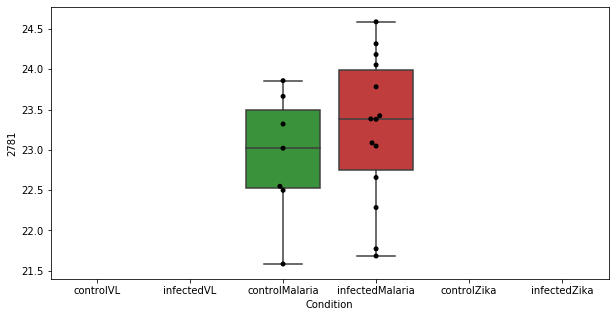

864 row m/z                                                         130.086
row retention time                                              10.6956
p-val                                                          0.400084
adj.P.Val                                                      0.900052
custom_id                                                           523
compound_names        N4-Acetylaminobutanal$L-Pipecolate; Pipecolini...
Name: 523, dtype: object


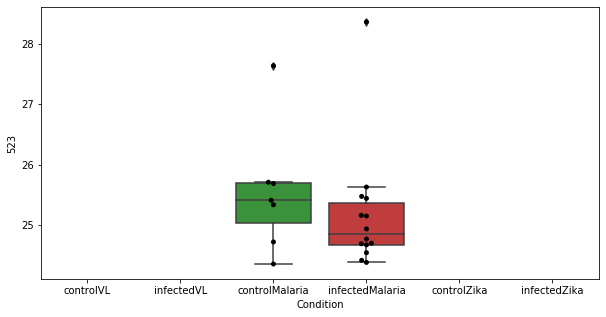

865 row m/z                                                         76.0757
row retention time                                              9.66953
p-val                                                          0.400098
adj.P.Val                                                      0.900052
custom_id                                                            15
compound_names        L-Allothreonine; L-allo-Threonine$L-Threonine;...
Name: 15, dtype: object


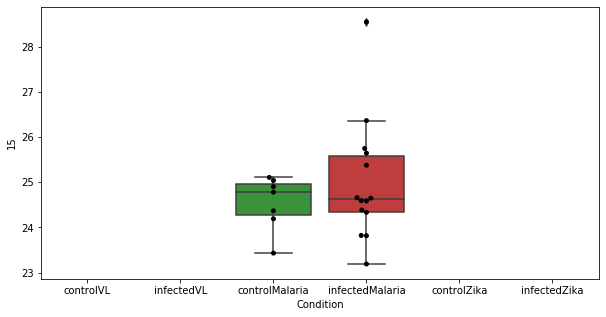

866 row m/z                255.195
row retention time     3.70819
p-val                 0.400382
adj.P.Val             0.900052
custom_id                 1949
compound_names             NaN
Name: 1949, dtype: object


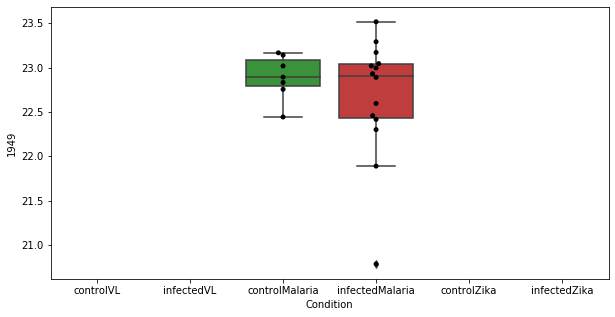

867 row m/z                                                         307.194
row retention time                                              3.55264
p-val                                                          0.401535
adj.P.Val                                                      0.901145
custom_id                                                          2279
compound_names        3-oxo-10(S)-hydroxy-octadeca-6E,8E,12Z-trienoa...
Name: 2279, dtype: object


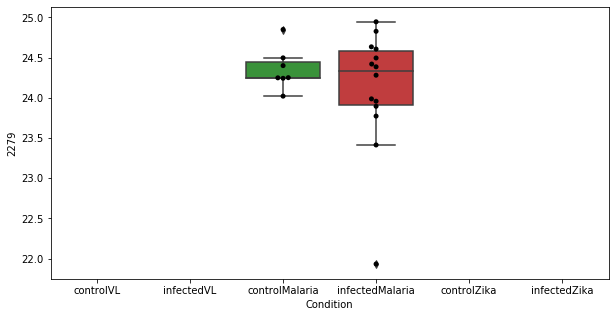

868 row m/z                296.051
row retention time     23.2597
p-val                 0.402207
adj.P.Val             0.901145
custom_id                 2232
compound_names             NaN
Name: 2232, dtype: object


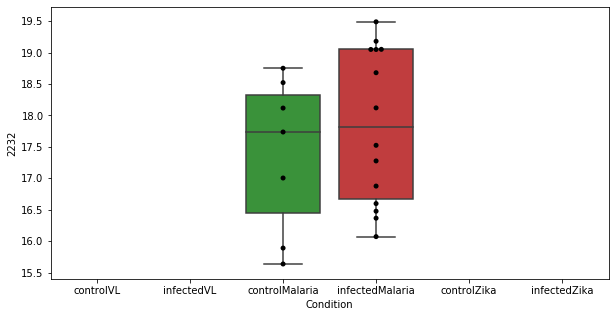

869 row m/z                262.128
row retention time     10.8204
p-val                 0.402255
adj.P.Val             0.901145
custom_id                 3894
compound_names             NaN
Name: 3894, dtype: object


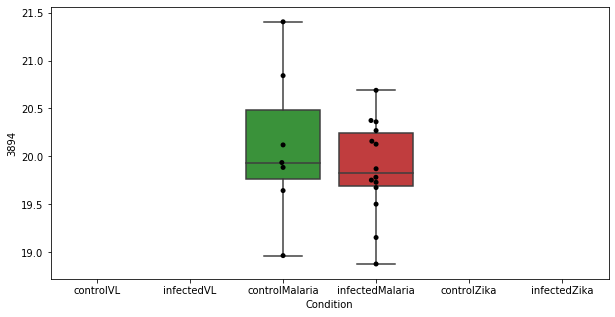

870 row m/z                271.154
row retention time     3.81218
p-val                 0.404604
adj.P.Val             0.904067
custom_id                 3925
compound_names             NaN
Name: 3925, dtype: object


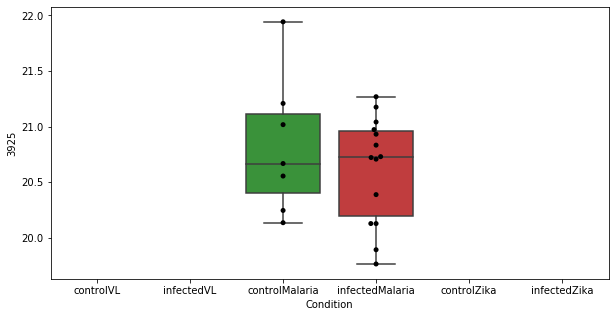

871 row m/z                239.149
row retention time     6.85622
p-val                 0.405012
adj.P.Val             0.904067
custom_id                 1823
compound_names             NaN
Name: 1823, dtype: object


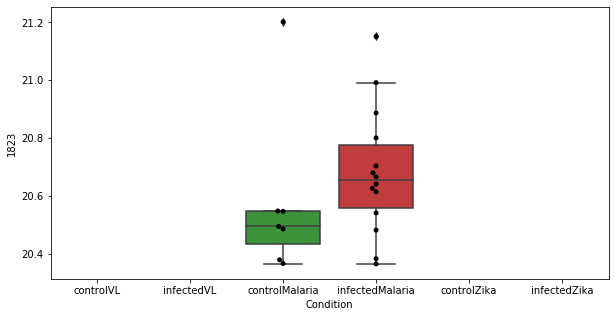

872 row m/z                388.254
row retention time     4.37664
p-val                 0.405214
adj.P.Val             0.904067
custom_id                 2495
compound_names             NaN
Name: 2495, dtype: object


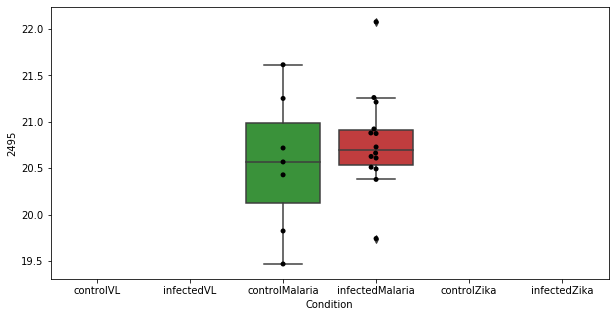

873 row m/z                445.165
row retention time     10.5189
p-val                  0.40546
adj.P.Val             0.904067
custom_id                 2578
compound_names             NaN
Name: 2578, dtype: object


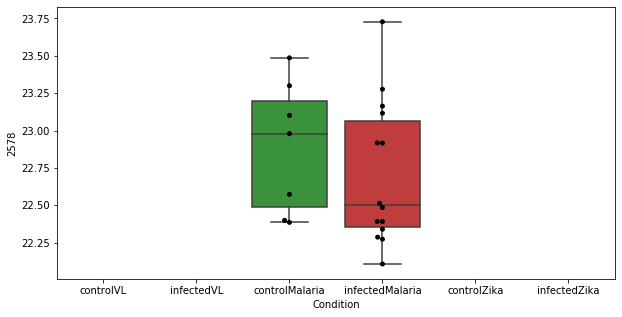

874 row m/z                273.169
row retention time     3.82944
p-val                 0.405917
adj.P.Val             0.904067
custom_id                 2066
compound_names             NaN
Name: 2066, dtype: object


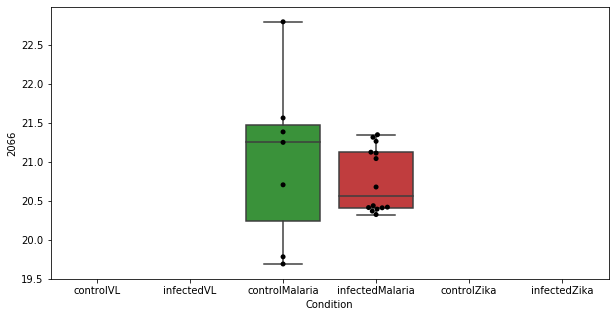

875 row m/z                252.928
row retention time     7.48132
p-val                 0.406539
adj.P.Val             0.904067
custom_id                 5036
compound_names             NaN
Name: 5036, dtype: object


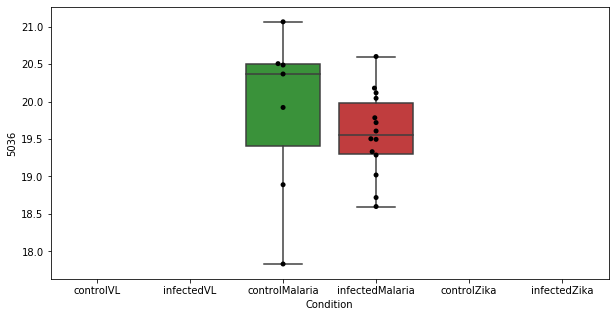

876 row m/z                104.008
row retention time     2.71383
p-val                 0.406906
adj.P.Val             0.904067
custom_id                 4411
compound_names             NaN
Name: 4411, dtype: object


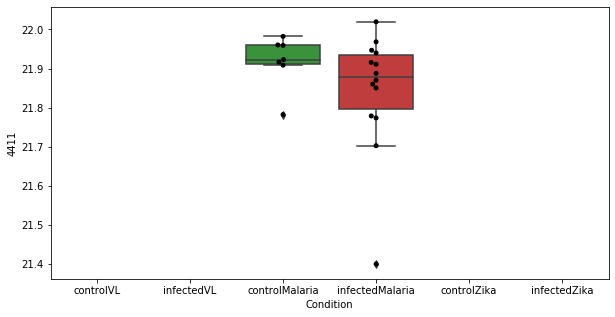

877 row m/z                580.424
row retention time      3.3988
p-val                 0.407688
adj.P.Val             0.904067
custom_id                 2731
compound_names             NaN
Name: 2731, dtype: object


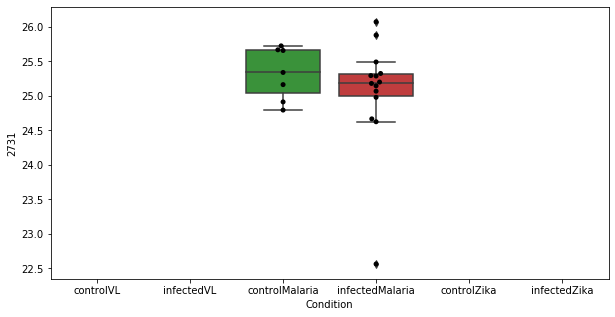

878 row m/z                                                         121.069
row retention time                                              12.0721
p-val                                                          0.407735
adj.P.Val                                                      0.904067
custom_id                                                           388
compound_names        L-Allothreonine; L-allo-Threonine$L-Threonine;...
Name: 388, dtype: object


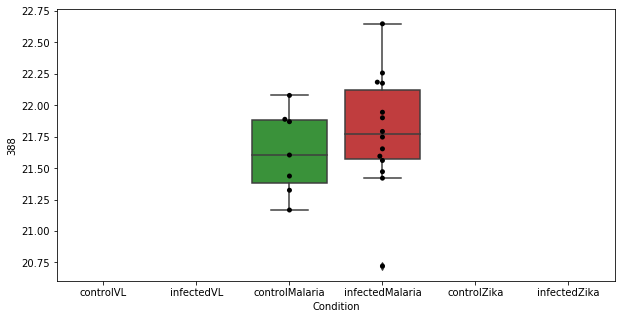

879 row m/z                194.147
row retention time     23.6165
p-val                 0.408642
adj.P.Val             0.904243
custom_id                 1376
compound_names             NaN
Name: 1376, dtype: object


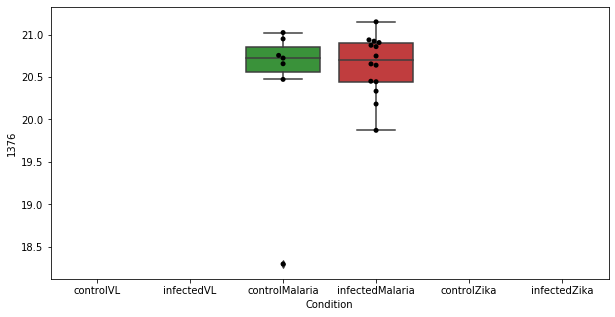

880 row m/z                183.113
row retention time     7.00059
p-val                 0.408742
adj.P.Val             0.904243
custom_id                 1221
compound_names             NaN
Name: 1221, dtype: object


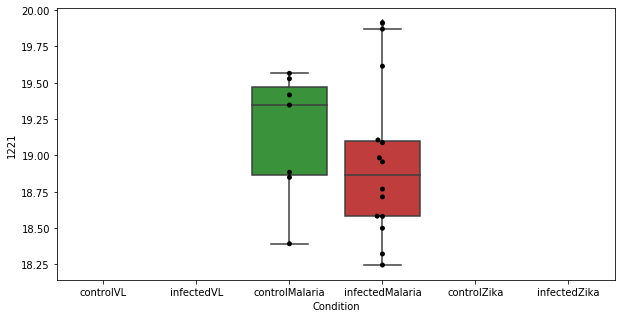

881 row m/z                                 190.107
row retention time                      4.59489
p-val                                   0.40969
adj.P.Val                              0.904252
custom_id                                  1315
compound_names        N-(omega)-Hydroxyarginine
Name: 1315, dtype: object


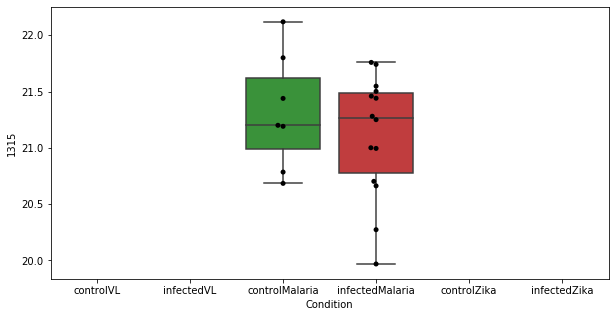

882 row m/z                459.387
row retention time     3.44946
p-val                 0.410232
adj.P.Val             0.904252
custom_id                 2587
compound_names             NaN
Name: 2587, dtype: object


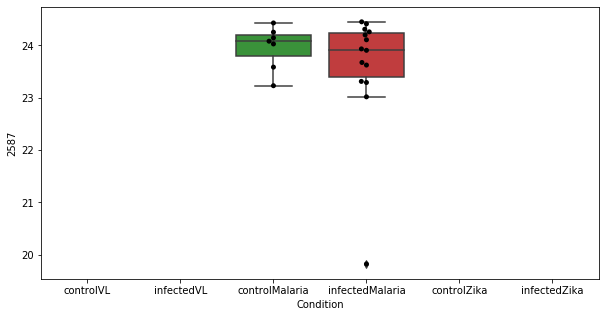

883 row m/z                330.264
row retention time     3.58808
p-val                 0.410254
adj.P.Val             0.904252
custom_id                 2384
compound_names             NaN
Name: 2384, dtype: object


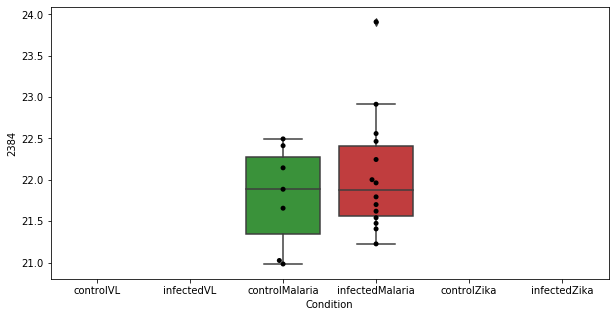

884 row m/z                134.106
row retention time     9.58824
p-val                 0.411362
adj.P.Val             0.904252
custom_id                  594
compound_names             NaN
Name: 594, dtype: object


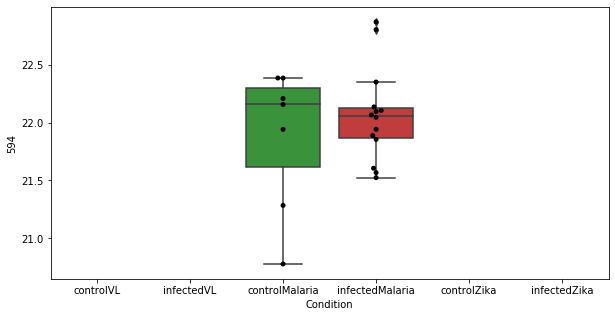

885 row m/z                125.969
row retention time     4.65598
p-val                 0.411413
adj.P.Val             0.904252
custom_id                  445
compound_names             NaN
Name: 445, dtype: object


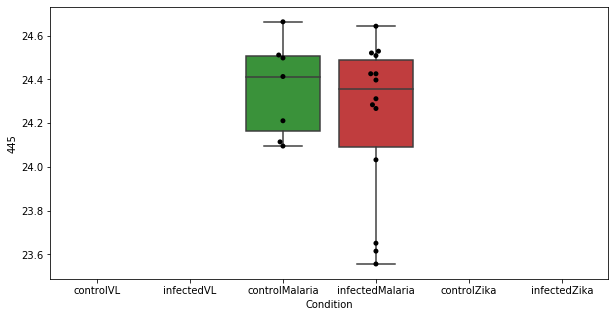

886 row m/z                  810.6
row retention time     3.48091
p-val                 0.411783
adj.P.Val             0.904252
custom_id                 2943
compound_names             NaN
Name: 2943, dtype: object


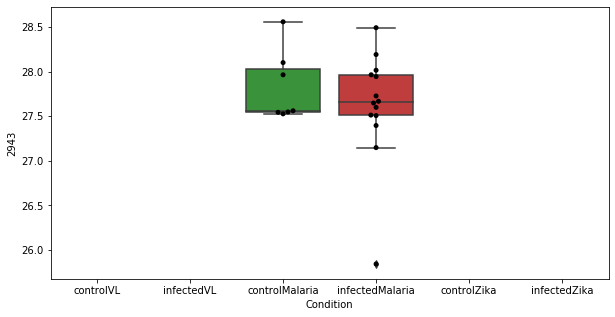

887 row m/z                681.483
row retention time     3.36059
p-val                 0.411994
adj.P.Val             0.904252
custom_id                 2812
compound_names             NaN
Name: 2812, dtype: object


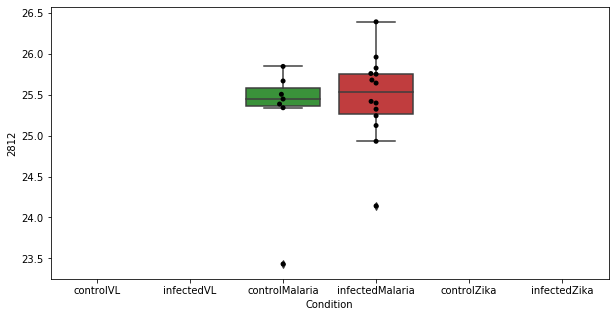

888 row m/z                227.201
row retention time     3.69709
p-val                 0.413282
adj.P.Val             0.904689
custom_id                 1688
compound_names             NaN
Name: 1688, dtype: object


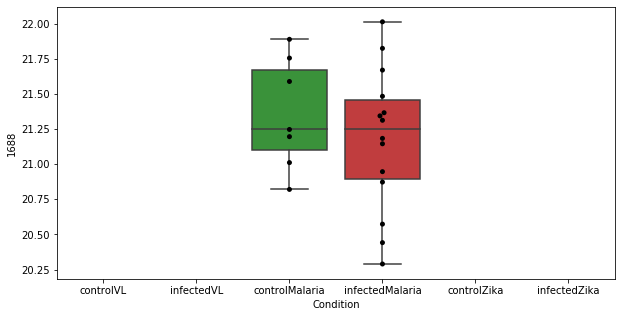

889 row m/z                 113.09
row retention time     9.53241
p-val                 0.413464
adj.P.Val             0.904689
custom_id                  268
compound_names             NaN
Name: 268, dtype: object


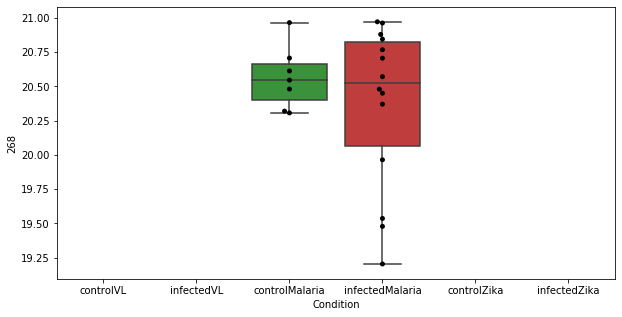

890 row m/z                226.107
row retention time     6.99155
p-val                 0.414224
adj.P.Val             0.904689
custom_id                 1670
compound_names             NaN
Name: 1670, dtype: object


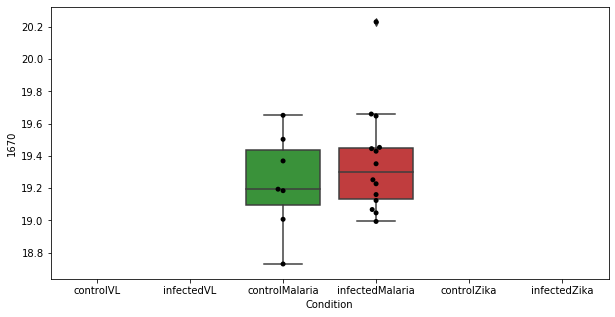

891 row m/z                                                             105
row retention time                                              3.41477
p-val                                                          0.414839
adj.P.Val                                                      0.904689
custom_id                                                           171
compound_names        3-Mercaptolactate; L-3-Mercaptolactate; (R)-3-...
Name: 171, dtype: object


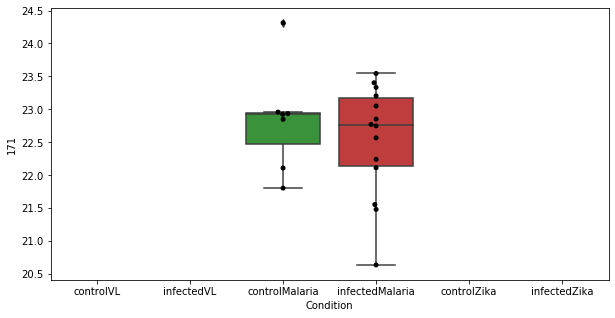

892 row m/z                464.883
row retention time     12.9926
p-val                 0.415003
adj.P.Val             0.904689
custom_id                 4191
compound_names             NaN
Name: 4191, dtype: object


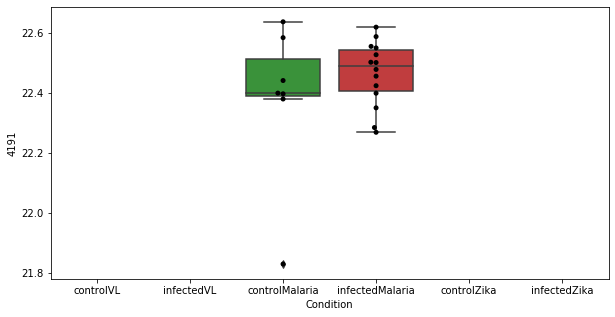

893 row m/z                122.547
row retention time     14.2371
p-val                 0.415524
adj.P.Val             0.904689
custom_id                  403
compound_names             NaN
Name: 403, dtype: object


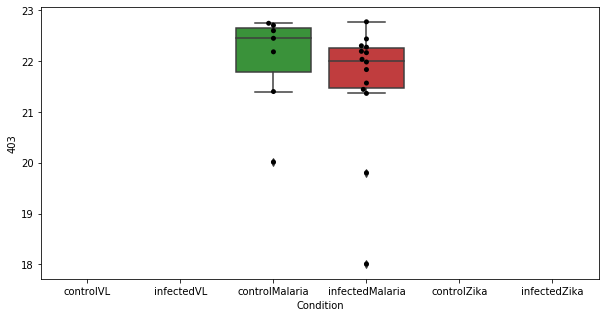

894 row m/z                158.081
row retention time     4.64308
p-val                 0.415579
adj.P.Val             0.904689
custom_id                  895
compound_names             NaN
Name: 895, dtype: object


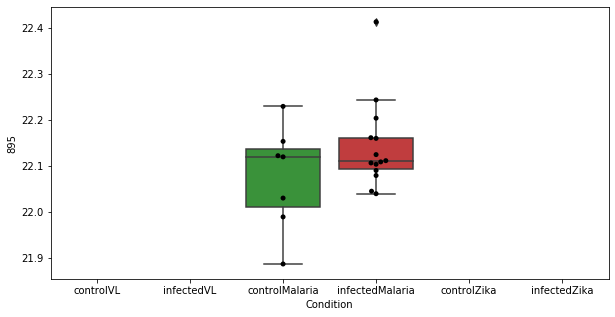

895 row m/z                70.2143
row retention time     9.01667
p-val                 0.415931
adj.P.Val             0.904689
custom_id                    5
compound_names             NaN
Name: 5, dtype: object


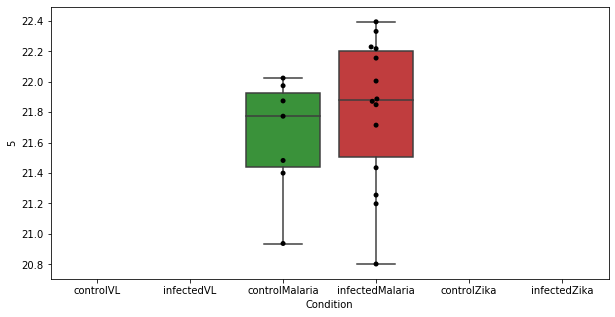

896 row m/z                107.967
row retention time     23.8536
p-val                 0.416371
adj.P.Val             0.904689
custom_id                  213
compound_names             NaN
Name: 213, dtype: object


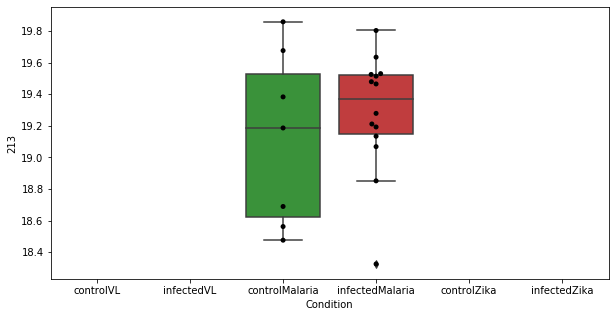

897 row m/z                220.154
row retention time     4.58037
p-val                 0.417734
adj.P.Val             0.905686
custom_id                 1640
compound_names             NaN
Name: 1640, dtype: object


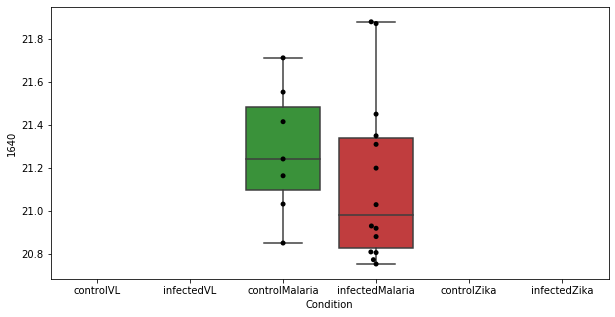

898 row m/z                704.577
row retention time      6.6902
p-val                 0.417759
adj.P.Val             0.905686
custom_id                 2827
compound_names             NaN
Name: 2827, dtype: object


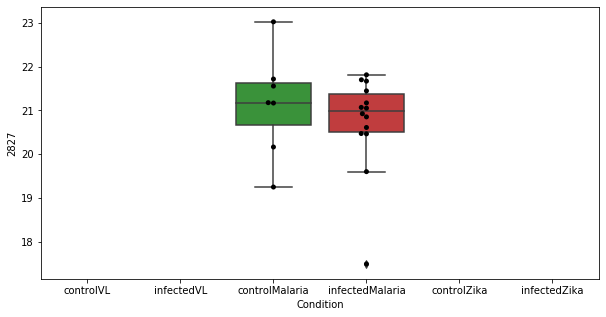

899 row m/z                801.683
row retention time      3.6201
p-val                 0.419871
adj.P.Val             0.909255
custom_id                 2932
compound_names             NaN
Name: 2932, dtype: object


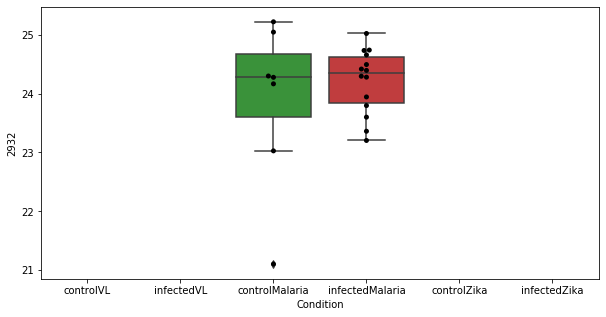

900 row m/z                162.058
row retention time     4.58188
p-val                 0.421317
adj.P.Val             0.911373
custom_id                  949
compound_names             NaN
Name: 949, dtype: object


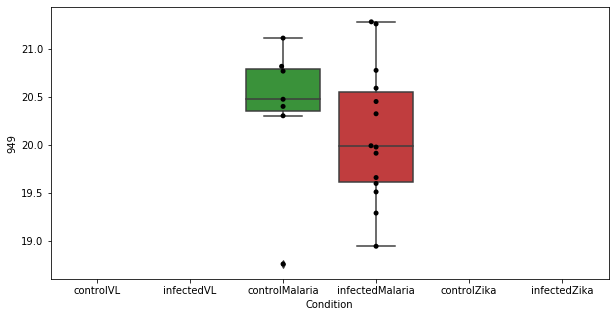

901 row m/z                645.818
row retention time        9.26
p-val                 0.422933
adj.P.Val             0.913853
custom_id                 2782
compound_names             NaN
Name: 2782, dtype: object


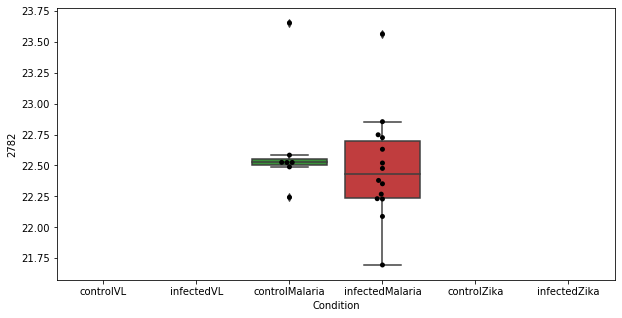

902 row m/z                 118.12
row retention time     9.93992
p-val                  0.42382
adj.P.Val             0.914756
custom_id                  352
compound_names             NaN
Name: 352, dtype: object


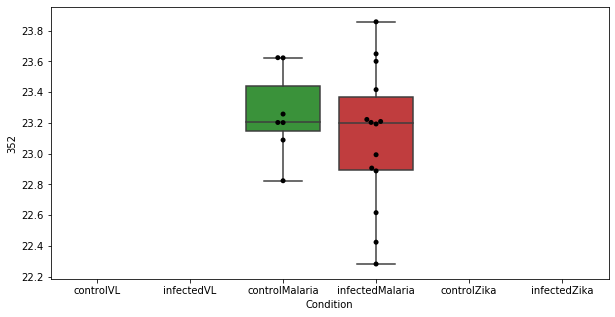

903 row m/z                                                         147.029
row retention time                                              12.2918
p-val                                                          0.424929
adj.P.Val                                                      0.915784
custom_id                                                           752
compound_names        2-Oxoglutarate; Oxoglutaric acid; 2-Ketoglutar...
Name: 752, dtype: object


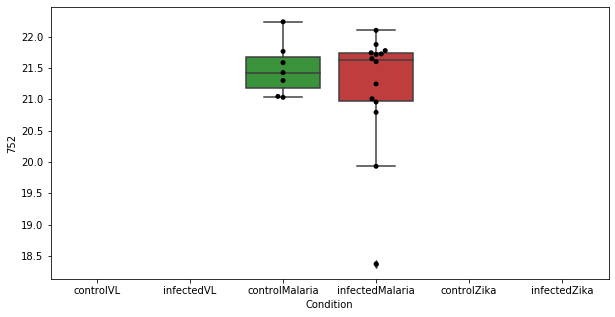

904 row m/z                                                         279.232
row retention time                                              3.25103
p-val                                                          0.425556
adj.P.Val                                                      0.915784
custom_id                                                          2136
compound_names        Hexadecanoic acid; Hexadecanoate; Hexadecylic ...
Name: 2136, dtype: object


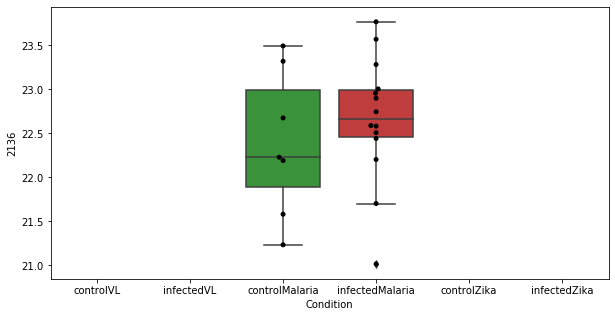

905 row m/z                276.008
row retention time     11.2907
p-val                 0.425706
adj.P.Val             0.915784
custom_id                 3943
compound_names             NaN
Name: 3943, dtype: object


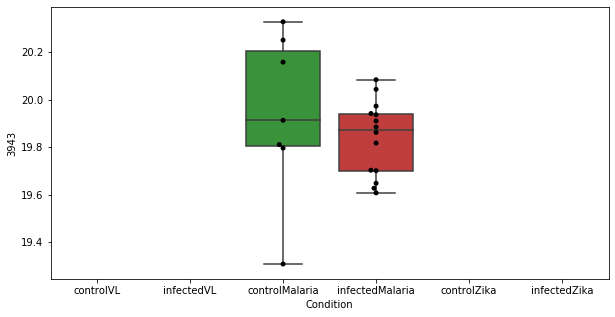

906 row m/z                215.164
row retention time     3.89487
p-val                 0.426289
adj.P.Val             0.916027
custom_id                 1597
compound_names             NaN
Name: 1597, dtype: object


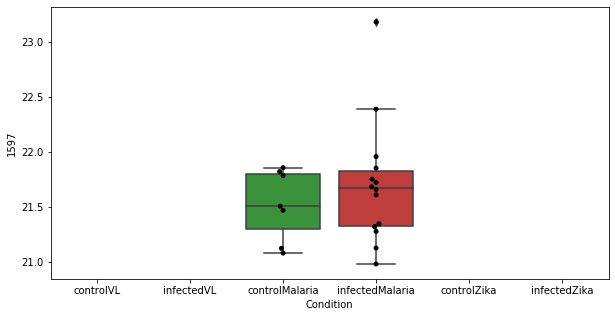

907 row m/z                632.847
row retention time     13.0637
p-val                 0.426976
adj.P.Val             0.916273
custom_id                 2771
compound_names             NaN
Name: 2771, dtype: object


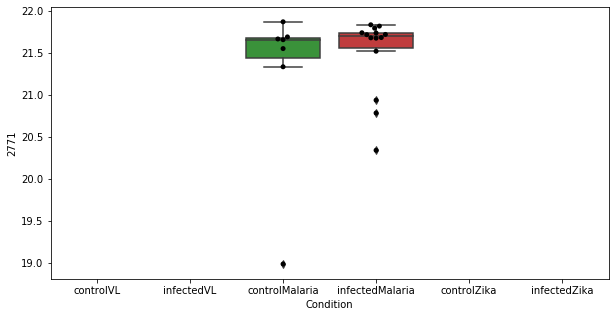

908 row m/z                733.557
row retention time     3.54893
p-val                 0.427343
adj.P.Val             0.916273
custom_id                 2846
compound_names             NaN
Name: 2846, dtype: object


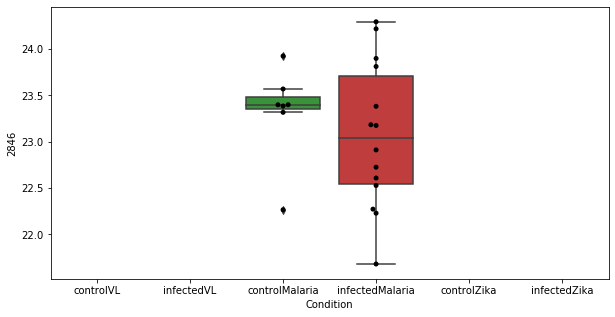

909 row m/z                179.128
row retention time     15.4894
p-val                 0.428168
adj.P.Val             0.917032
custom_id                 1165
compound_names             NaN
Name: 1165, dtype: object


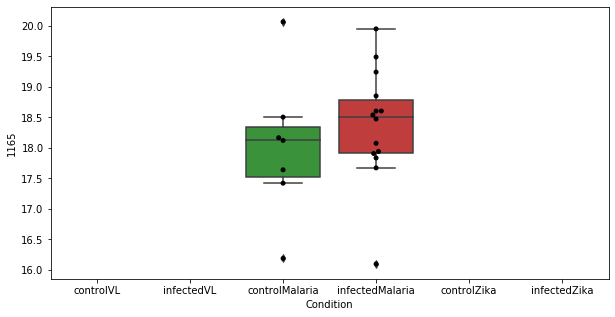

910 row m/z                344.228
row retention time     6.79915
p-val                 0.429107
adj.P.Val             0.918035
custom_id                 2413
compound_names             NaN
Name: 2413, dtype: object


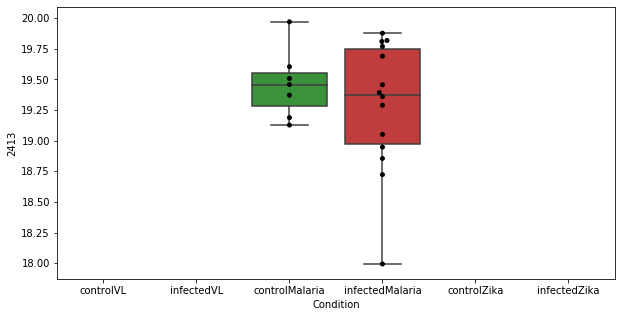

911 row m/z                647.798
row retention time     10.5663
p-val                 0.430014
adj.P.Val             0.918035
custom_id                 2786
compound_names             NaN
Name: 2786, dtype: object


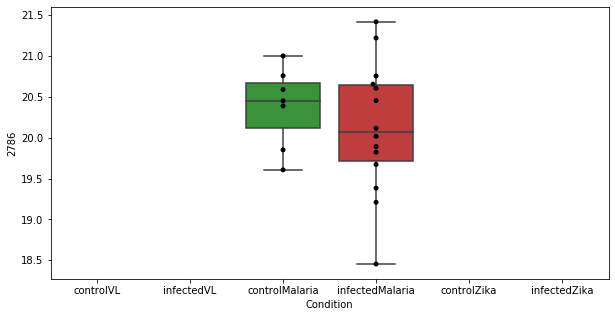

912 row m/z                128.992
row retention time     12.8731
p-val                  0.43009
adj.P.Val             0.918035
custom_id                 3230
compound_names             NaN
Name: 3230, dtype: object


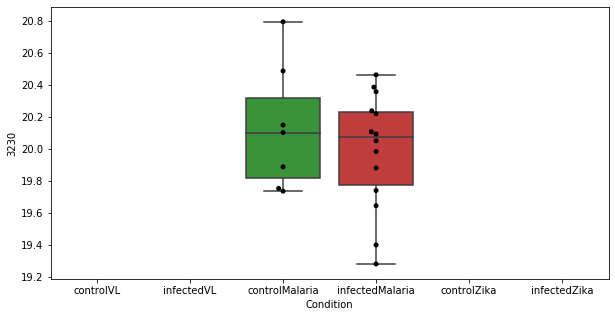

913 row m/z                                                         114.055
row retention time                                              7.00139
p-val                                                           0.43052
adj.P.Val                                                      0.918035
custom_id                                                           279
compound_names        1-Pyrroline-2-carboxylate; 1-Pyrroline-2-carbo...
Name: 279, dtype: object


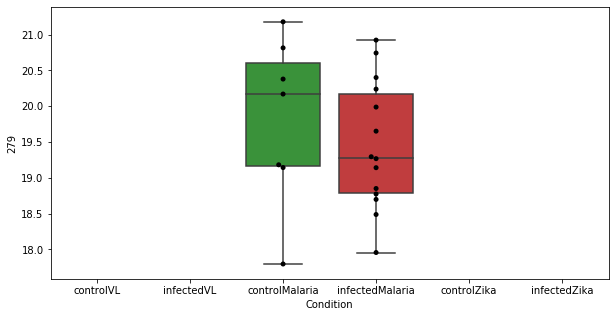

914 row m/z                 812.67
row retention time      4.2749
p-val                 0.431316
adj.P.Val              0.91807
custom_id                 5292
compound_names             NaN
Name: 5292, dtype: object


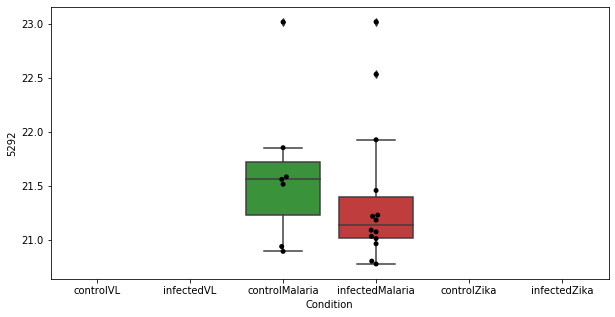

915 row m/z                505.907
row retention time     8.21397
p-val                 0.432389
adj.P.Val              0.91807
custom_id                 2631
compound_names             NaN
Name: 2631, dtype: object


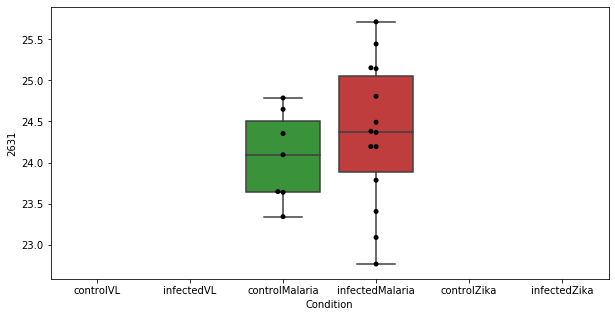

916 row m/z               191.103
row retention time    17.7753
p-val                 0.43256
adj.P.Val             0.91807
custom_id                1328
compound_names            NaN
Name: 1328, dtype: object


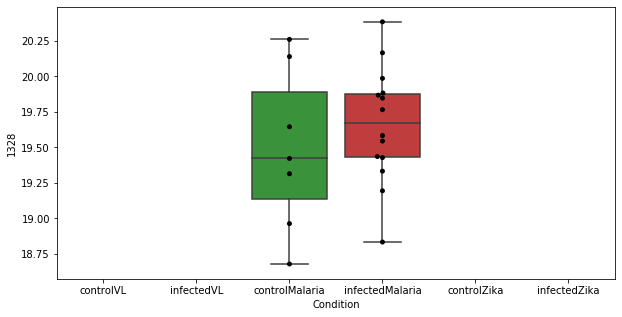

917 row m/z               502.292
row retention time    3.99071
p-val                 0.43263
adj.P.Val             0.91807
custom_id                2629
compound_names            NaN
Name: 2629, dtype: object


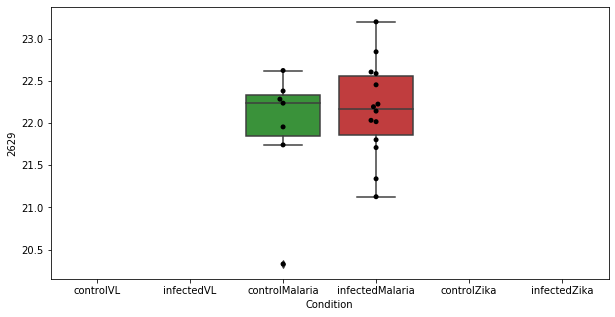

918 row m/z                                                         140.068
row retention time                                              9.94845
p-val                                                          0.433328
adj.P.Val                                                       0.91807
custom_id                                                           646
compound_names        5-Aminopentanoate; 5-Aminopentanoic acid; 5-Am...
Name: 646, dtype: object


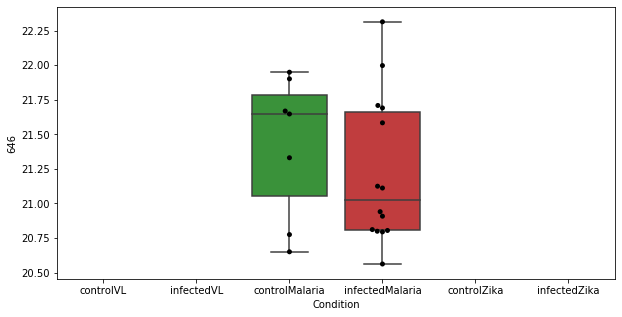

919 row m/z                218.102
row retention time     14.0775
p-val                 0.433709
adj.P.Val              0.91807
custom_id                 3714
compound_names             NaN
Name: 3714, dtype: object


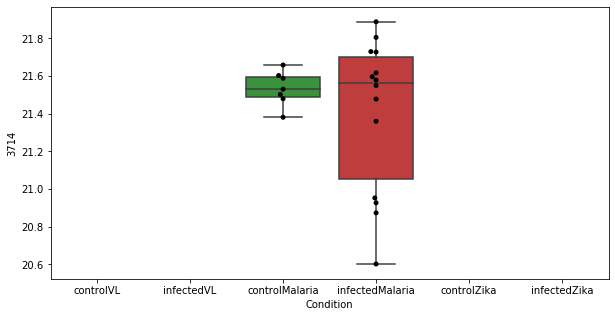

920 row m/z                                       175.144
row retention time                            15.4265
p-val                                        0.433917
adj.P.Val                                     0.91807
custom_id                                        1137
compound_names        Protein N6,N6-dimethyl-L-lysine
Name: 1137, dtype: object


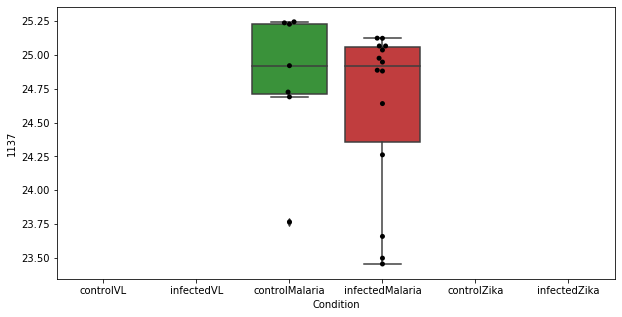

921 row m/z                413.778
row retention time     4.03205
p-val                 0.434657
adj.P.Val              0.91807
custom_id                 6980
compound_names             NaN
Name: 6980, dtype: object


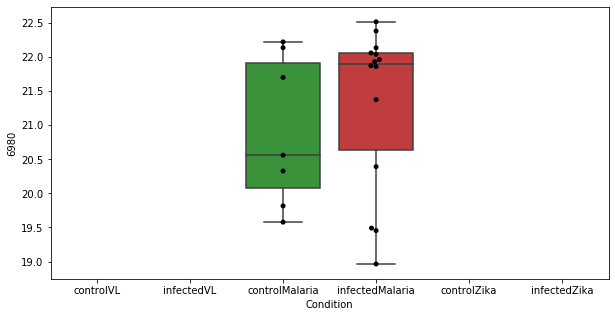

922 row m/z                                111.055
row retention time                     9.62311
p-val                                 0.435724
adj.P.Val                              0.91807
custom_id                                  228
compound_names        Urocanate; Urocanic acid
Name: 228, dtype: object


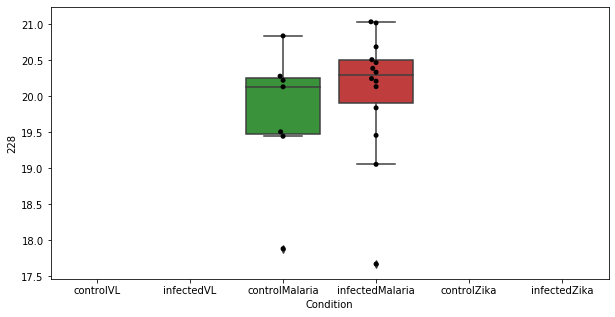

923 row m/z                                                         128.071
row retention time                                              7.00139
p-val                                                          0.435974
adj.P.Val                                                       0.91807
custom_id                                                           466
compound_names        2,3,4,5-Tetrahydropyridine-2-carboxylate; delt...
Name: 466, dtype: object


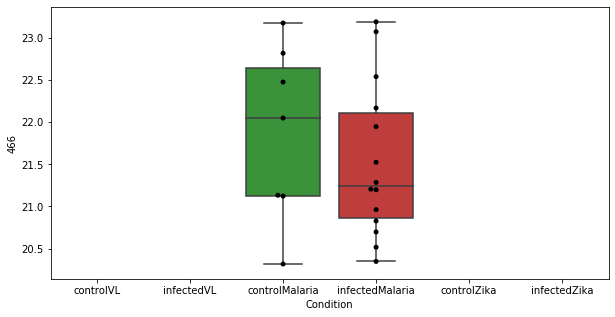

924 row m/z                296.918
row retention time     23.7159
p-val                 0.435983
adj.P.Val              0.91807
custom_id                 2235
compound_names             NaN
Name: 2235, dtype: object


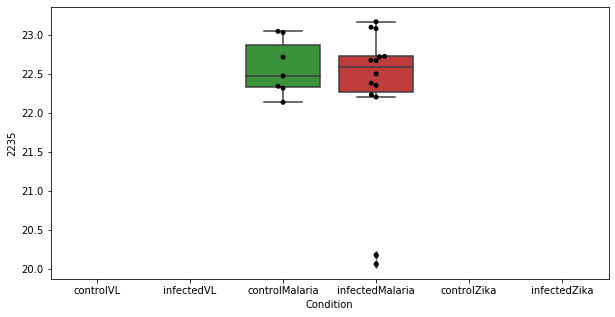

925 row m/z                248.147
row retention time     8.00303
p-val                 0.436189
adj.P.Val              0.91807
custom_id                 6832
compound_names             NaN
Name: 6832, dtype: object


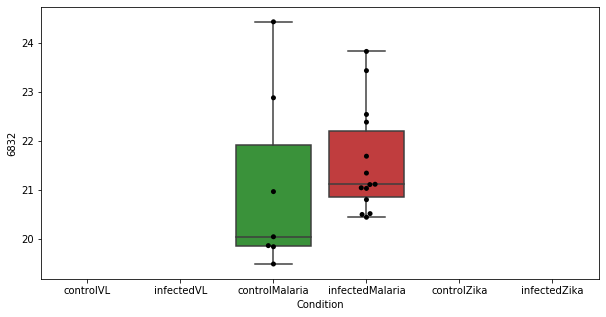

926 row m/z                  380.9
row retention time     1.53832
p-val                  0.43897
adj.P.Val             0.922926
custom_id                 5209
compound_names             NaN
Name: 5209, dtype: object


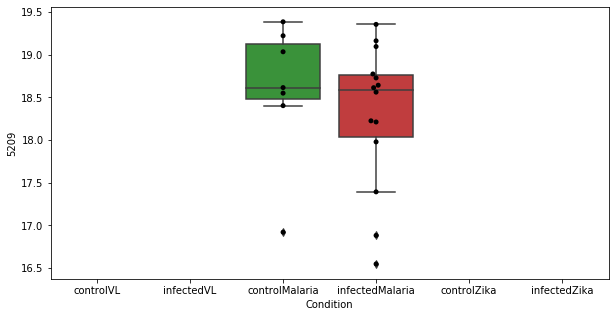

927 row m/z                                                         169.086
row retention time                                              4.03411
p-val                                                          0.442876
adj.P.Val                                                      0.928158
custom_id                                                          1042
compound_names        N-Trimethyl-2-aminoethylphosphonate; 2-Trimeth...
Name: 1042, dtype: object


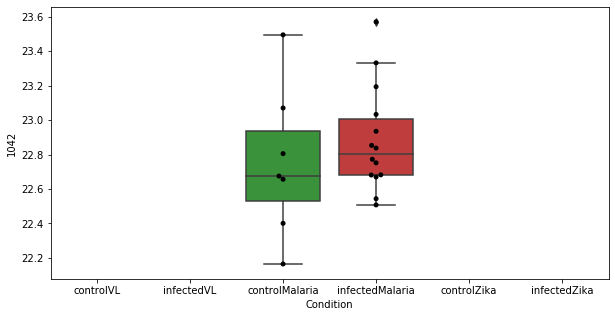

928 row m/z                162.058
row retention time     6.99943
p-val                  0.44297
adj.P.Val             0.928158
custom_id                  950
compound_names             NaN
Name: 950, dtype: object


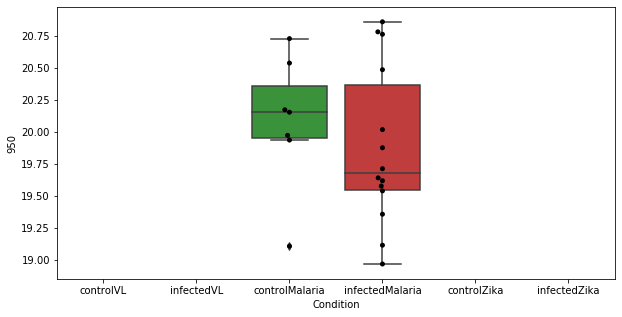

929 row m/z                                               286.144
row retention time                                    3.95488
p-val                                                 0.44316
adj.P.Val                                            0.928158
custom_id                                                2171
compound_names        Norcodeine; N-Desmethylcodeine$Morphine
Name: 2171, dtype: object


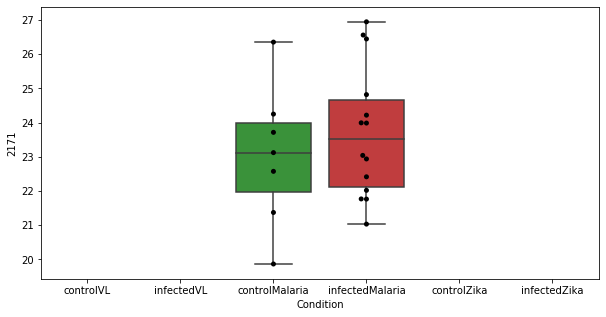

930 row m/z                                                         139.058
row retention time                                              10.2239
p-val                                                          0.443364
adj.P.Val                                                      0.928158
custom_id                                                           632
compound_names        Anthranilate; Anthranilic acid; o-Aminobenzoic...
Name: 632, dtype: object


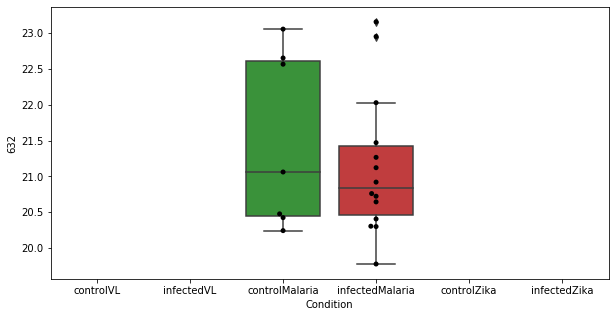

931 row m/z                789.618
row retention time     3.49902
p-val                 0.444167
adj.P.Val             0.928842
custom_id                 2919
compound_names             NaN
Name: 2919, dtype: object


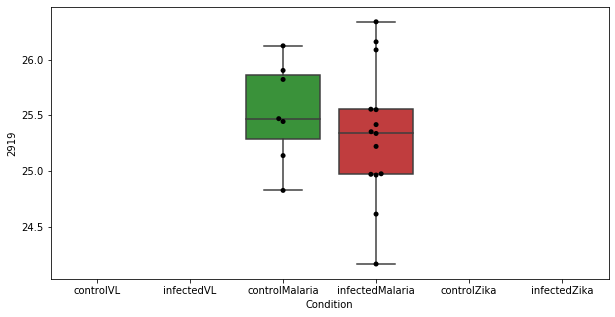

932 row m/z                        169.097
row retention time             5.07222
p-val                         0.445363
adj.P.Val                     0.929173
custom_id                         1043
compound_names        Pyridoxamine; PM
Name: 1043, dtype: object


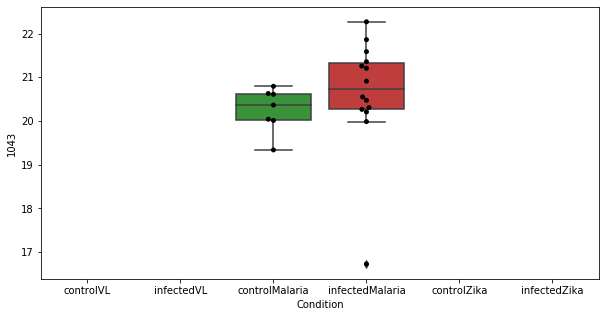

933 row m/z                813.683
row retention time     6.77765
p-val                 0.445984
adj.P.Val             0.929173
custom_id                 2953
compound_names             NaN
Name: 2953, dtype: object


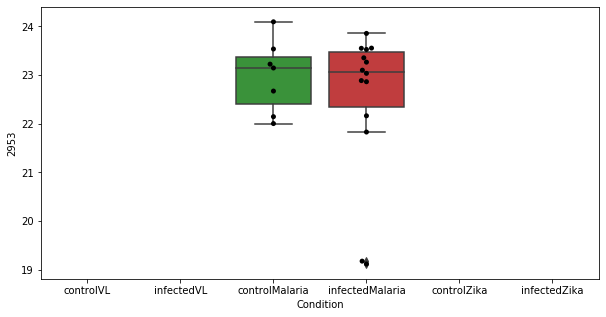

934 row m/z                413.778
row retention time     7.04671
p-val                 0.445988
adj.P.Val             0.929173
custom_id                 2544
compound_names             NaN
Name: 2544, dtype: object


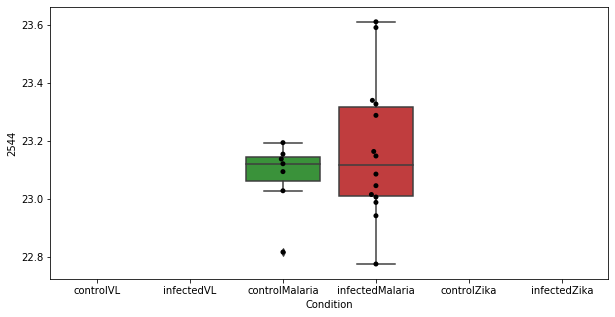

935 row m/z                789.675
row retention time     4.36353
p-val                  0.44683
adj.P.Val             0.929173
custom_id                 4290
compound_names             NaN
Name: 4290, dtype: object


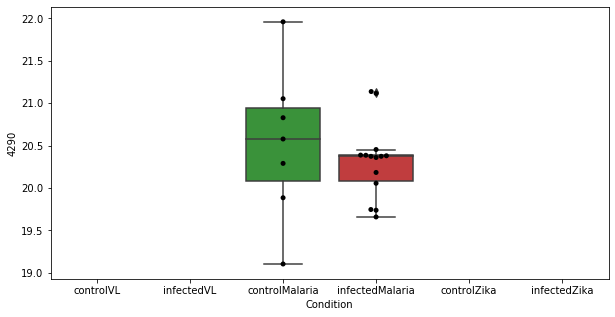

936 row m/z                163.116
row retention time     11.1061
p-val                 0.447532
adj.P.Val             0.929173
custom_id                  970
compound_names             NaN
Name: 970, dtype: object


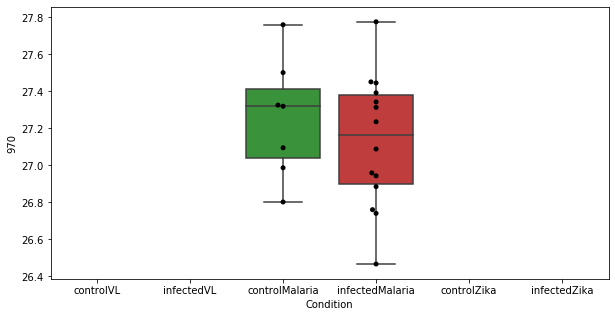

937 row m/z                276.119
row retention time     12.2414
p-val                  0.44759
adj.P.Val             0.929173
custom_id                 2100
compound_names             NaN
Name: 2100, dtype: object


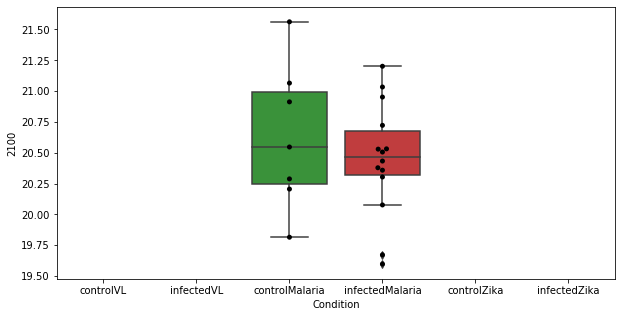

938 row m/z                                                         113.071
row retention time                                               23.822
p-val                                                          0.448016
adj.P.Val                                                      0.929173
custom_id                                                           261
compound_names        4-Imidazolone-5-propanoate; 4-Imidazolone-5-pr...
Name: 261, dtype: object


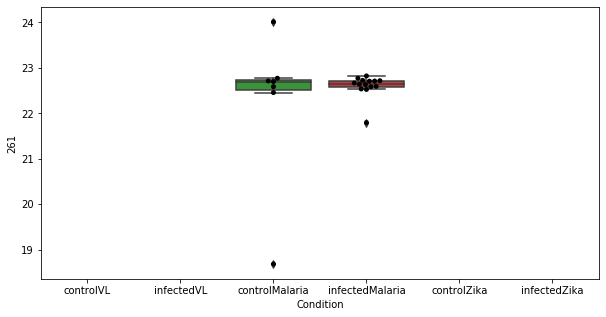

939 row m/z                475.297
row retention time     3.24918
p-val                 0.448139
adj.P.Val             0.929173
custom_id                 2599
compound_names             NaN
Name: 2599, dtype: object


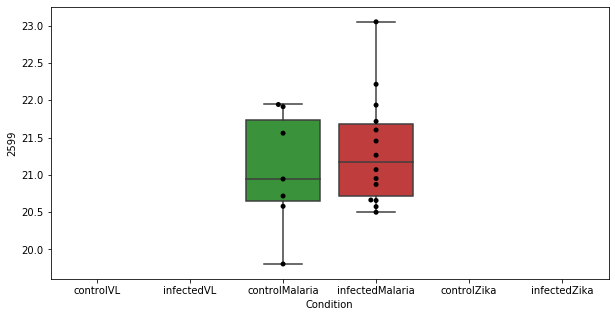

940 row m/z                270.894
row retention time     12.6073
p-val                 0.450696
adj.P.Val             0.932559
custom_id                 2057
compound_names             NaN
Name: 2057, dtype: object


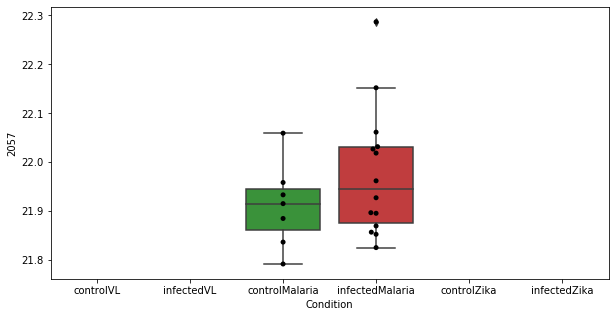

941 row m/z                152.948
row retention time     12.1094
p-val                 0.451065
adj.P.Val             0.932559
custom_id                  840
compound_names             NaN
Name: 840, dtype: object


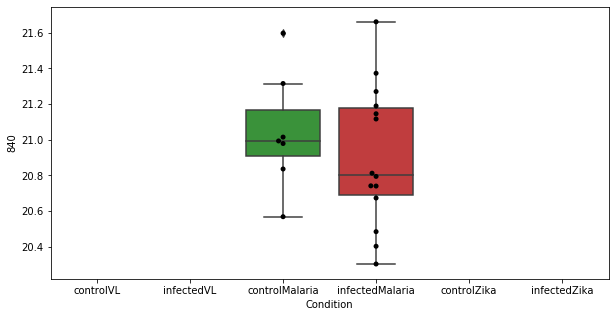

942 row m/z                                                         154.05
row retention time                                             7.00547
p-val                                                         0.451207
adj.P.Val                                                     0.932559
custom_id                                                          851
compound_names        3-Hydroxyanthranilate; 3-Hydroxyanthranilic acid
Name: 851, dtype: object


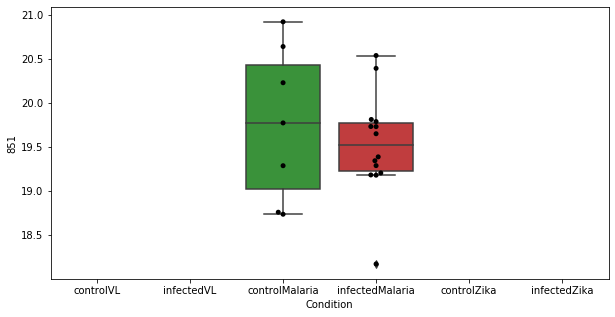

943 row m/z                905.594
row retention time      3.2772
p-val                 0.453457
adj.P.Val             0.932839
custom_id                 2979
compound_names             NaN
Name: 2979, dtype: object


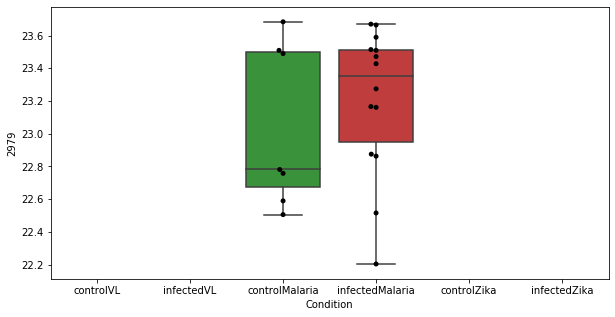

944 row m/z                261.121
row retention time     6.98092
p-val                 0.454366
adj.P.Val             0.932839
custom_id                 1981
compound_names             NaN
Name: 1981, dtype: object


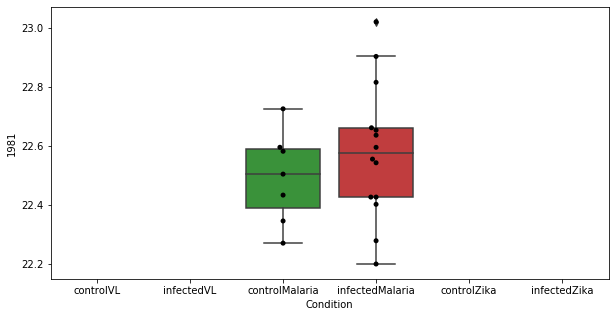

945 row m/z                332.111
row retention time      3.6618
p-val                 0.454731
adj.P.Val             0.932839
custom_id                 2385
compound_names             NaN
Name: 2385, dtype: object


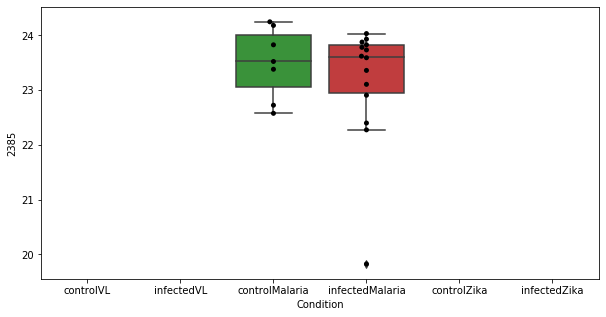

946 row m/z                228.123
row retention time     6.99548
p-val                 0.454758
adj.P.Val             0.932839
custom_id                 1692
compound_names             NaN
Name: 1692, dtype: object


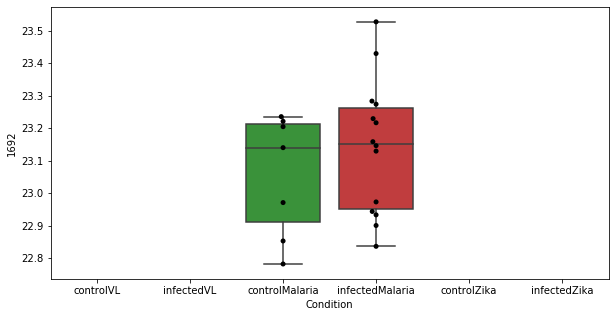

947 row m/z                           219.142
row retention time                4.46731
p-val                            0.454962
adj.P.Val                        0.932839
custom_id                            1635
compound_names        propionyl-carnitine
Name: 1635, dtype: object


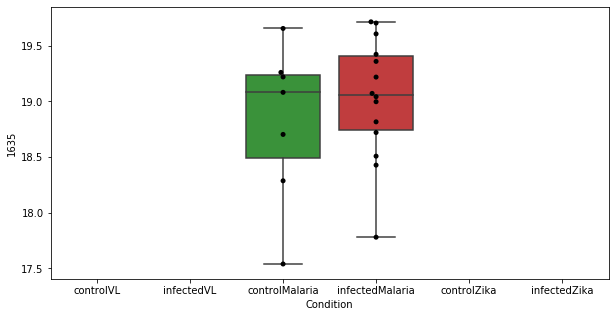

948 row m/z                 105.11
row retention time     6.83173
p-val                 0.455188
adj.P.Val             0.932839
custom_id                  190
compound_names             NaN
Name: 190, dtype: object


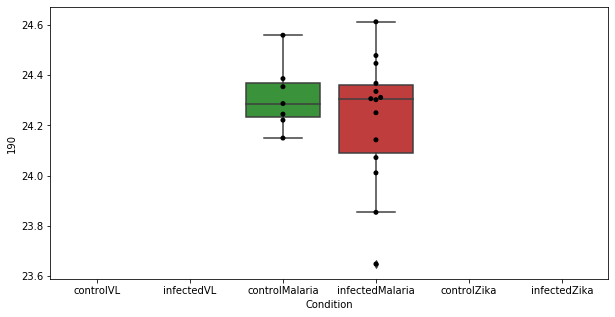

949 row m/z                225.189
row retention time     23.7536
p-val                   0.4558
adj.P.Val             0.932839
custom_id                 3737
compound_names             NaN
Name: 3737, dtype: object


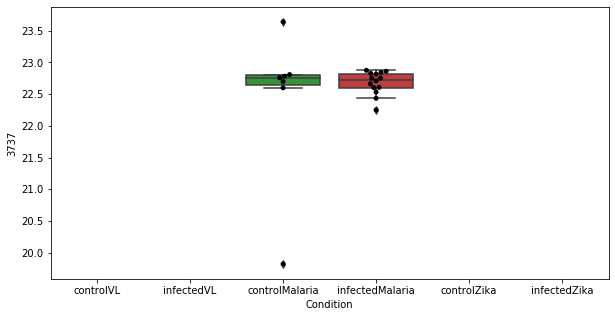

950 row m/z                 136.95
row retention time     10.5146
p-val                 0.456342
adj.P.Val             0.932839
custom_id                 5523
compound_names             NaN
Name: 5523, dtype: object


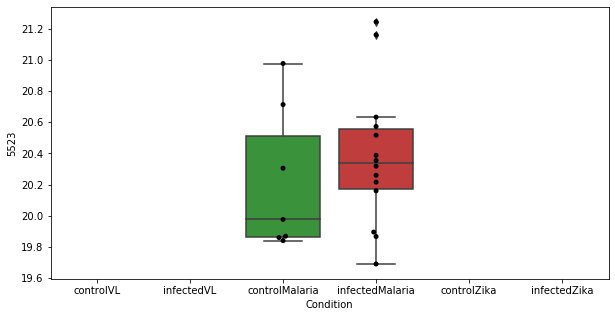

951 row m/z                370.295
row retention time     4.21921
p-val                 0.456597
adj.P.Val             0.932839
custom_id                 4146
compound_names             NaN
Name: 4146, dtype: object


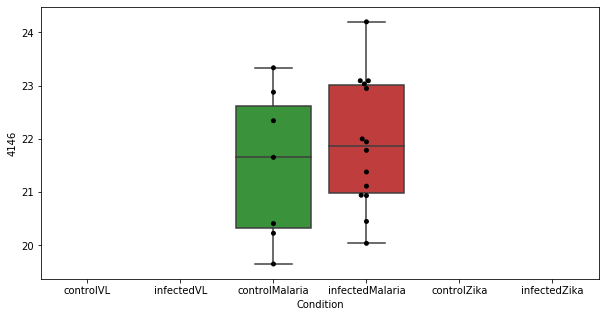

952 row m/z                535.409
row retention time     3.39909
p-val                 0.456615
adj.P.Val             0.932839
custom_id                 2672
compound_names             NaN
Name: 2672, dtype: object


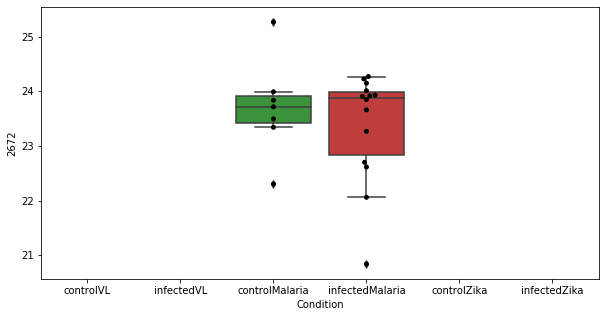

953 row m/z                540.871
row retention time     8.47096
p-val                 0.456933
adj.P.Val             0.932839
custom_id                 2679
compound_names             NaN
Name: 2679, dtype: object


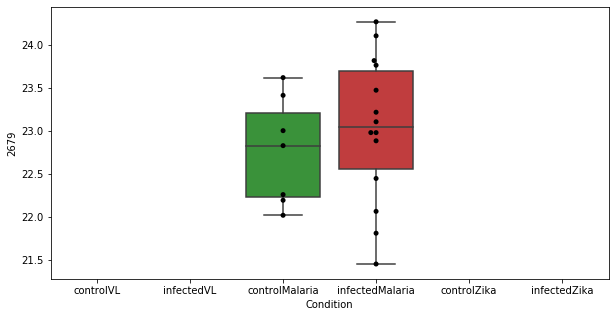

954 row m/z                143.154
row retention time     2.27507
p-val                 0.457086
adj.P.Val             0.932839
custom_id                  689
compound_names             NaN
Name: 689, dtype: object


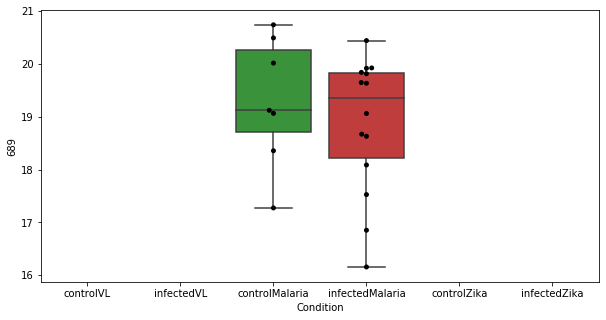

955 row m/z                253.128
row retention time     4.00461
p-val                 0.458899
adj.P.Val             0.935088
custom_id                 1937
compound_names             NaN
Name: 1937, dtype: object


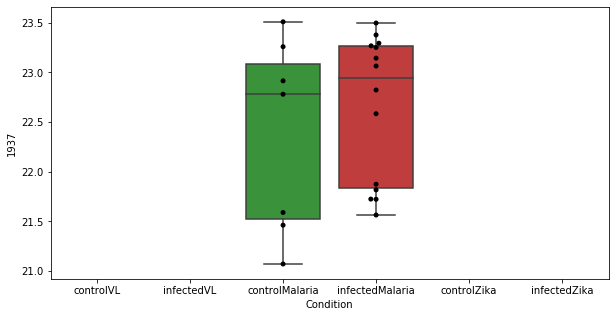

956 row m/z                 785.65
row retention time     3.60849
p-val                 0.459148
adj.P.Val             0.935088
custom_id                 2909
compound_names             NaN
Name: 2909, dtype: object


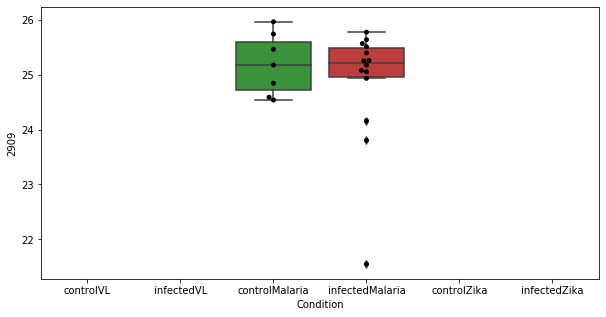

957 row m/z                250.051
row retention time     17.7764
p-val                 0.460165
adj.P.Val              0.93512
custom_id                 1902
compound_names             NaN
Name: 1902, dtype: object


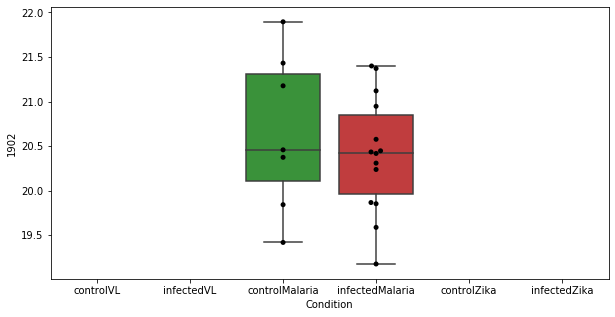

958 row m/z                                                         133.105
row retention time                                              9.59577
p-val                                                           0.46032
adj.P.Val                                                       0.93512
custom_id                                                           582
compound_names        L-Isoleucine; 2-Amino-3-methylvaleric acid$L-L...
Name: 582, dtype: object


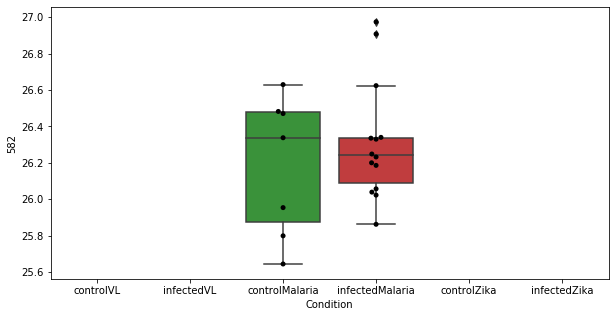

959 row m/z                78.9557
row retention time     15.1733
p-val                 0.460784
adj.P.Val              0.93512
custom_id                   21
compound_names             NaN
Name: 21, dtype: object


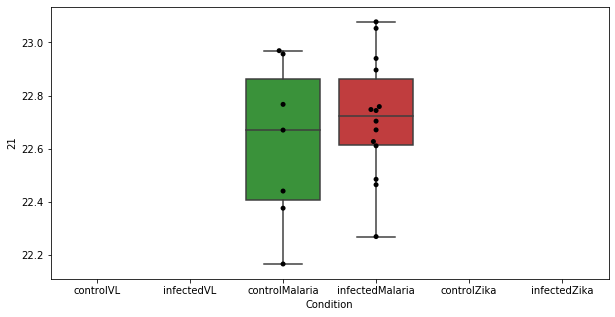

960 row m/z                585.358
row retention time     4.78681
p-val                 0.461142
adj.P.Val              0.93512
custom_id                 2736
compound_names             NaN
Name: 2736, dtype: object


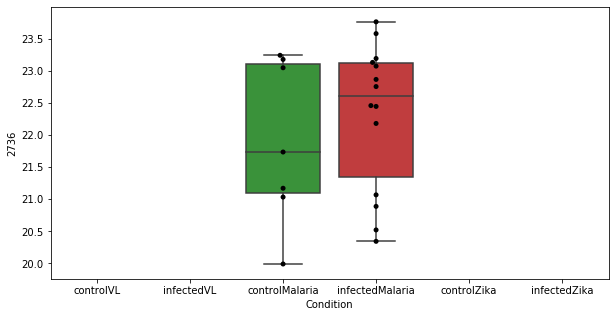

961 row m/z                158.118
row retention time     4.54291
p-val                 0.462083
adj.P.Val              0.93512
custom_id                  901
compound_names             NaN
Name: 901, dtype: object


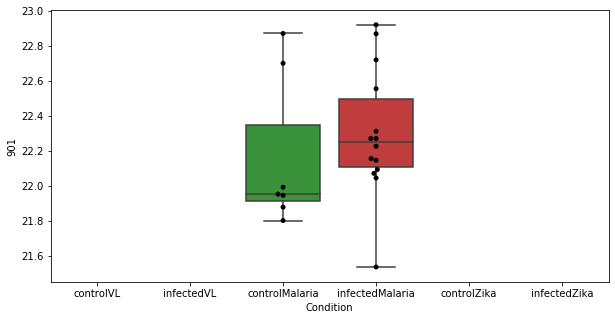

962 row m/z                                                         299.258
row retention time                                              3.37646
p-val                                                          0.462724
adj.P.Val                                                       0.93512
custom_id                                                          2247
compound_names        Linoleate; Linoleic acid; (9Z,12Z)-Octadecadie...
Name: 2247, dtype: object


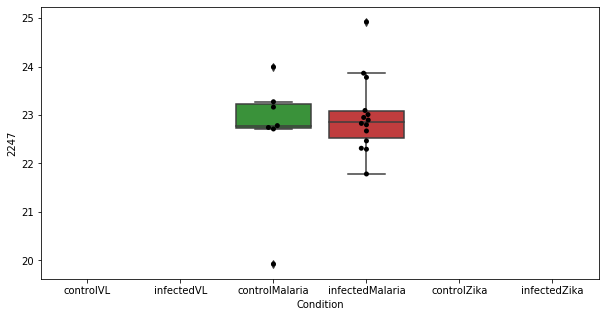

963 row m/z                144.927
row retention time     15.1322
p-val                 0.462775
adj.P.Val              0.93512
custom_id                 3336
compound_names             NaN
Name: 3336, dtype: object


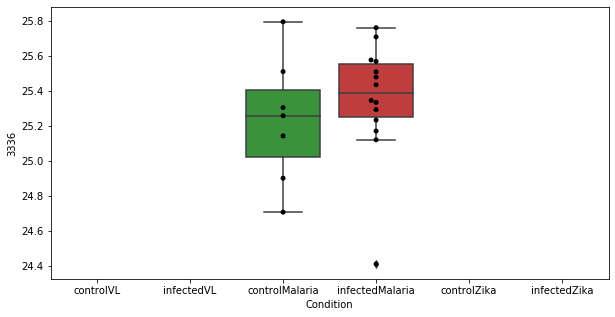

964 row m/z                230.175
row retention time     3.77123
p-val                 0.463317
adj.P.Val              0.93512
custom_id                 1722
compound_names             NaN
Name: 1722, dtype: object


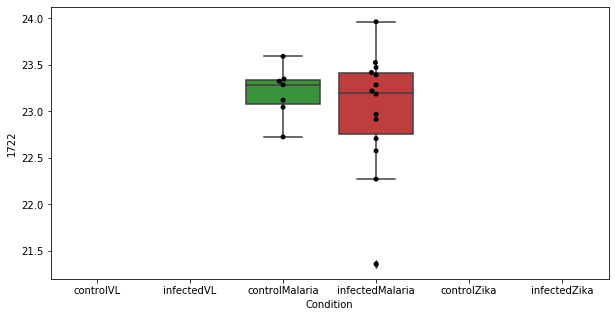

965 row m/z                                                          203.15
row retention time                                              16.0806
p-val                                                          0.463482
adj.P.Val                                                       0.93512
custom_id                                                          1463
compound_names        Nomega,Nomega'-Dimethyl-L-arginine; NG,NG-Dime...
Name: 1463, dtype: object


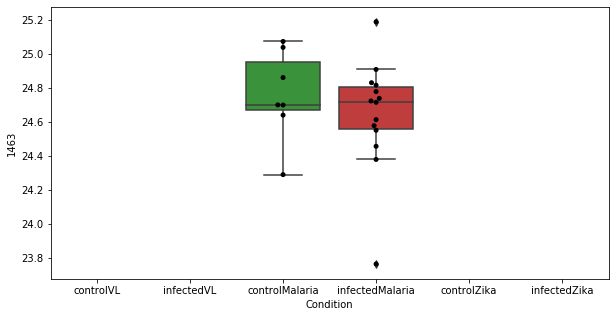

966 row m/z                226.905
row retention time     12.5981
p-val                 0.465096
adj.P.Val             0.935381
custom_id                 1680
compound_names             NaN
Name: 1680, dtype: object


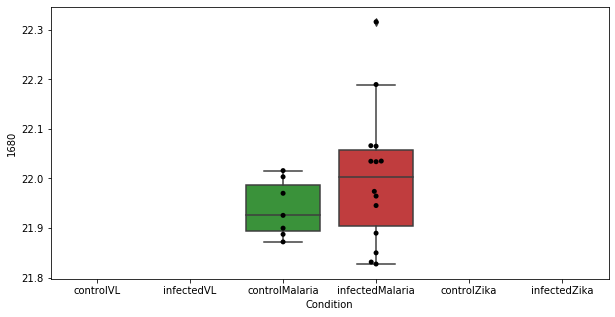

967 row m/z                613.523
row retention time     3.25836
p-val                 0.465805
adj.P.Val             0.935381
custom_id                 2755
compound_names             NaN
Name: 2755, dtype: object


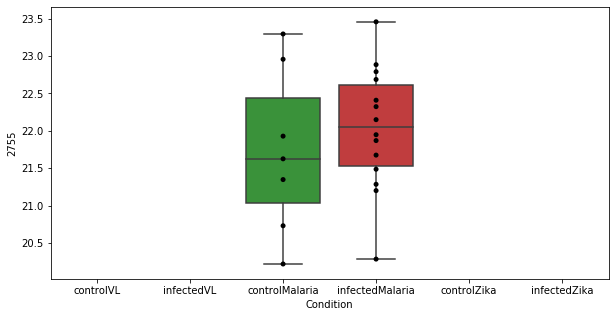

968 row m/z                                                         148.097
row retention time                                              4.72398
p-val                                                          0.466011
adj.P.Val                                                      0.935381
custom_id                                                           789
compound_names        N4-Acetylaminobutanal$L-Pipecolate; Pipecolini...
Name: 789, dtype: object


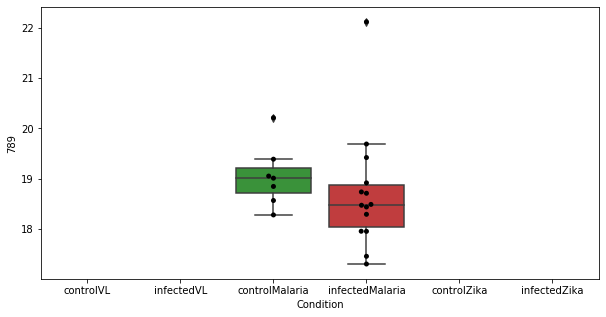

969 row m/z                         224.992
row retention time               14.357
p-val                          0.466664
adj.P.Val                      0.935381
custom_id                          1663
compound_names        Benzoyl phosphate
Name: 1663, dtype: object


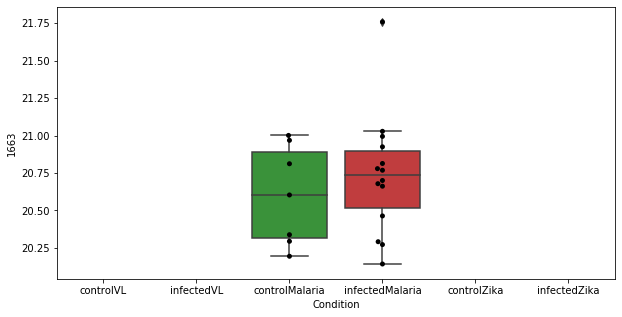

970 row m/z                  304.3
row retention time     2.82987
p-val                 0.467352
adj.P.Val             0.935381
custom_id                 2267
compound_names             NaN
Name: 2267, dtype: object


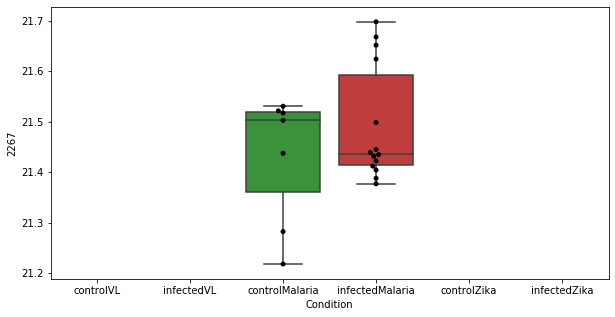

971 row m/z                161.092
row retention time     7.04032
p-val                  0.46749
adj.P.Val             0.935381
custom_id                  937
compound_names             NaN
Name: 937, dtype: object


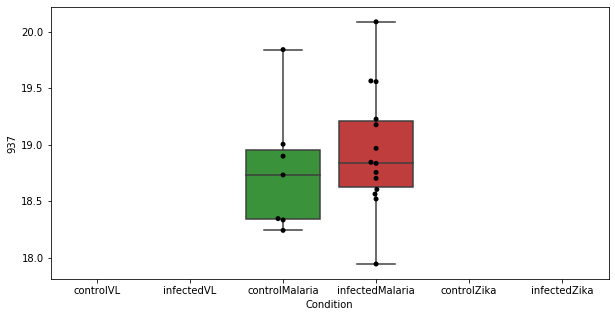

972 row m/z                286.165
row retention time     3.87073
p-val                 0.467834
adj.P.Val             0.935381
custom_id                 2172
compound_names             NaN
Name: 2172, dtype: object


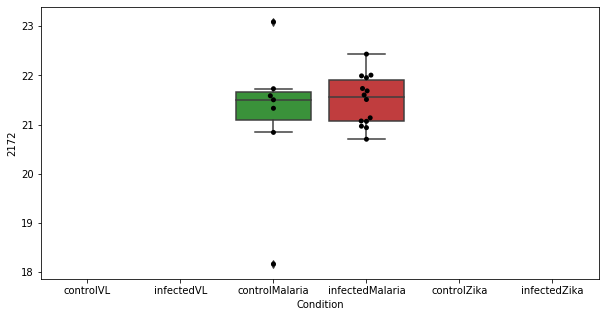

973 row m/z                226.128
row retention time     4.11108
p-val                 0.468101
adj.P.Val             0.935381
custom_id                 1673
compound_names             NaN
Name: 1673, dtype: object


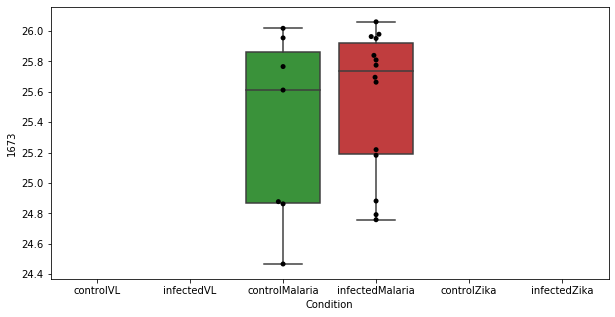

974 row m/z                615.539
row retention time     3.24721
p-val                 0.468521
adj.P.Val             0.935381
custom_id                 2760
compound_names             NaN
Name: 2760, dtype: object


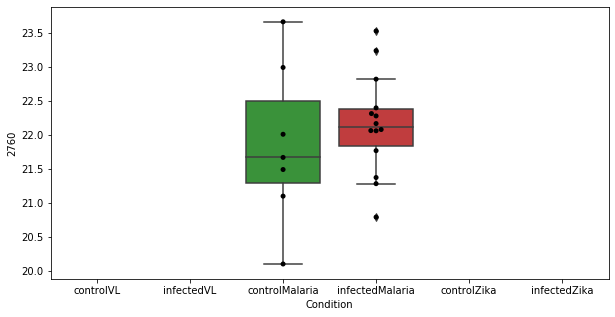

975 row m/z                213.112
row retention time      4.4762
p-val                 0.471063
adj.P.Val             0.935381
custom_id                 3678
compound_names             NaN
Name: 3678, dtype: object


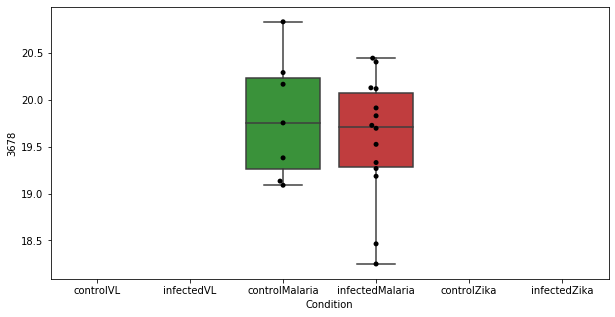

976 row m/z                                                157.097
row retention time                                     9.74453
p-val                                                 0.471252
adj.P.Val                                             0.935381
custom_id                                                  885
compound_names        N-Acetylornithine; N2-Acetyl-L-ornithine
Name: 885, dtype: object


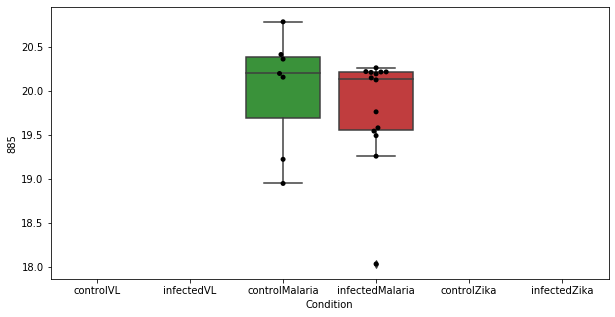

977 row m/z                                                         265.118
row retention time                                              6.11337
p-val                                                          0.472936
adj.P.Val                                                      0.935381
custom_id                                                          3899
compound_names        Formyl-N-acetyl-5-methoxykynurenamine$alpha-N-...
Name: 3899, dtype: object


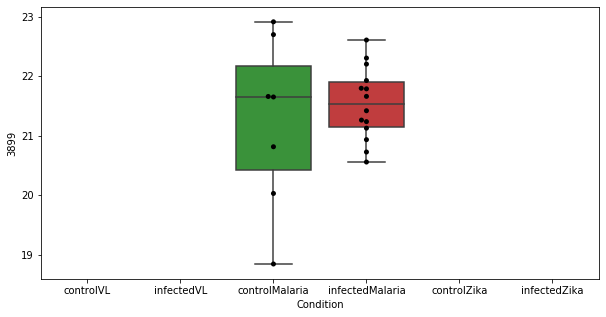

978 row m/z                 96.063
row retention time     23.2615
p-val                 0.473392
adj.P.Val             0.935381
custom_id                 3063
compound_names             NaN
Name: 3063, dtype: object


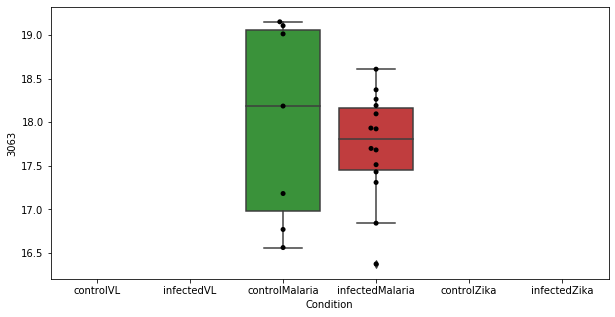

979 row m/z                            146.118
row retention time                 8.57545
p-val                             0.473498
adj.P.Val                         0.935381
custom_id                             4643
compound_names        3-Dehydroxycarnitine
Name: 4643, dtype: object


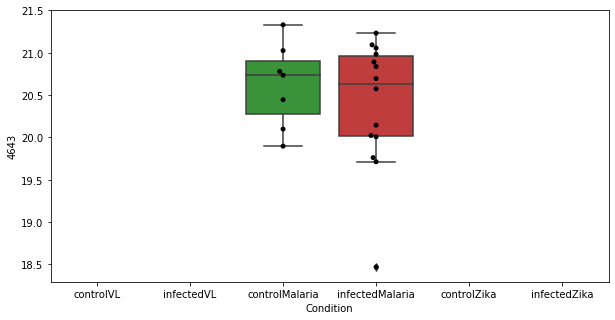

980 row m/z                                                          235.08
row retention time                                              23.1044
p-val                                                          0.474837
adj.P.Val                                                      0.935381
custom_id                                                          3780
compound_names        Nebularine; Purine riboside; N-D-Ribosylpurine...
Name: 3780, dtype: object


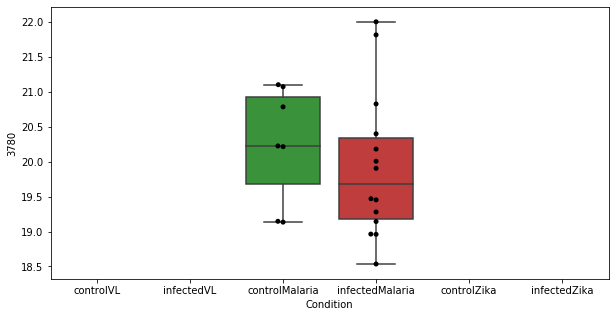

981 row m/z                                                         159.076
row retention time                                              12.7861
p-val                                                          0.475672
adj.P.Val                                                      0.935381
custom_id                                                           912
compound_names        L-Citrulline; 2-Amino-5-ureidovaleric acid; Ci...
Name: 912, dtype: object


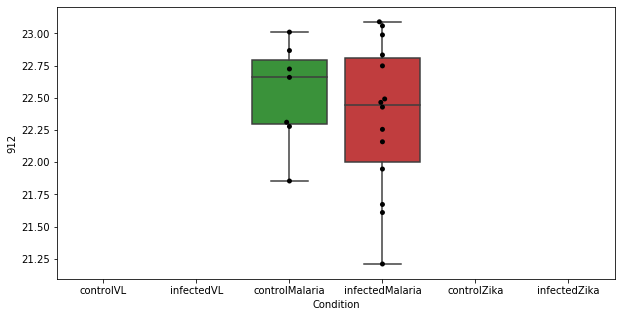

982 row m/z                 274.91
row retention time      8.2209
p-val                 0.476076
adj.P.Val             0.935381
custom_id                 3931
compound_names             NaN
Name: 3931, dtype: object


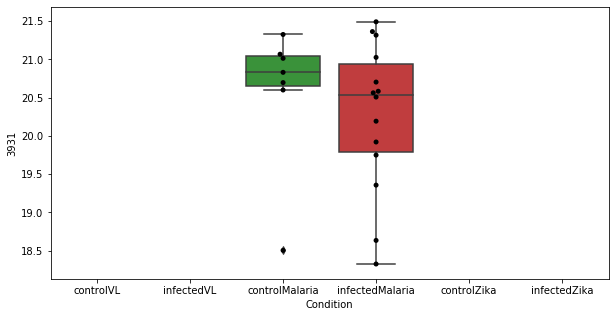

983 row m/z                             132.102
row retention time                  9.59361
p-val                              0.476546
adj.P.Val                          0.935381
custom_id                               555
compound_names        5-Acetamidopentanoate
Name: 555, dtype: object


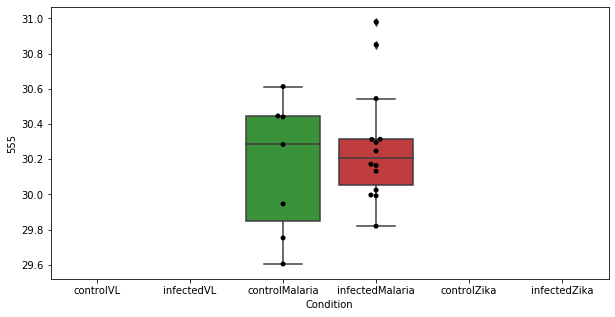

984 row m/z                847.844
row retention time     9.25809
p-val                 0.476686
adj.P.Val             0.935381
custom_id                 2970
compound_names             NaN
Name: 2970, dtype: object


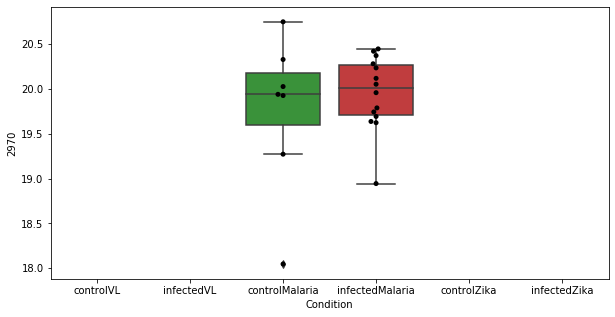

985 row m/z                816.701
row retention time     3.65146
p-val                 0.477137
adj.P.Val             0.935381
custom_id                 2960
compound_names             NaN
Name: 2960, dtype: object


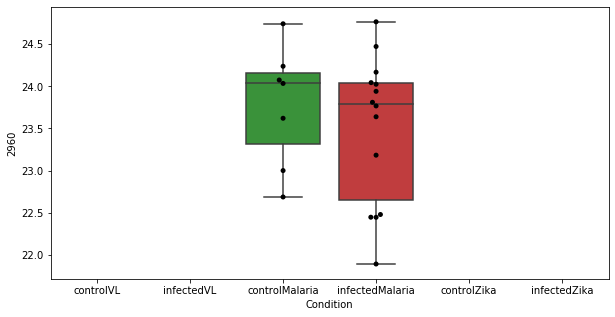

986 row m/z                281.134
row retention time     4.46989
p-val                 0.478138
adj.P.Val             0.935381
custom_id                 2143
compound_names             NaN
Name: 2143, dtype: object


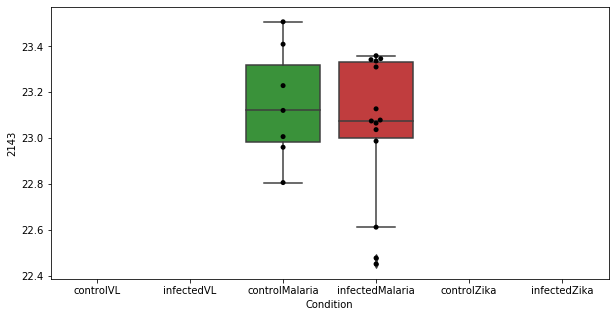

987 row m/z                130.061
row retention time     10.7163
p-val                  0.47866
adj.P.Val             0.935381
custom_id                 5496
compound_names             NaN
Name: 5496, dtype: object


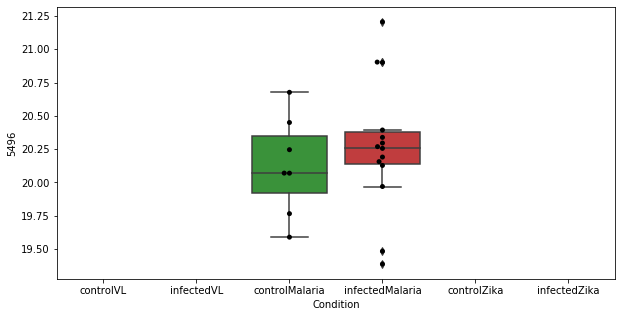

988 row m/z                329.174
row retention time     10.7915
p-val                 0.478686
adj.P.Val             0.935381
custom_id                 2381
compound_names             NaN
Name: 2381, dtype: object


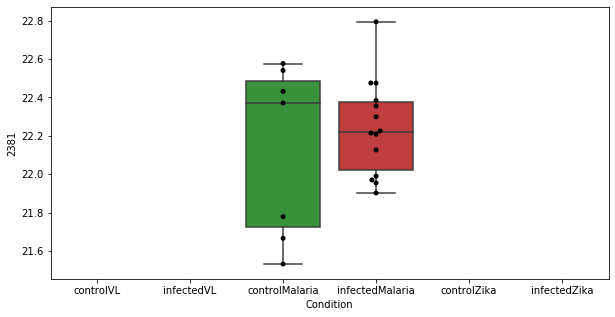

989 row m/z                198.087
row retention time     9.40618
p-val                 0.478768
adj.P.Val             0.935381
custom_id                 1415
compound_names             NaN
Name: 1415, dtype: object


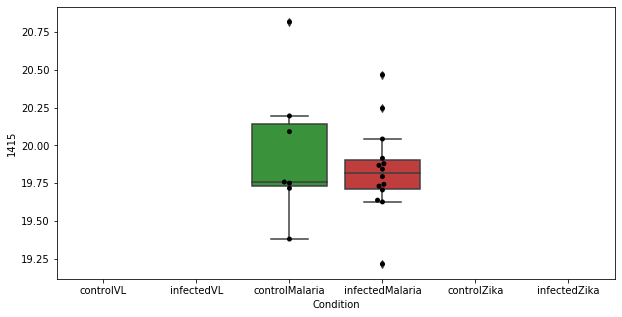

990 row m/z                                                         147.076
row retention time                                               10.461
p-val                                                          0.478885
adj.P.Val                                                      0.935381
custom_id                                                           759
compound_names        N-Formimino-L-glutamate; N-Formimidoyl-L-gluta...
Name: 759, dtype: object


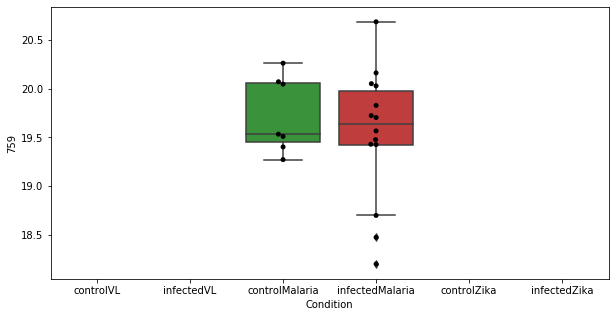

991 row m/z                                                         284.295
row retention time                                               3.6339
p-val                                                          0.478917
adj.P.Val                                                      0.935381
custom_id                                                          2165
compound_names        Sphinganine; Dihydrosphingosine; 2-Amino-1,3-d...
Name: 2165, dtype: object


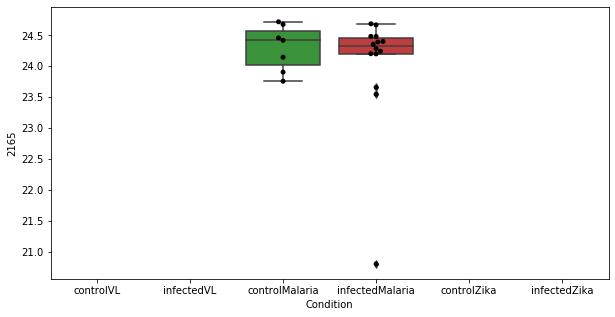

992 row m/z                             160.097
row retention time                  10.6437
p-val                              0.479483
adj.P.Val                          0.935381
custom_id                              3434
compound_names        5-Acetamidopentanoate
Name: 3434, dtype: object


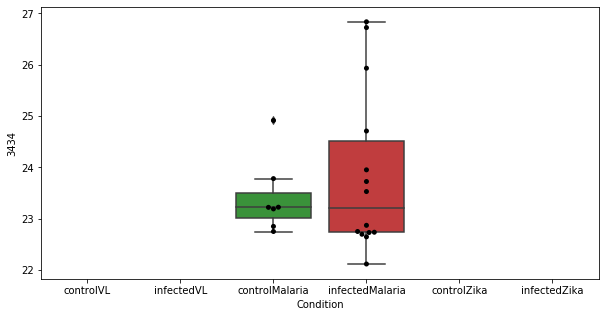

993 row m/z                235.913
row retention time     23.7769
p-val                 0.480489
adj.P.Val             0.935381
custom_id                 1777
compound_names             NaN
Name: 1777, dtype: object


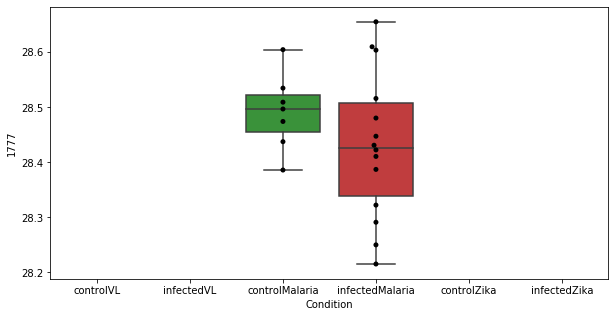

994 row m/z                             114.091
row retention time                  4.68835
p-val                              0.480606
adj.P.Val                          0.935381
custom_id                              3156
compound_names        5-Acetamidopentanoate
Name: 3156, dtype: object


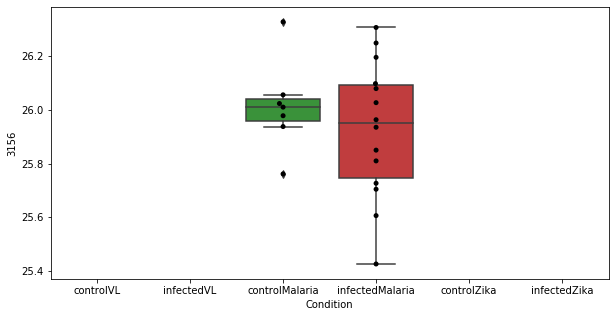

995 row m/z                                                         162.112
row retention time                                              11.1061
p-val                                                          0.480787
adj.P.Val                                                      0.935381
custom_id                                                           953
compound_names        L-Carnitine; L-gamma-Trimethyl-beta-hydroxybut...
Name: 953, dtype: object


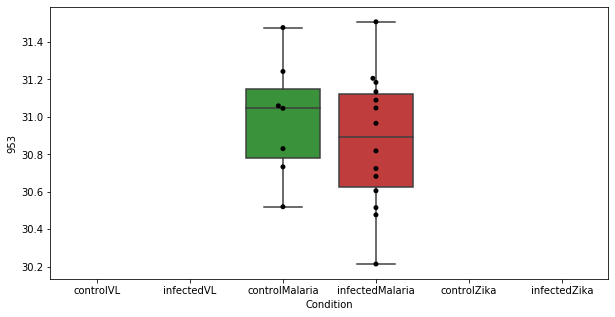

996 row m/z                71.0844
row retention time     3.39802
p-val                 0.480883
adj.P.Val             0.935381
custom_id                    6
compound_names             NaN
Name: 6, dtype: object


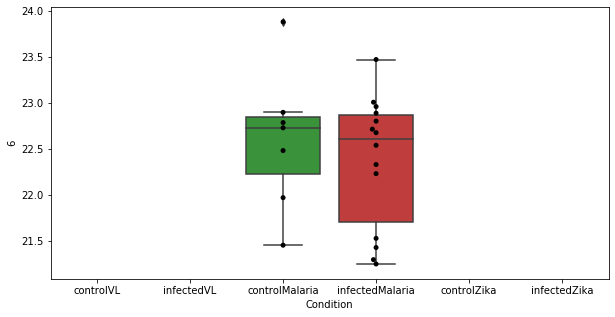

997 row m/z                836.613
row retention time     3.46679
p-val                  0.48121
adj.P.Val             0.935381
custom_id                 2968
compound_names             NaN
Name: 2968, dtype: object


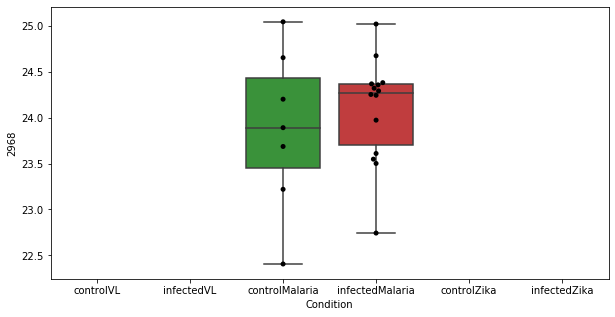

998 row m/z                 95.024
row retention time      23.887
p-val                 0.481233
adj.P.Val             0.935381
custom_id                   94
compound_names        Cytosine
Name: 94, dtype: object


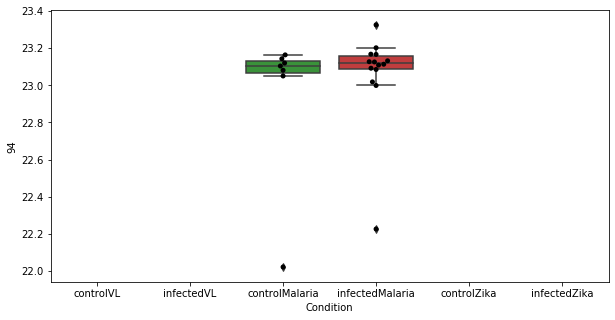

999 row m/z                415.776
row retention time     4.29513
p-val                 0.481699
adj.P.Val             0.935381
custom_id                 2550
compound_names             NaN
Name: 2550, dtype: object


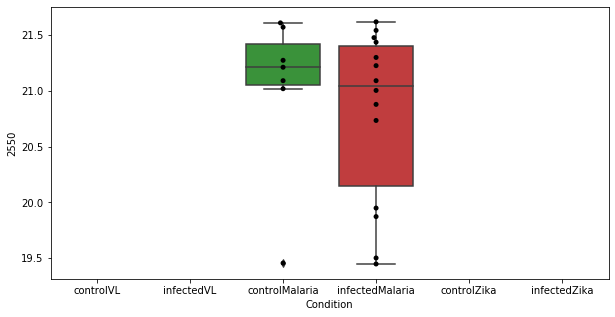

1000 row m/z                356.279
row retention time     4.35014
p-val                 0.482064
adj.P.Val             0.935381
custom_id                 2433
compound_names             NaN
Name: 2433, dtype: object


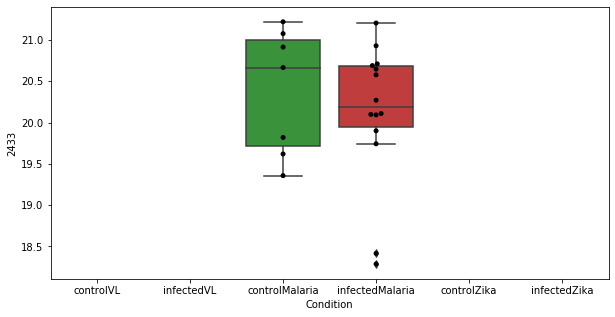

1001 row m/z                541.865
row retention time     8.46783
p-val                 0.482261
adj.P.Val             0.935381
custom_id                 2680
compound_names             NaN
Name: 2680, dtype: object


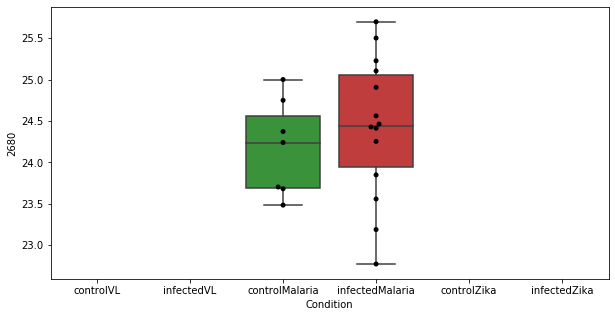

1002 row m/z                289.053
row retention time     10.3873
p-val                 0.482584
adj.P.Val             0.935381
custom_id                 2204
compound_names             NaN
Name: 2204, dtype: object


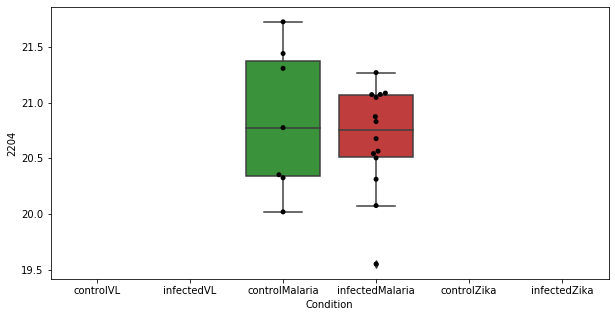

1003 row m/z                267.172
row retention time      23.345
p-val                 0.482588
adj.P.Val             0.935381
custom_id                 2015
compound_names             NaN
Name: 2015, dtype: object


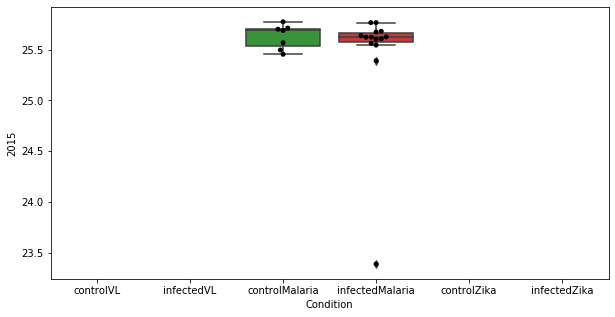

1004 row m/z                136.087
row retention time     9.52169
p-val                 0.482803
adj.P.Val             0.935381
custom_id                  606
compound_names             NaN
Name: 606, dtype: object


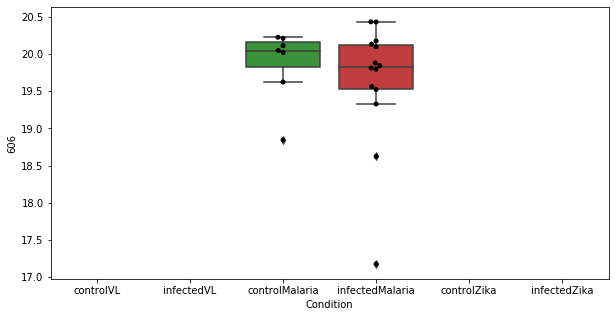

1005 row m/z                243.288
row retention time     7.01242
p-val                 0.482808
adj.P.Val             0.935381
custom_id                 3812
compound_names             NaN
Name: 3812, dtype: object


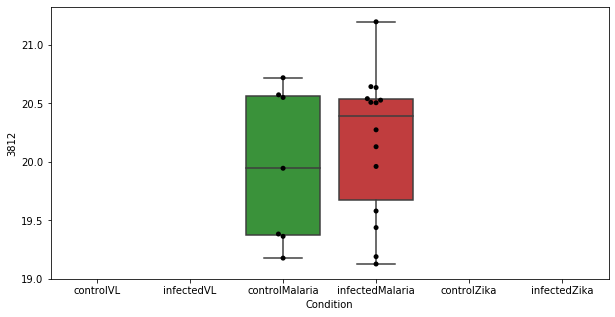

1006 row m/z                     167.107
row retention time          3.93978
p-val                      0.484205
adj.P.Val                  0.935864
custom_id                      1015
compound_names        Perillic acid
Name: 1015, dtype: object


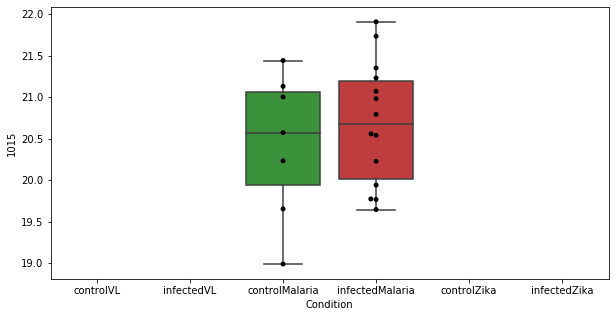

1007 row m/z                274.201
row retention time     3.74413
p-val                 0.484483
adj.P.Val             0.935864
custom_id                 2070
compound_names             NaN
Name: 2070, dtype: object


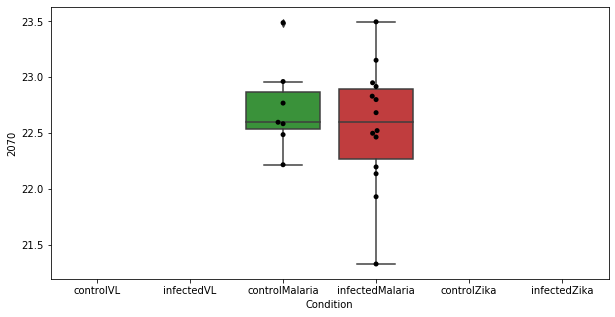

1008 row m/z                                                         209.102
row retention time                                              4.10984
p-val                                                          0.484498
adj.P.Val                                                      0.935864
custom_id                                                          1514
compound_names        Carnosine; Nalpha-(beta-alanyl)-L-histidine$(6...
Name: 1514, dtype: object


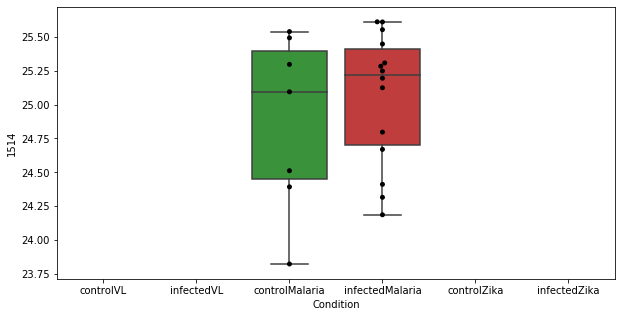

1009 row m/z                371.211
row retention time     3.97245
p-val                 0.487251
adj.P.Val             0.939543
custom_id                 4147
compound_names             NaN
Name: 4147, dtype: object


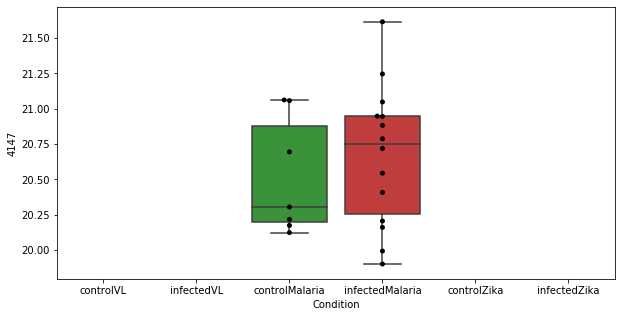

1010 row m/z                276.196
row retention time     6.72763
p-val                  0.48765
adj.P.Val             0.939543
custom_id                 2113
compound_names             NaN
Name: 2113, dtype: object


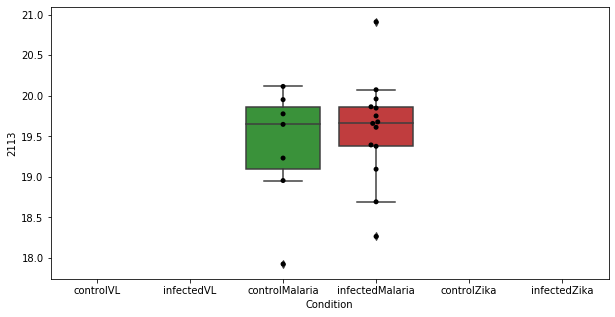

1011 row m/z                                                         112.087
row retention time                                              23.8382
p-val                                                          0.487849
adj.P.Val                                                      0.939543
custom_id                                                          3135
compound_names        L-Histidine; (S)-alpha-Amino-1H-imidazole-4-pr...
Name: 3135, dtype: object


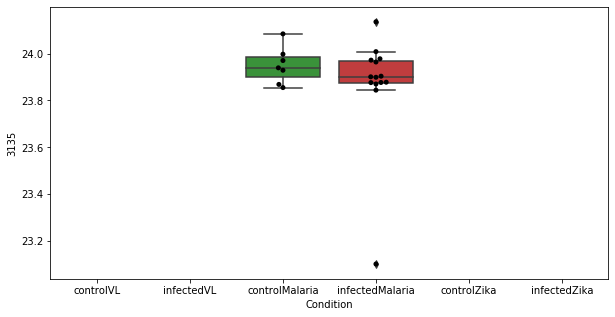

1012 row m/z                 146.06
row retention time     10.3564
p-val                 0.488536
adj.P.Val             0.939938
custom_id                  733
compound_names             NaN
Name: 733, dtype: object


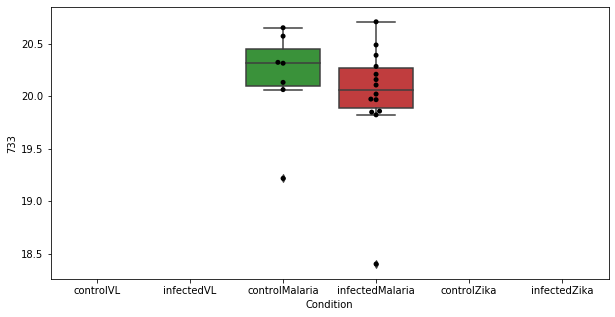

1013 row m/z                807.572
row retention time     3.48584
p-val                 0.489274
adj.P.Val             0.940286
custom_id                 2938
compound_names             NaN
Name: 2938, dtype: object


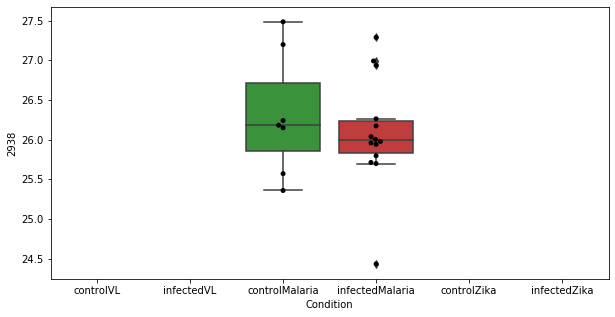

1014 row m/z                806.568
row retention time     3.50054
p-val                 0.489682
adj.P.Val             0.940286
custom_id                 2937
compound_names             NaN
Name: 2937, dtype: object


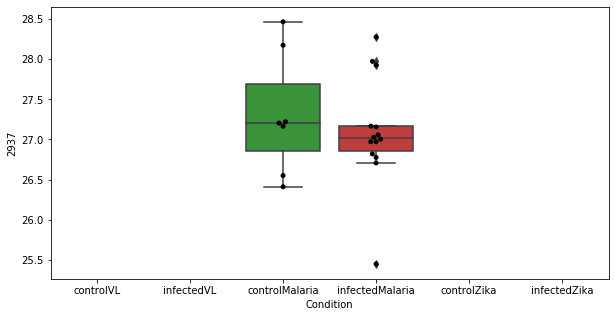

1015 row m/z                189.135
row retention time     17.5626
p-val                 0.490735
adj.P.Val             0.940559
custom_id                 1301
compound_names             NaN
Name: 1301, dtype: object


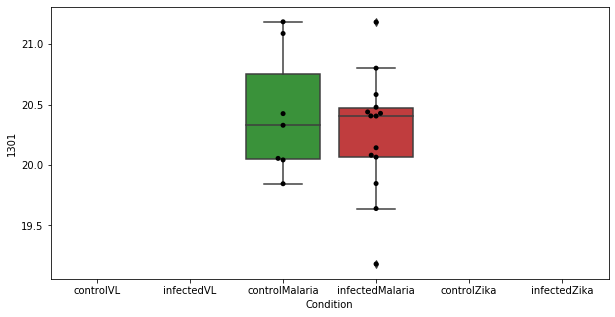

1016 row m/z                415.776
row retention time     7.04519
p-val                  0.49126
adj.P.Val             0.940559
custom_id                 2549
compound_names             NaN
Name: 2549, dtype: object


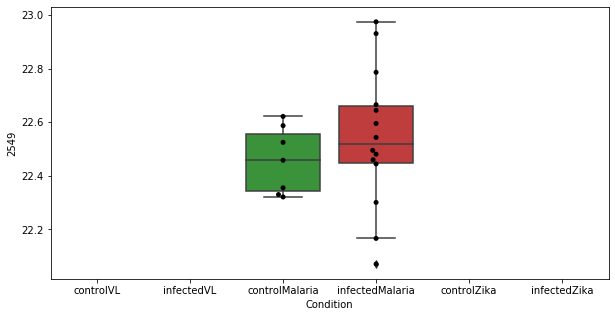

1017 row m/z                173.117
row retention time     4.41674
p-val                 0.491272
adj.P.Val             0.940559
custom_id                 1108
compound_names             NaN
Name: 1108, dtype: object


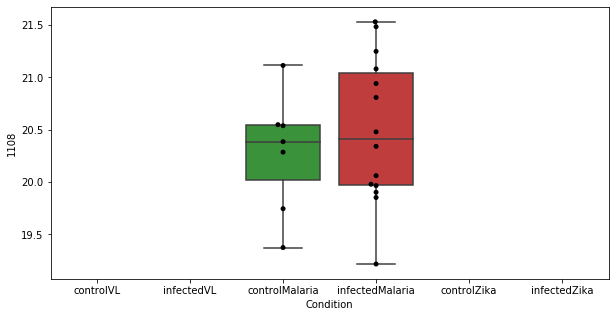

1018 row m/z                542.868
row retention time     8.45675
p-val                 0.492115
adj.P.Val             0.940829
custom_id                 2682
compound_names             NaN
Name: 2682, dtype: object


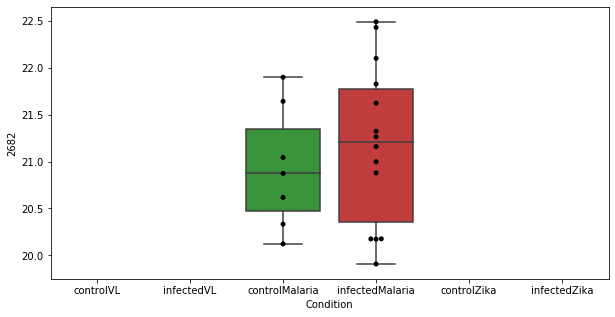

1019 row m/z                                                         120.066
row retention time                                              12.0651
p-val                                                          0.492378
adj.P.Val                                                      0.940829
custom_id                                                           371
compound_names        L-4-Hydroxyglutamate semialdehyde$D-Glutamate;...
Name: 371, dtype: object


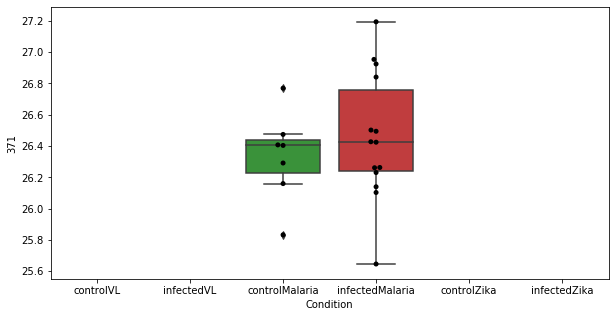

1020 row m/z                                                         132.054
row retention time                                              12.3041
p-val                                                          0.493031
adj.P.Val                                                      0.941152
custom_id                                                           544
compound_names        3-Ureidopropionate; 3-Ureidopropanoate; beta-U...
Name: 544, dtype: object


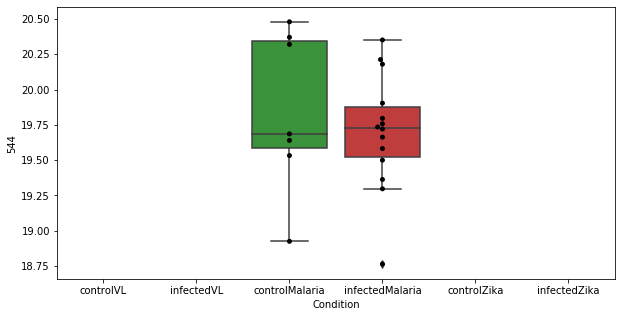

1021 row m/z                795.608
row retention time     3.50818
p-val                 0.494265
adj.P.Val             0.941679
custom_id                 2924
compound_names             NaN
Name: 2924, dtype: object


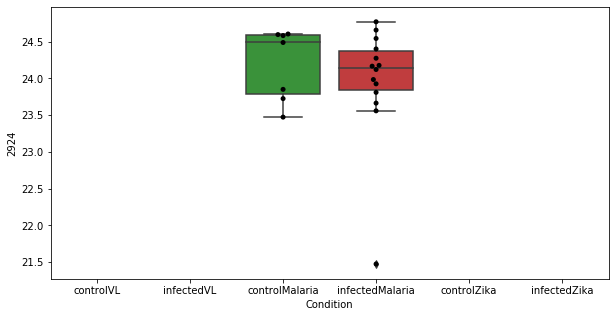

1022 row m/z                                                         120.066
row retention time                                              23.7175
p-val                                                          0.494672
adj.P.Val                                                      0.941679
custom_id                                                           374
compound_names        L-Allothreonine; L-allo-Threonine$L-Threonine;...
Name: 374, dtype: object


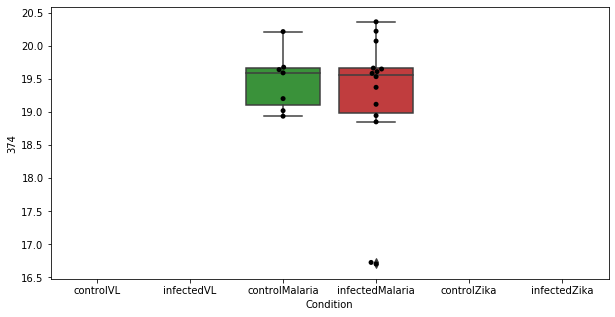

1023 row m/z                256.175
row retention time     4.58022
p-val                 0.494756
adj.P.Val             0.941679
custom_id                 1957
compound_names             NaN
Name: 1957, dtype: object


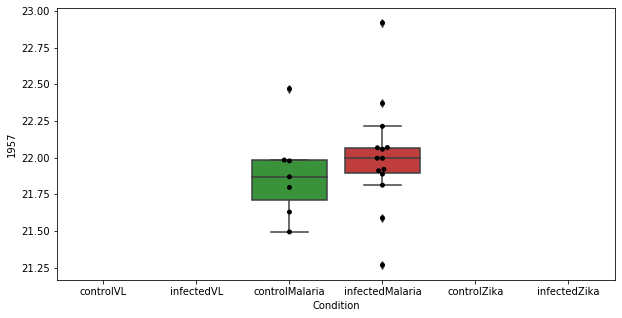

1024 row m/z                161.967
row retention time     12.5406
p-val                 0.495325
adj.P.Val             0.941843
custom_id                  943
compound_names             NaN
Name: 943, dtype: object


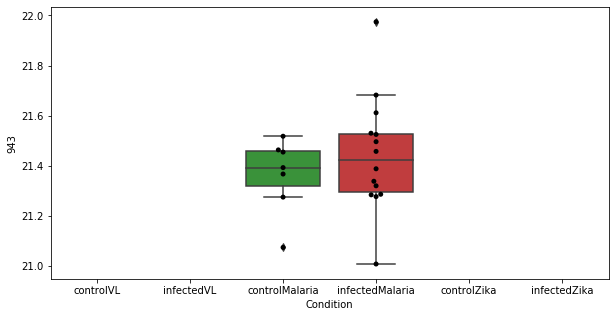

1025 row m/z                                                         154.069
row retention time                                              7.06009
p-val                                                          0.496287
adj.P.Val                                                      0.942032
custom_id                                                           853
compound_names        N1-Methyl-2-pyridone-5-carboxamide; N'-Methyl-...
Name: 853, dtype: object


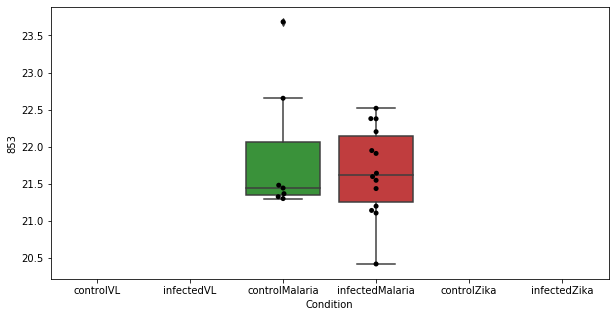

1026 row m/z                782.569
row retention time     3.50642
p-val                  0.49734
adj.P.Val             0.942032
custom_id                 2899
compound_names             NaN
Name: 2899, dtype: object


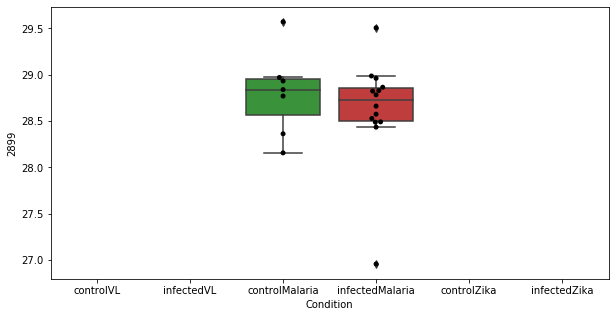

1027 row m/z                  834.6
row retention time     3.46231
p-val                 0.497397
adj.P.Val             0.942032
custom_id                 2965
compound_names             NaN
Name: 2965, dtype: object


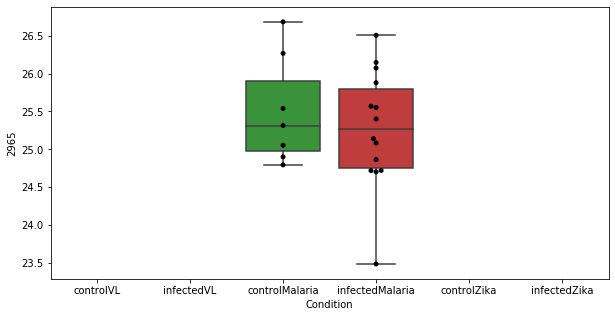

1028 row m/z                174.132
row retention time     9.93703
p-val                  0.49798
adj.P.Val             0.942032
custom_id                 4768
compound_names             NaN
Name: 4768, dtype: object


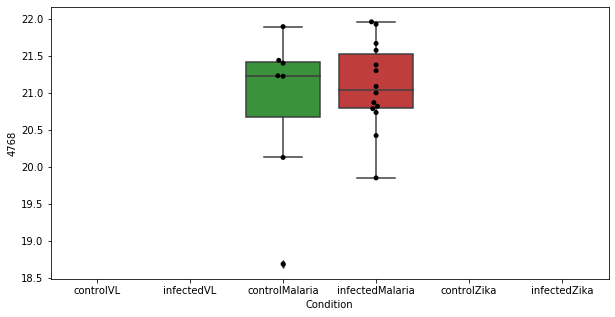

1029 row m/z                173.129
row retention time     4.59683
p-val                 0.498392
adj.P.Val             0.942032
custom_id                 1111
compound_names             NaN
Name: 1111, dtype: object


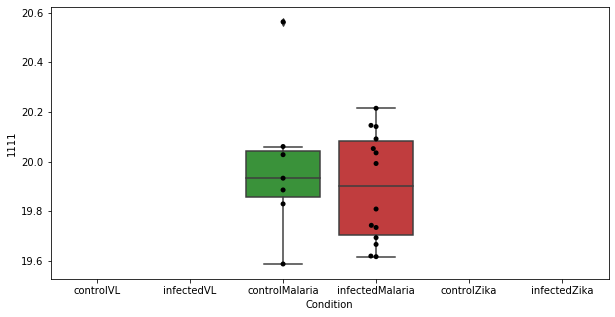

1030 row m/z                244.191
row retention time     6.79117
p-val                 0.498586
adj.P.Val             0.942032
custom_id                 1866
compound_names             NaN
Name: 1866, dtype: object


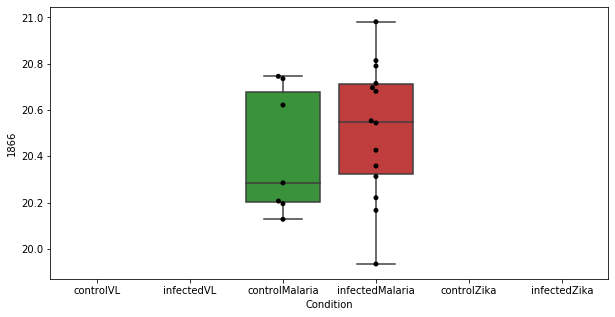

1031 row m/z                     185.117
row retention time          4.58022
p-val                      0.498882
adj.P.Val                  0.942032
custom_id                      1244
compound_names        Perillic acid
Name: 1244, dtype: object


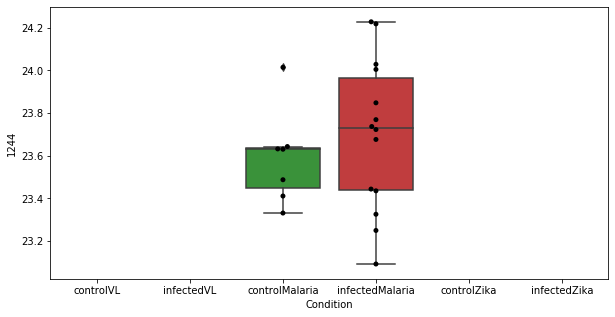

1032 row m/z                168.123
row retention time     6.97585
p-val                 0.499291
adj.P.Val             0.942032
custom_id                 1036
compound_names             NaN
Name: 1036, dtype: object


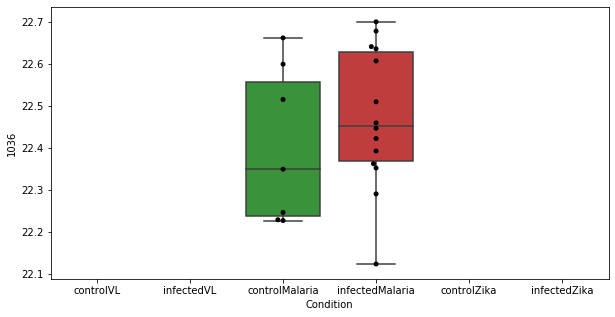

1033 row m/z                799.667
row retention time     6.69722
p-val                 0.499942
adj.P.Val             0.942169
custom_id                 4293
compound_names             NaN
Name: 4293, dtype: object


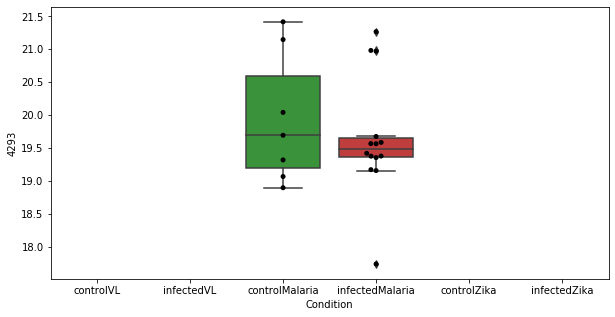

1034 row m/z                233.158
row retention time     7.93531
p-val                 0.500331
adj.P.Val             0.942169
custom_id                 3769
compound_names             NaN
Name: 3769, dtype: object


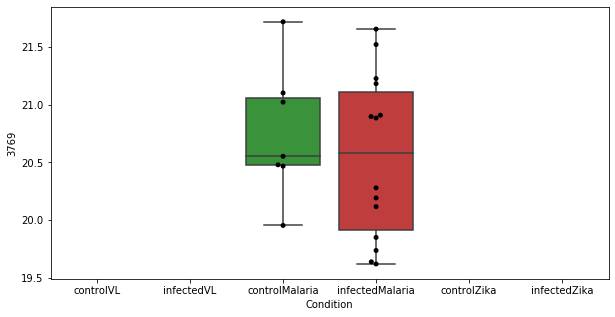

1035 row m/z                248.999
row retention time     12.3548
p-val                 0.501468
adj.P.Val             0.942481
custom_id                 3836
compound_names             NaN
Name: 3836, dtype: object


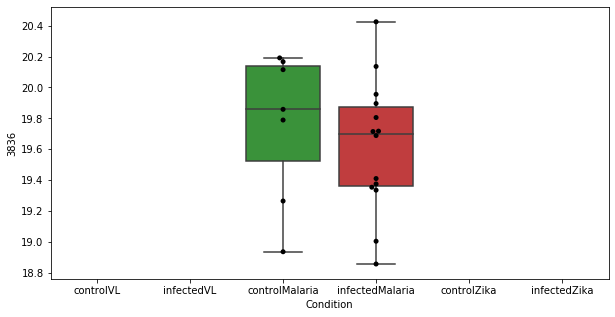

1036 row m/z                575.466
row retention time     3.24521
p-val                 0.501651
adj.P.Val             0.942481
custom_id                 2724
compound_names             NaN
Name: 2724, dtype: object


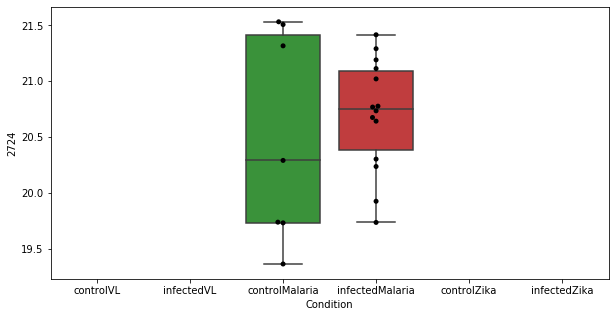

1037 row m/z                                                           86.06
row retention time                                              23.8097
p-val                                                           0.50207
adj.P.Val                                                      0.942481
custom_id                                                            63
compound_names        N,N-Dimethylglycine; Dimethylglycine$(R)-3-Ami...
Name: 63, dtype: object


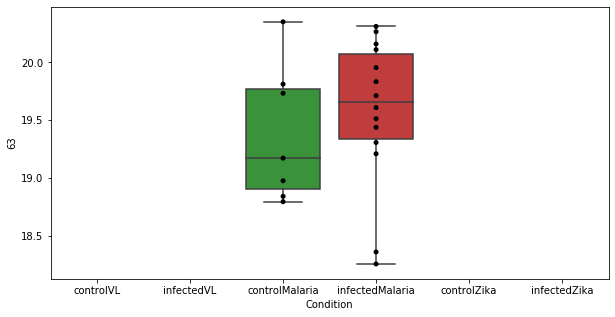

1038 row m/z                                                       129.102
row retention time                                            10.4627
p-val                                                        0.502431
adj.P.Val                                                    0.942481
custom_id                                                         494
compound_names        L-Lysine; Lysine acid; 2,6-Diaminohexanoic acid
Name: 494, dtype: object


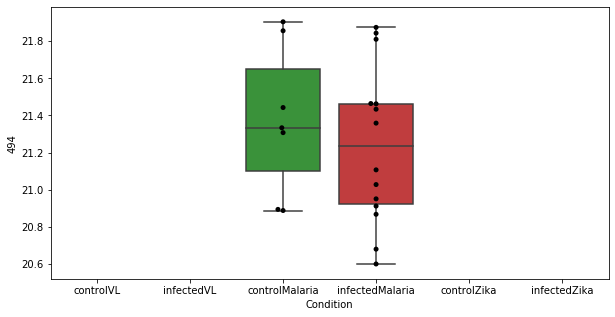

1039 row m/z                 270.17
row retention time     3.78679
p-val                 0.503533
adj.P.Val             0.942713
custom_id                 2054
compound_names             NaN
Name: 2054, dtype: object


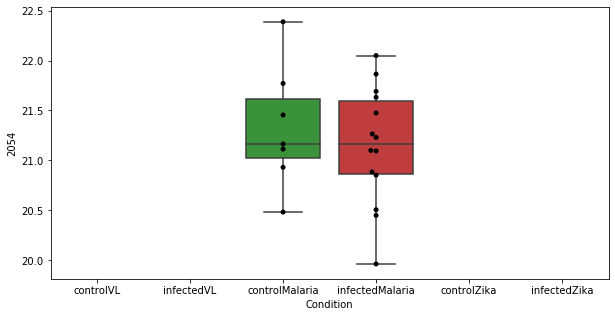

1040 row m/z                164.116
row retention time     11.1051
p-val                 0.503805
adj.P.Val             0.942713
custom_id                  978
compound_names             NaN
Name: 978, dtype: object


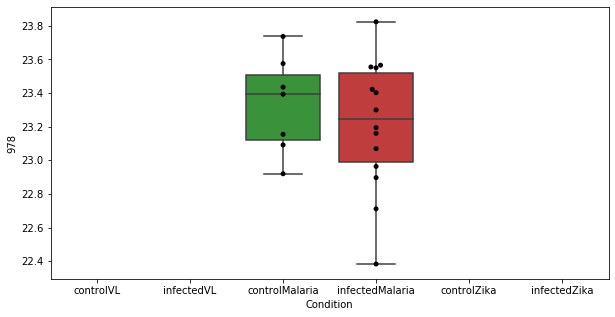

1041 row m/z                215.094
row retention time     22.1495
p-val                 0.504844
adj.P.Val             0.942713
custom_id                 4933
compound_names             NaN
Name: 4933, dtype: object


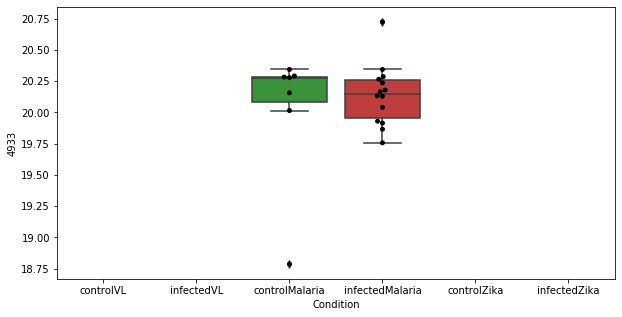

1042 row m/z                                       328.248
row retention time                            4.54645
p-val                                         0.50578
adj.P.Val                                    0.942713
custom_id                                        4087
compound_names        2,6 dimethylheptanoyl carnitine
Name: 4087, dtype: object


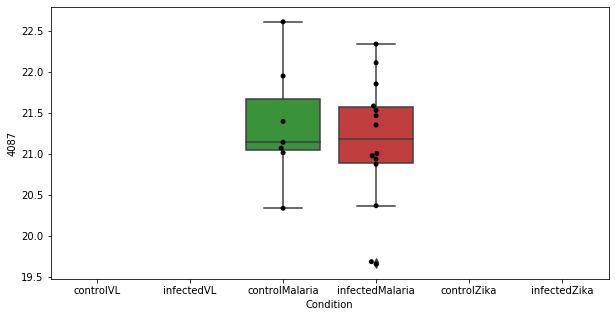

1043 row m/z                812.614
row retention time     3.48484
p-val                 0.506063
adj.P.Val             0.942713
custom_id                 2947
compound_names             NaN
Name: 2947, dtype: object


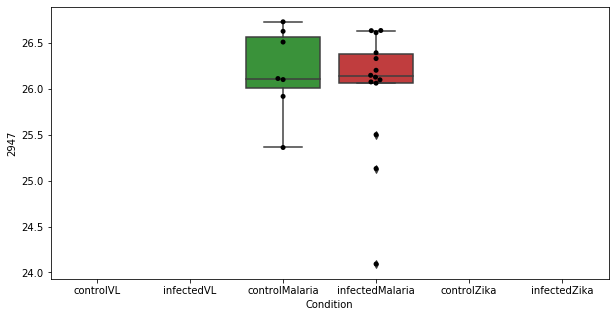

1044 row m/z                415.776
row retention time     23.7961
p-val                 0.507684
adj.P.Val             0.942713
custom_id                 6981
compound_names             NaN
Name: 6981, dtype: object


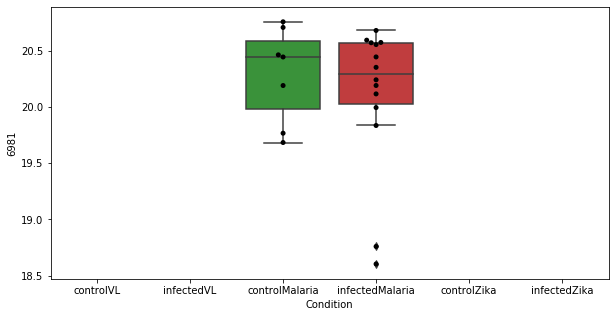

1045 row m/z                                                         176.122
row retention time                                              19.1377
p-val                                                          0.507981
adj.P.Val                                                      0.942713
custom_id                                                          1146
compound_names        D-Arginine; D-2-Amino-5-guanidinovaleric acid$...
Name: 1146, dtype: object


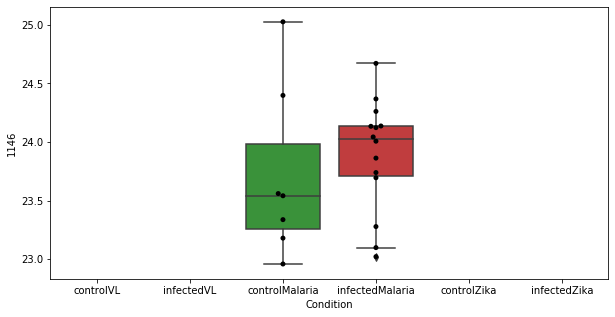

1046 row m/z                757.621
row retention time     3.69314
p-val                 0.508724
adj.P.Val             0.942713
custom_id                 2865
compound_names             NaN
Name: 2865, dtype: object


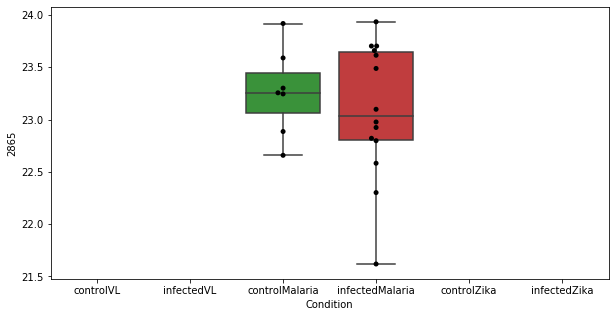

1047 row m/z                                                175.108
row retention time                                     11.1953
p-val                                                  0.50895
adj.P.Val                                             0.942713
custom_id                                                 1132
compound_names        N-Acetylornithine; N2-Acetyl-L-ornithine
Name: 1132, dtype: object


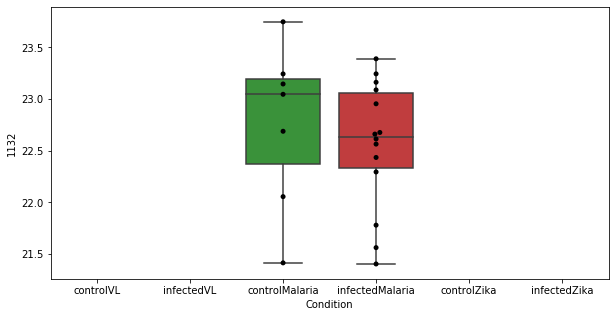

1048 row m/z                109.101
row retention time     4.39037
p-val                 0.509509
adj.P.Val             0.942713
custom_id                  218
compound_names             NaN
Name: 218, dtype: object


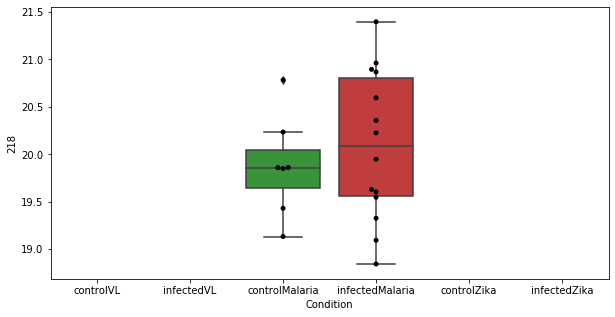

1049 row m/z                141.091
row retention time     3.88277
p-val                  0.50969
adj.P.Val             0.942713
custom_id                  656
compound_names             NaN
Name: 656, dtype: object


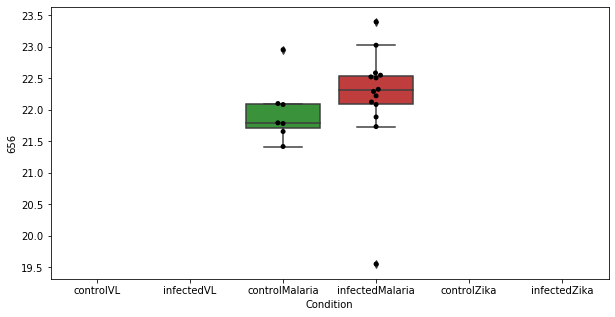

1050 row m/z                                 151.062
row retention time                      7.04364
p-val                                  0.510033
adj.P.Val                              0.942713
custom_id                                   823
compound_names        aminochrome o-semiquinone
Name: 823, dtype: object


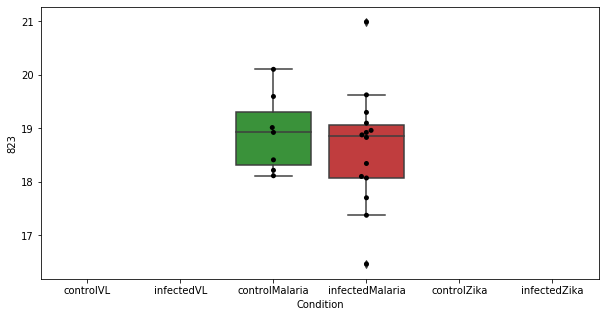

1051 row m/z                539.868
row retention time     8.47096
p-val                 0.510197
adj.P.Val             0.942713
custom_id                 2678
compound_names             NaN
Name: 2678, dtype: object


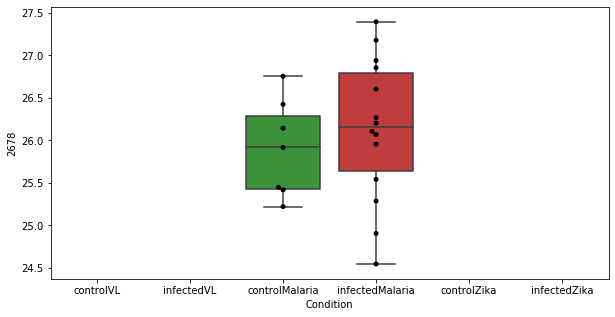

1052 row m/z                                                         79.0291
row retention time                                              23.8661
p-val                                                           0.51055
adj.P.Val                                                      0.942713
custom_id                                                            27
compound_names        5,6-Dihydrouracil; 2,4(1H,3H)-Pyrimidinedione,...
Name: 27, dtype: object


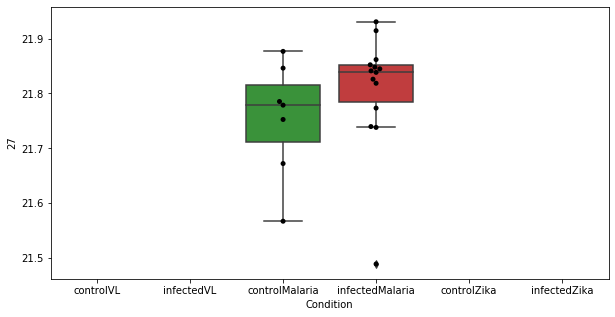

1053 row m/z                554.393
row retention time     4.62816
p-val                  0.51062
adj.P.Val             0.942713
custom_id                 2702
compound_names             NaN
Name: 2702, dtype: object


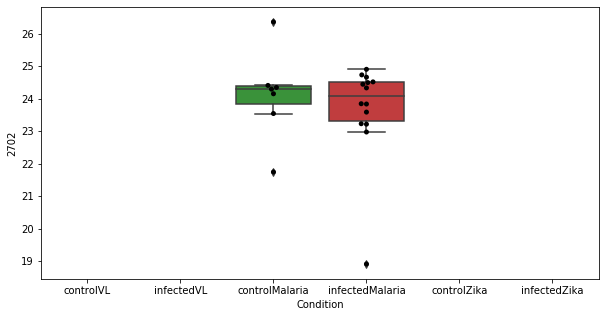

1054 row m/z                213.123
row retention time     8.50149
p-val                 0.510736
adj.P.Val             0.942713
custom_id                 1567
compound_names             NaN
Name: 1567, dtype: object


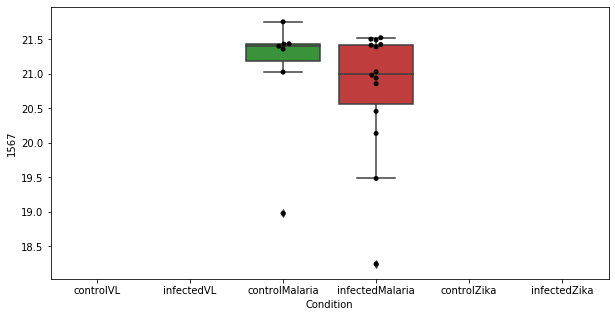

1055 row m/z                217.107
row retention time     3.97852
p-val                 0.511207
adj.P.Val             0.942713
custom_id                 1610
compound_names             NaN
Name: 1610, dtype: object


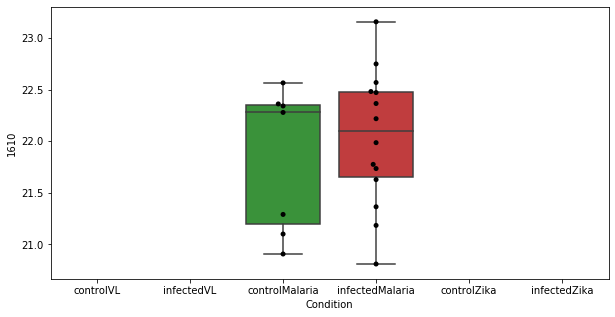

1056 row m/z                                                         175.119
row retention time                                              19.1313
p-val                                                          0.511261
adj.P.Val                                                      0.942713
custom_id                                                          1135
compound_names        D-Arginine; D-2-Amino-5-guanidinovaleric acid$...
Name: 1135, dtype: object


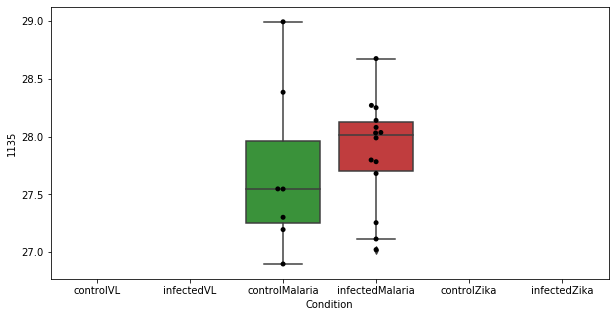

1057 row m/z                358.918
row retention time     12.9345
p-val                 0.512131
adj.P.Val             0.943425
custom_id                 4126
compound_names             NaN
Name: 4126, dtype: object


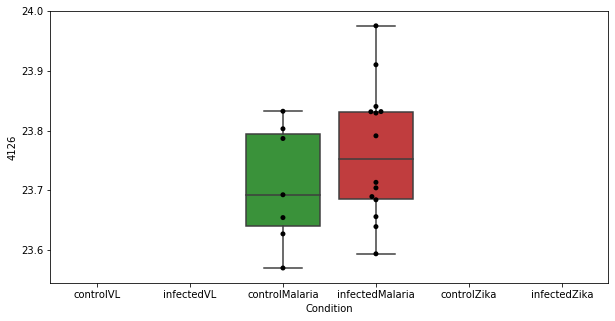

1058 row m/z                208.163
row retention time     9.52875
p-val                 0.513858
adj.P.Val             0.945122
custom_id                 1503
compound_names             NaN
Name: 1503, dtype: object


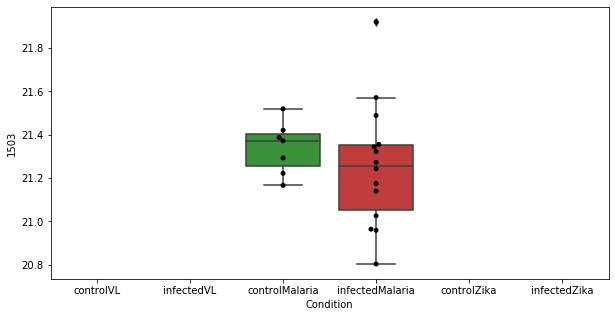

1059 row m/z                                                         249.061
row retention time                                              10.3793
p-val                                                          0.514705
adj.P.Val                                                      0.945122
custom_id                                                          1893
compound_names        Pyridoxamine phosphate; Pyridoxamine 5-phospha...
Name: 1893, dtype: object


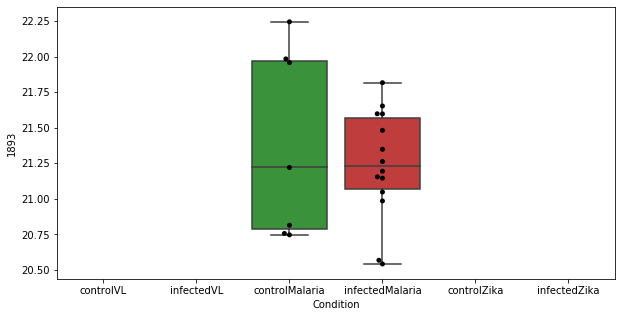

1060 row m/z                70.1833
row retention time     9.02165
p-val                  0.51483
adj.P.Val             0.945122
custom_id                    4
compound_names             NaN
Name: 4, dtype: object


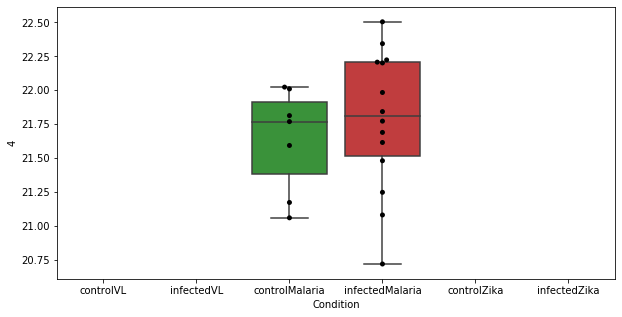

1061 row m/z                144.936
row retention time     23.6125
p-val                 0.514992
adj.P.Val             0.945122
custom_id                  708
compound_names             NaN
Name: 708, dtype: object


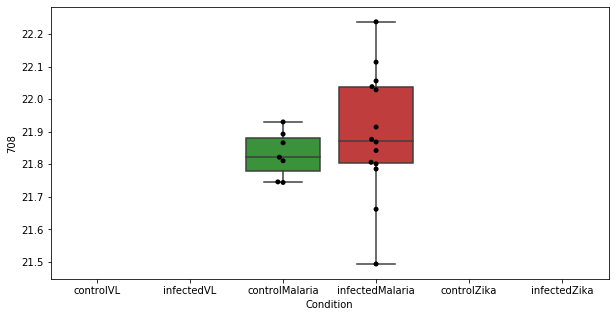

1062 row m/z                 210.17
row retention time      23.684
p-val                 0.515805
adj.P.Val             0.945232
custom_id                 1525
compound_names             NaN
Name: 1525, dtype: object


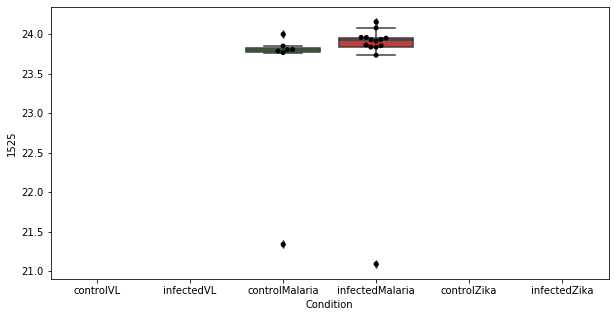

1063 row m/z                107.967
row retention time     10.5607
p-val                  0.51636
adj.P.Val             0.945232
custom_id                  212
compound_names             NaN
Name: 212, dtype: object


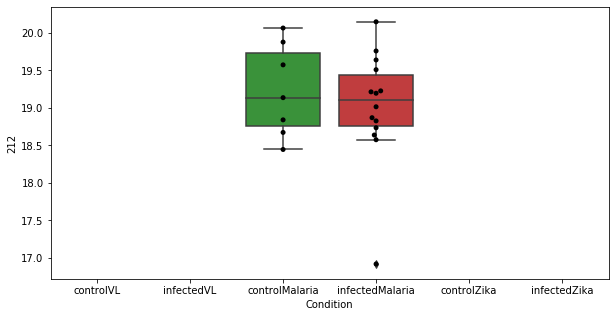

1064 row m/z                236.073
row retention time     12.2667
p-val                 0.516921
adj.P.Val             0.945232
custom_id                 1778
compound_names             NaN
Name: 1778, dtype: object


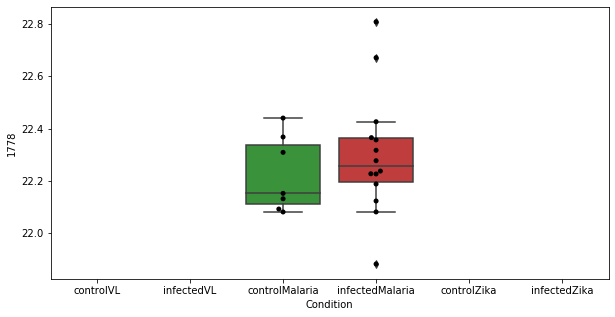

1065 row m/z                368.279
row retention time     4.30053
p-val                 0.517041
adj.P.Val             0.945232
custom_id                 4140
compound_names             NaN
Name: 4140, dtype: object


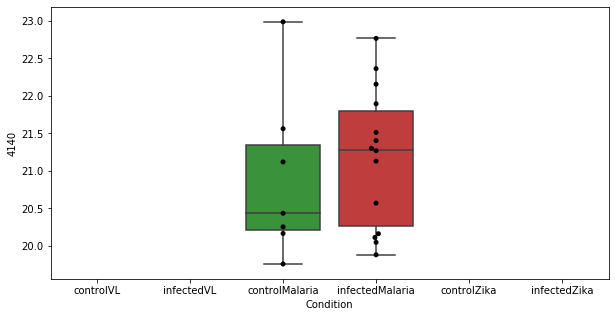

1066 row m/z                171.102
row retention time     3.92759
p-val                 0.517477
adj.P.Val             0.945232
custom_id                 1079
compound_names             NaN
Name: 1079, dtype: object


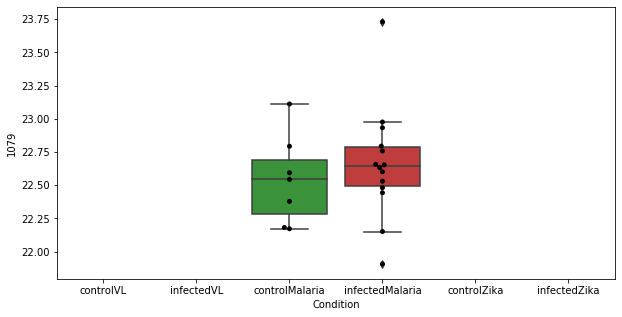

1067 row m/z                236.073
row retention time     23.7271
p-val                 0.518116
adj.P.Val             0.945513
custom_id                 1780
compound_names             NaN
Name: 1780, dtype: object


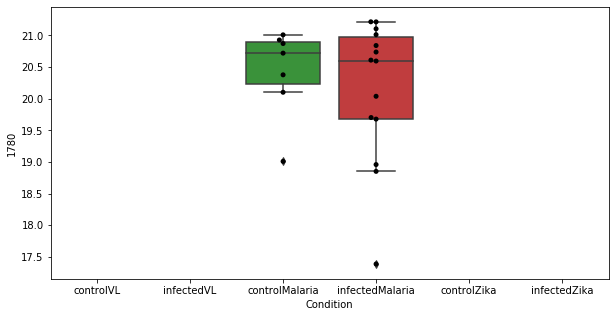

1068 row m/z                564.429
row retention time     3.34122
p-val                 0.519646
adj.P.Val             0.946766
custom_id                 2709
compound_names             NaN
Name: 2709, dtype: object


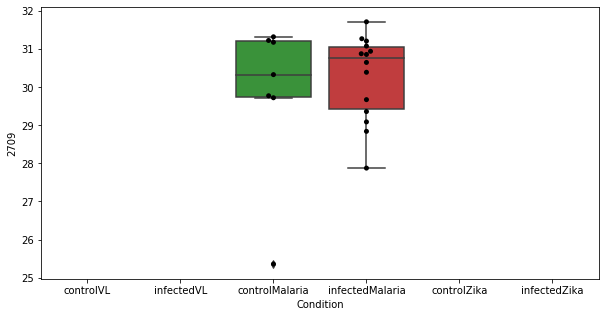

1069 row m/z                183.113
row retention time     4.75182
p-val                 0.519774
adj.P.Val             0.946766
custom_id                 1222
compound_names             NaN
Name: 1222, dtype: object


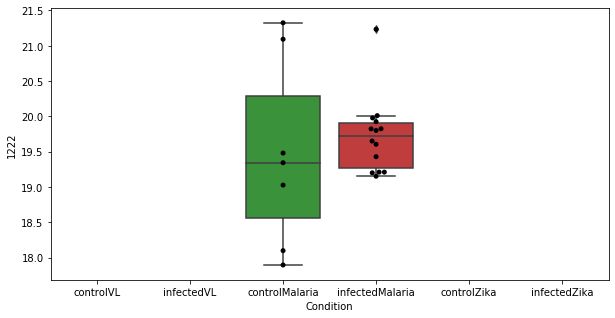

1070 row m/z                521.343
row retention time     4.06241
p-val                 0.520513
adj.P.Val              0.94691
custom_id                 2645
compound_names             NaN
Name: 2645, dtype: object


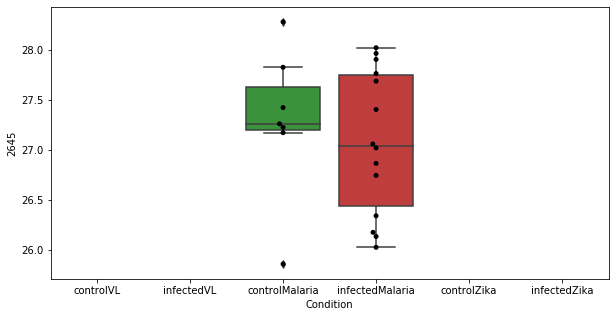

1071 row m/z                163.033
row retention time     2.31584
p-val                 0.520854
adj.P.Val              0.94691
custom_id                  964
compound_names             NaN
Name: 964, dtype: object


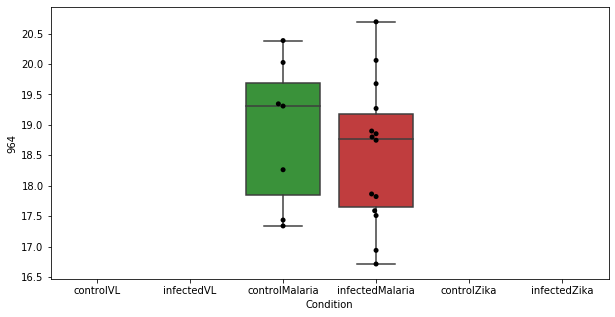

1072 row m/z                797.623
row retention time     3.48093
p-val                 0.521818
adj.P.Val              0.94691
custom_id                 2927
compound_names             NaN
Name: 2927, dtype: object


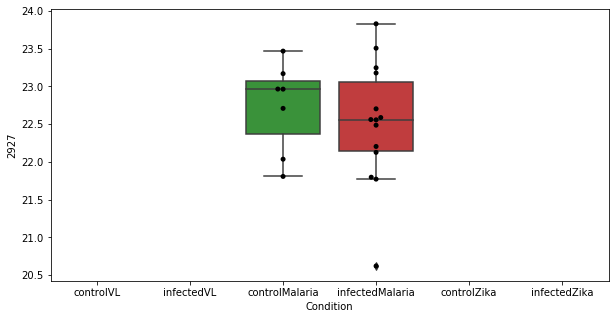

1073 row m/z                       102.091
row retention time            23.8294
p-val                        0.522009
adj.P.Val                     0.94691
custom_id                         150
compound_names        5-Aminopentanal
Name: 150, dtype: object


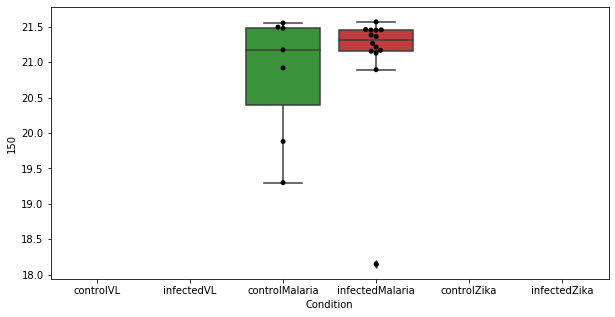

1074 row m/z                147.998
row retention time     12.8786
p-val                 0.522282
adj.P.Val              0.94691
custom_id                  771
compound_names             NaN
Name: 771, dtype: object


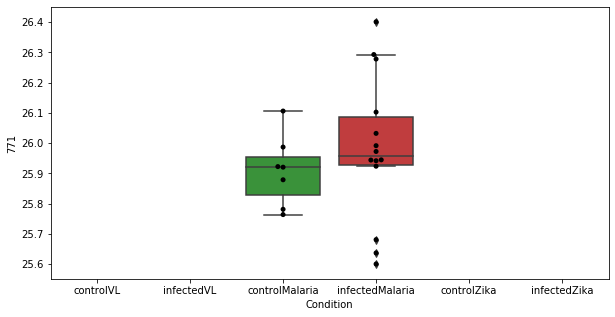

1075 row m/z                152.038
row retention time     10.6264
p-val                 0.524015
adj.P.Val             0.947154
custom_id                 5625
compound_names             NaN
Name: 5625, dtype: object


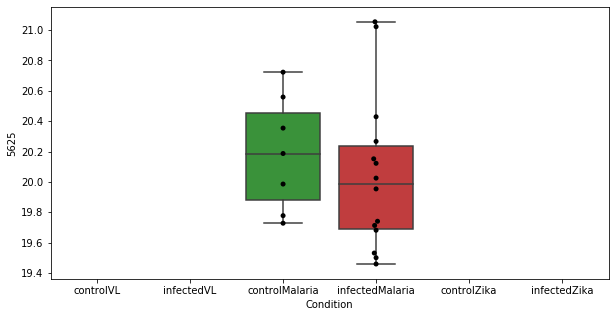

1076 row m/z                164.119
row retention time     11.0984
p-val                 0.524143
adj.P.Val             0.947154
custom_id                  979
compound_names             NaN
Name: 979, dtype: object


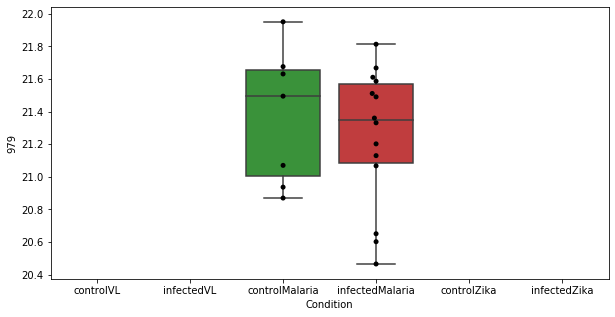

1077 row m/z                                                         88.0757
row retention time                                               4.0539
p-val                                                          0.525423
adj.P.Val                                                      0.947154
custom_id                                                            76
compound_names        4-Aminobutanal; 4-Aminobutyraldehyde; Butyrald...
Name: 76, dtype: object


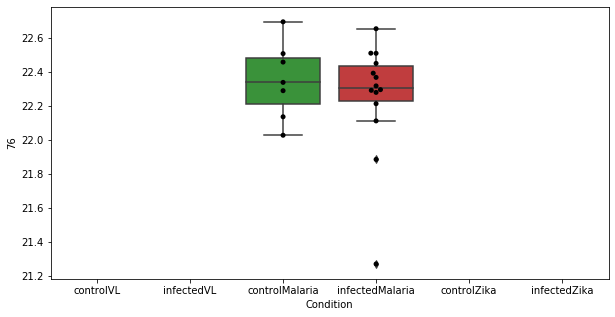

1078 row m/z                240.142
row retention time     3.10448
p-val                 0.525428
adj.P.Val             0.947154
custom_id                 1831
compound_names             NaN
Name: 1831, dtype: object


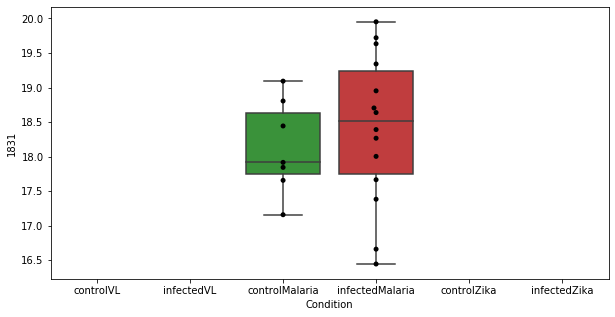

1079 row m/z                431.178
row retention time     3.60573
p-val                 0.525951
adj.P.Val             0.947154
custom_id                 2566
compound_names             NaN
Name: 2566, dtype: object


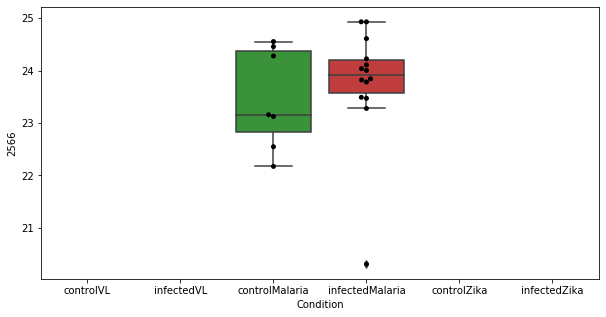

1080 row m/z                567.899
row retention time     8.46385
p-val                 0.526137
adj.P.Val             0.947154
custom_id                 2713
compound_names             NaN
Name: 2713, dtype: object


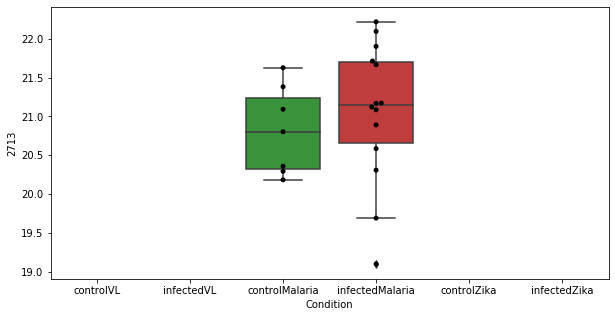

1081 row m/z                                                         130.086
row retention time                                              17.7708
p-val                                                          0.526141
adj.P.Val                                                      0.947154
custom_id                                                           518
compound_names        N4-Acetylaminobutanal$L-Pipecolate; Pipecolini...
Name: 518, dtype: object


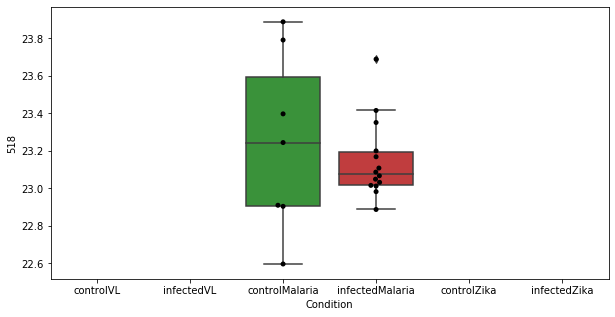

1082 row m/z                744.553
row retention time     3.51068
p-val                 0.526388
adj.P.Val             0.947154
custom_id                 2851
compound_names             NaN
Name: 2851, dtype: object


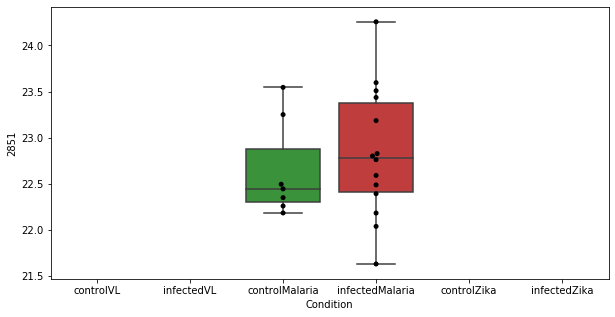

1083 row m/z                                                         120.056
row retention time                                              23.7744
p-val                                                          0.527798
adj.P.Val                                                      0.947154
custom_id                                                          3184
compound_names        L-Histidine; (S)-alpha-Amino-1H-imidazole-4-pr...
Name: 3184, dtype: object


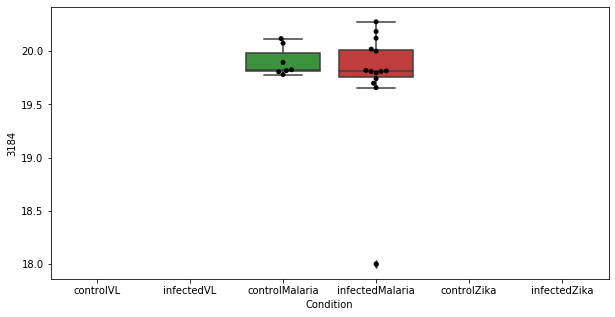

1084 row m/z                 688.86
row retention time     9.30432
p-val                 0.528571
adj.P.Val             0.947154
custom_id                 2814
compound_names             NaN
Name: 2814, dtype: object


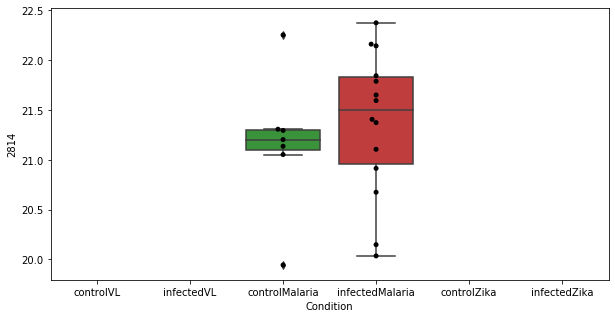

1085 row m/z                633.808
row retention time     9.02268
p-val                 0.528867
adj.P.Val             0.947154
custom_id                 2773
compound_names             NaN
Name: 2773, dtype: object


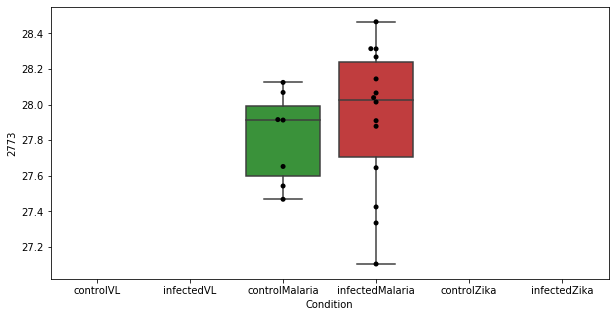

1086 row m/z                                                          106.05
row retention time                                              12.8847
p-val                                                          0.529821
adj.P.Val                                                      0.947154
custom_id                                                           204
compound_names        L-Serine; L-2-Amino-3-hydroxypropionic acid; L...
Name: 204, dtype: object


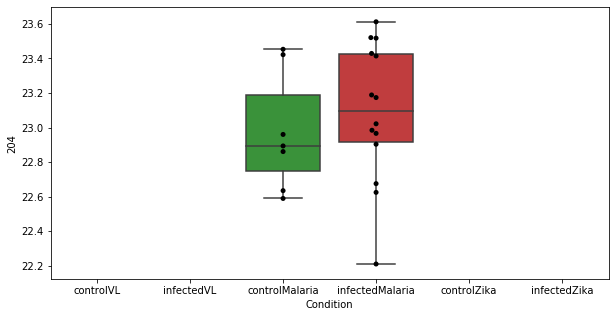

1087 row m/z                159.113
row retention time     1.96575
p-val                   0.5301
adj.P.Val             0.947154
custom_id                  920
compound_names             NaN
Name: 920, dtype: object


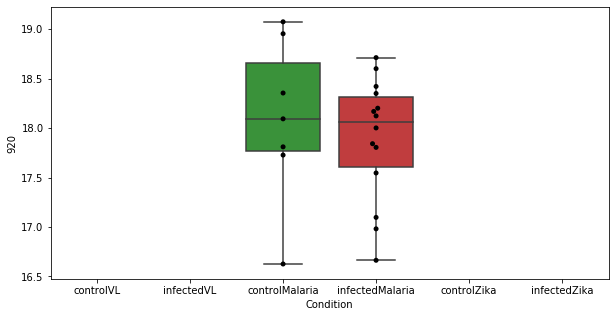

1088 row m/z                 520.34
row retention time     4.06628
p-val                 0.531058
adj.P.Val             0.947154
custom_id                 2643
compound_names             NaN
Name: 2643, dtype: object


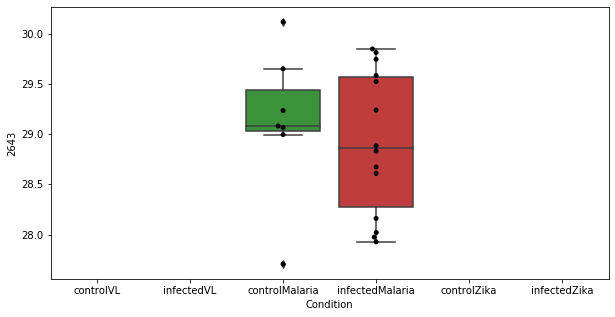

1089 row m/z                231.134
row retention time      4.7287
p-val                 0.531196
adj.P.Val             0.947154
custom_id                 1731
compound_names             NaN
Name: 1731, dtype: object


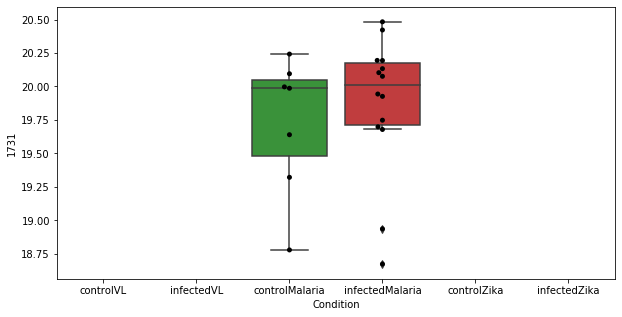

1090 row m/z                                                         113.071
row retention time                                              9.49785
p-val                                                          0.532322
adj.P.Val                                                      0.947154
custom_id                                                           262
compound_names        Methylimidazoleacetic acid; Tele-methylimidazo...
Name: 262, dtype: object


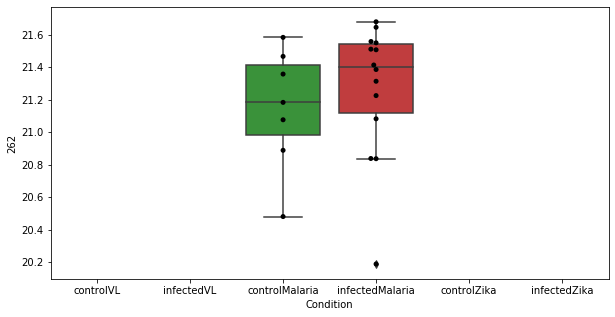

1091 row m/z                252.928
row retention time     11.9925
p-val                 0.532804
adj.P.Val             0.947154
custom_id                 1933
compound_names             NaN
Name: 1933, dtype: object


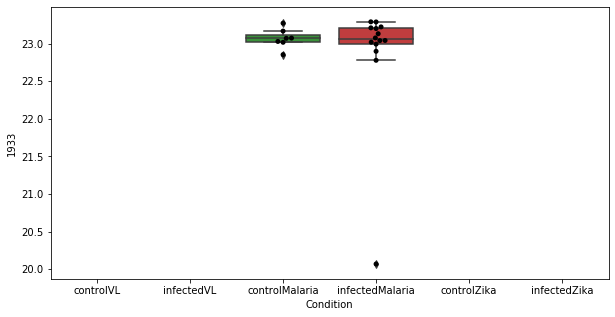

1092 row m/z                            129.066
row retention time                 12.1725
p-val                              0.53298
adj.P.Val                         0.947154
custom_id                              488
compound_names        4-Guanidinobutanoate
Name: 488, dtype: object


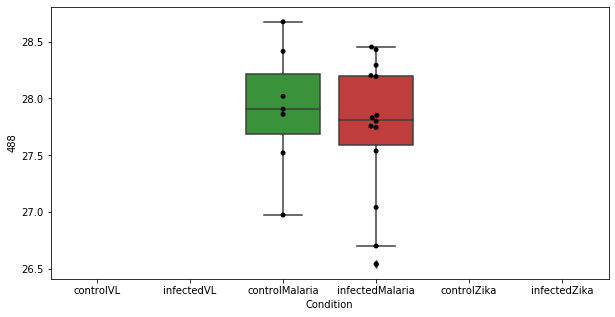

1093 row m/z                117.102
row retention time     9.67005
p-val                 0.533391
adj.P.Val             0.947154
custom_id                  338
compound_names             NaN
Name: 338, dtype: object


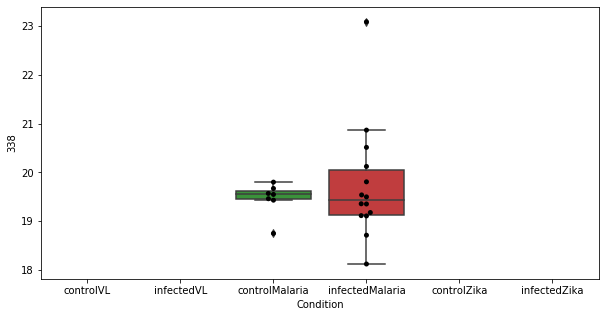

1094 row m/z                677.785
row retention time     9.23884
p-val                 0.534192
adj.P.Val             0.947154
custom_id                 2804
compound_names             NaN
Name: 2804, dtype: object


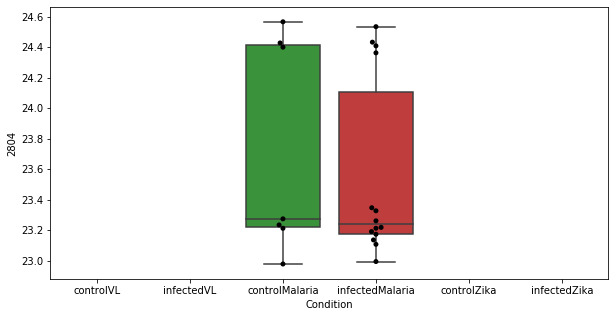

1095 row m/z                143.107
row retention time     4.58138
p-val                 0.534754
adj.P.Val             0.947154
custom_id                  683
compound_names             NaN
Name: 683, dtype: object


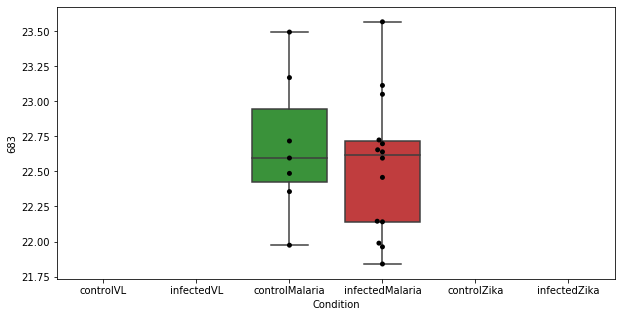

1096 row m/z                 258.17
row retention time     7.02172
p-val                 0.534833
adj.P.Val             0.947154
custom_id                 1973
compound_names             NaN
Name: 1973, dtype: object


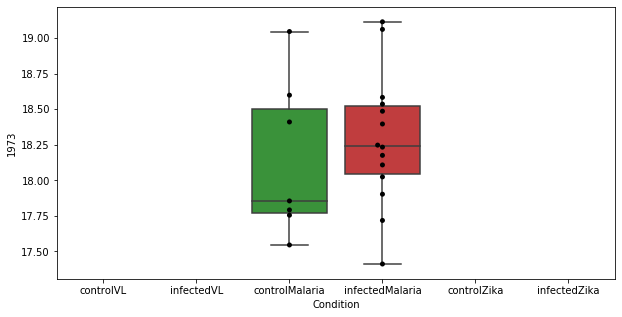

1097 row m/z                 169.98
row retention time     23.9194
p-val                 0.535156
adj.P.Val             0.947154
custom_id                 1051
compound_names             NaN
Name: 1051, dtype: object


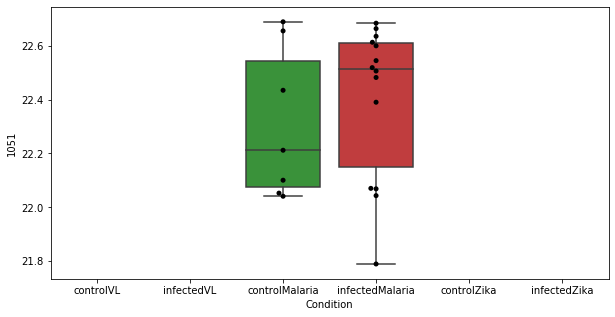

1098 row m/z                808.584
row retention time     3.49389
p-val                 0.535332
adj.P.Val             0.947154
custom_id                 2941
compound_names             NaN
Name: 2941, dtype: object


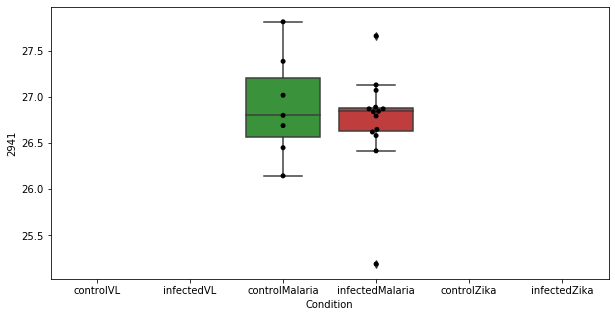

1099 row m/z                191.077
row retention time     17.7666
p-val                 0.535475
adj.P.Val             0.947154
custom_id                 1324
compound_names             NaN
Name: 1324, dtype: object


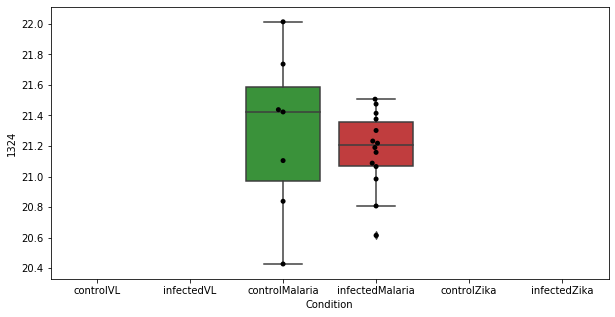

1100 row m/z                230.096
row retention time     12.4636
p-val                 0.535794
adj.P.Val             0.947154
custom_id                 1720
compound_names             NaN
Name: 1720, dtype: object


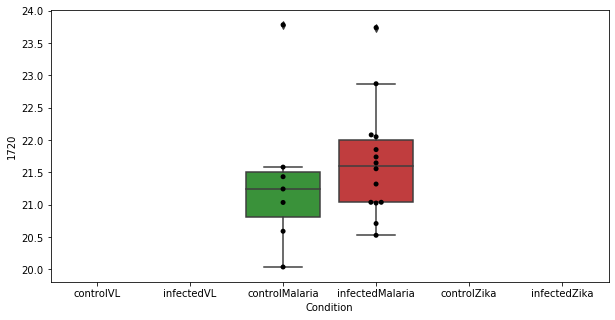

1101 row m/z                268.175
row retention time      23.341
p-val                 0.536244
adj.P.Val             0.947154
custom_id                 2034
compound_names             NaN
Name: 2034, dtype: object


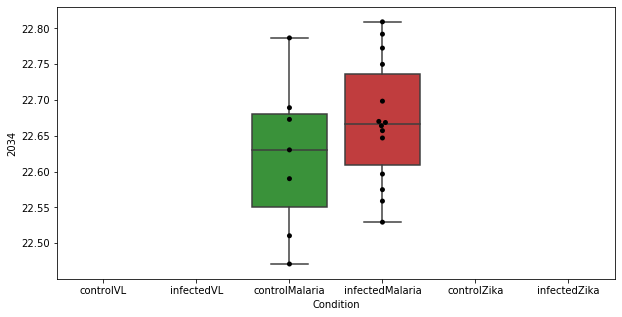

1102 row m/z                202.922
row retention time     4.97101
p-val                 0.537574
adj.P.Val             0.947154
custom_id                 3634
compound_names             NaN
Name: 3634, dtype: object


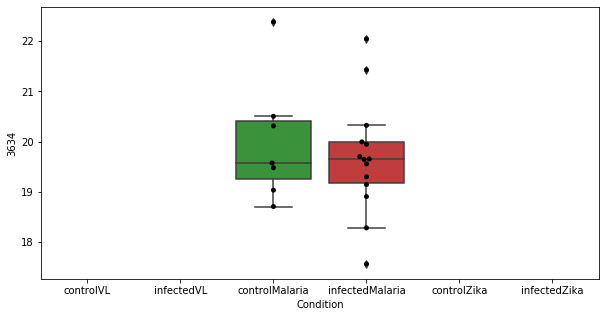

1103 row m/z                130.967
row retention time     23.5656
p-val                 0.537759
adj.P.Val             0.947154
custom_id                  527
compound_names             NaN
Name: 527, dtype: object


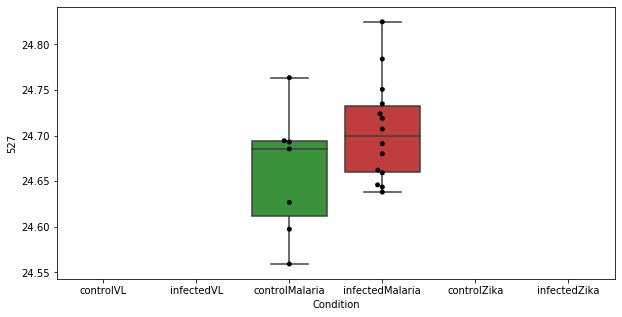

1104 row m/z                 904.59
row retention time     3.27621
p-val                 0.538041
adj.P.Val             0.947154
custom_id                 2978
compound_names             NaN
Name: 2978, dtype: object


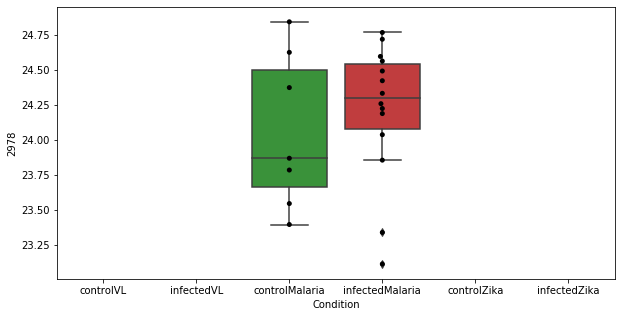

1105 row m/z                611.508
row retention time     3.26205
p-val                 0.538138
adj.P.Val             0.947154
custom_id                 2753
compound_names             NaN
Name: 2753, dtype: object


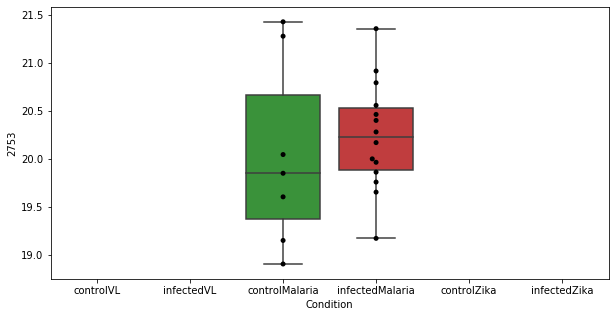

1106 row m/z                252.144
row retention time     11.5153
p-val                  0.53895
adj.P.Val             0.947154
custom_id                 1928
compound_names             NaN
Name: 1928, dtype: object


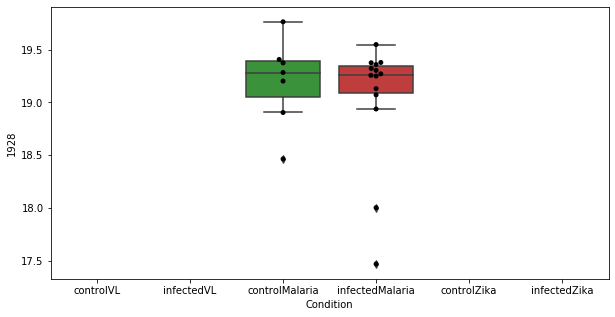

1107 row m/z                           219.142
row retention time                8.68744
p-val                            0.539188
adj.P.Val                        0.947154
custom_id                            1634
compound_names        propionyl-carnitine
Name: 1634, dtype: object


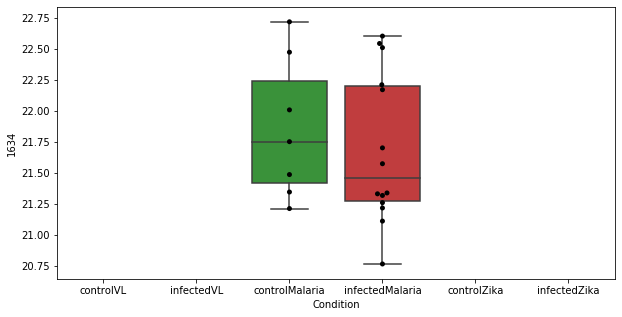

1108 row m/z                 181.93
row retention time      12.487
p-val                 0.539659
adj.P.Val             0.947154
custom_id                 1205
compound_names             NaN
Name: 1205, dtype: object


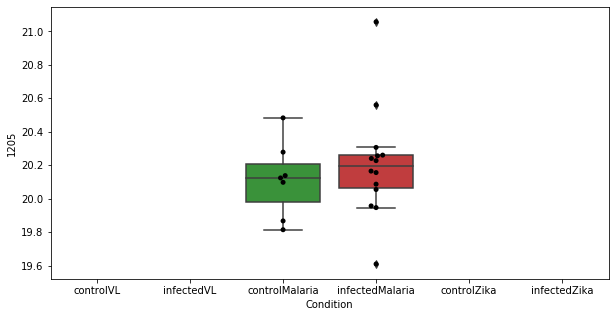

1109 row m/z                                111.055
row retention time                     23.7351
p-val                                 0.540019
adj.P.Val                             0.947154
custom_id                                  229
compound_names        Urocanate; Urocanic acid
Name: 229, dtype: object


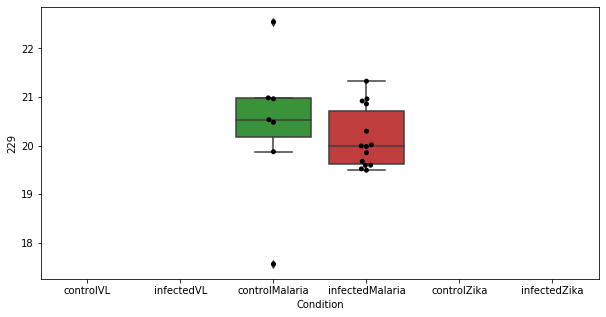

1110 row m/z                199.097
row retention time      4.5397
p-val                 0.541507
adj.P.Val             0.947154
custom_id                 1420
compound_names             NaN
Name: 1420, dtype: object


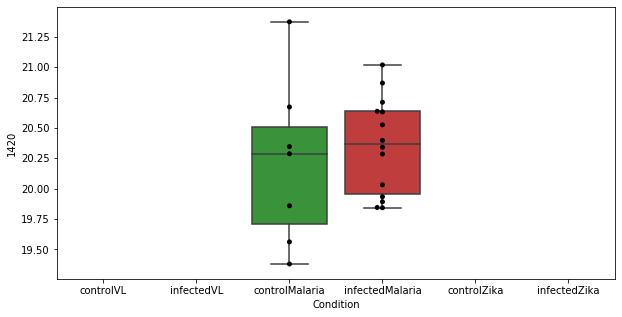

1111 row m/z                280.154
row retention time     7.20291
p-val                 0.542038
adj.P.Val             0.947154
custom_id                 2137
compound_names             NaN
Name: 2137, dtype: object


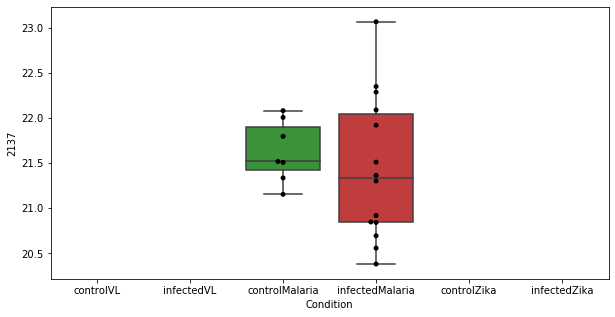

1112 row m/z                145.979
row retention time     23.6625
p-val                 0.542501
adj.P.Val             0.947154
custom_id                  724
compound_names             NaN
Name: 724, dtype: object


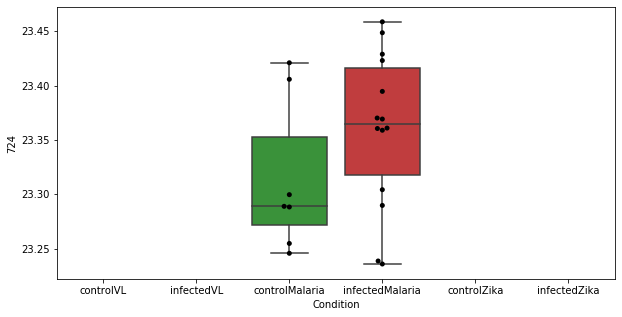

1113 row m/z                                                         180.102
row retention time                                              23.0869
p-val                                                           0.54256
adj.P.Val                                                      0.947154
custom_id                                                          4787
compound_names        (-)-Salsolinol; 6,7-Isoquinolinediol, 1,2,3,4-...
Name: 4787, dtype: object


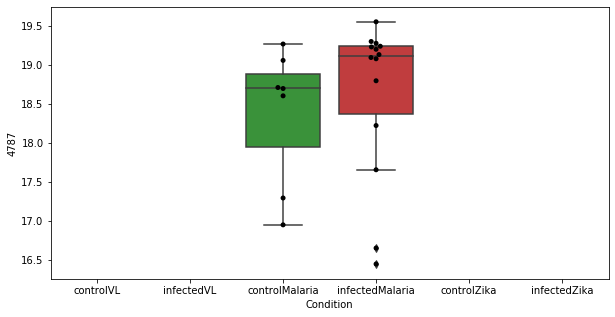

1114 row m/z                370.207
row retention time     3.96208
p-val                 0.542711
adj.P.Val             0.947154
custom_id                 2455
compound_names             NaN
Name: 2455, dtype: object


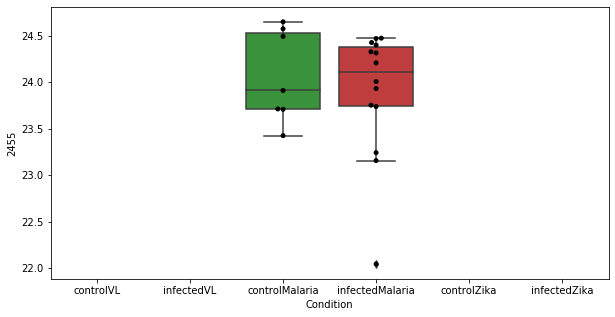

1115 row m/z                585.815
row retention time     8.69335
p-val                 0.542754
adj.P.Val             0.947154
custom_id                 2739
compound_names             NaN
Name: 2739, dtype: object


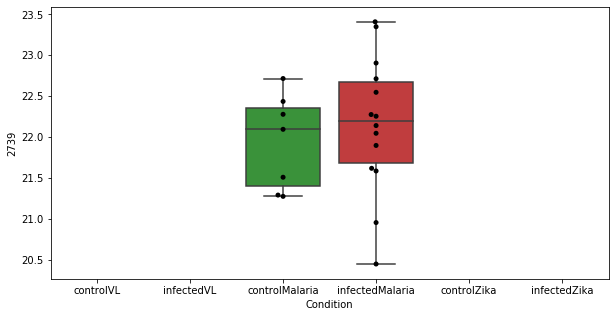

1116 row m/z                207.134
row retention time     3.89242
p-val                 0.543593
adj.P.Val             0.947154
custom_id                 1490
compound_names             NaN
Name: 1490, dtype: object


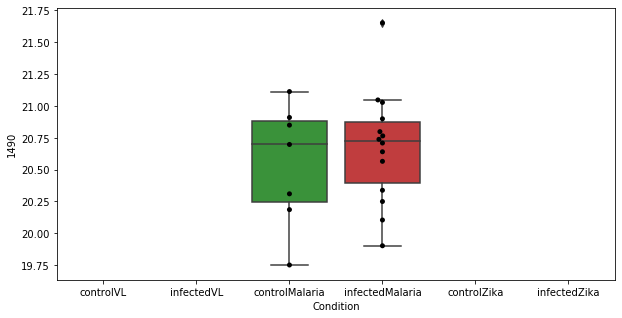

1117 row m/z                265.128
row retention time     4.04937
p-val                  0.54369
adj.P.Val             0.947154
custom_id                 2003
compound_names             NaN
Name: 2003, dtype: object


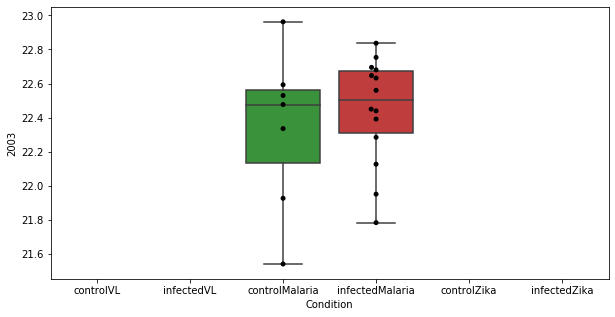

1118 row m/z                          113.107
row retention time               22.7668
p-val                           0.544237
adj.P.Val                       0.947154
custom_id                            273
compound_names        N-Acetylputrescine
Name: 273, dtype: object


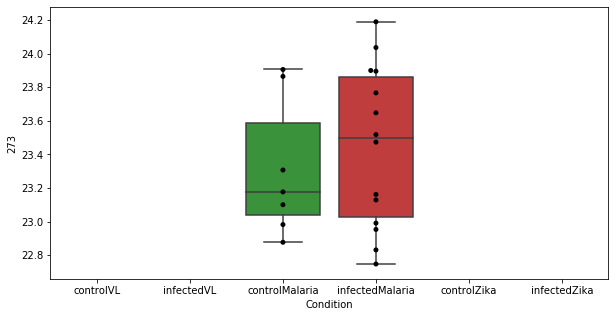

1119 row m/z                229.118
row retention time     12.0071
p-val                 0.544796
adj.P.Val             0.947154
custom_id                 3753
compound_names             NaN
Name: 3753, dtype: object


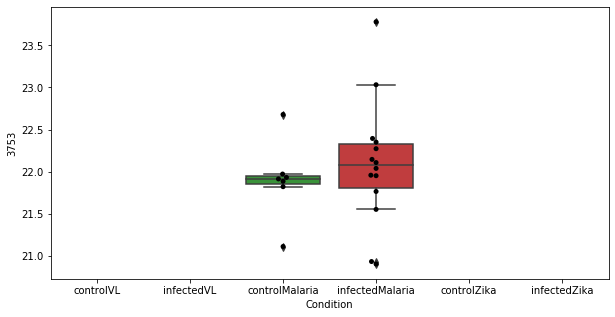

1120 row m/z                                                         102.055
row retention time                                              12.0841
p-val                                                          0.544918
adj.P.Val                                                      0.947154
custom_id                                                           144
compound_names        L-4-Hydroxyglutamate semialdehyde$D-Glutamate;...
Name: 144, dtype: object


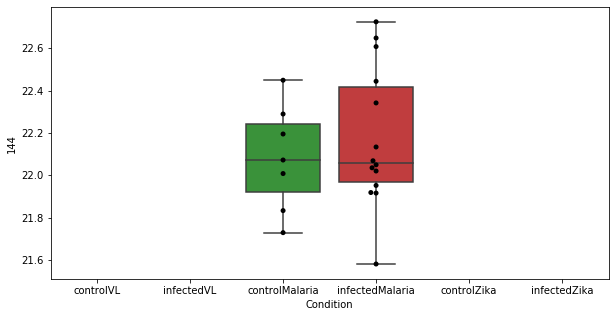

1121 row m/z                270.155
row retention time     3.99961
p-val                 0.545263
adj.P.Val             0.947154
custom_id                 2052
compound_names             NaN
Name: 2052, dtype: object


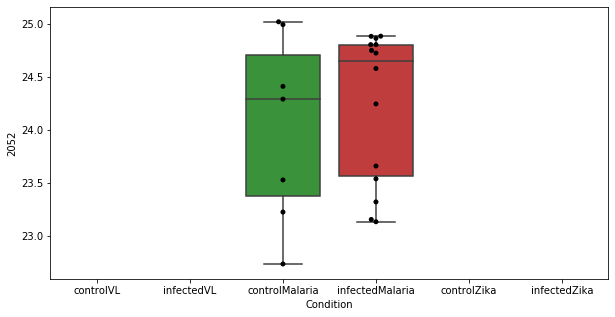

1122 row m/z                223.097
row retention time     3.76973
p-val                 0.546853
adj.P.Val             0.947154
custom_id                 1656
compound_names             NaN
Name: 1656, dtype: object


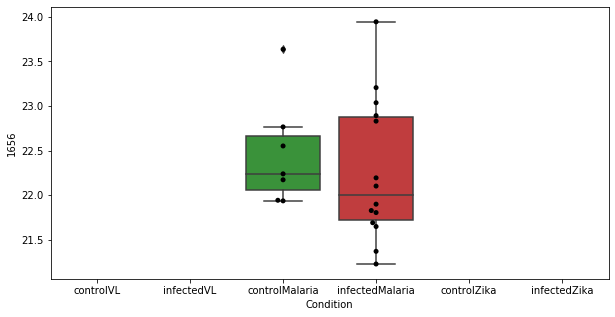

1123 row m/z                486.864
row retention time     11.9411
p-val                 0.546882
adj.P.Val             0.947154
custom_id                 2614
compound_names             NaN
Name: 2614, dtype: object


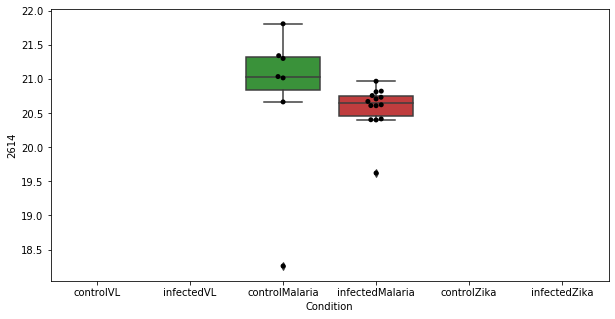

1124 row m/z                                                        89.0596
row retention time                                             4.07599
p-val                                                         0.546958
adj.P.Val                                                     0.947154
custom_id                                                           78
compound_names        Butanoic acid; Butanoate; Butyrate; Butyric acid
Name: 78, dtype: object


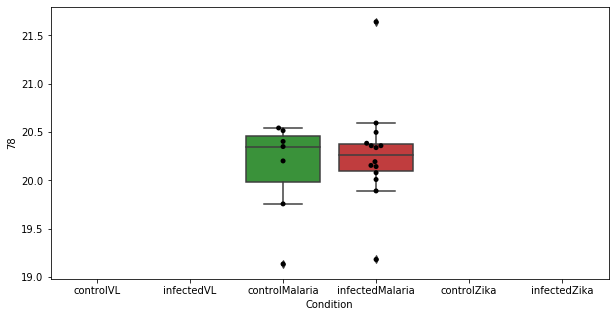

1125 row m/z                173.129
row retention time     9.59365
p-val                 0.547386
adj.P.Val             0.947154
custom_id                 1109
compound_names             NaN
Name: 1109, dtype: object


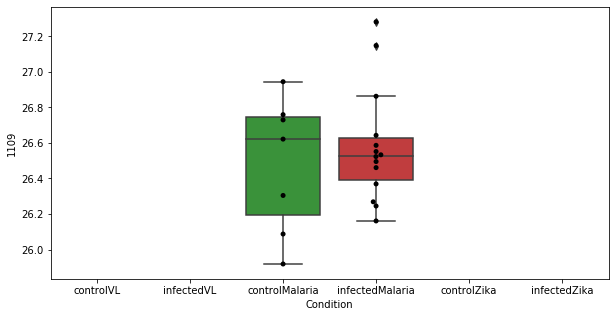

1126 row m/z                                                         369.351
row retention time                                              4.66132
p-val                                                          0.547982
adj.P.Val                                                      0.947154
custom_id                                                          4145
compound_names        5alpha-Cholest-7-en-3beta-ol; Lathosterol$5alp...
Name: 4145, dtype: object


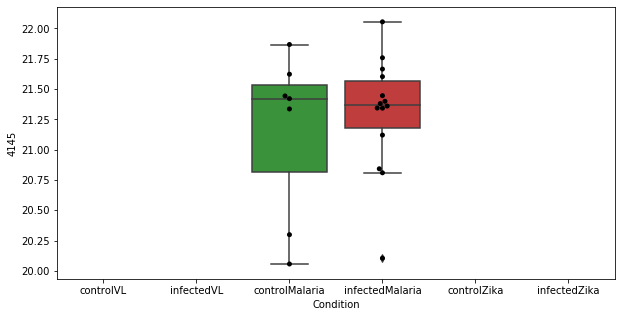

1127 row m/z                186.944
row retention time     4.97345
p-val                 0.548173
adj.P.Val             0.947154
custom_id                 1264
compound_names             NaN
Name: 1264, dtype: object


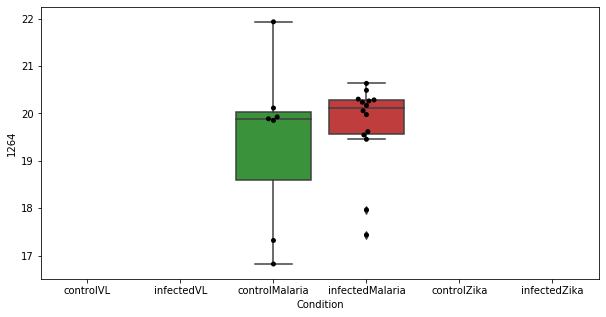

1128 row m/z                191.164
row retention time     3.86488
p-val                  0.54921
adj.P.Val             0.948105
custom_id                 1331
compound_names             NaN
Name: 1331, dtype: object


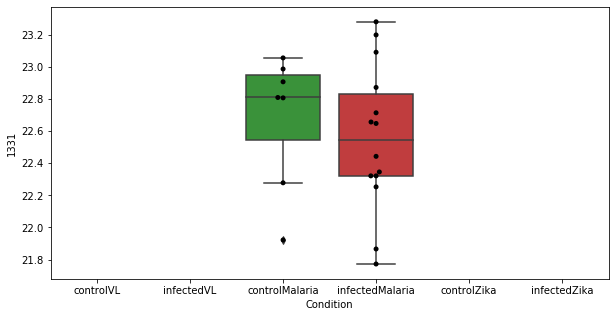

1129 row m/z                227.139
row retention time     6.99704
p-val                 0.550408
adj.P.Val             0.949269
custom_id                 1687
compound_names             NaN
Name: 1687, dtype: object


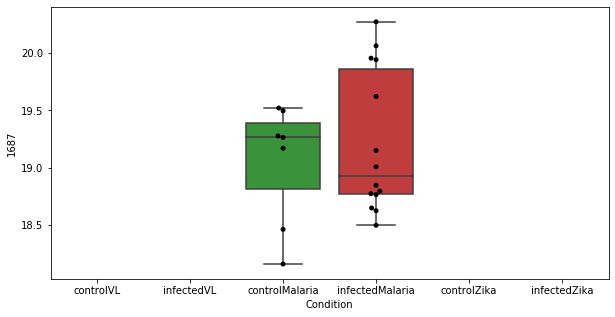

1130 row m/z                202.144
row retention time     7.00397
p-val                 0.551247
adj.P.Val             0.949269
custom_id                 1451
compound_names             NaN
Name: 1451, dtype: object


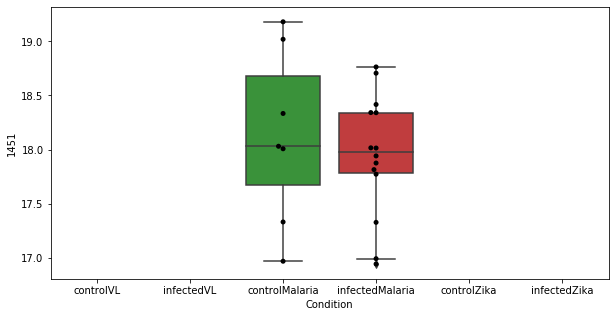

1131 row m/z                756.553
row retention time     3.53726
p-val                 0.551345
adj.P.Val             0.949269
custom_id                 2863
compound_names             NaN
Name: 2863, dtype: object


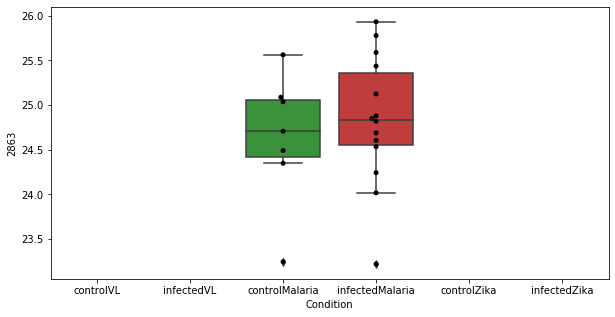

1132 row m/z                492.408
row retention time     3.40578
p-val                 0.552608
adj.P.Val             0.949359
custom_id                 2619
compound_names             NaN
Name: 2619, dtype: object


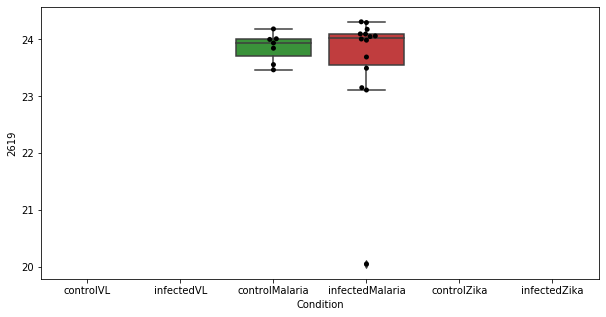

1133 row m/z                380.874
row retention time     13.0749
p-val                 0.552828
adj.P.Val             0.949359
custom_id                 4159
compound_names             NaN
Name: 4159, dtype: object


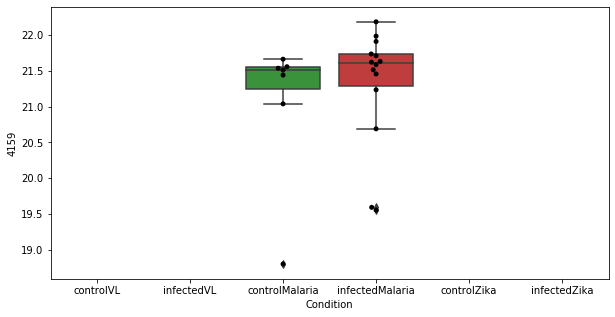

1134 row m/z                762.591
row retention time     3.51352
p-val                 0.552923
adj.P.Val             0.949359
custom_id                 2873
compound_names             NaN
Name: 2873, dtype: object


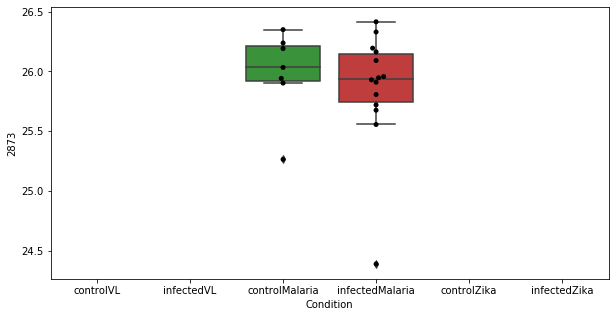

1135 row m/z                428.198
row retention time      3.5456
p-val                 0.553346
adj.P.Val             0.949359
custom_id                 2563
compound_names             NaN
Name: 2563, dtype: object


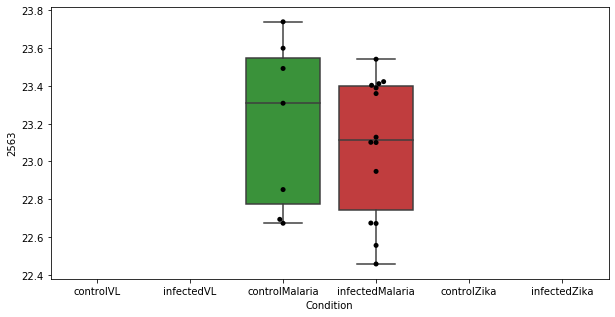

1136 row m/z                221.897
row retention time     23.6935
p-val                 0.554315
adj.P.Val             0.950184
custom_id                 1646
compound_names             NaN
Name: 1646, dtype: object


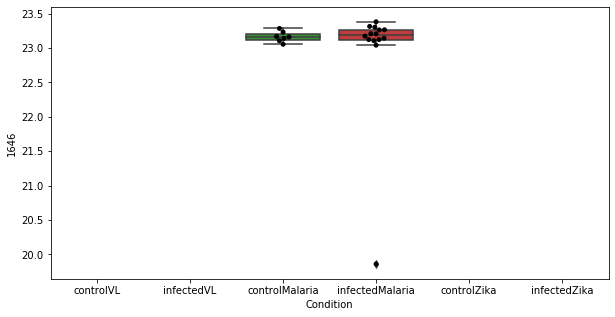

1137 row m/z                 301.99
row retention time     10.7949
p-val                 0.555202
adj.P.Val             0.950869
custom_id                 2255
compound_names             NaN
Name: 2255, dtype: object


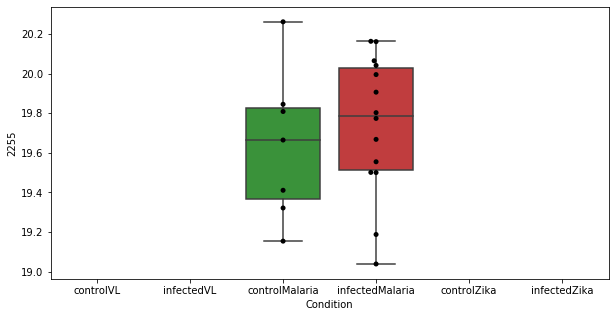

1138 row m/z                130.065
row retention time     10.3762
p-val                 0.556535
adj.P.Val             0.951765
custom_id                 3245
compound_names             NaN
Name: 3245, dtype: object


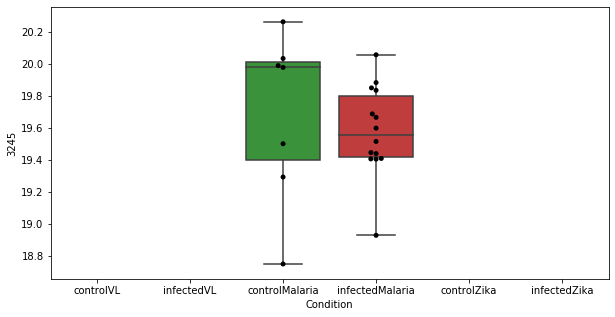

1139 row m/z                282.154
row retention time     4.04839
p-val                 0.557634
adj.P.Val             0.951765
custom_id                 2151
compound_names             NaN
Name: 2151, dtype: object


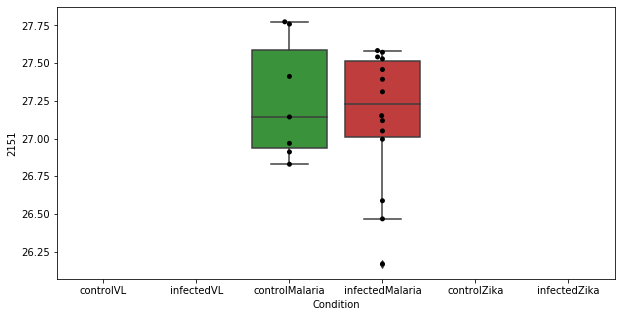

1140 row m/z                132.965
row retention time      23.564
p-val                 0.557905
adj.P.Val             0.951765
custom_id                  562
compound_names             NaN
Name: 562, dtype: object


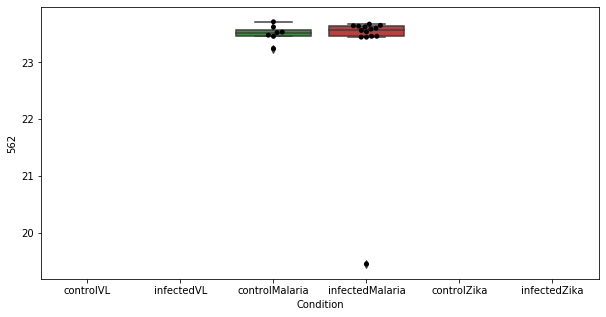

1141 row m/z                326.181
row retention time     4.13901
p-val                 0.558773
adj.P.Val             0.951765
custom_id                 2357
compound_names             NaN
Name: 2357, dtype: object


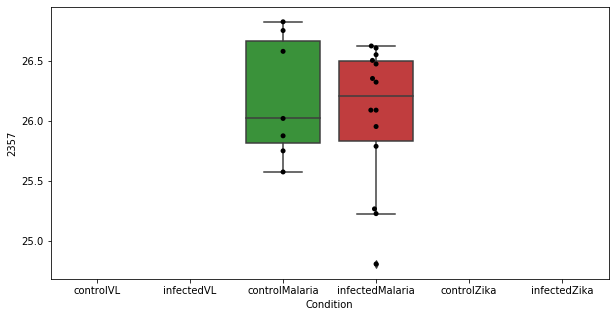

1142 row m/z                    275
row retention time     11.2765
p-val                 0.559124
adj.P.Val             0.951765
custom_id                 2082
compound_names             NaN
Name: 2082, dtype: object


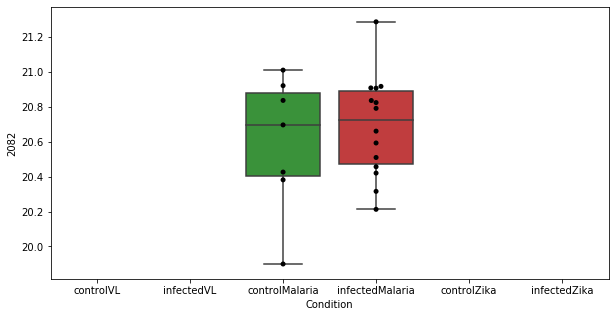

1143 row m/z                360.966
row retention time     9.02032
p-val                 0.559595
adj.P.Val             0.951765
custom_id                 2442
compound_names             NaN
Name: 2442, dtype: object


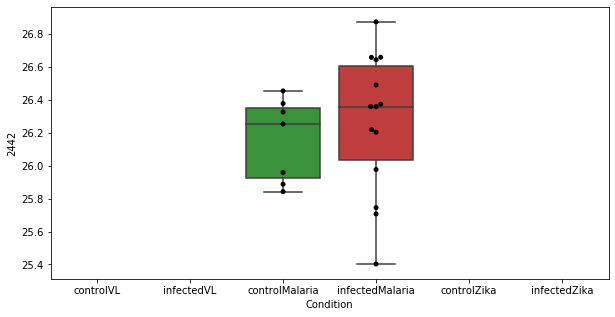

1144 row m/z                                                      123.079
row retention time                                           23.9121
p-val                                                       0.560709
adj.P.Val                                                   0.951765
custom_id                                                       4510
compound_names        4-Methylpentanal; Isocaproaldehyde; Isohexanal
Name: 4510, dtype: object


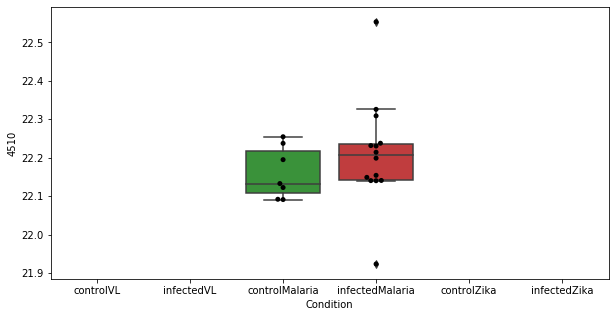

1145 row m/z                725.556
row retention time     4.50546
p-val                 0.560765
adj.P.Val             0.951765
custom_id                 2836
compound_names             NaN
Name: 2836, dtype: object


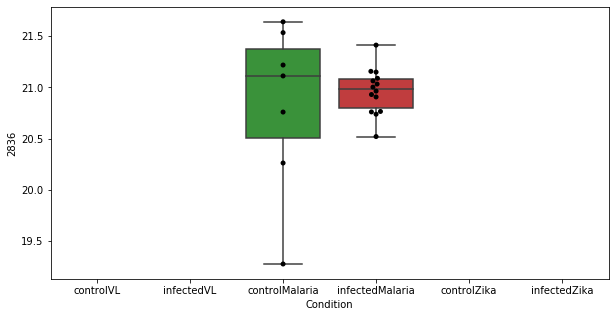

1146 row m/z                526.265
row retention time     6.97968
p-val                 0.561322
adj.P.Val             0.951765
custom_id                 2653
compound_names             NaN
Name: 2653, dtype: object


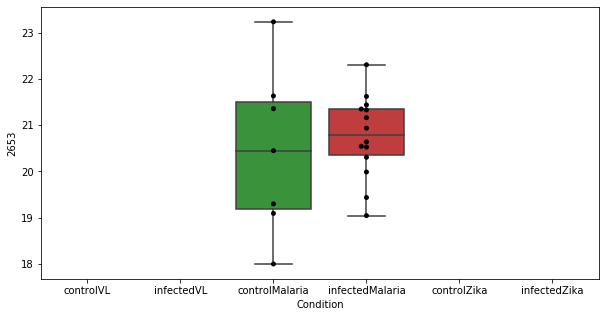

1147 row m/z                730.593
row retention time     3.70629
p-val                 0.562971
adj.P.Val             0.951765
custom_id                 4261
compound_names             NaN
Name: 4261, dtype: object


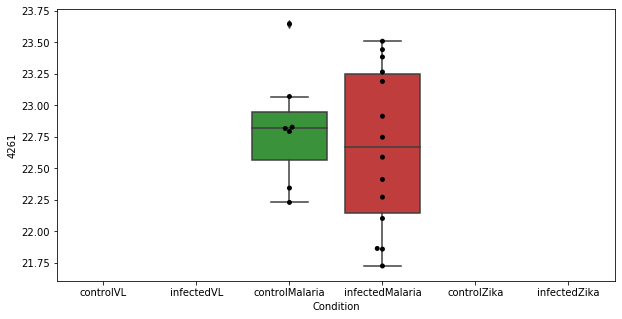

1148 row m/z                                                         212.095
row retention time                                              4.71838
p-val                                                          0.563297
adj.P.Val                                                      0.951765
custom_id                                                          5860
compound_names        2-hydroxyamino-3,8-dimethylimidazo[4,5-f]quino...
Name: 5860, dtype: object


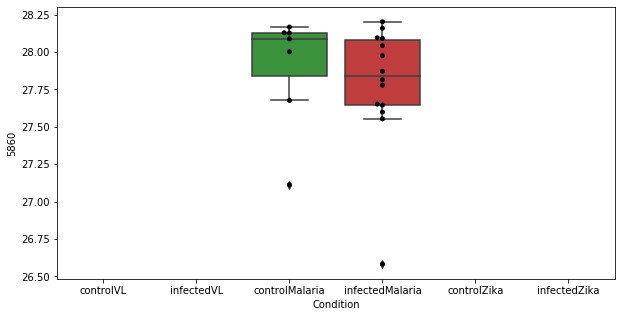

1149 row m/z                566.434
row retention time     3.34512
p-val                 0.563321
adj.P.Val             0.951765
custom_id                 2712
compound_names             NaN
Name: 2712, dtype: object


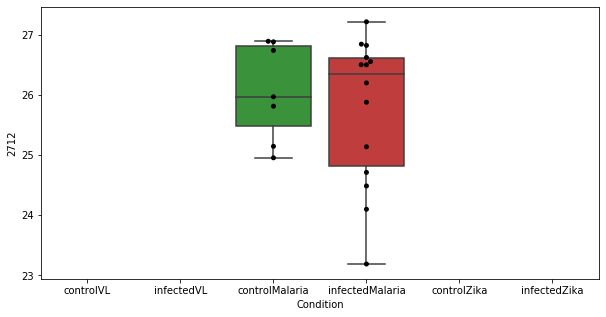

1150 row m/z                272.185
row retention time     3.76471
p-val                 0.564333
adj.P.Val             0.951765
custom_id                 2062
compound_names             NaN
Name: 2062, dtype: object


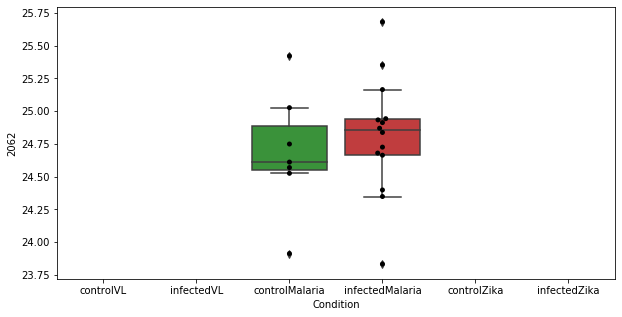

1151 row m/z                200.894
row retention time     15.1581
p-val                 0.564865
adj.P.Val             0.951765
custom_id                 1442
compound_names             NaN
Name: 1442, dtype: object


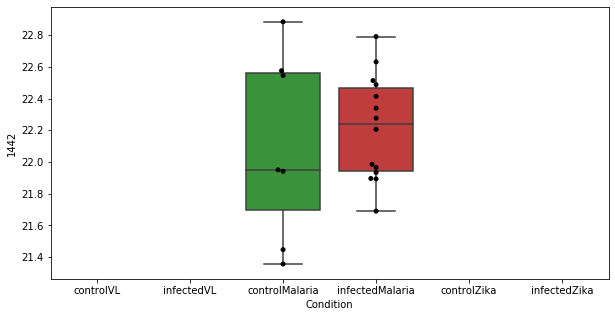

1152 row m/z                                                         130.069
row retention time                                              12.1695
p-val                                                          0.565786
adj.P.Val                                                      0.951765
custom_id                                                           516
compound_names        5,6-Dihydrothymine; Dihydrothymine; 5,6-Dihydr...
Name: 516, dtype: object


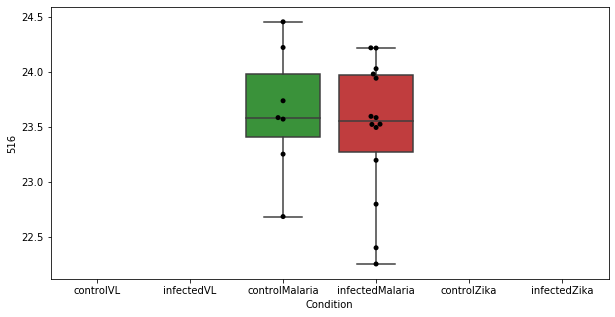

1153 row m/z                                                   188.103
row retention time                                        11.8891
p-val                                                    0.566301
adj.P.Val                                                0.951765
custom_id                                                    1279
compound_names        Hordenine; 4-[2-(Dimethylamino)ethyl]phenol
Name: 1279, dtype: object


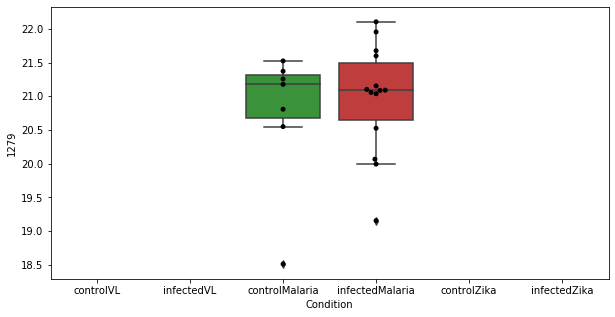

1154 row m/z                  318.9
row retention time     23.7349
p-val                 0.566402
adj.P.Val             0.951765
custom_id                 4071
compound_names             NaN
Name: 4071, dtype: object


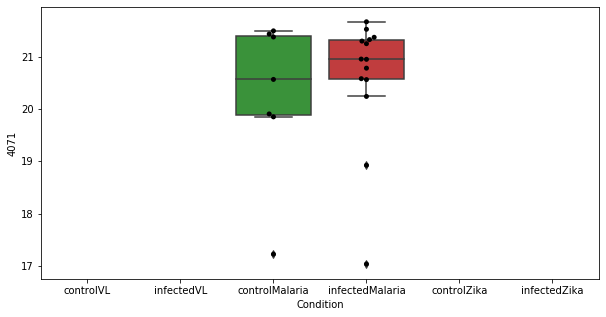

1155 row m/z                             142.086
row retention time                  7.73744
p-val                              0.566576
adj.P.Val                          0.951765
custom_id                               665
compound_names        5-Acetamidopentanoate
Name: 665, dtype: object


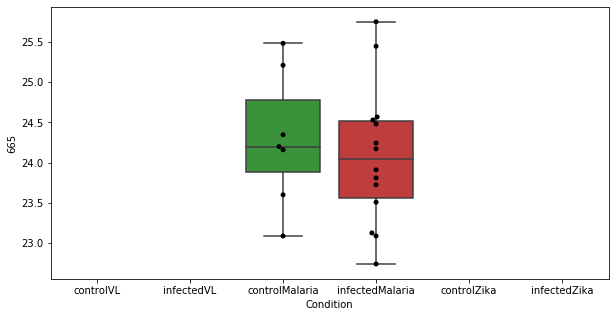

1156 row m/z                632.806
row retention time     9.01784
p-val                 0.566628
adj.P.Val             0.951765
custom_id                 2770
compound_names             NaN
Name: 2770, dtype: object


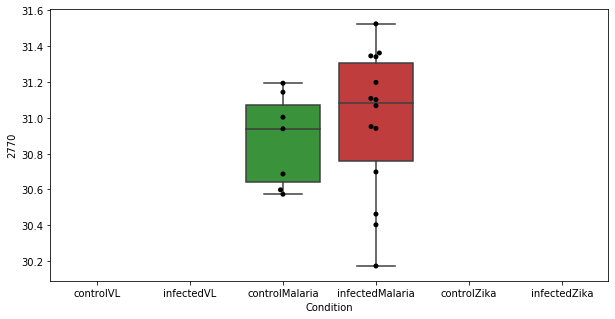

1157 row m/z                                                         196.118
row retention time                                              4.36291
p-val                                                          0.566869
adj.P.Val                                                      0.951765
custom_id                                                          1395
compound_names        Tetrahydrobiopterin; 5,6,7,8-Tetrahydrobiopter...
Name: 1395, dtype: object


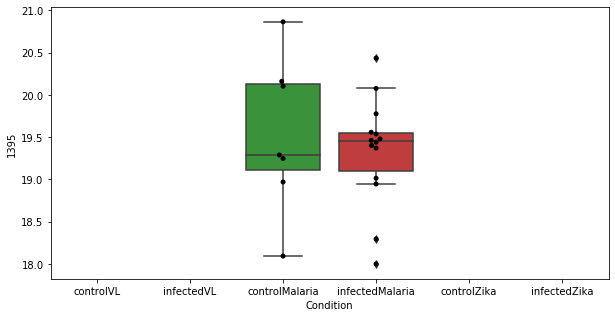

1158 row m/z                                                         101.071
row retention time                                              12.3225
p-val                                                          0.566954
adj.P.Val                                                      0.951765
custom_id                                                           130
compound_names        D-Glutamine; D-2-Aminoglutaramic acid$L-Glutam...
Name: 130, dtype: object


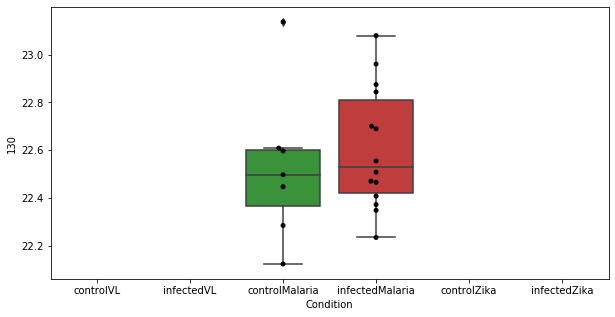

1159 row m/z                                                         104.071
row retention time                                              10.5874
p-val                                                          0.567064
adj.P.Val                                                      0.951765
custom_id                                                           163
compound_names        N,N-Dimethylglycine; Dimethylglycine$(R)-3-Ami...
Name: 163, dtype: object


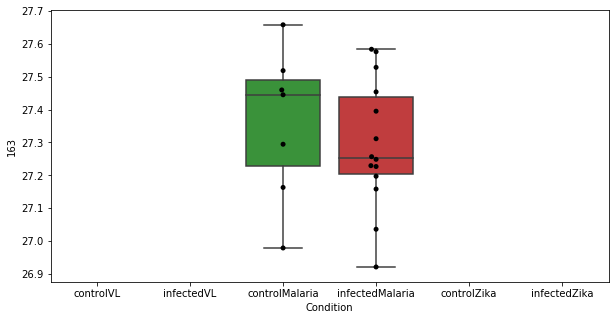

1160 row m/z                                                          290.16
row retention time                                              4.12496
p-val                                                          0.567832
adj.P.Val                                                      0.951765
custom_id                                                          2206
compound_names        Peptide 2-[3-carboxy-3-(methylammonio)propyl]-...
Name: 2206, dtype: object


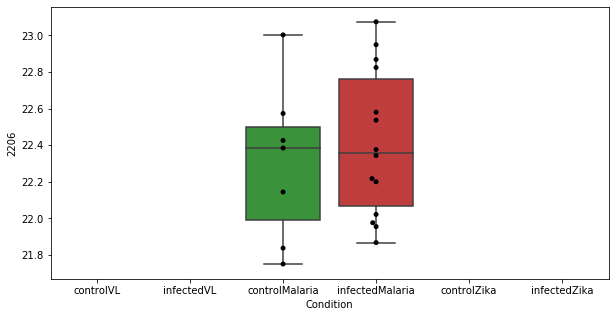

1161 row m/z                239.139
row retention time     6.98845
p-val                 0.568051
adj.P.Val             0.951765
custom_id                 1817
compound_names             NaN
Name: 1817, dtype: object


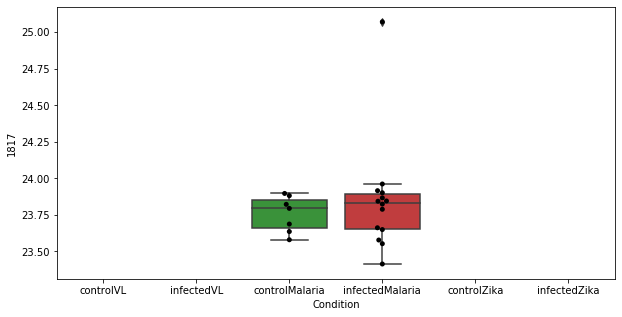

1162 row m/z                119.016
row retention time     10.4779
p-val                 0.568077
adj.P.Val             0.951765
custom_id                  358
compound_names             NaN
Name: 358, dtype: object


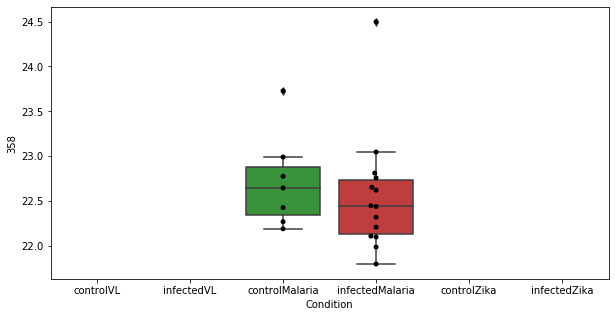

1163 row m/z                275.277
row retention time     6.86842
p-val                 0.568999
adj.P.Val             0.951765
custom_id                 3940
compound_names             NaN
Name: 3940, dtype: object


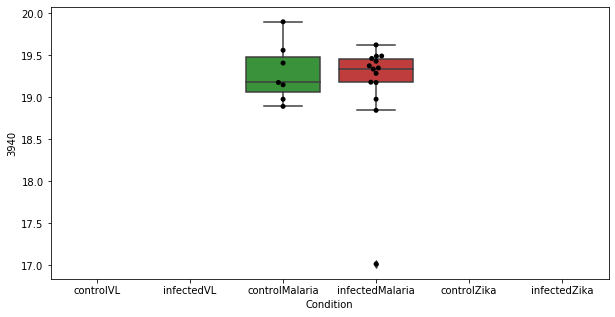

1164 row m/z                 184.92
row retention time     23.8124
p-val                 0.569342
adj.P.Val             0.951765
custom_id                 1236
compound_names             NaN
Name: 1236, dtype: object


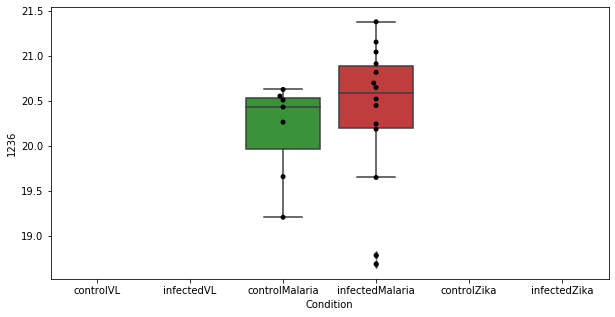

1165 row m/z                                                         141.091
row retention time                                              4.50265
p-val                                                          0.569857
adj.P.Val                                                      0.951765
custom_id                                                           657
compound_names        Choline phosphate; Phosphorylcholine; Phosphoc...
Name: 657, dtype: object


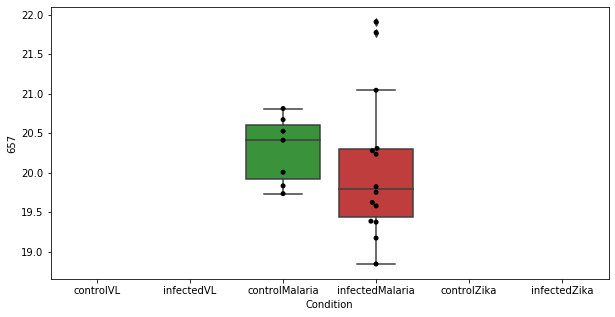

1166 row m/z                268.893
row retention time     11.5275
p-val                 0.570308
adj.P.Val             0.951765
custom_id                 5065
compound_names             NaN
Name: 5065, dtype: object


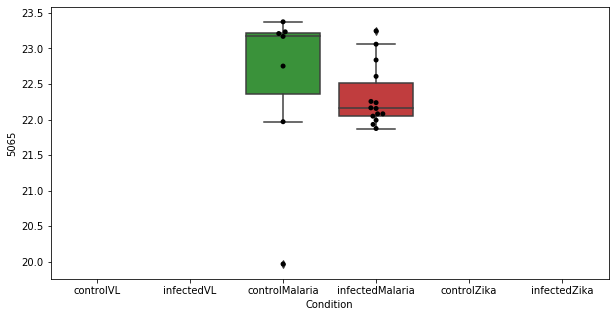

1167 row m/z                208.939
row retention time      11.977
p-val                 0.570522
adj.P.Val             0.951765
custom_id                 1508
compound_names             NaN
Name: 1508, dtype: object


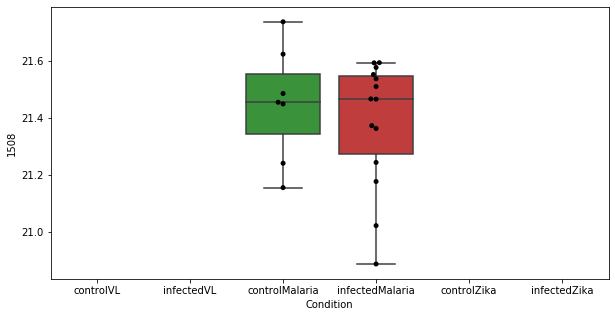

1168 row m/z                  304.3
row retention time     7.23715
p-val                 0.570864
adj.P.Val             0.951765
custom_id                 2266
compound_names             NaN
Name: 2266, dtype: object


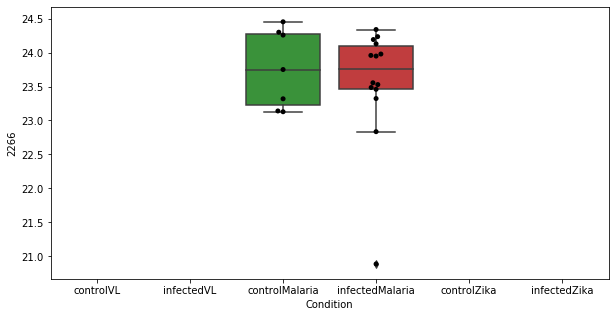

1169 row m/z                680.479
row retention time     23.5625
p-val                 0.571643
adj.P.Val              0.95225
custom_id                 2811
compound_names             NaN
Name: 2811, dtype: object


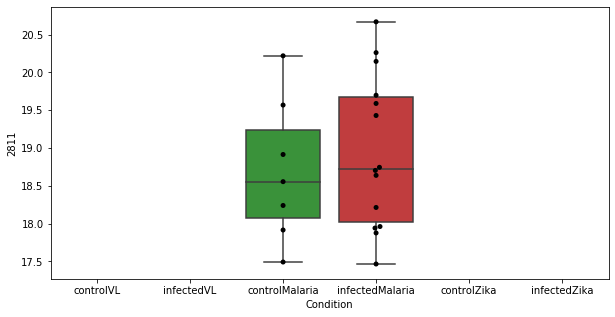

1170 row m/z                                                         284.197
row retention time                                              6.97794
p-val                                                          0.572741
adj.P.Val                                                      0.953265
custom_id                                                          2161
compound_names        3(S),8(S)-dihydroxy-6E,10Z-hexadecadienoate$3(...
Name: 2161, dtype: object


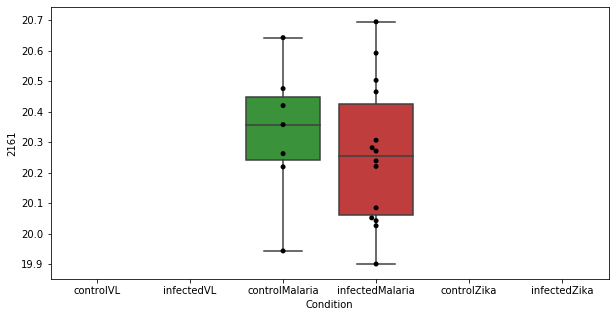

1171 row m/z                84.0579
row retention time     23.2263
p-val                 0.574613
adj.P.Val             0.954354
custom_id                   56
compound_names             NaN
Name: 56, dtype: object


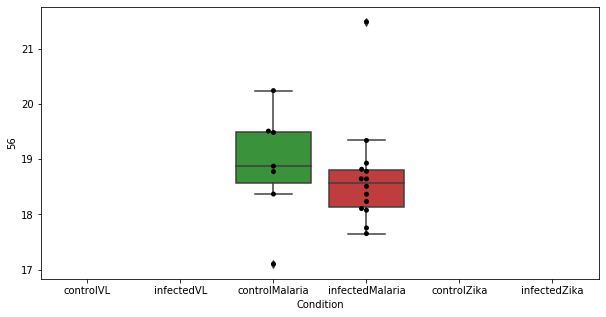

1172 row m/z                183.138
row retention time     3.81677
p-val                 0.574649
adj.P.Val             0.954354
custom_id                 1224
compound_names             NaN
Name: 1224, dtype: object


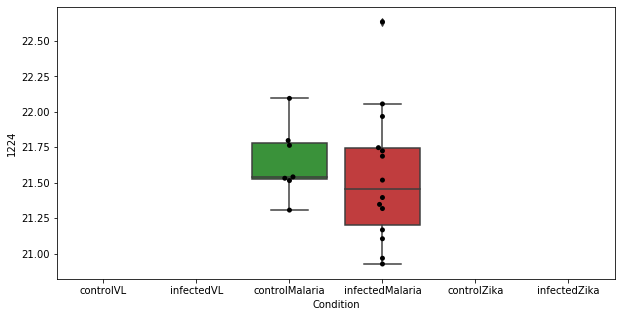

1173 row m/z                612.519
row retention time     3.25533
p-val                 0.577936
adj.P.Val             0.954354
custom_id                 2754
compound_names             NaN
Name: 2754, dtype: object


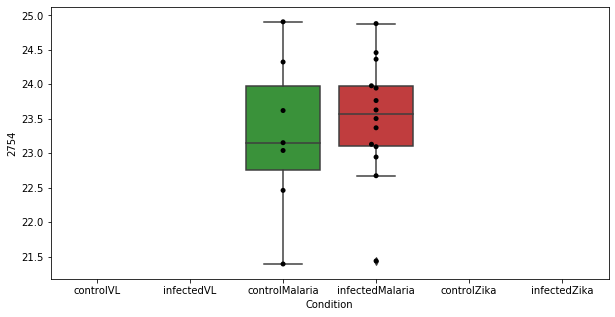

1174 row m/z                           218.139
row retention time                 8.6864
p-val                            0.578634
adj.P.Val                        0.954354
custom_id                            1628
compound_names        propionyl-carnitine
Name: 1628, dtype: object


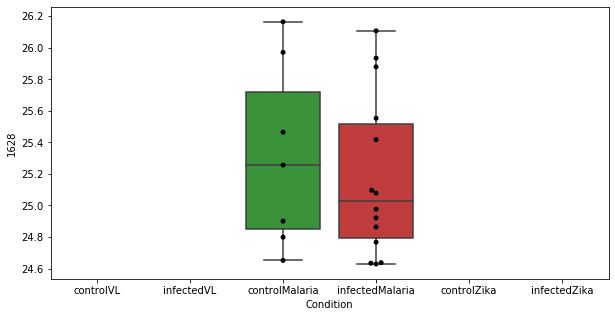

1175 row m/z                                                         147.028
row retention time                                              8.09962
p-val                                                          0.579026
adj.P.Val                                                      0.954354
custom_id                                                           750
compound_names        2-Oxoglutarate; Oxoglutaric acid; 2-Ketoglutar...
Name: 750, dtype: object


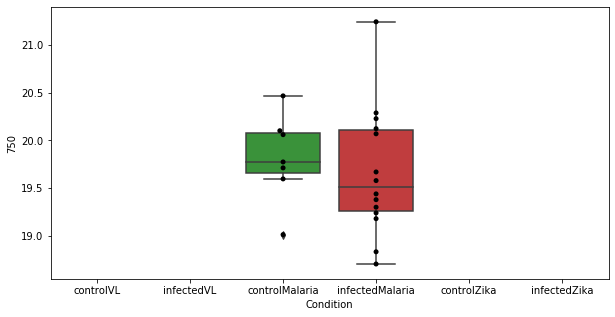

1176 row m/z                224.186
row retention time     23.6427
p-val                 0.579833
adj.P.Val             0.954354
custom_id                 1661
compound_names             NaN
Name: 1661, dtype: object


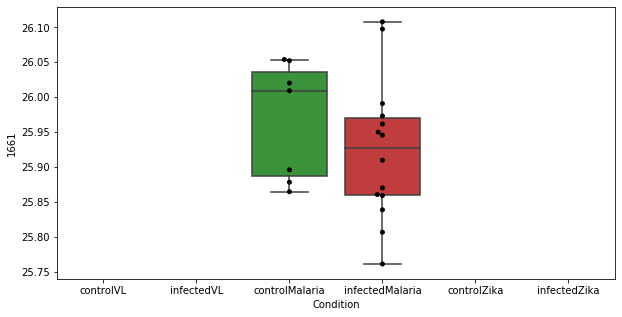

1177 row m/z                273.189
row retention time     3.75831
p-val                 0.579839
adj.P.Val             0.954354
custom_id                 2067
compound_names             NaN
Name: 2067, dtype: object


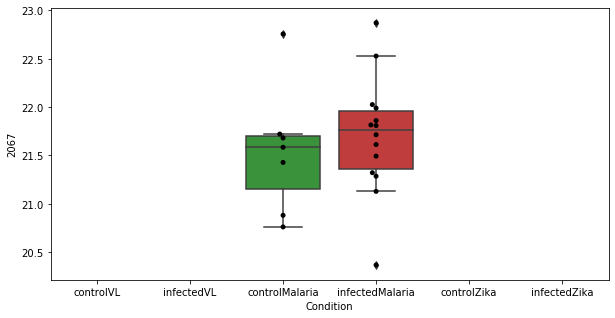

1178 row m/z                176.066
row retention time     9.58478
p-val                 0.579868
adj.P.Val             0.954354
custom_id                 1139
compound_names             NaN
Name: 1139, dtype: object


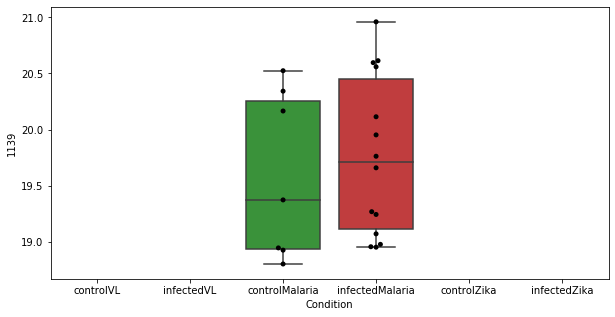

1179 row m/z                802.686
row retention time     3.63831
p-val                 0.580303
adj.P.Val             0.954354
custom_id                 2933
compound_names             NaN
Name: 2933, dtype: object


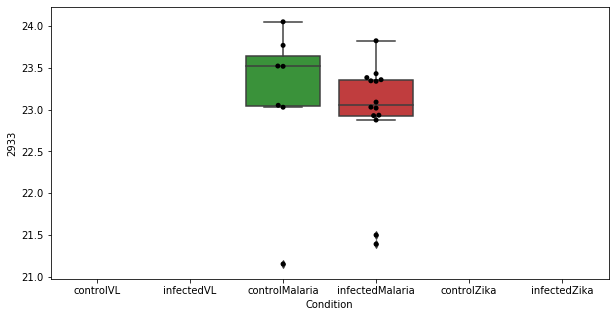

1180 row m/z                216.159
row retention time      6.9806
p-val                  0.58041
adj.P.Val             0.954354
custom_id                 1604
compound_names             NaN
Name: 1604, dtype: object


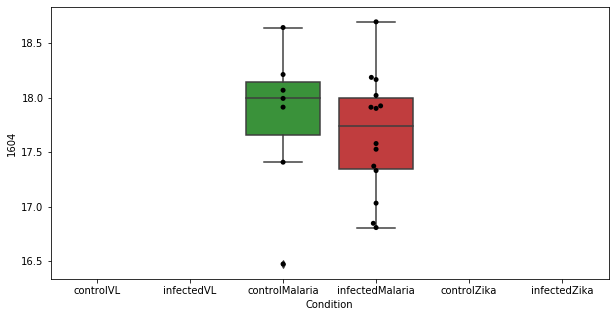

1181 row m/z                160.901
row retention time     15.1908
p-val                 0.580699
adj.P.Val             0.954354
custom_id                  934
compound_names             NaN
Name: 934, dtype: object


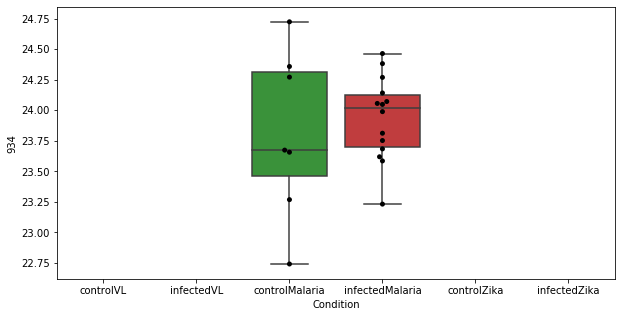

1182 row m/z                228.123
row retention time     4.58234
p-val                  0.58087
adj.P.Val             0.954354
custom_id                 1693
compound_names             NaN
Name: 1693, dtype: object


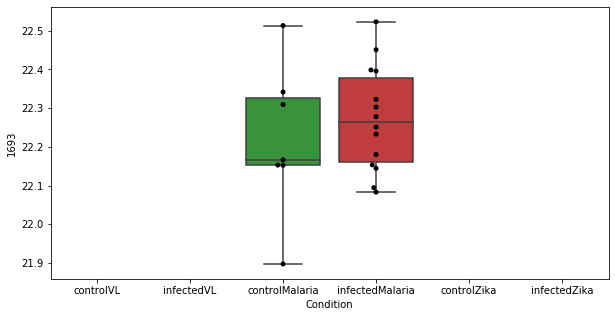

1183 row m/z                156.077
row retention time     8.36407
p-val                 0.580941
adj.P.Val             0.954354
custom_id                  865
compound_names             NaN
Name: 865, dtype: object


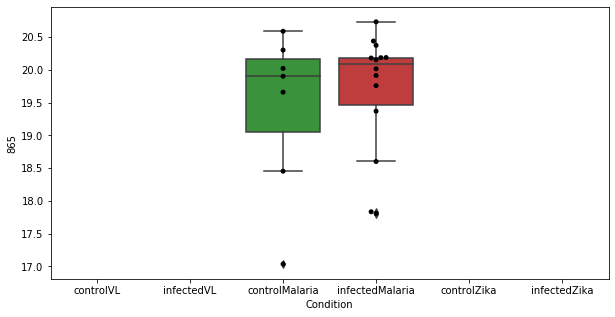

1184 row m/z                184.181
row retention time     22.8514
p-val                 0.581513
adj.P.Val             0.954354
custom_id                 1233
compound_names             NaN
Name: 1233, dtype: object


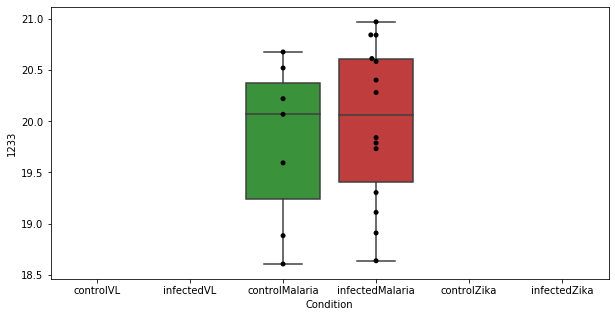

1185 row m/z                                                          235.08
row retention time                                              12.2587
p-val                                                          0.581728
adj.P.Val                                                      0.954354
custom_id                                                          1773
compound_names        Nebularine; Purine riboside; N-D-Ribosylpurine...
Name: 1773, dtype: object


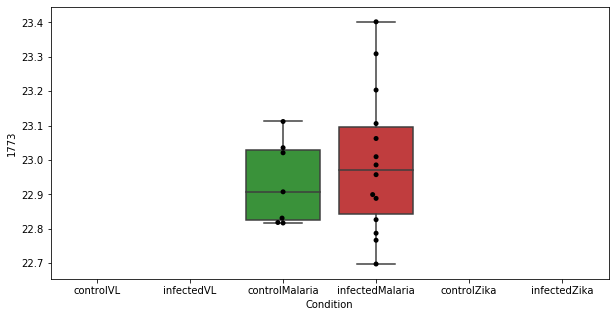

1186 row m/z                230.158
row retention time     10.8879
p-val                 0.581733
adj.P.Val             0.954354
custom_id                 3763
compound_names             NaN
Name: 3763, dtype: object


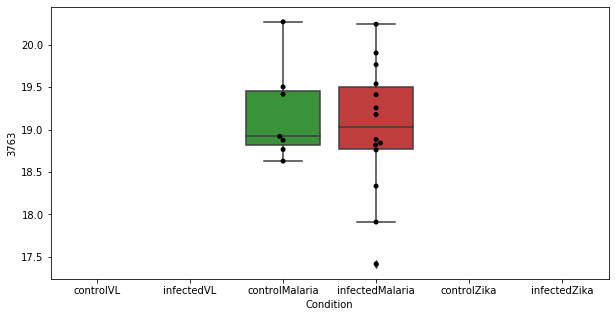

1187 row m/z                148.993
row retention time     23.8571
p-val                 0.583391
adj.P.Val             0.954354
custom_id                  797
compound_names             NaN
Name: 797, dtype: object


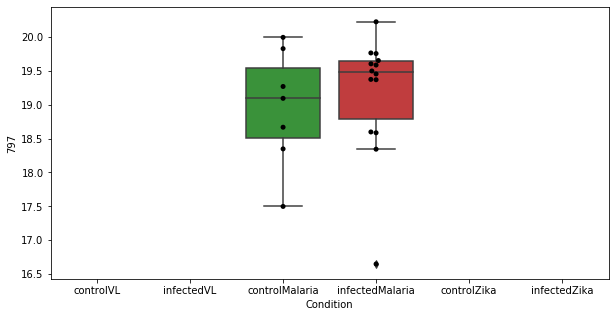

1188 row m/z                274.105
row retention time     3.91398
p-val                 0.584234
adj.P.Val             0.954354
custom_id                 2068
compound_names             NaN
Name: 2068, dtype: object


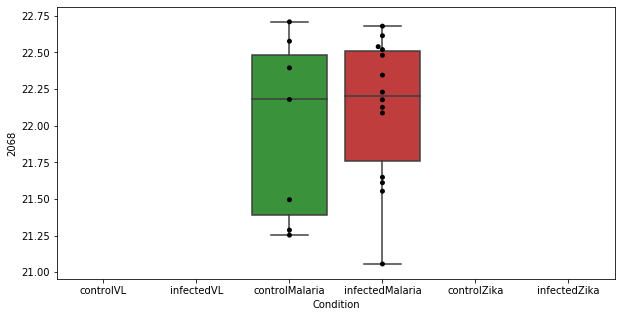

1189 row m/z                            128.082
row retention time                 9.72963
p-val                             0.584295
adj.P.Val                         0.954354
custom_id                              472
compound_names        4-Guanidinobutanoate
Name: 472, dtype: object


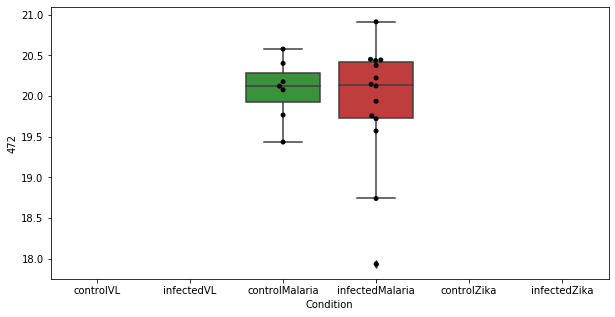

1190 row m/z                                                         153.066
row retention time                                              7.04797
p-val                                                          0.584866
adj.P.Val                                                      0.954354
custom_id                                                           844
compound_names        N1-Methyl-2-pyridone-5-carboxamide; N'-Methyl-...
Name: 844, dtype: object


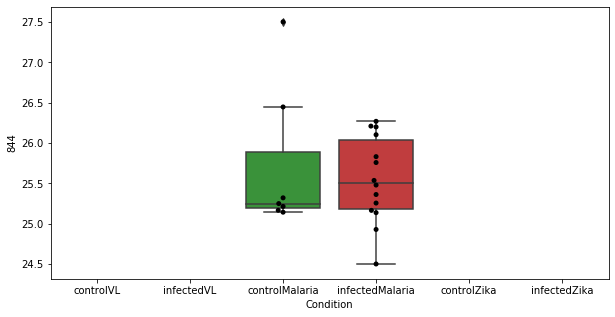

1191 row m/z                149.013
row retention time     23.0139
p-val                 0.585298
adj.P.Val             0.954354
custom_id                  799
compound_names             NaN
Name: 799, dtype: object


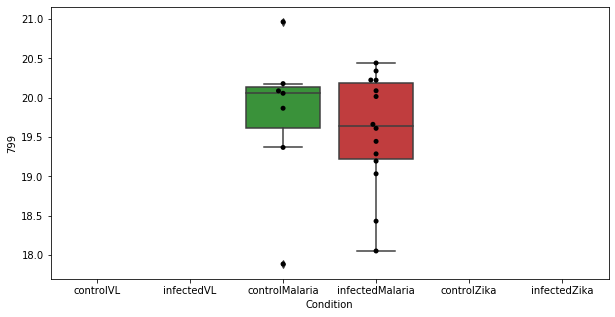

1192 row m/z                194.092
row retention time     7.11866
p-val                 0.585323
adj.P.Val             0.954354
custom_id                 1368
compound_names             NaN
Name: 1368, dtype: object


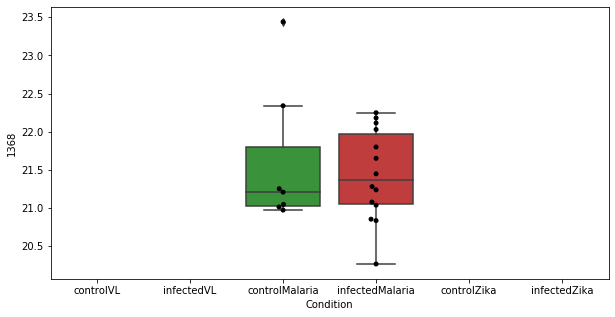

1193 row m/z                187.115
row retention time     9.71032
p-val                 0.585661
adj.P.Val             0.954354
custom_id                 1271
compound_names             NaN
Name: 1271, dtype: object


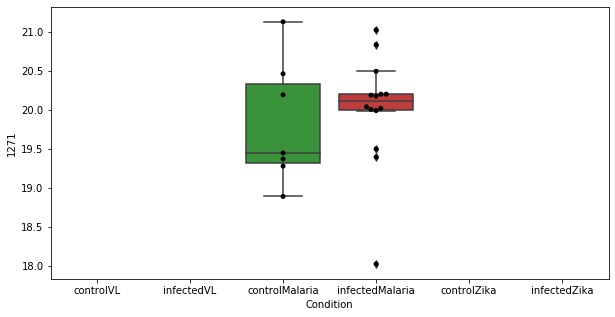

1194 row m/z                285.298
row retention time     3.67134
p-val                 0.585896
adj.P.Val             0.954354
custom_id                 2170
compound_names             NaN
Name: 2170, dtype: object


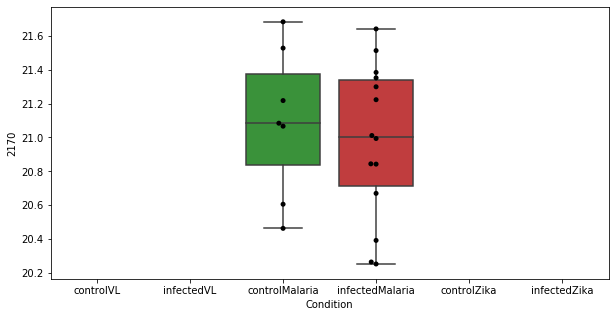

1195 row m/z                783.572
row retention time     3.51525
p-val                 0.585945
adj.P.Val             0.954354
custom_id                 2904
compound_names             NaN
Name: 2904, dtype: object


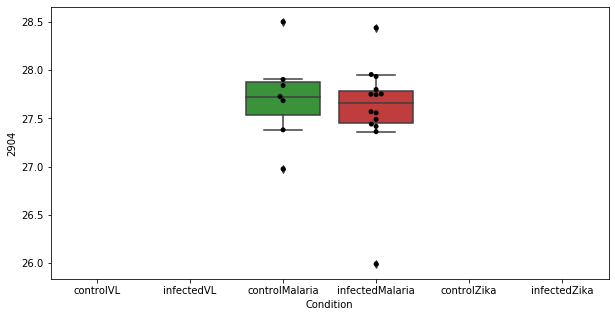

1196 row m/z                127.123
row retention time     8.51551
p-val                 0.586127
adj.P.Val             0.954354
custom_id                  460
compound_names             NaN
Name: 460, dtype: object


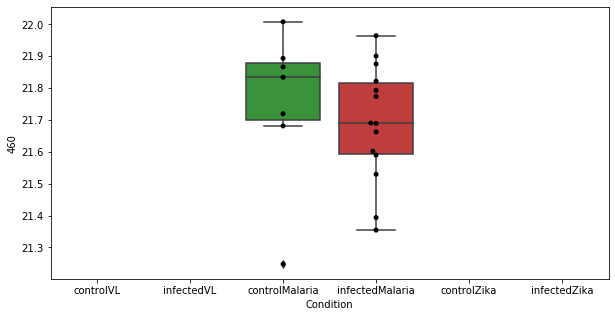

1197 row m/z                                                        174.113
row retention time                                             6.99942
p-val                                                         0.588915
adj.P.Val                                                     0.956493
custom_id                                                         1122
compound_names        Pantothenate; Pantothenic acid; (R)-Pantothenate
Name: 1122, dtype: object


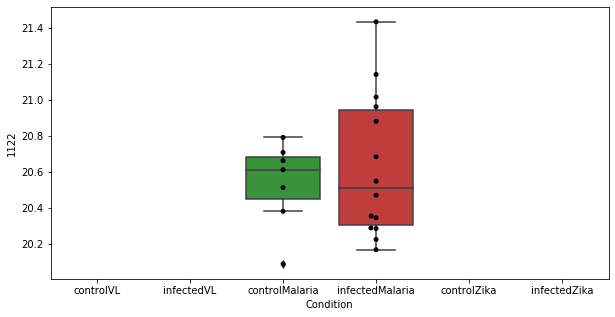

1198 row m/z                             142.086
row retention time                  23.0498
p-val                              0.589595
adj.P.Val                          0.956493
custom_id                               669
compound_names        5-Acetamidopentanoate
Name: 669, dtype: object


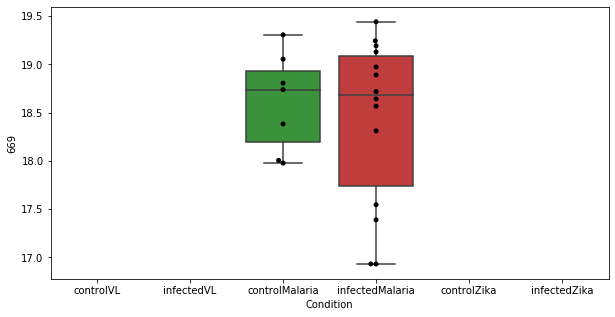

1199 row m/z                221.897
row retention time     3.90632
p-val                 0.589602
adj.P.Val             0.956493
custom_id                 1647
compound_names             NaN
Name: 1647, dtype: object


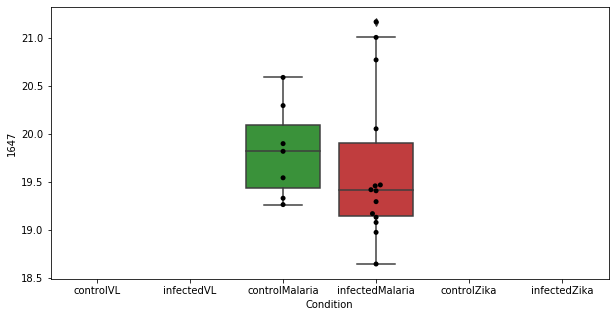

1200 row m/z                326.378
row retention time     6.99976
p-val                 0.590211
adj.P.Val             0.956493
custom_id                 2358
compound_names             NaN
Name: 2358, dtype: object


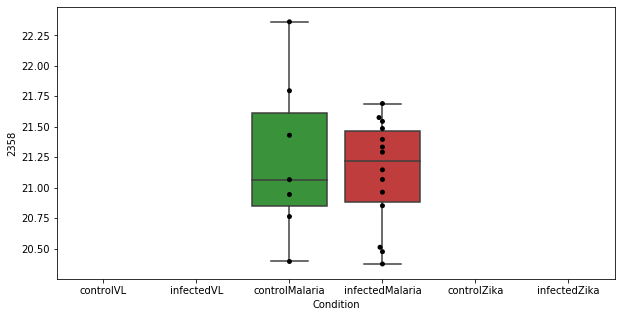

1201 row m/z                780.858
row retention time     9.14809
p-val                 0.590649
adj.P.Val             0.956493
custom_id                 2895
compound_names             NaN
Name: 2895, dtype: object


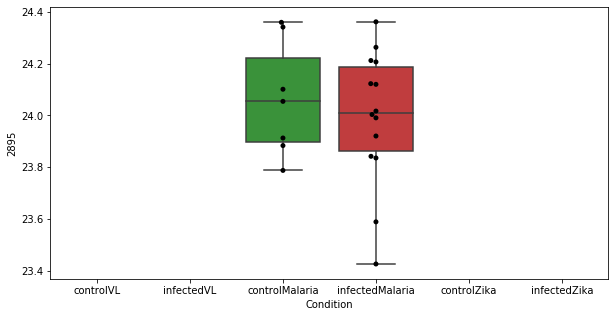

1202 row m/z                234.981
row retention time     11.2778
p-val                 0.591262
adj.P.Val             0.956493
custom_id                 1765
compound_names             NaN
Name: 1765, dtype: object


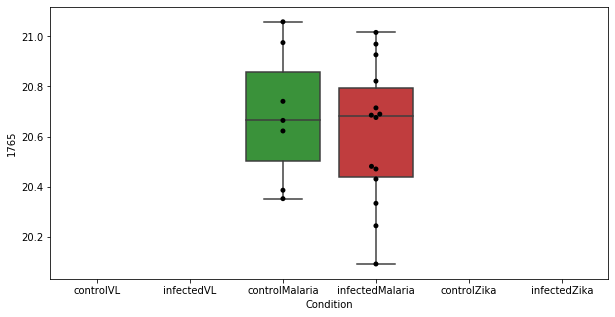

1203 row m/z                176.128
row retention time     10.6068
p-val                 0.592266
adj.P.Val             0.956493
custom_id                 1148
compound_names             NaN
Name: 1148, dtype: object


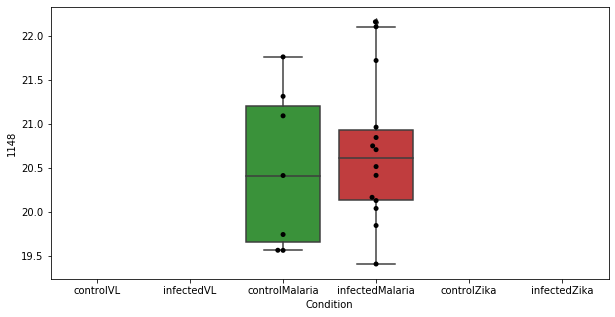

1204 row m/z                                                         130.086
row retention time                                              7.00236
p-val                                                          0.592614
adj.P.Val                                                      0.956493
custom_id                                                          3250
compound_names        N-Acetyl-L-glutamate 5-semialdehyde; 2-Acetami...
Name: 3250, dtype: object


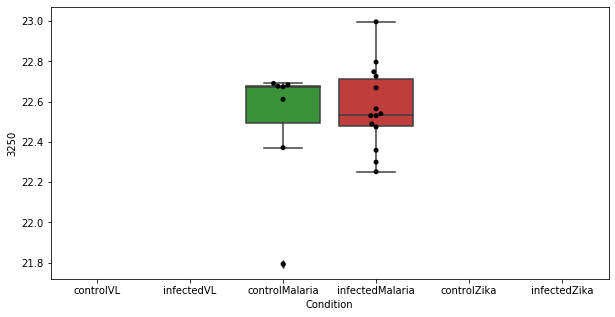

1205 row m/z                358.918
row retention time     12.0131
p-val                 0.592713
adj.P.Val             0.956493
custom_id                 5196
compound_names             NaN
Name: 5196, dtype: object


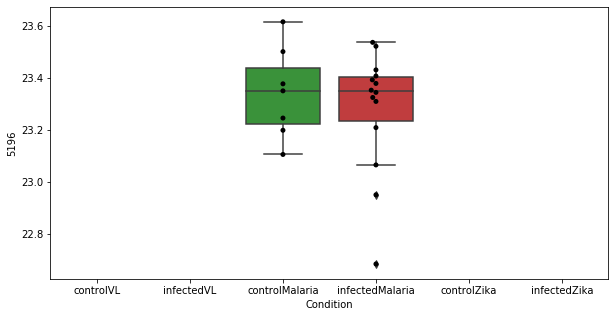

1206 row m/z                 281.82
row retention time     23.6653
p-val                 0.594249
adj.P.Val             0.956493
custom_id                 2146
compound_names             NaN
Name: 2146, dtype: object


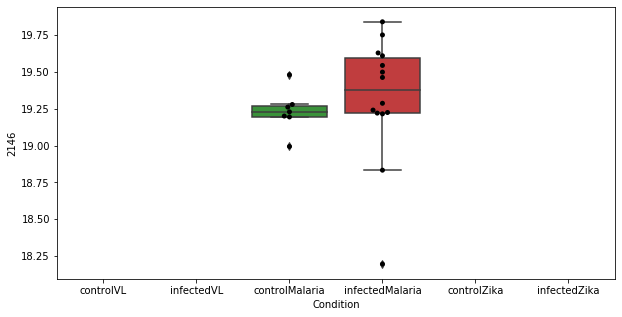

1207 row m/z                216.058
row retention time     9.92011
p-val                 0.594315
adj.P.Val             0.956493
custom_id                 3698
compound_names             NaN
Name: 3698, dtype: object


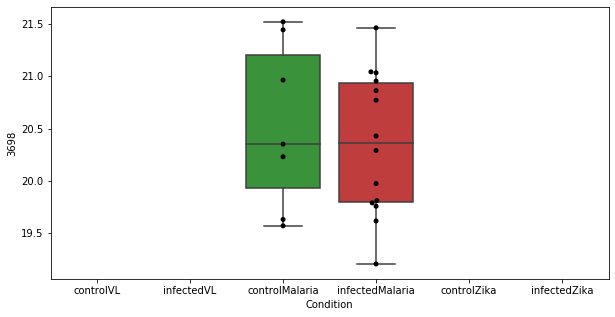

1208 row m/z                                                         142.086
row retention time                                               4.5957
p-val                                                           0.59452
adj.P.Val                                                      0.956493
custom_id                                                           666
compound_names        6-Acetamido-2-oxohexanoate; 2-Oxo-6-acetamidoc...
Name: 666, dtype: object


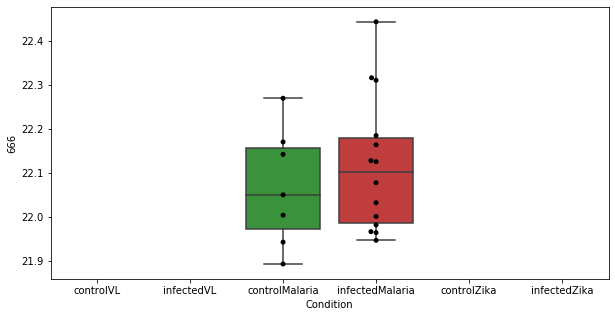

1209 row m/z                300.202
row retention time     4.54985
p-val                 0.596431
adj.P.Val             0.956493
custom_id                 2249
compound_names             NaN
Name: 2249, dtype: object


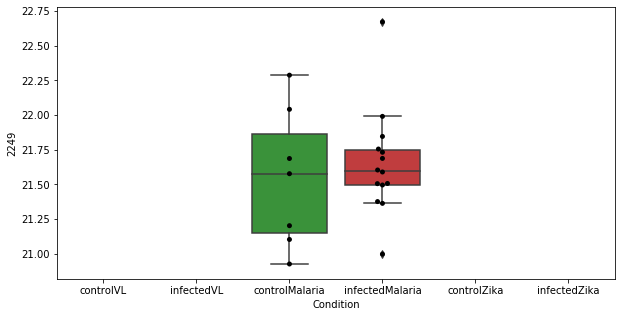

1210 row m/z                809.587
row retention time     3.48982
p-val                 0.596772
adj.P.Val             0.956493
custom_id                 2942
compound_names             NaN
Name: 2942, dtype: object


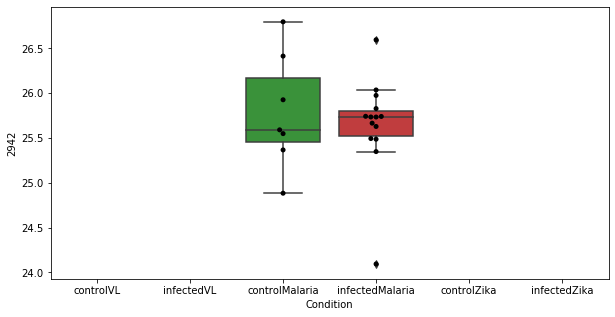

1211 row m/z                114.034
row retention time     8.90342
p-val                 0.597085
adj.P.Val             0.956493
custom_id                 3146
compound_names             NaN
Name: 3146, dtype: object


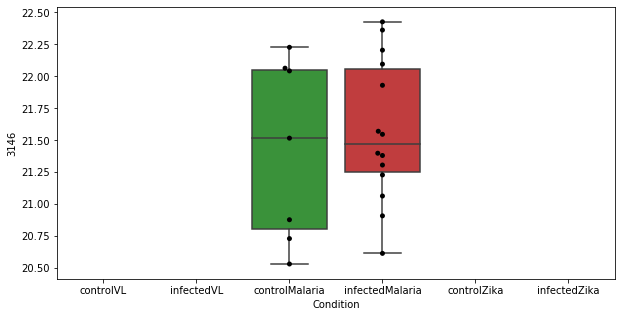

1212 row m/z                234.918
row retention time     23.7414
p-val                 0.597521
adj.P.Val             0.956493
custom_id                 1763
compound_names             NaN
Name: 1763, dtype: object


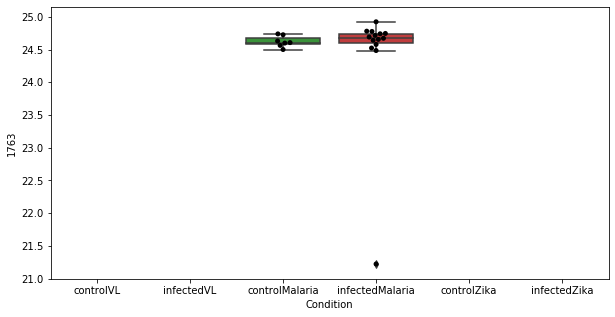

1213 row m/z                          131.118
row retention time               23.0536
p-val                           0.597539
adj.P.Val                       0.956493
custom_id                            536
compound_names        N-Acetylputrescine
Name: 536, dtype: object


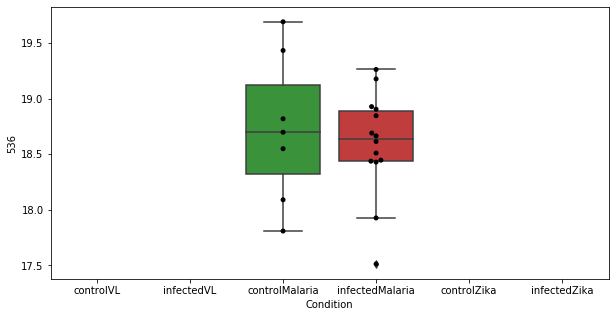

1214 row m/z                401.247
row retention time     23.4125
p-val                 0.597647
adj.P.Val             0.956493
custom_id                 2519
compound_names             NaN
Name: 2519, dtype: object


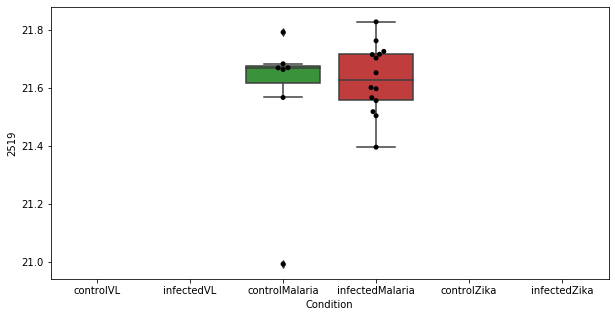

1215 row m/z                188.909
row retention time     12.5119
p-val                 0.601525
adj.P.Val             0.956493
custom_id                 1286
compound_names             NaN
Name: 1286, dtype: object


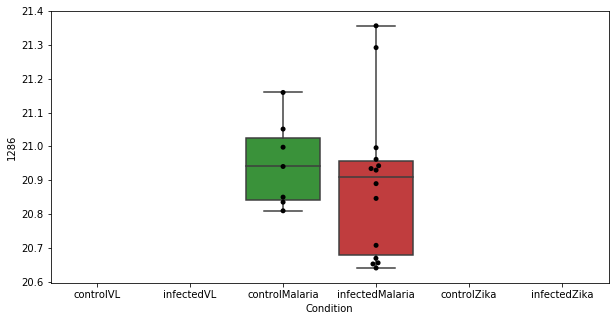

1216 row m/z                144.982
row retention time     23.6833
p-val                 0.601708
adj.P.Val             0.956493
custom_id                  710
compound_names             NaN
Name: 710, dtype: object


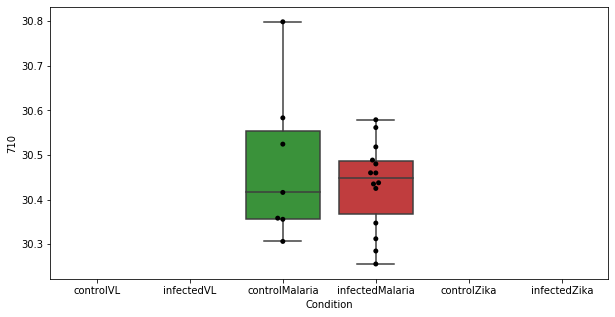

1217 row m/z                304.212
row retention time     4.63337
p-val                 0.601972
adj.P.Val             0.956493
custom_id                 4039
compound_names             NaN
Name: 4039, dtype: object


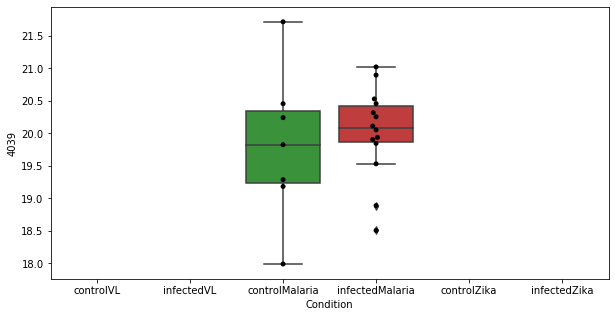

1218 row m/z                334.108
row retention time     3.68322
p-val                 0.602315
adj.P.Val             0.956493
custom_id                 4100
compound_names             NaN
Name: 4100, dtype: object


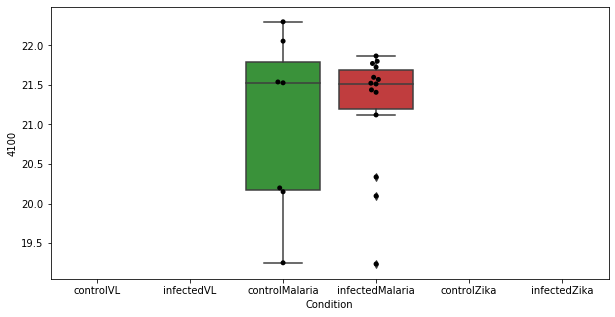

1219 row m/z                260.185
row retention time     3.92688
p-val                 0.602551
adj.P.Val             0.956493
custom_id                 1978
compound_names             NaN
Name: 1978, dtype: object


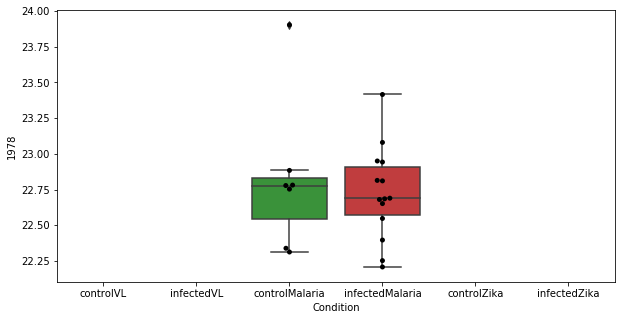

1220 row m/z                694.847
row retention time     11.9202
p-val                  0.60303
adj.P.Val             0.956493
custom_id                 2819
compound_names             NaN
Name: 2819, dtype: object


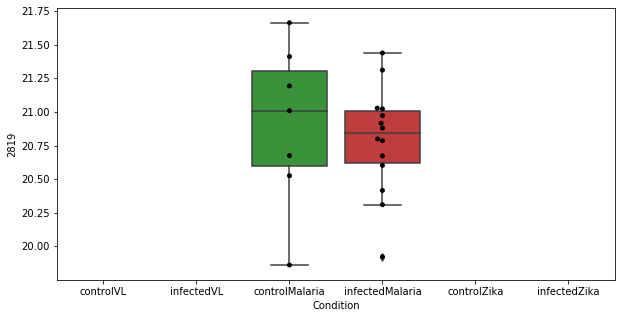

1221 row m/z                141.114
row retention time     9.44292
p-val                 0.603273
adj.P.Val             0.956493
custom_id                  660
compound_names             NaN
Name: 660, dtype: object


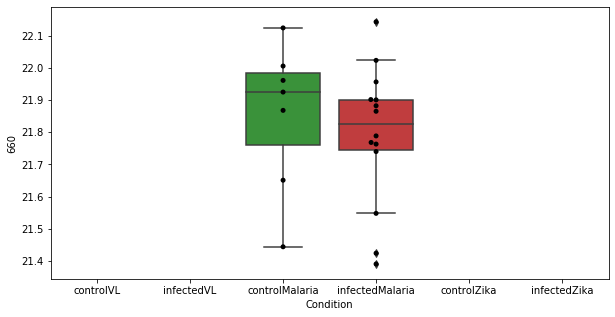

1222 row m/z                543.326
row retention time     4.07535
p-val                 0.603358
adj.P.Val             0.956493
custom_id                 2683
compound_names             NaN
Name: 2683, dtype: object


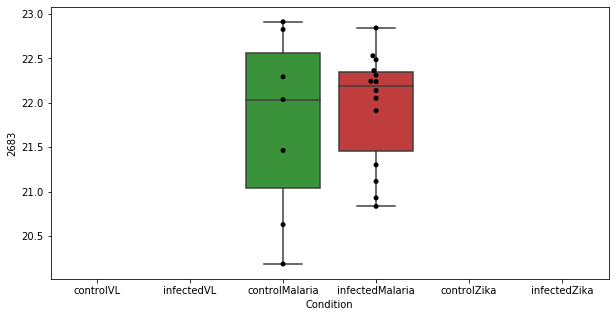

1223 row m/z                703.574
row retention time     6.66297
p-val                 0.603406
adj.P.Val             0.956493
custom_id                 2824
compound_names             NaN
Name: 2824, dtype: object


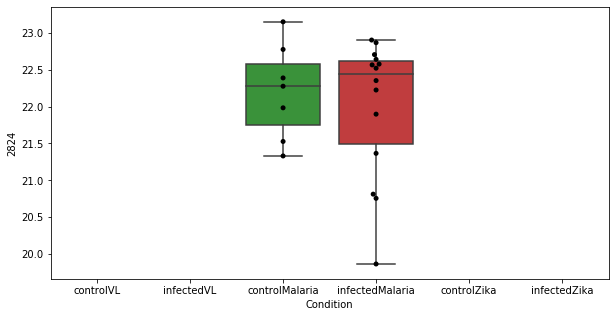

1224 row m/z                 717.59
row retention time      3.7627
p-val                  0.60363
adj.P.Val             0.956493
custom_id                 4257
compound_names             NaN
Name: 4257, dtype: object


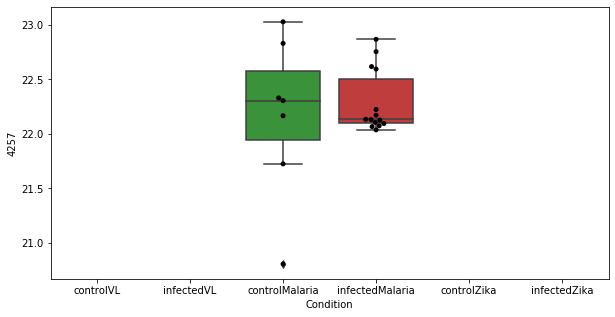

1225 row m/z                758.569
row retention time     3.52129
p-val                 0.604648
adj.P.Val             0.956493
custom_id                 2866
compound_names             NaN
Name: 2866, dtype: object


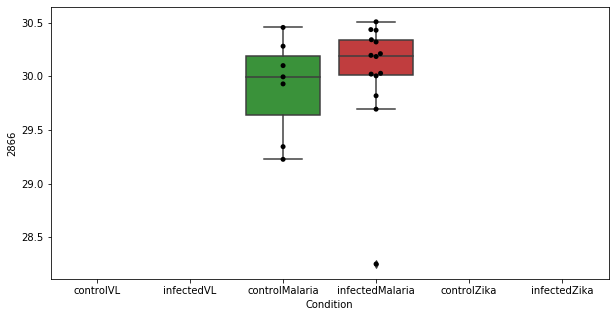

1226 row m/z                                                        136.043
row retention time                                             10.4785
p-val                                                         0.604826
adj.P.Val                                                     0.956493
custom_id                                                          597
compound_names        L-Homocysteine; L-2-Amino-4-mercaptobutyric acid
Name: 597, dtype: object


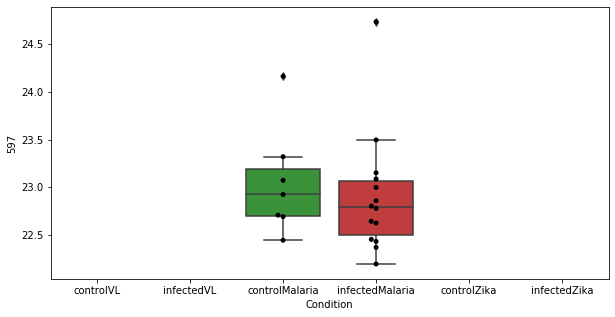

1227 row m/z                215.125
row retention time     6.73936
p-val                 0.604924
adj.P.Val             0.956493
custom_id                 1592
compound_names             NaN
Name: 1592, dtype: object


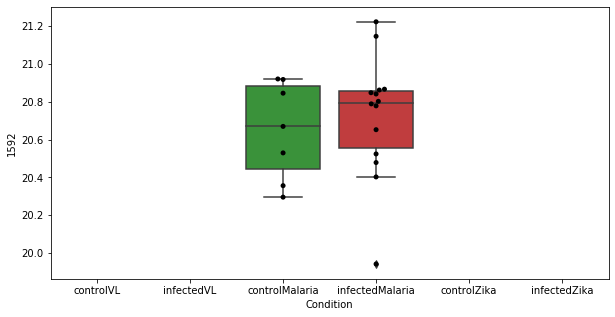

1228 row m/z                327.381
row retention time     5.33532
p-val                 0.604983
adj.P.Val             0.956493
custom_id                 4078
compound_names             NaN
Name: 4078, dtype: object


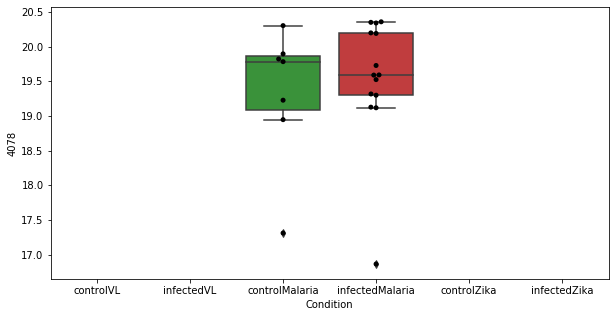

1229 row m/z                82.0526
row retention time     23.9527
p-val                 0.605652
adj.P.Val             0.956493
custom_id                 4345
compound_names             NaN
Name: 4345, dtype: object


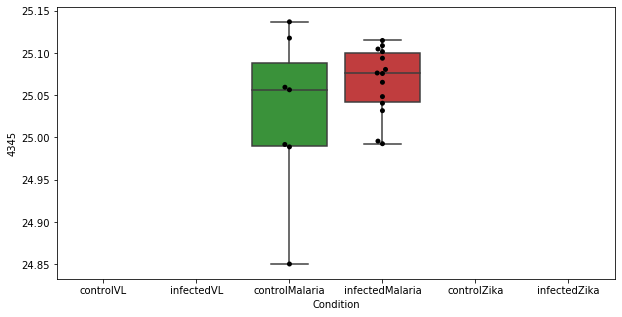

1230 row m/z                356.191
row retention time     3.71926
p-val                  0.60619
adj.P.Val             0.956493
custom_id                 2430
compound_names             NaN
Name: 2430, dtype: object


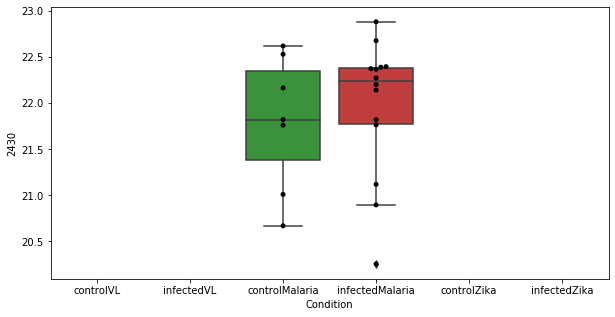

1231 row m/z                781.556
row retention time        3.53
p-val                 0.606393
adj.P.Val             0.956493
custom_id                 2897
compound_names             NaN
Name: 2897, dtype: object


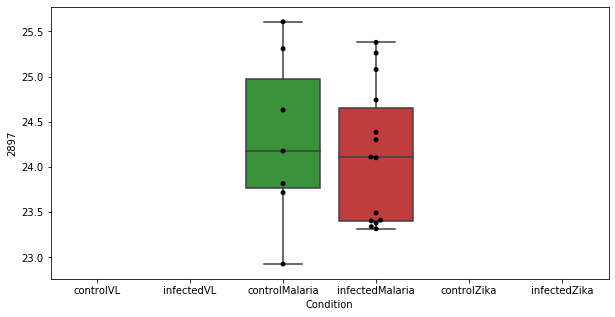

1232 row m/z                82.9448
row retention time     12.5052
p-val                  0.60727
adj.P.Val             0.956493
custom_id                   48
compound_names             NaN
Name: 48, dtype: object


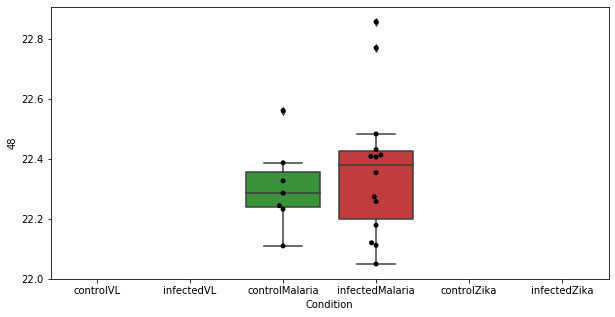

1233 row m/z                190.954
row retention time     11.9619
p-val                 0.607802
adj.P.Val             0.956493
custom_id                 4834
compound_names             NaN
Name: 4834, dtype: object


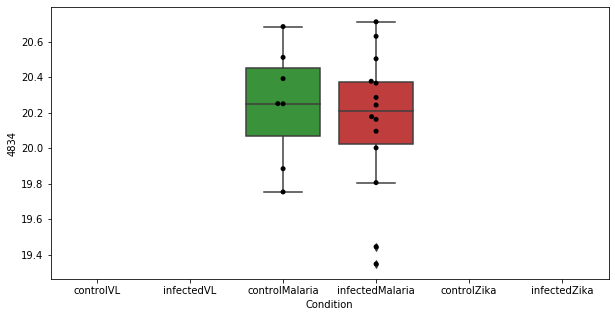

1234 row m/z                240.142
row retention time     4.55881
p-val                 0.609078
adj.P.Val             0.956493
custom_id                 1830
compound_names             NaN
Name: 1830, dtype: object


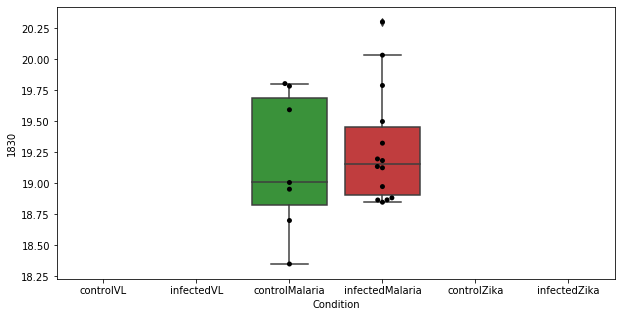

1235 row m/z                614.775
row retention time     9.00395
p-val                 0.609609
adj.P.Val             0.956493
custom_id                 2757
compound_names             NaN
Name: 2757, dtype: object


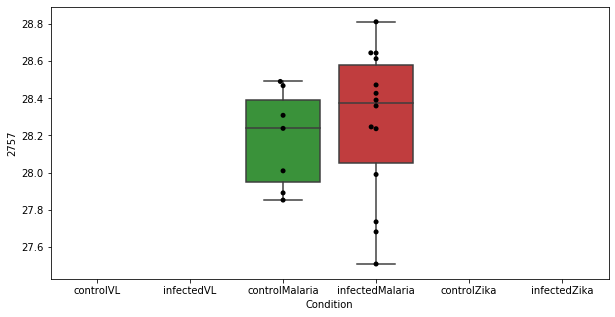

1236 row m/z                                                         183.085
row retention time                                              11.2885
p-val                                                          0.610488
adj.P.Val                                                      0.956493
custom_id                                                          1217
compound_names        L-Tyrosine; (S)-3-(p-Hydroxyphenyl)alanine; (S...
Name: 1217, dtype: object


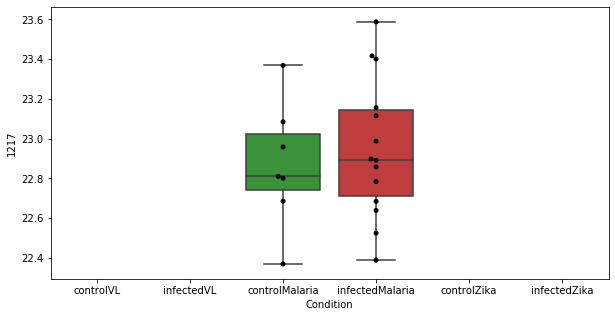

1237 row m/z                344.228
row retention time      4.4587
p-val                 0.610773
adj.P.Val             0.956493
custom_id                 2412
compound_names             NaN
Name: 2412, dtype: object


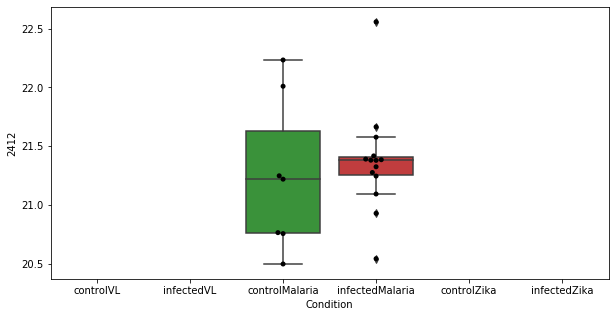

1238 row m/z                              343.19
row retention time                  9.62324
p-val                              0.610992
adj.P.Val                          0.956493
custom_id                              5183
compound_names        Ubiquinol; QH2; CoQH2
Name: 5183, dtype: object


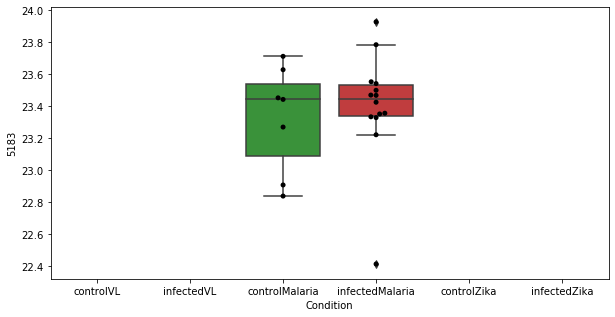

1239 row m/z                127.073
row retention time     2.66317
p-val                 0.611447
adj.P.Val             0.956493
custom_id                  451
compound_names             NaN
Name: 451, dtype: object


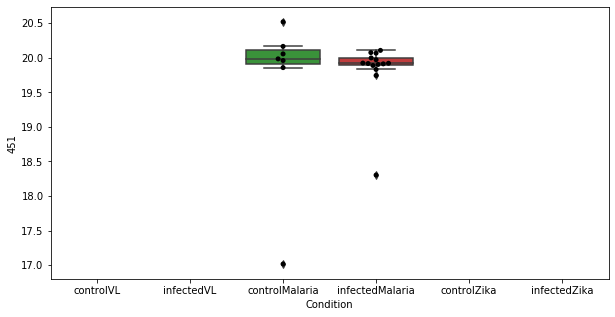

1240 row m/z                326.378
row retention time     5.29477
p-val                 0.611686
adj.P.Val             0.956493
custom_id                 4075
compound_names             NaN
Name: 4075, dtype: object


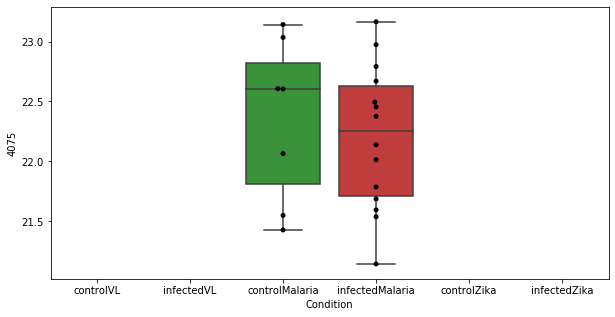

1241 row m/z                283.158
row retention time     4.04739
p-val                 0.611839
adj.P.Val             0.956493
custom_id                 2152
compound_names             NaN
Name: 2152, dtype: object


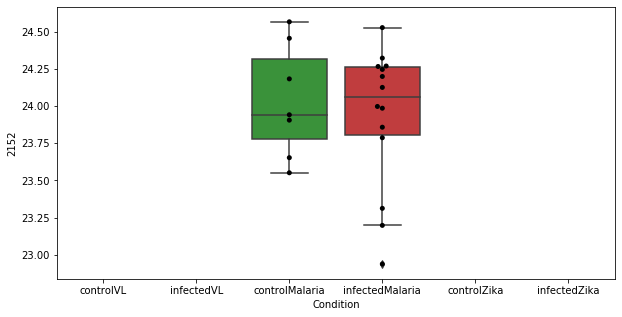

1242 row m/z                 276.18
row retention time      3.8829
p-val                 0.612013
adj.P.Val             0.956493
custom_id                 2109
compound_names             NaN
Name: 2109, dtype: object


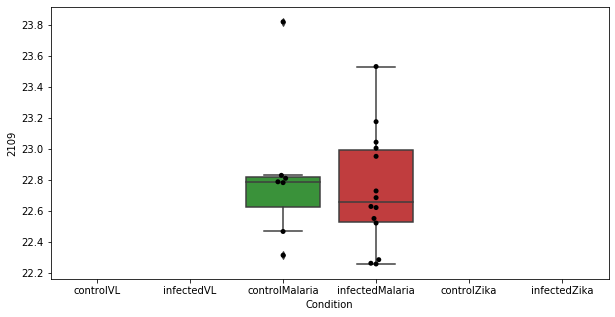

1243 row m/z                276.144
row retention time     10.7009
p-val                 0.612154
adj.P.Val             0.956493
custom_id                 2101
compound_names             NaN
Name: 2101, dtype: object


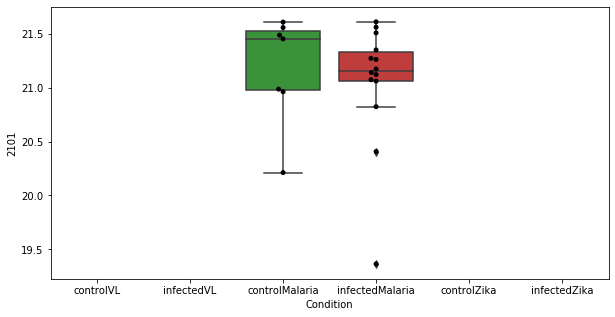

1244 row m/z                619.491
row retention time     3.18959
p-val                 0.613089
adj.P.Val             0.956493
custom_id                 2764
compound_names             NaN
Name: 2764, dtype: object


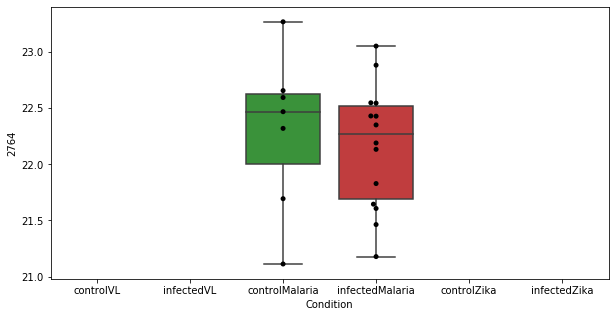

1245 row m/z                774.598
row retention time     3.51514
p-val                 0.613194
adj.P.Val             0.956493
custom_id                 2886
compound_names             NaN
Name: 2886, dtype: object


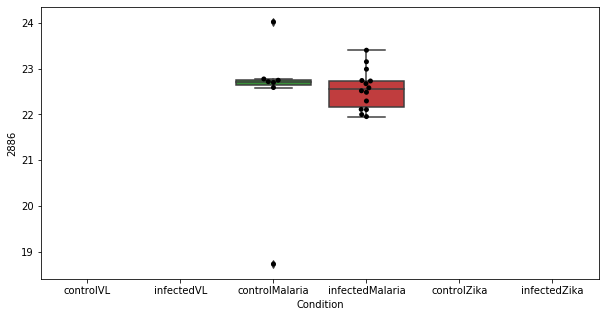

1246 row m/z                734.569
row retention time     3.54802
p-val                 0.614341
adj.P.Val             0.956493
custom_id                 2847
compound_names             NaN
Name: 2847, dtype: object


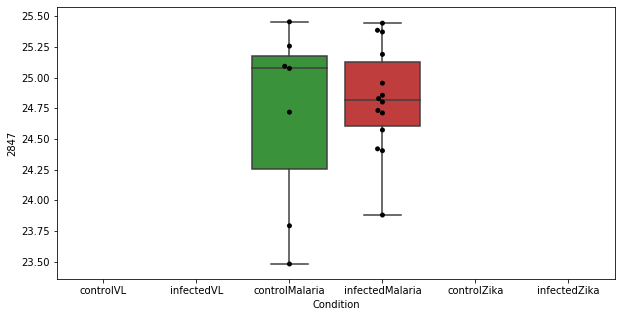

1247 row m/z                837.618
row retention time     3.46875
p-val                 0.614525
adj.P.Val             0.956493
custom_id                 2969
compound_names             NaN
Name: 2969, dtype: object


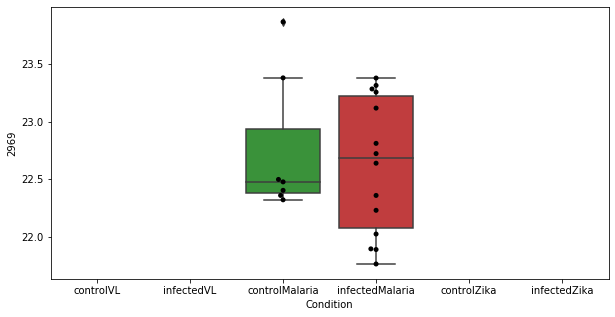

1248 row m/z                402.882
row retention time     13.0851
p-val                 0.614576
adj.P.Val             0.956493
custom_id                 2525
compound_names             NaN
Name: 2525, dtype: object


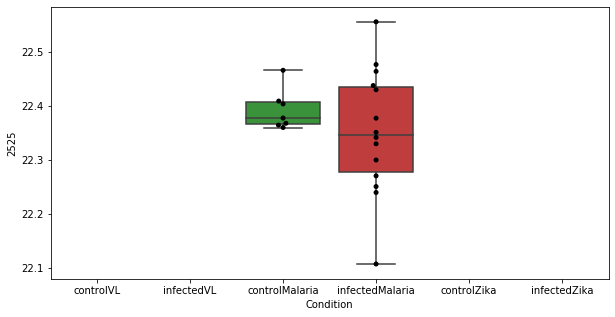

1249 row m/z                415.776
row retention time     23.4702
p-val                 0.614591
adj.P.Val             0.956493
custom_id                 2551
compound_names             NaN
Name: 2551, dtype: object


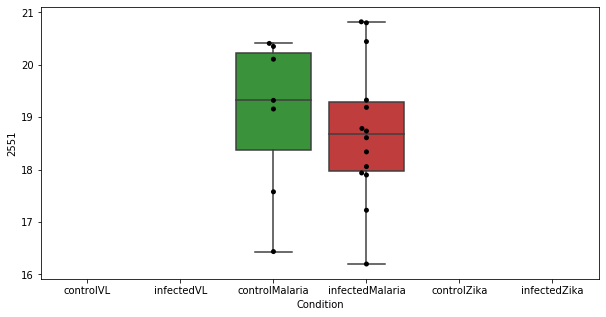

1250 row m/z                189.025
row retention time     23.7538
p-val                 0.614594
adj.P.Val             0.956493
custom_id                 1288
compound_names             NaN
Name: 1288, dtype: object


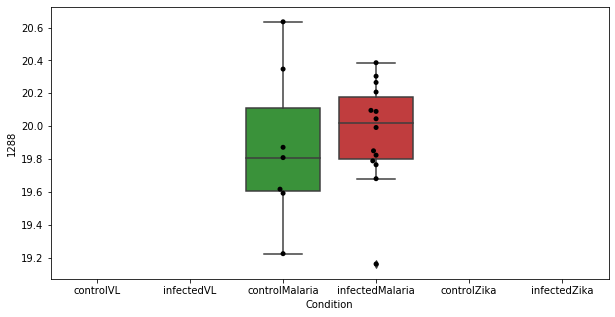

1251 row m/z                186.009
row retention time     23.6772
p-val                 0.614798
adj.P.Val             0.956493
custom_id                 1250
compound_names             NaN
Name: 1250, dtype: object


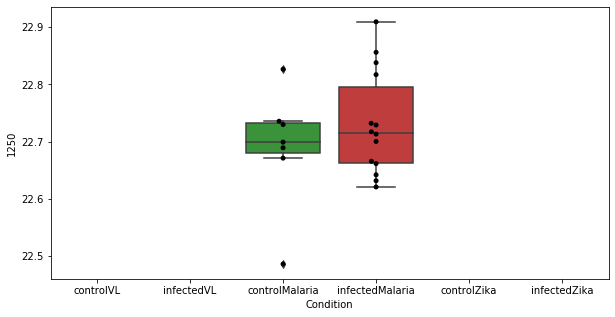

1252 row m/z                211.173
row retention time     4.39754
p-val                 0.615287
adj.P.Val             0.956493
custom_id                 1542
compound_names             NaN
Name: 1542, dtype: object


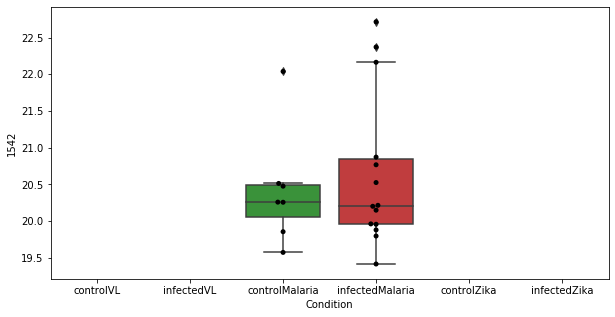

1253 row m/z                315.158
row retention time     11.3086
p-val                 0.615414
adj.P.Val             0.956493
custom_id                 5151
compound_names             NaN
Name: 5151, dtype: object


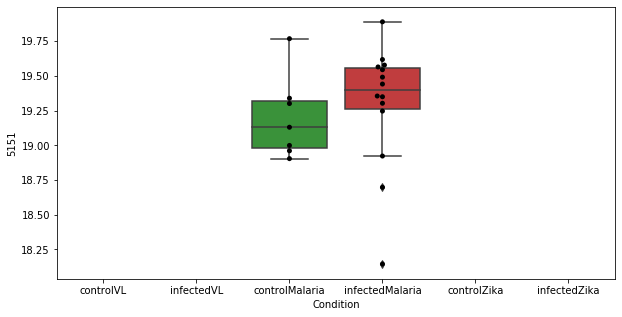

1254 row m/z                171.993
row retention time     23.6646
p-val                 0.617174
adj.P.Val             0.958049
custom_id                 1088
compound_names             NaN
Name: 1088, dtype: object


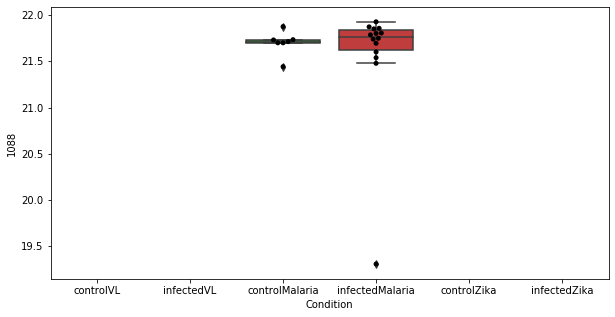

1255 row m/z                 278.16
row retention time     4.13066
p-val                  0.61782
adj.P.Val             0.958049
custom_id                 2130
compound_names             NaN
Name: 2130, dtype: object


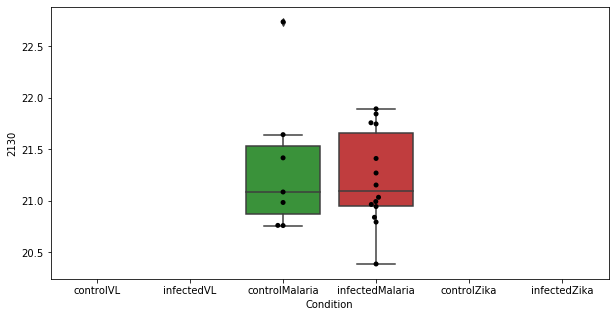

1256 row m/z                308.886
row retention time     11.5242
p-val                  0.61789
adj.P.Val             0.958049
custom_id                 2282
compound_names             NaN
Name: 2282, dtype: object


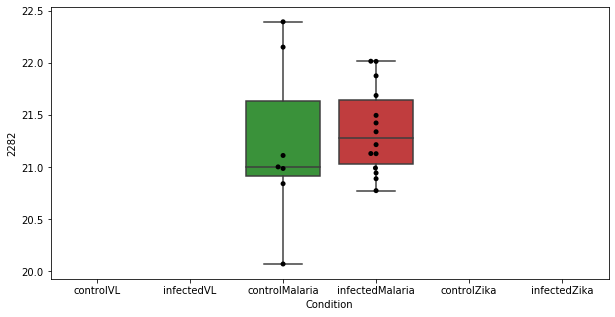

1257 row m/z                                                         169.058
row retention time                                              12.3122
p-val                                                          0.619761
adj.P.Val                                                      0.960009
custom_id                                                          1040
compound_names        D-Glutamine; D-2-Aminoglutaramic acid$L-Glutam...
Name: 1040, dtype: object


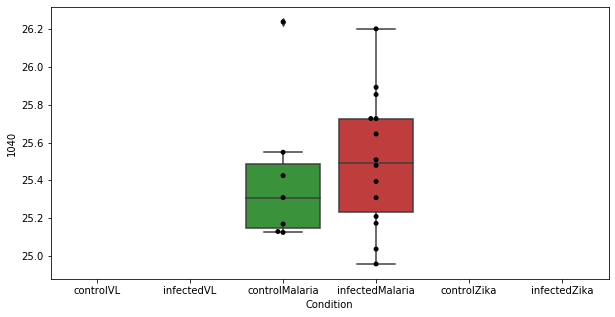

1258 row m/z                                                         264.108
row retention time                                              4.47499
p-val                                                          0.620139
adj.P.Val                                                      0.960009
custom_id                                                          1996
compound_names        Tetrahydrobiopterin; 5,6,7,8-Tetrahydrobiopter...
Name: 1996, dtype: object


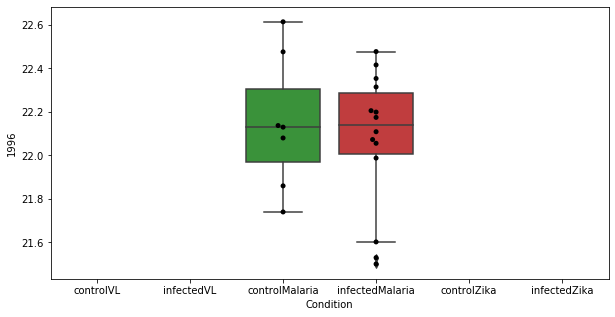

1259 row m/z                398.165
row retention time     14.0245
p-val                 0.622136
adj.P.Val             0.960434
custom_id                 4171
compound_names             NaN
Name: 4171, dtype: object


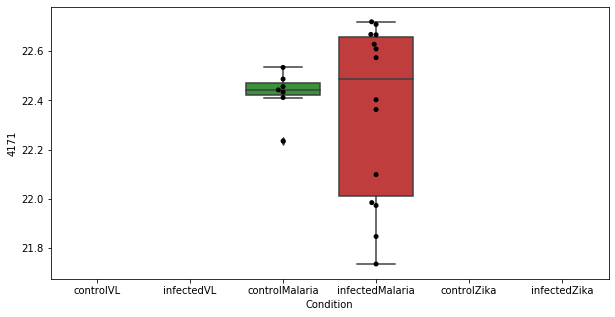

1260 row m/z                                                         280.235
row retention time                                              3.25042
p-val                                                          0.622591
adj.P.Val                                                      0.960434
custom_id                                                          3970
compound_names        (9Z,12Z,15Z)-Octadecatrienoic acid; alpha-Lino...
Name: 3970, dtype: object


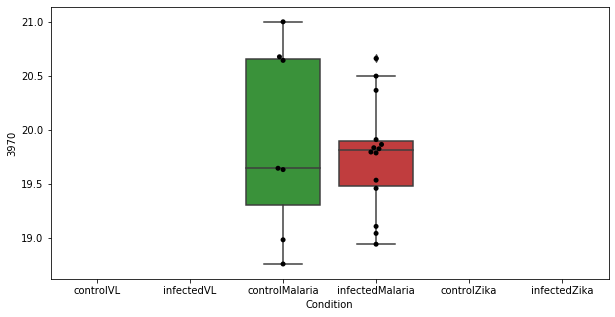

1261 row m/z                190.954
row retention time     12.8659
p-val                 0.623226
adj.P.Val             0.960434
custom_id                 1322
compound_names             NaN
Name: 1322, dtype: object


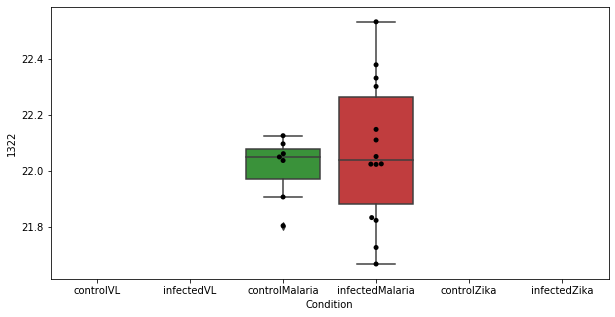

1262 row m/z                197.154
row retention time     3.87139
p-val                 0.623456
adj.P.Val             0.960434
custom_id                 1412
compound_names             NaN
Name: 1412, dtype: object


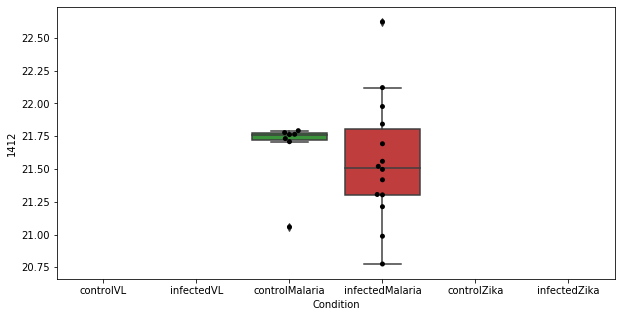

1263 row m/z                                                          148.06
row retention time                                              3.87434
p-val                                                          0.624283
adj.P.Val                                                      0.960434
custom_id                                                           777
compound_names        L-4-Hydroxyglutamate semialdehyde$D-Glutamate;...
Name: 777, dtype: object


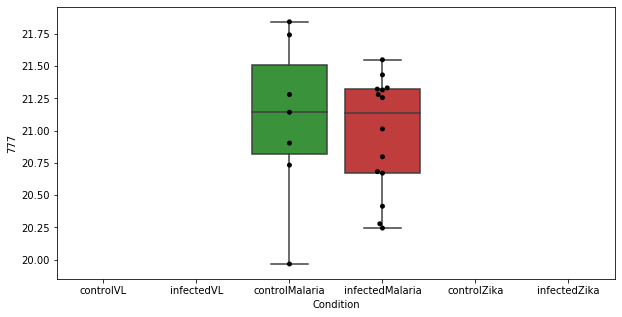

1264 row m/z                182.139
row retention time     4.48609
p-val                  0.62441
adj.P.Val             0.960434
custom_id                 1208
compound_names             NaN
Name: 1208, dtype: object


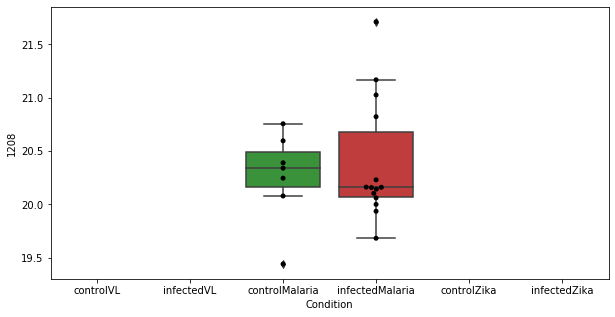

1265 row m/z                152.948
row retention time     13.0684
p-val                 0.625191
adj.P.Val             0.960434
custom_id                  839
compound_names             NaN
Name: 839, dtype: object


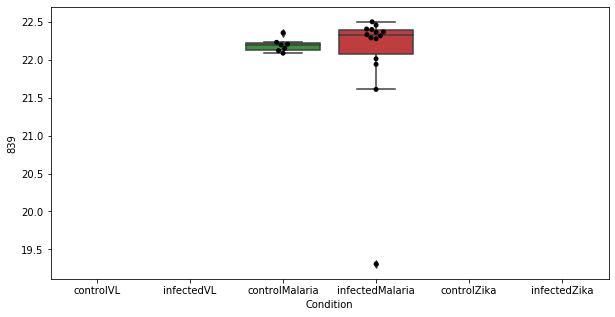

1266 row m/z                327.184
row retention time     4.13793
p-val                 0.625473
adj.P.Val             0.960434
custom_id                 2367
compound_names             NaN
Name: 2367, dtype: object


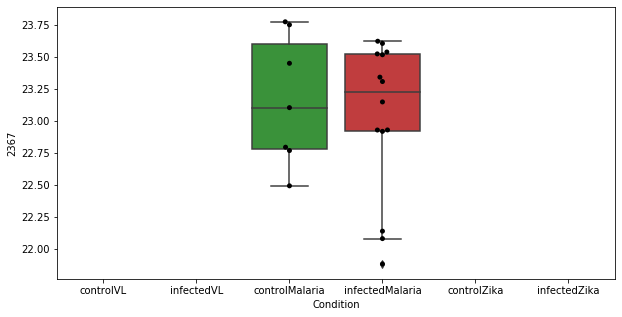

1267 row m/z                200.046
row retention time     10.1015
p-val                 0.625686
adj.P.Val             0.960434
custom_id                 1431
compound_names             NaN
Name: 1431, dtype: object


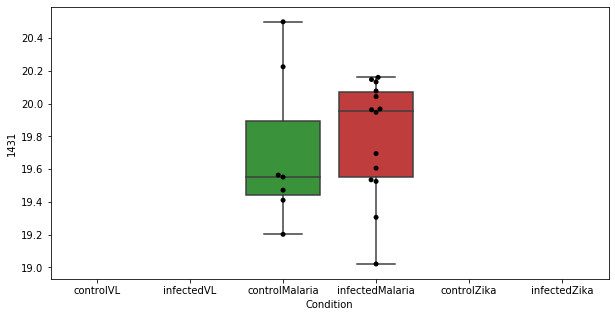

1268 row m/z                121.072
row retention time     10.0874
p-val                 0.626454
adj.P.Val             0.960434
custom_id                  389
compound_names             NaN
Name: 389, dtype: object


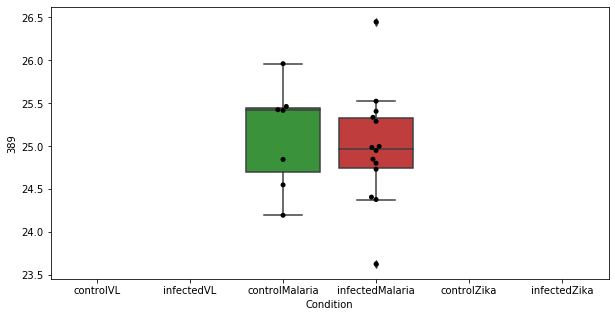

1269 row m/z                558.473
row retention time     3.28931
p-val                 0.626695
adj.P.Val             0.960434
custom_id                 2704
compound_names             NaN
Name: 2704, dtype: object


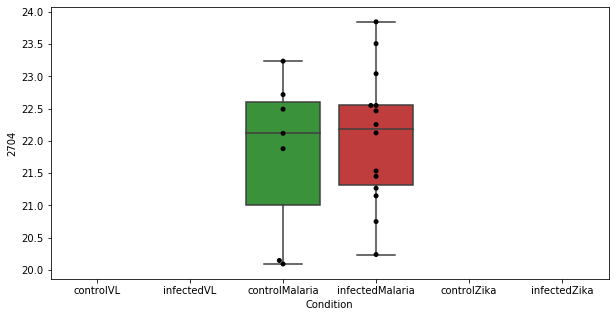

1270 row m/z                135.102
row retention time     4.45266
p-val                 0.627273
adj.P.Val             0.960434
custom_id                  596
compound_names             NaN
Name: 596, dtype: object


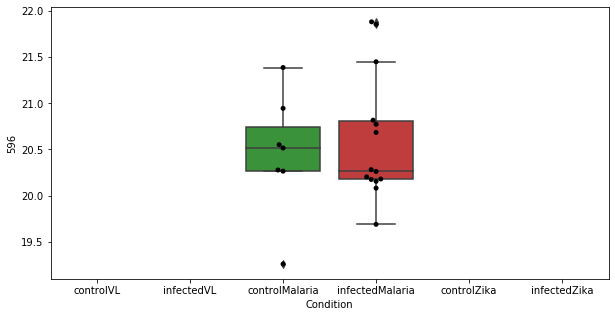

1271 row m/z                                                         183.102
row retention time                                              6.98796
p-val                                                          0.627852
adj.P.Val                                                      0.960434
custom_id                                                          1219
compound_names        Ecgonine methyl ester; Methyl ecgonine$ecgonin...
Name: 1219, dtype: object


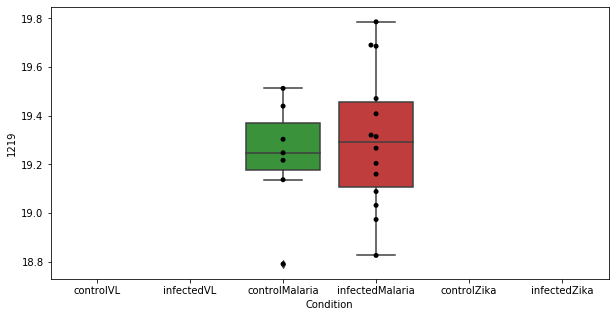

1272 row m/z                238.128
row retention time     4.14487
p-val                  0.62792
adj.P.Val             0.960434
custom_id                 1803
compound_names             NaN
Name: 1803, dtype: object


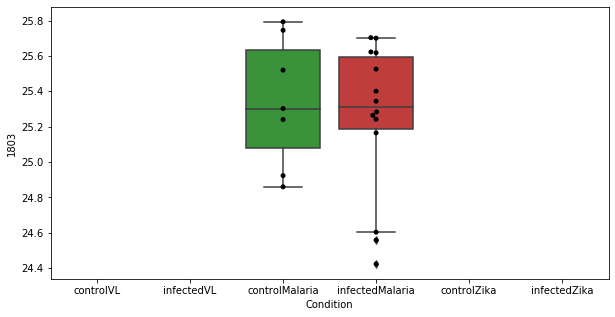

1273 row m/z                215.256
row retention time     7.20958
p-val                 0.627973
adj.P.Val             0.960434
custom_id                 1598
compound_names             NaN
Name: 1598, dtype: object


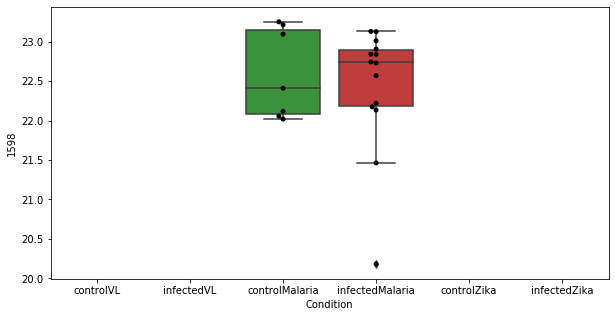

1274 row m/z                195.088
row retention time     4.57242
p-val                 0.629021
adj.P.Val             0.960434
custom_id                 1382
compound_names             NaN
Name: 1382, dtype: object


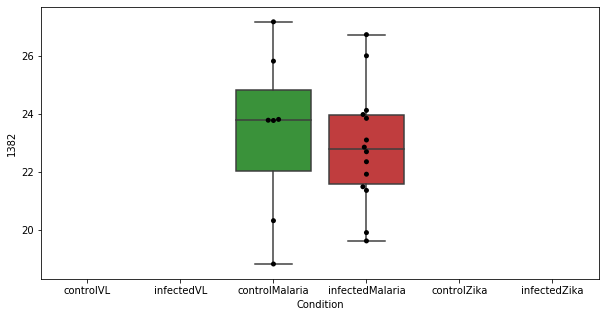

1275 row m/z                127.073
row retention time     10.4643
p-val                 0.629379
adj.P.Val             0.960434
custom_id                  450
compound_names             NaN
Name: 450, dtype: object


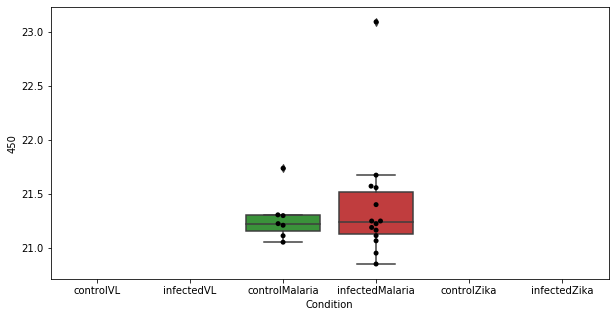

1276 row m/z                                                         105.074
row retention time                                              11.5766
p-val                                                          0.629769
adj.P.Val                                                      0.960434
custom_id                                                           180
compound_names        N,N-Dimethylglycine; Dimethylglycine$(R)-3-Ami...
Name: 180, dtype: object


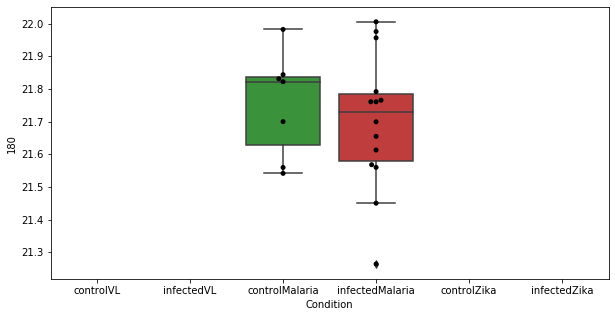

1277 row m/z                326.844
row retention time      23.795
p-val                 0.629776
adj.P.Val             0.960434
custom_id                 2360
compound_names             NaN
Name: 2360, dtype: object


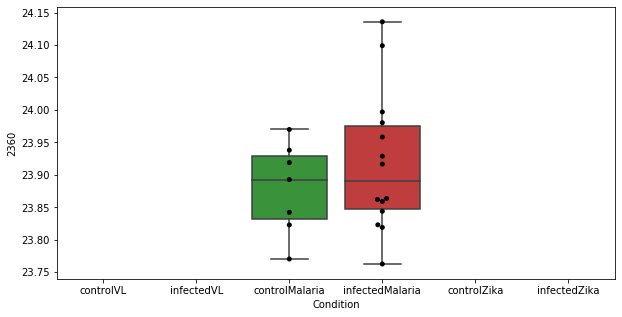

1278 row m/z                                                         188.092
row retention time                                              7.65311
p-val                                                          0.631272
adj.P.Val                                                      0.961962
custom_id                                                          1278
compound_names        6-Acetamido-2-oxohexanoate; 2-Oxo-6-acetamidoc...
Name: 1278, dtype: object


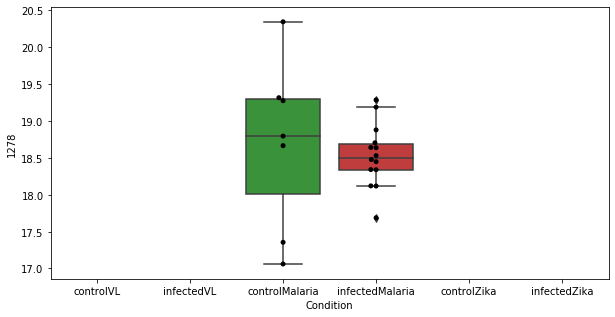

1279 row m/z                199.108
row retention time     7.06388
p-val                 0.631966
adj.P.Val             0.962267
custom_id                 5832
compound_names             NaN
Name: 5832, dtype: object


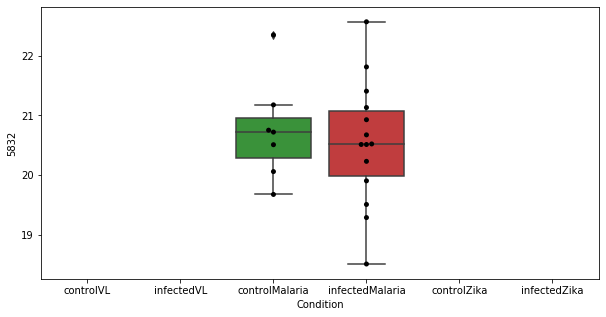

1280 row m/z                                         169.122
row retention time                              3.95888
p-val                                          0.633513
adj.P.Val                                      0.963437
custom_id                                          1047
compound_names        Perillyl aldehyde; Perillaldehyde
Name: 1047, dtype: object


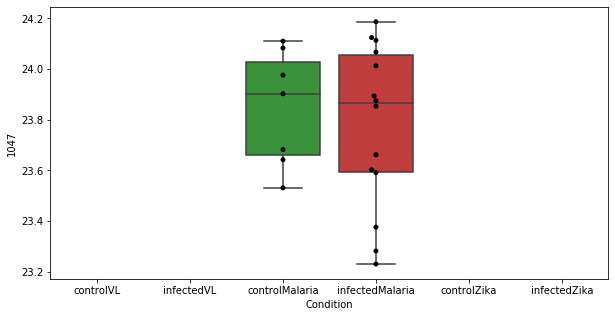

1281 row m/z                            400.342
row retention time                 4.02572
p-val                             0.633723
adj.P.Val                         0.963437
custom_id                             4175
compound_names        L-Palmitoylcarnitine
Name: 4175, dtype: object


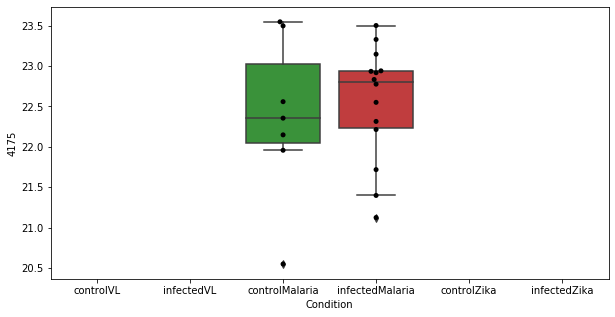

1282 row m/z                102.066
row retention time     10.0919
p-val                 0.634306
adj.P.Val             0.963571
custom_id                  147
compound_names             NaN
Name: 147, dtype: object


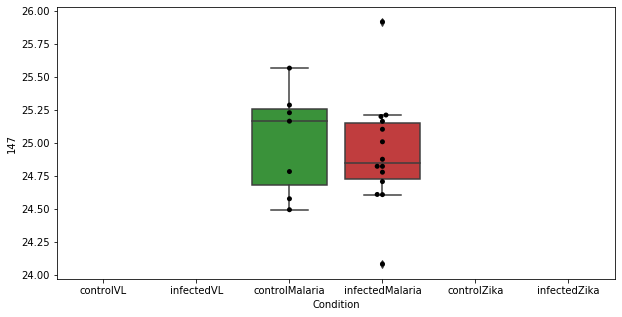

1283 row m/z                328.212
row retention time     3.73472
p-val                 0.636412
adj.P.Val             0.964932
custom_id                 4086
compound_names             NaN
Name: 4086, dtype: object


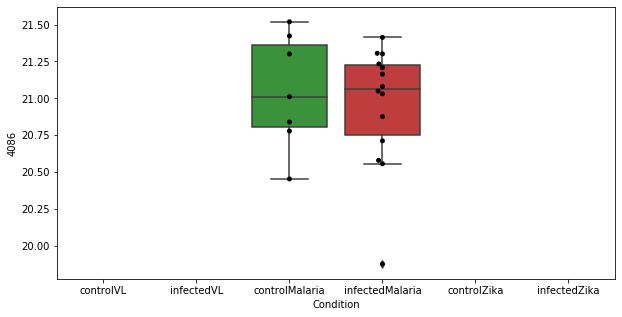

1284 row m/z                204.123
row retention time     4.57909
p-val                 0.637214
adj.P.Val             0.964932
custom_id                 1470
compound_names             NaN
Name: 1470, dtype: object


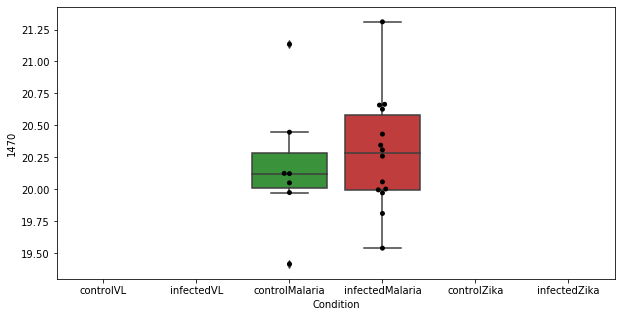

1285 row m/z                143.082
row retention time     10.7686
p-val                 0.637753
adj.P.Val             0.964932
custom_id                  681
compound_names             NaN
Name: 681, dtype: object


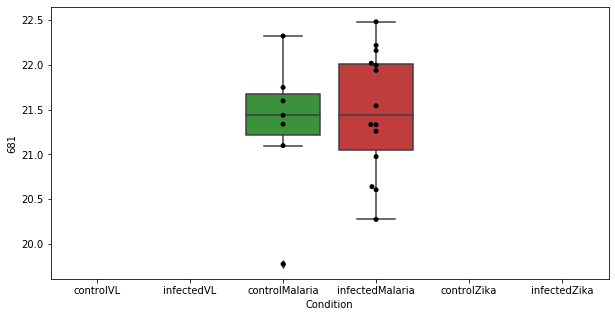

1286 row m/z                 276.18
row retention time     8.10288
p-val                 0.638386
adj.P.Val             0.964932
custom_id                 2110
compound_names             NaN
Name: 2110, dtype: object


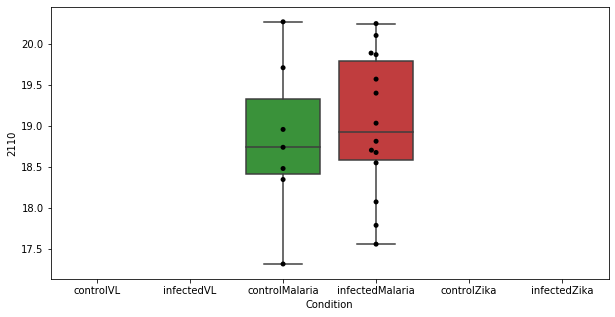

1287 row m/z                794.604
row retention time     3.48689
p-val                 0.638666
adj.P.Val             0.964932
custom_id                 2923
compound_names             NaN
Name: 2923, dtype: object


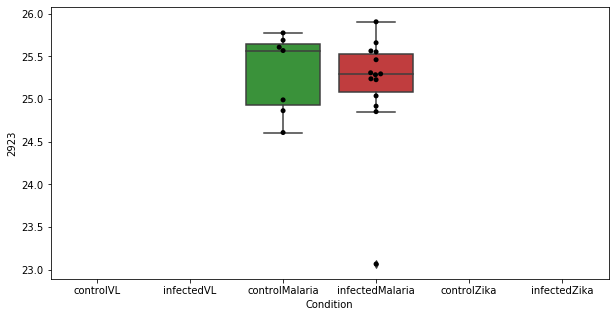

1288 row m/z                                      341.174
row retention time                           9.84213
p-val                                       0.638928
adj.P.Val                                   0.964932
custom_id                                       6155
compound_names        Ubiquinone; Coenzyme Q; CoQ; Q
Name: 6155, dtype: object


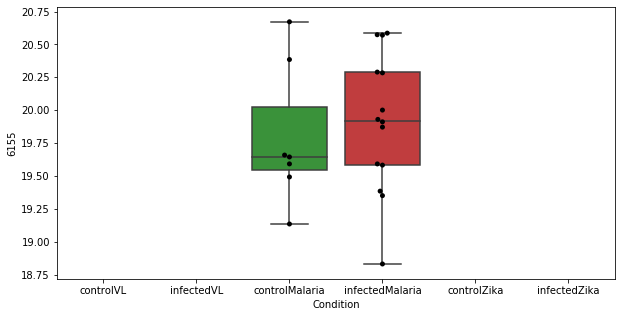

1289 row m/z                257.932
row retention time      14.368
p-val                  0.63906
adj.P.Val             0.964932
custom_id                 1970
compound_names             NaN
Name: 1970, dtype: object


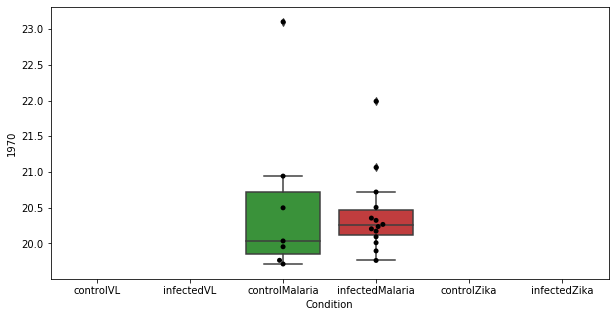

1290 row m/z                569.384
row retention time     4.66047
p-val                 0.639215
adj.P.Val             0.964932
custom_id                 2719
compound_names             NaN
Name: 2719, dtype: object


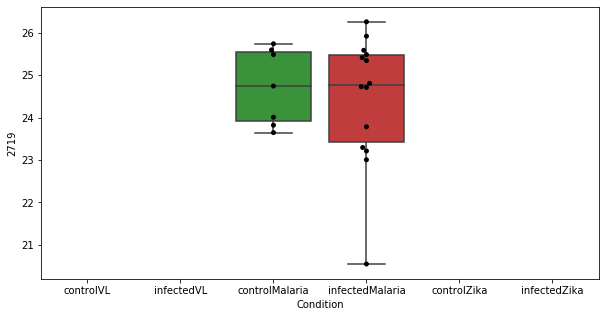

1291 row m/z                227.064
row retention time     8.53792
p-val                 0.639752
adj.P.Val             0.964932
custom_id                 1682
compound_names             NaN
Name: 1682, dtype: object


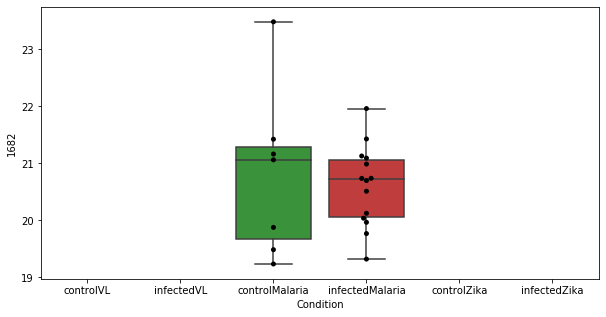

1292 row m/z                                                         151.062
row retention time                                              7.96868
p-val                                                          0.640172
adj.P.Val                                                      0.964932
custom_id                                                           824
compound_names        L-Xylulose; L-threo-Pentulose; L-Lyxulose$D-Xy...
Name: 824, dtype: object


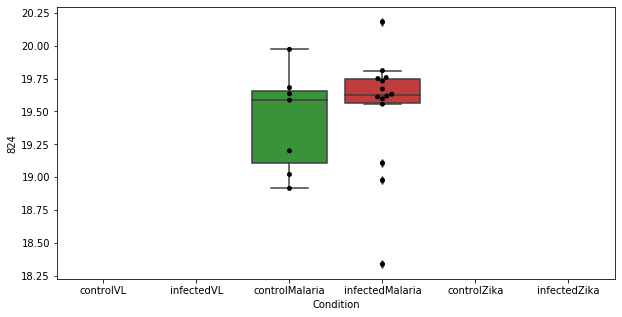

1293 row m/z                                                        148.097
row retention time                                             7.21858
p-val                                                         0.640852
adj.P.Val                                                     0.964932
custom_id                                                          784
compound_names        Pantothenate; Pantothenic acid; (R)-Pantothenate
Name: 784, dtype: object


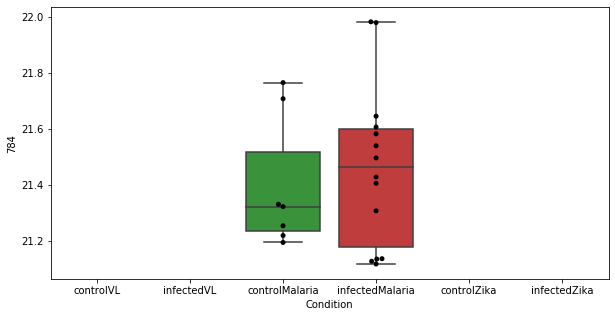

1294 row m/z                268.175
row retention time     3.70628
p-val                 0.641744
adj.P.Val             0.964932
custom_id                 2035
compound_names             NaN
Name: 2035, dtype: object


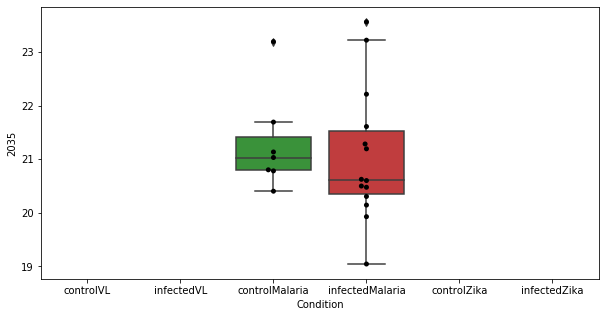

1295 row m/z                163.133
row retention time     9.53475
p-val                 0.642386
adj.P.Val             0.964932
custom_id                  975
compound_names             NaN
Name: 975, dtype: object


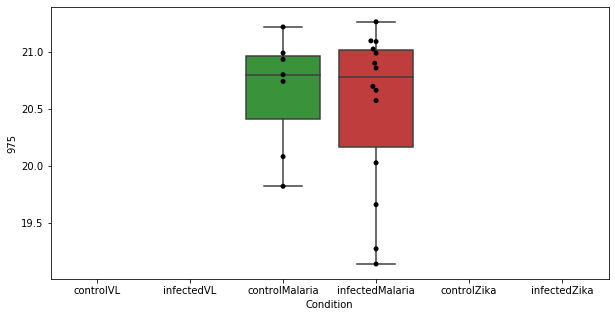

1296 row m/z                620.494
row retention time     3.19868
p-val                 0.642619
adj.P.Val             0.964932
custom_id                 2765
compound_names             NaN
Name: 2765, dtype: object


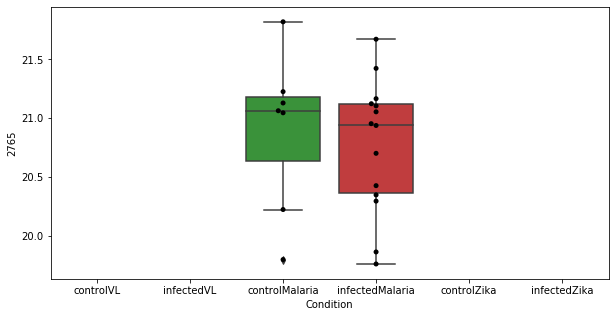

1297 row m/z                123.971
row retention time     12.5081
p-val                 0.642673
adj.P.Val             0.964932
custom_id                  432
compound_names             NaN
Name: 432, dtype: object


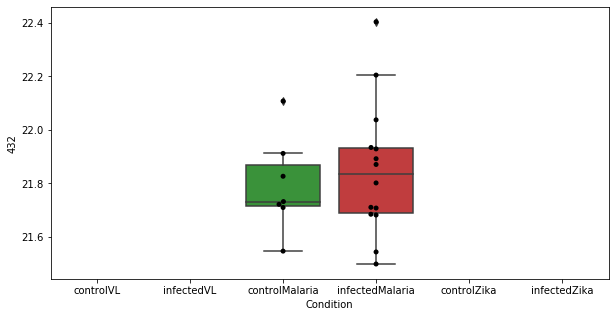

1298 row m/z                230.139
row retention time     3.93541
p-val                 0.644168
adj.P.Val             0.964932
custom_id                 1721
compound_names             NaN
Name: 1721, dtype: object


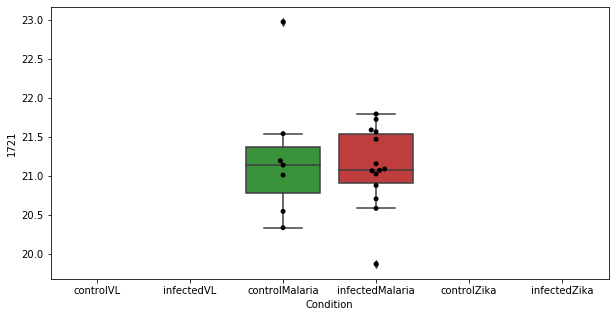

1299 row m/z                296.982
row retention time     11.2784
p-val                 0.646246
adj.P.Val             0.964932
custom_id                 2237
compound_names             NaN
Name: 2237, dtype: object


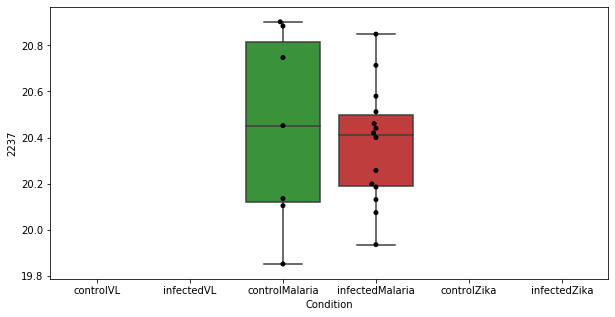

1300 row m/z                480.308
row retention time     3.99749
p-val                 0.646616
adj.P.Val             0.964932
custom_id                 2605
compound_names             NaN
Name: 2605, dtype: object


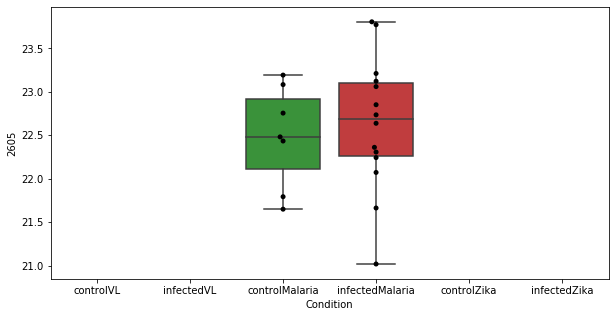

1301 row m/z                170.154
row retention time      7.6696
p-val                 0.646706
adj.P.Val             0.964932
custom_id                 1072
compound_names             NaN
Name: 1072, dtype: object


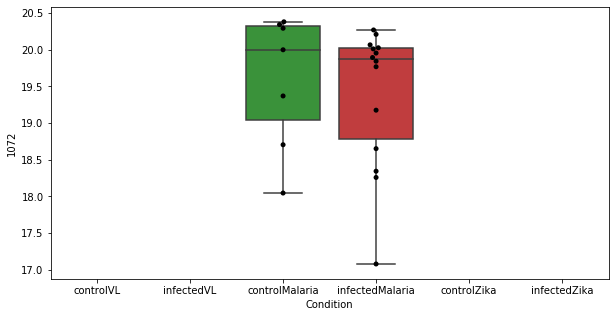

1302 row m/z                248.149
row retention time     4.25171
p-val                 0.646708
adj.P.Val             0.964932
custom_id                 1889
compound_names             NaN
Name: 1889, dtype: object


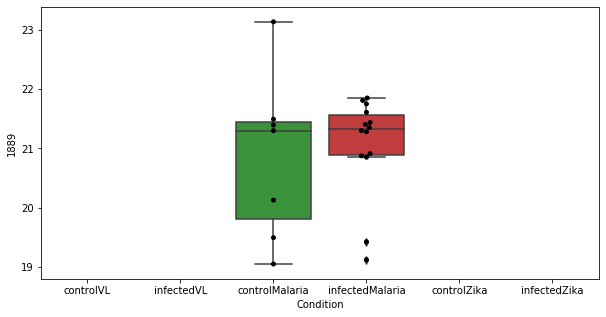

1303 row m/z                902.574
row retention time     3.27904
p-val                 0.647022
adj.P.Val             0.964932
custom_id                 2977
compound_names             NaN
Name: 2977, dtype: object


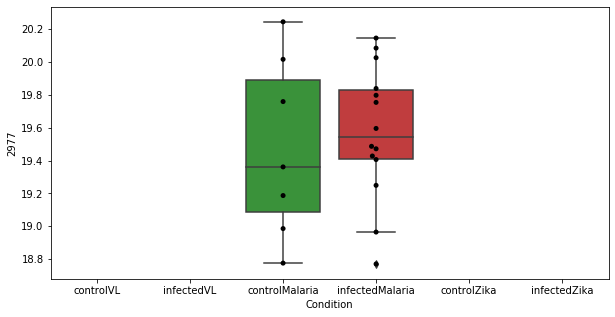

1304 row m/z                                                         157.061
row retention time                                              10.2004
p-val                                                          0.647409
adj.P.Val                                                      0.964932
custom_id                                                           876
compound_names        4-Imidazolone-5-propanoate; 4-Imidazolone-5-pr...
Name: 876, dtype: object


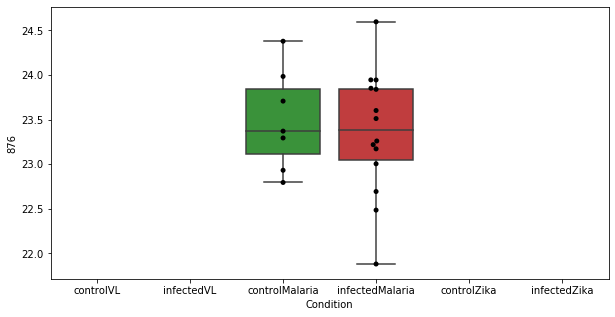

1305 row m/z                106.972
row retention time     12.8905
p-val                  0.64756
adj.P.Val             0.964932
custom_id                  208
compound_names             NaN
Name: 208, dtype: object


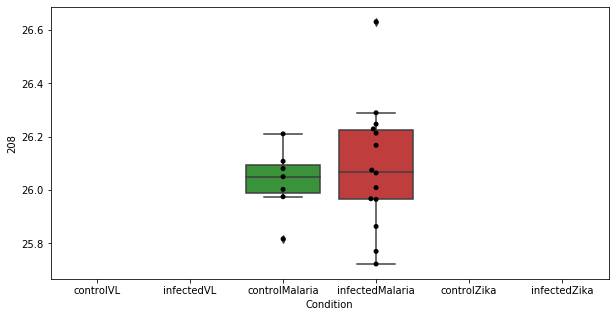

1306 row m/z                242.139
row retention time     4.51621
p-val                 0.647825
adj.P.Val             0.964932
custom_id                 1845
compound_names             NaN
Name: 1845, dtype: object


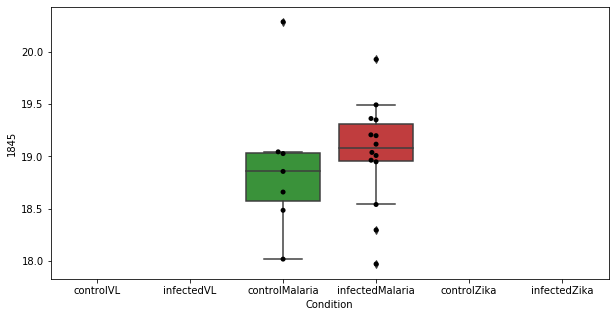

1307 row m/z                 172.08
row retention time     12.3118
p-val                 0.648923
adj.P.Val             0.964932
custom_id                 1093
compound_names             NaN
Name: 1093, dtype: object


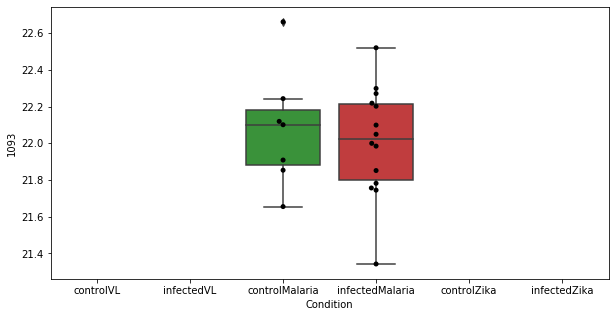

1308 row m/z                300.217
row retention time     3.69143
p-val                 0.649942
adj.P.Val             0.964932
custom_id                 2253
compound_names             NaN
Name: 2253, dtype: object


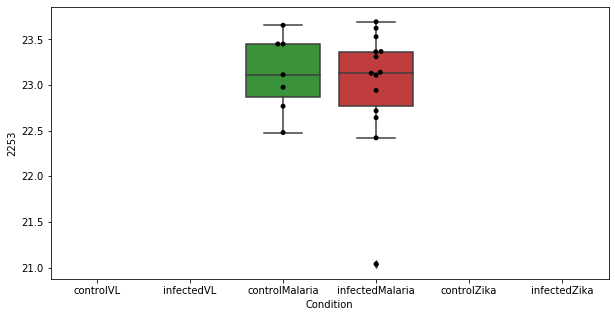

1309 row m/z                104.008
row retention time     12.8986
p-val                 0.650512
adj.P.Val             0.964932
custom_id                  159
compound_names             NaN
Name: 159, dtype: object


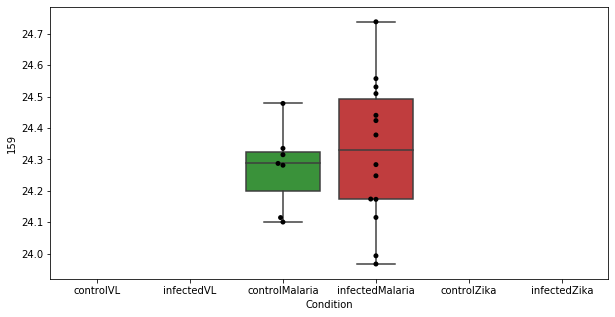

1310 row m/z                                                         256.165
row retention time                                              6.99084
p-val                                                          0.650805
adj.P.Val                                                      0.964932
custom_id                                                          3866
compound_names        3-oxo-6(S)-hydroxy-tetradec-8Z-enoate$3-oxo-6(...
Name: 3866, dtype: object


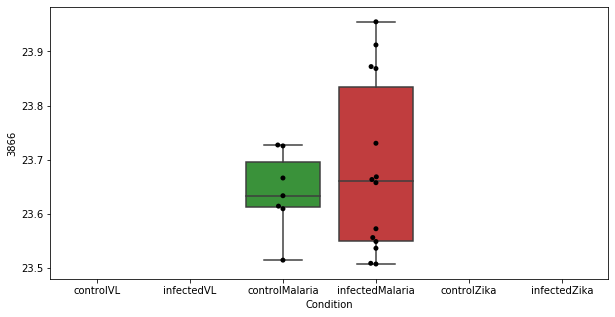

1311 row m/z                  318.9
row retention time     8.21654
p-val                 0.651205
adj.P.Val             0.964932
custom_id                 2334
compound_names             NaN
Name: 2334, dtype: object


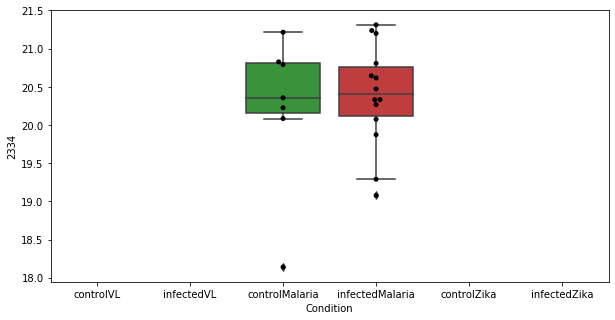

1312 row m/z                100.087
row retention time     23.1719
p-val                 0.651595
adj.P.Val             0.964932
custom_id                  126
compound_names             NaN
Name: 126, dtype: object


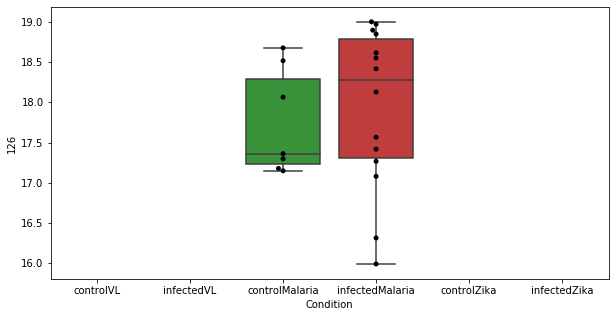

1313 row m/z                732.554
row retention time     3.56425
p-val                 0.652109
adj.P.Val             0.964932
custom_id                 2844
compound_names             NaN
Name: 2844, dtype: object


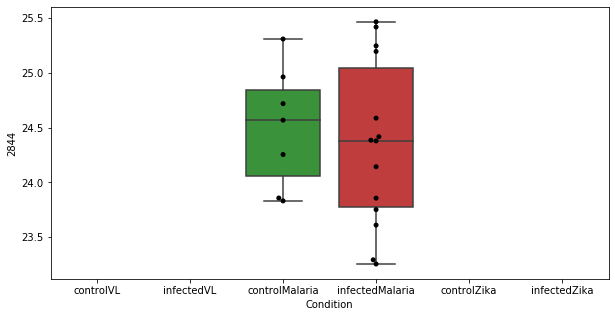

1314 row m/z                596.524
row retention time     3.23381
p-val                  0.65239
adj.P.Val             0.964932
custom_id                 4241
compound_names             NaN
Name: 4241, dtype: object


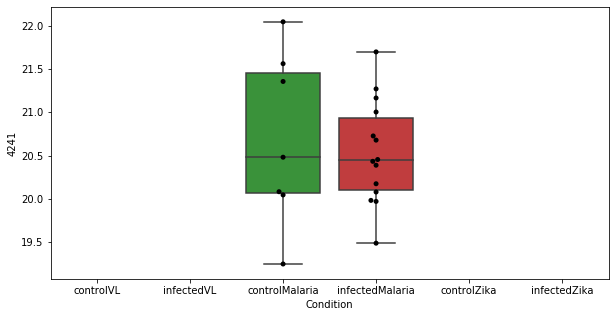

1315 row m/z                302.215
row retention time     4.57208
p-val                 0.652616
adj.P.Val             0.964932
custom_id                 4035
compound_names             NaN
Name: 4035, dtype: object


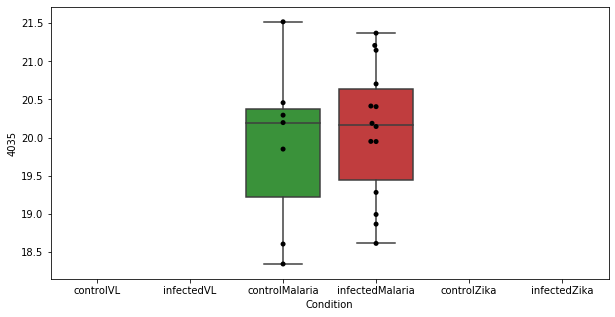

1316 row m/z                300.202
row retention time     6.78639
p-val                 0.652789
adj.P.Val             0.964932
custom_id                 2250
compound_names             NaN
Name: 2250, dtype: object


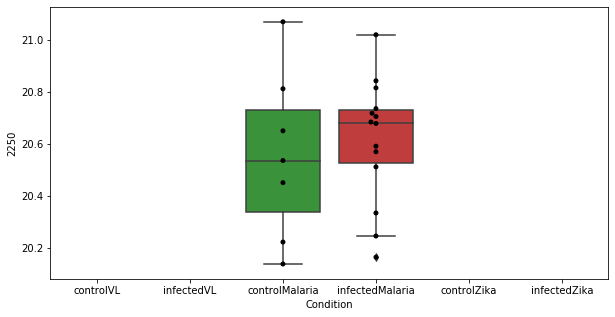

1317 row m/z                742.574
row retention time     3.51556
p-val                 0.652919
adj.P.Val             0.964932
custom_id                 2849
compound_names             NaN
Name: 2849, dtype: object


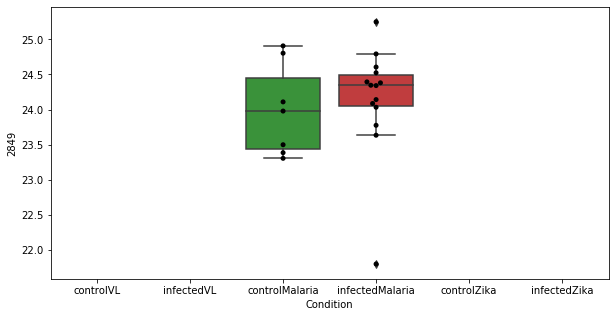

1318 row m/z                                                         133.061
row retention time                                              12.5296
p-val                                                          0.653586
adj.P.Val                                                      0.964932
custom_id                                                           569
compound_names        3-Ureidopropionate; 3-Ureidopropanoate; beta-U...
Name: 569, dtype: object


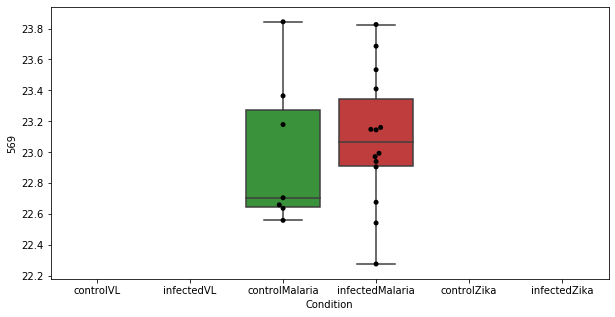

1319 row m/z                759.572
row retention time     3.52325
p-val                 0.653736
adj.P.Val             0.964932
custom_id                 2867
compound_names             NaN
Name: 2867, dtype: object


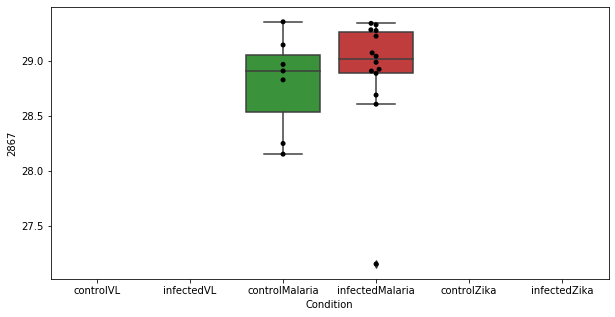

1320 row m/z                547.402
row retention time     3.47026
p-val                 0.654263
adj.P.Val             0.964932
custom_id                 2692
compound_names             NaN
Name: 2692, dtype: object


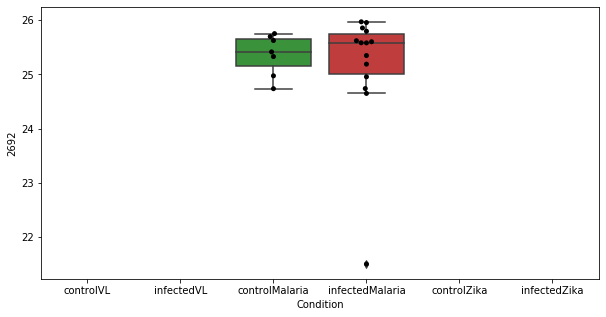

1321 row m/z                570.355
row retention time     3.96805
p-val                 0.654766
adj.P.Val             0.964932
custom_id                 6225
compound_names             NaN
Name: 6225, dtype: object


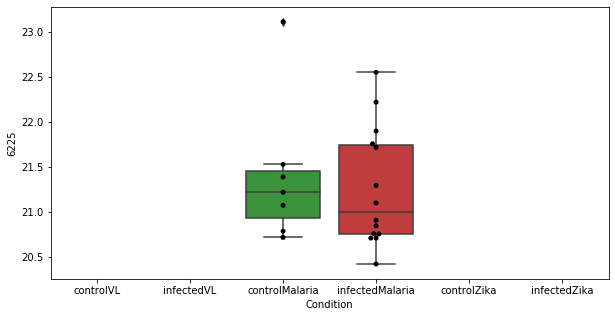

1322 row m/z                394.262
row retention time     3.56938
p-val                 0.655199
adj.P.Val             0.964932
custom_id                 2511
compound_names             NaN
Name: 2511, dtype: object


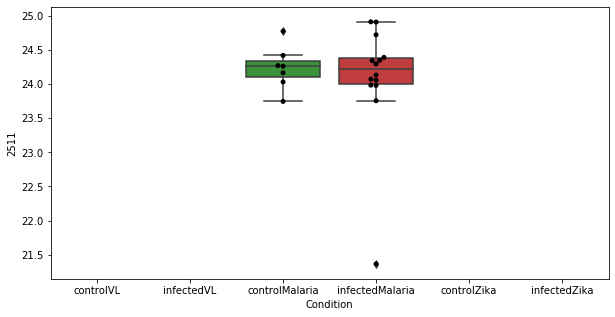

1323 row m/z                906.601
row retention time      3.2714
p-val                  0.65551
adj.P.Val             0.964932
custom_id                 4307
compound_names             NaN
Name: 4307, dtype: object


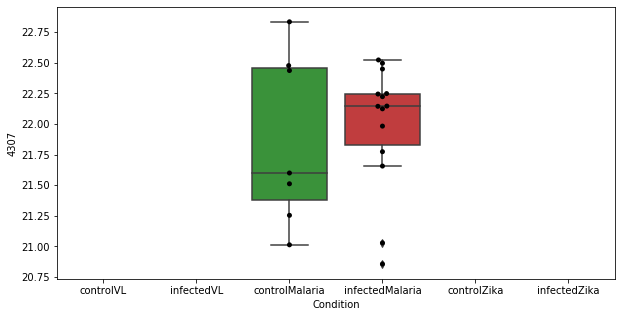

1324 row m/z                190.107
row retention time     8.74874
p-val                 0.658571
adj.P.Val             0.964932
custom_id                 1314
compound_names             NaN
Name: 1314, dtype: object


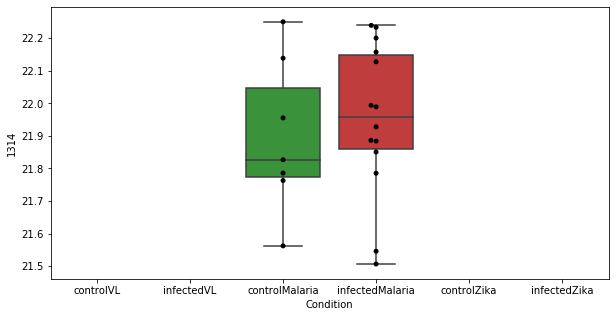

1325 row m/z                83.0603
row retention time     8.97278
p-val                 0.658681
adj.P.Val             0.964932
custom_id                 3025
compound_names             NaN
Name: 3025, dtype: object


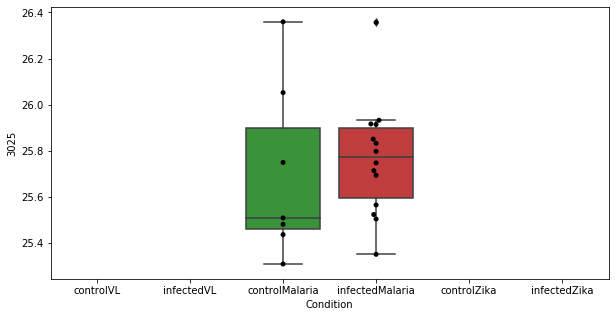

1326 row m/z                144.102
row retention time     10.6357
p-val                 0.658869
adj.P.Val             0.964932
custom_id                  694
compound_names             NaN
Name: 694, dtype: object


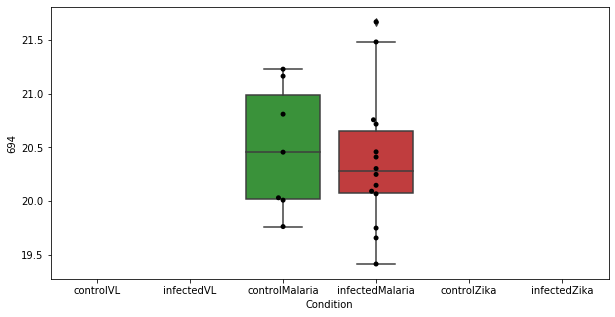

1327 row m/z                122.945
row retention time     1.60439
p-val                 0.658895
adj.P.Val             0.964932
custom_id                  416
compound_names             NaN
Name: 416, dtype: object


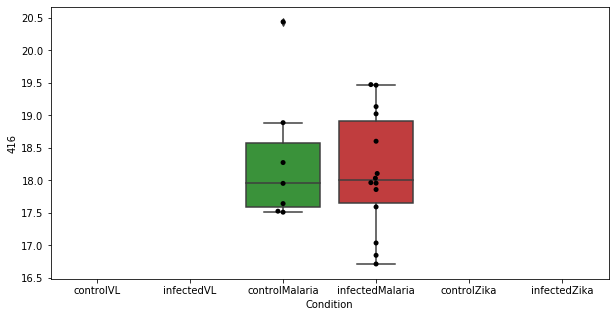

1328 row m/z                570.388
row retention time     3.28299
p-val                 0.659081
adj.P.Val             0.964932
custom_id                 2722
compound_names             NaN
Name: 2722, dtype: object


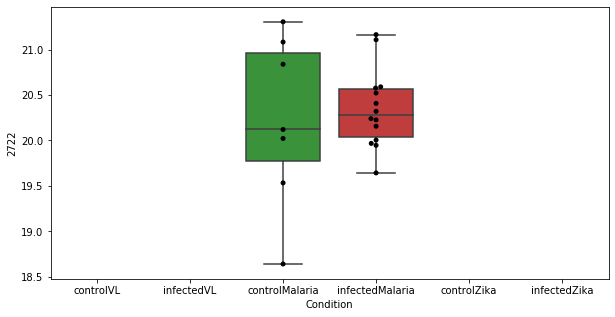

1329 row m/z                159.113
row retention time     4.56204
p-val                 0.659236
adj.P.Val             0.964932
custom_id                  915
compound_names             NaN
Name: 915, dtype: object


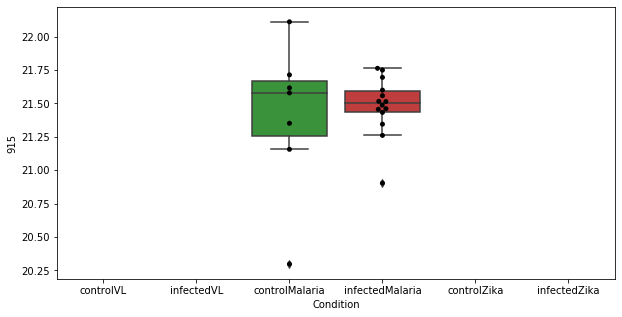

1330 row m/z                260.185
row retention time     4.62012
p-val                 0.659838
adj.P.Val             0.964932
custom_id                 1980
compound_names             NaN
Name: 1980, dtype: object


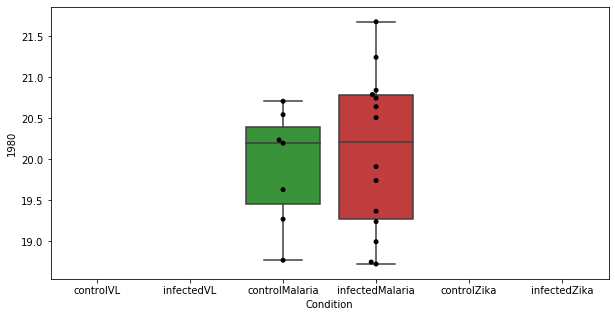

1331 row m/z                369.125
row retention time     3.60389
p-val                 0.661283
adj.P.Val             0.964932
custom_id                 2452
compound_names             NaN
Name: 2452, dtype: object


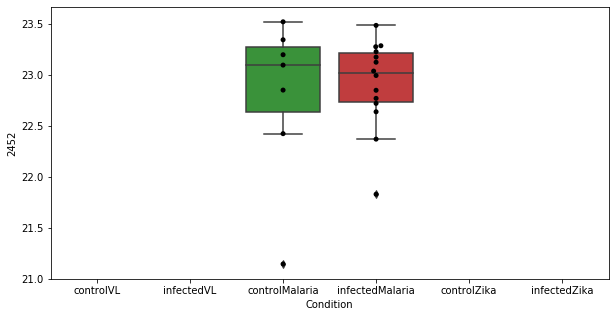

1332 row m/z                328.842
row retention time     23.7277
p-val                 0.661405
adj.P.Val             0.964932
custom_id                 2373
compound_names             NaN
Name: 2373, dtype: object


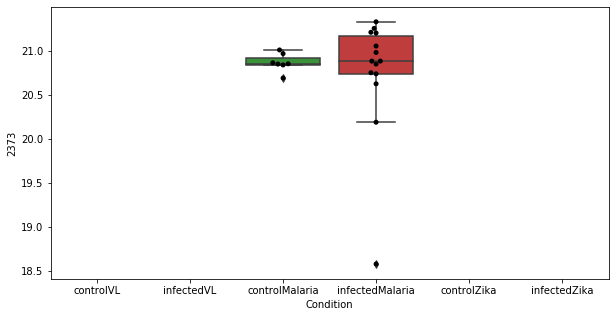

1333 row m/z                148.097
row retention time     4.05986
p-val                 0.663233
adj.P.Val             0.964932
custom_id                  785
compound_names             NaN
Name: 785, dtype: object


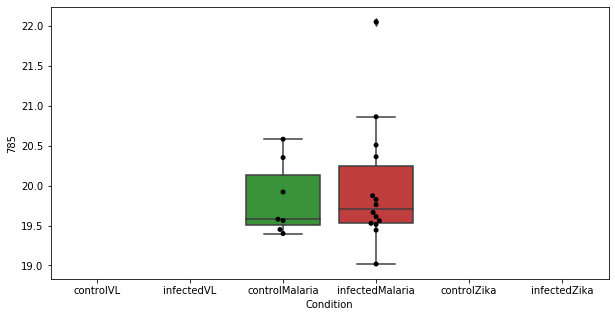

1334 row m/z                168.946
row retention time     12.9149
p-val                 0.664042
adj.P.Val             0.964932
custom_id                 4742
compound_names             NaN
Name: 4742, dtype: object


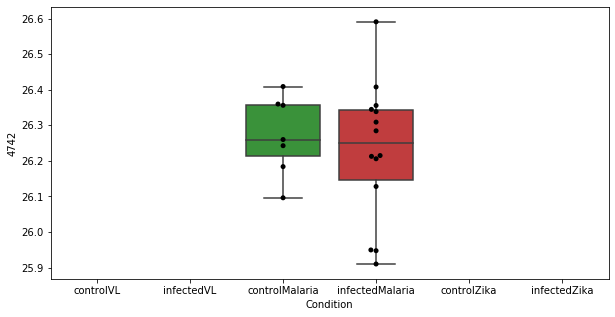

1335 row m/z                179.128
row retention time     6.77476
p-val                 0.664499
adj.P.Val             0.964932
custom_id                 3529
compound_names             NaN
Name: 3529, dtype: object


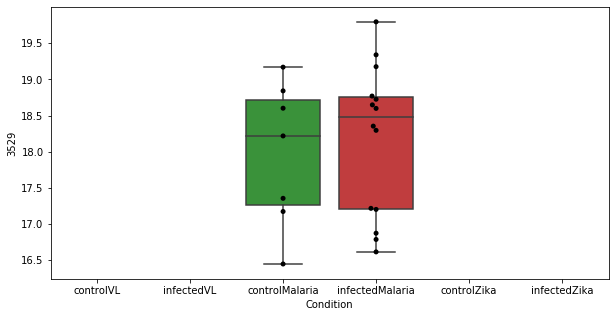

1336 row m/z                234.077
row retention time     4.96059
p-val                 0.665494
adj.P.Val             0.964932
custom_id                 1750
compound_names             NaN
Name: 1750, dtype: object


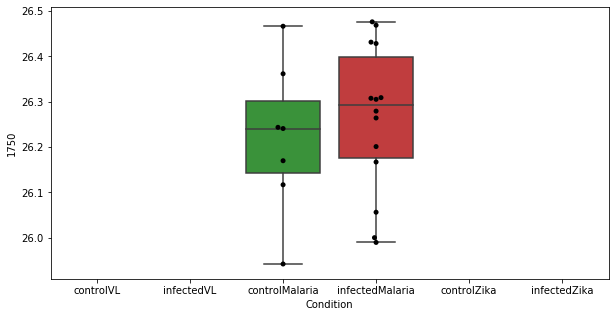

1337 row m/z                107.086
row retention time     4.56003
p-val                 0.666029
adj.P.Val             0.964932
custom_id                 3120
compound_names             NaN
Name: 3120, dtype: object


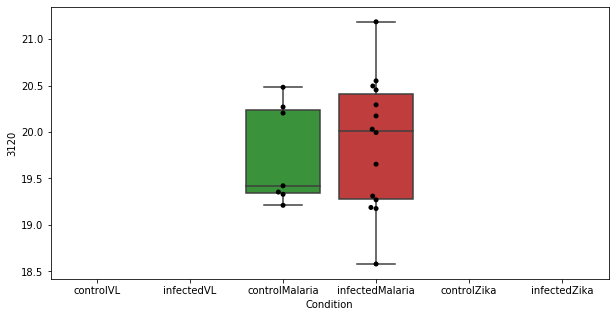

1338 row m/z                213.022
row retention time     12.2998
p-val                 0.666836
adj.P.Val             0.964932
custom_id                 1555
compound_names             NaN
Name: 1555, dtype: object


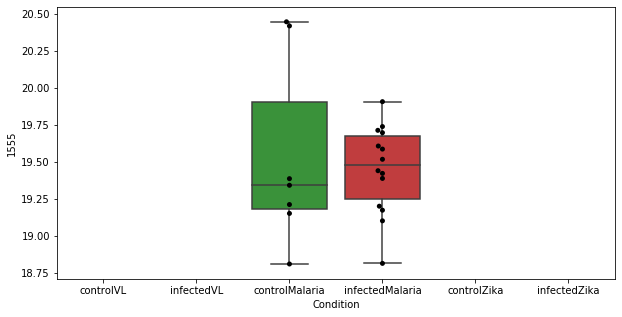

1339 row m/z                680.479
row retention time     23.0999
p-val                 0.667107
adj.P.Val             0.964932
custom_id                 2808
compound_names             NaN
Name: 2808, dtype: object


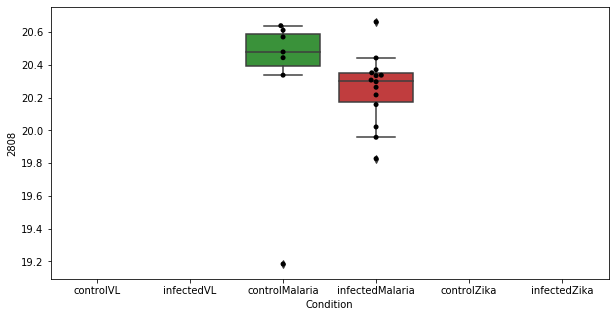

1340 row m/z                160.133
row retention time     8.30232
p-val                 0.667955
adj.P.Val             0.964932
custom_id                  932
compound_names             NaN
Name: 932, dtype: object


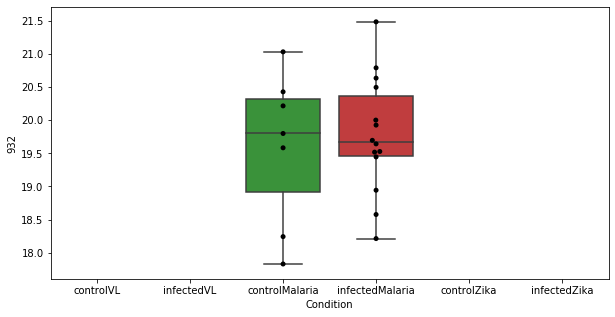

1341 row m/z                170.062
row retention time     12.3102
p-val                 0.668175
adj.P.Val             0.964932
custom_id                 1052
compound_names             NaN
Name: 1052, dtype: object


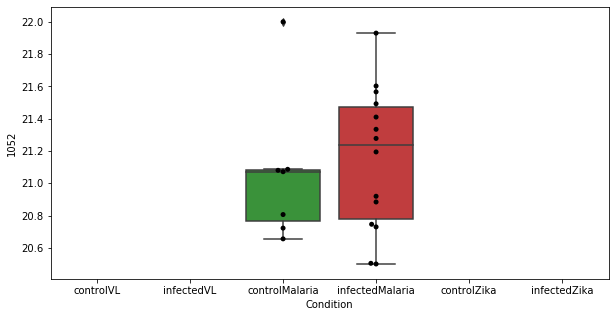

1342 row m/z                     209.154
row retention time          3.77408
p-val                      0.668273
adj.P.Val                  0.964932
custom_id                      1516
compound_names        lysyl-proline
Name: 1516, dtype: object


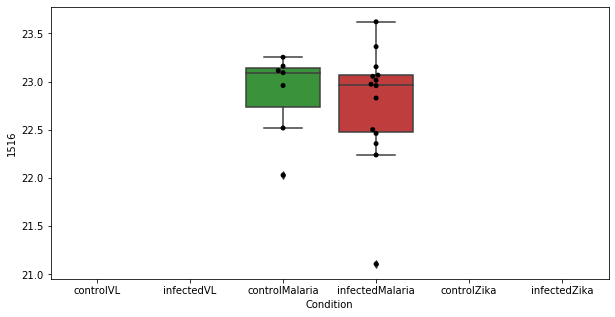

1343 row m/z                128.953
row retention time     2.76311
p-val                 0.669485
adj.P.Val             0.964932
custom_id                 4537
compound_names             NaN
Name: 4537, dtype: object


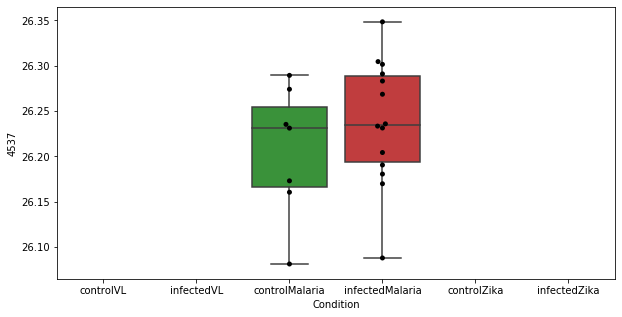

1344 row m/z                                                         391.284
row retention time                                              3.50791
p-val                                                           0.66962
adj.P.Val                                                      0.964932
custom_id                                                          2497
compound_names        3alpha,7alpha,12alpha-Trihydroxy-5beta-cholana...
Name: 2497, dtype: object


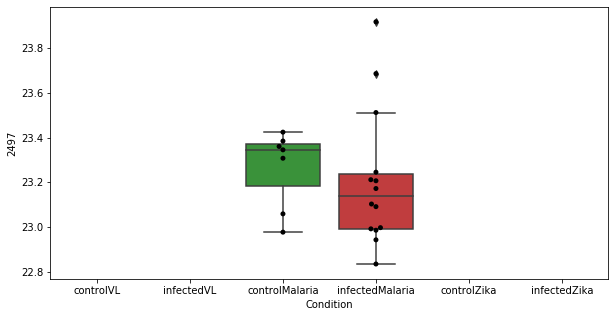

1345 row m/z                106.039
row retention time     12.8685
p-val                 0.670261
adj.P.Val             0.964932
custom_id                  201
compound_names             NaN
Name: 201, dtype: object


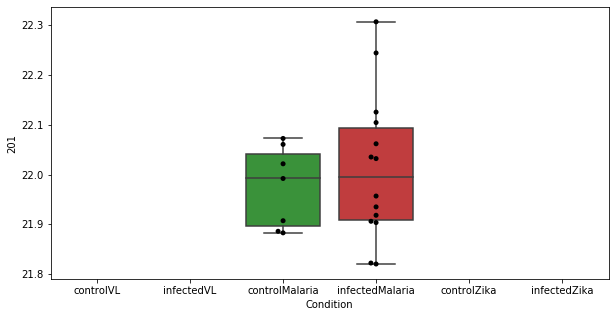

1346 row m/z                400.244
row retention time     3.21771
p-val                 0.670507
adj.P.Val             0.964932
custom_id                 2517
compound_names             NaN
Name: 2517, dtype: object


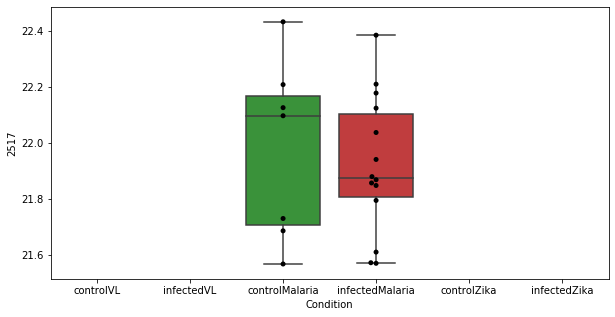

1347 row m/z                305.214
row retention time     3.69226
p-val                 0.670575
adj.P.Val             0.964932
custom_id                 2268
compound_names             NaN
Name: 2268, dtype: object


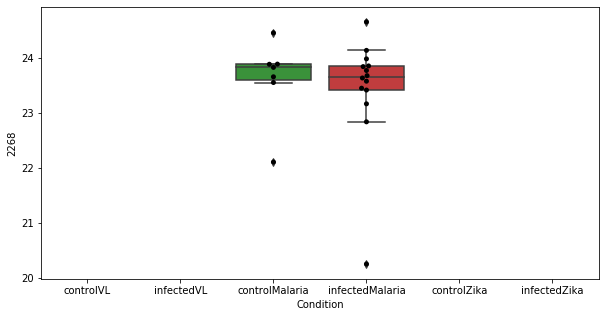

1348 row m/z                212.149
row retention time     6.89742
p-val                 0.671021
adj.P.Val             0.964932
custom_id                 1550
compound_names             NaN
Name: 1550, dtype: object


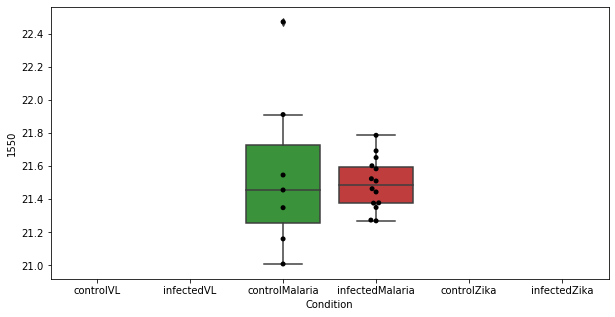

1349 row m/z                                                       129.102
row retention time                                            11.3282
p-val                                                        0.671116
adj.P.Val                                                    0.964932
custom_id                                                         495
compound_names        L-Lysine; Lysine acid; 2,6-Diaminohexanoic acid
Name: 495, dtype: object


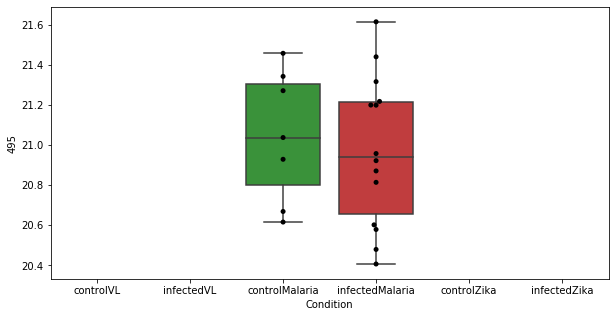

1350 row m/z                380.283
row retention time     3.55644
p-val                 0.671207
adj.P.Val             0.964932
custom_id                 2476
compound_names             NaN
Name: 2476, dtype: object


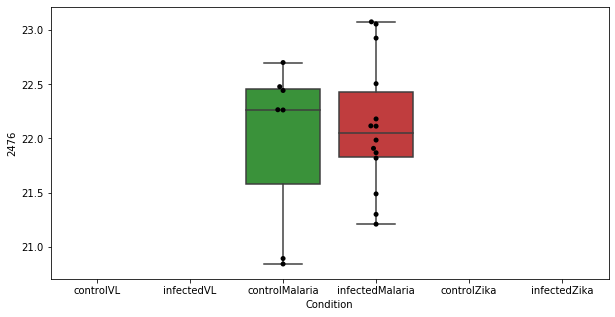

1351 row m/z                210.113
row retention time     4.56043
p-val                 0.672166
adj.P.Val             0.964932
custom_id                 1522
compound_names             NaN
Name: 1522, dtype: object


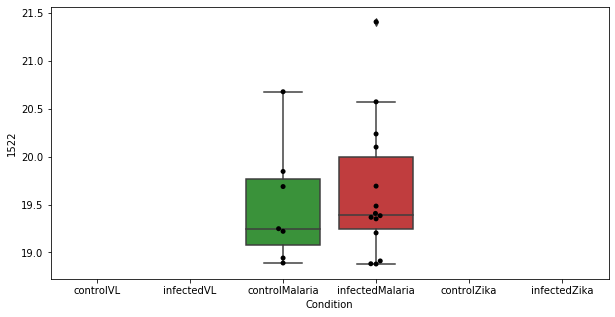

1352 row m/z                                                424.342
row retention time                                     4.00111
p-val                                                  0.67227
adj.P.Val                                             0.964932
custom_id                                                 4185
compound_names        Linoleyl carnitine$Linoelaidyl carnitine
Name: 4185, dtype: object


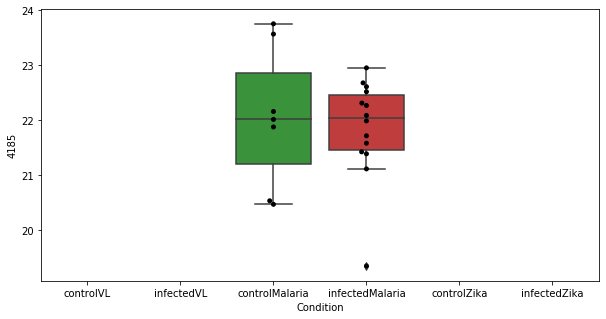

1353 row m/z                                                         166.086
row retention time                                              4.56729
p-val                                                          0.672567
adj.P.Val                                                      0.964932
custom_id                                                          1002
compound_names        L-Normetanephrine$L-Adrenaline; (R)-(-)-Adrena...
Name: 1002, dtype: object


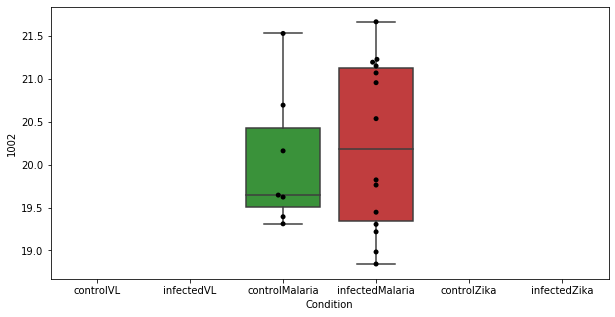

1354 row m/z                 281.82
row retention time     7.12909
p-val                 0.672721
adj.P.Val             0.964932
custom_id                 2145
compound_names             NaN
Name: 2145, dtype: object


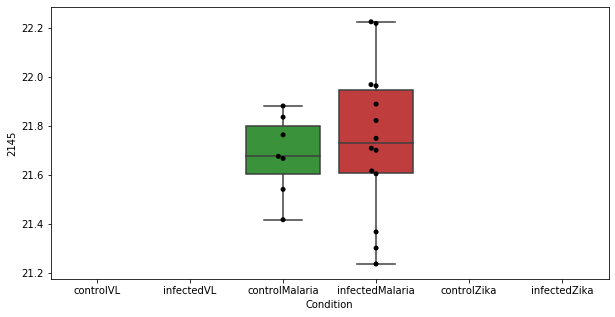

1355 row m/z                 274.91
row retention time      12.005
p-val                 0.672871
adj.P.Val             0.964932
custom_id                 2074
compound_names             NaN
Name: 2074, dtype: object


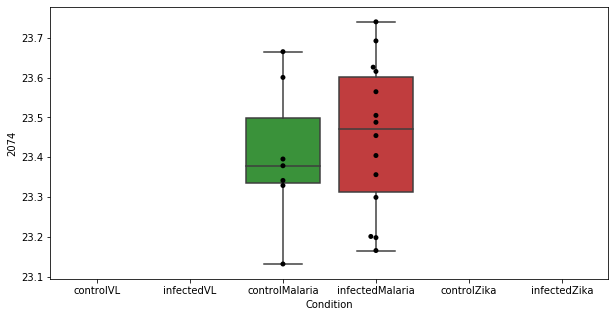

1356 row m/z                128.953
row retention time     23.8593
p-val                 0.673434
adj.P.Val             0.964932
custom_id                  485
compound_names             NaN
Name: 485, dtype: object


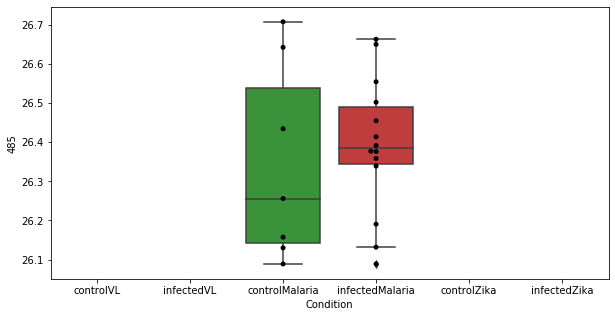

1357 row m/z                213.123
row retention time     7.00266
p-val                 0.673557
adj.P.Val             0.964932
custom_id                 1573
compound_names             NaN
Name: 1573, dtype: object


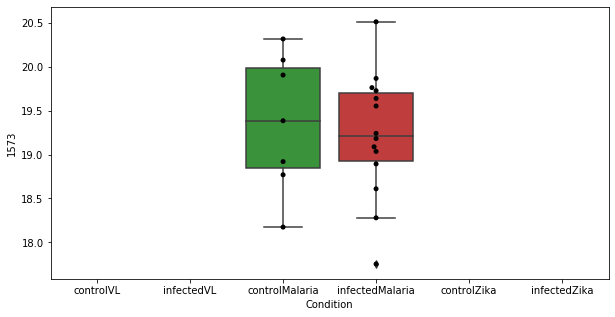

1358 row m/z                147.978
row retention time     23.6524
p-val                 0.674323
adj.P.Val             0.964932
custom_id                  765
compound_names             NaN
Name: 765, dtype: object


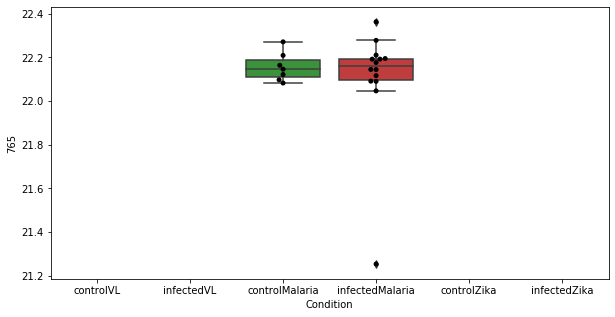

1359 row m/z                181.122
row retention time       3.843
p-val                 0.675122
adj.P.Val             0.964932
custom_id                 1203
compound_names             NaN
Name: 1203, dtype: object


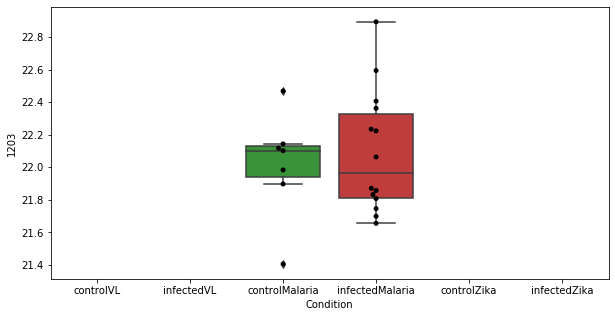

1360 row m/z                218.211
row retention time     6.99337
p-val                 0.675733
adj.P.Val             0.964932
custom_id                 1631
compound_names             NaN
Name: 1631, dtype: object


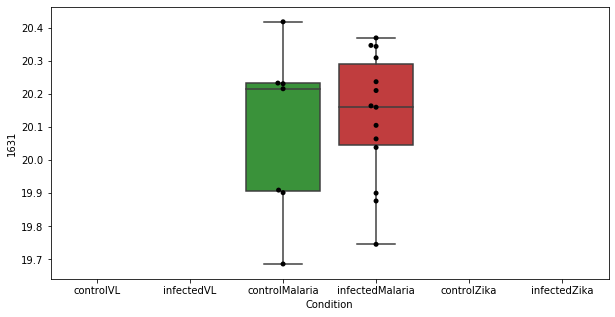

1361 row m/z                                                         118.086
row retention time                                              23.8441
p-val                                                          0.675739
adj.P.Val                                                      0.964932
custom_id                                                           351
compound_names        5-Aminopentanoate; 5-Aminopentanoic acid; 5-Am...
Name: 351, dtype: object


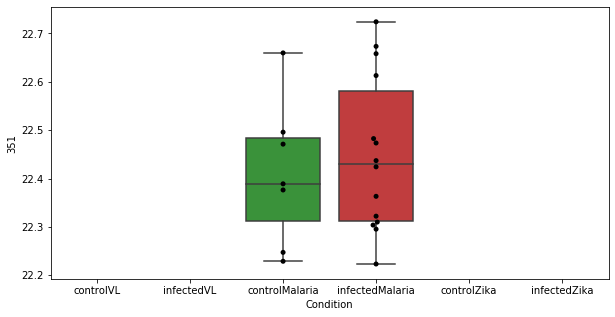

1362 row m/z                214.253
row retention time     7.18861
p-val                 0.676097
adj.P.Val             0.964932
custom_id                 1583
compound_names             NaN
Name: 1583, dtype: object


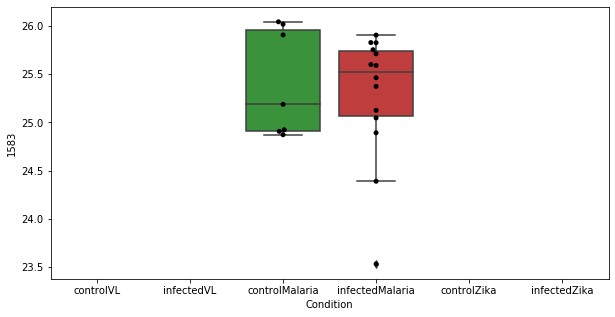

1363 row m/z                332.331
row retention time     7.01294
p-val                 0.676531
adj.P.Val             0.964932
custom_id                 2388
compound_names             NaN
Name: 2388, dtype: object


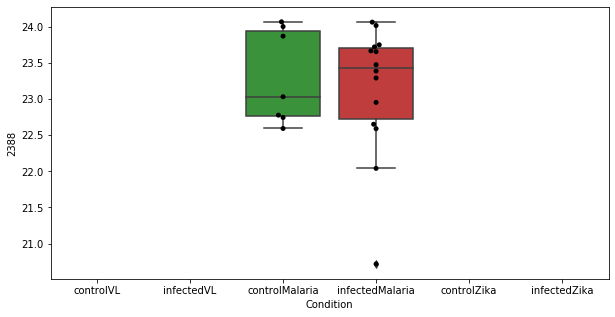

1364 row m/z                                                         112.076
row retention time                                              6.99789
p-val                                                          0.677413
adj.P.Val                                                      0.964932
custom_id                                                           251
compound_names        L-Normetanephrine$L-Adrenaline; (R)-(-)-Adrena...
Name: 251, dtype: object


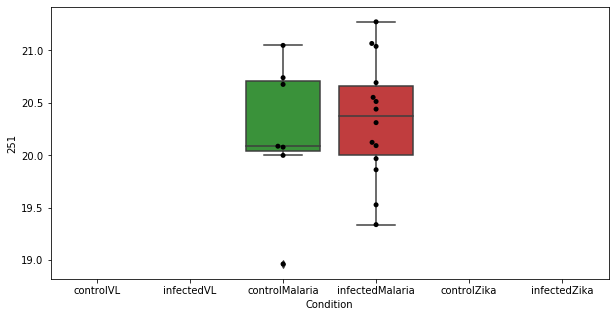

1365 row m/z                                                         104.071
row retention time                                              11.5902
p-val                                                           0.67807
adj.P.Val                                                      0.964932
custom_id                                                           165
compound_names        N,N-Dimethylglycine; Dimethylglycine$(R)-3-Ami...
Name: 165, dtype: object


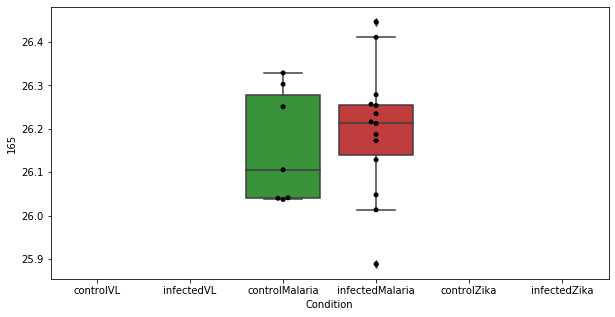

1366 row m/z                                                         182.081
row retention time                                              11.2855
p-val                                                          0.678094
adj.P.Val                                                      0.964932
custom_id                                                          1206
compound_names        L-Tyrosine; (S)-3-(p-Hydroxyphenyl)alanine; (S...
Name: 1206, dtype: object


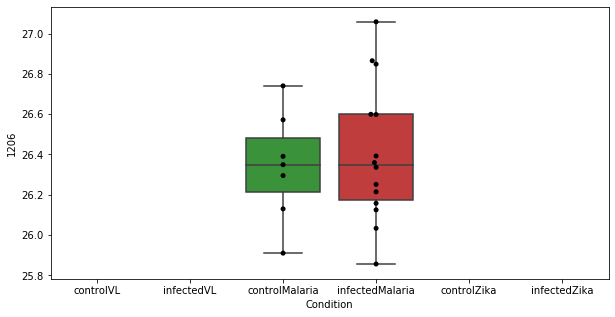

1367 row m/z                160.034
row retention time     10.9723
p-val                 0.678601
adj.P.Val             0.964932
custom_id                 5664
compound_names             NaN
Name: 5664, dtype: object


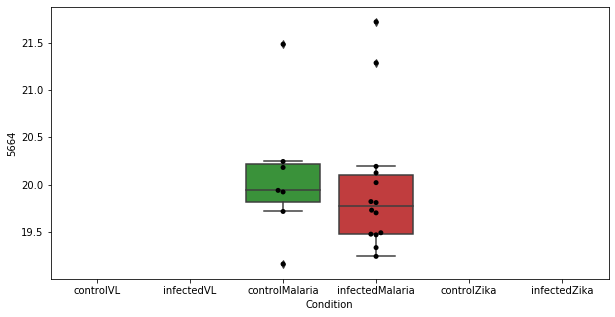

1368 row m/z                106.013
row retention time     3.88917
p-val                 0.679038
adj.P.Val             0.964932
custom_id                  200
compound_names             NaN
Name: 200, dtype: object


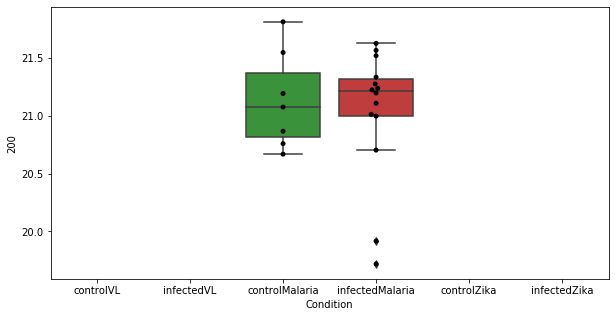

1369 row m/z                228.196
row retention time     23.3336
p-val                 0.679183
adj.P.Val             0.964932
custom_id                 1703
compound_names             NaN
Name: 1703, dtype: object


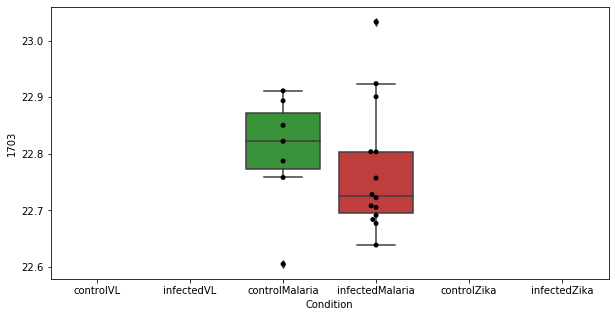

1370 row m/z                232.154
row retention time     7.92114
p-val                 0.679249
adj.P.Val             0.964932
custom_id                 1739
compound_names             NaN
Name: 1739, dtype: object


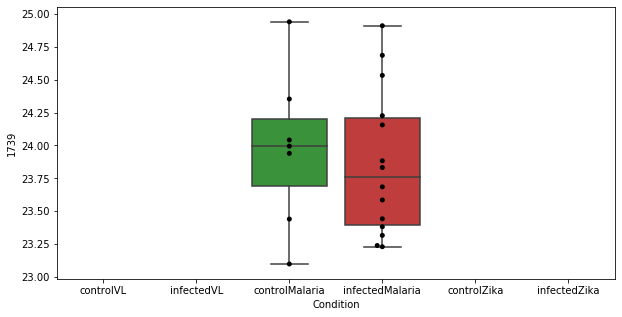

1371 row m/z                 658.74
row retention time     9.29621
p-val                 0.680409
adj.P.Val             0.964932
custom_id                 2792
compound_names             NaN
Name: 2792, dtype: object


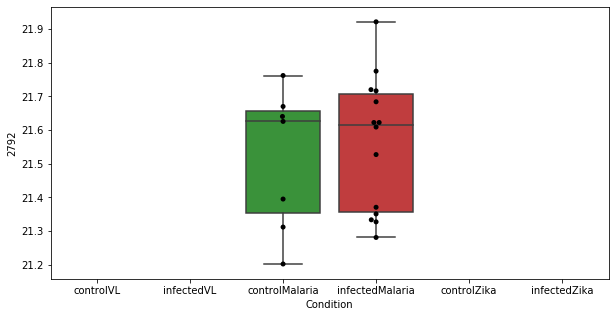

1372 row m/z                689.559
row retention time     3.78667
p-val                 0.680695
adj.P.Val             0.964932
custom_id                 2816
compound_names             NaN
Name: 2816, dtype: object


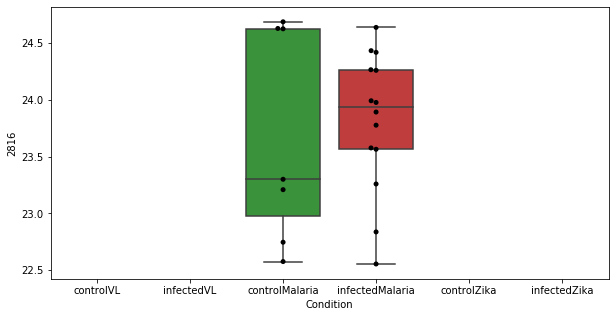

1373 row m/z                                                         180.102
row retention time                                              6.99239
p-val                                                          0.680827
adj.P.Val                                                      0.964932
custom_id                                                          1185
compound_names        (-)-Salsolinol; 6,7-Isoquinolinediol, 1,2,3,4-...
Name: 1185, dtype: object


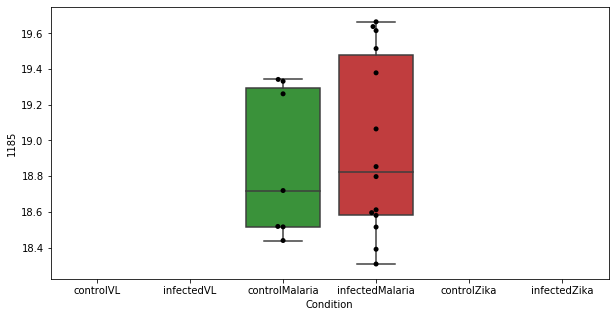

1374 row m/z                  380.9
row retention time     13.0661
p-val                 0.681436
adj.P.Val             0.964932
custom_id                 2478
compound_names             NaN
Name: 2478, dtype: object


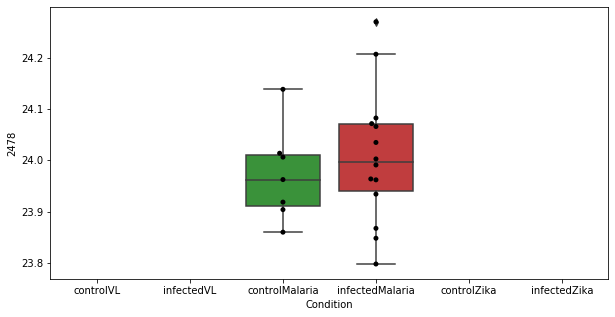

1375 row m/z                128.953
row retention time     12.8799
p-val                 0.682425
adj.P.Val             0.964932
custom_id                 3229
compound_names             NaN
Name: 3229, dtype: object


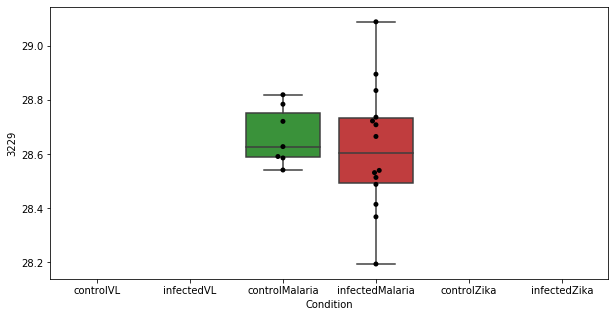

1376 row m/z                132.142
row retention time      9.8832
p-val                 0.682719
adj.P.Val             0.964932
custom_id                 5511
compound_names             NaN
Name: 5511, dtype: object


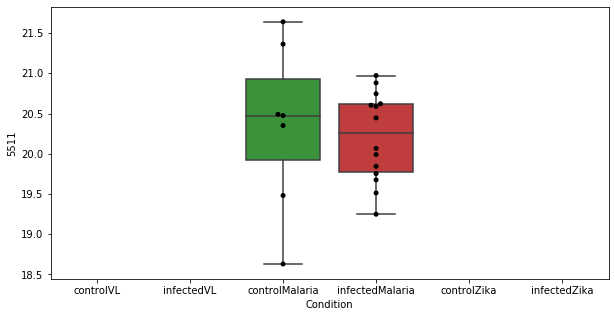

1377 row m/z                     123.117
row retention time          3.78905
p-val                      0.682904
adj.P.Val                  0.964932
custom_id                       430
compound_names        Perillic acid
Name: 430, dtype: object


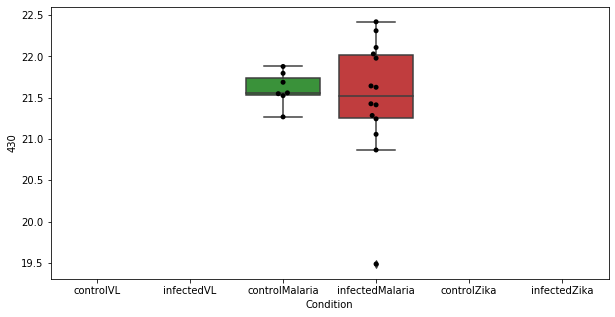

1378 row m/z                                                         178.059
row retention time                                               12.329
p-val                                                          0.683102
adj.P.Val                                                      0.964932
custom_id                                                          1153
compound_names        L-Histidine; (S)-alpha-Amino-1H-imidazole-4-pr...
Name: 1153, dtype: object


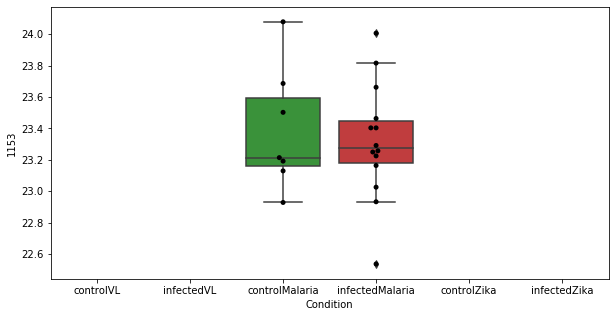

1379 row m/z                186.113
row retention time     8.21016
p-val                 0.684683
adj.P.Val             0.964932
custom_id                 1254
compound_names             NaN
Name: 1254, dtype: object


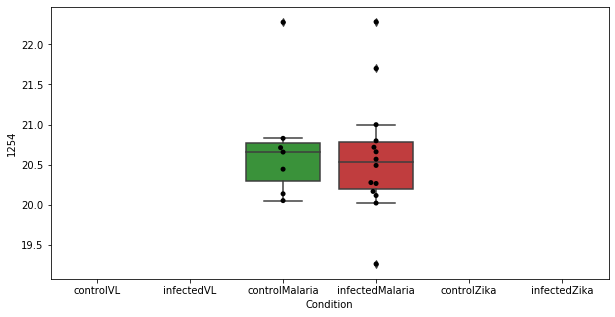

1380 row m/z                546.356
row retention time     3.98985
p-val                 0.685497
adj.P.Val             0.964932
custom_id                 2689
compound_names             NaN
Name: 2689, dtype: object


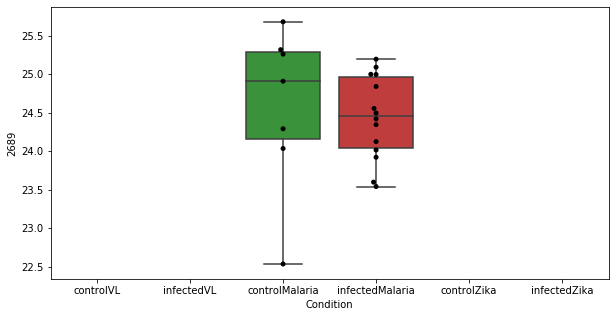

1381 row m/z                205.144
row retention time     3.75393
p-val                 0.686043
adj.P.Val             0.964932
custom_id                 1481
compound_names             NaN
Name: 1481, dtype: object


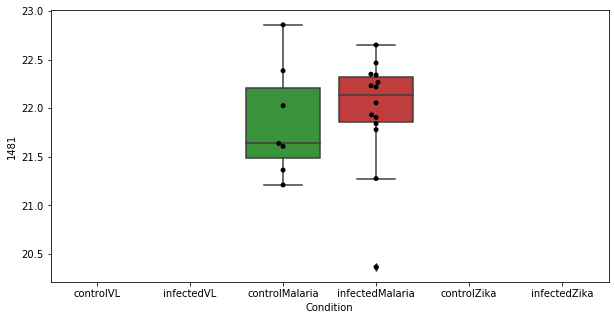

1382 row m/z                                                         176.103
row retention time                                              12.7934
p-val                                                          0.686417
adj.P.Val                                                      0.964932
custom_id                                                          1144
compound_names        L-Citrulline; 2-Amino-5-ureidovaleric acid; Ci...
Name: 1144, dtype: object


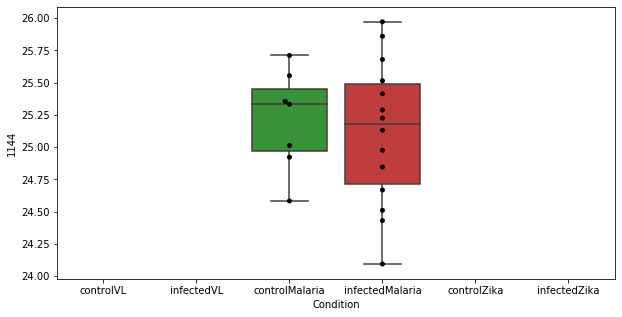

1383 row m/z                454.192
row retention time     14.0218
p-val                 0.686898
adj.P.Val             0.964932
custom_id                 4190
compound_names             NaN
Name: 4190, dtype: object


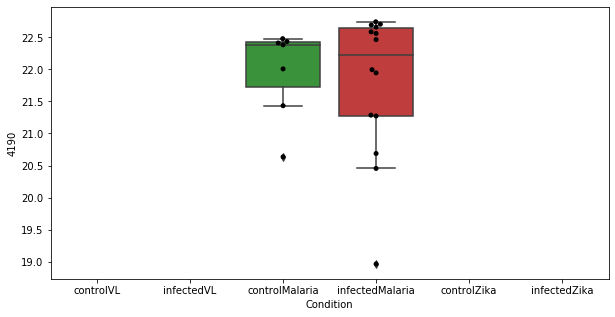

1384 row m/z                766.574
row retention time     3.50571
p-val                 0.687809
adj.P.Val             0.964932
custom_id                 2875
compound_names             NaN
Name: 2875, dtype: object


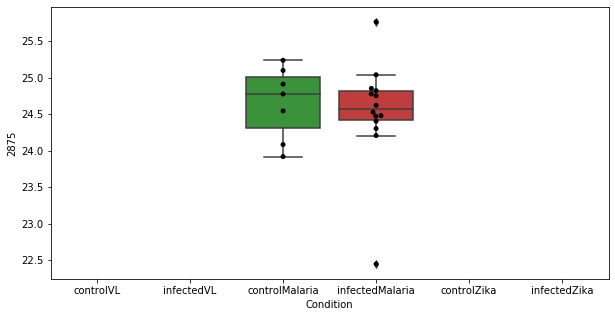

1385 row m/z                770.603
row retention time     3.51352
p-val                  0.68891
adj.P.Val             0.964932
custom_id                 2880
compound_names             NaN
Name: 2880, dtype: object


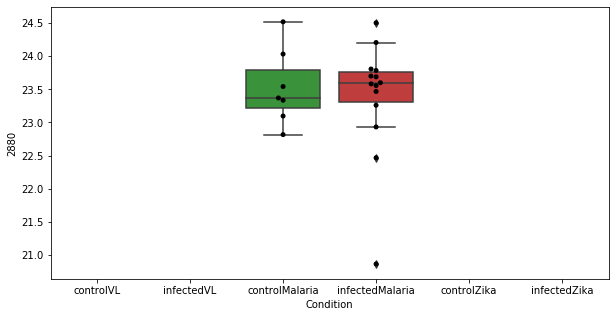

1386 row m/z                                                         138.055
row retention time                                              10.2335
p-val                                                          0.689488
adj.P.Val                                                      0.964932
custom_id                                                           618
compound_names        Anthranilate; Anthranilic acid; o-Aminobenzoic...
Name: 618, dtype: object


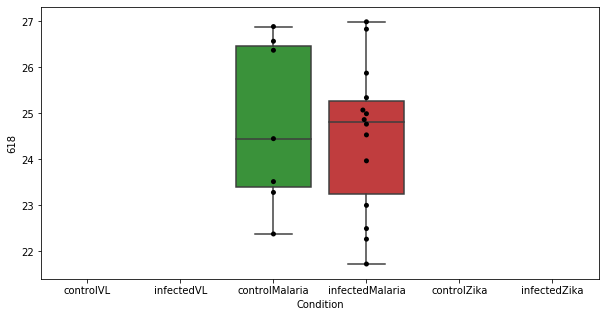

1387 row m/z                296.918
row retention time     12.9663
p-val                 0.690099
adj.P.Val             0.964932
custom_id                 4017
compound_names             NaN
Name: 4017, dtype: object


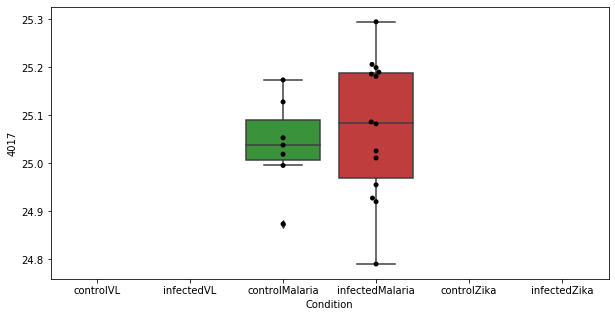

1388 row m/z                200.173
row retention time     10.7413
p-val                 0.690665
adj.P.Val             0.964932
custom_id                 1439
compound_names             NaN
Name: 1439, dtype: object


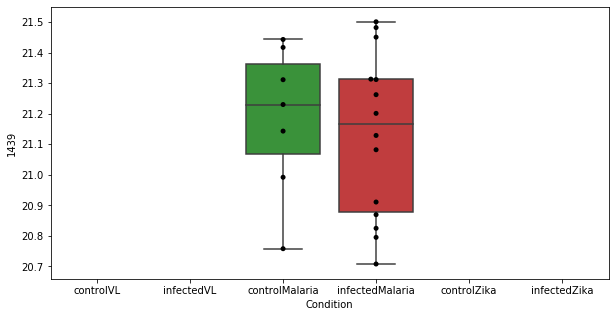

1389 row m/z                358.918
row retention time     23.7457
p-val                 0.690778
adj.P.Val             0.964932
custom_id                 2435
compound_names             NaN
Name: 2435, dtype: object


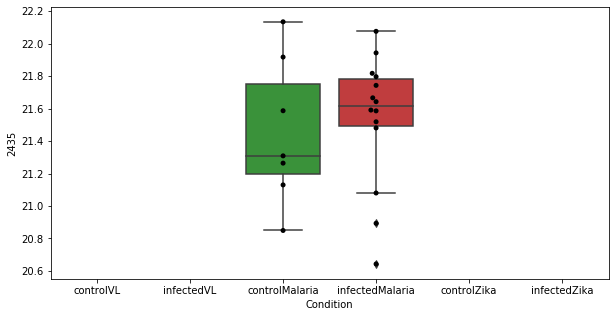

1390 row m/z                 236.91
row retention time     23.7361
p-val                 0.692986
adj.P.Val             0.964932
custom_id                 1785
compound_names             NaN
Name: 1785, dtype: object


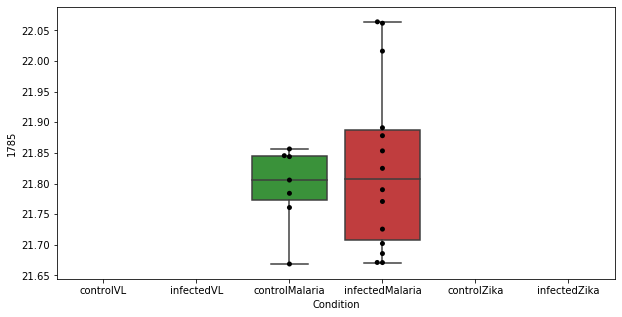

1391 row m/z                204.951
row retention time     10.0753
p-val                 0.693349
adj.P.Val             0.964932
custom_id                 1474
compound_names             NaN
Name: 1474, dtype: object


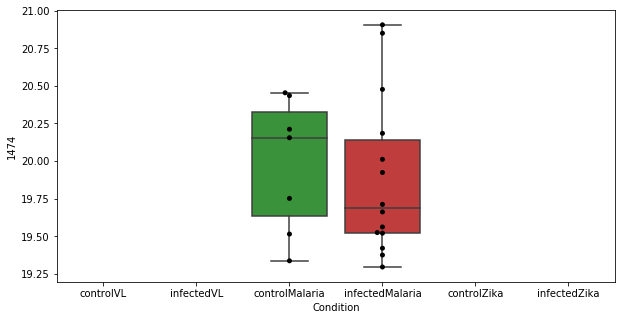

1392 row m/z                796.619
row retention time     3.48011
p-val                  0.69367
adj.P.Val             0.964932
custom_id                 2926
compound_names             NaN
Name: 2926, dtype: object


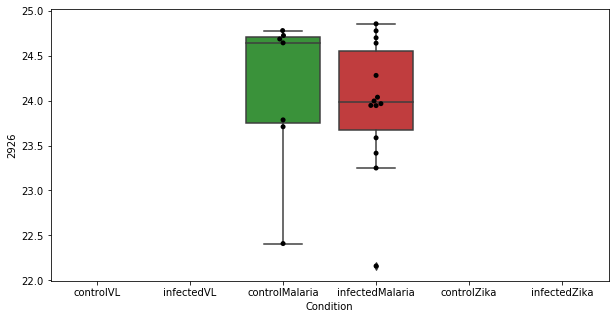

1393 row m/z                                                         118.061
row retention time                                              12.9899
p-val                                                          0.693848
adj.P.Val                                                      0.964932
custom_id                                                           345
compound_names        Guanidinoacetate$Guanidinoacetate; Guanidinoac...
Name: 345, dtype: object


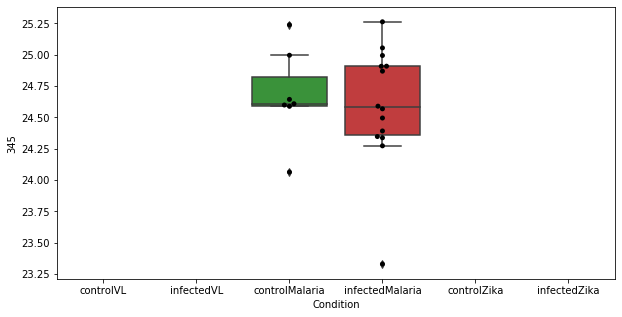

1394 row m/z                96.0637
row retention time     23.8407
p-val                 0.694076
adj.P.Val             0.964932
custom_id                  103
compound_names             NaN
Name: 103, dtype: object


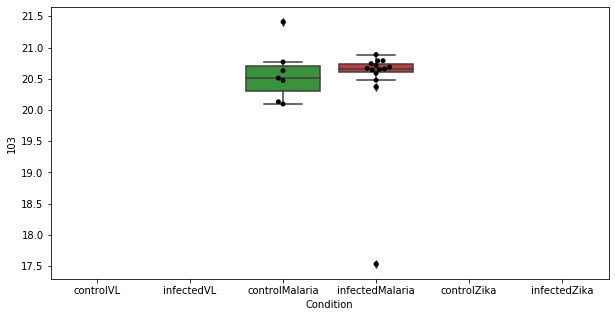

1395 row m/z                284.134
row retention time     3.71734
p-val                 0.694269
adj.P.Val             0.964932
custom_id                 2159
compound_names             NaN
Name: 2159, dtype: object


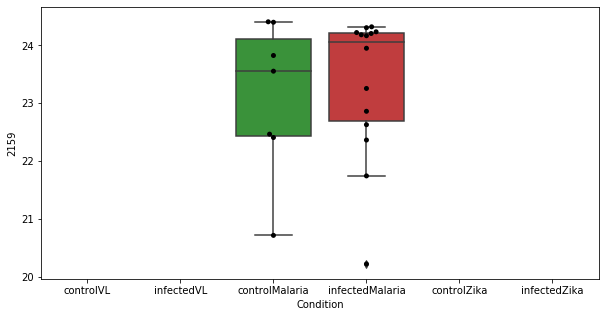

1396 row m/z                                                         124.087
row retention time                                              10.8476
p-val                                                          0.695111
adj.P.Val                                                      0.964932
custom_id                                                           436
compound_names        N(pi)-Methyl-L-histidine; 1-Methylhistidine; N...
Name: 436, dtype: object


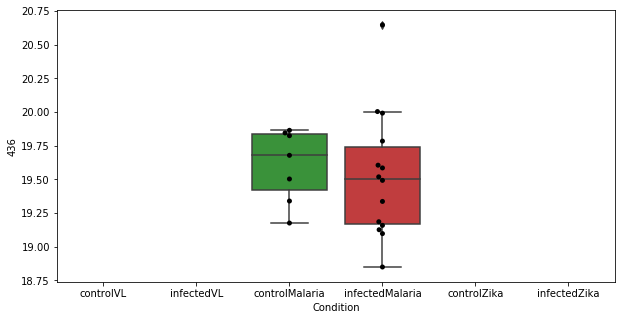

1397 row m/z                129.957
row retention time     2.68704
p-val                 0.695113
adj.P.Val             0.964932
custom_id                  507
compound_names             NaN
Name: 507, dtype: object


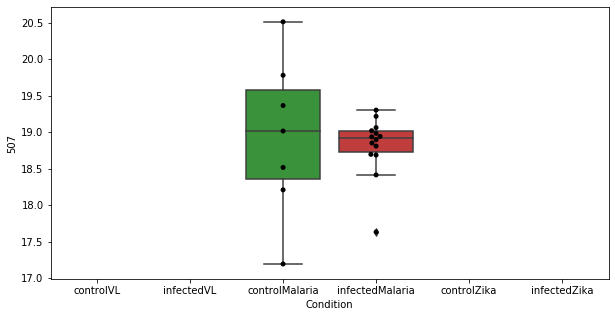

1398 row m/z                592.461
row retention time     3.28821
p-val                 0.695278
adj.P.Val             0.964932
custom_id                 2741
compound_names             NaN
Name: 2741, dtype: object


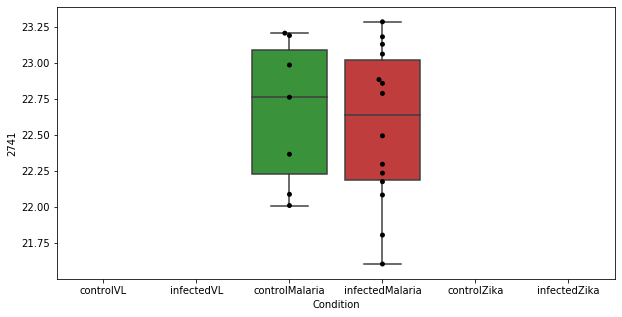

1399 row m/z                 191.04
row retention time     12.3175
p-val                 0.695571
adj.P.Val             0.964932
custom_id                 1323
compound_names             NaN
Name: 1323, dtype: object


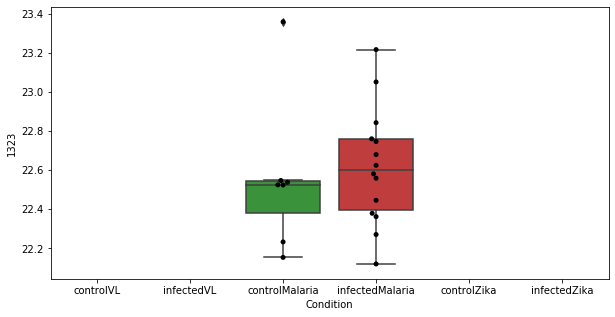

1400 row m/z                283.103
row retention time     7.94126
p-val                 0.697305
adj.P.Val             0.964932
custom_id                 3975
compound_names             NaN
Name: 3975, dtype: object


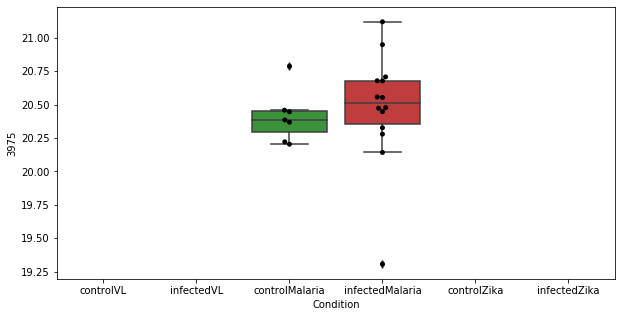

1401 row m/z                195.113
row retention time      4.5886
p-val                 0.697659
adj.P.Val             0.964932
custom_id                 1385
compound_names             NaN
Name: 1385, dtype: object


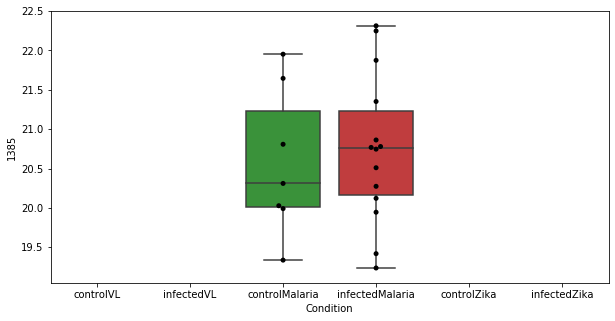

1402 row m/z                              167.09
row retention time                  9.14813
p-val                              0.698186
adj.P.Val                          0.964932
custom_id                              1012
compound_names        4-Guanidinobutanamide
Name: 1012, dtype: object


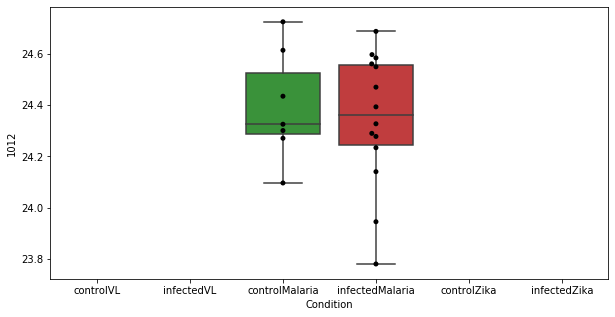

1403 row m/z                430.186
row retention time      3.6276
p-val                  0.69824
adj.P.Val             0.964932
custom_id                 2565
compound_names             NaN
Name: 2565, dtype: object


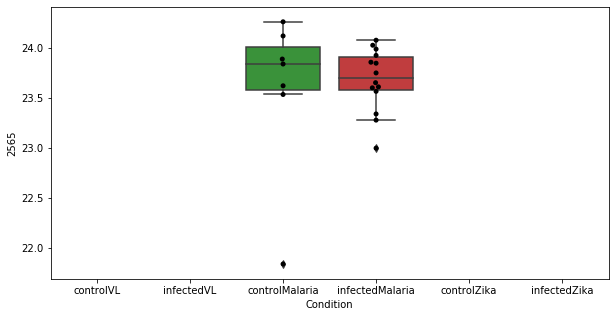

1404 row m/z                209.973
row retention time     12.9462
p-val                 0.698301
adj.P.Val             0.964932
custom_id                 4900
compound_names             NaN
Name: 4900, dtype: object


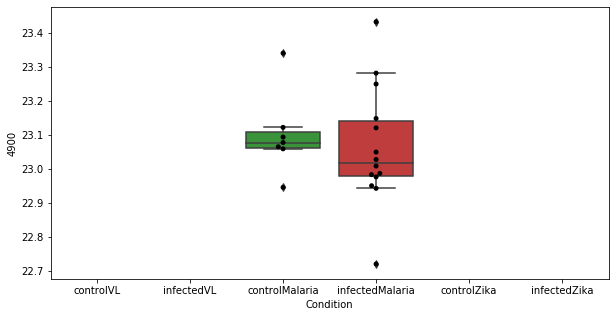

1405 row m/z                247.144
row retention time     7.99947
p-val                 0.698547
adj.P.Val             0.964932
custom_id                 1888
compound_names             NaN
Name: 1888, dtype: object


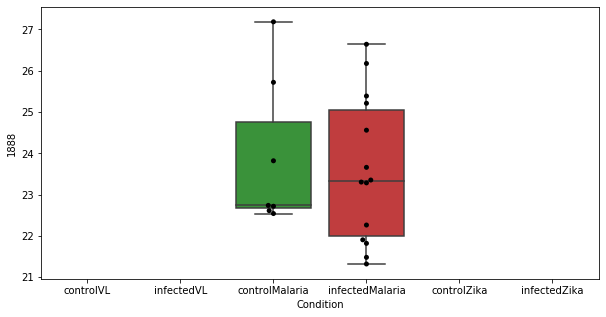

1406 row m/z                255.159
row retention time      3.7728
p-val                 0.698573
adj.P.Val             0.964932
custom_id                 1948
compound_names             NaN
Name: 1948, dtype: object


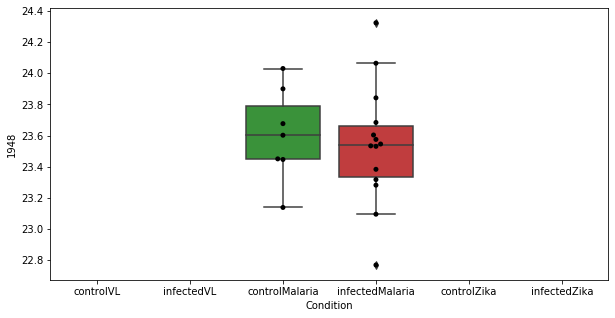

1407 row m/z                276.196
row retention time     23.2633
p-val                 0.698947
adj.P.Val             0.964932
custom_id                 2111
compound_names             NaN
Name: 2111, dtype: object


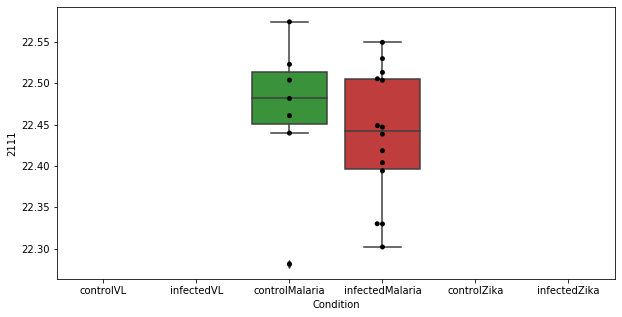

1408 row m/z                234.077
row retention time     12.3143
p-val                 0.699145
adj.P.Val             0.964932
custom_id                 1749
compound_names             NaN
Name: 1749, dtype: object


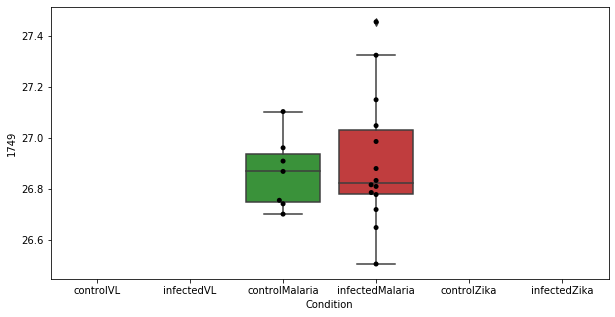

1409 row m/z                188.128
row retention time     10.1546
p-val                 0.699243
adj.P.Val             0.964932
custom_id                 1282
compound_names             NaN
Name: 1282, dtype: object


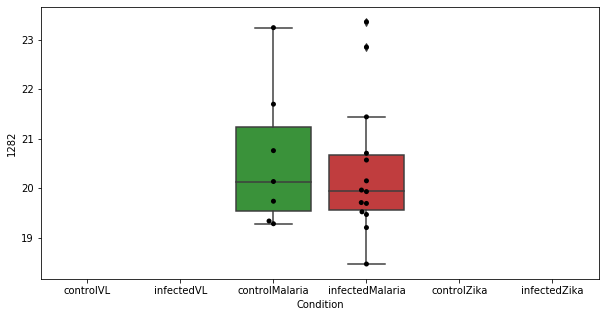

1410 row m/z                                      188.055
row retention time                           8.54525
p-val                                       0.700094
adj.P.Val                                   0.964932
custom_id                                       1274
compound_names        Lipoamide; Thioctic acid amide
Name: 1274, dtype: object


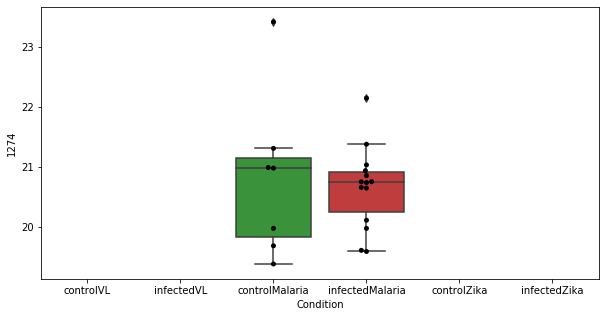

1411 row m/z                251.164
row retention time     3.76962
p-val                 0.700672
adj.P.Val             0.964932
custom_id                 3845
compound_names             NaN
Name: 3845, dtype: object


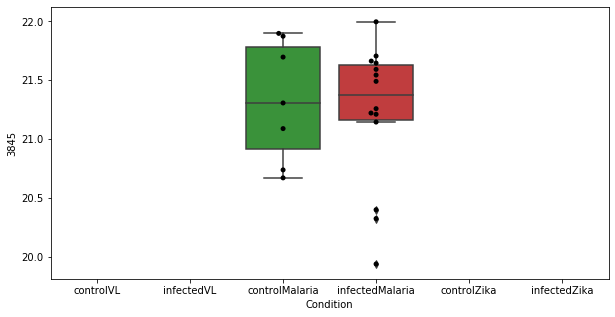

1412 row m/z                200.027
row retention time     10.9927
p-val                  0.70149
adj.P.Val             0.964932
custom_id                 1430
compound_names             NaN
Name: 1430, dtype: object


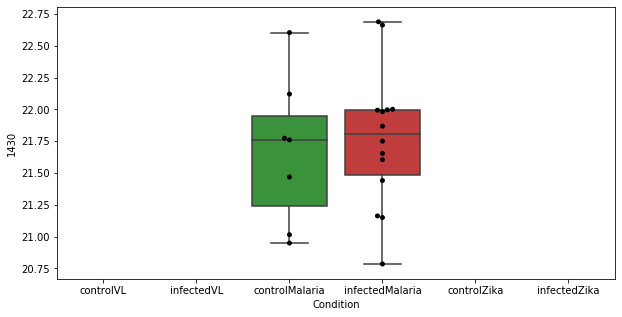

1413 row m/z                340.882
row retention time     12.0162
p-val                 0.701718
adj.P.Val             0.964932
custom_id                 2400
compound_names             NaN
Name: 2400, dtype: object


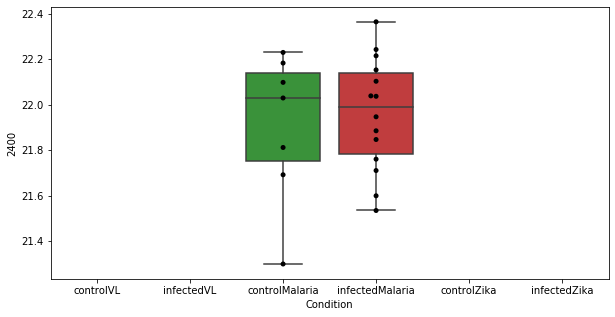

1414 row m/z                183.078
row retention time     11.3464
p-val                 0.702447
adj.P.Val             0.964932
custom_id                 3548
compound_names             NaN
Name: 3548, dtype: object


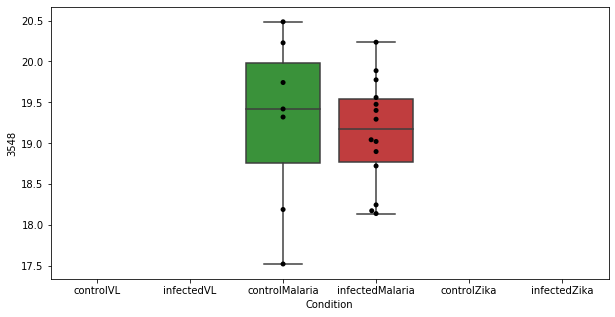

1415 row m/z                                                         107.07
row retention time                                             4.08211
p-val                                                         0.702859
adj.P.Val                                                     0.964932
custom_id                                                          210
compound_names        Butanoic acid; Butanoate; Butyrate; Butyric acid
Name: 210, dtype: object


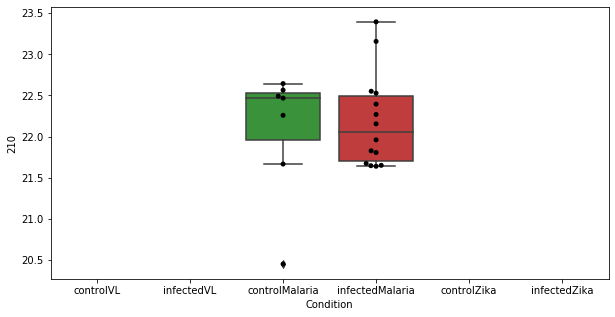

1416 row m/z                320.207
row retention time      3.7712
p-val                  0.70302
adj.P.Val             0.964932
custom_id                 2342
compound_names             NaN
Name: 2342, dtype: object


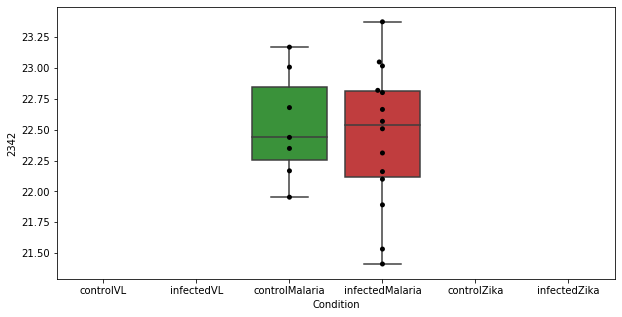

1417 row m/z                200.173
row retention time      9.5257
p-val                 0.703247
adj.P.Val             0.964932
custom_id                 1438
compound_names             NaN
Name: 1438, dtype: object


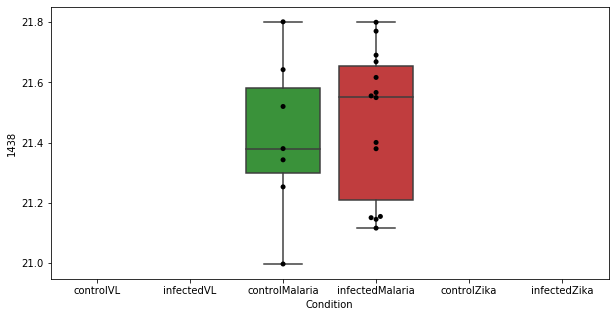

1418 row m/z                                                         177.106
row retention time                                               12.794
p-val                                                           0.70387
adj.P.Val                                                      0.964932
custom_id                                                          1151
compound_names        L-Citrulline; 2-Amino-5-ureidovaleric acid; Ci...
Name: 1151, dtype: object


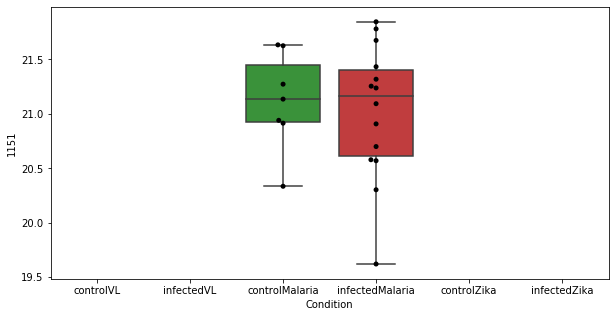

1419 row m/z                                                         228.159
row retention time                                               3.8449
p-val                                                          0.704026
adj.P.Val                                                      0.964932
custom_id                                                          1701
compound_names        Peptide 2-[3-carboxy-3-(methylammonio)propyl]-...
Name: 1701, dtype: object


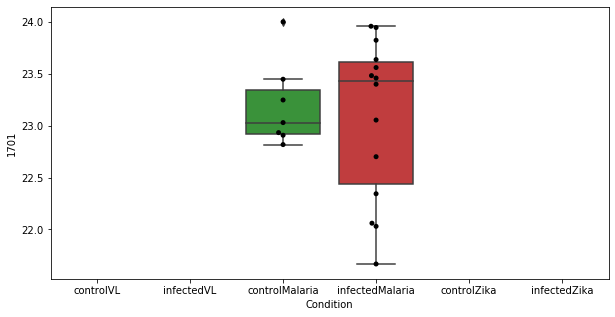

1420 row m/z                1041.68
row retention time     4.04603
p-val                 0.704413
adj.P.Val             0.964932
custom_id                 6295
compound_names             NaN
Name: 6295, dtype: object


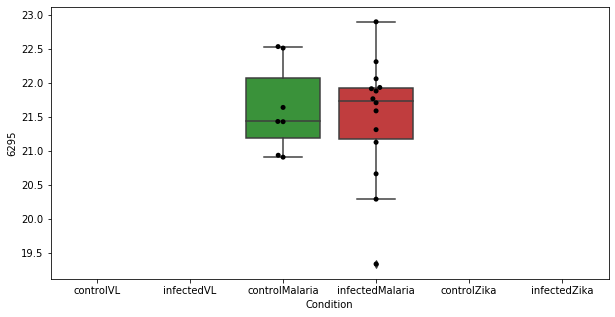

1421 row m/z                440.373
row retention time     3.45631
p-val                  0.70484
adj.P.Val             0.964932
custom_id                 2569
compound_names             NaN
Name: 2569, dtype: object


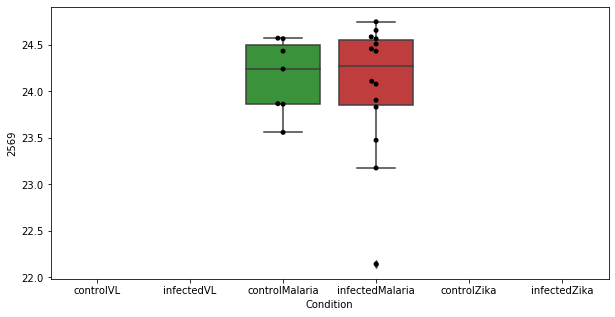

1422 row m/z                                                         165.055
row retention time                                              11.2913
p-val                                                          0.704882
adj.P.Val                                                      0.964932
custom_id                                                           986
compound_names        L-Tyrosine; (S)-3-(p-Hydroxyphenyl)alanine; (S...
Name: 986, dtype: object


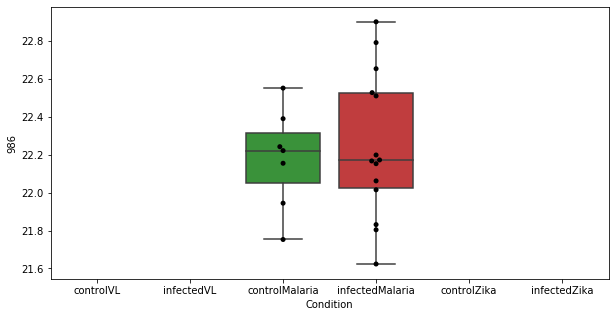

1423 row m/z                                               178.086
row retention time                                     9.3463
p-val                                                0.705744
adj.P.Val                                            0.964932
custom_id                                                3521
compound_names        $2-Phenyl-1,3-propanediol monocarbamate
Name: 3521, dtype: object


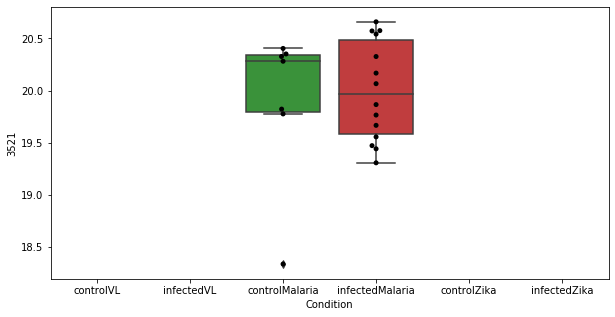

1424 row m/z                814.687
row retention time      6.7546
p-val                 0.705941
adj.P.Val             0.964932
custom_id                 2956
compound_names             NaN
Name: 2956, dtype: object


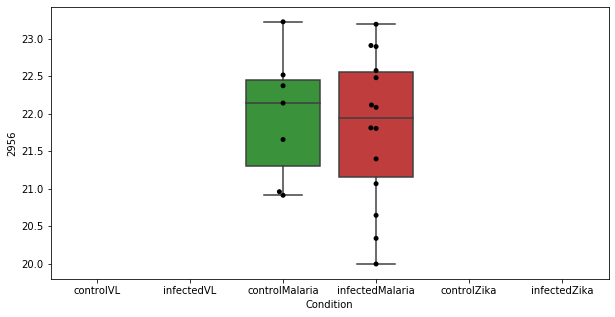

1425 row m/z                242.139
row retention time     3.85847
p-val                 0.705999
adj.P.Val             0.964932
custom_id                 1843
compound_names             NaN
Name: 1843, dtype: object


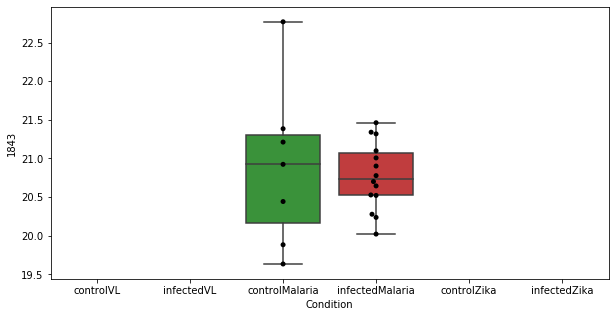

1426 row m/z                380.874
row retention time     12.0012
p-val                 0.707308
adj.P.Val             0.965189
custom_id                 2477
compound_names             NaN
Name: 2477, dtype: object


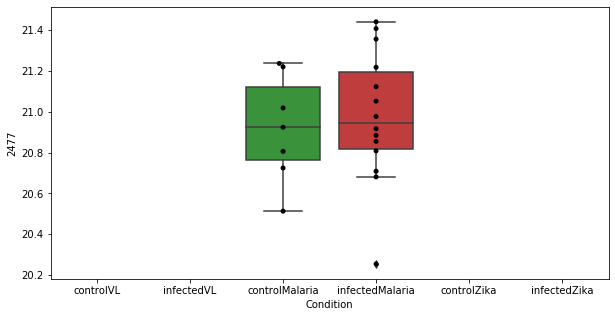

1427 row m/z                333.334
row retention time     7.01722
p-val                 0.707376
adj.P.Val             0.965189
custom_id                 2390
compound_names             NaN
Name: 2390, dtype: object


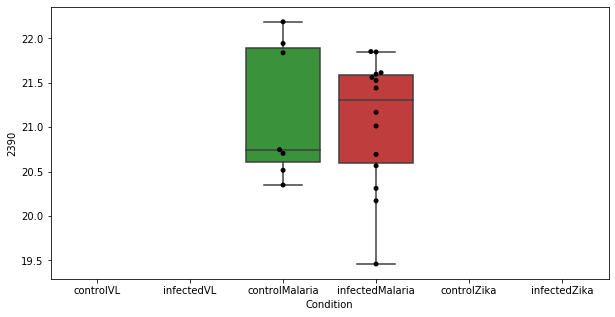

1428 row m/z                244.871
row retention time     12.5122
p-val                  0.70816
adj.P.Val             0.965189
custom_id                 1869
compound_names             NaN
Name: 1869, dtype: object


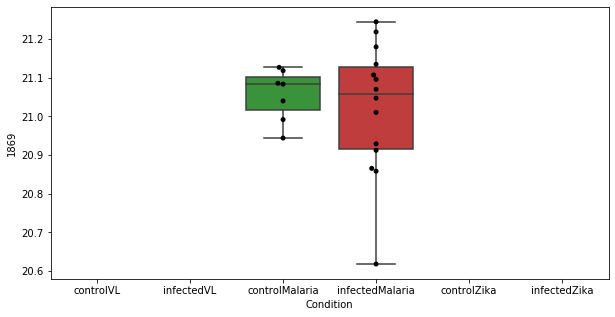

1429 row m/z                191.103
row retention time     10.0146
p-val                 0.708169
adj.P.Val             0.965189
custom_id                 1326
compound_names             NaN
Name: 1326, dtype: object


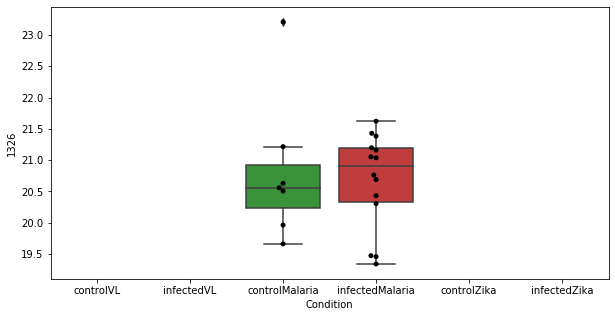

1430 row m/z                229.141
row retention time     12.8193
p-val                  0.70963
adj.P.Val             0.966506
custom_id                 3755
compound_names             NaN
Name: 3755, dtype: object


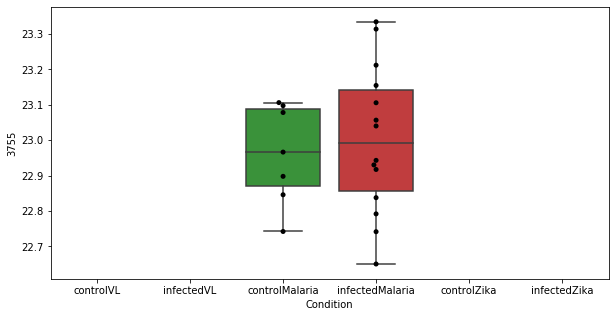

1431 row m/z                80.0495
row retention time     23.7694
p-val                 0.711714
adj.P.Val             0.968496
custom_id                   34
compound_names             NaN
Name: 34, dtype: object


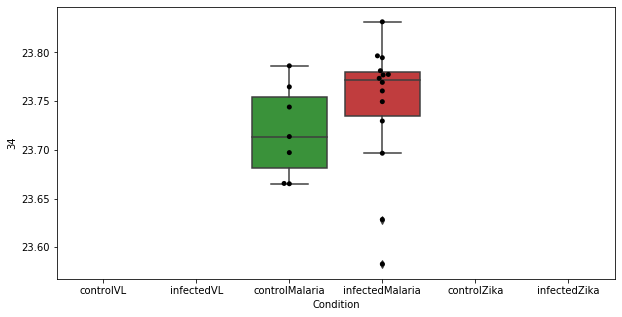

1432 row m/z                325.849
row retention time     23.6375
p-val                 0.712465
adj.P.Val             0.968496
custom_id                 2353
compound_names             NaN
Name: 2353, dtype: object


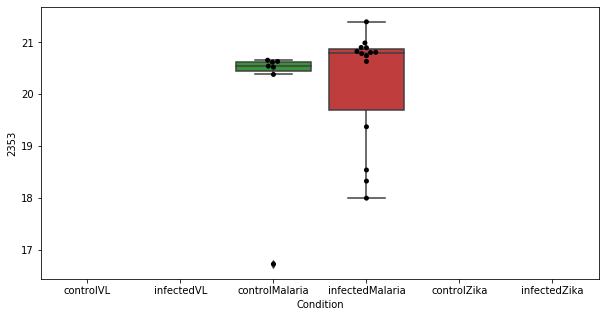

1433 row m/z                815.698
row retention time     6.69251
p-val                 0.713238
adj.P.Val             0.968496
custom_id                 2959
compound_names             NaN
Name: 2959, dtype: object


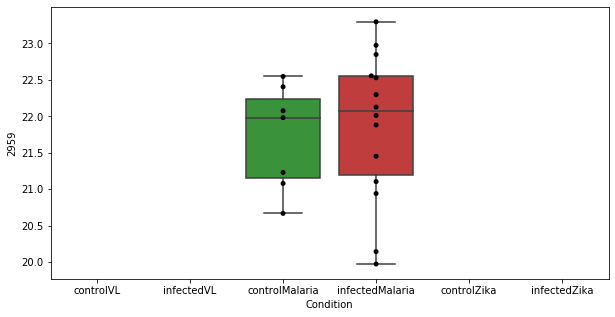

1434 row m/z                239.149
row retention time     4.58022
p-val                 0.713906
adj.P.Val             0.968496
custom_id                 1822
compound_names             NaN
Name: 1822, dtype: object


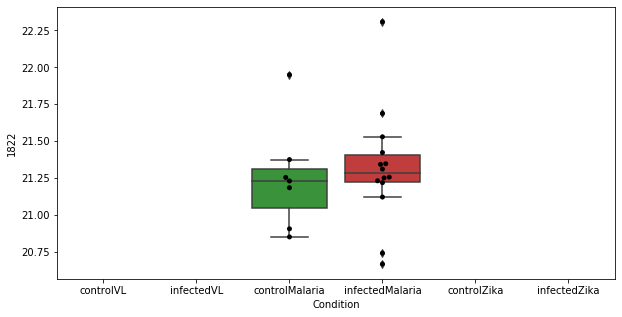

1435 row m/z                169.061
row retention time     7.79505
p-val                 0.714653
adj.P.Val             0.968496
custom_id                 1041
compound_names             NaN
Name: 1041, dtype: object


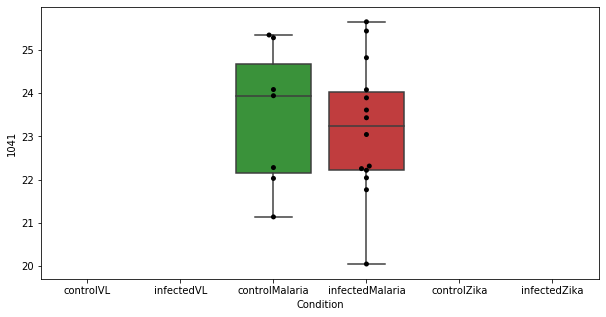

1436 row m/z                217.107
row retention time     4.70921
p-val                 0.714914
adj.P.Val             0.968496
custom_id                 1616
compound_names             NaN
Name: 1616, dtype: object


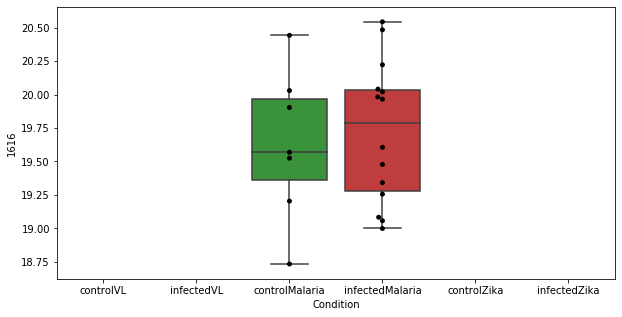

1437 row m/z                413.778
row retention time     3.26126
p-val                 0.715019
adj.P.Val             0.968496
custom_id                 2546
compound_names             NaN
Name: 2546, dtype: object


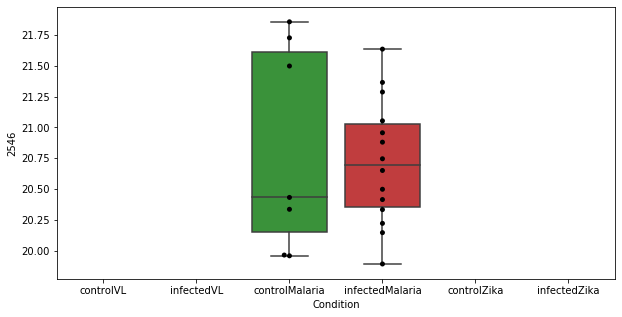

1438 row m/z                202.119
row retention time     9.62548
p-val                 0.715067
adj.P.Val             0.968496
custom_id                 1449
compound_names             NaN
Name: 1449, dtype: object


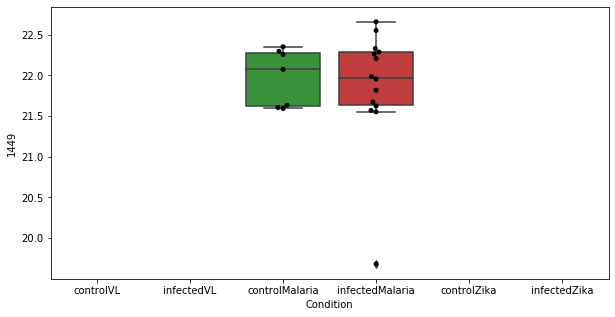

1439 row m/z               788.612
row retention time     3.4907
p-val                 0.71638
adj.P.Val              0.9696
custom_id                2918
compound_names            NaN
Name: 2918, dtype: object


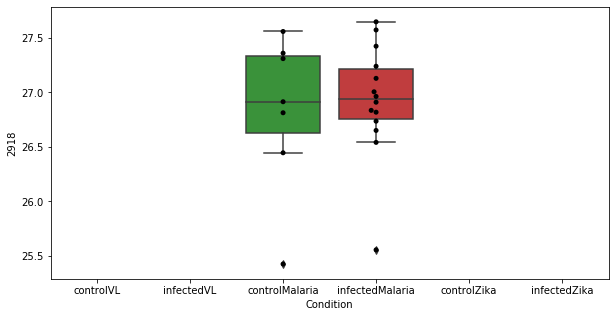

1440 row m/z                                                         138.066
row retention time                                              23.9502
p-val                                                          0.717364
adj.P.Val                                                      0.970258
custom_id                                                           622
compound_names        L-Histidine; (S)-alpha-Amino-1H-imidazole-4-pr...
Name: 622, dtype: object


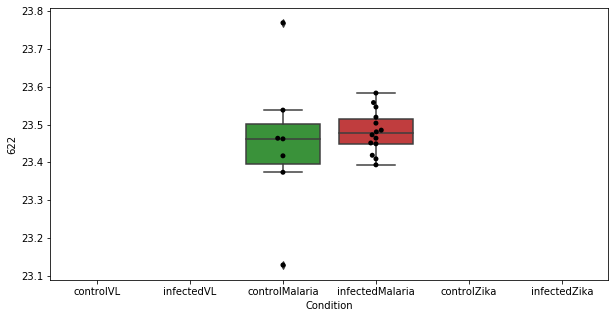

1441 row m/z                                                         154.059
row retention time                                              12.1568
p-val                                                          0.720853
adj.P.Val                                                      0.973509
custom_id                                                           852
compound_names        Creatine; alpha-Methylguanidino acetic acid; M...
Name: 852, dtype: object


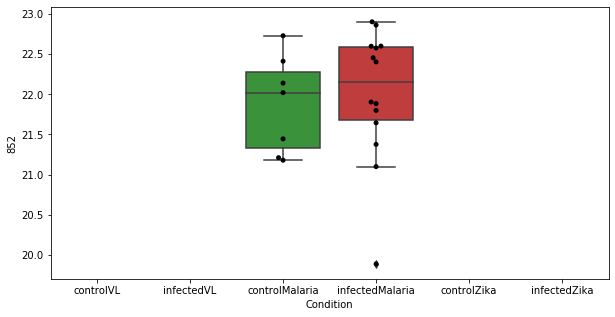

1442 row m/z                                                         256.165
row retention time                                              9.49508
p-val                                                          0.721573
adj.P.Val                                                      0.973509
custom_id                                                          5044
compound_names        3-oxo-6(S)-hydroxy-tetradec-8Z-enoate$3-oxo-6(...
Name: 5044, dtype: object


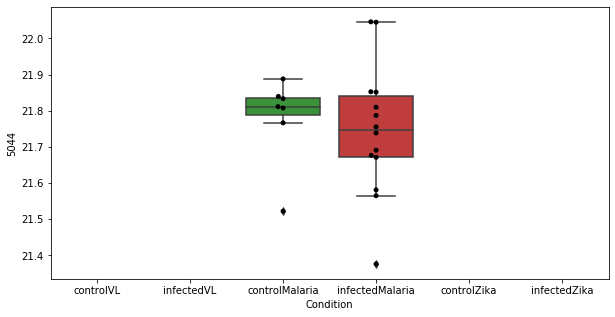

1443 row m/z                                                         130.086
row retention time                                               4.5869
p-val                                                          0.721639
adj.P.Val                                                      0.973509
custom_id                                                           519
compound_names        N4-Acetylaminobutanal$L-Pipecolate; Pipecolini...
Name: 519, dtype: object


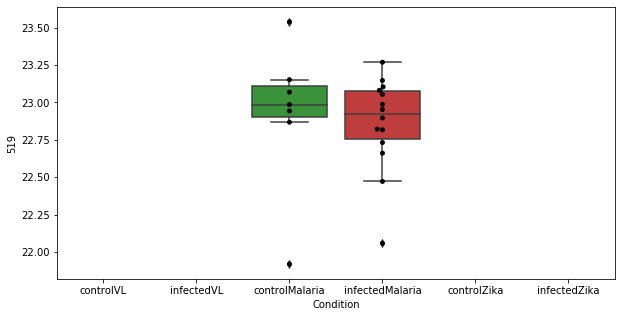

1444 row m/z                562.413
row retention time     3.42913
p-val                 0.721765
adj.P.Val             0.973509
custom_id                 2706
compound_names             NaN
Name: 2706, dtype: object


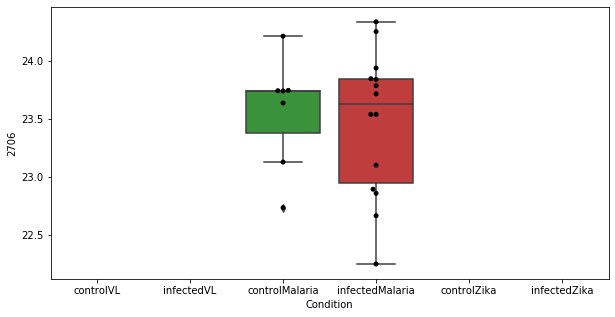

1445 row m/z                103.955
row retention time     23.6771
p-val                 0.722836
adj.P.Val             0.974147
custom_id                  156
compound_names             NaN
Name: 156, dtype: object


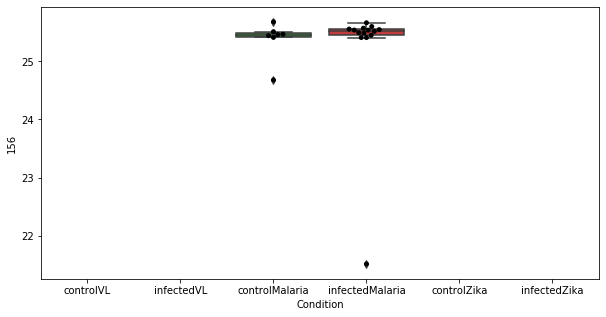

1446 row m/z                125.096
row retention time     4.57438
p-val                 0.723238
adj.P.Val             0.974147
custom_id                  444
compound_names             NaN
Name: 444, dtype: object


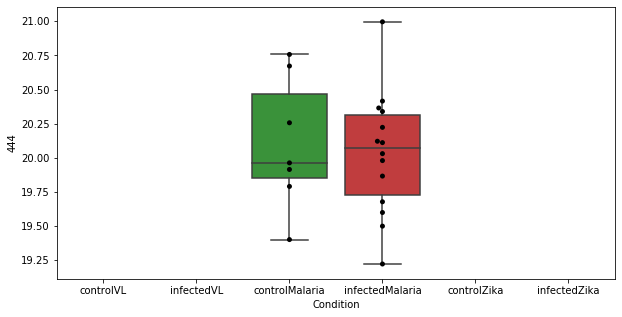

1447 row m/z                276.107
row retention time      12.326
p-val                 0.723946
adj.P.Val             0.974427
custom_id                 2093
compound_names             NaN
Name: 2093, dtype: object


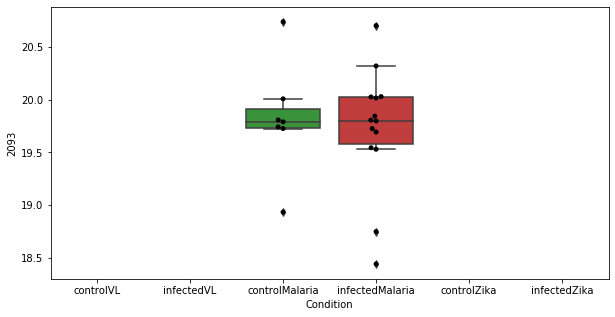

1448 row m/z                              154.072
row retention time                    9.4041
p-val                               0.725512
adj.P.Val                           0.975218
custom_id                               3399
compound_names        Adenine; 6-Aminopurine
Name: 3399, dtype: object


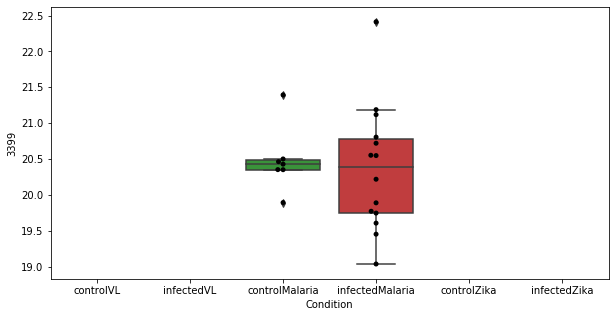

1449 row m/z                305.303
row retention time     7.23033
p-val                 0.726459
adj.P.Val             0.975218
custom_id                 4044
compound_names             NaN
Name: 4044, dtype: object


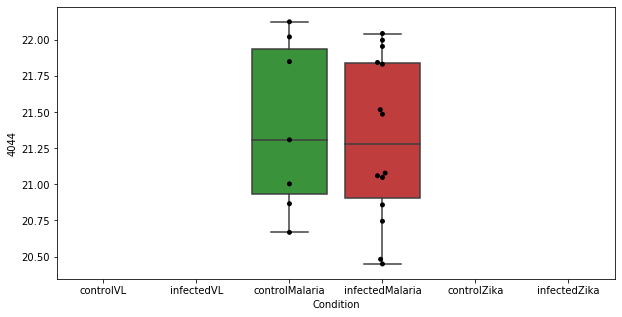

1450 row m/z                192.888
row retention time     23.7499
p-val                 0.726994
adj.P.Val             0.975218
custom_id                 1340
compound_names             NaN
Name: 1340, dtype: object


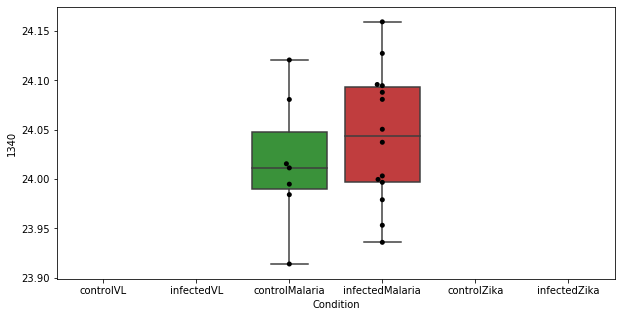

1451 row m/z                235.169
row retention time     3.73375
p-val                 0.727225
adj.P.Val             0.975218
custom_id                 1776
compound_names             NaN
Name: 1776, dtype: object


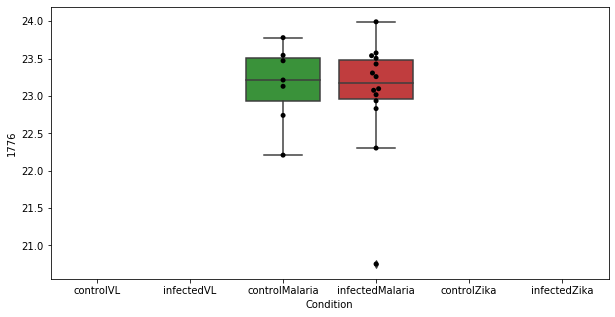

1452 row m/z                105.042
row retention time     23.7594
p-val                 0.727735
adj.P.Val             0.975218
custom_id                  175
compound_names             NaN
Name: 175, dtype: object


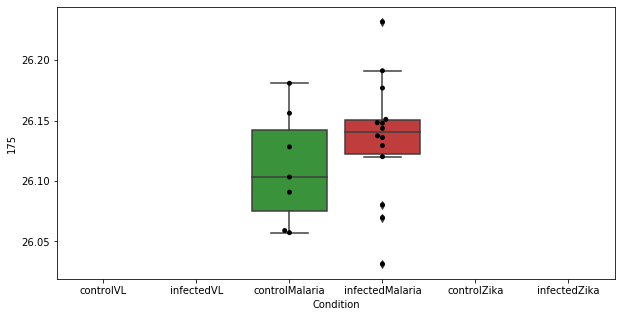

1453 row m/z                                                         265.118
row retention time                                               5.4868
p-val                                                          0.727807
adj.P.Val                                                      0.975218
custom_id                                                          2001
compound_names        Formyl-N-acetyl-5-methoxykynurenamine$alpha-N-...
Name: 2001, dtype: object


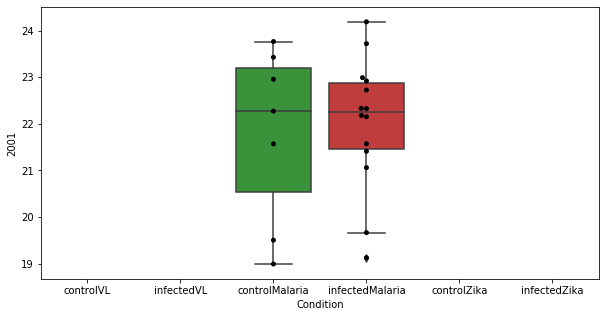

1454 row m/z                                                         114.066
row retention time                                              12.1231
p-val                                                          0.728243
adj.P.Val                                                      0.975218
custom_id                                                           287
compound_names        Creatine; alpha-Methylguanidino acetic acid; M...
Name: 287, dtype: object


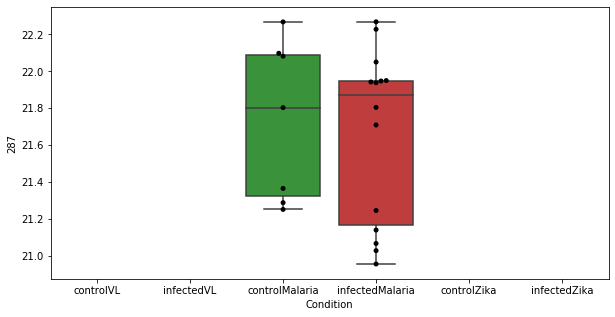

1455 row m/z                                                         118.086
row retention time                                              10.7987
p-val                                                          0.728537
adj.P.Val                                                      0.975218
custom_id                                                           350
compound_names        6-Amino-2-oxohexanoate; 2-Oxo-6-aminocaproate$...
Name: 350, dtype: object


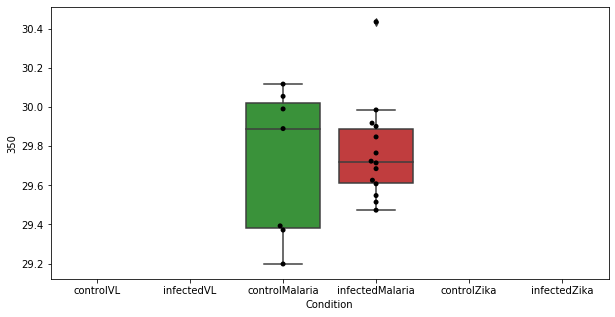

1456 row m/z                194.886
row retention time     23.7903
p-val                 0.729375
adj.P.Val              0.97567
custom_id                 1379
compound_names             NaN
Name: 1379, dtype: object


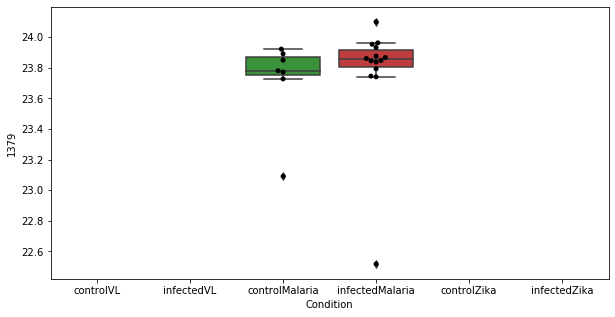

1457 row m/z                 118.12
row retention time     10.7971
p-val                 0.730636
adj.P.Val              0.97569
custom_id                  353
compound_names             NaN
Name: 353, dtype: object


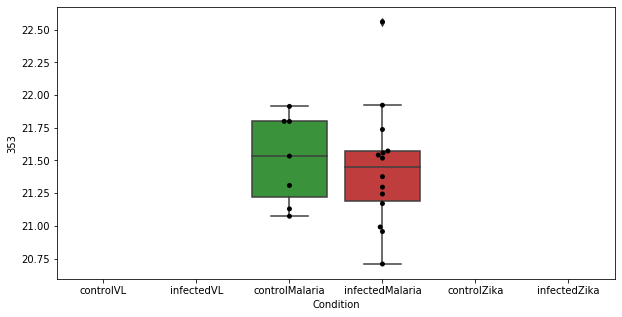

1458 row m/z                                95.0604
row retention time                     23.9157
p-val                                 0.730726
adj.P.Val                              0.97569
custom_id                                 4376
compound_names        Urocanate; Urocanic acid
Name: 4376, dtype: object


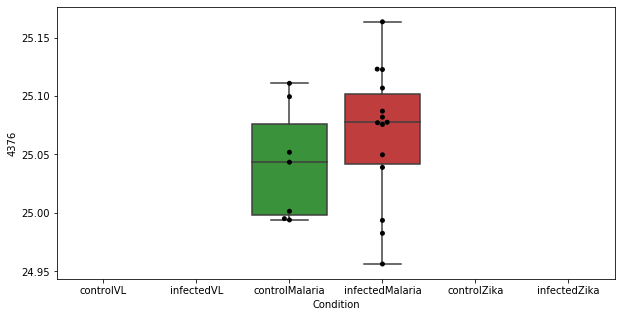

1459 row m/z                340.041
row retention time      9.8519
p-val                 0.730915
adj.P.Val              0.97569
custom_id                 2398
compound_names             NaN
Name: 2398, dtype: object


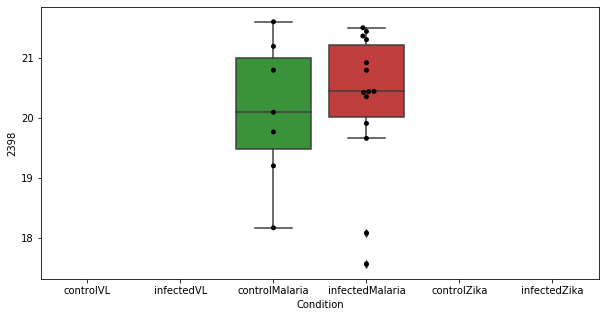

1460 row m/z                192.159
row retention time     23.6978
p-val                 0.731413
adj.P.Val              0.97569
custom_id                 4839
compound_names             NaN
Name: 4839, dtype: object


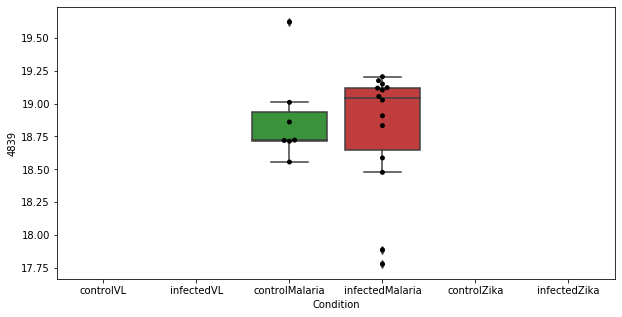

1461 row m/z                215.094
row retention time     10.6665
p-val                 0.733098
adj.P.Val              0.97569
custom_id                 3688
compound_names             NaN
Name: 3688, dtype: object


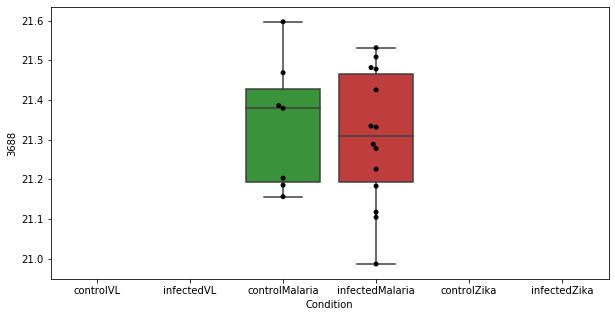

1462 row m/z                404.206
row retention time     3.75892
p-val                 0.734148
adj.P.Val              0.97569
custom_id                 2532
compound_names             NaN
Name: 2532, dtype: object


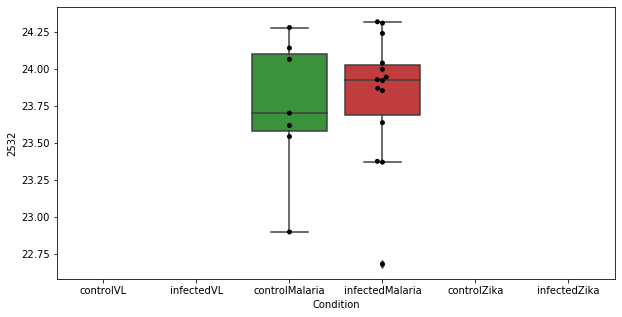

1463 row m/z                191.103
row retention time      11.298
p-val                 0.734331
adj.P.Val              0.97569
custom_id                 1327
compound_names             NaN
Name: 1327, dtype: object


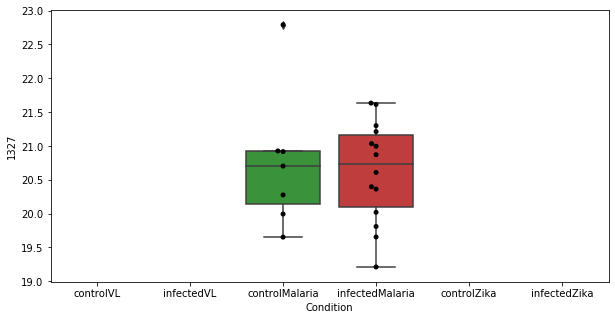

1464 row m/z                229.118
row retention time     10.6582
p-val                 0.734494
adj.P.Val              0.97569
custom_id                 3754
compound_names             NaN
Name: 3754, dtype: object


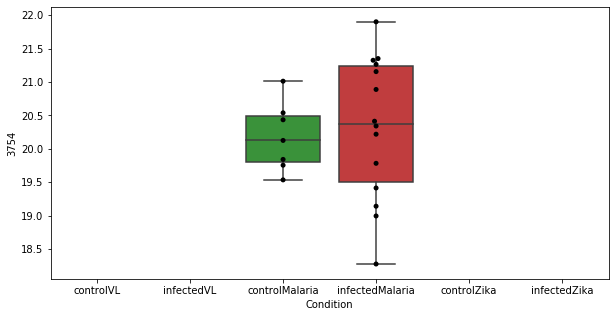

1465 row m/z                 268.14
row retention time     9.52244
p-val                 0.735723
adj.P.Val              0.97569
custom_id                 3910
compound_names             NaN
Name: 3910, dtype: object


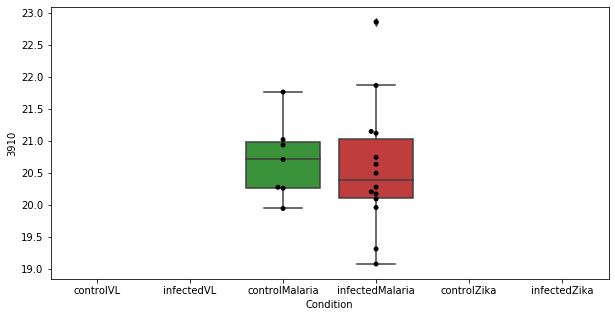

1466 row m/z                814.626
row retention time     3.46163
p-val                 0.735745
adj.P.Val              0.97569
custom_id                 2954
compound_names             NaN
Name: 2954, dtype: object


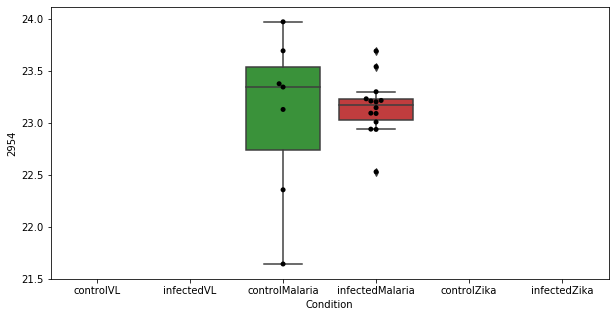

1467 row m/z                                           136.076
row retention time                                7.03142
p-val                                            0.735807
adj.P.Val                                         0.97569
custom_id                                             603
compound_names        2-Phenylacetamide$N-Acetylarylamine
Name: 603, dtype: object


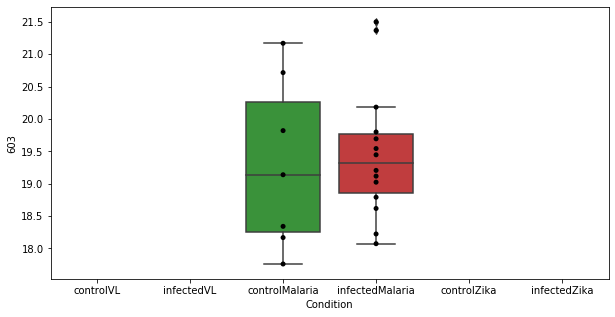

1468 row m/z                316.212
row retention time     3.76789
p-val                 0.735962
adj.P.Val              0.97569
custom_id                 2323
compound_names             NaN
Name: 2323, dtype: object


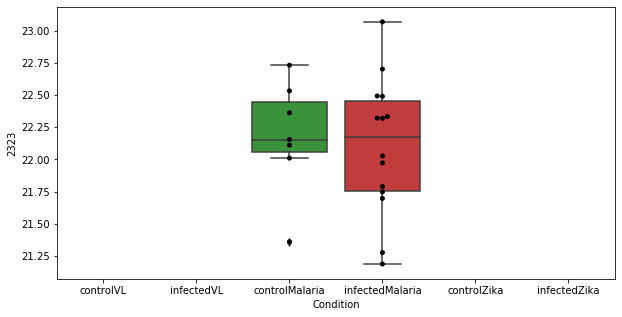

1469 row m/z                           201.112
row retention time                4.49034
p-val                            0.737112
adj.P.Val                         0.97569
custom_id                            1443
compound_names        propionyl-carnitine
Name: 1443, dtype: object


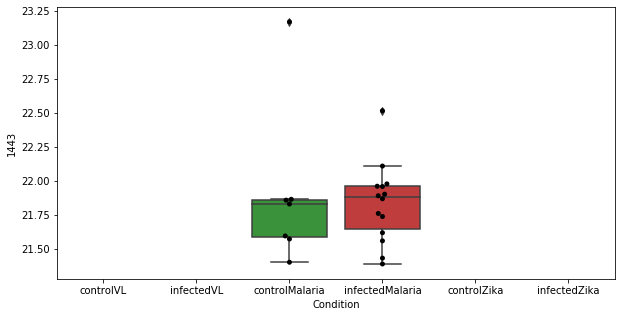

1470 row m/z                812.613
row retention time     6.56189
p-val                 0.737389
adj.P.Val              0.97569
custom_id                 2948
compound_names             NaN
Name: 2948, dtype: object


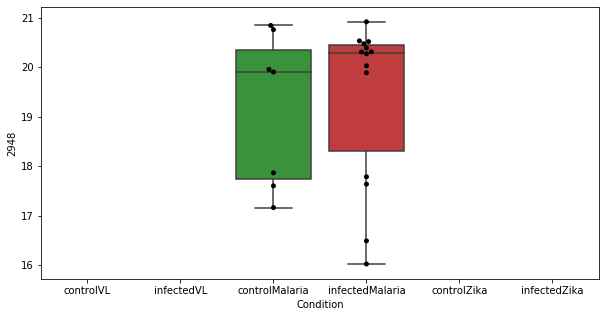

1471 row m/z                                                         172.097
row retention time                                              6.99745
p-val                                                          0.737849
adj.P.Val                                                       0.97569
custom_id                                                          1096
compound_names        Dopamine; 4-(2-Aminoethyl)-1,2-benzenediol; 4-...
Name: 1096, dtype: object


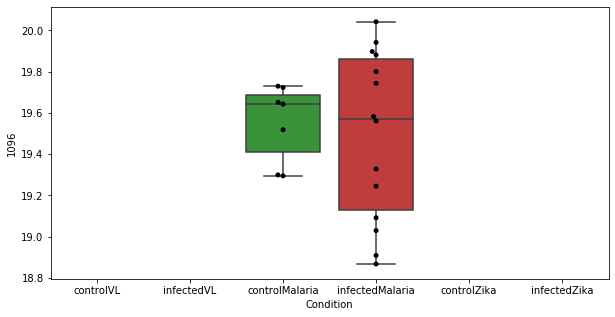

1472 row m/z                595.493
row retention time     3.26534
p-val                 0.738259
adj.P.Val              0.97569
custom_id                 2745
compound_names             NaN
Name: 2745, dtype: object


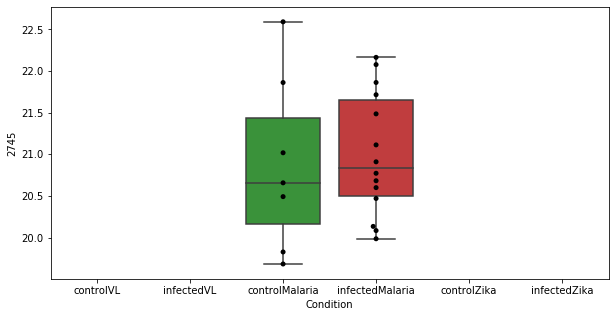

1473 row m/z                105.954
row retention time      23.674
p-val                 0.738279
adj.P.Val              0.97569
custom_id                  198
compound_names             NaN
Name: 198, dtype: object


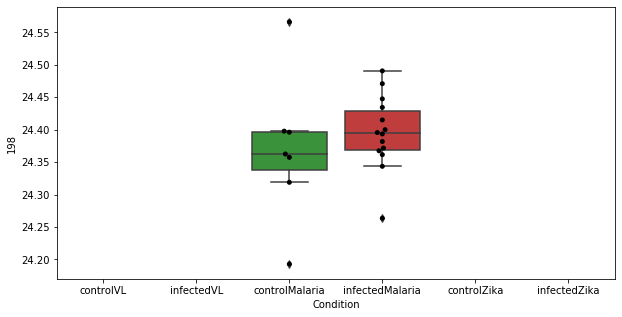

1474 row m/z                131.162
row retention time     10.1601
p-val                 0.739367
adj.P.Val              0.97569
custom_id                  540
compound_names             NaN
Name: 540, dtype: object


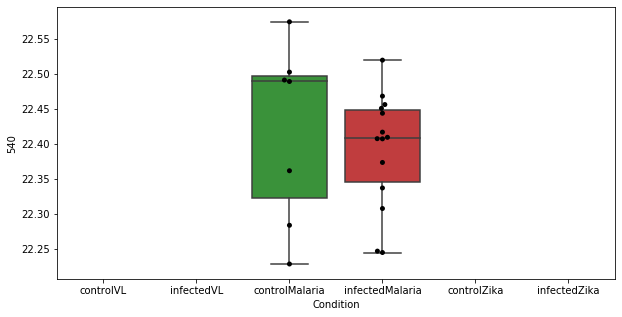

1475 row m/z                 729.59
row retention time     3.73358
p-val                 0.739787
adj.P.Val              0.97569
custom_id                 2839
compound_names             NaN
Name: 2839, dtype: object


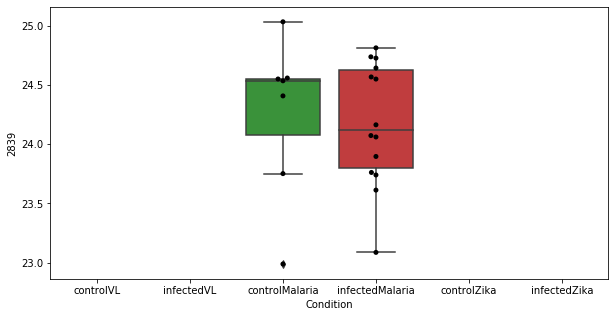

1476 row m/z                                                         133.069
row retention time                                              12.0115
p-val                                                          0.739799
adj.P.Val                                                       0.97569
custom_id                                                           571
compound_names        5-Aminolevulinate; 5-Amino-4-oxopentanoate; 5-...
Name: 571, dtype: object


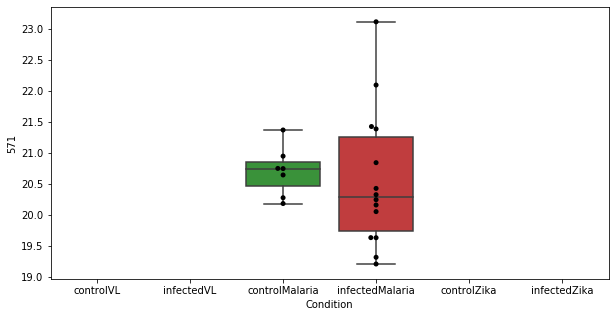

1477 row m/z                526.883
row retention time     12.0181
p-val                 0.740309
adj.P.Val              0.97569
custom_id                 2657
compound_names             NaN
Name: 2657, dtype: object


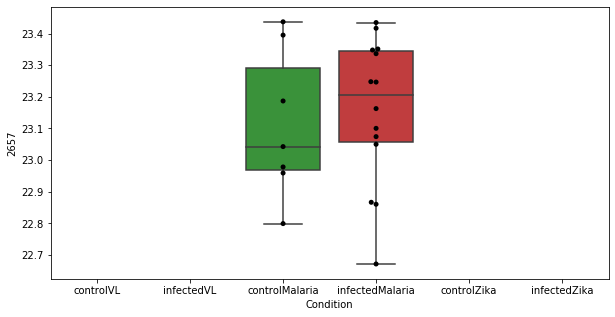

1478 row m/z                                                         172.097
row retention time                                              4.60458
p-val                                                          0.741306
adj.P.Val                                                       0.97569
custom_id                                                          1095
compound_names        Dopamine; 4-(2-Aminoethyl)-1,2-benzenediol; 4-...
Name: 1095, dtype: object


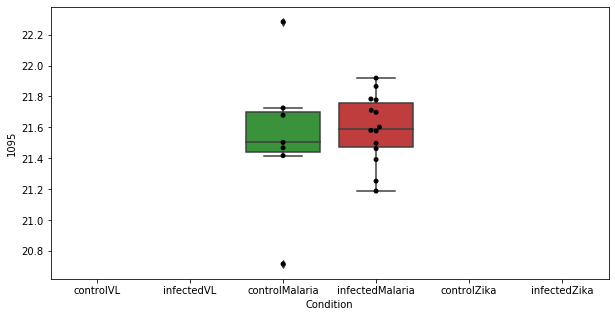

1479 row m/z                 169.98
row retention time     2.82544
p-val                 0.741472
adj.P.Val              0.97569
custom_id                 5729
compound_names             NaN
Name: 5729, dtype: object


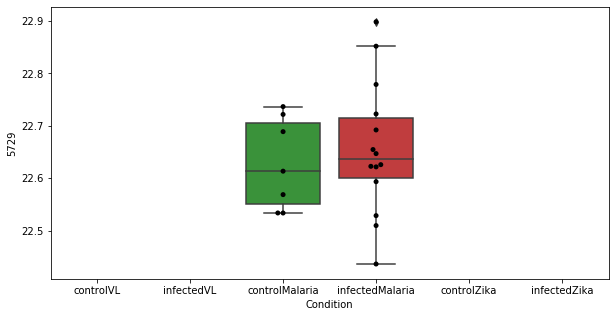

1480 row m/z                                                         187.097
row retention time                                               6.9952
p-val                                                          0.741533
adj.P.Val                                                       0.97569
custom_id                                                          1269
compound_names        N-Trimethyl-2-aminoethylphosphonate; 2-Trimeth...
Name: 1269, dtype: object


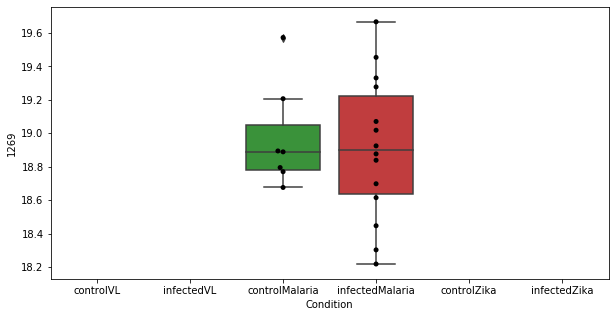

1481 row m/z                100.112
row retention time     23.5427
p-val                 0.741905
adj.P.Val              0.97569
custom_id                  127
compound_names             NaN
Name: 127, dtype: object


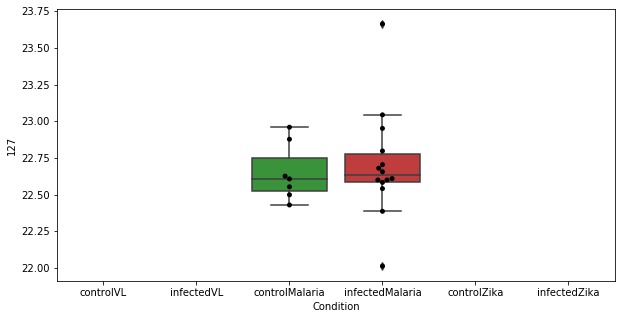

1482 row m/z                127.123
row retention time     9.60242
p-val                 0.743504
adj.P.Val             0.976955
custom_id                  461
compound_names             NaN
Name: 461, dtype: object


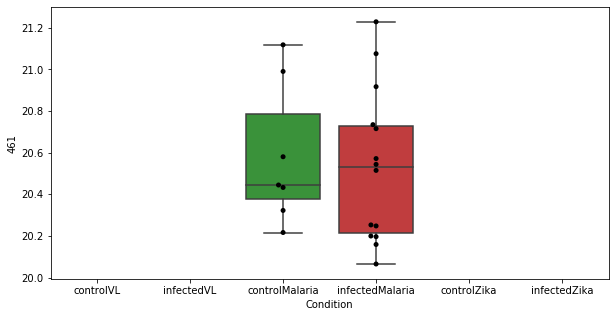

1483 row m/z                79.9897
row retention time     23.5015
p-val                 0.743934
adj.P.Val             0.976955
custom_id                   30
compound_names             NaN
Name: 30, dtype: object


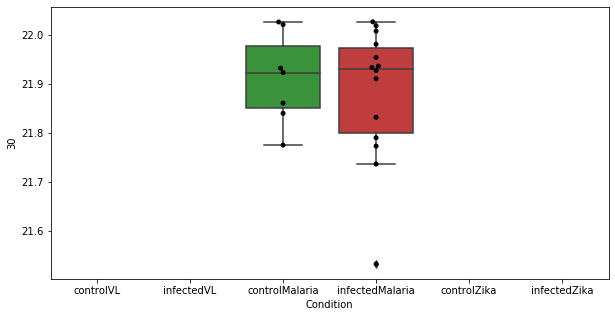

1484 row m/z                                                         166.086
row retention time                                              9.14699
p-val                                                          0.744423
adj.P.Val                                                      0.976955
custom_id                                                          1001
compound_names        L-Normetanephrine$L-Adrenaline; (R)-(-)-Adrena...
Name: 1001, dtype: object


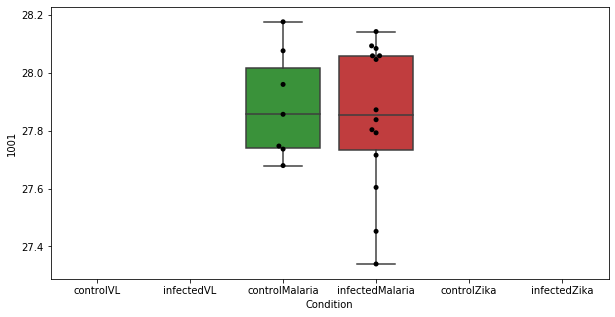

1485 row m/z                276.158
row retention time     23.3115
p-val                 0.744872
adj.P.Val             0.976955
custom_id                 2102
compound_names             NaN
Name: 2102, dtype: object


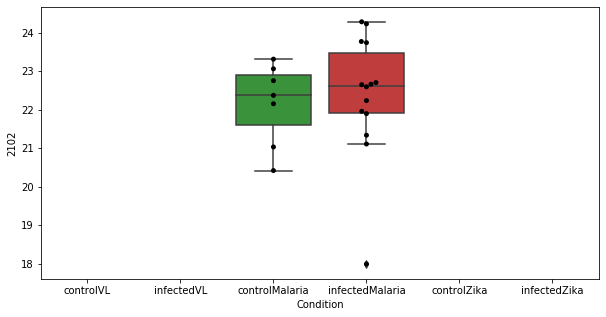

1486 row m/z                221.154
row retention time     3.80956
p-val                 0.746733
adj.P.Val             0.977814
custom_id                 1645
compound_names             NaN
Name: 1645, dtype: object


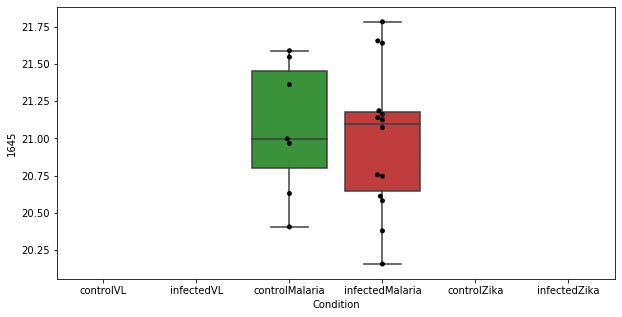

1487 row m/z                                    189.16
row retention time                        16.1919
p-val                                    0.747418
adj.P.Val                                0.977814
custom_id                                    1302
compound_names        N6,N6,N6-Trimethyl-L-lysine
Name: 1302, dtype: object


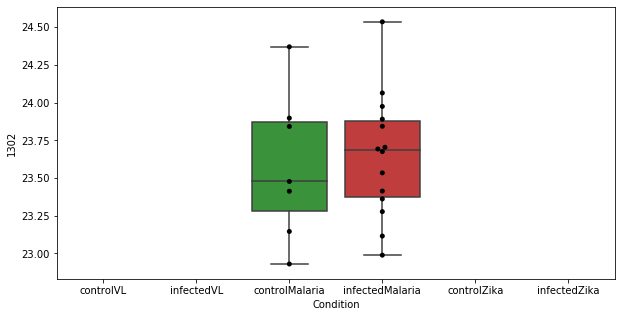

1488 row m/z                218.102
row retention time     6.99201
p-val                 0.747474
adj.P.Val             0.977814
custom_id                 1626
compound_names             NaN
Name: 1626, dtype: object


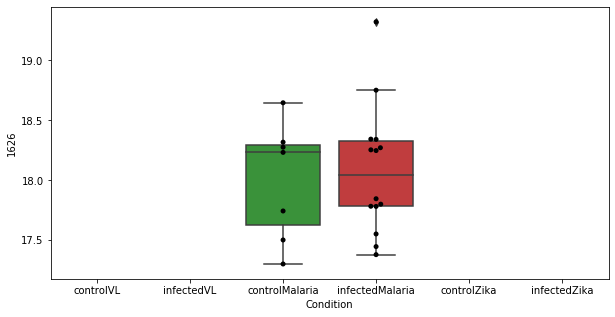

1489 row m/z                194.147
row retention time     4.37755
p-val                 0.748836
adj.P.Val             0.977814
custom_id                 1375
compound_names             NaN
Name: 1375, dtype: object


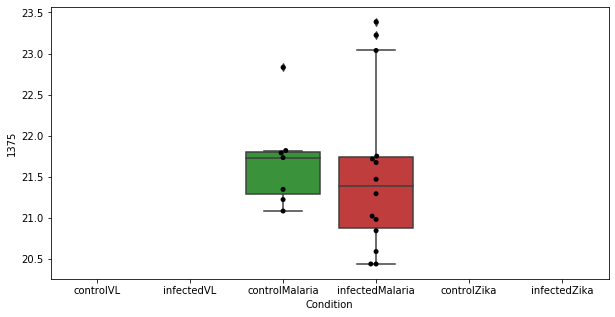

1490 row m/z                                                         170.092
row retention time                                              12.1585
p-val                                                          0.748887
adj.P.Val                                                      0.977814
custom_id                                                          3480
compound_names        N(pi)-Methyl-L-histidine; 1-Methylhistidine; N...
Name: 3480, dtype: object


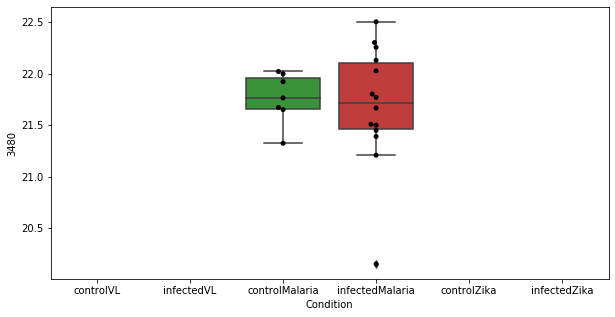

1491 row m/z                121.101
row retention time     3.82995
p-val                 0.749022
adj.P.Val             0.977814
custom_id                 3196
compound_names               $
Name: 3196, dtype: object


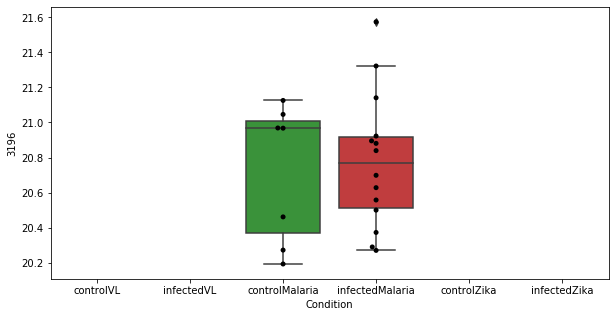

1492 row m/z                162.167
row retention time     11.1008
p-val                 0.749868
adj.P.Val             0.977814
custom_id                 4714
compound_names             NaN
Name: 4714, dtype: object


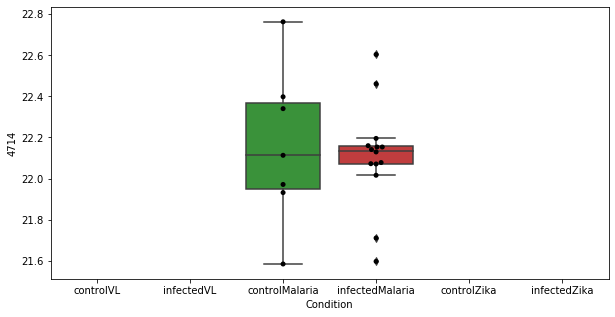

1493 row m/z                 147.04
row retention time     3.89891
p-val                 0.750184
adj.P.Val             0.977814
custom_id                  756
compound_names             NaN
Name: 756, dtype: object


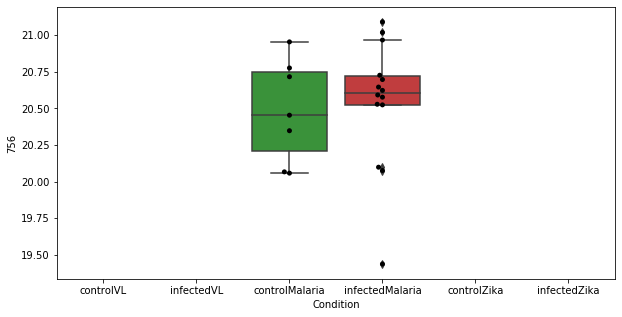

1494 row m/z                208.938
row retention time     12.9746
p-val                 0.751198
adj.P.Val             0.977814
custom_id                 1507
compound_names             NaN
Name: 1507, dtype: object


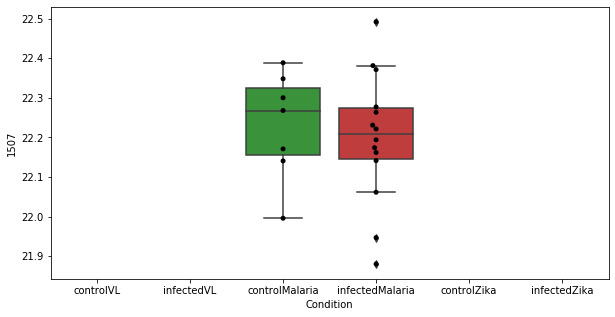

1495 row m/z                799.668
row retention time     3.62669
p-val                 0.751898
adj.P.Val             0.977814
custom_id                 2928
compound_names             NaN
Name: 2928, dtype: object


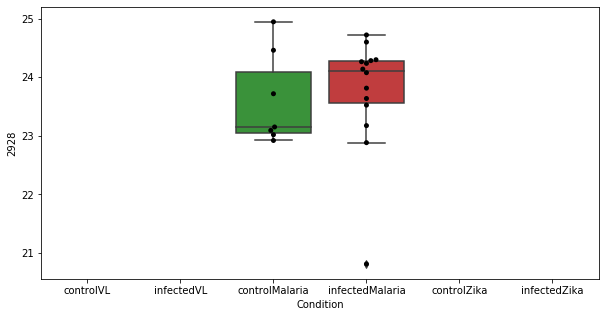

1496 row m/z                186.912
row retention time     12.5423
p-val                 0.752357
adj.P.Val             0.977814
custom_id                 1263
compound_names             NaN
Name: 1263, dtype: object


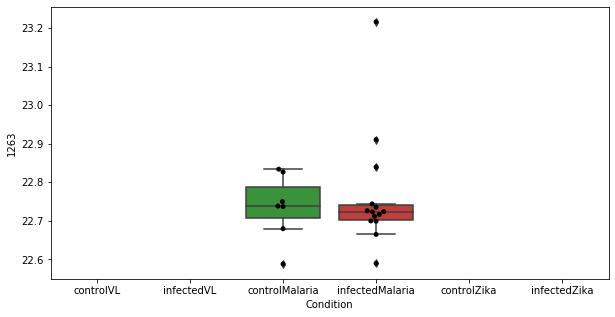

1497 row m/z                            146.118
row retention time                 11.0737
p-val                              0.75365
adj.P.Val                         0.977814
custom_id                              742
compound_names        3-Dehydroxycarnitine
Name: 742, dtype: object


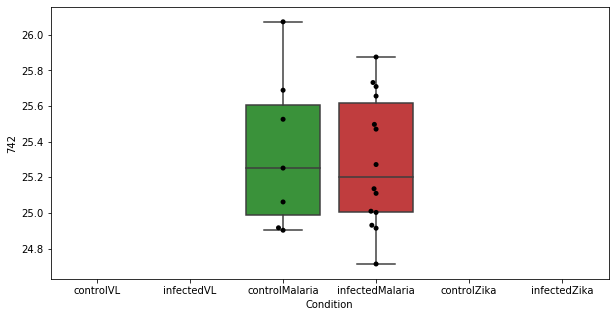

1498 row m/z                614.535
row retention time     3.24411
p-val                 0.754046
adj.P.Val             0.977814
custom_id                 2756
compound_names             NaN
Name: 2756, dtype: object


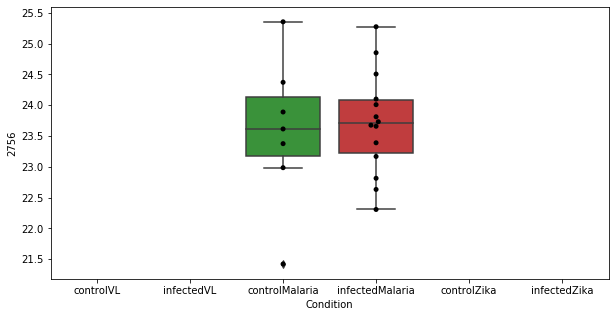

1499 row m/z                178.899
row retention time     12.4985
p-val                 0.754372
adj.P.Val             0.977814
custom_id                 1156
compound_names             NaN
Name: 1156, dtype: object


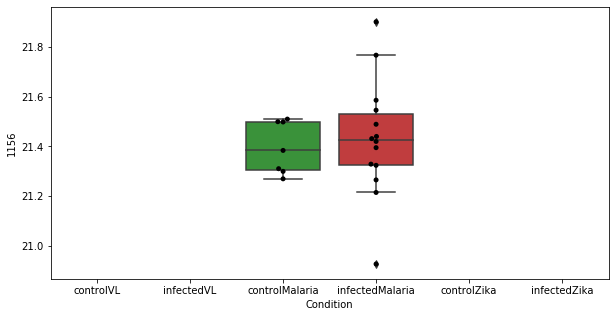

1500 row m/z                242.284
row retention time     7.00561
p-val                  0.75555
adj.P.Val             0.977814
custom_id                 1846
compound_names             NaN
Name: 1846, dtype: object


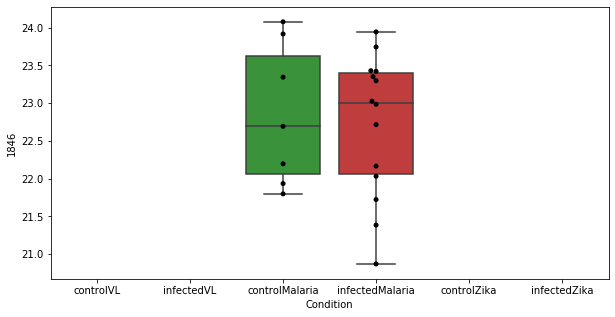

1501 row m/z                179.128
row retention time     5.40479
p-val                  0.75638
adj.P.Val             0.977814
custom_id                 1168
compound_names             NaN
Name: 1168, dtype: object


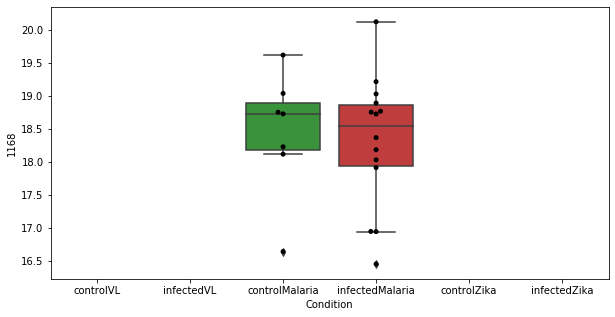

1502 row m/z                168.069
row retention time     6.75558
p-val                 0.756392
adj.P.Val             0.977814
custom_id                 1024
compound_names             NaN
Name: 1024, dtype: object


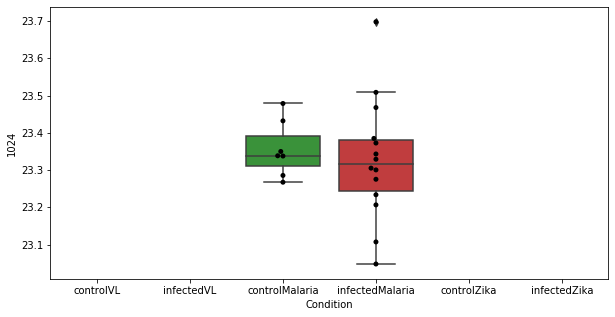

1503 row m/z                778.828
row retention time     13.1899
p-val                 0.756395
adj.P.Val             0.977814
custom_id                 2889
compound_names             NaN
Name: 2889, dtype: object


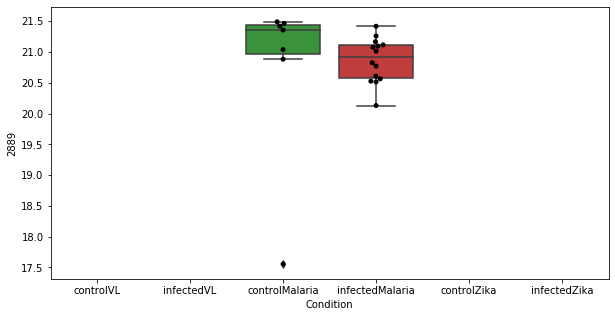

1504 row m/z                85.0997
row retention time     3.40764
p-val                 0.756494
adj.P.Val             0.977814
custom_id                 3036
compound_names             NaN
Name: 3036, dtype: object


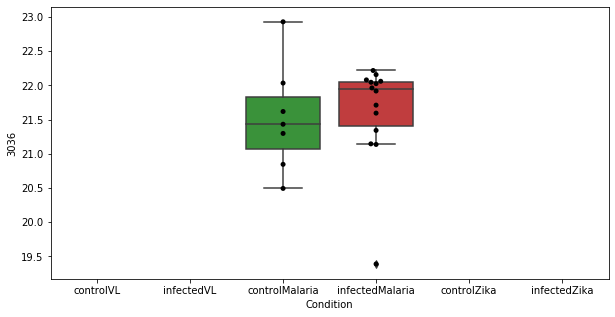

1505 row m/z                                                         132.066
row retention time                                              7.00672
p-val                                                          0.758448
adj.P.Val                                                      0.977814
custom_id                                                          6480
compound_names        2-Amino-4-oxopentanoic acid; 2-Amino-4-oxopent...
Name: 6480, dtype: object


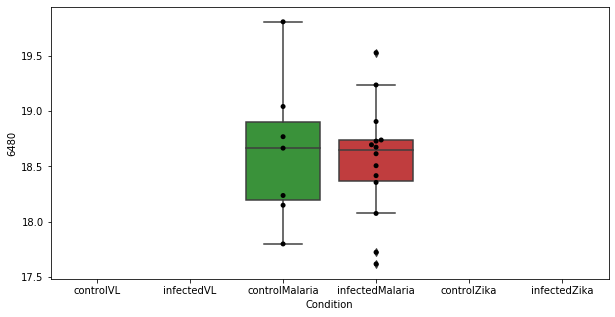

1506 row m/z                                                         136.076
row retention time                                              11.2885
p-val                                                          0.759654
adj.P.Val                                                      0.977814
custom_id                                                           601
compound_names        L-Tyrosine; (S)-3-(p-Hydroxyphenyl)alanine; (S...
Name: 601, dtype: object


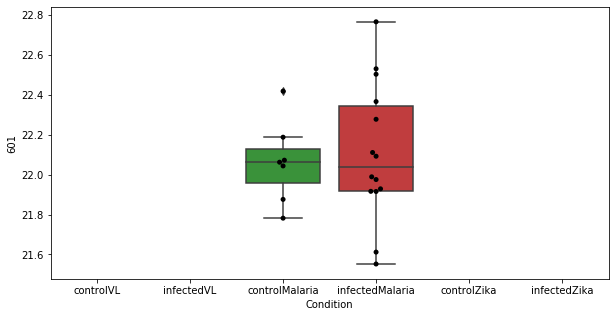

1507 row m/z                268.212
row retention time     4.06115
p-val                 0.759678
adj.P.Val             0.977814
custom_id                 2042
compound_names             NaN
Name: 2042, dtype: object


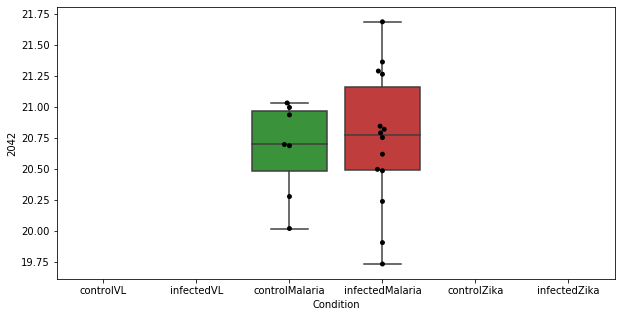

1508 row m/z                80.9478
row retention time     12.5035
p-val                 0.760027
adj.P.Val             0.977814
custom_id                   40
compound_names             NaN
Name: 40, dtype: object


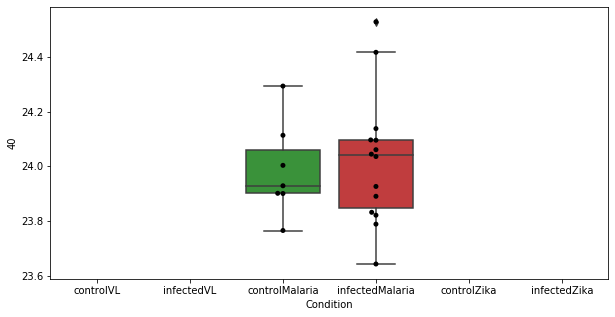

1509 row m/z                            128.082
row retention time                 10.6943
p-val                             0.760166
adj.P.Val                         0.977814
custom_id                              470
compound_names        4-Guanidinobutanoate
Name: 470, dtype: object


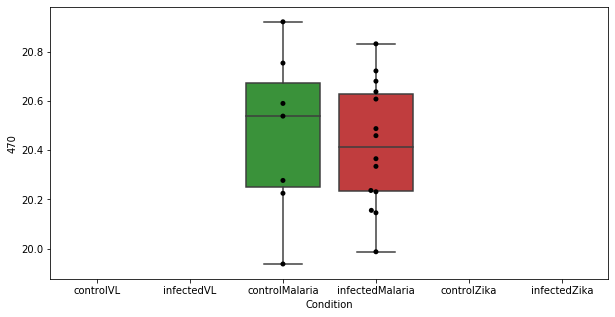

1510 row m/z                                                         131.053
row retention time                                              12.3132
p-val                                                          0.760385
adj.P.Val                                                      0.977814
custom_id                                                           529
compound_names        1-Pyrroline-4-hydroxy-2-carboxylate$L-1-Pyrrol...
Name: 529, dtype: object


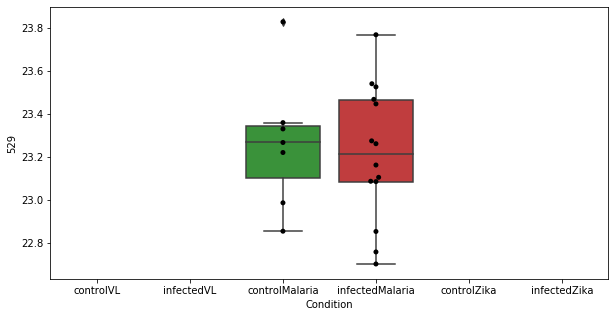

1511 row m/z                332.207
row retention time     3.85937
p-val                 0.760754
adj.P.Val             0.977814
custom_id                 4094
compound_names             NaN
Name: 4094, dtype: object


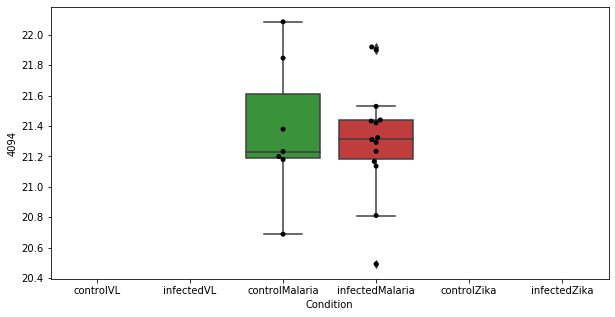

1512 row m/z                119.083
row retention time     10.8058
p-val                  0.76114
adj.P.Val             0.977814
custom_id                  360
compound_names             NaN
Name: 360, dtype: object


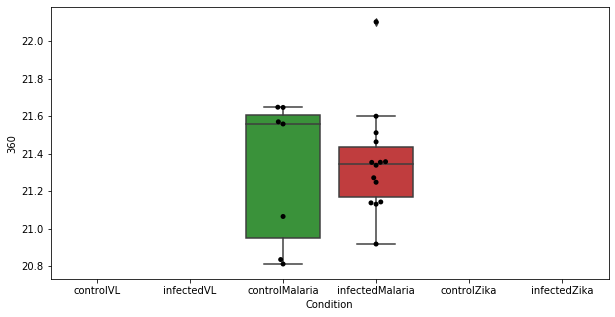

1513 row m/z                 411.78
row retention time     7.04152
p-val                 0.761606
adj.P.Val             0.977814
custom_id                 2539
compound_names             NaN
Name: 2539, dtype: object


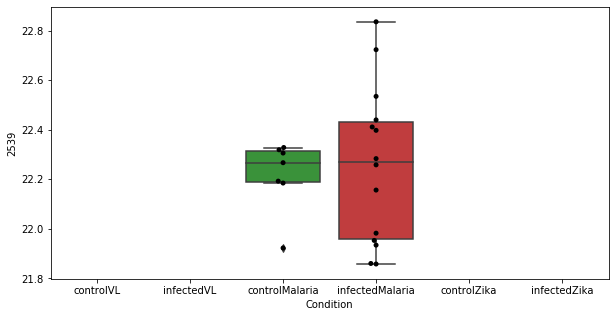

1514 row m/z                246.133
row retention time     10.2977
p-val                 0.761762
adj.P.Val             0.977814
custom_id                 3830
compound_names             NaN
Name: 3830, dtype: object


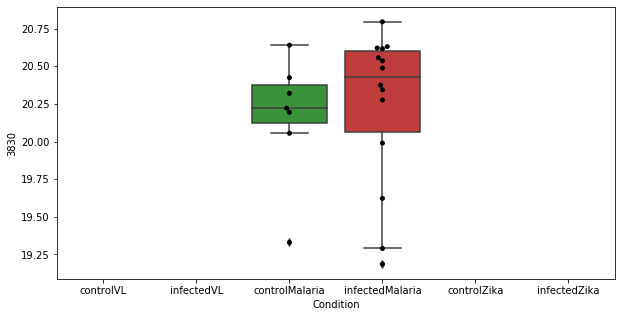

1515 row m/z                                                         218.139
row retention time                                              6.98448
p-val                                                          0.762231
adj.P.Val                                                      0.977814
custom_id                                                          1630
compound_names        Ecgonine methyl ester; Methyl ecgonine$ecgonin...
Name: 1630, dtype: object


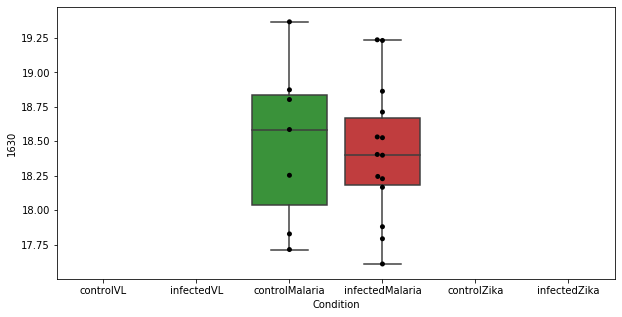

1516 row m/z                127.966
row retention time     5.61565
p-val                 0.762293
adj.P.Val             0.977814
custom_id                 4529
compound_names             NaN
Name: 4529, dtype: object


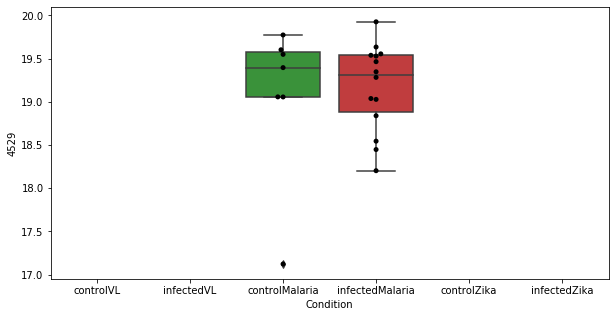

1517 row m/z                773.588
row retention time     3.52193
p-val                 0.762549
adj.P.Val             0.977814
custom_id                 2884
compound_names             NaN
Name: 2884, dtype: object


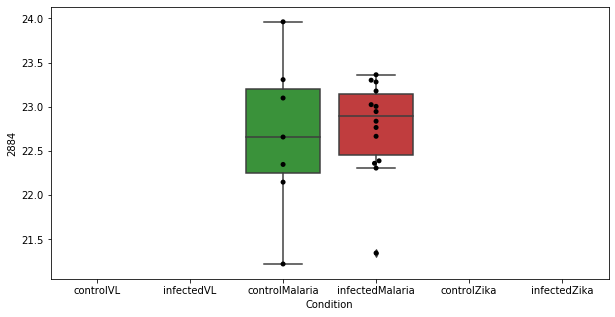

1518 row m/z                115.095
row retention time     4.70096
p-val                 0.763293
adj.P.Val             0.977814
custom_id                 3165
compound_names             NaN
Name: 3165, dtype: object


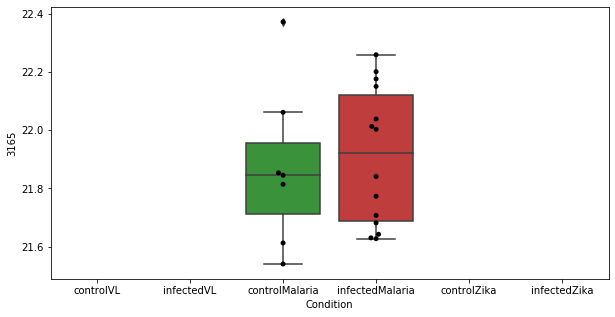

1519 row m/z                228.196
row retention time      3.9028
p-val                  0.76378
adj.P.Val             0.977814
custom_id                 1702
compound_names             NaN
Name: 1702, dtype: object


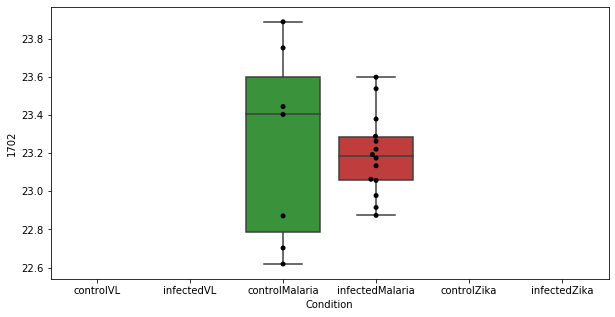

1520 row m/z                117.091
row retention time     4.37621
p-val                 0.764014
adj.P.Val             0.977814
custom_id                  329
compound_names             NaN
Name: 329, dtype: object


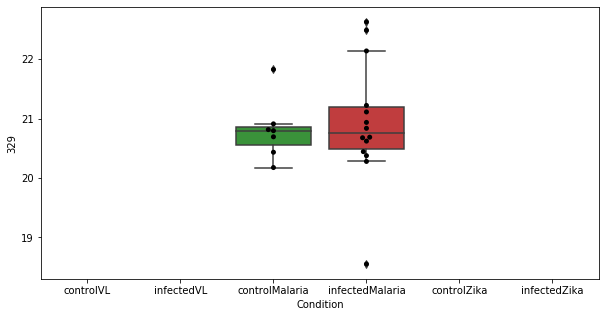

1521 row m/z                155.118
row retention time     4.75396
p-val                 0.764069
adj.P.Val             0.977814
custom_id                  859
compound_names             NaN
Name: 859, dtype: object


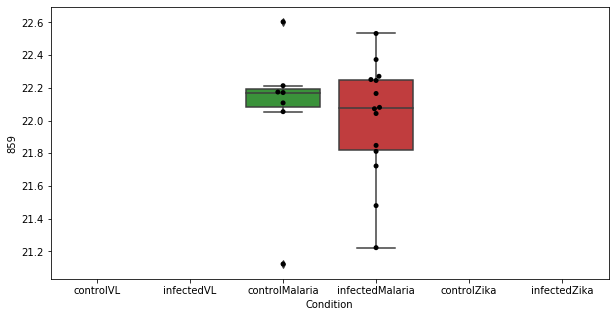

1522 row m/z                761.587
row retention time      3.5025
p-val                  0.76409
adj.P.Val             0.977814
custom_id                 2872
compound_names             NaN
Name: 2872, dtype: object


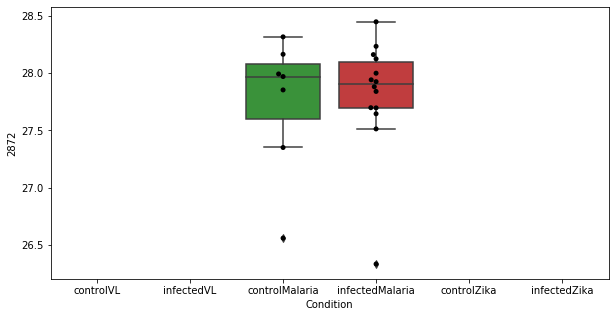

1523 row m/z                787.603
row retention time     3.49463
p-val                 0.764846
adj.P.Val             0.977838
custom_id                 2913
compound_names             NaN
Name: 2913, dtype: object


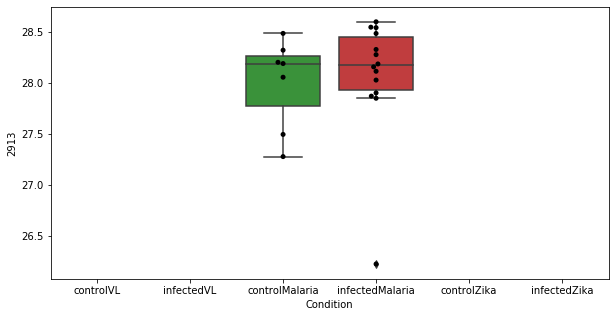

1524 row m/z                773.652
row retention time     3.66903
p-val                 0.765521
adj.P.Val             0.977838
custom_id                 4276
compound_names             NaN
Name: 4276, dtype: object


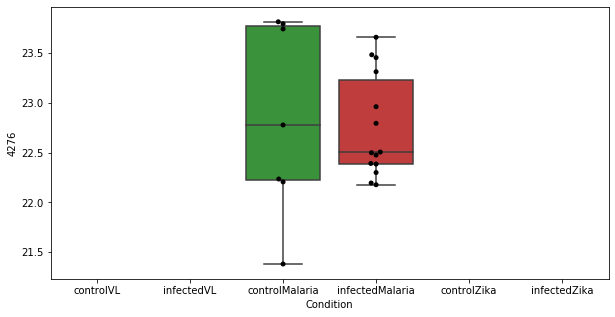

1525 row m/z                                                         125.071
row retention time                                              7.00636
p-val                                                          0.765614
adj.P.Val                                                      0.977838
custom_id                                                           440
compound_names        Methylimidazole acetaldehyde; 1-Methylimidazol...
Name: 440, dtype: object


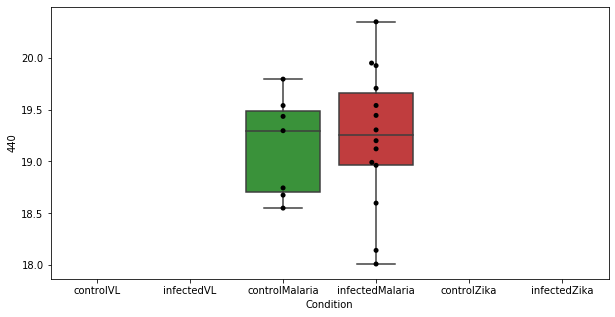

1526 row m/z                                                         364.223
row retention time                                              3.51624
p-val                                                          0.768665
adj.P.Val                                                      0.979819
custom_id                                                          2448
compound_names        17alpha,21-Dihydroxy-5beta-pregnane-3,11,20-tr...
Name: 2448, dtype: object


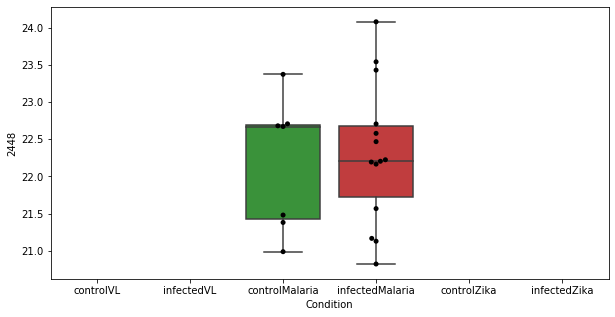

1527 row m/z                652.733
row retention time     8.72735
p-val                 0.769342
adj.P.Val             0.979819
custom_id                 2789
compound_names             NaN
Name: 2789, dtype: object


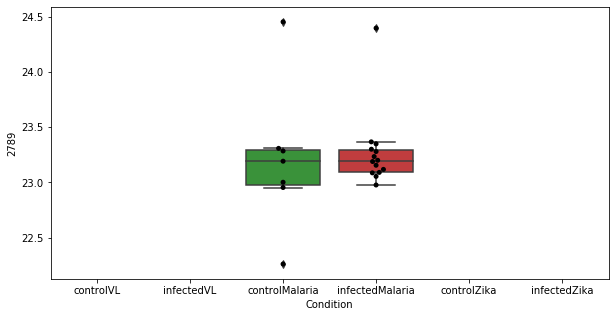

1528 row m/z                   85.0282
row retention time        9.58318
p-val                    0.769411
adj.P.Val                0.979819
custom_id                    3034
compound_names        3-Butynoate
Name: 3034, dtype: object


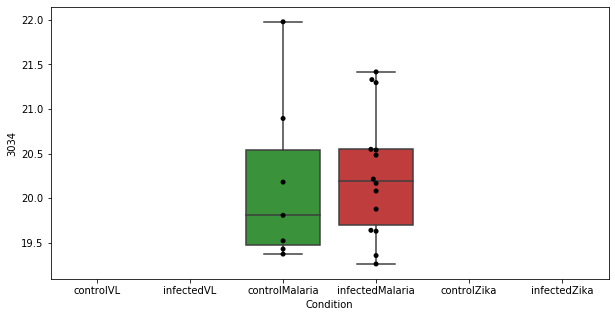

1529 row m/z                236.073
row retention time     10.5628
p-val                 0.769994
adj.P.Val             0.979819
custom_id                 1781
compound_names             NaN
Name: 1781, dtype: object


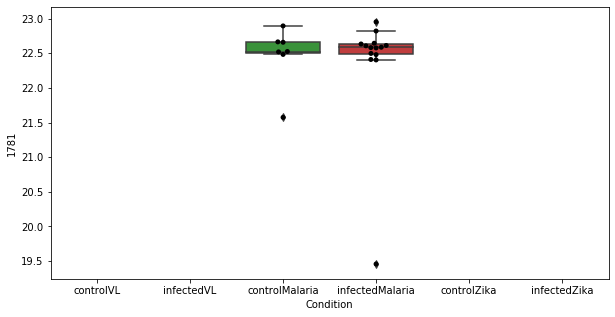

1530 row m/z                 112.98
row retention time     13.8461
p-val                 0.770876
adj.P.Val             0.979819
custom_id                  259
compound_names             NaN
Name: 259, dtype: object


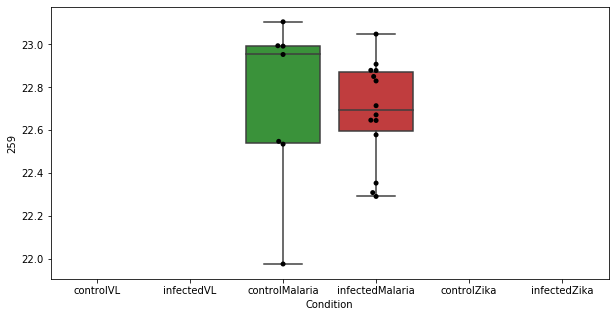

1531 row m/z                                                         223.108
row retention time                                              11.2861
p-val                                                          0.771291
adj.P.Val                                                      0.979819
custom_id                                                          1658
compound_names        quinonoid dihydrobiopterin$O2'-4a-cyclic-tetra...
Name: 1658, dtype: object


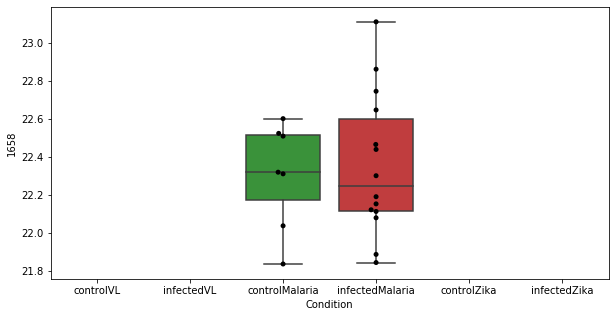

1532 row m/z                234.134
row retention time     3.98686
p-val                 0.772498
adj.P.Val             0.979819
custom_id                 1754
compound_names             NaN
Name: 1754, dtype: object


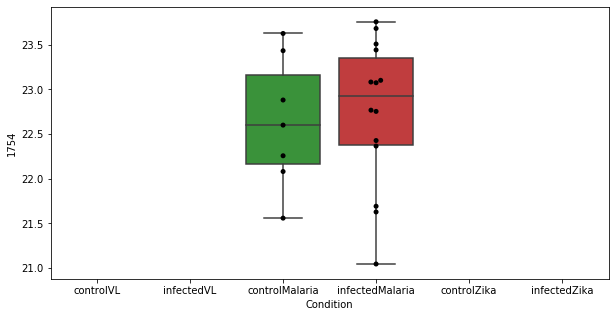

1533 row m/z                                                         170.092
row retention time                                              10.8786
p-val                                                           0.77301
adj.P.Val                                                      0.979819
custom_id                                                          1061
compound_names        N(pi)-Methyl-L-histidine; 1-Methylhistidine; N...
Name: 1061, dtype: object


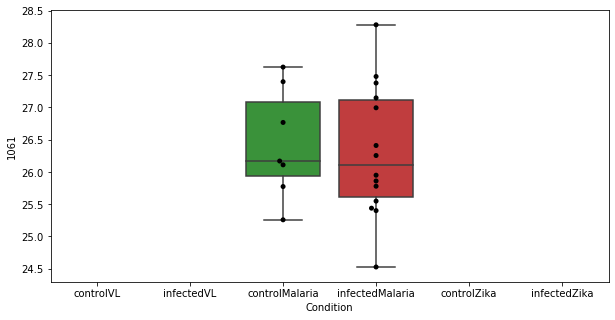

1534 row m/z                     189.087
row retention time          9.71517
p-val                      0.773257
adj.P.Val                  0.979819
custom_id                      1297
compound_names        Perillic acid
Name: 1297, dtype: object


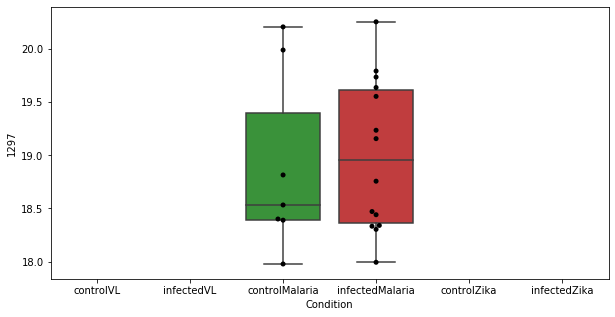

1535 row m/z                302.147
row retention time     6.98628
p-val                 0.773426
adj.P.Val             0.979819
custom_id                 5128
compound_names             NaN
Name: 5128, dtype: object


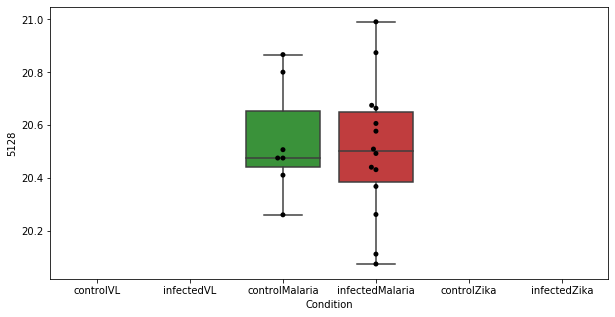

1536 row m/z                340.041
row retention time     23.7749
p-val                 0.773708
adj.P.Val             0.979819
custom_id                 2397
compound_names             NaN
Name: 2397, dtype: object


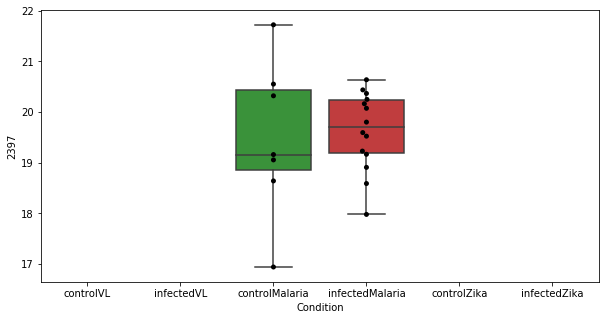

1537 row m/z                236.113
row retention time     3.75802
p-val                 0.773795
adj.P.Val             0.979819
custom_id                 1784
compound_names             NaN
Name: 1784, dtype: object


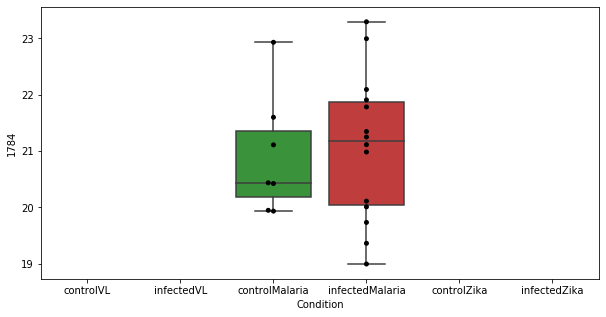

1538 row m/z                334.295
row retention time     3.25672
p-val                 0.774515
adj.P.Val             0.979819
custom_id                 2393
compound_names             NaN
Name: 2393, dtype: object


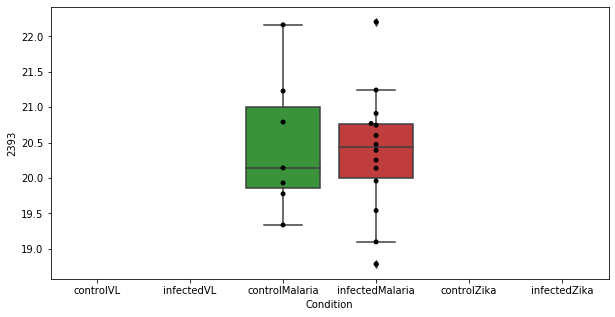

1539 row m/z                324.846
row retention time     23.8205
p-val                 0.774916
adj.P.Val             0.979819
custom_id                 2350
compound_names             NaN
Name: 2350, dtype: object


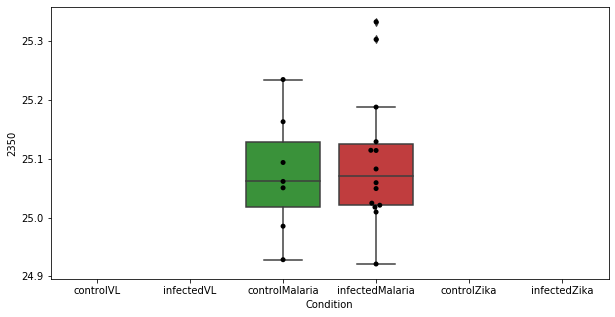

1540 row m/z                256.175
row retention time     6.88337
p-val                 0.777083
adj.P.Val             0.979819
custom_id                 3870
compound_names             NaN
Name: 3870, dtype: object


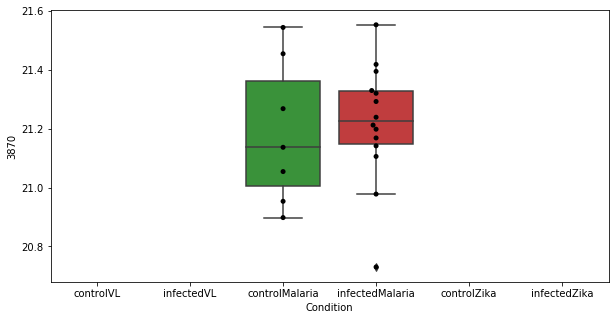

1541 row m/z                134.081
row retention time     12.1457
p-val                 0.777806
adj.P.Val             0.979819
custom_id                  585
compound_names             NaN
Name: 585, dtype: object


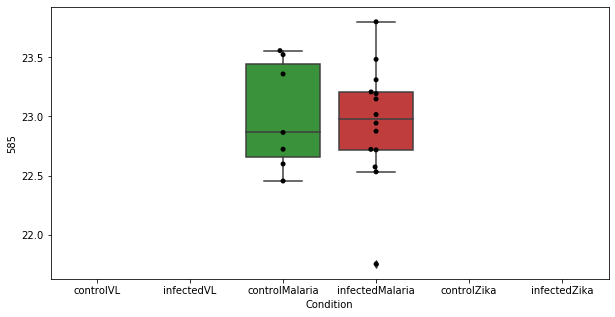

1542 row m/z                702.562
row retention time     3.75816
p-val                 0.778243
adj.P.Val             0.979819
custom_id                 2822
compound_names             NaN
Name: 2822, dtype: object


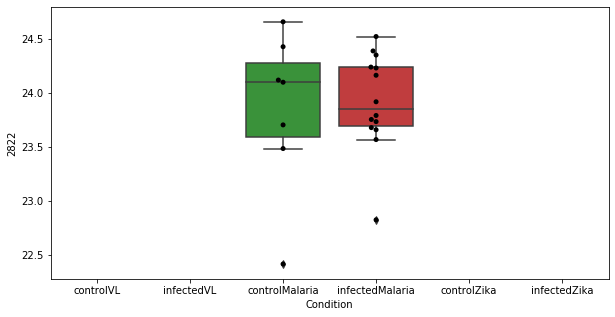

1543 row m/z                394.189
row retention time      6.9896
p-val                 0.778321
adj.P.Val             0.979819
custom_id                 2509
compound_names             NaN
Name: 2509, dtype: object


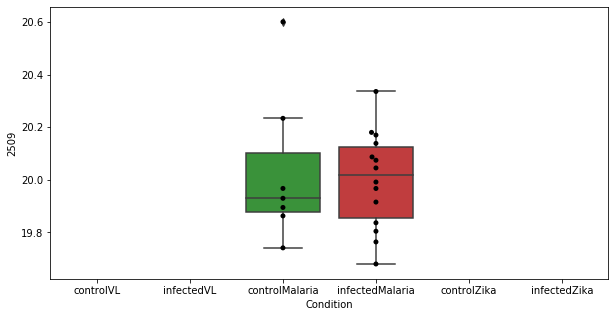

1544 row m/z                                                        184.097
row retention time                                             7.00341
p-val                                                         0.779344
adj.P.Val                                                     0.979819
custom_id                                                         1232
compound_names        Pantothenate; Pantothenic acid; (R)-Pantothenate
Name: 1232, dtype: object


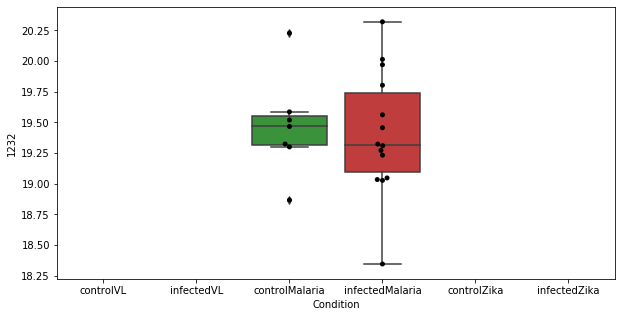

1545 row m/z                329.164
row retention time     3.70528
p-val                 0.779518
adj.P.Val             0.979819
custom_id                 2380
compound_names             NaN
Name: 2380, dtype: object


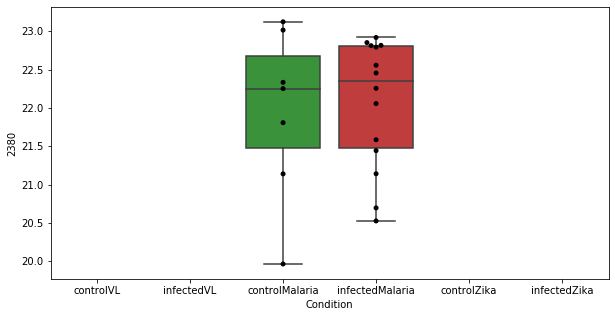

1546 row m/z                221.102
row retention time     4.14684
p-val                 0.779795
adj.P.Val             0.979819
custom_id                 1644
compound_names             NaN
Name: 1644, dtype: object


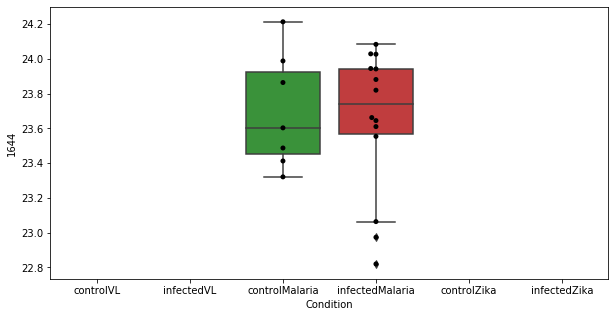

1547 row m/z                229.143
row retention time     3.99948
p-val                 0.780258
adj.P.Val             0.979819
custom_id                 1716
compound_names             NaN
Name: 1716, dtype: object


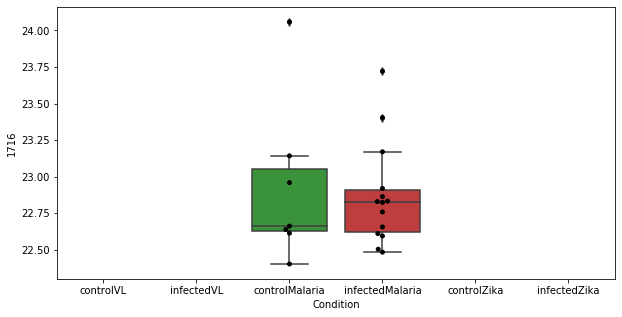

1548 row m/z                145.986
row retention time     23.6627
p-val                 0.780856
adj.P.Val             0.979819
custom_id                  730
compound_names             NaN
Name: 730, dtype: object


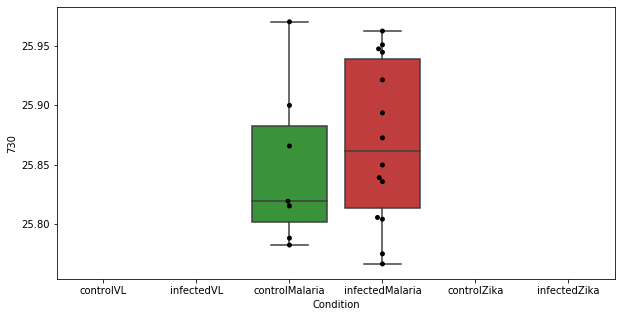

1549 row m/z                 184.92
row retention time     8.22563
p-val                  0.78112
adj.P.Val             0.979819
custom_id                 1237
compound_names             NaN
Name: 1237, dtype: object


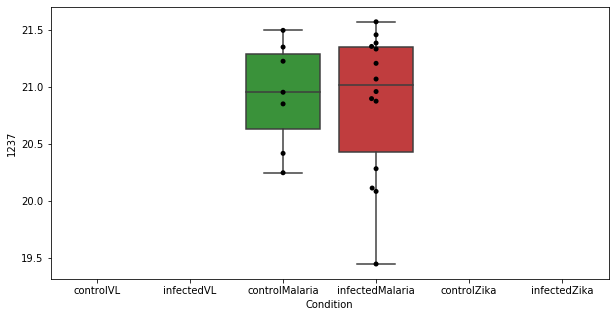

1550 row m/z                610.865
row retention time     13.0643
p-val                 0.782721
adj.P.Val             0.979819
custom_id                 2749
compound_names             NaN
Name: 2749, dtype: object


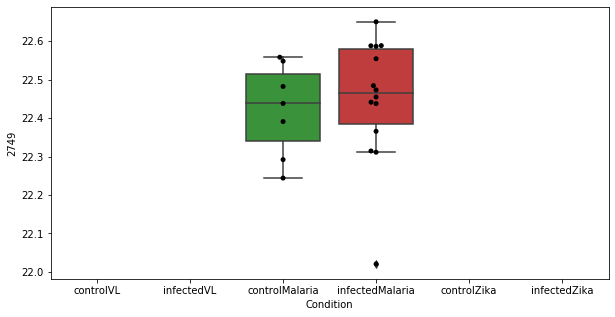

1551 row m/z                781.555
row retention time     4.46776
p-val                 0.782824
adj.P.Val             0.979819
custom_id                 2896
compound_names             NaN
Name: 2896, dtype: object


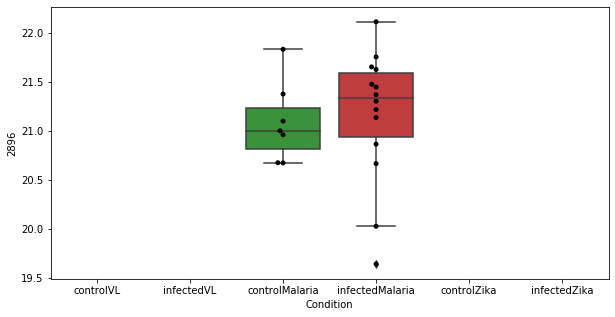

1552 row m/z                316.248
row retention time     4.54475
p-val                  0.78318
adj.P.Val             0.979819
custom_id                 2324
compound_names             NaN
Name: 2324, dtype: object


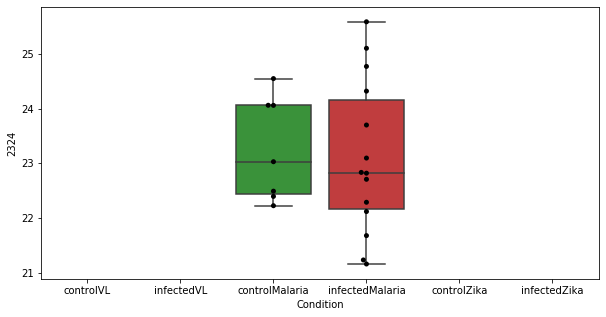

1553 row m/z                190.107
row retention time     6.99942
p-val                 0.783472
adj.P.Val             0.979819
custom_id                 1316
compound_names             NaN
Name: 1316, dtype: object


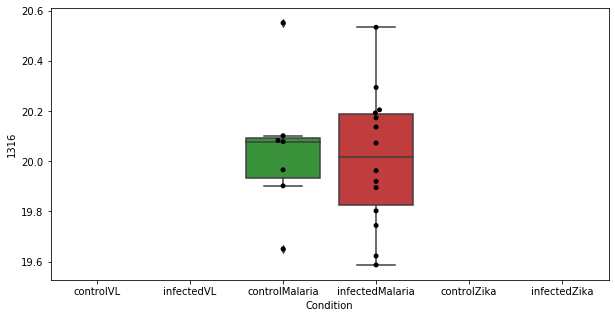

1554 row m/z                120.091
row retention time     10.7895
p-val                 0.783475
adj.P.Val             0.979819
custom_id                  381
compound_names             NaN
Name: 381, dtype: object


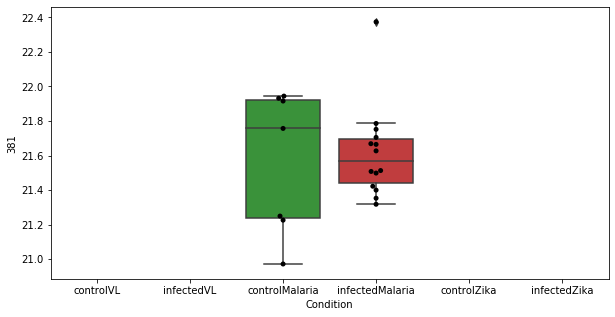

1555 row m/z                                                          127.05
row retention time                                              10.4644
p-val                                                          0.783483
adj.P.Val                                                      0.979819
custom_id                                                           448
compound_names        Thymine; 5-Methyluracil$Imidazole-4-acetate; I...
Name: 448, dtype: object


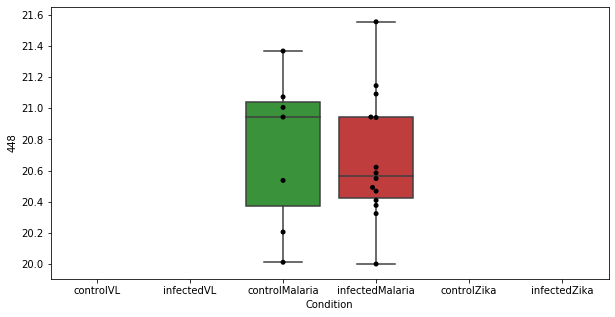

1556 row m/z                825.862
row retention time     9.22072
p-val                 0.783607
adj.P.Val             0.979819
custom_id                 5294
compound_names             NaN
Name: 5294, dtype: object


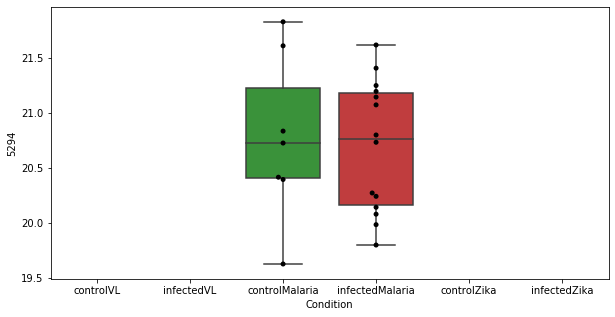

1557 row m/z                           288.217
row retention time                6.99548
p-val                            0.783878
adj.P.Val                        0.979819
custom_id                            2194
compound_names        L-Octanoylcarnitine
Name: 2194, dtype: object


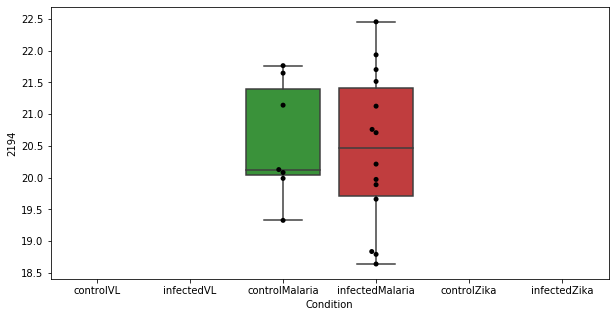

1558 row m/z                617.475
row retention time     3.19215
p-val                 0.783994
adj.P.Val             0.979819
custom_id                 2762
compound_names             NaN
Name: 2762, dtype: object


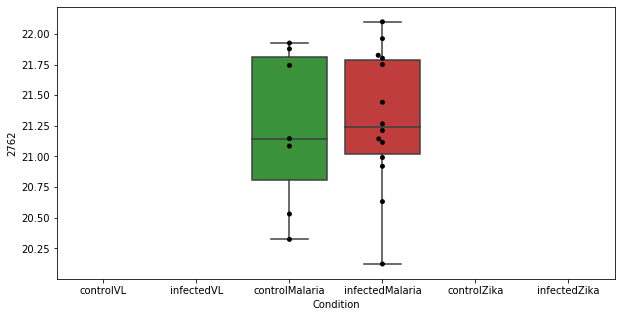

1559 row m/z                402.882
row retention time     11.9741
p-val                 0.784257
adj.P.Val             0.979819
custom_id                 2524
compound_names             NaN
Name: 2524, dtype: object


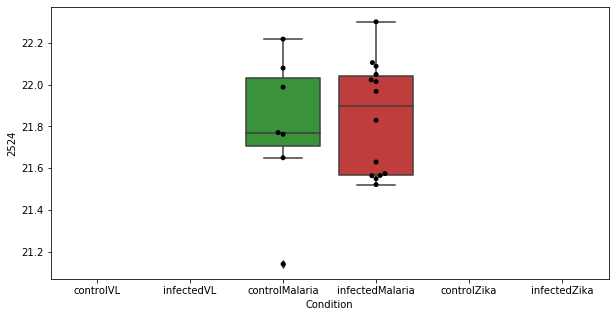

1560 row m/z                316.248
row retention time     6.99138
p-val                 0.785386
adj.P.Val             0.979926
custom_id                 2325
compound_names             NaN
Name: 2325, dtype: object


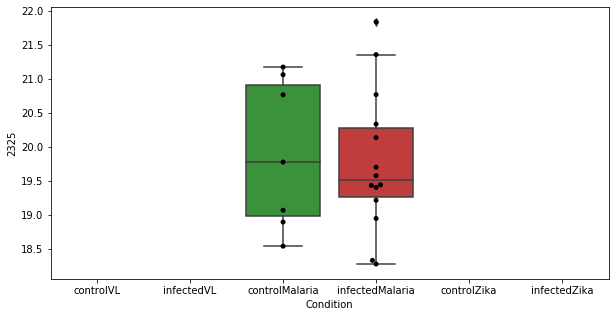

1561 row m/z                144.936
row retention time     22.9051
p-val                 0.786411
adj.P.Val             0.979926
custom_id                  709
compound_names             NaN
Name: 709, dtype: object


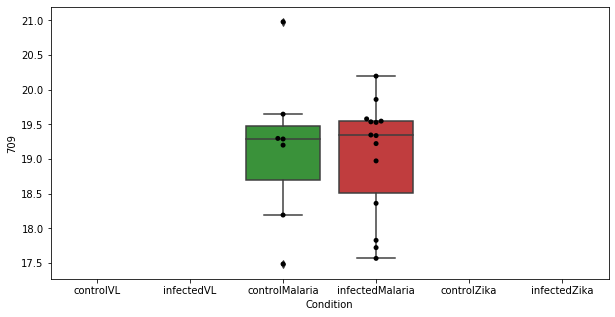

1562 row m/z                703.574
row retention time     3.73993
p-val                 0.787264
adj.P.Val             0.979926
custom_id                 2823
compound_names             NaN
Name: 2823, dtype: object


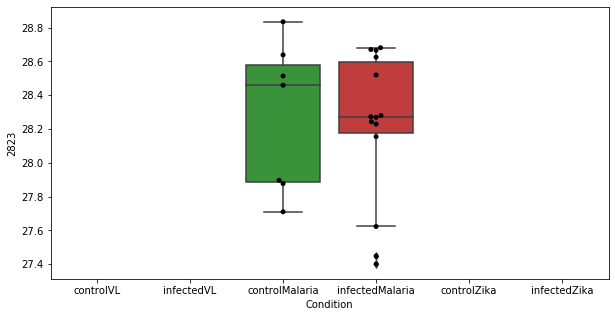

1563 row m/z                780.553
row retention time     3.54794
p-val                 0.787931
adj.P.Val             0.979926
custom_id                 2894
compound_names             NaN
Name: 2894, dtype: object


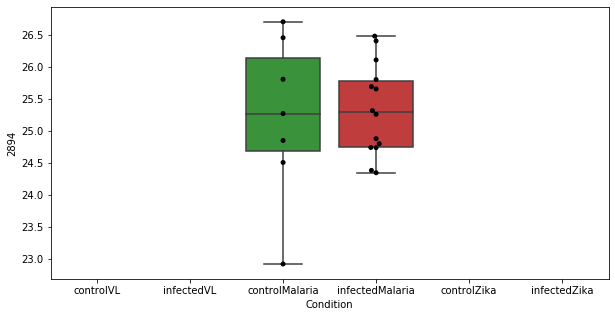

1564 row m/z                121.974
row retention time     12.4988
p-val                 0.788442
adj.P.Val             0.979926
custom_id                  390
compound_names             NaN
Name: 390, dtype: object


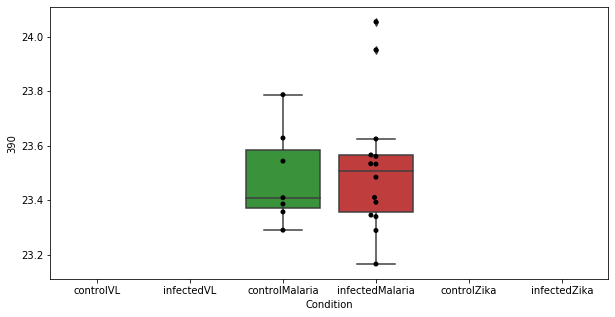

1565 row m/z                317.269
row retention time     3.24915
p-val                 0.788723
adj.P.Val             0.979926
custom_id                 2328
compound_names             NaN
Name: 2328, dtype: object


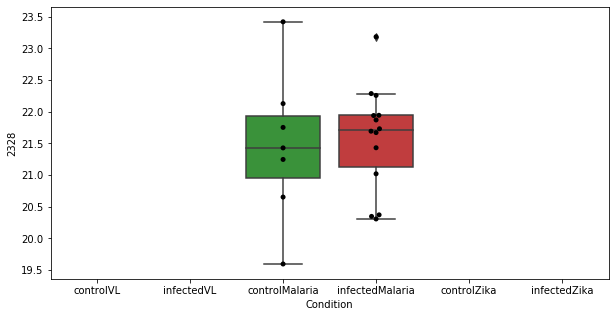

1566 row m/z                122.547
row retention time     13.9666
p-val                 0.788732
adj.P.Val             0.979926
custom_id                  409
compound_names             NaN
Name: 409, dtype: object


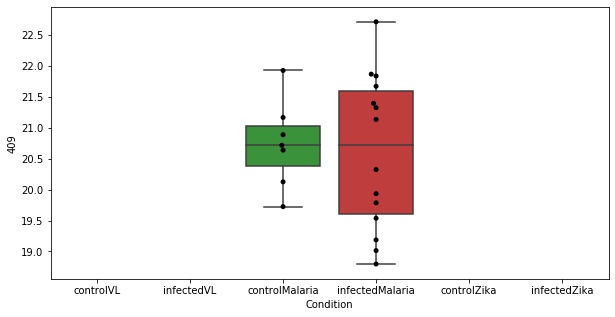

1567 row m/z                89.0685
row retention time     13.8608
p-val                 0.788852
adj.P.Val             0.979926
custom_id                   79
compound_names             NaN
Name: 79, dtype: object


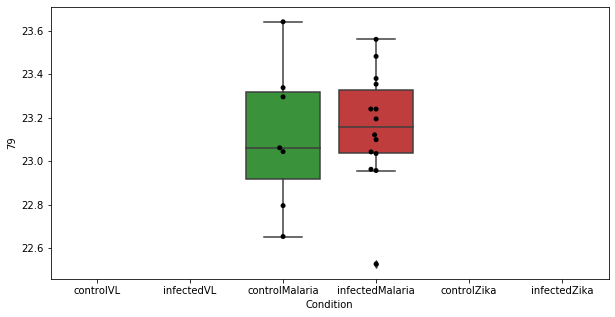

1568 row m/z                                                         144.102
row retention time                                              6.99422
p-val                                                          0.790452
adj.P.Val                                                      0.979926
custom_id                                                          3334
compound_names        6-Acetamido-2-oxohexanoate; 2-Oxo-6-acetamidoc...
Name: 3334, dtype: object


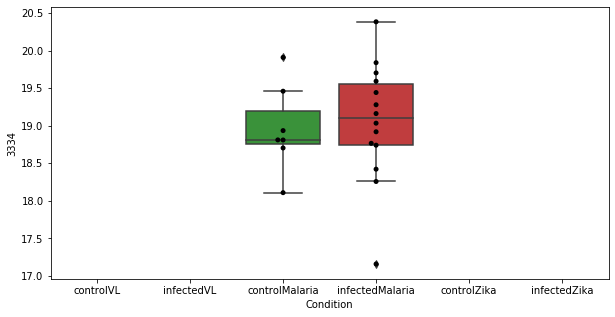

1569 row m/z                267.195
row retention time     3.69393
p-val                   0.7906
adj.P.Val             0.979926
custom_id                 2026
compound_names             NaN
Name: 2026, dtype: object


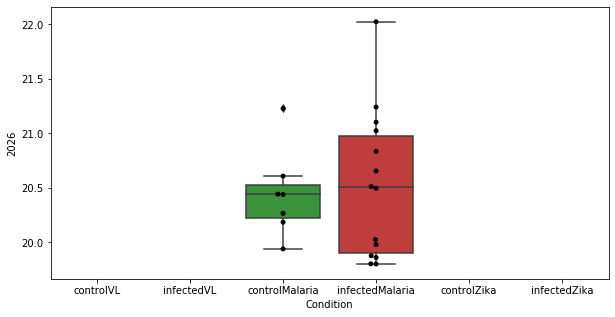

1570 row m/z                                                         281.247
row retention time                                              3.25969
p-val                                                            0.7915
adj.P.Val                                                      0.979926
custom_id                                                          2144
compound_names        Linoleate; Linoleic acid; (9Z,12Z)-Octadecadie...
Name: 2144, dtype: object


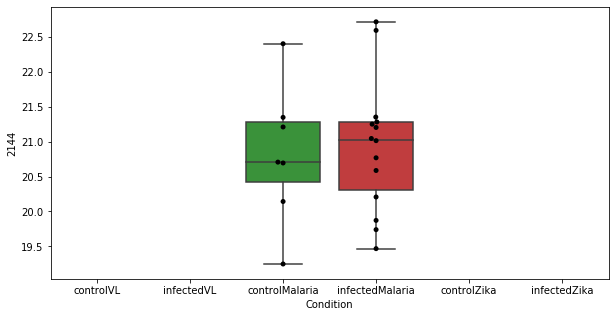

1571 row m/z                760.584
row retention time     3.51441
p-val                 0.791511
adj.P.Val             0.979926
custom_id                 2870
compound_names             NaN
Name: 2870, dtype: object


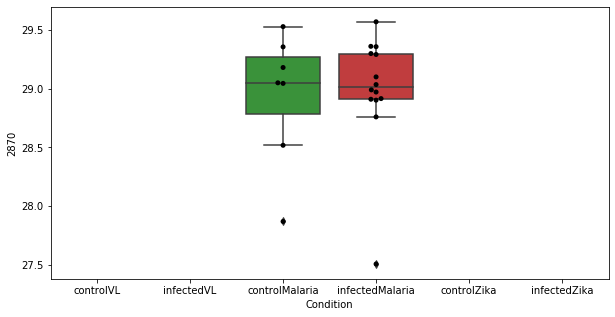

1572 row m/z                145.097
row retention time     7.84737
p-val                 0.792311
adj.P.Val             0.979926
custom_id                  716
compound_names             NaN
Name: 716, dtype: object


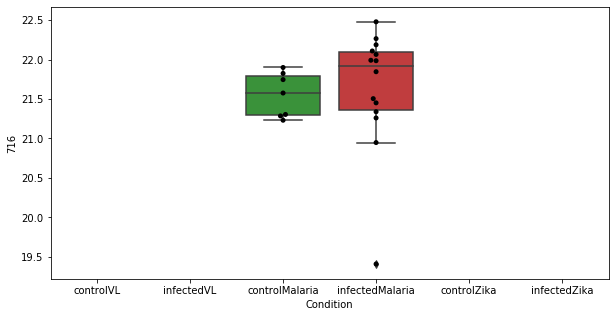

1573 row m/z                405.199
row retention time     23.6456
p-val                 0.792671
adj.P.Val             0.979926
custom_id                 2533
compound_names             NaN
Name: 2533, dtype: object


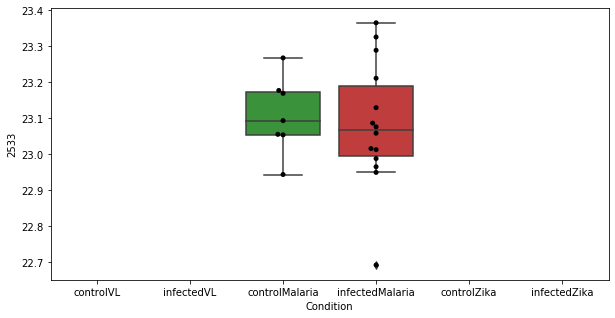

1574 row m/z                315.174
row retention time     3.70908
p-val                 0.793371
adj.P.Val             0.979926
custom_id                 2319
compound_names             NaN
Name: 2319, dtype: object


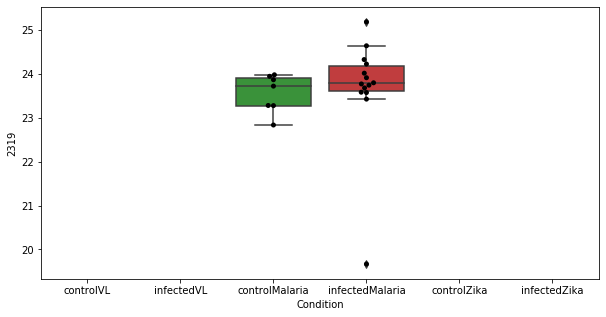

1575 row m/z                                                 117.066
row retention time                                      12.8284
p-val                                                  0.793749
adj.P.Val                                              0.979926
custom_id                                                  4465
compound_names        N,N'-Diacetylhydrazine; Diacetylhydrazine
Name: 4465, dtype: object


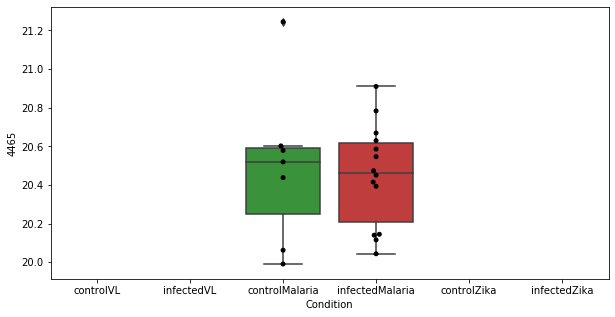

1576 row m/z                 506.91
row retention time     8.20345
p-val                  0.79439
adj.P.Val             0.979926
custom_id                 2633
compound_names             NaN
Name: 2633, dtype: object


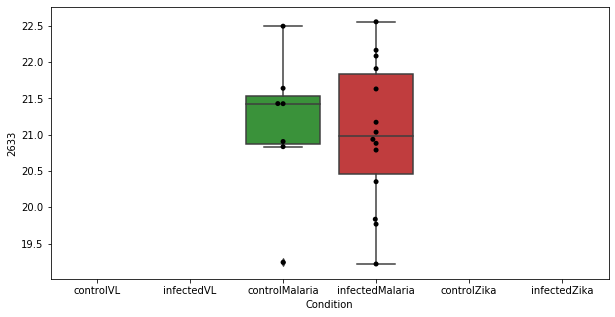

1577 row m/z                 169.98
row retention time     12.8724
p-val                  0.79455
adj.P.Val             0.979926
custom_id                 1050
compound_names             NaN
Name: 1050, dtype: object


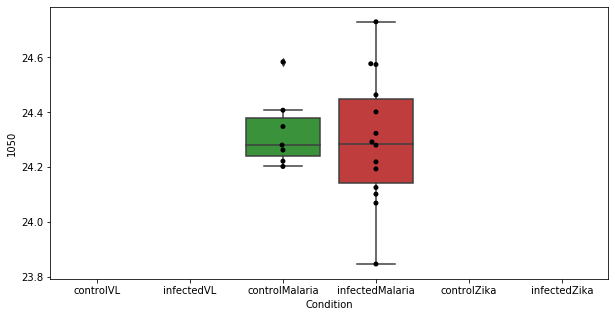

1578 row m/z                243.948
row retention time     10.4887
p-val                 0.794723
adj.P.Val             0.979926
custom_id                 1853
compound_names             NaN
Name: 1853, dtype: object


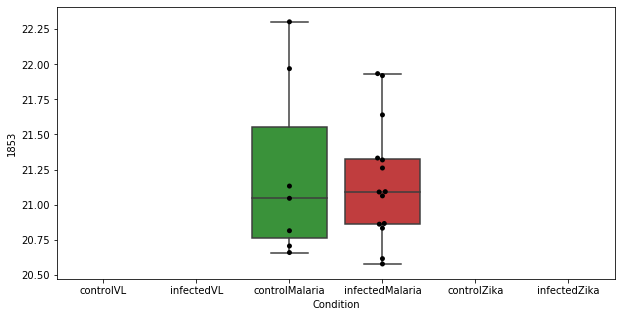

1579 row m/z                185.129
row retention time     11.6499
p-val                 0.794723
adj.P.Val             0.979926
custom_id                 3561
compound_names             NaN
Name: 3561, dtype: object


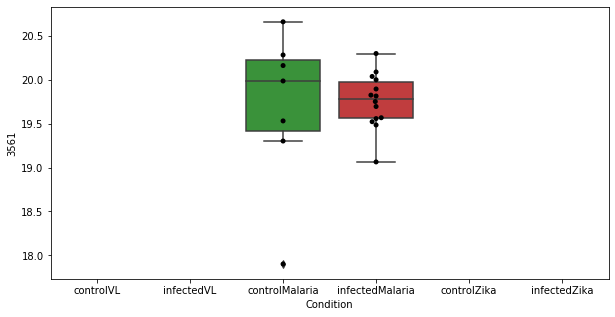

1580 row m/z                767.577
row retention time     3.51712
p-val                 0.794901
adj.P.Val             0.979926
custom_id                 2876
compound_names             NaN
Name: 2876, dtype: object


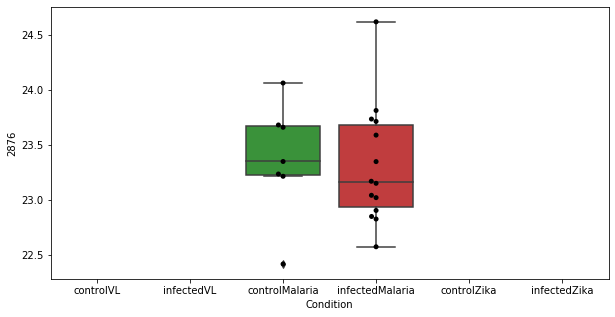

1581 row m/z                         192.123
row retention time              4.58768
p-val                          0.796161
adj.P.Val                      0.980639
custom_id                          1338
compound_names        N-Methylserotonin
Name: 1338, dtype: object


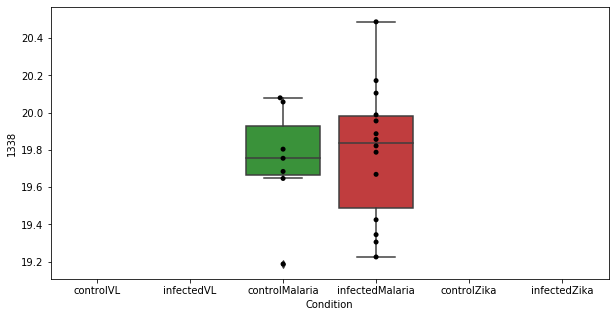

1582 row m/z                228.123
row retention time     3.95706
p-val                 0.796747
adj.P.Val             0.980639
custom_id                 1700
compound_names             NaN
Name: 1700, dtype: object


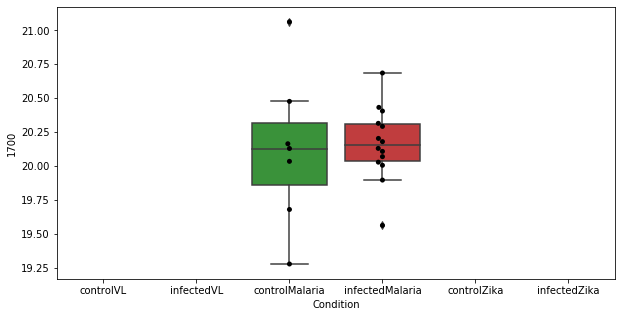

1583 row m/z                                                          131.09
row retention time                                              9.83208
p-val                                                          0.797432
adj.P.Val                                                      0.980639
custom_id                                                           533
compound_names        N4-Acetylaminobutanal$L-Pipecolate; Pipecolini...
Name: 533, dtype: object


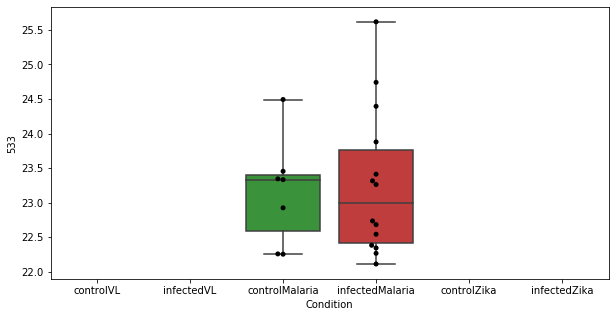

1584 row m/z                787.667
row retention time      6.7546
p-val                 0.797877
adj.P.Val             0.980639
custom_id                 2917
compound_names             NaN
Name: 2917, dtype: object


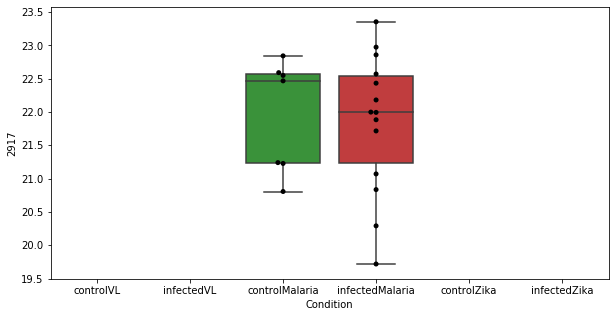

1585 row m/z                              136.062
row retention time                   23.8288
p-val                               0.798188
adj.P.Val                           0.980639
custom_id                                598
compound_names        Adenine; 6-Aminopurine
Name: 598, dtype: object


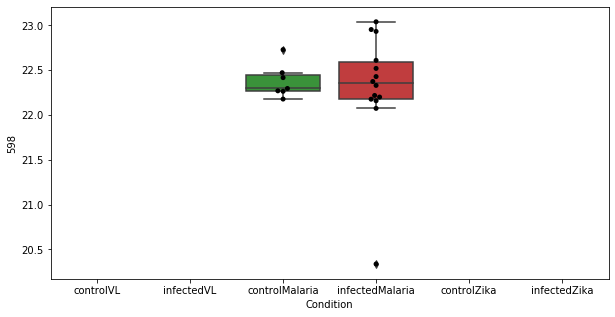

1586 row m/z                186.131
row retention time     5.97885
p-val                 0.798676
adj.P.Val             0.980639
custom_id                 3568
compound_names             NaN
Name: 3568, dtype: object


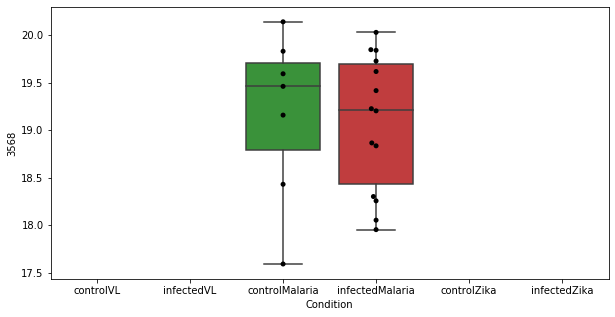

1587 row m/z                241.154
row retention time     8.76808
p-val                 0.799002
adj.P.Val             0.980639
custom_id                 1838
compound_names             NaN
Name: 1838, dtype: object


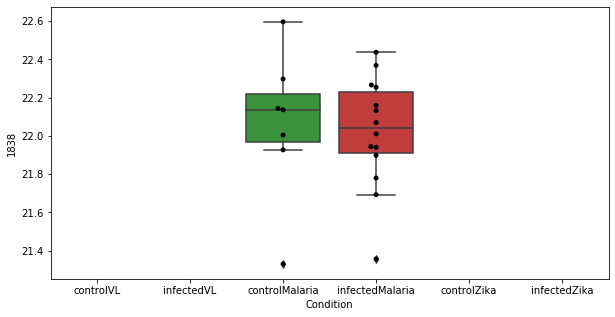

1588 row m/z                                                         156.102
row retention time                                              6.99708
p-val                                                          0.799788
adj.P.Val                                                      0.980986
custom_id                                                           868
compound_names        L-Normetanephrine$L-Adrenaline; (R)-(-)-Adrena...
Name: 868, dtype: object


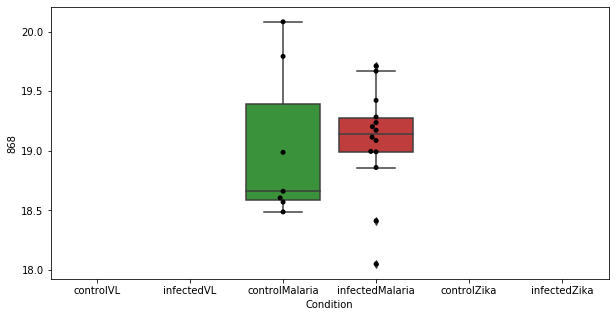

1589 row m/z                510.862
row retention time     8.20113
p-val                 0.800326
adj.P.Val             0.981028
custom_id                 2636
compound_names             NaN
Name: 2636, dtype: object


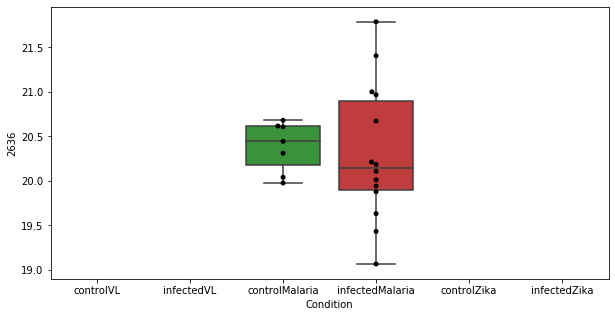

1590 row m/z                                                         266.121
row retention time                                              4.58674
p-val                                                          0.801182
adj.P.Val                                                      0.981461
custom_id                                                          2008
compound_names        Formyl-N-acetyl-5-methoxykynurenamine$alpha-N-...
Name: 2008, dtype: object


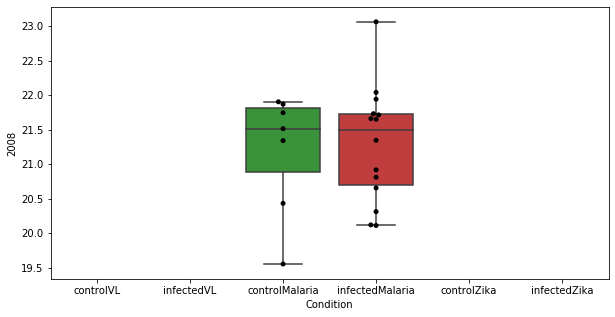

1591 row m/z                304.248
row retention time     3.61614
p-val                 0.802875
adj.P.Val             0.982916
custom_id                 2263
compound_names             NaN
Name: 2263, dtype: object


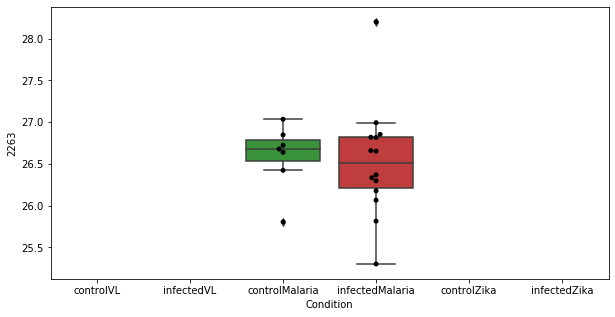

1592 row m/z                  786.6
row retention time     3.48776
p-val                 0.803814
adj.P.Val             0.983027
custom_id                 2911
compound_names             NaN
Name: 2911, dtype: object


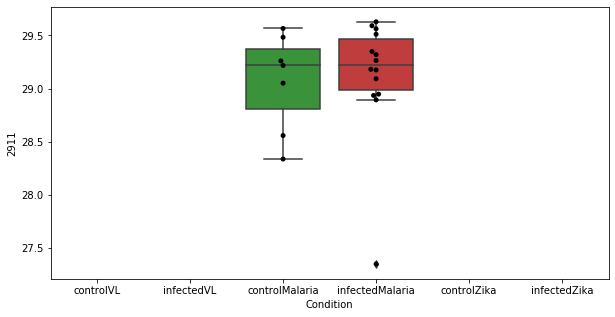

1593 row m/z                118.052
row retention time      10.809
p-val                 0.803974
adj.P.Val             0.983027
custom_id                  344
compound_names             NaN
Name: 344, dtype: object


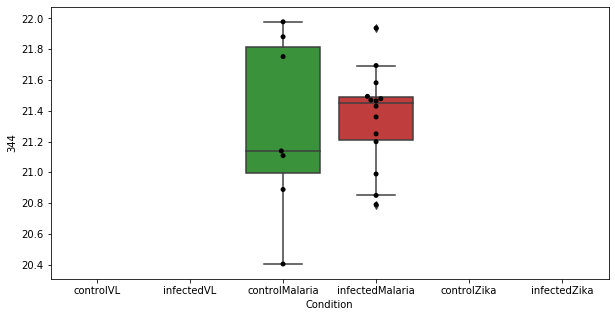

1594 row m/z                             142.086
row retention time                  23.6919
p-val                              0.805293
adj.P.Val                          0.983339
custom_id                               668
compound_names        5-Acetamidopentanoate
Name: 668, dtype: object


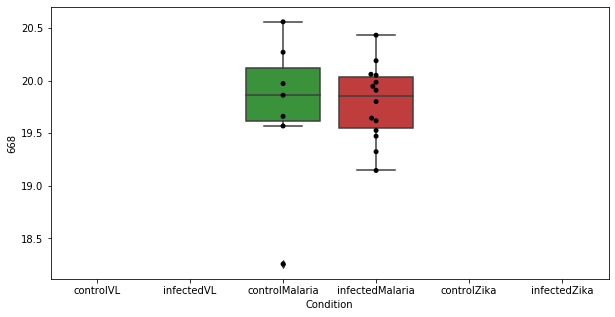

1595 row m/z                            146.118
row retention time                 4.48084
p-val                             0.805813
adj.P.Val                         0.983339
custom_id                              744
compound_names        3-Dehydroxycarnitine
Name: 744, dtype: object


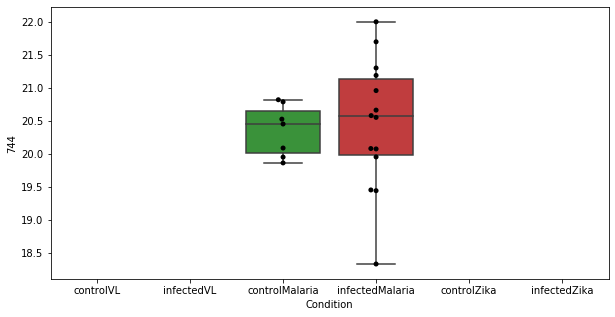

1596 row m/z                259.079
row retention time     9.53272
p-val                 0.806087
adj.P.Val             0.983339
custom_id                 1975
compound_names             NaN
Name: 1975, dtype: object


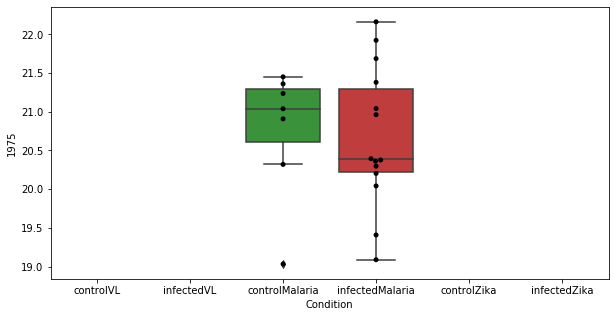

1597 row m/z                159.113
row retention time      10.796
p-val                 0.806247
adj.P.Val             0.983339
custom_id                  914
compound_names             NaN
Name: 914, dtype: object


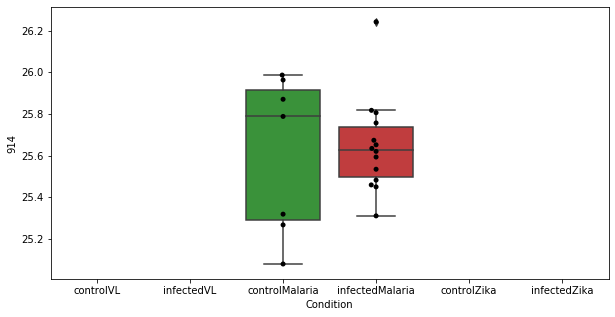

1598 row m/z                198.862
row retention time     12.4965
p-val                 0.807576
adj.P.Val             0.983859
custom_id                 1419
compound_names             NaN
Name: 1419, dtype: object


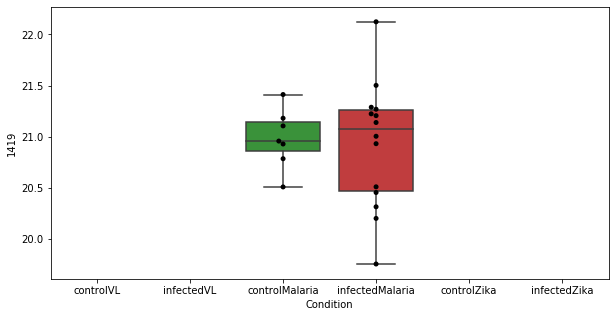

1599 row m/z                238.914
row retention time      23.759
p-val                 0.808348
adj.P.Val             0.983859
custom_id                 1809
compound_names             NaN
Name: 1809, dtype: object


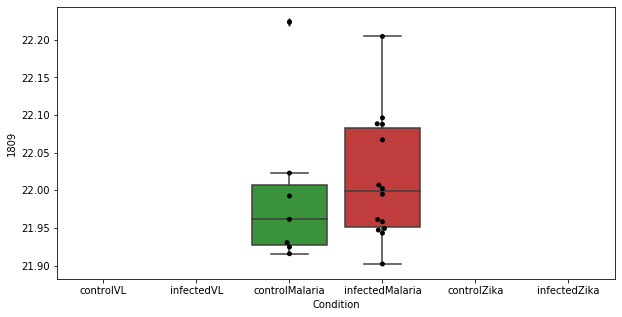

1600 row m/z                445.164
row retention time     11.3256
p-val                 0.808586
adj.P.Val             0.983859
custom_id                 5239
compound_names             NaN
Name: 5239, dtype: object


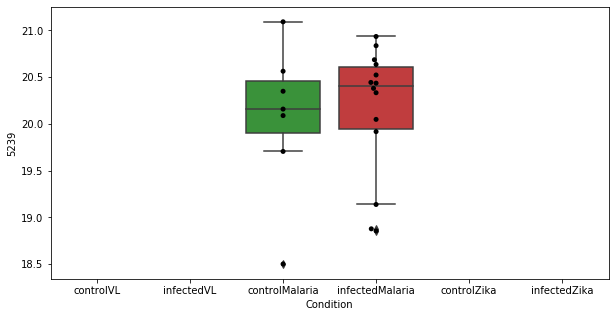

1601 row m/z                546.391
row retention time     3.42308
p-val                 0.808958
adj.P.Val             0.983859
custom_id                 2690
compound_names             NaN
Name: 2690, dtype: object


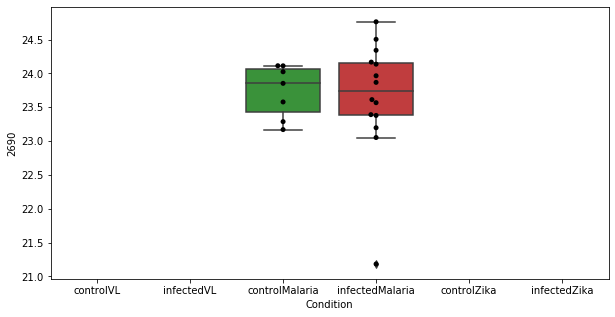

1602 row m/z                81.0447
row retention time      23.953
p-val                 0.810121
adj.P.Val             0.983859
custom_id                 4337
compound_names             NaN
Name: 4337, dtype: object


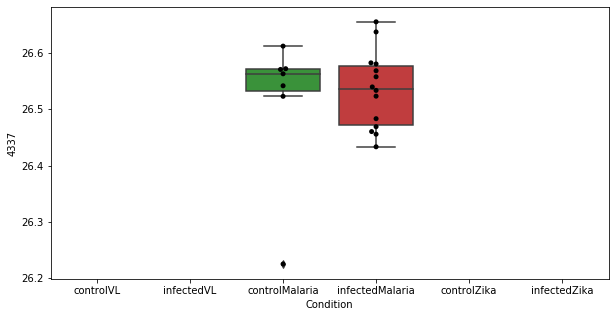

1603 row m/z                340.882
row retention time     13.0221
p-val                 0.810294
adj.P.Val             0.983859
custom_id                 2401
compound_names             NaN
Name: 2401, dtype: object


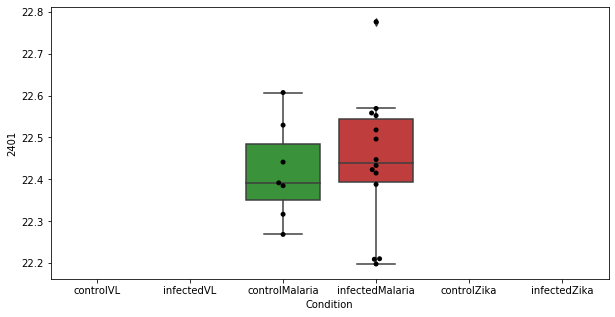

1604 row m/z                129.127
row retention time     3.77707
p-val                 0.810546
adj.P.Val             0.983859
custom_id                  498
compound_names               $
Name: 498, dtype: object


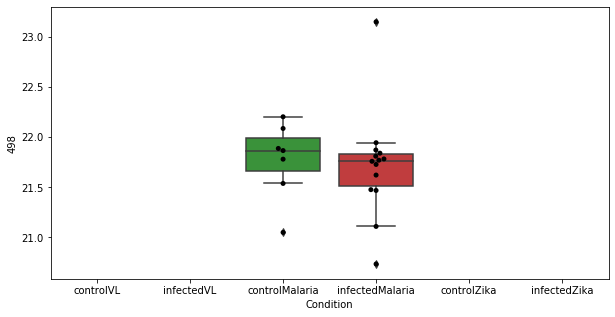

1605 row m/z                279.159
row retention time     3.65062
p-val                 0.810712
adj.P.Val             0.983859
custom_id                 2132
compound_names             NaN
Name: 2132, dtype: object


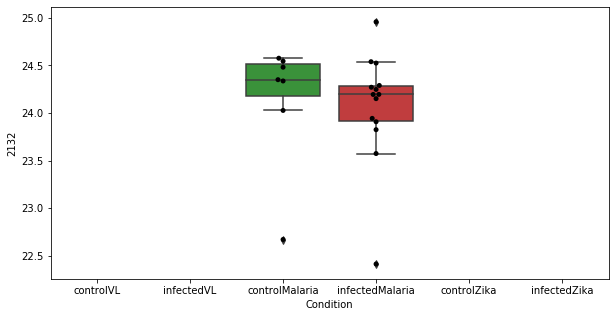

1606 row m/z                                                         200.128
row retention time                                              6.99612
p-val                                                          0.813185
adj.P.Val                                                      0.984203
custom_id                                                          1434
compound_names        Ecgonine methyl ester; Methyl ecgonine$ecgonin...
Name: 1434, dtype: object


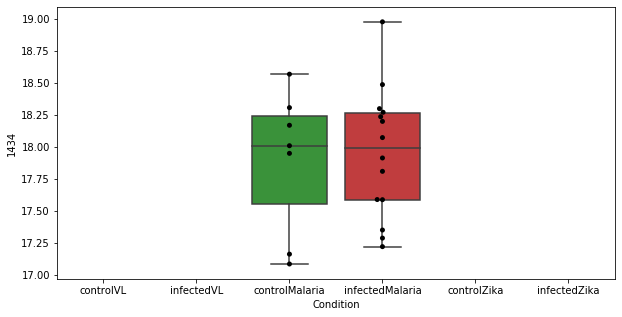

1607 row m/z                                                         426.357
row retention time                                              3.94467
p-val                                                          0.813632
adj.P.Val                                                      0.984203
custom_id                                                          2562
compound_names        octadecenoyl carnitine$Elaidic carnitine$Vacce...
Name: 2562, dtype: object


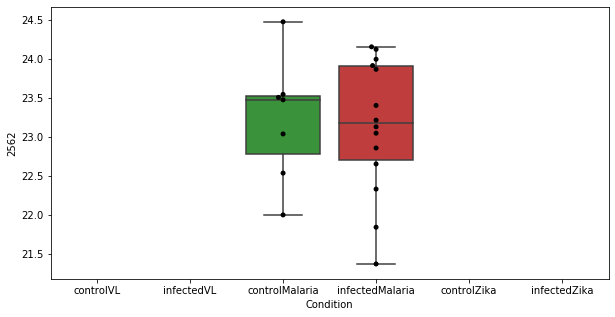

1608 row m/z                     199.169
row retention time          3.63976
p-val                      0.814141
adj.P.Val                  0.984203
custom_id                      1422
compound_names        lysyl-proline
Name: 1422, dtype: object


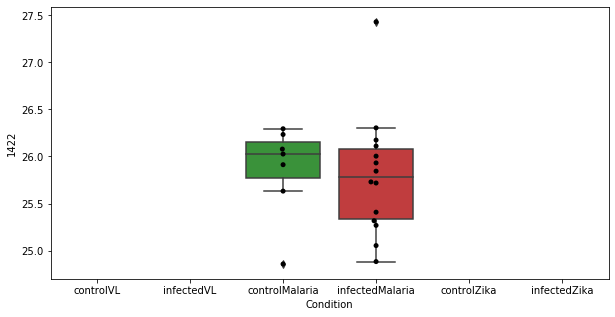

1609 row m/z                245.138
row retention time     4.16359
p-val                 0.816855
adj.P.Val             0.984203
custom_id                 1870
compound_names             NaN
Name: 1870, dtype: object


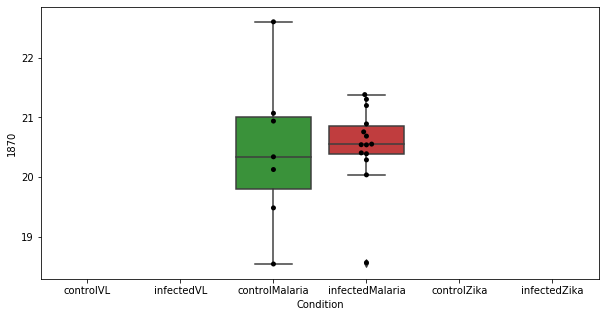

1610 row m/z                                                         72.0808
row retention time                                              10.7945
p-val                                                          0.817394
adj.P.Val                                                      0.984203
custom_id                                                             8
compound_names        5-Aminopentanoate; 5-Aminopentanoic acid; 5-Am...
Name: 8, dtype: object


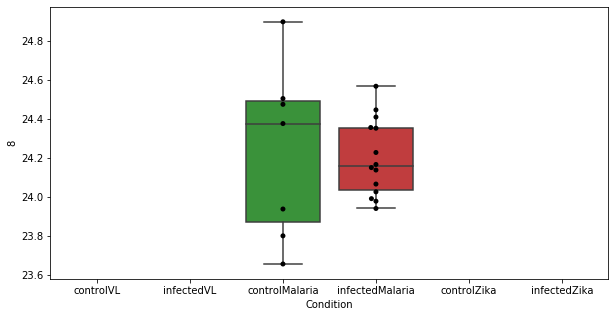

1611 row m/z                813.683
row retention time     3.58045
p-val                 0.818077
adj.P.Val             0.984203
custom_id                 2951
compound_names             NaN
Name: 2951, dtype: object


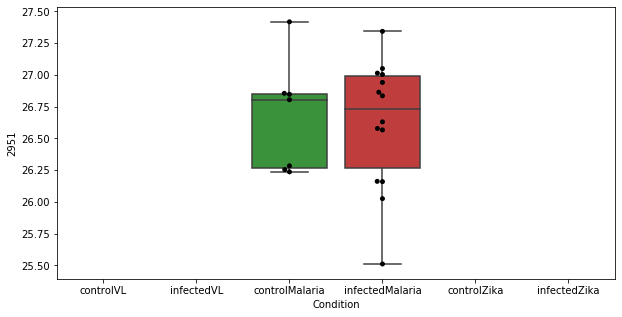

1612 row m/z                                        195.123
row retention time                             4.59373
p-val                                         0.818393
adj.P.Val                                     0.984203
custom_id                                         1387
compound_names        (-)-Salsoline$N-methylsalsolinol
Name: 1387, dtype: object


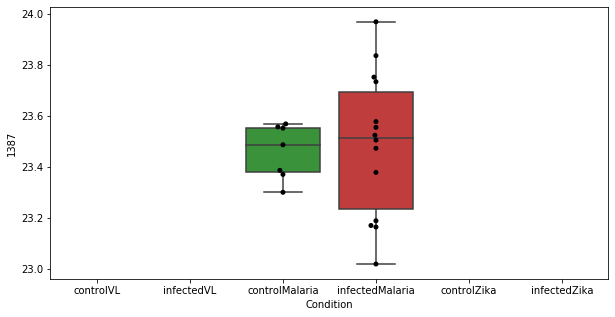

1613 row m/z                814.687
row retention time      3.6072
p-val                  0.82083
adj.P.Val             0.984203
custom_id                 2955
compound_names             NaN
Name: 2955, dtype: object


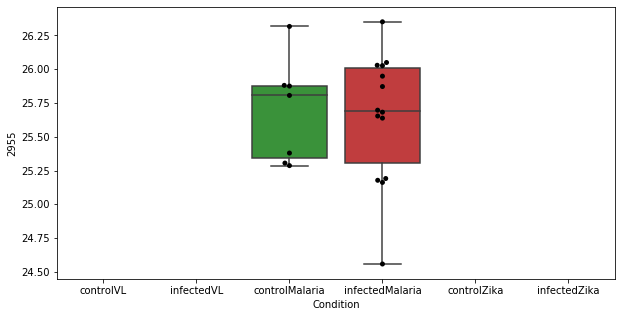

1614 row m/z                236.073
row retention time     11.3517
p-val                 0.821355
adj.P.Val             0.984203
custom_id                 3786
compound_names             NaN
Name: 3786, dtype: object


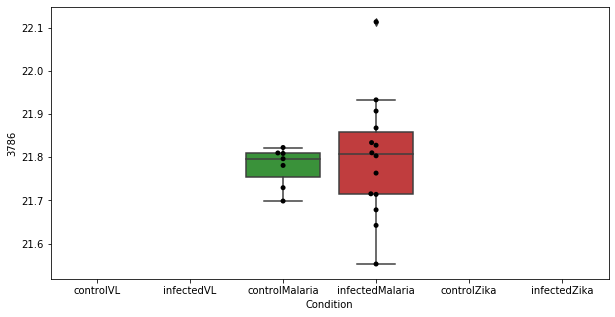

1615 row m/z                615.501
row retention time     3.36587
p-val                 0.821993
adj.P.Val             0.984203
custom_id                 2759
compound_names             NaN
Name: 2759, dtype: object


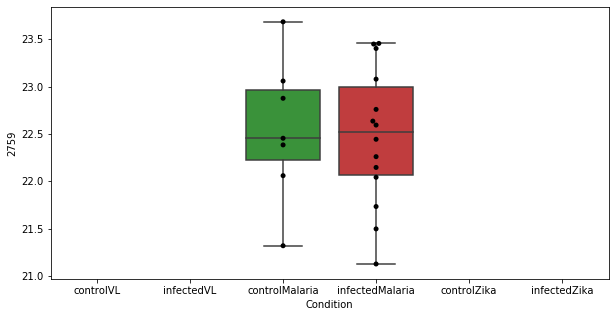

1616 row m/z                                                        220.118
row retention time                                             8.31431
p-val                                                         0.822222
adj.P.Val                                                     0.984203
custom_id                                                         1639
compound_names        Pantothenate; Pantothenic acid; (R)-Pantothenate
Name: 1639, dtype: object


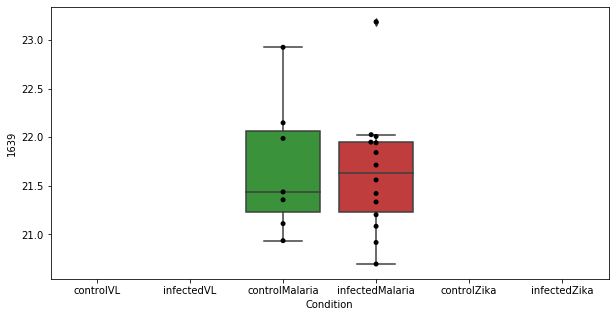

1617 row m/z                149.083
row retention time     12.3172
p-val                 0.822836
adj.P.Val             0.984203
custom_id                  801
compound_names             NaN
Name: 801, dtype: object


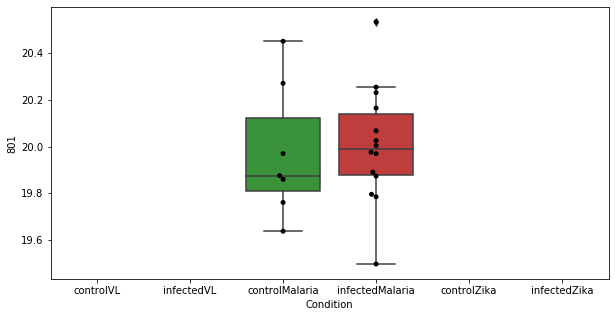

1618 row m/z                237.911
row retention time     23.7818
p-val                 0.822912
adj.P.Val             0.984203
custom_id                 1797
compound_names             NaN
Name: 1797, dtype: object


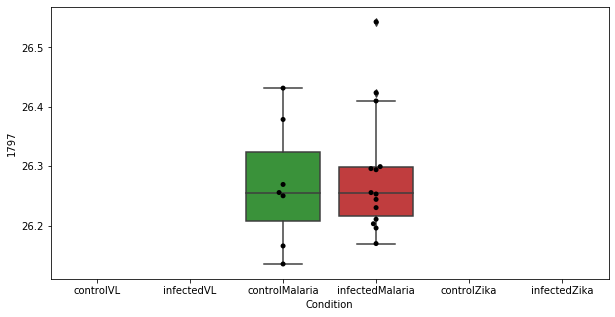

1619 row m/z                208.162
row retention time     23.6777
p-val                  0.82326
adj.P.Val             0.984203
custom_id                 1502
compound_names             NaN
Name: 1502, dtype: object


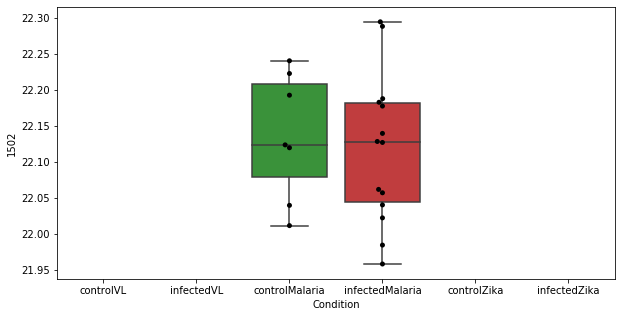

1620 row m/z                196.154
row retention time     4.56611
p-val                 0.823344
adj.P.Val             0.984203
custom_id                 1400
compound_names             NaN
Name: 1400, dtype: object


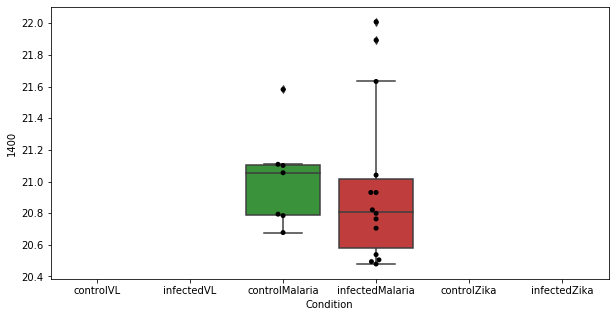

1621 row m/z                275.103
row retention time      4.8911
p-val                 0.823657
adj.P.Val             0.984203
custom_id                 2084
compound_names             NaN
Name: 2084, dtype: object


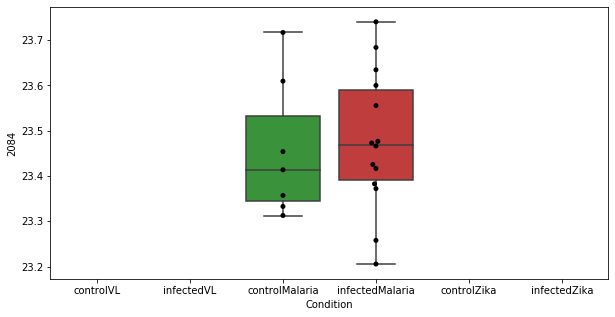

1622 row m/z                342.264
row retention time     4.38962
p-val                  0.82465
adj.P.Val             0.984203
custom_id                 4110
compound_names             NaN
Name: 4110, dtype: object


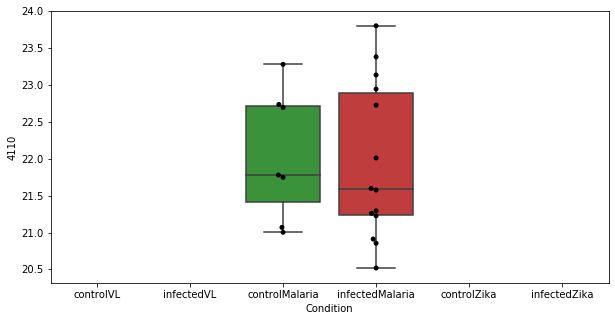

1623 row m/z                 812.67
row retention time     3.57855
p-val                 0.824727
adj.P.Val             0.984203
custom_id                 2949
compound_names             NaN
Name: 2949, dtype: object


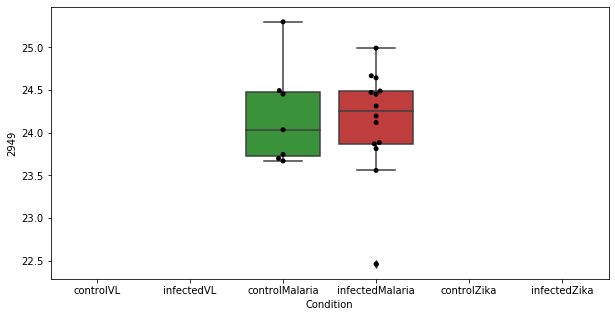

1624 row m/z                186.132
row retention time     5.27938
p-val                 0.824969
adj.P.Val             0.984203
custom_id                 3569
compound_names             NaN
Name: 3569, dtype: object


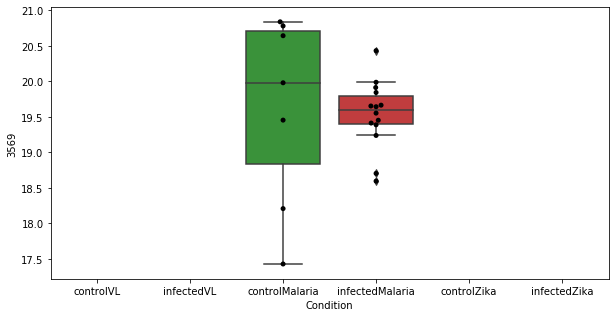

1625 row m/z                                                  151.096
row retention time                                       6.97699
p-val                                                   0.825114
adj.P.Val                                               0.984203
custom_id                                                    827
compound_names        6-Hydroxyhexanoic acid; 6-Hydroxyhexanoate
Name: 827, dtype: object


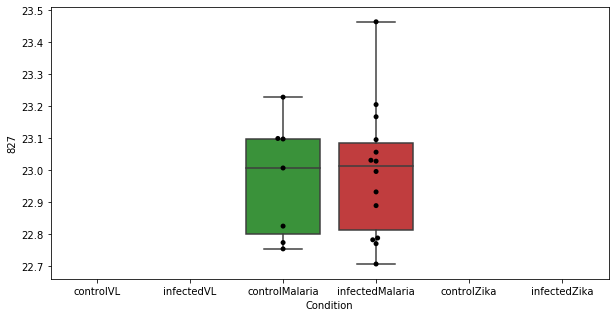

1626 row m/z                313.176
row retention time     4.57747
p-val                 0.829404
adj.P.Val             0.984203
custom_id                 2307
compound_names             NaN
Name: 2307, dtype: object


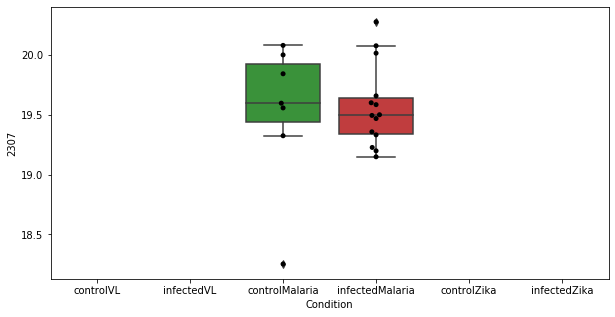

1627 row m/z                                          113.06
row retention time                              3.77166
p-val                                          0.829467
adj.P.Val                                      0.984203
custom_id                                           260
compound_names        trans-1,2-Dihydrobenzene-1,2-diol
Name: 260, dtype: object


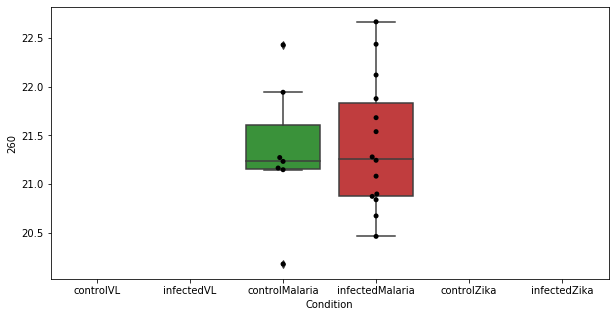

1628 row m/z                                                         84.0442
row retention time                                              12.3195
p-val                                                          0.831945
adj.P.Val                                                      0.984203
custom_id                                                            51
compound_names        L-Allothreonine; L-allo-Threonine$L-Threonine;...
Name: 51, dtype: object


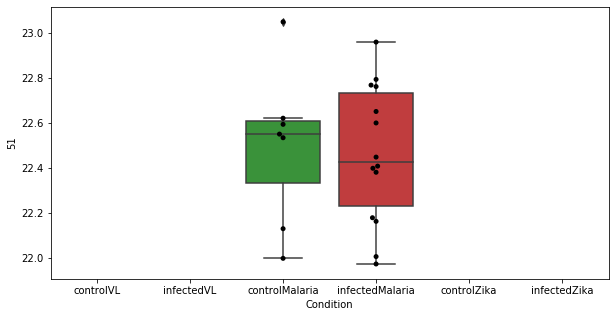

1629 row m/z                177.055
row retention time     3.75059
p-val                 0.832069
adj.P.Val             0.984203
custom_id                 1149
compound_names             NaN
Name: 1149, dtype: object


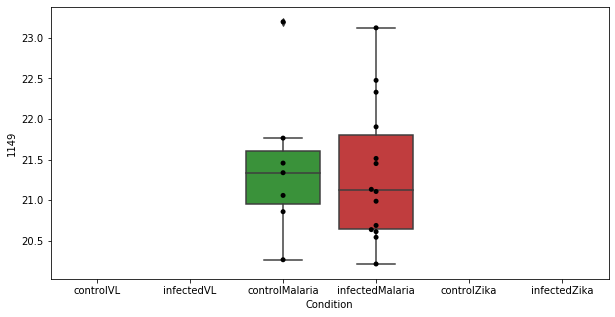

1630 row m/z                140.903
row retention time      12.494
p-val                 0.832871
adj.P.Val             0.984203
custom_id                  651
compound_names             NaN
Name: 651, dtype: object


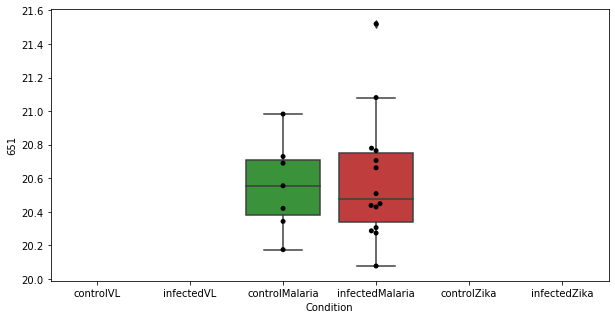

1631 row m/z                                                          90.055
row retention time                                              12.2503
p-val                                                           0.83289
adj.P.Val                                                      0.984203
custom_id                                                            87
compound_names        Sarcosine; N-Methylglycine$D-Alanine; D-2-Amin...
Name: 87, dtype: object


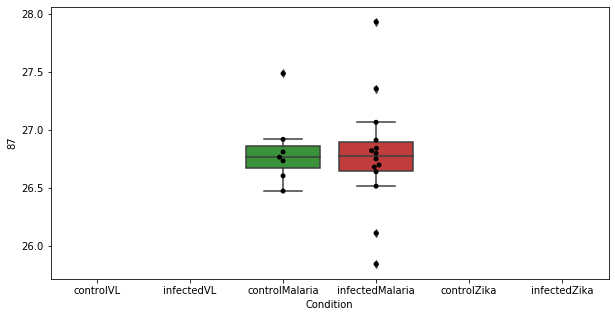

1632 row m/z                231.033
row retention time     12.2917
p-val                  0.83309
adj.P.Val             0.984203
custom_id                 1726
compound_names             NaN
Name: 1726, dtype: object


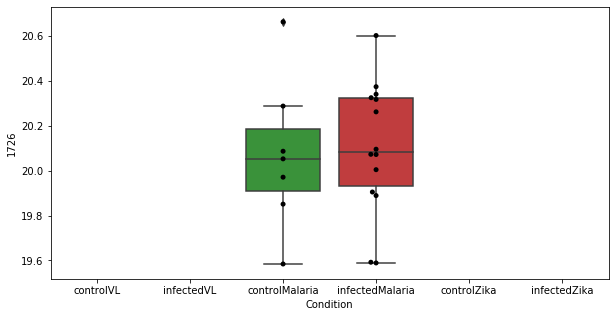

1633 row m/z                                                         144.102
row retention time                                              4.58818
p-val                                                          0.833169
adj.P.Val                                                      0.984203
custom_id                                                           691
compound_names        6-Acetamido-2-oxohexanoate; 2-Oxo-6-acetamidoc...
Name: 691, dtype: object


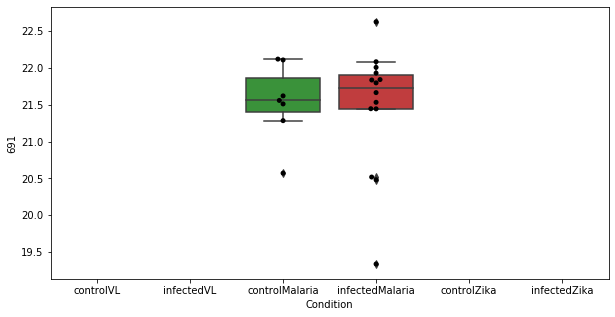

1634 row m/z                257.153
row retention time     12.4843
p-val                  0.83346
adj.P.Val             0.984203
custom_id                 1966
compound_names             NaN
Name: 1966, dtype: object


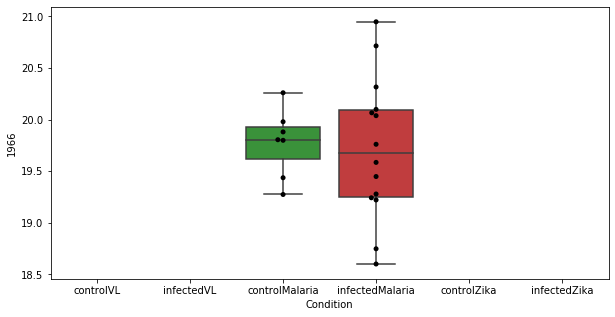

1635 row m/z                665.764
row retention time     7.96695
p-val                 0.833801
adj.P.Val             0.984203
custom_id                 2800
compound_names             NaN
Name: 2800, dtype: object


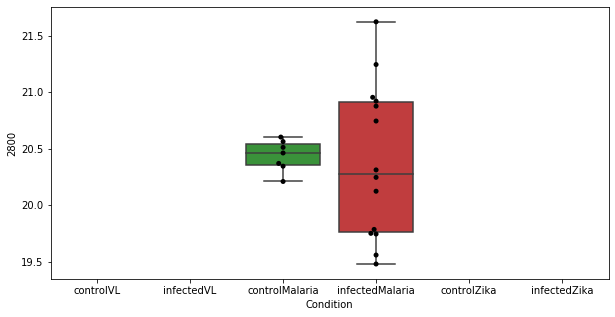

1636 row m/z                299.139
row retention time     6.98465
p-val                 0.834451
adj.P.Val             0.984203
custom_id                 4028
compound_names             NaN
Name: 4028, dtype: object


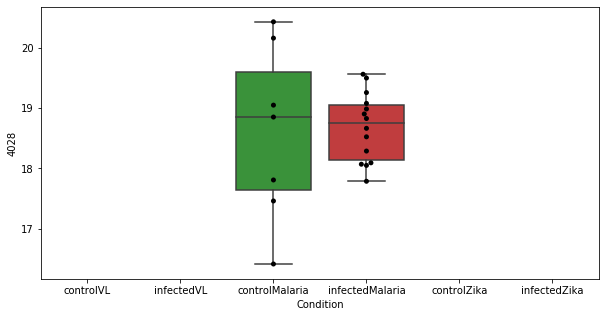

1637 row m/z                166.053
row retention time     11.2099
p-val                 0.834948
adj.P.Val             0.984203
custom_id                  998
compound_names             NaN
Name: 998, dtype: object


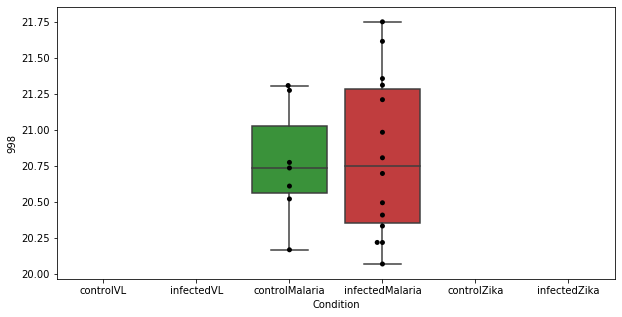

1638 row m/z                243.159
row retention time     3.94898
p-val                 0.835496
adj.P.Val             0.984203
custom_id                 1851
compound_names             NaN
Name: 1851, dtype: object


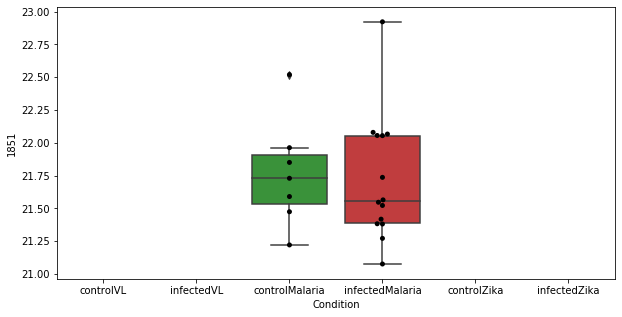

1639 row m/z                                                         308.198
row retention time                                              3.61334
p-val                                                          0.835752
adj.P.Val                                                      0.984203
custom_id                                                          2280
compound_names        3-oxo-10(S)-hydroxy-octadeca-6E,8E,12Z-trienoa...
Name: 2280, dtype: object


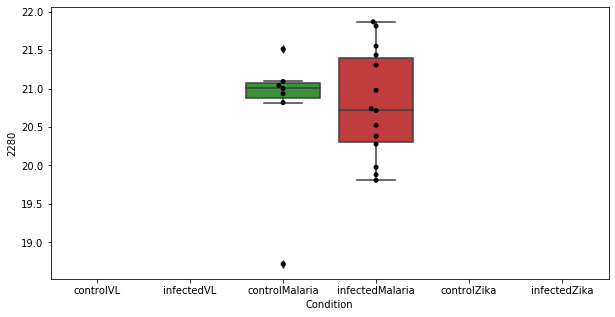

1640 row m/z                526.883
row retention time     13.0595
p-val                 0.837559
adj.P.Val             0.984203
custom_id                 2656
compound_names             NaN
Name: 2656, dtype: object


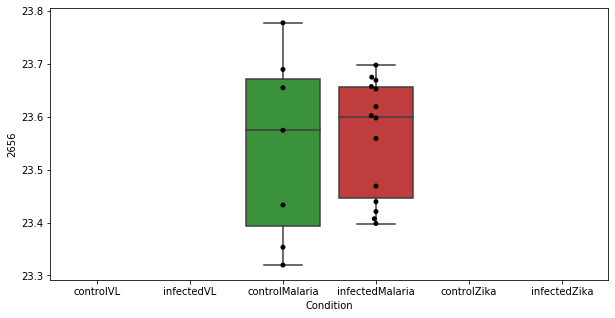

1641 row m/z                283.818
row retention time     7.07776
p-val                 0.837609
adj.P.Val             0.984203
custom_id                 2155
compound_names             NaN
Name: 2155, dtype: object


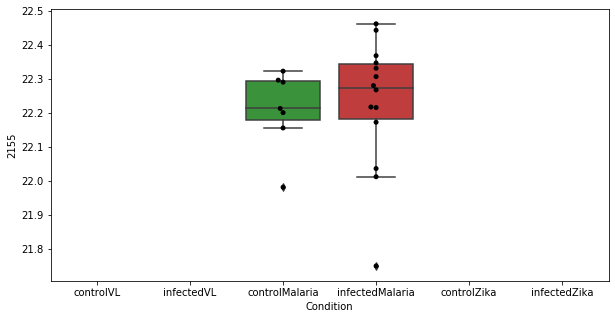

1642 row m/z                257.211
row retention time     3.73632
p-val                 0.838553
adj.P.Val             0.984203
custom_id                 1969
compound_names             NaN
Name: 1969, dtype: object


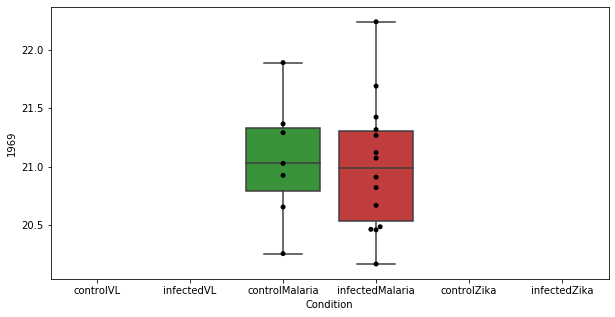

1643 row m/z                200.173
row retention time     3.64779
p-val                 0.838967
adj.P.Val             0.984203
custom_id                 1437
compound_names             NaN
Name: 1437, dtype: object


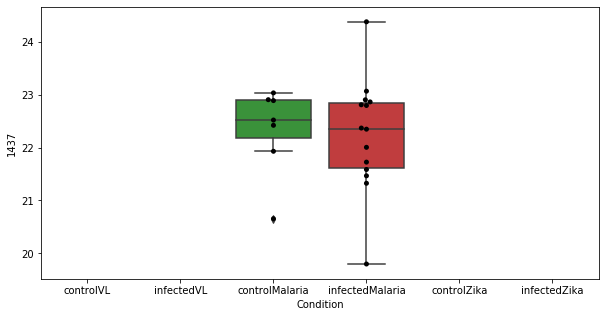

1644 row m/z                763.594
row retention time     3.52617
p-val                 0.839541
adj.P.Val             0.984203
custom_id                 2874
compound_names             NaN
Name: 2874, dtype: object


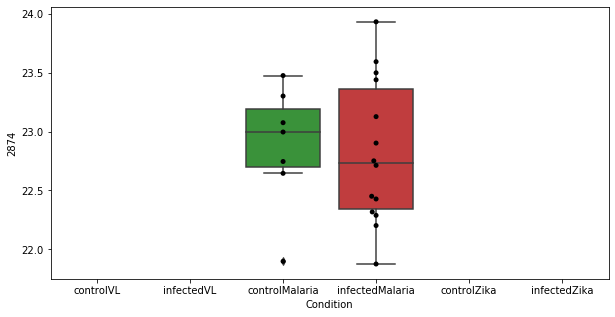

1645 row m/z                228.123
row retention time     23.8439
p-val                 0.840499
adj.P.Val             0.984203
custom_id                 1694
compound_names             NaN
Name: 1694, dtype: object


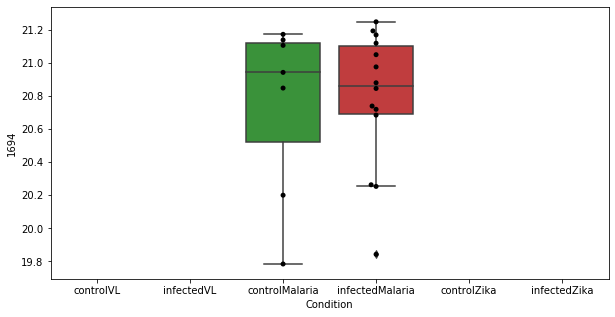

1646 row m/z                                                         180.066
row retention time                                              7.00036
p-val                                                          0.841398
adj.P.Val                                                      0.984203
custom_id                                                          1172
compound_names        1,7-Dimethylxanthine; Paraxanthine$adrenochrom...
Name: 1172, dtype: object


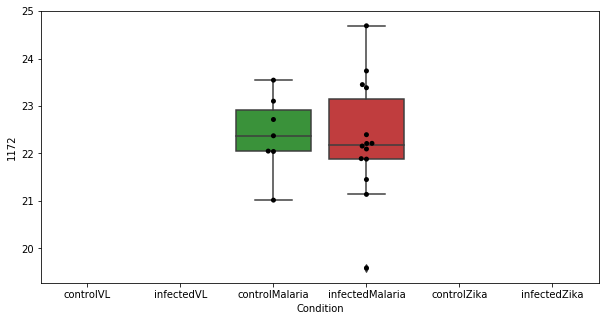

1647 row m/z                                               178.086
row retention time                                    4.55152
p-val                                                0.841474
adj.P.Val                                            0.984203
custom_id                                                3522
compound_names        $2-Phenyl-1,3-propanediol monocarbamate
Name: 3522, dtype: object


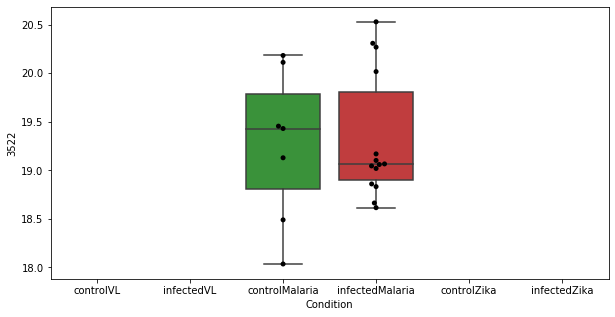

1648 row m/z                                                         86.0964
row retention time                                              9.59475
p-val                                                          0.841578
adj.P.Val                                                      0.984203
custom_id                                                            70
compound_names        N4-Acetylaminobutanal$L-Pipecolate; Pipecolini...
Name: 70, dtype: object


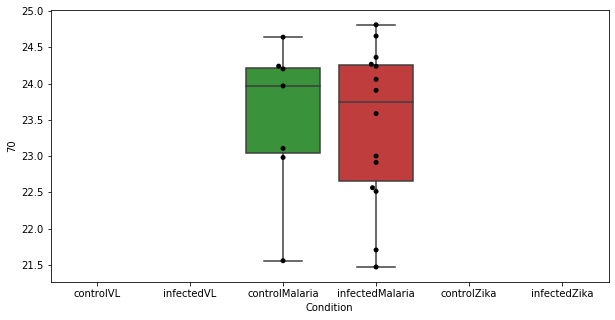

1649 row m/z                251.185
row retention time     23.7062
p-val                  0.84203
adj.P.Val             0.984203
custom_id                 1917
compound_names             NaN
Name: 1917, dtype: object


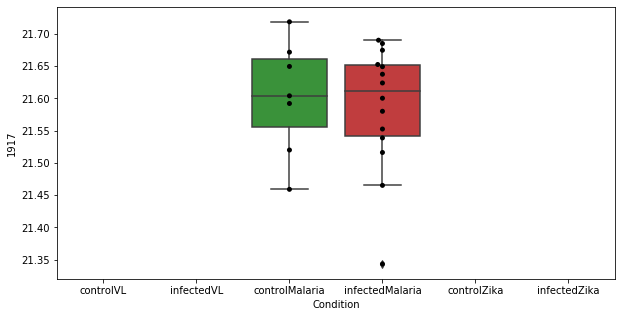

1650 row m/z                400.244
row retention time     23.3965
p-val                 0.842089
adj.P.Val             0.984203
custom_id                 2515
compound_names             NaN
Name: 2515, dtype: object


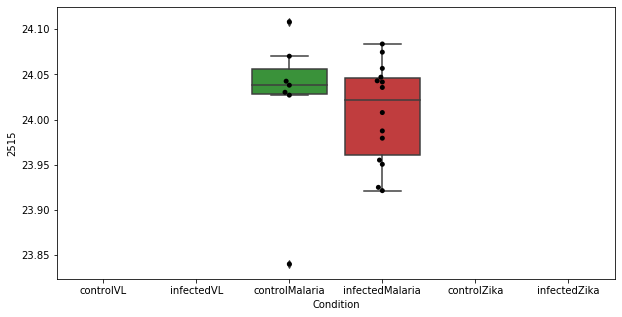

1651 row m/z                247.173
row retention time     7.19717
p-val                 0.842138
adj.P.Val             0.984203
custom_id                 3835
compound_names             NaN
Name: 3835, dtype: object


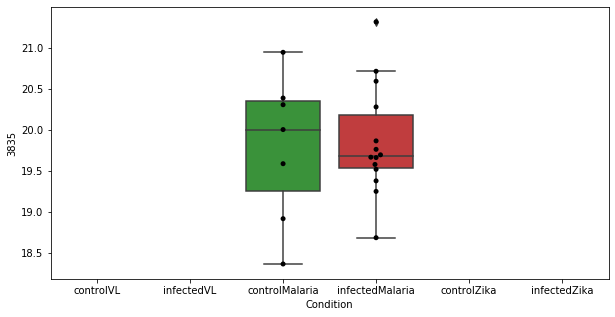

1652 row m/z                                                         171.065
row retention time                                              7.01044
p-val                                                           0.84291
adj.P.Val                                                      0.984203
custom_id                                                          4753
compound_names        6-Acetamido-2-oxohexanoate; 2-Oxo-6-acetamidoc...
Name: 4753, dtype: object


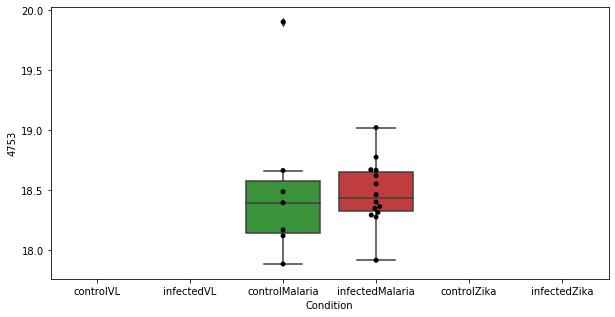

1653 row m/z                314.232
row retention time     6.99519
p-val                 0.842992
adj.P.Val             0.984203
custom_id                 4064
compound_names             NaN
Name: 4064, dtype: object


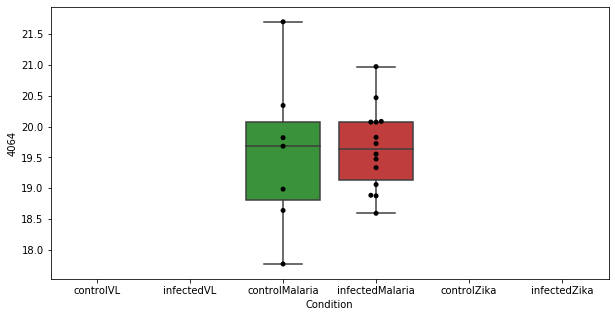

1654 row m/z                231.134
row retention time     10.9778
p-val                 0.843827
adj.P.Val             0.984203
custom_id                 1728
compound_names             NaN
Name: 1728, dtype: object


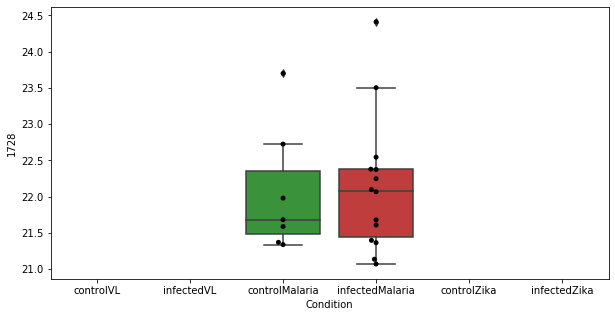

1655 row m/z                680.479
row retention time     6.67085
p-val                 0.844402
adj.P.Val             0.984203
custom_id                 2809
compound_names             NaN
Name: 2809, dtype: object


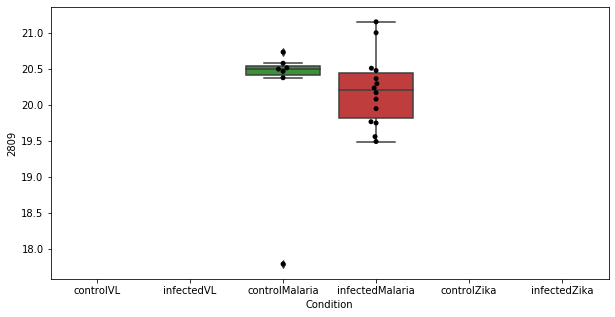

1656 row m/z                                                         280.165
row retention time                                               6.9886
p-val                                                          0.844483
adj.P.Val                                                      0.984203
custom_id                                                          2139
compound_names        3(S),6(S)-dihydroxy-tetradec-8Z-enoate$3(S),6(...
Name: 2139, dtype: object


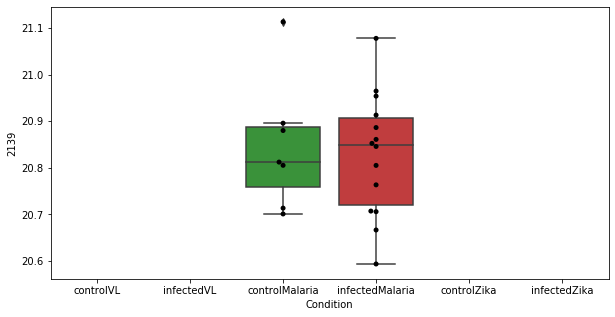

1657 row m/z                171.076
row retention time     12.3185
p-val                 0.845337
adj.P.Val             0.984203
custom_id                 1073
compound_names             NaN
Name: 1073, dtype: object


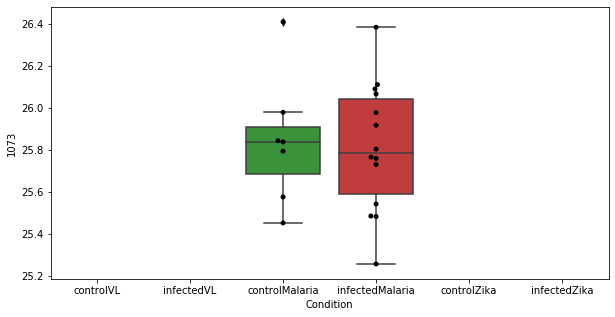

1658 row m/z                111.117
row retention time     3.64366
p-val                 0.846652
adj.P.Val             0.984203
custom_id                  237
compound_names               $
Name: 237, dtype: object


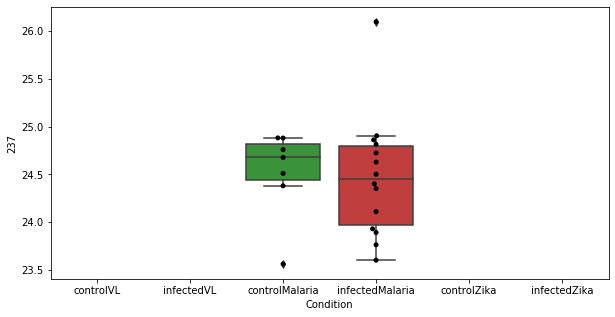

1659 row m/z                                                         130.063
row retention time                                              12.1747
p-val                                                          0.847155
adj.P.Val                                                      0.984203
custom_id                                                          4545
compound_names        (S)-3-Methyl-2-oxopentanoic acid; (S)-3-Methyl...
Name: 4545, dtype: object


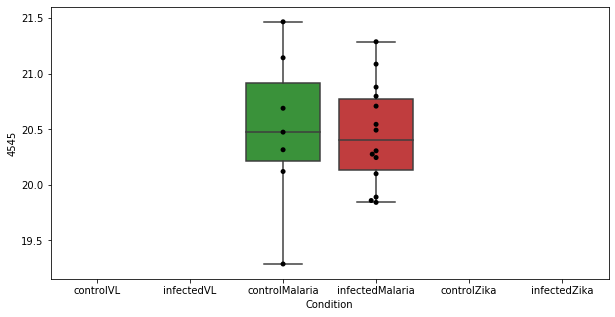

1660 row m/z                                                         156.077
row retention time                                              1.10246
p-val                                                          0.847274
adj.P.Val                                                      0.984203
custom_id                                                          5641
compound_names        5-Guanidino-2-oxopentanoate; 5-Guanidino-2-oxo...
Name: 5641, dtype: object


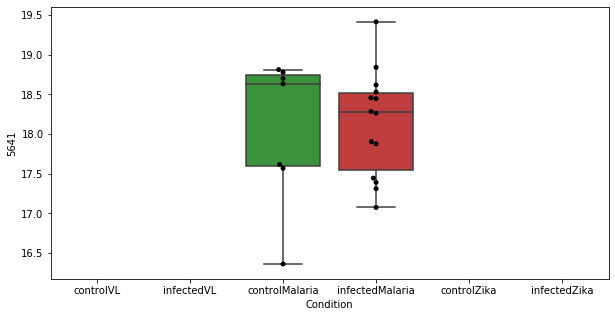

1661 row m/z                275.103
row retention time     12.3049
p-val                 0.847655
adj.P.Val             0.984203
custom_id                 2085
compound_names             NaN
Name: 2085, dtype: object


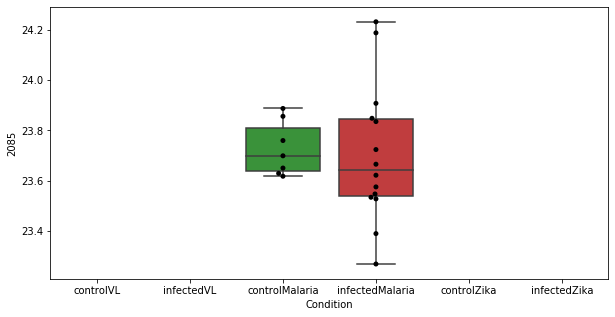

1662 row m/z                                                         115.087
row retention time                                              9.52976
p-val                                                          0.847822
adj.P.Val                                                      0.984203
custom_id                                                           308
compound_names        L-Ornithine; (S)-2,5-Diaminovaleric acid; (S)-...
Name: 308, dtype: object


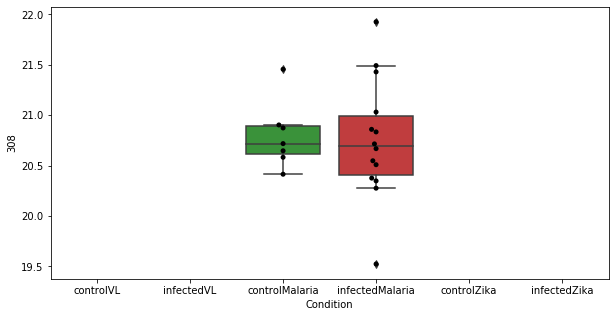

1663 row m/z                318.964
row retention time     11.2948
p-val                 0.847857
adj.P.Val             0.984203
custom_id                 2341
compound_names             NaN
Name: 2341, dtype: object


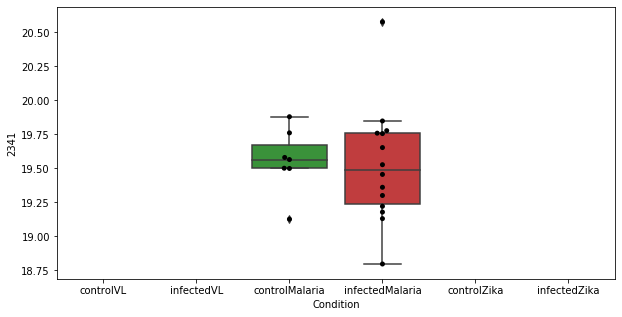

1664 row m/z                759.636
row retention time      6.6923
p-val                  0.84786
adj.P.Val             0.984203
custom_id                 4270
compound_names             NaN
Name: 4270, dtype: object


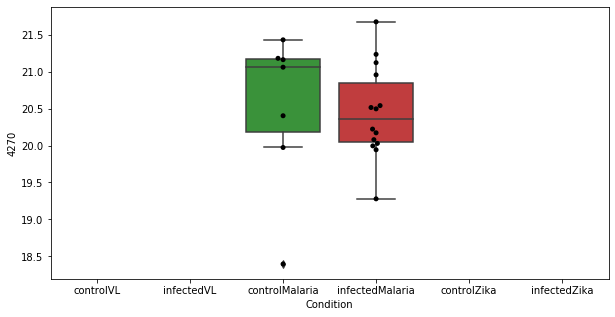

1665 row m/z                251.185
row retention time     4.05842
p-val                 0.847912
adj.P.Val             0.984203
custom_id                 1916
compound_names             NaN
Name: 1916, dtype: object


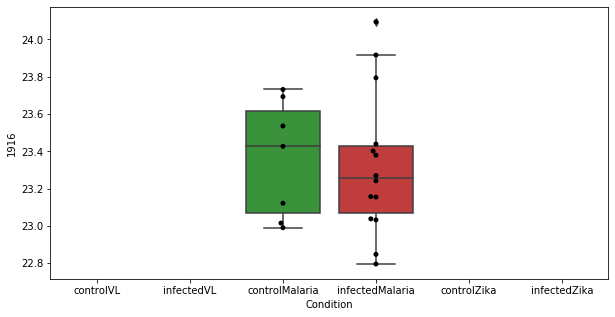

1666 row m/z                138.906
row retention time     12.4822
p-val                 0.848015
adj.P.Val             0.984203
custom_id                  624
compound_names             NaN
Name: 624, dtype: object


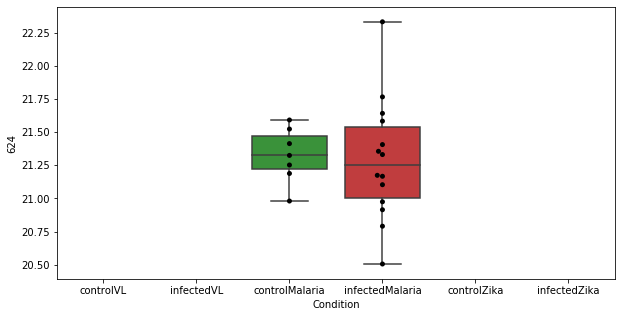

1667 row m/z                704.578
row retention time     3.75176
p-val                 0.848073
adj.P.Val             0.984203
custom_id                 2826
compound_names             NaN
Name: 2826, dtype: object


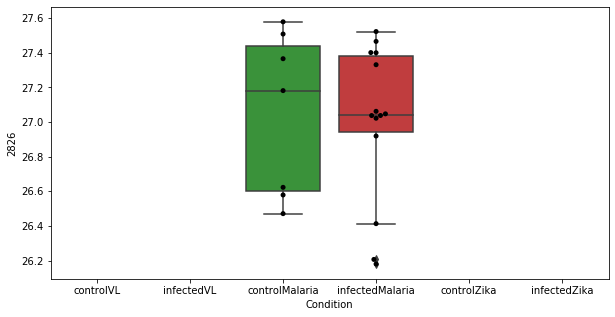

1668 row m/z                203.956
row retention time     5.24838
p-val                 0.848565
adj.P.Val             0.984203
custom_id                 1466
compound_names             NaN
Name: 1466, dtype: object


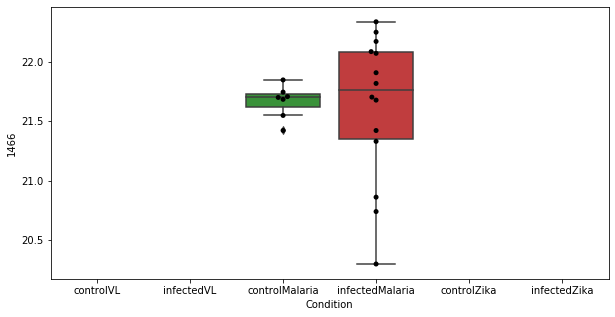

1669 row m/z                                                         116.071
row retention time                                              8.89735
p-val                                                          0.849364
adj.P.Val                                                      0.984203
custom_id                                                          3172
compound_names        D-Proline$L-Proline; 2-Pyrrolidinecarboxylic a...
Name: 3172, dtype: object


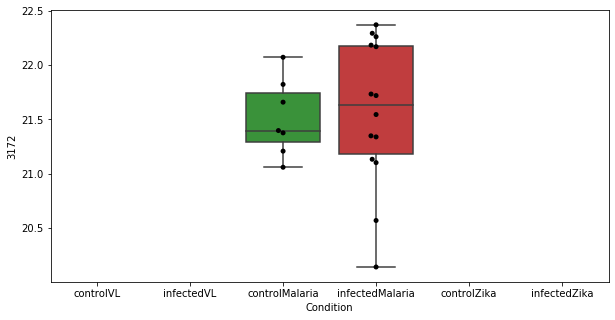

1670 row m/z                                                          363.22
row retention time                                              3.51928
p-val                                                          0.849875
adj.P.Val                                                      0.984203
custom_id                                                          2446
compound_names        17alpha,21-Dihydroxy-5beta-pregnane-3,11,20-tr...
Name: 2446, dtype: object


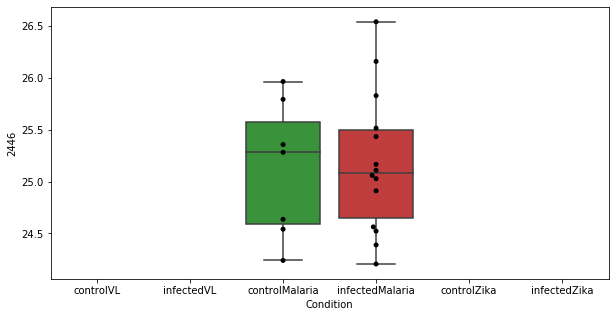

1671 row m/z                179.128
row retention time     4.56906
p-val                 0.849886
adj.P.Val             0.984203
custom_id                 1163
compound_names             NaN
Name: 1163, dtype: object


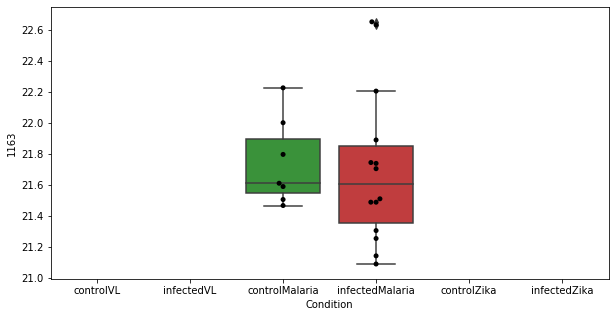

1672 row m/z                161.128
row retention time     17.0641
p-val                 0.850404
adj.P.Val             0.984203
custom_id                  941
compound_names             NaN
Name: 941, dtype: object


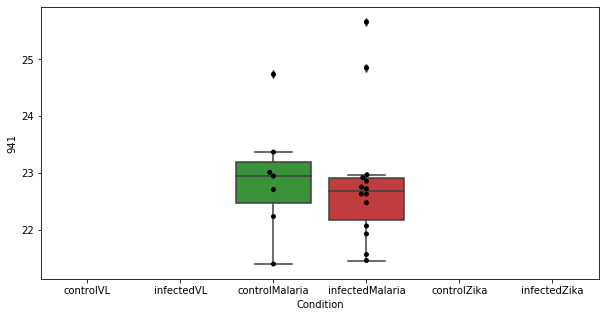

1673 row m/z                  318.9
row retention time     11.9532
p-val                 0.850637
adj.P.Val             0.984203
custom_id                 2331
compound_names             NaN
Name: 2331, dtype: object


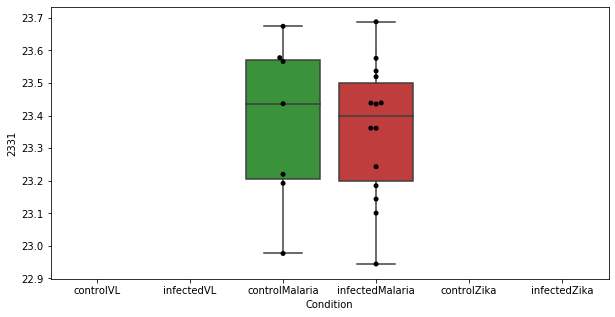

1674 row m/z                248.149
row retention time     9.75641
p-val                   0.8512
adj.P.Val             0.984203
custom_id                 1890
compound_names             NaN
Name: 1890, dtype: object


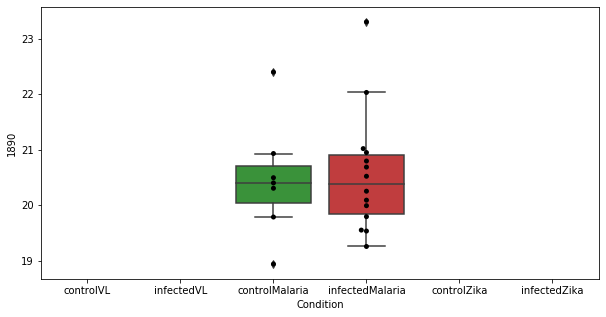

1675 row m/z                   70.0651
row retention time        10.9715
p-val                    0.851539
adj.P.Val                0.984203
custom_id                       1
compound_names        1-pyrroline
Name: 1, dtype: object


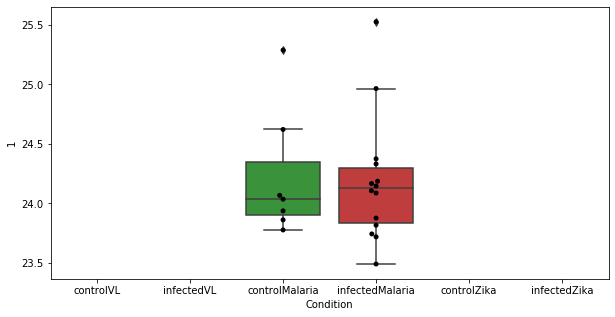

1676 row m/z                147.984
row retention time      23.666
p-val                 0.851638
adj.P.Val             0.984203
custom_id                  768
compound_names             NaN
Name: 768, dtype: object


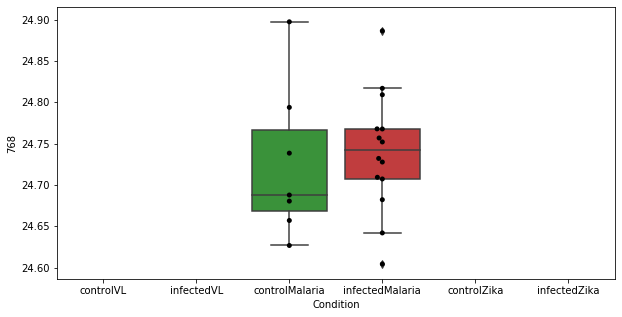

1677 row m/z                           201.112
row retention time                6.98746
p-val                            0.852133
adj.P.Val                        0.984203
custom_id                            1444
compound_names        propionyl-carnitine
Name: 1444, dtype: object


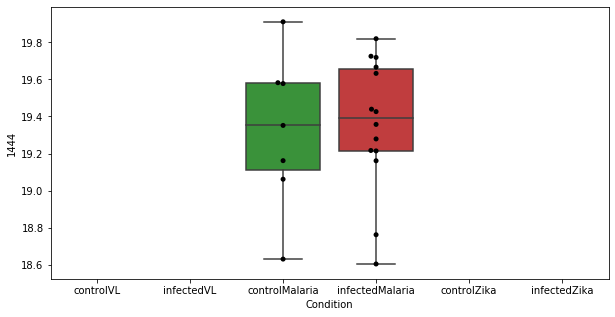

1678 row m/z                189.025
row retention time     12.8963
p-val                  0.85268
adj.P.Val             0.984203
custom_id                 1287
compound_names             NaN
Name: 1287, dtype: object


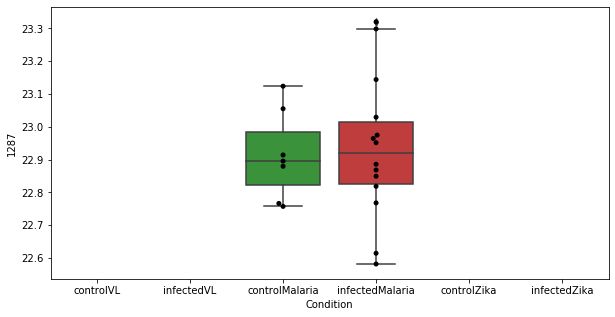

1679 row m/z                315.158
row retention time      9.8077
p-val                 0.852843
adj.P.Val             0.984203
custom_id                 2316
compound_names             NaN
Name: 2316, dtype: object


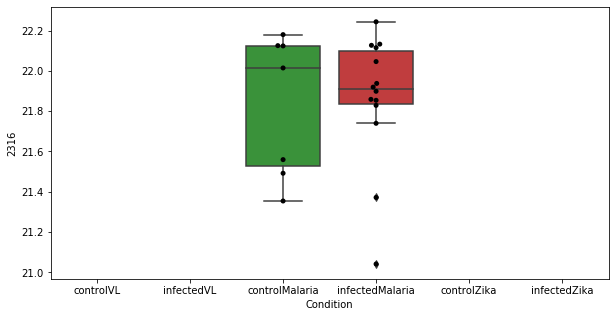

1680 row m/z                            252.144
row retention time                 4.55139
p-val                             0.854131
adj.P.Val                         0.984203
custom_id                             1927
compound_names        histidyl-prolinamide
Name: 1927, dtype: object


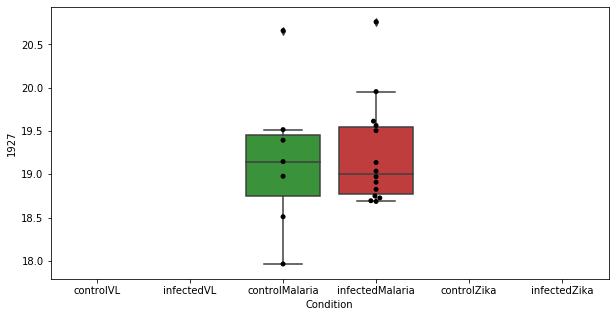

1681 row m/z                                                         83.0604
row retention time                                              23.9041
p-val                                                          0.854498
adj.P.Val                                                      0.984203
custom_id                                                            49
compound_names        5,6-Dihydrothymine; Dihydrothymine; 5,6-Dihydr...
Name: 49, dtype: object


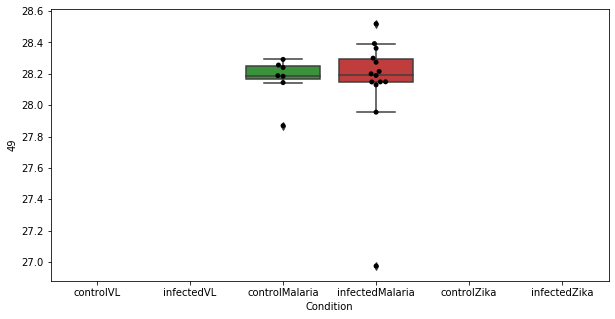

1682 row m/z                160.133
row retention time     7.74042
p-val                 0.854865
adj.P.Val             0.984203
custom_id                  930
compound_names             NaN
Name: 930, dtype: object


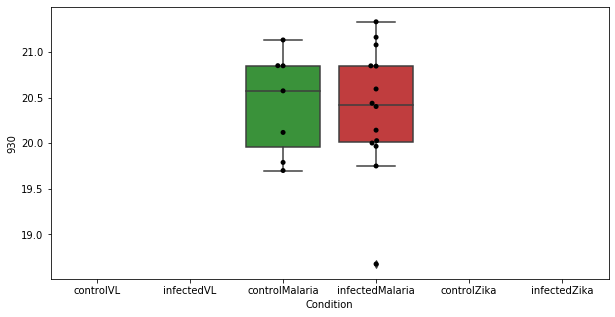

1683 row m/z                204.123
row retention time     6.99352
p-val                 0.856207
adj.P.Val             0.984203
custom_id                 1471
compound_names             NaN
Name: 1471, dtype: object


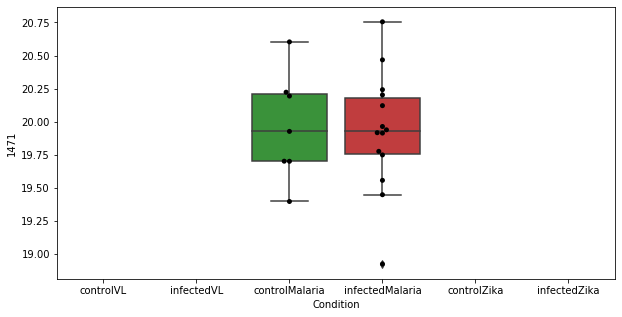

1684 row m/z                 246.03
row retention time     10.9714
p-val                  0.85628
adj.P.Val             0.984203
custom_id                 1872
compound_names             NaN
Name: 1872, dtype: object


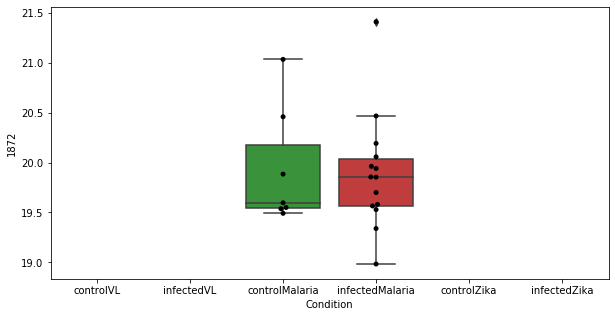

1685 row m/z                160.116
row retention time      10.799
p-val                 0.856448
adj.P.Val             0.984203
custom_id                  928
compound_names             NaN
Name: 928, dtype: object


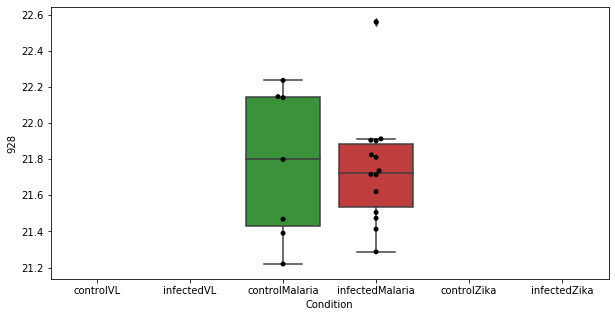

1686 row m/z                                                   174.087
row retention time                                        11.9862
p-val                                                    0.856808
adj.P.Val                                                0.984203
custom_id                                                    1119
compound_names        N-Methyltyramine$N-Methylphenylethanolamine
Name: 1119, dtype: object


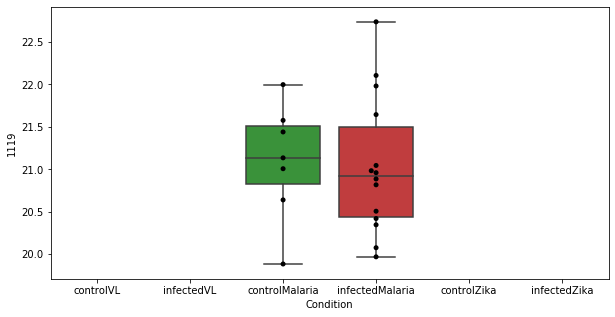

1687 row m/z                                                       147.113
row retention time                                            17.7712
p-val                                                        0.857043
adj.P.Val                                                    0.984203
custom_id                                                         760
compound_names        L-Lysine; Lysine acid; 2,6-Diaminohexanoic acid
Name: 760, dtype: object


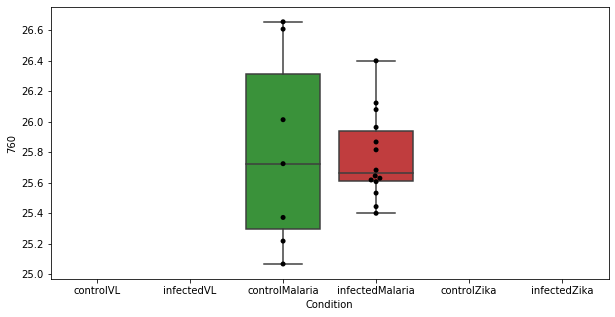

1688 row m/z                317.252
row retention time     4.54049
p-val                 0.857052
adj.P.Val             0.984203
custom_id                 4068
compound_names             NaN
Name: 4068, dtype: object


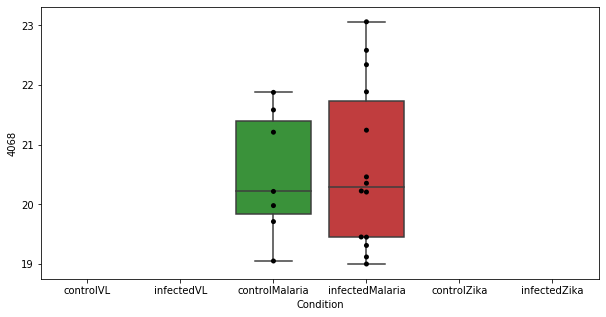

1689 row m/z                568.494
row retention time     3.24484
p-val                  0.85766
adj.P.Val             0.984203
custom_id                 6224
compound_names             NaN
Name: 6224, dtype: object


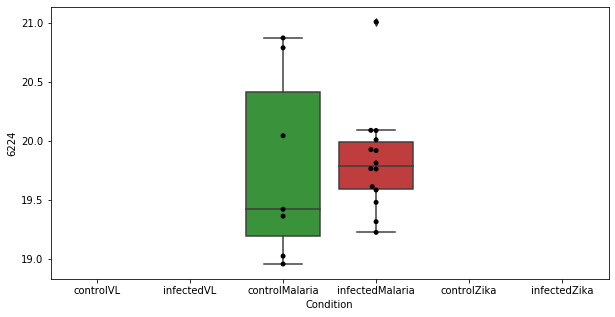

1690 row m/z                                                         139.075
row retention time                                              4.40072
p-val                                                          0.858526
adj.P.Val                                                      0.984203
custom_id                                                           633
compound_names        Choline phosphate; Phosphorylcholine; Phosphoc...
Name: 633, dtype: object


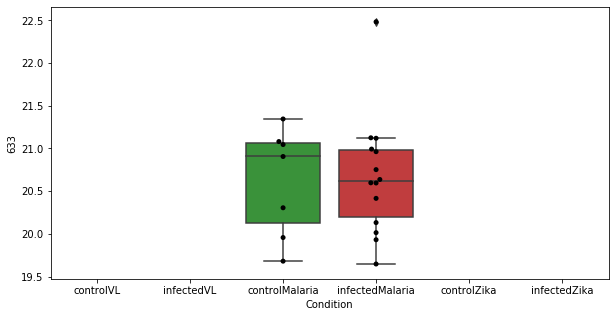

1691 row m/z                                                   186.113
row retention time                                        4.58561
p-val                                                    0.859206
adj.P.Val                                                0.984203
custom_id                                                    1253
compound_names        3-Methoxytyramine$Epinine; Deoxyepinephrine
Name: 1253, dtype: object


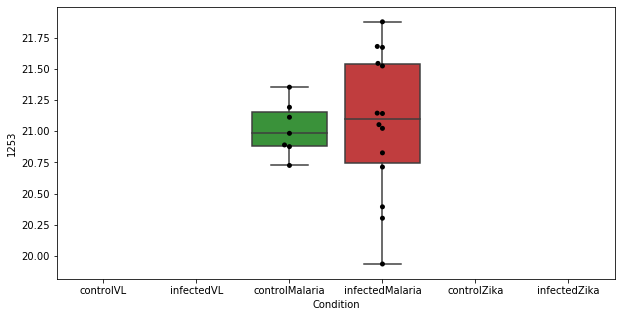

1692 row m/z                 680.48
row retention time      3.3614
p-val                 0.860083
adj.P.Val             0.984203
custom_id                 2807
compound_names             NaN
Name: 2807, dtype: object


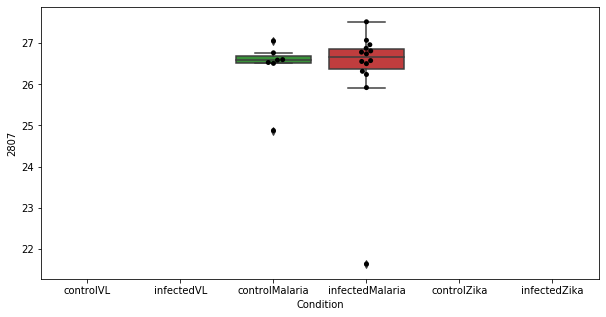

1693 row m/z                243.948
row retention time     23.4404
p-val                 0.860214
adj.P.Val             0.984203
custom_id                 1852
compound_names             NaN
Name: 1852, dtype: object


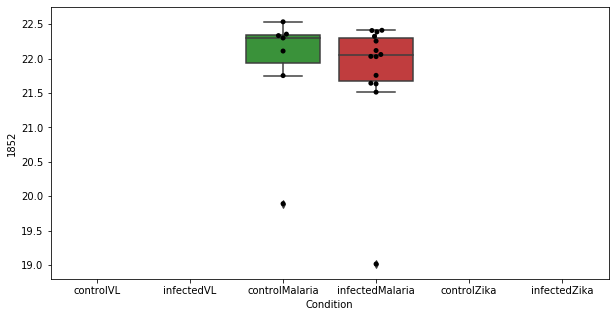

1694 row m/z                                                         200.128
row retention time                                              4.54693
p-val                                                          0.861022
adj.P.Val                                                      0.984203
custom_id                                                          1436
compound_names        Ecgonine methyl ester; Methyl ecgonine$ecgonin...
Name: 1436, dtype: object


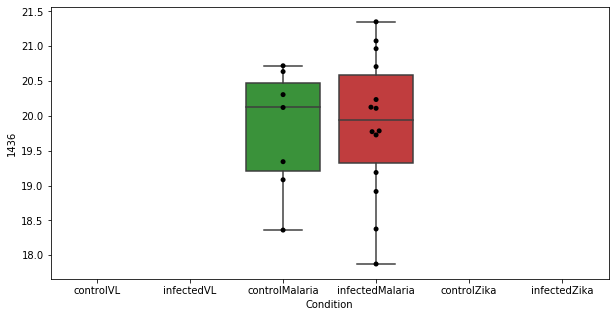

1695 row m/z                811.666
row retention time     3.57665
p-val                 0.862483
adj.P.Val             0.984203
custom_id                 2945
compound_names             NaN
Name: 2945, dtype: object


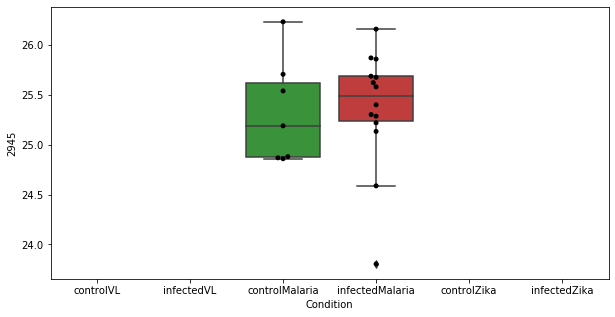

1696 row m/z                705.582
row retention time     3.74094
p-val                 0.863501
adj.P.Val             0.984203
custom_id                 2828
compound_names             NaN
Name: 2828, dtype: object


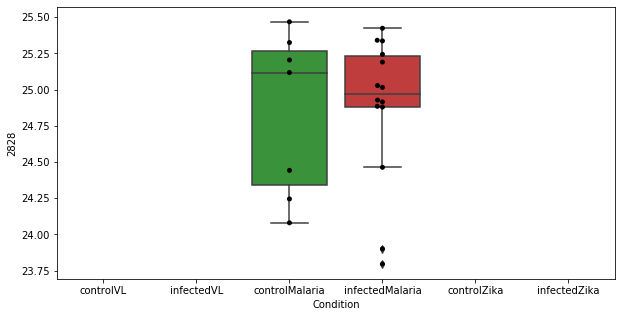

1697 row m/z                 328.16
row retention time     3.69128
p-val                 0.863869
adj.P.Val             0.984203
custom_id                 2370
compound_names             NaN
Name: 2370, dtype: object


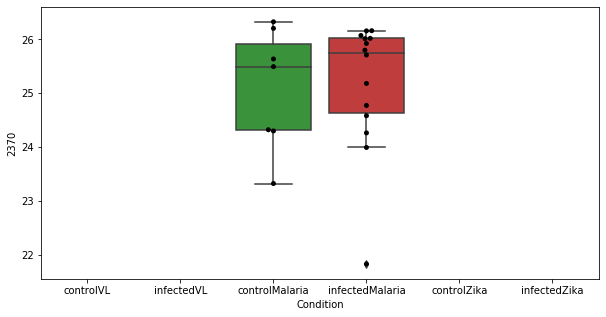

1698 row m/z                 217.13
row retention time     12.0288
p-val                 0.865605
adj.P.Val             0.984203
custom_id                 1618
compound_names             NaN
Name: 1618, dtype: object


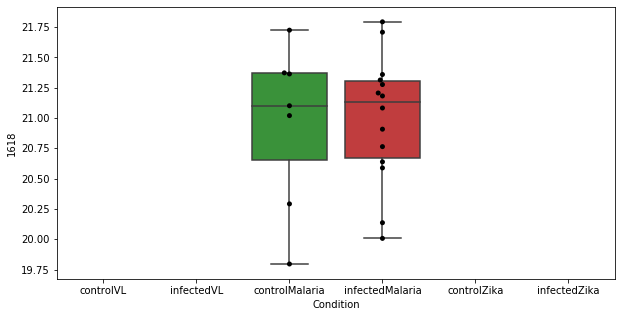

1699 row m/z                                                         132.077
row retention time                                              12.1338
p-val                                                          0.866175
adj.P.Val                                                      0.984203
custom_id                                                           553
compound_names        Creatine; alpha-Methylguanidino acetic acid; M...
Name: 553, dtype: object


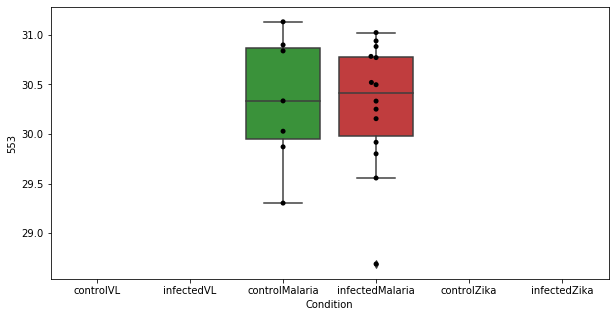

1700 row m/z                82.0521
row retention time     8.96132
p-val                 0.866186
adj.P.Val             0.984203
custom_id                 3020
compound_names             NaN
Name: 3020, dtype: object


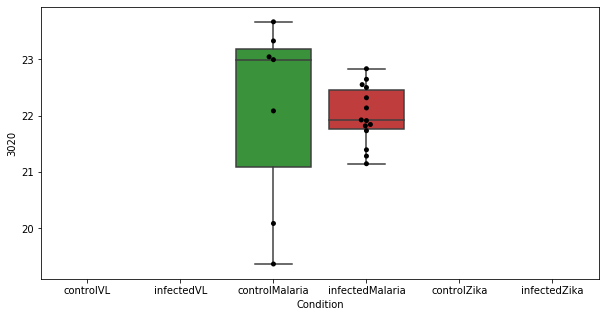

1701 row m/z                149.117
row retention time     4.26642
p-val                 0.866574
adj.P.Val             0.984203
custom_id                  804
compound_names             NaN
Name: 804, dtype: object


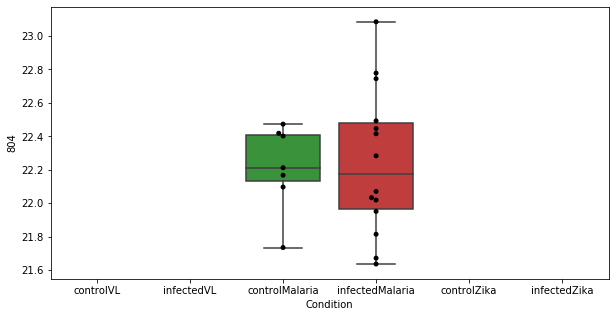

1702 row m/z                180.159
row retention time     4.05741
p-val                 0.867073
adj.P.Val             0.984203
custom_id                 1190
compound_names             NaN
Name: 1190, dtype: object


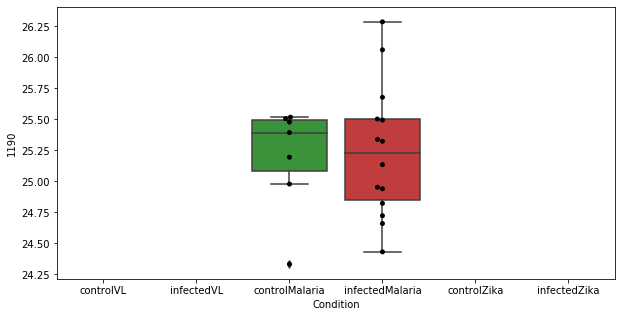

1703 row m/z                145.097
row retention time     11.5851
p-val                 0.867368
adj.P.Val             0.984203
custom_id                  715
compound_names             NaN
Name: 715, dtype: object


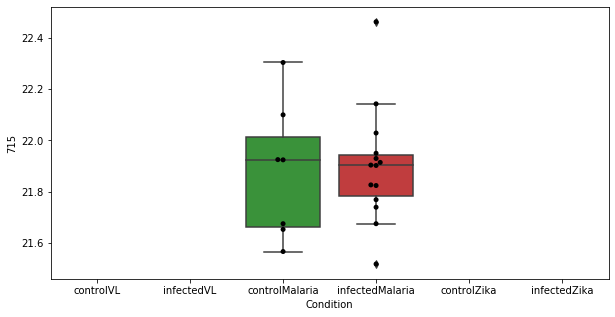

1704 row m/z                                                         148.097
row retention time                                              10.5477
p-val                                                           0.86768
adj.P.Val                                                      0.984203
custom_id                                                           783
compound_names        N4-Acetylaminobutanal$L-Pipecolate; Pipecolini...
Name: 783, dtype: object


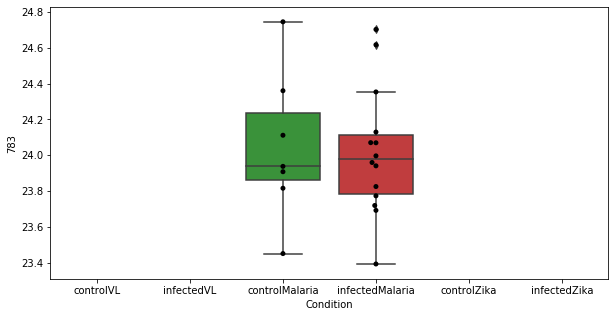

1705 row m/z                213.112
row retention time     3.89806
p-val                 0.867757
adj.P.Val             0.984203
custom_id                 3677
compound_names             NaN
Name: 3677, dtype: object


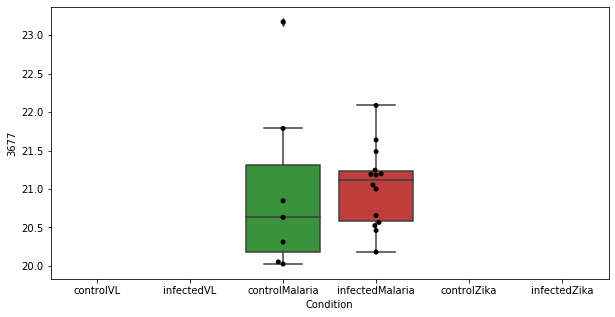

1706 row m/z                                                        202.107
row retention time                                             6.99549
p-val                                                         0.867806
adj.P.Val                                                     0.984203
custom_id                                                         1448
compound_names        Pantothenate; Pantothenic acid; (R)-Pantothenate
Name: 1448, dtype: object


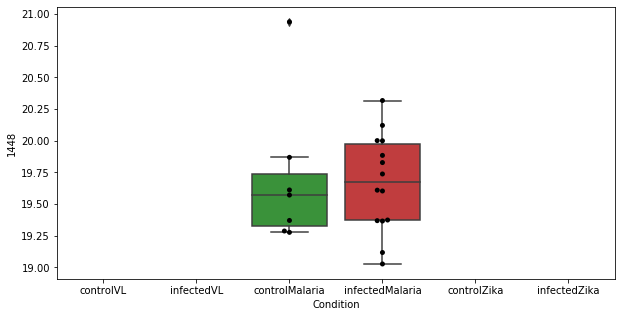

1707 row m/z                116.104
row retention time     10.9778
p-val                 0.867864
adj.P.Val             0.984203
custom_id                  324
compound_names             NaN
Name: 324, dtype: object


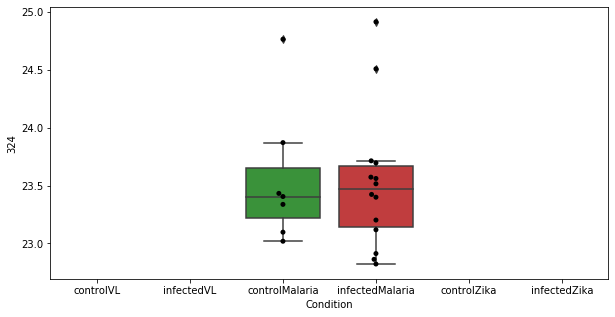

1708 row m/z                188.128
row retention time      7.0004
p-val                 0.868578
adj.P.Val             0.984203
custom_id                 1281
compound_names             NaN
Name: 1281, dtype: object


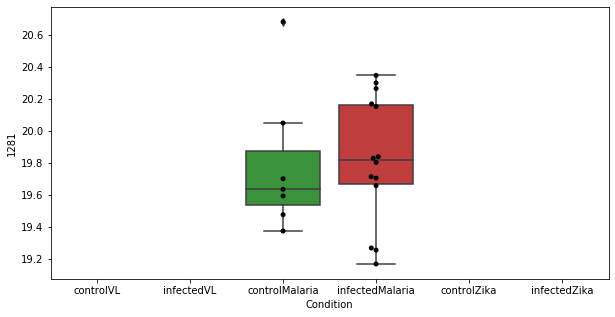

1709 row m/z                 274.91
row retention time     12.9958
p-val                 0.869004
adj.P.Val             0.984203
custom_id                 2073
compound_names             NaN
Name: 2073, dtype: object


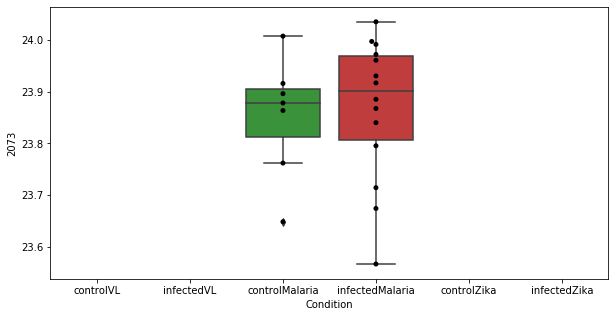

1710 row m/z                103.039
row retention time     4.10759
p-val                 0.869343
adj.P.Val             0.984203
custom_id                  154
compound_names             NaN
Name: 154, dtype: object


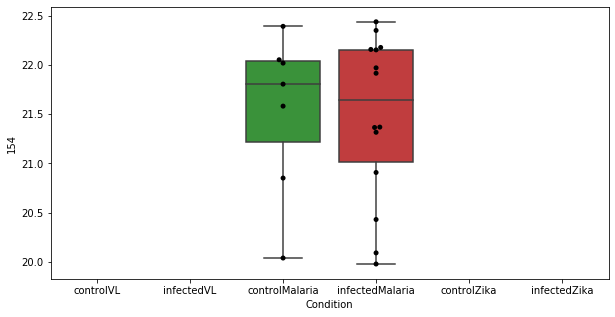

1711 row m/z                784.584
row retention time      3.5025
p-val                 0.870837
adj.P.Val             0.984203
custom_id                 2905
compound_names             NaN
Name: 2905, dtype: object


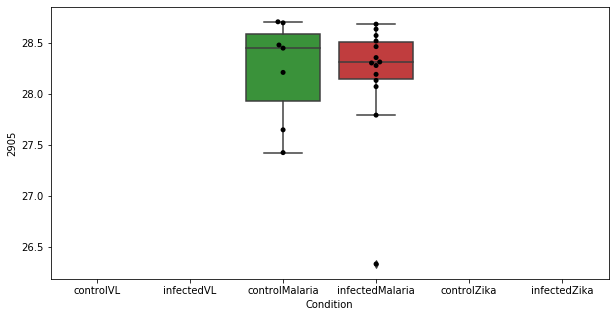

1712 row m/z                784.881
row retention time     8.86977
p-val                  0.87125
adj.P.Val             0.984203
custom_id                 2906
compound_names             NaN
Name: 2906, dtype: object


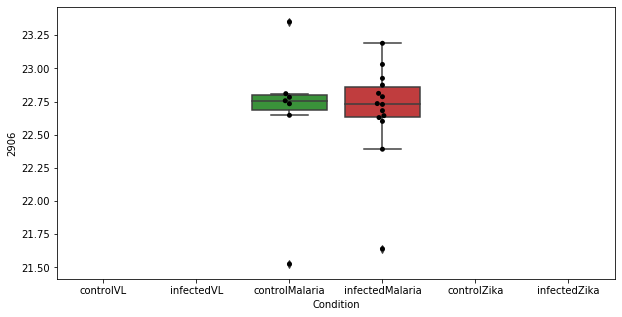

1713 row m/z                     732.609
row retention time           3.7073
p-val                      0.871538
adj.P.Val                  0.984203
custom_id                      2845
compound_names        Sphingomyelin
Name: 2845, dtype: object


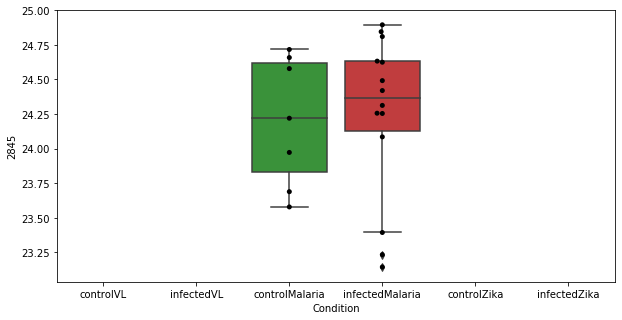

1714 row m/z                                                         150.058
row retention time                                              7.01491
p-val                                                          0.871902
adj.P.Val                                                      0.984203
custom_id                                                           812
compound_names        L-Methionine; Methionine; L-2-Amino-4methylthi...
Name: 812, dtype: object


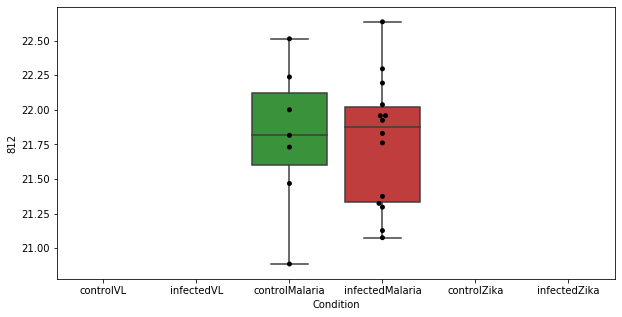

1715 row m/z                779.855
row retention time     9.15503
p-val                 0.872007
adj.P.Val             0.984203
custom_id                 2890
compound_names             NaN
Name: 2890, dtype: object


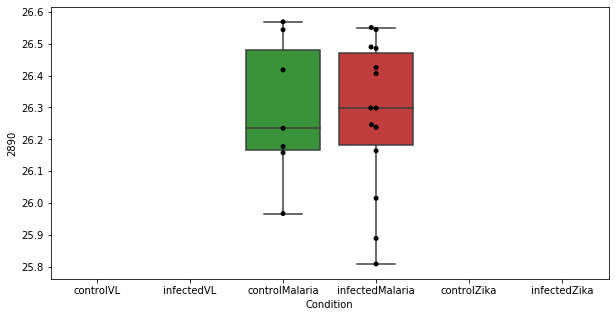

1716 row m/z                131.082
row retention time     7.02573
p-val                 0.872151
adj.P.Val             0.984203
custom_id                  531
compound_names             NaN
Name: 531, dtype: object


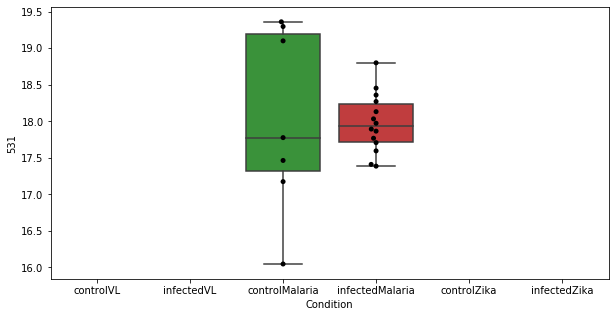

1717 row m/z                189.135
row retention time     19.5294
p-val                 0.872555
adj.P.Val             0.984203
custom_id                 1300
compound_names             NaN
Name: 1300, dtype: object


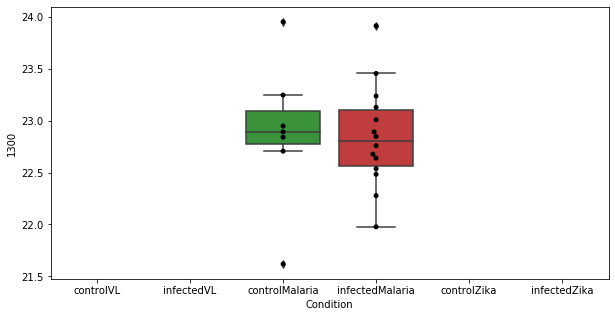

1718 row m/z                 325.16
row retention time      4.3247
p-val                 0.872663
adj.P.Val             0.984203
custom_id                 2352
compound_names             NaN
Name: 2352, dtype: object


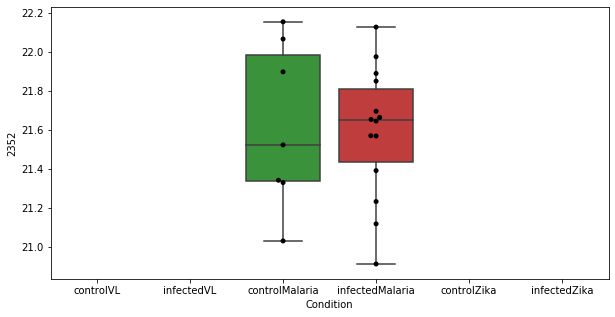

1719 row m/z                                                         297.242
row retention time                                              3.60562
p-val                                                          0.872693
adj.P.Val                                                      0.984203
custom_id                                                          2241
compound_names        13(S)-HODE; (13S)-Hydroxyoctadecadienoic acid;...
Name: 2241, dtype: object


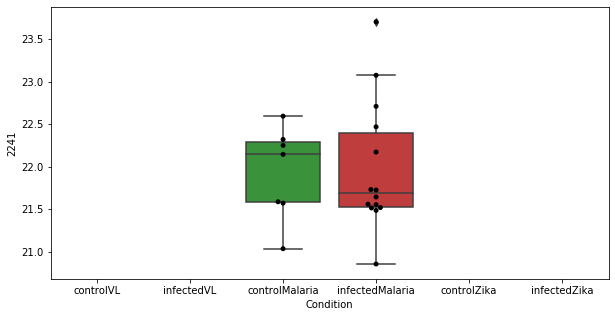

1720 row m/z                            118.123
row retention time                 6.90077
p-val                             0.873061
adj.P.Val                         0.984203
custom_id                              354
compound_names        3-Dehydroxycarnitine
Name: 354, dtype: object


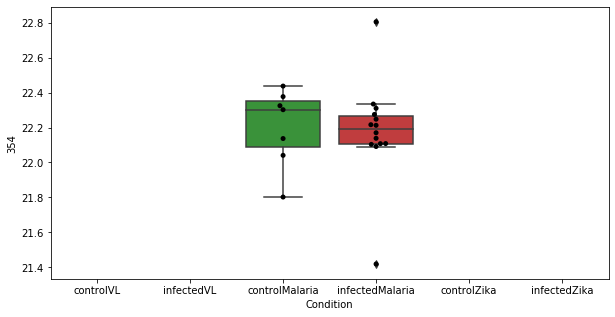

1721 row m/z                768.589
row retention time     3.49182
p-val                 0.873268
adj.P.Val             0.984203
custom_id                 2877
compound_names             NaN
Name: 2877, dtype: object


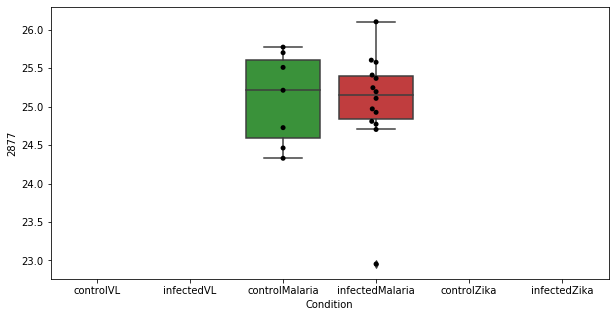

1722 row m/z                186.113
row retention time     9.70235
p-val                 0.873991
adj.P.Val             0.984203
custom_id                 1252
compound_names             NaN
Name: 1252, dtype: object


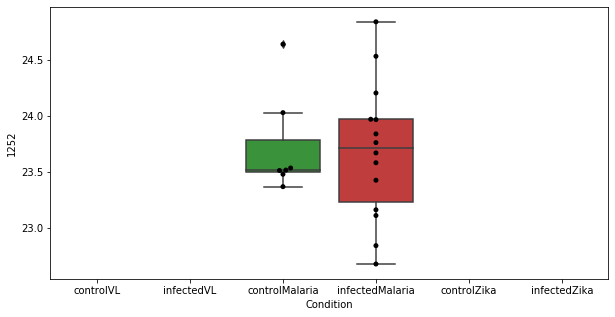

1723 row m/z                158.101
row retention time     10.9654
p-val                 0.875142
adj.P.Val             0.984203
custom_id                  899
compound_names             NaN
Name: 899, dtype: object


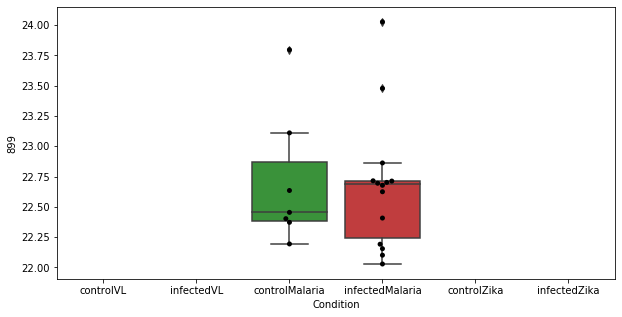

1724 row m/z                                                          119.09
row retention time                                              10.7986
p-val                                                           0.87642
adj.P.Val                                                      0.984203
custom_id                                                           362
compound_names        5-Aminopentanoate; 5-Aminopentanoic acid; 5-Am...
Name: 362, dtype: object


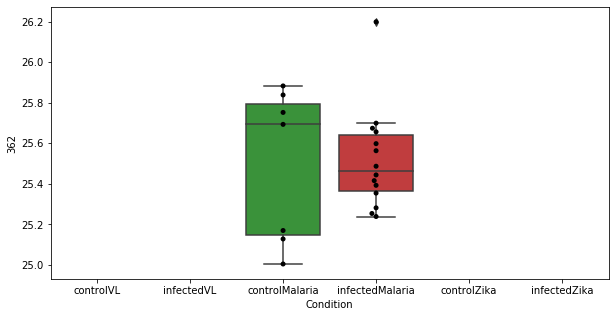

1725 row m/z                  318.9
row retention time     13.0155
p-val                 0.877042
adj.P.Val             0.984203
custom_id                 2332
compound_names             NaN
Name: 2332, dtype: object


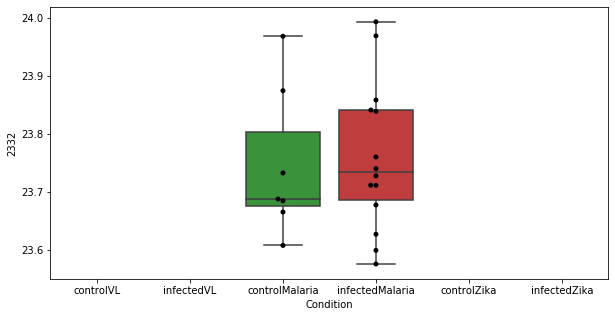

1726 row m/z                                                         146.081
row retention time                                              10.7245
p-val                                                          0.877545
adj.P.Val                                                      0.984203
custom_id                                                           737
compound_names        6-Amino-2-oxohexanoate; 2-Oxo-6-aminocaproate$...
Name: 737, dtype: object


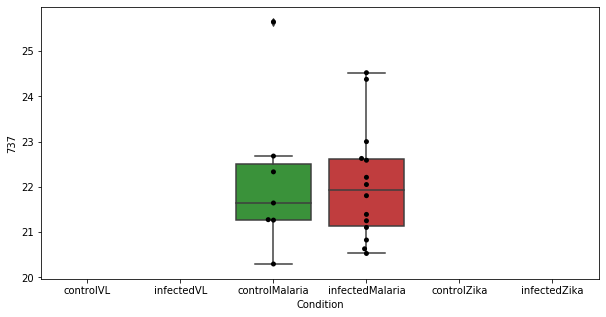

1727 row m/z                545.387
row retention time     3.43327
p-val                 0.877939
adj.P.Val             0.984203
custom_id                 2687
compound_names             NaN
Name: 2687, dtype: object


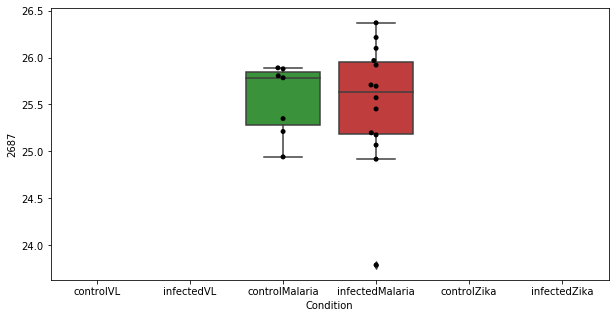

1728 row m/z                757.556
row retention time     3.53402
p-val                 0.878063
adj.P.Val             0.984203
custom_id                 2864
compound_names             NaN
Name: 2864, dtype: object


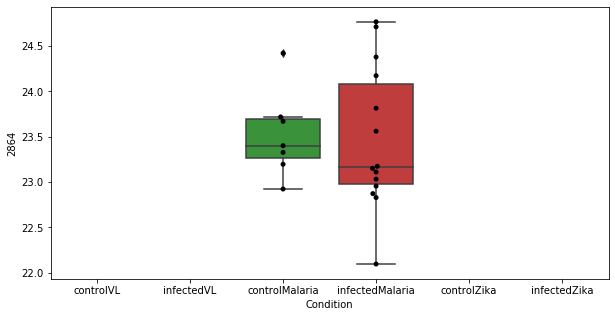

1729 row m/z                                                         180.066
row retention time                                              4.67979
p-val                                                          0.878693
adj.P.Val                                                      0.984203
custom_id                                                          1173
compound_names        Hippurate; Hippuric acid; N-Benzoylglycine; Be...
Name: 1173, dtype: object


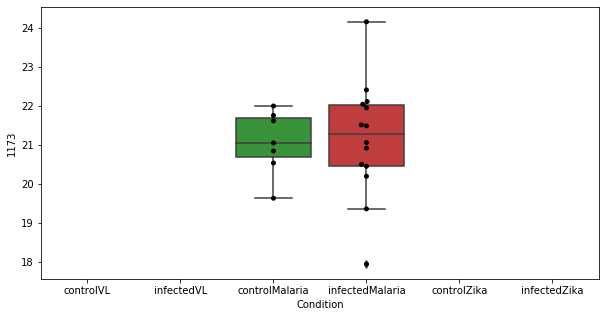

1730 row m/z                237.148
row retention time     3.80543
p-val                 0.879148
adj.P.Val             0.984203
custom_id                 3788
compound_names             NaN
Name: 3788, dtype: object


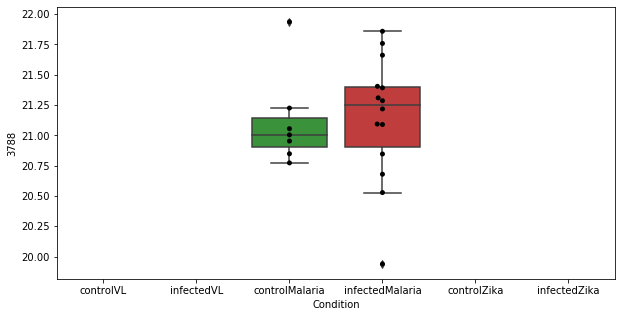

1731 row m/z                     185.117
row retention time          3.93183
p-val                      0.879483
adj.P.Val                  0.984203
custom_id                      1245
compound_names        Perillic acid
Name: 1245, dtype: object


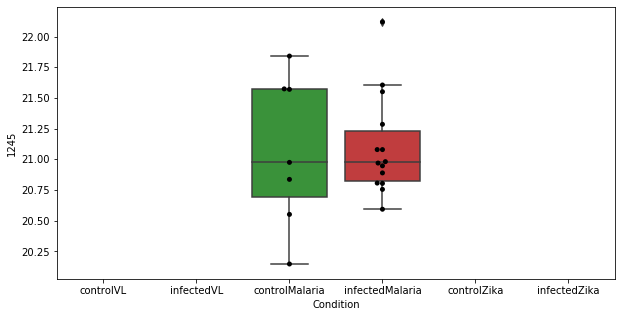

1732 row m/z                212.149
row retention time     4.59472
p-val                 0.879775
adj.P.Val             0.984203
custom_id                 1549
compound_names             NaN
Name: 1549, dtype: object


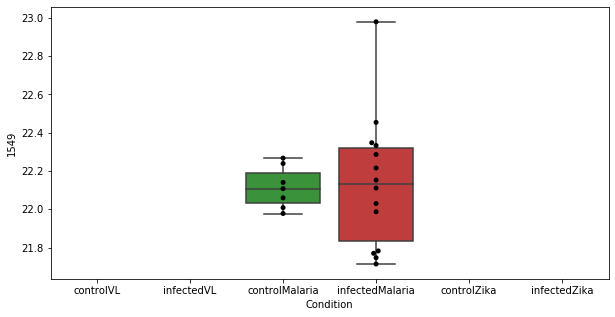

1733 row m/z                585.358
row retention time     3.27002
p-val                 0.879779
adj.P.Val             0.984203
custom_id                 2737
compound_names             NaN
Name: 2737, dtype: object


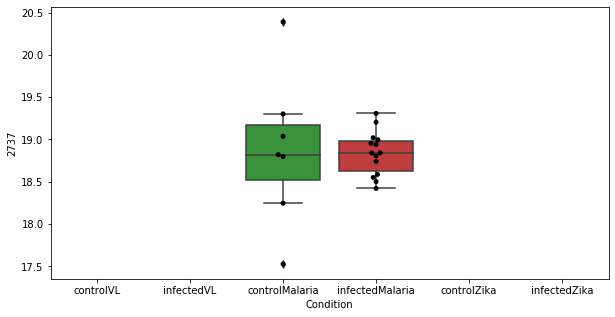

1734 row m/z                         112.051
row retention time              23.7216
p-val                          0.880226
adj.P.Val                      0.984203
custom_id                           243
compound_names        Cytosine (in DNA)
Name: 243, dtype: object


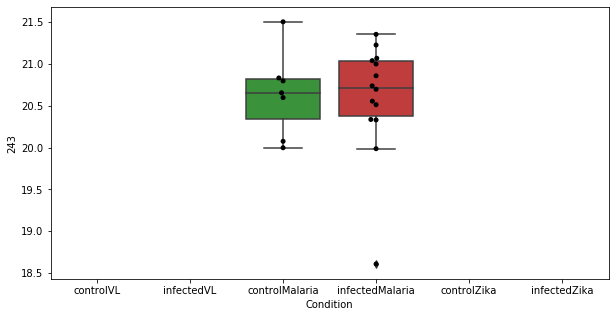

1735 row m/z                570.388
row retention time     4.72554
p-val                 0.882603
adj.P.Val             0.984203
custom_id                 2723
compound_names             NaN
Name: 2723, dtype: object


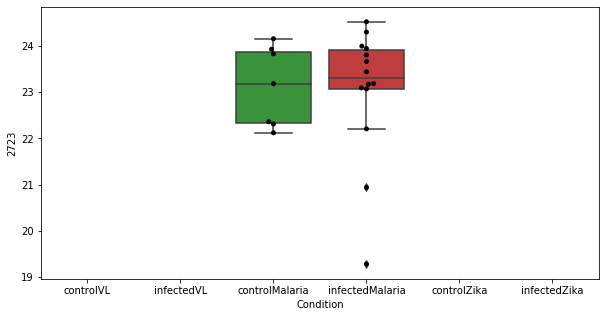

1736 row m/z                542.323
row retention time     4.04851
p-val                 0.882933
adj.P.Val             0.984203
custom_id                 2681
compound_names             NaN
Name: 2681, dtype: object


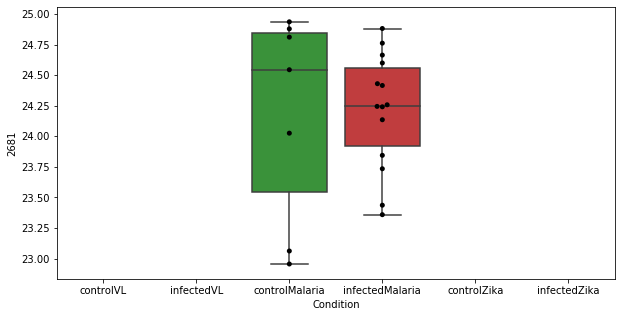

1737 row m/z                                                         130.086
row retention time                                              9.82806
p-val                                                          0.883038
adj.P.Val                                                      0.984203
custom_id                                                           517
compound_names        N4-Acetylaminobutanal$L-Pipecolate; Pipecolini...
Name: 517, dtype: object


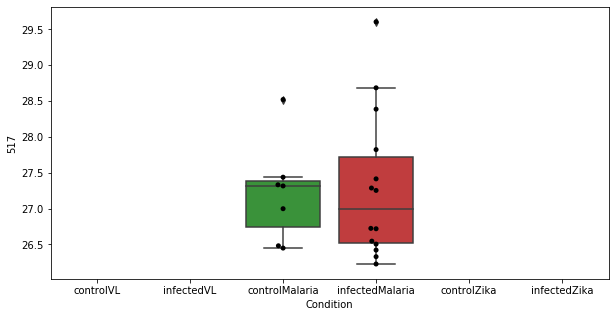

1738 row m/z                                                         157.086
row retention time                                              4.53925
p-val                                                          0.883164
adj.P.Val                                                      0.984203
custom_id                                                           879
compound_names        Choline phosphate; Phosphorylcholine; Phosphoc...
Name: 879, dtype: object


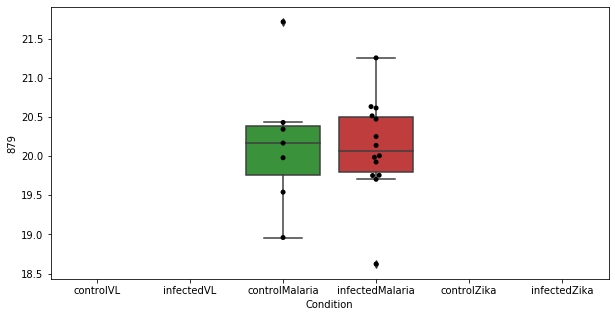

1739 row m/z                106.086
row retention time     9.81987
p-val                 0.883378
adj.P.Val             0.984203
custom_id                  205
compound_names             NaN
Name: 205, dtype: object


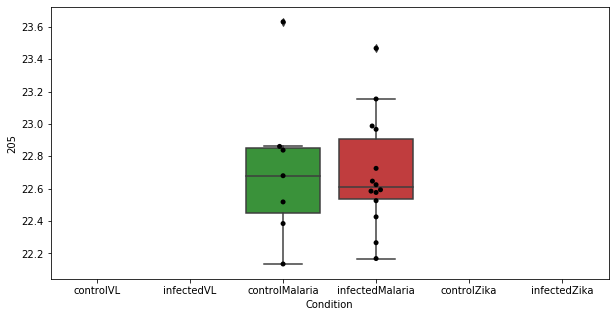

1740 row m/z                 210.17
row retention time     4.38251
p-val                 0.883911
adj.P.Val             0.984203
custom_id                 1524
compound_names             NaN
Name: 1524, dtype: object


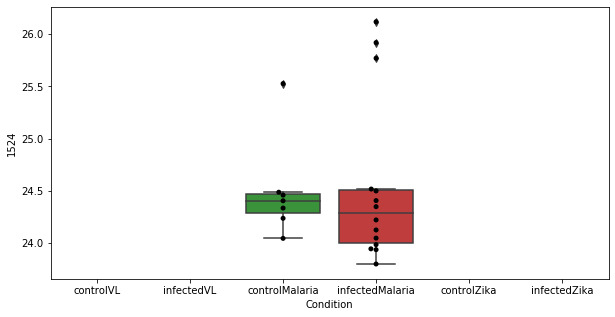

1741 row m/z                586.504
row retention time       3.265
p-val                 0.884477
adj.P.Val             0.984203
custom_id                 4236
compound_names             NaN
Name: 4236, dtype: object


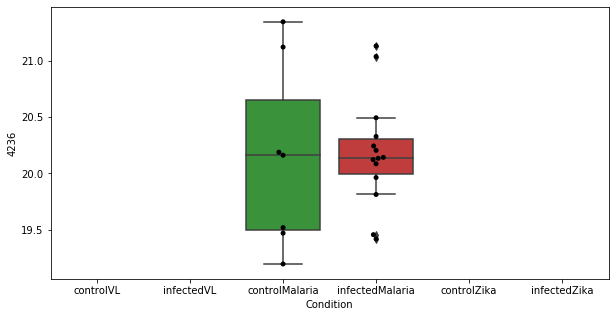

1742 row m/z                232.191
row retention time     3.86997
p-val                 0.884991
adj.P.Val             0.984203
custom_id                 1742
compound_names             NaN
Name: 1742, dtype: object


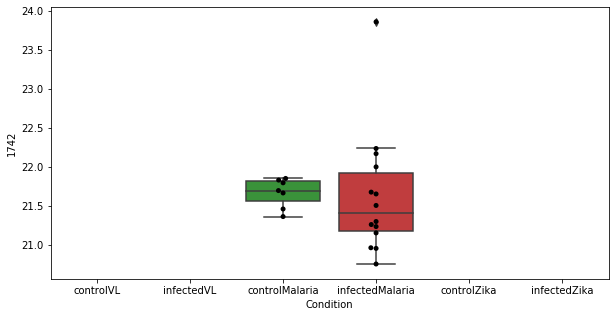

1743 row m/z                196.885
row retention time     23.5765
p-val                 0.885557
adj.P.Val             0.984203
custom_id                 1404
compound_names             NaN
Name: 1404, dtype: object


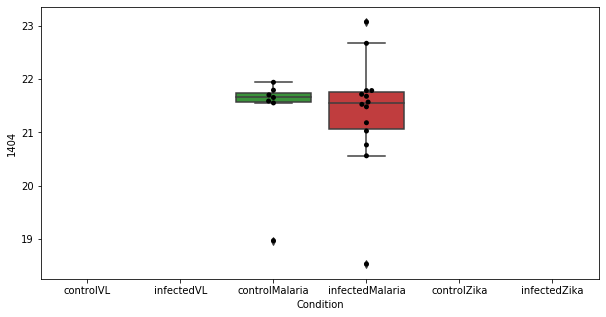

1744 row m/z                                        194.118
row retention time                             23.6495
p-val                                         0.885795
adj.P.Val                                     0.984203
custom_id                                         1370
compound_names        (-)-Salsoline$N-methylsalsolinol
Name: 1370, dtype: object


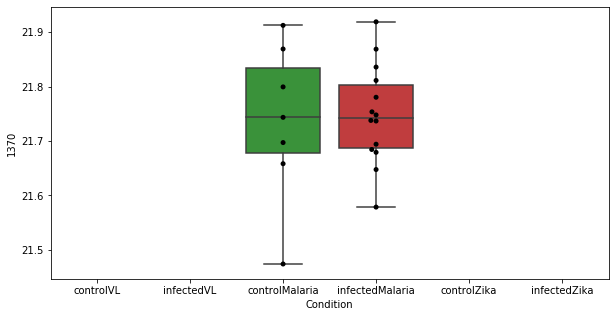

1745 row m/z                 246.17
row retention time     7.19161
p-val                 0.886749
adj.P.Val             0.984203
custom_id                 1881
compound_names             NaN
Name: 1881, dtype: object


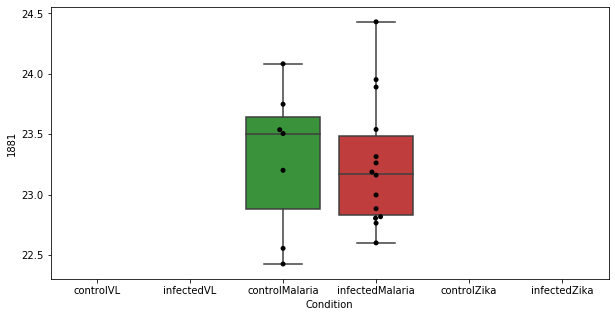

1746 row m/z                                                         257.175
row retention time                                              3.83737
p-val                                                          0.887726
adj.P.Val                                                      0.984203
custom_id                                                          1967
compound_names        3(S),6(S)-dihydroxy-tetradec-8Z-enoate$3(S),6(...
Name: 1967, dtype: object


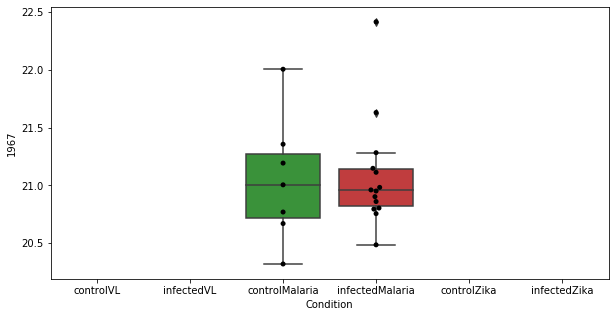

1747 row m/z                 105.07
row retention time     12.9245
p-val                 0.887864
adj.P.Val             0.984203
custom_id                  177
compound_names             NaN
Name: 177, dtype: object


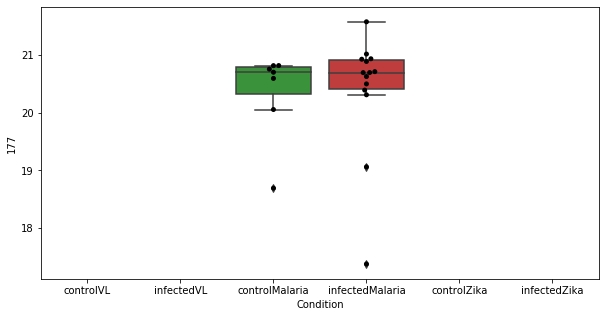

1748 row m/z                                                         148.097
row retention time                                              9.38751
p-val                                                          0.888949
adj.P.Val                                                      0.984203
custom_id                                                           782
compound_names        N4-Acetylaminobutanal$L-Pipecolate; Pipecolini...
Name: 782, dtype: object


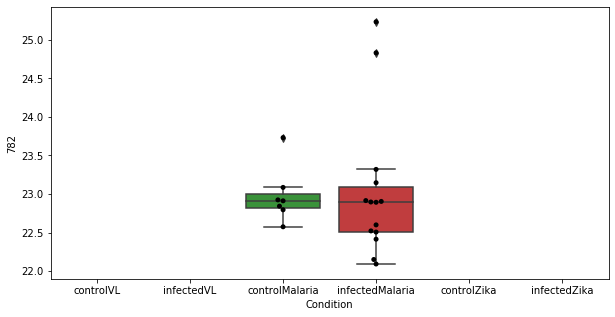

1749 row m/z                193.144
row retention time     4.37963
p-val                 0.889774
adj.P.Val             0.984203
custom_id                 1351
compound_names             NaN
Name: 1351, dtype: object


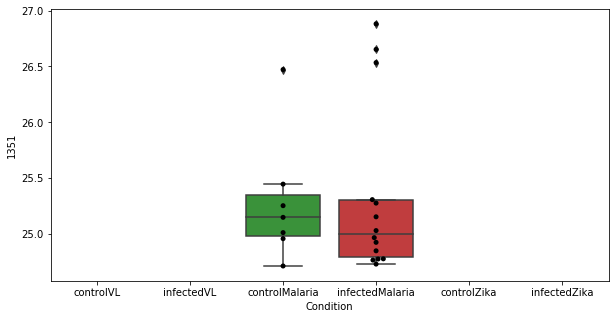

1750 row m/z                129.127
row retention time     4.54207
p-val                 0.889904
adj.P.Val             0.984203
custom_id                  503
compound_names             NaN
Name: 503, dtype: object


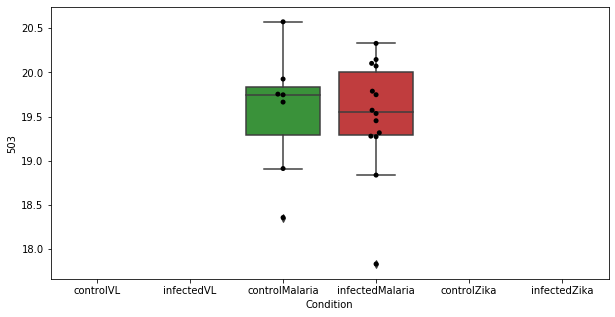

1751 row m/z                 120.94
row retention time     12.5593
p-val                  0.89082
adj.P.Val             0.984203
custom_id                  384
compound_names             NaN
Name: 384, dtype: object


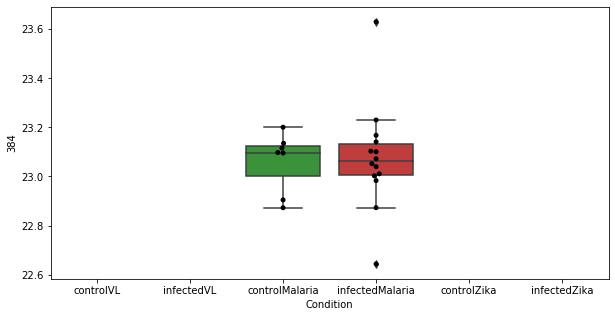

1752 row m/z                133.074
row retention time     12.1356
p-val                 0.891605
adj.P.Val             0.984203
custom_id                  572
compound_names             NaN
Name: 572, dtype: object


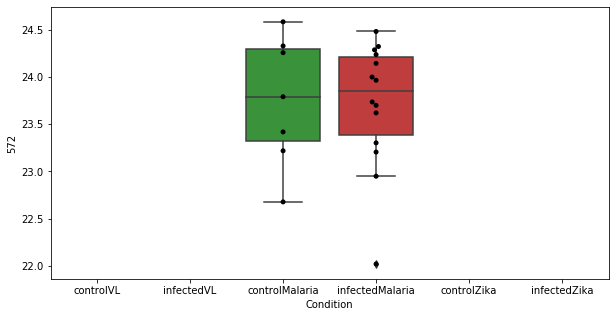

1753 row m/z                239.139
row retention time     3.15654
p-val                 0.891723
adj.P.Val             0.984203
custom_id                 1819
compound_names             NaN
Name: 1819, dtype: object


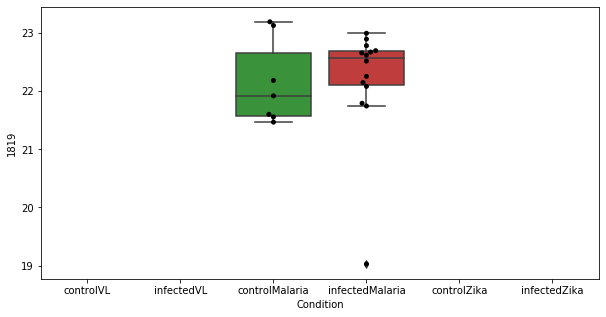

1754 row m/z                                                         126.022
row retention time                                              12.7736
p-val                                                           0.89234
adj.P.Val                                                      0.984203
custom_id                                                           447
compound_names        Taurine; 2-Aminoethanesulfonic acid; Aminoethy...
Name: 447, dtype: object


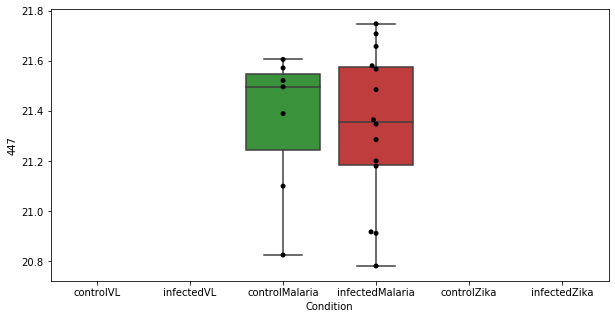

1755 row m/z                213.149
row retention time     3.81911
p-val                 0.892431
adj.P.Val             0.984203
custom_id                 1574
compound_names             NaN
Name: 1574, dtype: object


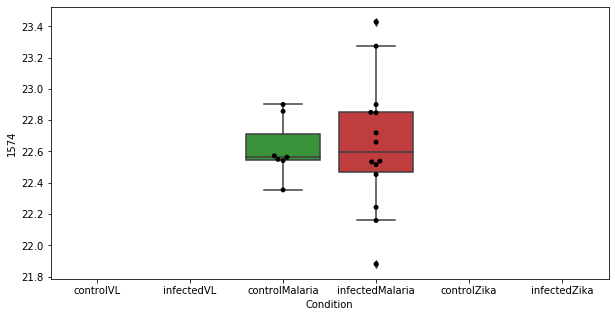

1756 row m/z                                138.043
row retention time                     9.43169
p-val                                 0.893528
adj.P.Val                             0.984203
custom_id                                 3296
compound_names        Urocanate; Urocanic acid
Name: 3296, dtype: object


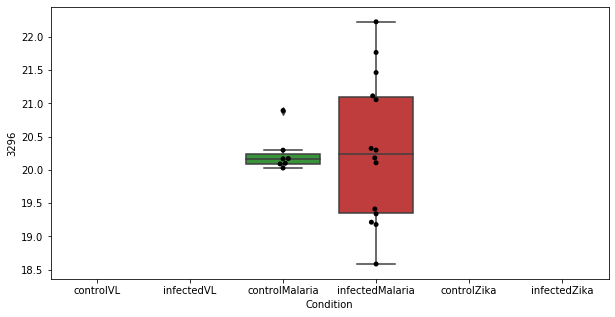

1757 row m/z                386.151
row retention time      3.6254
p-val                 0.893718
adj.P.Val             0.984203
custom_id                 2491
compound_names             NaN
Name: 2491, dtype: object


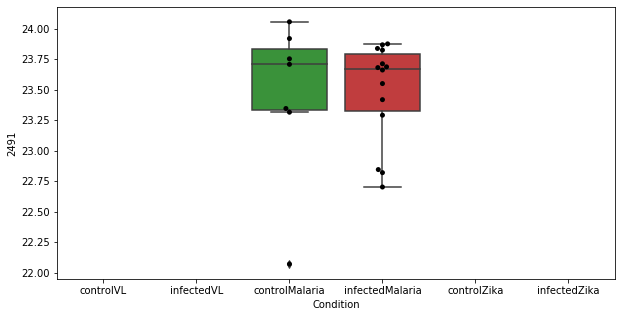

1758 row m/z                296.918
row retention time     11.9556
p-val                 0.893812
adj.P.Val             0.984203
custom_id                 2234
compound_names             NaN
Name: 2234, dtype: object


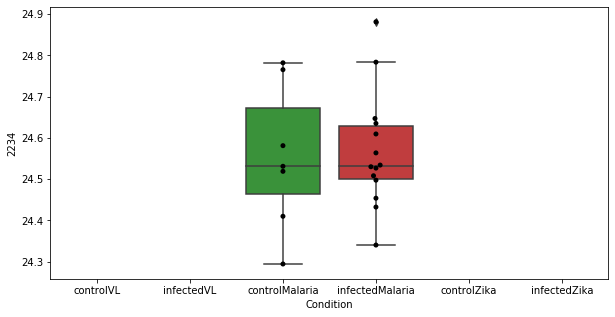

1759 row m/z                287.221
row retention time     3.61128
p-val                 0.893906
adj.P.Val             0.984203
custom_id                 2187
compound_names             NaN
Name: 2187, dtype: object


1760 row m/z                136.087
row retention time     8.36371
p-val                 0.894234
adj.P.Val             0.984203
custom_id                  604
compound_names             NaN
Name: 604, dtype: object


1761 row m/z                      216.123
row retention time           4.49341
p-val                       0.895044
adj.P.Val                   0.984203
custom_id                       1601
compound_names        L-Metanephrine
Name: 1601, dtype: object


1762 row m/z                 760.64
row retention time     3.68233
p-val                  0.89521
adj.P.Val             0.984203
custom_id                 2871
compound_names             NaN
Name: 2871, dtype: object


1763 row m/z                164.136
row retention time     4.06125
p-val                 0.895511
adj.P.Val             0.984203
custom_id                  980
compound_names             NaN
Name: 980, dtype: object


1764 row m/z                225.149
row retention time     3.86188
p-val                 0.895621
adj.P.Val             0.984203
custom_id                 1665
compound_names             NaN
Name: 1665, dtype: object


1765 row m/z                                                         181.072
row retention time                                              6.99323
p-val                                                          0.896181
adj.P.Val                                                      0.984203
custom_id                                                          1202
compound_names        1,7-Dimethylxanthine; Paraxanthine$adrenochrom...
Name: 1202, dtype: object


1766 row m/z                286.201
row retention time     4.58976
p-val                 0.896615
adj.P.Val             0.984203
custom_id                 2177
compound_names             NaN
Name: 2177, dtype: object


1767 row m/z                  380.9
row retention time     11.9345
p-val                 0.897258
adj.P.Val             0.984203
custom_id                 2479
compound_names             NaN
Name: 2479, dtype: object


1768 row m/z                238.128
row retention time     5.08087
p-val                 0.897769
adj.P.Val             0.984203
custom_id                 4995
compound_names             NaN
Name: 4995, dtype: object


1769 row m/z                675.543
row retention time     3.80209
p-val                 0.898468
adj.P.Val             0.984203
custom_id                 2801
compound_names             NaN
Name: 2801, dtype: object


1770 row m/z                367.332
row retention time     23.3416
p-val                 0.899439
adj.P.Val             0.984203
custom_id                 2449
compound_names             NaN
Name: 2449, dtype: object


1771 row m/z                                                         132.066
row retention time                                              12.0137
p-val                                                          0.900015
adj.P.Val                                                      0.984203
custom_id                                                           546
compound_names        5-Aminolevulinate; 5-Amino-4-oxopentanoate; 5-...
Name: 546, dtype: object


1772 row m/z                                                         218.139
row retention time                                              4.48393
p-val                                                          0.900334
adj.P.Val                                                      0.984203
custom_id                                                          1629
compound_names        Ecgonine methyl ester; Methyl ecgonine$ecgonin...
Name: 1629, dtype: object


1773 row m/z                314.232
row retention time     4.56808
p-val                 0.900506
adj.P.Val             0.984203
custom_id                 2313
compound_names             NaN
Name: 2313, dtype: object


1774 row m/z                                                         171.076
row retention time                                              7.00381
p-val                                                          0.901091
adj.P.Val                                                      0.984203
custom_id                                                          1075
compound_names        N1-Methyl-2-pyridone-5-carboxamide; N'-Methyl-...
Name: 1075, dtype: object


1775 row m/z                                                          133.08
row retention time                                              12.1337
p-val                                                          0.901693
adj.P.Val                                                      0.984203
custom_id                                                           573
compound_names        Creatine; alpha-Methylguanidino acetic acid; M...
Name: 573, dtype: object


1776 row m/z                118.075
row retention time     10.9748
p-val                 0.902989
adj.P.Val             0.984203
custom_id                  347
compound_names             NaN
Name: 347, dtype: object


1777 row m/z                130.159
row retention time      10.235
p-val                 0.903222
adj.P.Val             0.984203
custom_id                  526
compound_names             NaN
Name: 526, dtype: object


1778 row m/z                227.139
row retention time      9.6603
p-val                   0.9042
adj.P.Val             0.984203
custom_id                 3746
compound_names             NaN
Name: 3746, dtype: object


1779 row m/z                322.847
row retention time     23.7694
p-val                 0.905188
adj.P.Val             0.984203
custom_id                 2345
compound_names             NaN
Name: 2345, dtype: object


1780 row m/z                213.123
row retention time     9.61492
p-val                 0.905206
adj.P.Val             0.984203
custom_id                 1569
compound_names             NaN
Name: 1569, dtype: object


1781 row m/z                                                  183.078
row retention time                                       3.86969
p-val                                                   0.905646
adj.P.Val                                               0.984203
custom_id                                                   1213
compound_names        Octanoic acid; Caprylic acid; Octylic acid
Name: 1213, dtype: object


1782 row m/z                816.701
row retention time     6.66656
p-val                 0.905768
adj.P.Val             0.984203
custom_id                 4301
compound_names             NaN
Name: 4301, dtype: object


1783 row m/z                327.158
row retention time     10.9659
p-val                 0.907463
adj.P.Val             0.984203
custom_id                 2365
compound_names             NaN
Name: 2365, dtype: object


1784 row m/z                       102.091
row retention time            11.0778
p-val                        0.907963
adj.P.Val                    0.984203
custom_id                        4408
compound_names        5-Aminopentanal
Name: 4408, dtype: object


1785 row m/z                250.051
row retention time     9.80483
p-val                 0.908559
adj.P.Val             0.984203
custom_id                 1897
compound_names             NaN
Name: 1897, dtype: object


1786 row m/z                                                  163.133
row retention time                                        4.0555
p-val                                                   0.909109
adj.P.Val                                               0.984203
custom_id                                                    971
compound_names        Octanoic acid; Caprylic acid; Octylic acid
Name: 971, dtype: object


1787 row m/z                                                         152.071
row retention time                                               6.9943
p-val                                                          0.910574
adj.P.Val                                                      0.984203
custom_id                                                           837
compound_names        L-Noradrenaline; Noradrenaline; Norepinephrine...
Name: 837, dtype: object


1788 row m/z                161.137
row retention time     11.0389
p-val                  0.91143
adj.P.Val             0.984203
custom_id                  942
compound_names             NaN
Name: 942, dtype: object


1789 row m/z                89.0709
row retention time     6.99928
p-val                 0.912291
adj.P.Val             0.984203
custom_id                   80
compound_names             NaN
Name: 80, dtype: object


1790 row m/z                207.113
row retention time     9.14111
p-val                 0.912351
adj.P.Val             0.984203
custom_id                 1488
compound_names             NaN
Name: 1488, dtype: object


1791 row m/z                122.006
row retention time     5.35515
p-val                 0.912794
adj.P.Val             0.984203
custom_id                  392
compound_names             NaN
Name: 392, dtype: object


1792 row m/z                334.186
row retention time     3.79463
p-val                 0.913346
adj.P.Val             0.984203
custom_id                 2391
compound_names             NaN
Name: 2391, dtype: object


1793 row m/z                          189.123
row retention time               10.7598
p-val                           0.913442
adj.P.Val                       0.984203
custom_id                           1298
compound_names        N6-Acetyl-L-lysine
Name: 1298, dtype: object


1794 row m/z                79.9897
row retention time     15.1667
p-val                 0.913989
adj.P.Val             0.984203
custom_id                   29
compound_names             NaN
Name: 29, dtype: object


1795 row m/z                                              213
row retention time                               11.2924
p-val                                           0.914373
adj.P.Val                                       0.984203
custom_id                                           1554
compound_names        Oxalosuccinate; Oxalosuccinic acid
Name: 1554, dtype: object


1796 row m/z                262.144
row retention time     6.95597
p-val                 0.914516
adj.P.Val             0.984203
custom_id                 1991
compound_names             NaN
Name: 1991, dtype: object


1797 row m/z                132.117
row retention time     12.1314
p-val                 0.914563
adj.P.Val             0.984203
custom_id                  559
compound_names             NaN
Name: 559, dtype: object


1798 row m/z                312.165
row retention time     3.73906
p-val                 0.914917
adj.P.Val             0.984203
custom_id                 2295
compound_names             NaN
Name: 2295, dtype: object


1799 row m/z                                                         129.066
row retention time                                              7.00157
p-val                                                          0.915261
adj.P.Val                                                      0.984203
custom_id                                                           491
compound_names        5,6-Dihydrothymine; Dihydrothymine; 5,6-Dihydr...
Name: 491, dtype: object


1800 row m/z                261.121
row retention time     12.5041
p-val                 0.916115
adj.P.Val             0.984203
custom_id                 1987
compound_names             NaN
Name: 1987, dtype: object


1801 row m/z                                                          148.08
row retention time                                              12.3135
p-val                                                          0.917024
adj.P.Val                                                      0.984203
custom_id                                                           781
compound_names        D-Glutamine; D-2-Aminoglutaramic acid$L-Glutam...
Name: 781, dtype: object


1802 row m/z                131.082
row retention time     12.2562
p-val                 0.917388
adj.P.Val             0.984203
custom_id                  530
compound_names             NaN
Name: 530, dtype: object


1803 row m/z                655.801
row retention time     9.02083
p-val                 0.917502
adj.P.Val             0.984203
custom_id                 2791
compound_names             NaN
Name: 2791, dtype: object


1804 row m/z                132.037
row retention time     12.1372
p-val                 0.918182
adj.P.Val             0.984203
custom_id                  542
compound_names             NaN
Name: 542, dtype: object


1805 row m/z                214.099
row retention time     9.70304
p-val                 0.918654
adj.P.Val             0.984203
custom_id                 1578
compound_names             NaN
Name: 1578, dtype: object


1806 row m/z                260.185
row retention time     7.00443
p-val                 0.918703
adj.P.Val             0.984203
custom_id                 1979
compound_names             NaN
Name: 1979, dtype: object


1807 row m/z                116.038
row retention time     10.9705
p-val                 0.919167
adj.P.Val             0.984203
custom_id                  319
compound_names             NaN
Name: 319, dtype: object


1808 row m/z                                                         132.066
row retention time                                              8.63371
p-val                                                          0.919475
adj.P.Val                                                      0.984203
custom_id                                                           547
compound_names        5-Aminolevulinate; 5-Amino-4-oxopentanoate; 5-...
Name: 547, dtype: object


1809 row m/z                                      76.0393
row retention time                           12.8224
p-val                                       0.919708
adj.P.Val                                   0.984203
custom_id                                         13
compound_names        Glycine; Aminoacetic acid; Gly
Name: 13, dtype: object


1810 row m/z                160.133
row retention time      11.037
p-val                 0.920041
adj.P.Val             0.984203
custom_id                  929
compound_names             NaN
Name: 929, dtype: object


1811 row m/z                                                       148.116
row retention time                                            17.7812
p-val                                                        0.920941
adj.P.Val                                                    0.984203
custom_id                                                         793
compound_names        L-Lysine; Lysine acid; 2,6-Diaminohexanoic acid
Name: 793, dtype: object


1812 row m/z                312.326
row retention time     3.60996
p-val                 0.921113
adj.P.Val             0.984203
custom_id                 2299
compound_names             NaN
Name: 2299, dtype: object


1813 row m/z                221.017
row retention time     10.9793
p-val                 0.921721
adj.P.Val             0.984203
custom_id                 1642
compound_names             NaN
Name: 1642, dtype: object


1814 row m/z                                                         117.074
row retention time                                              10.9736
p-val                                                          0.921834
adj.P.Val                                                      0.984203
custom_id                                                           327
compound_names        D-Proline$L-Proline; 2-Pyrrolidinecarboxylic a...
Name: 327, dtype: object


1815 row m/z                423.183
row retention time     9.73157
p-val                 0.921979
adj.P.Val             0.984203
custom_id                 2556
compound_names             NaN
Name: 2556, dtype: object


1816 row m/z                                                         116.071
row retention time                                              10.9725
p-val                                                          0.922125
adj.P.Val                                                      0.984203
custom_id                                                           320
compound_names        D-Proline$L-Proline; 2-Pyrrolidinecarboxylic a...
Name: 320, dtype: object


1817 row m/z                632.847
row retention time     11.9511
p-val                 0.922436
adj.P.Val             0.984203
custom_id                 2772
compound_names             NaN
Name: 2772, dtype: object


1818 row m/z                180.896
row retention time     12.4949
p-val                 0.922457
adj.P.Val             0.984203
custom_id                 1196
compound_names             NaN
Name: 1196, dtype: object


1819 row m/z                                                         209.092
row retention time                                              9.64416
p-val                                                          0.922729
adj.P.Val                                                      0.984203
custom_id                                                          1512
compound_names        L-Kynurenine; 3-Anthraniloyl-L-alanine$Formyl-...
Name: 1512, dtype: object


1820 row m/z                785.588
row retention time     3.51724
p-val                 0.923178
adj.P.Val             0.984203
custom_id                 2907
compound_names             NaN
Name: 2907, dtype: object


1821 row m/z                305.252
row retention time     3.62212
p-val                 0.923563
adj.P.Val             0.984203
custom_id                 2269
compound_names             NaN
Name: 2269, dtype: object


1822 row m/z                316.176
row retention time     3.76207
p-val                 0.924275
adj.P.Val             0.984203
custom_id                 2322
compound_names             NaN
Name: 2322, dtype: object


1823 row m/z                579.412
row retention time     3.39763
p-val                 0.924734
adj.P.Val             0.984203
custom_id                 2730
compound_names             NaN
Name: 2730, dtype: object


1824 row m/z                           288.217
row retention time                4.58317
p-val                            0.925428
adj.P.Val                        0.984203
custom_id                            2195
compound_names        L-Octanoylcarnitine
Name: 2195, dtype: object


1825 row m/z                202.922
row retention time     5.41274
p-val                 0.926585
adj.P.Val             0.984203
custom_id                 1459
compound_names             NaN
Name: 1459, dtype: object


1826 row m/z                     731.605
row retention time          3.70953
p-val                      0.926726
adj.P.Val                  0.984203
custom_id                      2842
compound_names        Sphingomyelin
Name: 2842, dtype: object


1827 row m/z                252.144
row retention time      6.9945
p-val                 0.927091
adj.P.Val             0.984203
custom_id                 1929
compound_names             NaN
Name: 1929, dtype: object


1828 row m/z                111.092
row retention time     7.03179
p-val                 0.927514
adj.P.Val             0.984203
custom_id                  235
compound_names             NaN
Name: 235, dtype: object


1829 row m/z                215.164
row retention time     22.3604
p-val                 0.927759
adj.P.Val             0.984203
custom_id                 4936
compound_names             NaN
Name: 4936, dtype: object


1830 row m/z                288.225
row retention time     3.63947
p-val                 0.928114
adj.P.Val             0.984203
custom_id                 2196
compound_names             NaN
Name: 2196, dtype: object


1831 row m/z                526.265
row retention time     4.37543
p-val                 0.929051
adj.P.Val             0.984203
custom_id                 2652
compound_names             NaN
Name: 2652, dtype: object


1832 row m/z                122.937
row retention time     12.5294
p-val                 0.929147
adj.P.Val             0.984203
custom_id                  411
compound_names             NaN
Name: 411, dtype: object


1833 row m/z                163.001
row retention time     12.4987
p-val                 0.929518
adj.P.Val             0.984203
custom_id                  961
compound_names             NaN
Name: 961, dtype: object


1834 row m/z                 328.16
row retention time     13.9081
p-val                 0.930235
adj.P.Val             0.984203
custom_id                 2371
compound_names             NaN
Name: 2371, dtype: object


1835 row m/z                             142.086
row retention time                  9.34806
p-val                              0.931387
adj.P.Val                          0.984203
custom_id                               667
compound_names        5-Acetamidopentanoate
Name: 667, dtype: object


1836 row m/z                166.064
row retention time     4.76123
p-val                 0.931476
adj.P.Val             0.984203
custom_id                 4724
compound_names             NaN
Name: 4724, dtype: object


1837 row m/z                414.233
row retention time     3.94204
p-val                 0.931595
adj.P.Val             0.984203
custom_id                 2548
compound_names             NaN
Name: 2548, dtype: object


1838 row m/z                147.977
row retention time     9.55945
p-val                  0.93173
adj.P.Val             0.984203
custom_id                  766
compound_names             NaN
Name: 766, dtype: object


1839 row m/z                503.377
row retention time     3.45593
p-val                 0.932977
adj.P.Val             0.984203
custom_id                 2630
compound_names             NaN
Name: 2630, dtype: object


1840 row m/z                183.073
row retention time     10.1235
p-val                 0.933452
adj.P.Val             0.984203
custom_id                 4799
compound_names             NaN
Name: 4799, dtype: object


1841 row m/z                195.138
row retention time     3.80998
p-val                 0.933635
adj.P.Val             0.984203
custom_id                 1393
compound_names             NaN
Name: 1393, dtype: object


1842 row m/z                344.279
row retention time      4.3521
p-val                 0.934249
adj.P.Val             0.984203
custom_id                 4116
compound_names             NaN
Name: 4116, dtype: object


1843 row m/z                210.085
row retention time     12.3192
p-val                  0.93465
adj.P.Val             0.984203
custom_id                 1520
compound_names             NaN
Name: 1520, dtype: object


1844 row m/z                                                         280.165
row retention time                                              4.56954
p-val                                                          0.934883
adj.P.Val                                                      0.984203
custom_id                                                          2140
compound_names        3(S),6(S)-dihydroxy-tetradec-8Z-enoate$3(S),6(...
Name: 2140, dtype: object


1845 row m/z                                                         198.113
row retention time                                              6.99745
p-val                                                          0.935203
adj.P.Val                                                      0.984203
custom_id                                                          1417
compound_names        (-)-Salsolinol; 6,7-Isoquinolinediol, 1,2,3,4-...
Name: 1417, dtype: object


1846 row m/z                223.154
row retention time     4.41501
p-val                 0.935371
adj.P.Val             0.984203
custom_id                 3734
compound_names             NaN
Name: 3734, dtype: object


1847 row m/z                158.154
row retention time       3.876
p-val                 0.935442
adj.P.Val             0.984203
custom_id                  906
compound_names             NaN
Name: 906, dtype: object


1848 row m/z                                                         222.099
row retention time                                              6.99884
p-val                                                          0.935568
adj.P.Val                                                      0.984203
custom_id                                                          3726
compound_names        Dihydrobiopterin; 6,7-Dihydrobiopterin; Quinoi...
Name: 3726, dtype: object


1849 row m/z                663.453
row retention time     3.35556
p-val                 0.935875
adj.P.Val             0.984203
custom_id                 2798
compound_names             NaN
Name: 2798, dtype: object


1850 row m/z                 105.11
row retention time     4.34683
p-val                 0.936214
adj.P.Val             0.984203
custom_id                  192
compound_names             NaN
Name: 192, dtype: object


1851 row m/z                769.592
row retention time     3.49971
p-val                 0.936836
adj.P.Val             0.984203
custom_id                 2878
compound_names             NaN
Name: 2878, dtype: object


1852 row m/z                743.576
row retention time     3.51175
p-val                 0.937133
adj.P.Val             0.984203
custom_id                 2850
compound_names             NaN
Name: 2850, dtype: object


1853 row m/z                97.0397
row retention time     23.8849
p-val                 0.937261
adj.P.Val             0.984203
custom_id                  104
compound_names             NaN
Name: 104, dtype: object


1854 row m/z                219.899
row retention time     23.7454
p-val                 0.937499
adj.P.Val             0.984203
custom_id                 1637
compound_names             NaN
Name: 1637, dtype: object


1855 row m/z                882.604
row retention time     3.28313
p-val                 0.937521
adj.P.Val             0.984203
custom_id                 4304
compound_names             NaN
Name: 4304, dtype: object


1856 row m/z                292.876
row retention time     12.6173
p-val                 0.938222
adj.P.Val             0.984203
custom_id                 2221
compound_names             NaN
Name: 2221, dtype: object


1857 row m/z                                                         149.081
row retention time                                              12.3152
p-val                                                           0.93825
adj.P.Val                                                      0.984203
custom_id                                                           800
compound_names        (R)-Mevalonate; Mevalonic acid; 3,5-Dihydroxy-...
Name: 800, dtype: object


1858 row m/z                                                           287.1
row retention time                                               4.5894
p-val                                                          0.939812
adj.P.Val                                                      0.984923
custom_id                                                          2183
compound_names        Formyl-N-acetyl-5-methoxykynurenamine$alpha-N-...
Name: 2183, dtype: object


1859 row m/z                                                         147.076
row retention time                                              12.3155
p-val                                                          0.940083
adj.P.Val                                                      0.984923
custom_id                                                           757
compound_names        D-Glutamine; D-2-Aminoglutaramic acid$L-Glutam...
Name: 757, dtype: object


1860 row m/z                682.486
row retention time     3.36782
p-val                 0.941547
adj.P.Val             0.984923
custom_id                 2813
compound_names             NaN
Name: 2813, dtype: object


1861 row m/z                701.558
row retention time     3.75296
p-val                 0.942285
adj.P.Val             0.984923
custom_id                 2821
compound_names             NaN
Name: 2821, dtype: object


1862 row m/z                204.123
row retention time     9.57543
p-val                 0.943199
adj.P.Val             0.984923
custom_id                 1469
compound_names             NaN
Name: 1469, dtype: object


1863 row m/z                117.068
row retention time     10.9808
p-val                 0.943349
adj.P.Val             0.984923
custom_id                  325
compound_names             NaN
Name: 325, dtype: object


1864 row m/z                256.059
row retention time      9.8871
p-val                 0.943562
adj.P.Val             0.984923
custom_id                 1950
compound_names             NaN
Name: 1950, dtype: object


1865 row m/z                                                         126.091
row retention time                                              4.58227
p-val                                                          0.943845
adj.P.Val                                                      0.984923
custom_id                                                          3214
compound_names        Dopamine; 4-(2-Aminoethyl)-1,2-benzenediol; 4-...
Name: 3214, dtype: object


1866 row m/z                179.933
row retention time     12.4824
p-val                 0.944662
adj.P.Val             0.984923
custom_id                 1169
compound_names             NaN
Name: 1169, dtype: object


1867 row m/z                 264.18
row retention time     3.73253
p-val                 0.944926
adj.P.Val             0.984923
custom_id                 1997
compound_names             NaN
Name: 1997, dtype: object


1868 row m/z                                                          118.05
row retention time                                              9.45906
p-val                                                          0.945646
adj.P.Val                                                      0.984923
custom_id                                                           342
compound_names        2-Amino-3-oxobutanoate; 2-Amino-acetoacetate$L...
Name: 342, dtype: object


1869 row m/z                445.165
row retention time     9.90144
p-val                 0.945765
adj.P.Val             0.984923
custom_id                 2576
compound_names             NaN
Name: 2576, dtype: object


1870 row m/z                250.051
row retention time     8.49608
p-val                 0.945834
adj.P.Val             0.984923
custom_id                 1900
compound_names             NaN
Name: 1900, dtype: object


1871 row m/z                                                         171.096
row retention time                                              10.8742
p-val                                                          0.947762
adj.P.Val                                                      0.984923
custom_id                                                          1078
compound_names        N(pi)-Methyl-L-histidine; 1-Methylhistidine; N...
Name: 1078, dtype: object


1872 row m/z                442.901
row retention time     13.0348
p-val                 0.947782
adj.P.Val             0.984923
custom_id                 2572
compound_names             NaN
Name: 2572, dtype: object


1873 row m/z                                                         198.085
row retention time                                              12.7943
p-val                                                           0.94803
adj.P.Val                                                      0.984923
custom_id                                                          1414
compound_names        L-Citrulline; 2-Amino-5-ureidovaleric acid; Ci...
Name: 1414, dtype: object


1874 row m/z                244.118
row retention time      7.0039
p-val                  0.94824
adj.P.Val             0.984923
custom_id                 3815
compound_names             NaN
Name: 3815, dtype: object


1875 row m/z                                                         91.0583
row retention time                                              12.2473
p-val                                                          0.948816
adj.P.Val                                                      0.984923
custom_id                                                            89
compound_names        Sarcosine; N-Methylglycine$D-Alanine; D-2-Amin...
Name: 89, dtype: object


1876 row m/z                194.085
row retention time     12.4728
p-val                 0.949009
adj.P.Val             0.984923
custom_id                 1367
compound_names             NaN
Name: 1367, dtype: object


1877 row m/z                                                         166.086
row retention time                                              6.99647
p-val                                                          0.949265
adj.P.Val                                                      0.984923
custom_id                                                          1003
compound_names        L-Phenylalanine; (S)-alpha-Amino-beta-phenylpr...
Name: 1003, dtype: object


1878 row m/z                615.778
row retention time     9.01644
p-val                 0.949548
adj.P.Val             0.984923
custom_id                 2761
compound_names             NaN
Name: 2761, dtype: object


1879 row m/z                134.081
row retention time     11.4067
p-val                 0.951345
adj.P.Val             0.986262
custom_id                  591
compound_names             NaN
Name: 591, dtype: object


1880 row m/z                                     223.075
row retention time                          4.30396
p-val                                      0.952502
adj.P.Val                                  0.986936
custom_id                                      1654
compound_names        Cystathionine$L-Cystathionine
Name: 1654, dtype: object


1881 row m/z                286.201
row retention time     5.18027
p-val                 0.953889
adj.P.Val             0.987092
custom_id                 2180
compound_names             NaN
Name: 2180, dtype: object


1882 row m/z                302.196
row retention time     6.99421
p-val                 0.954544
adj.P.Val             0.987092
custom_id                 4034
compound_names             NaN
Name: 4034, dtype: object


1883 row m/z                315.158
row retention time     10.5703
p-val                 0.954668
adj.P.Val             0.987092
custom_id                 2315
compound_names             NaN
Name: 2315, dtype: object


1884 row m/z                789.675
row retention time     3.65716
p-val                 0.955191
adj.P.Val             0.987092
custom_id                 4289
compound_names             NaN
Name: 4289, dtype: object


1885 row m/z                597.508
row retention time     3.26021
p-val                 0.956209
adj.P.Val             0.987092
custom_id                 4242
compound_names             NaN
Name: 4242, dtype: object


1886 row m/z                                                157.097
row retention time                                     10.9736
p-val                                                 0.956531
adj.P.Val                                             0.987092
custom_id                                                  880
compound_names        N-Acetylornithine; N2-Acetyl-L-ornithine
Name: 880, dtype: object


1887 row m/z                 237.17
row retention time     4.21912
p-val                 0.956752
adj.P.Val             0.987092
custom_id                 1791
compound_names             NaN
Name: 1791, dtype: object


1888 row m/z                254.026
row retention time     11.2828
p-val                 0.956804
adj.P.Val             0.987092
custom_id                 1945
compound_names             NaN
Name: 1945, dtype: object


1889 row m/z                                                         156.077
row retention time                                             0.401109
p-val                                                          0.957211
adj.P.Val                                                      0.987092
custom_id                                                           864
compound_names        5-Guanidino-2-oxopentanoate; 5-Guanidino-2-oxo...
Name: 864, dtype: object


1890 row m/z                212.936
row retention time      12.897
p-val                 0.957767
adj.P.Val             0.987144
custom_id                 4919
compound_names             NaN
Name: 4919, dtype: object


1891 row m/z                464.883
row retention time     11.9883
p-val                  0.95977
adj.P.Val             0.988252
custom_id                 2588
compound_names             NaN
Name: 2588, dtype: object


1892 row m/z                                                          130.05
row retention time                                              12.3194
p-val                                                          0.959857
adj.P.Val                                                      0.988252
custom_id                                                           512
compound_names        L-4-Hydroxyglutamate semialdehyde$D-Glutamate;...
Name: 512, dtype: object


1893 row m/z                526.883
row retention time     23.5477
p-val                 0.960638
adj.P.Val             0.988352
custom_id                 2658
compound_names             NaN
Name: 2658, dtype: object


1894 row m/z                165.112
row retention time     4.48891
p-val                 0.961069
adj.P.Val             0.988352
custom_id                  996
compound_names             NaN
Name: 996, dtype: object


1895 row m/z                                                         295.227
row retention time                                              3.62089
p-val                                                          0.961979
adj.P.Val                                                      0.988352
custom_id                                                          2228
compound_names        9(S)-HPODE; 9(S)-HPOD; (10E,12Z)-(9S)-9-Hydrop...
Name: 2228, dtype: object


1896 row m/z                361.971
row retention time     8.99453
p-val                 0.962133
adj.P.Val             0.988352
custom_id                 2445
compound_names             NaN
Name: 2445, dtype: object


1897 row m/z                145.105
row retention time     9.50964
p-val                  0.96249
adj.P.Val             0.988352
custom_id                  722
compound_names             NaN
Name: 722, dtype: object


1898 row m/z                415.776
row retention time     3.28998
p-val                 0.963931
adj.P.Val             0.988917
custom_id                 2552
compound_names             NaN
Name: 2552, dtype: object


1899 row m/z                129.957
row retention time     12.9274
p-val                 0.964054
adj.P.Val             0.988917
custom_id                  505
compound_names             NaN
Name: 505, dtype: object


1900 row m/z                538.163
row retention time     3.36717
p-val                 0.965448
adj.P.Val             0.989584
custom_id                 2677
compound_names             NaN
Name: 2677, dtype: object


1901 row m/z                                                         132.102
row retention time                                              6.99253
p-val                                                          0.965721
adj.P.Val                                                      0.989584
custom_id                                                           556
compound_names        L-Isoleucine; 2-Amino-3-methylvaleric acid$L-L...
Name: 556, dtype: object


1902 row m/z                442.901
row retention time     11.9586
p-val                 0.966951
adj.P.Val             0.990203
custom_id                 2571
compound_names             NaN
Name: 2571, dtype: object


1903 row m/z                187.097
row retention time     4.57192
p-val                  0.96734
adj.P.Val             0.990203
custom_id                 1268
compound_names             NaN
Name: 1268, dtype: object


1904 row m/z                                                         370.234
row retention time                                              9.66462
p-val                                                          0.968763
adj.P.Val                                                      0.990359
custom_id                                                          2457
compound_names        prostaglandin G1$$10,11-dihydro-20-dihydroxy-LTB4
Name: 2457, dtype: object


1905 row m/z                881.593
row retention time     3.27988
p-val                 0.968881
adj.P.Val             0.990359
custom_id                 2976
compound_names             NaN
Name: 2976, dtype: object


1906 row m/z                304.212
row retention time     7.00944
p-val                 0.969017
adj.P.Val             0.990359
custom_id                 2262
compound_names             NaN
Name: 2262, dtype: object


1907 row m/z                323.851
row retention time      7.1132
p-val                 0.969702
adj.P.Val              0.99054
custom_id                 2346
compound_names             NaN
Name: 2346, dtype: object


1908 row m/z               800.671
row retention time    3.59801
p-val                 0.97156
adj.P.Val             0.99157
custom_id                2930
compound_names            NaN
Name: 2930, dtype: object


1909 row m/z                378.248
row retention time     23.1702
p-val                 0.972373
adj.P.Val              0.99157
custom_id                 2468
compound_names             NaN
Name: 2468, dtype: object


1910 row m/z                                                         202.107
row retention time                                              4.58392
p-val                                                           0.97295
adj.P.Val                                                       0.99157
custom_id                                                          1447
compound_names        L-Normetanephrine$L-Adrenaline; (R)-(-)-Adrena...
Name: 1447, dtype: object


1911 row m/z                343.295
row retention time     4.35961
p-val                 0.973075
adj.P.Val              0.99157
custom_id                 2408
compound_names             NaN
Name: 2408, dtype: object


1912 row m/z                219.019
row retention time     10.9735
p-val                 0.974387
adj.P.Val              0.99157
custom_id                 1633
compound_names             NaN
Name: 1633, dtype: object


1913 row m/z                            128.107
row retention time                 23.8351
p-val                             0.974795
adj.P.Val                          0.99157
custom_id                             4532
compound_names        3-Dehydroxycarnitine
Name: 4532, dtype: object


1914 row m/z                                                         148.073
row retention time                                              12.3211
p-val                                                          0.975159
adj.P.Val                                                       0.99157
custom_id                                                           780
compound_names        (R)-Mevalonate; Mevalonic acid; 3,5-Dihydroxy-...
Name: 780, dtype: object


1915 row m/z                246.243
row retention time     6.95897
p-val                 0.975952
adj.P.Val              0.99157
custom_id                 1884
compound_names             NaN
Name: 1884, dtype: object


1916 row m/z                139.112
row retention time     4.40393
p-val                 0.976226
adj.P.Val              0.99157
custom_id                  635
compound_names               $
Name: 635, dtype: object


1917 row m/z                                                         198.113
row retention time                                              4.57667
p-val                                                          0.976591
adj.P.Val                                                       0.99157
custom_id                                                          1418
compound_names        (-)-Salsolinol; 6,7-Isoquinolinediol, 1,2,3,4-...
Name: 1418, dtype: object


1918 row m/z                267.172
row retention time     3.65979
p-val                 0.976857
adj.P.Val              0.99157
custom_id                 2016
compound_names             NaN
Name: 2016, dtype: object


1919 row m/z                190.107
row retention time     3.88396
p-val                 0.977543
adj.P.Val              0.99157
custom_id                 1312
compound_names             NaN
Name: 1312, dtype: object


1920 row m/z                313.176
row retention time     6.99712
p-val                 0.977807
adj.P.Val              0.99157
custom_id                 2306
compound_names             NaN
Name: 2306, dtype: object


1921 row m/z                445.165
row retention time     23.8629
p-val                 0.978329
adj.P.Val              0.99157
custom_id                 2580
compound_names             NaN
Name: 2580, dtype: object


1922 row m/z                284.867
row retention time     15.0369
p-val                 0.978678
adj.P.Val              0.99157
custom_id                 3985
compound_names             NaN
Name: 3985, dtype: object


1923 row m/z                 146.98
row retention time     23.6559
p-val                 0.978997
adj.P.Val              0.99157
custom_id                  748
compound_names             NaN
Name: 748, dtype: object


1924 row m/z               304.212
row retention time    3.78777
p-val                 0.98026
adj.P.Val             0.99157
custom_id                2261
compound_names            NaN
Name: 2261, dtype: object


1925 row m/z                144.102
row retention time     9.50623
p-val                 0.980339
adj.P.Val              0.99157
custom_id                  690
compound_names             NaN
Name: 690, dtype: object


1926 row m/z                744.589
row retention time     3.52185
p-val                 0.980839
adj.P.Val              0.99157
custom_id                 2852
compound_names             NaN
Name: 2852, dtype: object


1927 row m/z                 788.67
row retention time     6.74319
p-val                 0.980886
adj.P.Val              0.99157
custom_id                 4287
compound_names             NaN
Name: 4287, dtype: object


1928 row m/z                520.355
row retention time     3.21867
p-val                 0.981611
adj.P.Val             0.991788
custom_id                 2644
compound_names             NaN
Name: 2644, dtype: object


1929 row m/z                308.886
row retention time     13.8134
p-val                 0.984754
adj.P.Val             0.994003
custom_id                 4050
compound_names             NaN
Name: 4050, dtype: object


1930 row m/z                634.811
row retention time     9.01388
p-val                 0.984886
adj.P.Val             0.994003
custom_id                 2774
compound_names             NaN
Name: 2774, dtype: object


1931 row m/z                                 213.094
row retention time                      9.69175
p-val                                  0.985333
adj.P.Val                              0.994003
custom_id                                  1556
compound_names        N-(omega)-Hydroxyarginine
Name: 1556, dtype: object


1932 row m/z                226.107
row retention time      4.5753
p-val                 0.986095
adj.P.Val             0.994257
custom_id                 1671
compound_names             NaN
Name: 1671, dtype: object


1933 row m/z                282.119
row retention time     12.1101
p-val                 0.988106
adj.P.Val              0.99577
custom_id                 2150
compound_names             NaN
Name: 2150, dtype: object


1934 row m/z                206.127
row retention time     9.58256
p-val                 0.989146
adj.P.Val             0.995862
custom_id                 1486
compound_names             NaN
Name: 1486, dtype: object


1935 row m/z                                                         176.071
row retention time                                              8.65287
p-val                                                          0.989877
adj.P.Val                                                      0.995862
custom_id                                                          1141
compound_names        Indole-3-acetate; Indole-3-acetic acid; (Indol...
Name: 1141, dtype: object


1936 row m/z                205.126
row retention time     9.57629
p-val                  0.99027
adj.P.Val             0.995862
custom_id                 1480
compound_names             NaN
Name: 1480, dtype: object


1937 row m/z                196.865
row retention time     12.4821
p-val                 0.990316
adj.P.Val             0.995862
custom_id                 1403
compound_names             NaN
Name: 1403, dtype: object


1938 row m/z                118.077
row retention time     10.9775
p-val                 0.990753
adj.P.Val             0.995862
custom_id                  348
compound_names             NaN
Name: 348, dtype: object


1939 row m/z                                                         151.048
row retention time                                               12.304
p-val                                                          0.993149
adj.P.Val                                                      0.997756
custom_id                                                           821
compound_names        5,6-Dihydrothymine; Dihydrothymine; 5,6-Dihydr...
Name: 821, dtype: object


1940 row m/z                      217.18
row retention time          3.77037
p-val                      0.994427
adj.P.Val                  0.998324
custom_id                      1619
compound_names        lysyl-proline
Name: 1619, dtype: object


1941 row m/z                252.928
row retention time     12.9956
p-val                 0.994987
adj.P.Val             0.998324
custom_id                 1932
compound_names             NaN
Name: 1932, dtype: object


1942 row m/z                                                         120.081
row retention time                                               9.1542
p-val                                                          0.995356
adj.P.Val                                                      0.998324
custom_id                                                           379
compound_names        N,N-Dimethylaniline N-oxide$Phenylethanolamine...
Name: 379, dtype: object


1943 row m/z                230.248
row retention time     6.23399
p-val                 0.995875
adj.P.Val             0.998324
custom_id                 1724
compound_names             NaN
Name: 1724, dtype: object


1944 row m/z                 592.46
row retention time     4.42752
p-val                 0.996276
adj.P.Val             0.998324
custom_id                 2742
compound_names             NaN
Name: 2742, dtype: object


1945 row m/z                197.129
row retention time     4.54214
p-val                  0.99866
adj.P.Val             0.999873
custom_id                 1409
compound_names             NaN
Name: 1409, dtype: object


1946 row m/z                                                         122.096
row retention time                                              5.37619
p-val                                                          0.998847
adj.P.Val                                                      0.999873
custom_id                                                          3197
compound_names        Phenethylamine; 2-Phenylethylamine; beta-Pheny...
Name: 3197, dtype: object


1947 row m/z                286.201
row retention time      7.0004
p-val                 0.999752
adj.P.Val             0.999942
custom_id                 2178
compound_names             NaN
Name: 2178, dtype: object


1948 row m/z                598.512
row retention time     3.25098
p-val                 0.999942
adj.P.Val             0.999942
custom_id                 4244
compound_names             NaN
Name: 4244, dtype: object


KeyError: 'Condition'

In [63]:
limma_topfeatures = all_samples_log_filled.loc[pdata.index]
limma_topfeatures = limma_topfeatures.transpose()
limma_topfeatures["Condition"] = np.array(sample_description["ConditionDataset"])
for i in range(len(list(limma_topfeatures.columns))):
    print(i,data.loc[list(limma_topfeatures.columns)[i]])
    plt.figure(figsize=(10,5))
    ax = sns.boxplot(y=list(limma_topfeatures.columns)[i], x="Condition", data = limma_topfeatures, order = ['controlVL','infectedVL','controlMalaria', 'infectedMalaria', 'controlZika','infectedZika'] )
    ax = sns.swarmplot(y=list(limma_topfeatures.columns)[i], x="Condition", data = limma_topfeatures, order = ['controlVL','infectedVL','controlMalaria', 'infectedMalaria', 'controlZika','infectedZika'], color="black")
    plt.show()

In [50]:
data.loc[1521]

row m/z                                                         209.092
row retention time                                              9.32332
p-val                                                           0.93632
adj.P.Val                                                      0.999793
custom_id                                                          1521
compound_names        L-Kynurenine; 3-Anthraniloyl-L-alanine$Formyl-...
Name: 1521, dtype: object

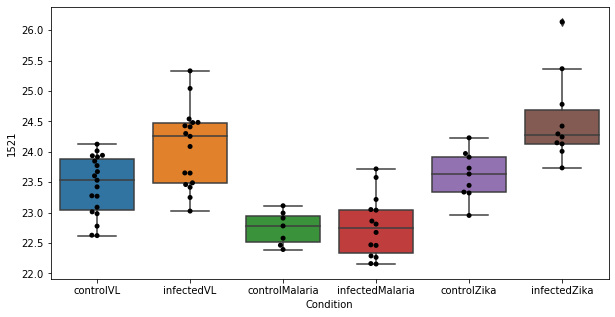

In [49]:
plot_boxplots(limma_topfeatures,1521, (20,24), False)